In [27]:
import geopandas as gpd
import pandas as pd
import csv

class ParcelEvaluator:
    """
    A class to evaluate and analyze parcel predictions against original parcels.
    This class compares original parcels with predicted parcels, calculates metrics,
    and identifies overpredictions and low-performing predictions.
    """

    def __init__(self, original_gdf_path, predicted_gdf_path):
        """
        Initialize the ParcelEvaluator with paths to original and predicted parcel data.
        Loads the GeoPackage files and ensures they have the same coordinate reference system.
        """
        self.original_gdf = self.load_gdf(original_gdf_path)
        self.predicted_gdf = self.load_gdf(predicted_gdf_path)
        
        # Ensure both GeoDataFrames have the same coordinate reference system
        if self.original_gdf.crs != self.predicted_gdf.crs:
            self.predicted_gdf = self.predicted_gdf.to_crs(self.original_gdf.crs)

    def load_gdf(self, path):
        return gpd.read_file(path)

    def explode_multipolygons(self, gdf):
        """
        Explode MultiPolygons in a GeoDataFrame into individual Polygons.
        This is necessary to ensure each geometry is a single Polygon for accurate analysis.
        """
        if any(gdf.geometry.type == 'MultiPolygon'):
            return gdf.explode(index_parts=False).reset_index(drop=True)
        return gdf

    def calculate_overlap(self, original_polygon, predicted_polygons):
        """
        Calculate the overlap between an original polygon and predicted polygons.
        This function computes the true positive (correctly predicted area) and
        false negative (missed area) for a single original parcel.
        parameters: 
        - original_polygon: a single original parcel polygon
        - predicted_polygons: predicted parcel polygons that intersect with the original polygon
        """
        if predicted_polygons.empty:
            return 0, original_polygon.area
        
        # Calculate the intersection between original and predicted polygons
        intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]), 
                                   predicted_polygons, how='intersection')
        true_positive = intersection.area.sum()
        false_negative = original_polygon.area - true_positive
        return true_positive, false_negative

    def evaluate_parcels(self):
        """
        Evaluate parcels by calculating the Adjusted IoU for each original parcel.
        This function iterates through all original parcels, calculates their overlap
        with predicted parcels, and computes an Adjusted IoU (Intersection over Union) score.
        """
        results = []

        for idx, original_row in self.original_gdf.iterrows():
            original_polygon = original_row.geometry
            
            # Find predicted polygons that intersect with the original polygon
            intersecting_predictions = self.predicted_gdf[self.predicted_gdf.intersects(original_polygon)]
            
            true_positive, false_negative = self.calculate_overlap(original_polygon, intersecting_predictions)
            
            # Calculate Adjusted IoU: true positive / (true positive + false negative)
            adjusted_iou = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0
            
            results.append({
                'Parcel ID': idx,
                'Adjusted IoU': adjusted_iou
            })

        results_df = pd.DataFrame(results)
        results_df.set_index('Parcel ID', inplace=True)
        
        return results_df

    def identify_overpredictions(self):
        """
        Identify overpredicted areas by comparing original and predicted parcels.
        This function finds areas that are predicted as parcels but don't exist in the original data.
        It returns only overpredicted areas larger than 5000 m².
        """
        # Combine all original and predicted parcels into single geometries
        original_combined = self.original_gdf.unary_union
        predicted_combined = self.predicted_gdf.unary_union
        
        # Find the difference to identify overpredicted areas
        overpredicted_area = predicted_combined.difference(original_combined)
        
        overpredicted_gdf = gpd.GeoDataFrame(geometry=[overpredicted_area], crs=self.original_gdf.crs)
        overpredicted_gdf = self.explode_multipolygons(overpredicted_gdf)
        # Filter out areas smaller than or equal to 5000 m²
        overpredicted_gdf = overpredicted_gdf[overpredicted_gdf.geometry.area > 5000]
        
        return overpredicted_gdf


    def analyze_parcels(self, output_filename):
        """
        Analyze parcels, calculate metrics, and save results to GeoPackage files and a statistics CSV.
        This function performs the main analysis, including:
        - Evaluating parcel predictions
        - Identifying overpredictions
        - Marking low-performing predictions
        - Calculating True Positive and False Negative areas
        - Calculating error statistics
        - Saving results to three separate GeoPackage files and a statistics CSV
        """
        results_df = self.evaluate_parcels()
        
        # Add Adjusted IoU to original GeoDataFrame
        self.original_gdf['Adjusted IoU'] = results_df['Adjusted IoU']
        
        # Explode MultiPolygons and filter out parcels smaller than or equal to 5000 m²
        analysis_gdf = self.explode_multipolygons(self.original_gdf)
        analysis_gdf = analysis_gdf[analysis_gdf.geometry.area > 5000]
        
        overpredicted_gdf = self.identify_overpredictions()
        
        # Mark overpredicted parcels (those intersecting with overpredicted areas)
        analysis_gdf['Overpredicted'] = analysis_gdf.geometry.intersects(overpredicted_gdf.unary_union)
        # Mark low IoU parcels (Adjusted IoU <= 0.7)
        analysis_gdf['Low IoU'] = analysis_gdf['Adjusted IoU'] <= 0.7
        
        # Calculate True Positive and False Negative areas for each parcel
        true_positives = []
        false_negatives = []
        for idx, original_row in analysis_gdf.iterrows():
            original_polygon = original_row.geometry
            intersecting_predictions = self.predicted_gdf[self.predicted_gdf.intersects(original_polygon)]
            true_positive, false_negative = self.calculate_overlap(original_polygon, intersecting_predictions)
            true_positives.append(true_positive)
            false_negatives.append(false_negative)
        
        analysis_gdf['True Positive (m²)'] = true_positives
        analysis_gdf['False Negative (m²)'] = false_negatives
        
        # Create low IoU GeoDataFrame
        low_iou_gdf = analysis_gdf[analysis_gdf['Low IoU']]
        
        # Prepare overpredicted parcels for inclusion in the analysis GeoDataFrame
        overpredicted_gdf['Adjusted IoU'] = None
        overpredicted_gdf['Overpredicted'] = True
        overpredicted_gdf['Low IoU'] = False
        overpredicted_gdf['True Positive (m²)'] = None
        overpredicted_gdf['False Negative (m²)'] = None
        
        # Combine original and overpredicted parcels into a single GeoDataFrame
        combined_gdf = pd.concat([analysis_gdf, overpredicted_gdf], ignore_index=True)
        
        # Save results to GeoPackage files
        combined_gdf.to_file(f"{output_filename}_analysis.gpkg", driver="GPKG")
        overpredicted_gdf.to_file(f"{output_filename}_hallucination.gpkg", driver="GPKG")
        low_iou_gdf.to_file(f"{output_filename}_low_iou.gpkg", driver="GPKG")

        # Calculate statistics
        total_area = analysis_gdf.geometry.area.sum()
        overpredicted_area = overpredicted_gdf.geometry.area.sum()
        low_iou_area = low_iou_gdf.geometry.area.sum()

        total_error = (overpredicted_area + low_iou_area) / total_area
        overprediction_error = overpredicted_area / total_area
        low_iou_error = low_iou_area / total_area

        # Prepare statistics
        statistics = {
            'Parcel Name': output_filename,
            'Total Area (m²)': total_area,
            'Overpredicted Area (m²)': overpredicted_area,
            'Low IoU Area (m²)': low_iou_area,
            'Total Error': total_error,
            'Overprediction Error': overprediction_error,
            'Low IoU Error': low_iou_error,
            'Correct Prediction (%)': (1 - total_error) * 100,
            'Overprediction (%)': overprediction_error * 100,
            'Low IoU (%)': low_iou_error * 100
        }

        # Save statistics to CSV
        with open(f"{output_filename}_statistics.csv", 'w', newline='') as csvfile:
            writer = csv.DictWriter(csvfile, fieldnames=statistics.keys())
            writer.writeheader()
            writer.writerow(statistics)

# Usage example
evaluator = ParcelEvaluator("/workspaces/Satelite/data/parcels/ZH_ZH_parcel_2.gpkg",
                            "/workspaces/Satelite/data/experiment/predictions/ZH_ZH_parcel_2.gpkg")
evaluator.analyze_parcels("ZH_ZH_parcel_2")

/tmp/ipykernel_29810/1877729787.py:50: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/1877729787.py:50: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/1877729787.py:50: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygo

In [22]:
import geopandas as gpd
import pandas as pd

class ParcelEvaluator:
    """
    A class to evaluate and analyze parcel predictions against original parcels.
    """

    def __init__(self, original_gdf_path, predicted_gdf_path):
        """
        Initialize the ParcelEvaluator with paths to original and predicted parcel data.

        Args:
            original_gdf_path (str): Path to the original parcel GeoPackage file.
            predicted_gdf_path (str): Path to the predicted parcel GeoPackage file.
        """
        self.original_gdf = self.load_gdf(original_gdf_path)
        self.predicted_gdf = self.load_gdf(predicted_gdf_path)
        
        if self.original_gdf.crs != self.predicted_gdf.crs:
            self.predicted_gdf = self.predicted_gdf.to_crs(self.original_gdf.crs)

    def load_gdf(self, path):
        """
        Load a GeoPackage file into a GeoDataFrame.

        Args:
            path (str): Path to the GeoPackage file.

        Returns:
            geopandas.GeoDataFrame: Loaded GeoDataFrame.
        """
        return gpd.read_file(path)

    def explode_multipolygons(self, gdf):
        """
        Explode MultiPolygons in a GeoDataFrame into individual Polygons.

        Args:
            gdf (geopandas.GeoDataFrame): Input GeoDataFrame.

        Returns:
            geopandas.GeoDataFrame: GeoDataFrame with MultiPolygons exploded.
        """
        if any(gdf.geometry.type == 'MultiPolygon'):
            return gdf.explode(index_parts=False).reset_index(drop=True)
        return gdf

    def calculate_overlap(self, original_polygon, predicted_polygons):
        """
        Calculate the overlap between an original polygon and predicted polygons.

        Args:
            original_polygon (shapely.geometry.Polygon): Original parcel polygon.
            predicted_polygons (geopandas.GeoDataFrame): GeoDataFrame of predicted polygons.

        Returns:
            tuple: (true_positive, false_negative) areas.
        """
        if predicted_polygons.empty:
            return 0, original_polygon.area
        
        intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]), 
                                   predicted_polygons, how='intersection')
        true_positive = intersection.area.sum()
        false_negative = original_polygon.area - true_positive
        return true_positive, false_negative

    def evaluate_parcels(self):
        """
        Evaluate parcels by calculating the Adjusted IoU for each original parcel.

        Returns:
            pandas.DataFrame: DataFrame with Adjusted IoU for each parcel.
        """
        results = []

        for idx, original_row in self.original_gdf.iterrows():
            original_polygon = original_row.geometry
            
            intersecting_predictions = self.predicted_gdf[self.predicted_gdf.intersects(original_polygon)]
            
            true_positive, false_negative = self.calculate_overlap(original_polygon, intersecting_predictions)
            
            adjusted_iou = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0
            
            results.append({
                'Parcel ID': idx,
                'Adjusted IoU': adjusted_iou
            })

        results_df = pd.DataFrame(results)
        results_df.set_index('Parcel ID', inplace=True)
        
        return results_df

    def identify_overpredictions(self):
        """
        Identify overpredicted areas by comparing original and predicted parcels.

        Returns:
            geopandas.GeoDataFrame: GeoDataFrame of overpredicted areas.
        """
        original_combined = self.original_gdf.unary_union
        predicted_combined = self.predicted_gdf.unary_union
        overpredicted_area = predicted_combined.difference(original_combined)
        
        overpredicted_gdf = gpd.GeoDataFrame(geometry=[overpredicted_area], crs=self.original_gdf.crs)
        overpredicted_gdf = self.explode_multipolygons(overpredicted_gdf)
        overpredicted_gdf = overpredicted_gdf[overpredicted_gdf.geometry.area > 5000]
        
        return overpredicted_gdf

    def analyze_parcels(self, output_filename):
        """
        Analyze parcels, calculate metrics, and save results to a GeoPackage file.

        Args:
            output_filename (str): Base name for the output file (without extension).
        """
        results_df = self.evaluate_parcels()
        
        self.original_gdf['Adjusted IoU'] = results_df['Adjusted IoU']
        
        analysis_gdf = self.explode_multipolygons(self.original_gdf)
        analysis_gdf = analysis_gdf[analysis_gdf.geometry.area > 5000]
        
        overpredicted_gdf = self.identify_overpredictions()
        
        analysis_gdf['Overpredicted'] = analysis_gdf.geometry.intersects(overpredicted_gdf.unary_union)
        
        # Add overpredicted parcels to the analysis GeoDataFrame
        overpredicted_gdf['Adjusted IoU'] = None
        overpredicted_gdf['Overpredicted'] = True
        
        # Combine original and overpredicted parcels
        combined_gdf = pd.concat([analysis_gdf, overpredicted_gdf], ignore_index=True)
        
        combined_gdf.to_file(f"{output_filename}_analysis.gpkg", driver="GPKG")

# Usage example
evaluator = ParcelEvaluator("/workspaces/Satelite/data/parcels/ZH_ZH_parcel_2.gpkg",
                            "/workspaces/Satelite/data/experiment/predictions/ZH_ZH_parcel_2.gpkg")
evaluator.analyze_parcels("ZH_ZH_parcel_2")

/tmp/ipykernel_29810/2541819935.py:63: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/2541819935.py:63: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/2541819935.py:63: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygo

In [20]:
import geopandas as gpd
import pandas as pd
from shapely.ops import unary_union

class ParcelEvaluator:
    def __init__(self, original_gdf_path, predicted_gdf_path):
        self.original_gdf = self.load_gdf(original_gdf_path)
        self.predicted_gdf = self.load_gdf(predicted_gdf_path)
        
        if self.original_gdf.crs != self.predicted_gdf.crs:
            self.predicted_gdf = self.predicted_gdf.to_crs(self.original_gdf.crs)

    def load_gdf(self, path):
        return gpd.read_file(path)

    def calculate_overlap(self, original_polygon, predicted_polygons):
        if predicted_polygons.empty:
            return 0, original_polygon.area
        
        intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]), 
                                   predicted_polygons, how='intersection')
        true_positive = intersection.area.sum()
        false_negative = original_polygon.area - true_positive
        return true_positive, false_negative

    def evaluate_parcels(self):
        results = []

        for idx, original_row in self.original_gdf.iterrows():
            original_polygon = original_row.geometry
            
            intersecting_predictions = self.predicted_gdf[self.predicted_gdf.intersects(original_polygon)]
            
            true_positive, false_negative = self.calculate_overlap(original_polygon, intersecting_predictions)
            
            adjusted_iou = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0
            
            results.append({
                'Parcel ID': idx,
                'True Positive': true_positive,
                'False Negative': false_negative,
                'Adjusted IoU': adjusted_iou
            })
            
            print(f"Parcel {idx}:")
            print(f"True Positive (Correctly predicted): {true_positive:.2f} m²")
            print(f"False Negative (Missed): {false_negative:.2f} m²")
            print(f"Adjusted IoU: {adjusted_iou:.2f}")
            print("\n")

        results_df = pd.DataFrame(results)
        results_df.set_index('Parcel ID', inplace=True)
        
        print("Overall Metrics:")
        print(f"Average Adjusted IoU: {results_df['Adjusted IoU'].mean():.2f}")
        
        results_df.to_csv("parcel_evaluation_results.csv")
        print("Results saved to parcel_evaluation_results.csv")

        return results_df

    def explode_multipolygons(self, gdf):
        if any(gdf.geometry.type == 'MultiPolygon'):
            return gdf.explode(index_parts=False).reset_index(drop=True)
        return gdf

    def mark_low_performing_parcels(self, results_df):
        self.original_gdf['Adjusted IoU'] = results_df['Adjusted IoU']
        self.original_gdf['Low Performing'] = self.original_gdf['Adjusted IoU'] <= 0.5
        
        low_performing_gdf = self.original_gdf[self.original_gdf['Low Performing']]
        
        # Explode MultiPolygons
        low_performing_gdf = self.explode_multipolygons(low_performing_gdf)
        
        # Remove low performing parcels with a size smaller than or equal to 5000 m²
        low_performing_gdf = low_performing_gdf[low_performing_gdf.geometry.area > 5000]
        
        self.original_gdf.to_file("original_parcels_with_iou.gpkg", driver="GPKG")
        print("Updated original parcels saved to original_parcels_with_iou.gpkg")
        
        low_performing_gdf.to_file("low_performing_parcels.gpkg", driver="GPKG")
        print("Low-performing parcels saved to low_performing_parcels.gpkg")

    def identify_overpredictions(self):
        # Combine all original parcels into a single geometry
        original_combined = self.original_gdf.unary_union
        
        # Combine all predicted parcels into a single geometry
        predicted_combined = self.predicted_gdf.unary_union
        
        # Find the difference (this should be the overpredicted area)
        overpredicted_area = predicted_combined.difference(original_combined)
        
        # Create a GeoDataFrame from this difference
        overpredicted_gdf = gpd.GeoDataFrame(geometry=[overpredicted_area], crs=self.original_gdf.crs)
        
        # Explode MultiPolygons
        overpredicted_gdf = self.explode_multipolygons(overpredicted_gdf)
        
        # Remove any empty geometries and parcels smaller than or equal to 5000 m²
        overpredicted_gdf = overpredicted_gdf[~overpredicted_gdf.geometry.is_empty & (overpredicted_gdf.geometry.area > 5000)]
        
        if overpredicted_gdf.empty:
            print("No overpredictions found.")
        else:
            # Save overpredicted areas to a new file
            overpredicted_gdf.to_file("overpredicted_areas.gpkg", driver="GPKG")
            print(f"Overpredicted areas saved to overpredicted_areas.gpkg")
        
        return overpredicted_gdf

# Usage
evaluator = ParcelEvaluator("/workspaces/Satelite/data/parcels/ZH_ZH_parcel_2.gpkg",
                            "/workspaces/Satelite/data/experiment/predictions/ZH_ZH_parcel_2.gpkg")
results = evaluator.evaluate_parcels()
evaluator.mark_low_performing_parcels(results)
overpredicted_areas = evaluator.identify_overpredictions()

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 0:
True Positive (Correctly predicted): 17716.30 m²
False Negative (Missed): 538.99 m²
Adjusted IoU: 0.97


Parcel 1:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 10.34 m²
Adjusted IoU: 0.00


Parcel 2:
True Positive (Correctly predicted): 10791.03 m²
False Negative (Missed): 138.19 m²
Adjusted IoU: 0.99


Parcel 3:
True Positive (Correctly predicted): 2354.20 m²
False Negative (Missed): 879.66 m²
Adjusted IoU: 0.73


Parcel 4:
True Positive (Correctly predicted): 1788.90 m²
False Negative (Missed): 77.91 m²
Adjusted IoU: 0.96


Parcel 5:
True Positive (Correctly predicted): 1960.85 m²
False Negative (Missed): 94.39 m²
Adjusted IoU: 0.95


Parcel 6:
True Positive (Correctly predicted): 2201.12 m²
False Negative (Missed): 30.31 m²
Adjusted IoU: 0.99


Parcel 7:
True Positive (Correctly predicted): 4138.29 m²
False Negative (Missed): 891.84 m²
Adjusted IoU: 0.82


Parcel 8:
True Positive (Correctly predicted): 16455.67 m²
False Negative (Missed): 206.51 m²

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 14:
True Positive (Correctly predicted): 986.74 m²
False Negative (Missed): 231.09 m²
Adjusted IoU: 0.81


Parcel 15:
True Positive (Correctly predicted): 2460.38 m²
False Negative (Missed): 497.53 m²
Adjusted IoU: 0.83


Parcel 16:
True Positive (Correctly predicted): 18649.50 m²
False Negative (Missed): 1141.13 m²
Adjusted IoU: 0.94


Parcel 17:
True Positive (Correctly predicted): 12715.59 m²
False Negative (Missed): 826.72 m²
Adjusted IoU: 0.94


Parcel 18:
True Positive (Correctly predicted): 20744.32 m²
False Negative (Missed): 2975.70 m²
Adjusted IoU: 0.87


Parcel 19:
True Positive (Correctly predicted): 17595.80 m²
False Negative (Missed): 1978.11 m²
Adjusted IoU: 0.90


Parcel 20:
True Positive (Correctly predicted): 134.46 m²
False Negative (Missed): 344.09 m²
Adjusted IoU: 0.28


Parcel 21:
True Positive (Correctly predicted): 276.16 m²
False Negative (Missed): 86.29 m²
Adjusted IoU: 0.76


Parcel 22:
True Positive (Correctly predicted): 4455.22 m²
False Negative (Mi

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 41:
True Positive (Correctly predicted): 6209.70 m²
False Negative (Missed): 959.04 m²
Adjusted IoU: 0.87


Parcel 42:
True Positive (Correctly predicted): 2879.35 m²
False Negative (Missed): 534.92 m²
Adjusted IoU: 0.84


Parcel 43:
True Positive (Correctly predicted): 439.64 m²
False Negative (Missed): 1977.56 m²
Adjusted IoU: 0.18


Parcel 44:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 62.70 m²
Adjusted IoU: 0.00


Parcel 45:
True Positive (Correctly predicted): 10035.91 m²
False Negative (Missed): 1739.25 m²
Adjusted IoU: 0.85


Parcel 46:
True Positive (Correctly predicted): 605.16 m²
False Negative (Missed): 43.05 m²
Adjusted IoU: 0.93


Parcel 47:
True Positive (Correctly predicted): 1119.42 m²
False Negative (Missed): 459.60 m²
Adjusted IoU: 0.71


Parcel 48:
True Positive (Correctly predicted): 168.43 m²
False Negative (Missed): 813.65 m²
Adjusted IoU: 0.17


Parcel 49:
True Positive (Correctly predicted): 86.35 m²
False Negative (Missed): 118

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 59:
True Positive (Correctly predicted): 1214.13 m²
False Negative (Missed): 1763.87 m²
Adjusted IoU: 0.41


Parcel 60:
True Positive (Correctly predicted): 3811.01 m²
False Negative (Missed): 307.46 m²
Adjusted IoU: 0.93


Parcel 61:
True Positive (Correctly predicted): 1937.47 m²
False Negative (Missed): 1649.01 m²
Adjusted IoU: 0.54


Parcel 62:
True Positive (Correctly predicted): 9565.67 m²
False Negative (Missed): 2196.63 m²
Adjusted IoU: 0.81


Parcel 63:
True Positive (Correctly predicted): 1105.02 m²
False Negative (Missed): 1641.15 m²
Adjusted IoU: 0.40


Parcel 64:
True Positive (Correctly predicted): 2938.58 m²
False Negative (Missed): 1380.84 m²
Adjusted IoU: 0.68


Parcel 65:
True Positive (Correctly predicted): 0.55 m²
False Negative (Missed): 1400.25 m²
Adjusted IoU: 0.00


Parcel 66:
True Positive (Correctly predicted): 812.13 m²
False Negative (Missed): 120.86 m²
Adjusted IoU: 0.87


Parcel 67:
True Positive (Correctly predicted): 3868.23 m²
False Negative (Mis

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 74:
True Positive (Correctly predicted): 1818.97 m²
False Negative (Missed): 7224.79 m²
Adjusted IoU: 0.20


Parcel 75:
True Positive (Correctly predicted): 46097.39 m²
False Negative (Missed): 8639.37 m²
Adjusted IoU: 0.84


Parcel 76:
True Positive (Correctly predicted): 12466.34 m²
False Negative (Missed): 1601.95 m²
Adjusted IoU: 0.89


Parcel 77:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 189.69 m²
Adjusted IoU: 0.00


Parcel 78:
True Positive (Correctly predicted): 10283.98 m²
False Negative (Missed): 1994.19 m²
Adjusted IoU: 0.84


Parcel 79:
True Positive (Correctly predicted): 18703.10 m²
False Negative (Missed): 3882.91 m²
Adjusted IoU: 0.83


Parcel 80:
True Positive (Correctly predicted): 1641.15 m²
False Negative (Missed): 449.75 m²
Adjusted IoU: 0.78


Parcel 81:
True Positive (Correctly predicted): 4015.61 m²
False Negative (Missed): 687.57 m²
Adjusted IoU: 0.85


Parcel 82:
True Positive (Correctly predicted): 1663.33 m²
False Negative 

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 89:
True Positive (Correctly predicted): 2168.57 m²
False Negative (Missed): 885.61 m²
Adjusted IoU: 0.71


Parcel 90:
True Positive (Correctly predicted): 2212.18 m²
False Negative (Missed): 1122.84 m²
Adjusted IoU: 0.66


Parcel 91:
True Positive (Correctly predicted): 1119.33 m²
False Negative (Missed): 415.98 m²
Adjusted IoU: 0.73


Parcel 92:
True Positive (Correctly predicted): 58.38 m²
False Negative (Missed): 644.01 m²
Adjusted IoU: 0.08


Parcel 93:
True Positive (Correctly predicted): 3130.32 m²
False Negative (Missed): 697.34 m²
Adjusted IoU: 0.82


Parcel 94:
True Positive (Correctly predicted): 22381.08 m²
False Negative (Missed): 166.71 m²
Adjusted IoU: 0.99


Parcel 95:
True Positive (Correctly predicted): 18226.29 m²
False Negative (Missed): 1277.26 m²
Adjusted IoU: 0.93


Parcel 96:
True Positive (Correctly predicted): 11359.20 m²
False Negative (Missed): 1097.66 m²
Adjusted IoU: 0.91


Parcel 97:
True Positive (Correctly predicted): 6742.32 m²
False Negative (M

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 104:
True Positive (Correctly predicted): 8788.12 m²
False Negative (Missed): 691.33 m²
Adjusted IoU: 0.93


Parcel 105:
True Positive (Correctly predicted): 20872.75 m²
False Negative (Missed): 3155.13 m²
Adjusted IoU: 0.87


Parcel 106:
True Positive (Correctly predicted): 12193.90 m²
False Negative (Missed): 1037.77 m²
Adjusted IoU: 0.92


Parcel 107:
True Positive (Correctly predicted): 395.17 m²
False Negative (Missed): 51.42 m²
Adjusted IoU: 0.88


Parcel 108:
True Positive (Correctly predicted): 604.31 m²
False Negative (Missed): 15.54 m²
Adjusted IoU: 0.97


Parcel 109:
True Positive (Correctly predicted): 406.43 m²
False Negative (Missed): 4.14 m²
Adjusted IoU: 0.99


Parcel 110:
True Positive (Correctly predicted): 3130.74 m²
False Negative (Missed): 45.96 m²
Adjusted IoU: 0.99


Parcel 111:
True Positive (Correctly predicted): 610.79 m²
False Negative (Missed): 338.80 m²
Adjusted IoU: 0.64


Parcel 112:
True Positive (Correctly predicted): 84.58 m²
False Negative (Mis

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 118:
True Positive (Correctly predicted): 12513.70 m²
False Negative (Missed): 1005.24 m²
Adjusted IoU: 0.93


Parcel 119:
True Positive (Correctly predicted): 14923.28 m²
False Negative (Missed): 929.28 m²
Adjusted IoU: 0.94


Parcel 120:
True Positive (Correctly predicted): 9614.91 m²
False Negative (Missed): 1381.12 m²
Adjusted IoU: 0.87


Parcel 121:
True Positive (Correctly predicted): 18097.65 m²
False Negative (Missed): 1754.86 m²
Adjusted IoU: 0.91


Parcel 122:
True Positive (Correctly predicted): 13784.97 m²
False Negative (Missed): 1051.80 m²
Adjusted IoU: 0.93


Parcel 123:
True Positive (Correctly predicted): 12682.43 m²
False Negative (Missed): 1322.53 m²
Adjusted IoU: 0.91


Parcel 124:
True Positive (Correctly predicted): 24461.77 m²
False Negative (Missed): 1893.17 m²
Adjusted IoU: 0.93


Parcel 125:
True Positive (Correctly predicted): 2976.87 m²
False Negative (Missed): 645.36 m²
Adjusted IoU: 0.82


Parcel 126:
True Positive (Correctly predicted): 2071.58 m²


/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 132:
True Positive (Correctly predicted): 58925.15 m²
False Negative (Missed): 6228.71 m²
Adjusted IoU: 0.90


Parcel 133:
True Positive (Correctly predicted): 20264.46 m²
False Negative (Missed): 870.48 m²
Adjusted IoU: 0.96


Parcel 134:
True Positive (Correctly predicted): 2193.54 m²
False Negative (Missed): 9043.36 m²
Adjusted IoU: 0.20


Parcel 135:
True Positive (Correctly predicted): 8524.76 m²
False Negative (Missed): 442.22 m²
Adjusted IoU: 0.95


Parcel 136:
True Positive (Correctly predicted): 8234.19 m²
False Negative (Missed): 86.80 m²
Adjusted IoU: 0.99


Parcel 137:
True Positive (Correctly predicted): 1882.12 m²
False Negative (Missed): 385.16 m²
Adjusted IoU: 0.83


Parcel 138:
True Positive (Correctly predicted): 1007.90 m²
False Negative (Missed): 659.13 m²
Adjusted IoU: 0.60


Parcel 139:
True Positive (Correctly predicted): 9764.07 m²
False Negative (Missed): 1154.14 m²
Adjusted IoU: 0.89


Parcel 140:
True Positive (Correctly predicted): 877.56 m²
False Neg

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 145:
True Positive (Correctly predicted): 14176.71 m²
False Negative (Missed): 172.12 m²
Adjusted IoU: 0.99


Parcel 146:
True Positive (Correctly predicted): 13373.27 m²
False Negative (Missed): 659.06 m²
Adjusted IoU: 0.95


Parcel 147:
True Positive (Correctly predicted): 28355.47 m²
False Negative (Missed): 1112.29 m²
Adjusted IoU: 0.96


Parcel 148:
True Positive (Correctly predicted): 5698.27 m²
False Negative (Missed): 1567.08 m²
Adjusted IoU: 0.78


Parcel 149:
True Positive (Correctly predicted): 1434.43 m²
False Negative (Missed): 1634.60 m²
Adjusted IoU: 0.47


Parcel 150:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 130.89 m²
Adjusted IoU: 0.00


Parcel 151:
True Positive (Correctly predicted): 13884.23 m²
False Negative (Missed): 1483.08 m²
Adjusted IoU: 0.90


Parcel 152:
True Positive (Correctly predicted): 231.30 m²
False Negative (Missed): 1343.26 m²
Adjusted IoU: 0.15


Parcel 153:
True Positive (Correctly predicted): 2424.42 m²
False N

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 161:
True Positive (Correctly predicted): 3838.68 m²
False Negative (Missed): 391.17 m²
Adjusted IoU: 0.91


Parcel 162:
True Positive (Correctly predicted): 9940.12 m²
False Negative (Missed): 214.80 m²
Adjusted IoU: 0.98


Parcel 163:
True Positive (Correctly predicted): 144.81 m²
False Negative (Missed): 97.91 m²
Adjusted IoU: 0.60


Parcel 164:
True Positive (Correctly predicted): 18461.72 m²
False Negative (Missed): 543.38 m²
Adjusted IoU: 0.97


Parcel 165:
True Positive (Correctly predicted): 1926.10 m²
False Negative (Missed): 2159.19 m²
Adjusted IoU: 0.47


Parcel 166:
True Positive (Correctly predicted): 10947.06 m²
False Negative (Missed): 1647.56 m²
Adjusted IoU: 0.87


Parcel 167:
True Positive (Correctly predicted): 16713.57 m²
False Negative (Missed): 2518.62 m²
Adjusted IoU: 0.87


Parcel 168:
True Positive (Correctly predicted): 12727.66 m²
False Negative (Missed): 4901.15 m²
Adjusted IoU: 0.72


Parcel 169:
True Positive (Correctly predicted): 1695.40 m²
False 

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 176:
True Positive (Correctly predicted): 10825.96 m²
False Negative (Missed): 435.41 m²
Adjusted IoU: 0.96


Parcel 177:
True Positive (Correctly predicted): 11090.68 m²
False Negative (Missed): 1117.20 m²
Adjusted IoU: 0.91


Parcel 178:
True Positive (Correctly predicted): 5476.85 m²
False Negative (Missed): 1732.74 m²
Adjusted IoU: 0.76


Parcel 179:
True Positive (Correctly predicted): 14340.41 m²
False Negative (Missed): 1055.64 m²
Adjusted IoU: 0.93


Parcel 180:
True Positive (Correctly predicted): 13213.35 m²
False Negative (Missed): 1276.27 m²
Adjusted IoU: 0.91


Parcel 181:
True Positive (Correctly predicted): 8795.19 m²
False Negative (Missed): 1561.56 m²
Adjusted IoU: 0.85


Parcel 182:
True Positive (Correctly predicted): 17026.13 m²
False Negative (Missed): 1866.42 m²
Adjusted IoU: 0.90


Parcel 183:
True Positive (Correctly predicted): 36340.46 m²
False Negative (Missed): 1207.10 m²
Adjusted IoU: 0.97


Parcel 184:
True Positive (Correctly predicted): 18802.99 m

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 190:
True Positive (Correctly predicted): 4226.92 m²
False Negative (Missed): 964.20 m²
Adjusted IoU: 0.81


Parcel 191:
True Positive (Correctly predicted): 5973.22 m²
False Negative (Missed): 1352.41 m²
Adjusted IoU: 0.82


Parcel 192:
True Positive (Correctly predicted): 11423.68 m²
False Negative (Missed): 2725.27 m²
Adjusted IoU: 0.81


Parcel 193:
True Positive (Correctly predicted): 2594.42 m²
False Negative (Missed): 723.46 m²
Adjusted IoU: 0.78


Parcel 194:
True Positive (Correctly predicted): 9296.35 m²
False Negative (Missed): 1496.59 m²
Adjusted IoU: 0.86


Parcel 195:
True Positive (Correctly predicted): 7386.81 m²
False Negative (Missed): 1159.23 m²
Adjusted IoU: 0.86


Parcel 196:
True Positive (Correctly predicted): 3956.60 m²
False Negative (Missed): 2060.14 m²
Adjusted IoU: 0.66


Parcel 197:
True Positive (Correctly predicted): 358.71 m²
False Negative (Missed): 665.63 m²
Adjusted IoU: 0.35


Parcel 198:
True Positive (Correctly predicted): 6179.08 m²
False N

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 206:
True Positive (Correctly predicted): 7011.84 m²
False Negative (Missed): 3710.43 m²
Adjusted IoU: 0.65


Parcel 207:
True Positive (Correctly predicted): 7233.09 m²
False Negative (Missed): 386.35 m²
Adjusted IoU: 0.95


Parcel 208:
True Positive (Correctly predicted): 2109.34 m²
False Negative (Missed): 267.27 m²
Adjusted IoU: 0.89


Parcel 209:
True Positive (Correctly predicted): 16122.86 m²
False Negative (Missed): 3653.34 m²
Adjusted IoU: 0.82


Parcel 210:
True Positive (Correctly predicted): 19572.15 m²
False Negative (Missed): 4281.55 m²
Adjusted IoU: 0.82


Parcel 211:
True Positive (Correctly predicted): 2597.14 m²
False Negative (Missed): 15060.16 m²
Adjusted IoU: 0.15


Parcel 212:
True Positive (Correctly predicted): 17947.38 m²
False Negative (Missed): 12922.25 m²
Adjusted IoU: 0.58


Parcel 213:
True Positive (Correctly predicted): 75.00 m²
False Negative (Missed): 4134.51 m²
Adjusted IoU: 0.02


Parcel 214:
True Positive (Correctly predicted): 22883.01 m²
Fa

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 220:
True Positive (Correctly predicted): 6314.87 m²
False Negative (Missed): 3397.41 m²
Adjusted IoU: 0.65


Parcel 221:
True Positive (Correctly predicted): 60.18 m²
False Negative (Missed): 742.19 m²
Adjusted IoU: 0.07


Parcel 222:
True Positive (Correctly predicted): 68.43 m²
False Negative (Missed): 972.78 m²
Adjusted IoU: 0.07


Parcel 223:
True Positive (Correctly predicted): 12089.30 m²
False Negative (Missed): 2681.93 m²
Adjusted IoU: 0.82


Parcel 224:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 221.29 m²
Adjusted IoU: 0.00


Parcel 225:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 85.12 m²
Adjusted IoU: 0.00


Parcel 226:
True Positive (Correctly predicted): 11415.58 m²
False Negative (Missed): 1121.27 m²
Adjusted IoU: 0.91


Parcel 227:
True Positive (Correctly predicted): 3378.81 m²
False Negative (Missed): 1029.44 m²
Adjusted IoU: 0.77


Parcel 228:
True Positive (Correctly predicted): 9895.25 m²
False Negative (M

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 236:
True Positive (Correctly predicted): 19515.69 m²
False Negative (Missed): 1393.22 m²
Adjusted IoU: 0.93


Parcel 237:
True Positive (Correctly predicted): 8500.80 m²
False Negative (Missed): 866.13 m²
Adjusted IoU: 0.91


Parcel 238:
True Positive (Correctly predicted): 4660.01 m²
False Negative (Missed): 882.66 m²
Adjusted IoU: 0.84


Parcel 239:
True Positive (Correctly predicted): 13344.93 m²
False Negative (Missed): 251.59 m²
Adjusted IoU: 0.98


Parcel 240:
True Positive (Correctly predicted): 9331.55 m²
False Negative (Missed): 2032.47 m²
Adjusted IoU: 0.82


Parcel 241:
True Positive (Correctly predicted): 1389.03 m²
False Negative (Missed): 616.95 m²
Adjusted IoU: 0.69


Parcel 242:
True Positive (Correctly predicted): 7358.37 m²
False Negative (Missed): 1403.79 m²
Adjusted IoU: 0.84


Parcel 243:
True Positive (Correctly predicted): 3977.86 m²
False Negative (Missed): 1107.58 m²
Adjusted IoU: 0.78


Parcel 244:
True Positive (Correctly predicted): 991.52 m²
False N

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 250:
True Positive (Correctly predicted): 16991.30 m²
False Negative (Missed): 1943.29 m²
Adjusted IoU: 0.90


Parcel 251:
True Positive (Correctly predicted): 11839.90 m²
False Negative (Missed): 2147.37 m²
Adjusted IoU: 0.85


Parcel 252:
True Positive (Correctly predicted): 25813.21 m²
False Negative (Missed): 2633.20 m²
Adjusted IoU: 0.91


Parcel 253:
True Positive (Correctly predicted): 15012.44 m²
False Negative (Missed): 1413.17 m²
Adjusted IoU: 0.91


Parcel 254:
True Positive (Correctly predicted): 14743.31 m²
False Negative (Missed): 1001.88 m²
Adjusted IoU: 0.94


Parcel 255:
True Positive (Correctly predicted): 21132.01 m²
False Negative (Missed): 599.11 m²
Adjusted IoU: 0.97


Parcel 256:
True Positive (Correctly predicted): 11537.42 m²
False Negative (Missed): 497.38 m²
Adjusted IoU: 0.96


Parcel 257:
True Positive (Correctly predicted): 33135.64 m²
False Negative (Missed): 1936.59 m²
Adjusted IoU: 0.94


Parcel 258:
True Positive (Correctly predicted): 125.75 m²

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 264:
True Positive (Correctly predicted): 5578.75 m²
False Negative (Missed): 1639.98 m²
Adjusted IoU: 0.77


Parcel 265:
True Positive (Correctly predicted): 9647.58 m²
False Negative (Missed): 1552.86 m²
Adjusted IoU: 0.86


Parcel 266:
True Positive (Correctly predicted): 9156.79 m²
False Negative (Missed): 1279.82 m²
Adjusted IoU: 0.88


Parcel 267:
True Positive (Correctly predicted): 10660.56 m²
False Negative (Missed): 334.96 m²
Adjusted IoU: 0.97


Parcel 268:
True Positive (Correctly predicted): 12916.73 m²
False Negative (Missed): 387.56 m²
Adjusted IoU: 0.97


Parcel 269:
True Positive (Correctly predicted): 16237.87 m²
False Negative (Missed): 492.25 m²
Adjusted IoU: 0.97


Parcel 270:
True Positive (Correctly predicted): 10492.49 m²
False Negative (Missed): 446.58 m²
Adjusted IoU: 0.96


Parcel 271:
True Positive (Correctly predicted): 9115.19 m²
False Negative (Missed): 44.41 m²
Adjusted IoU: 1.00


Parcel 272:
True Positive (Correctly predicted): 28491.95 m²
False

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 277:
True Positive (Correctly predicted): 26.59 m²
False Negative (Missed): 5.11 m²
Adjusted IoU: 0.84


Parcel 278:
True Positive (Correctly predicted): 8778.63 m²
False Negative (Missed): 643.46 m²
Adjusted IoU: 0.93


Parcel 279:
True Positive (Correctly predicted): 26632.21 m²
False Negative (Missed): 2069.22 m²
Adjusted IoU: 0.93


Parcel 280:
True Positive (Correctly predicted): 13895.50 m²
False Negative (Missed): 1829.36 m²
Adjusted IoU: 0.88


Parcel 281:
True Positive (Correctly predicted): 8563.08 m²
False Negative (Missed): 1166.61 m²
Adjusted IoU: 0.88


Parcel 282:
True Positive (Correctly predicted): 14050.87 m²
False Negative (Missed): 2005.62 m²
Adjusted IoU: 0.88


Parcel 283:
True Positive (Correctly predicted): 1433.74 m²
False Negative (Missed): 2728.16 m²
Adjusted IoU: 0.34


Parcel 284:
True Positive (Correctly predicted): 8774.67 m²
False Negative (Missed): 4294.24 m²
Adjusted IoU: 0.67


Parcel 285:
True Positive (Correctly predicted): 0.00 m²
False Nega

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 291:
True Positive (Correctly predicted): 6195.75 m²
False Negative (Missed): 3118.78 m²
Adjusted IoU: 0.67


Parcel 292:
True Positive (Correctly predicted): 1333.72 m²
False Negative (Missed): 1237.60 m²
Adjusted IoU: 0.52


Parcel 293:
True Positive (Correctly predicted): 2.85 m²
False Negative (Missed): 1858.30 m²
Adjusted IoU: 0.00


Parcel 294:
True Positive (Correctly predicted): 11.47 m²
False Negative (Missed): 2256.91 m²
Adjusted IoU: 0.01


Parcel 295:
True Positive (Correctly predicted): 2.64 m²
False Negative (Missed): 5.91 m²
Adjusted IoU: 0.31


Parcel 296:
True Positive (Correctly predicted): 1.80 m²
False Negative (Missed): 750.64 m²
Adjusted IoU: 0.00


Parcel 297:
True Positive (Correctly predicted): 750.63 m²
False Negative (Missed): 1982.16 m²
Adjusted IoU: 0.27


Parcel 298:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 125.83 m²
Adjusted IoU: 0.00


Parcel 299:
True Positive (Correctly predicted): 6537.83 m²
False Negative (Missed):

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 308:
True Positive (Correctly predicted): 15172.55 m²
False Negative (Missed): 3833.21 m²
Adjusted IoU: 0.80


Parcel 309:
True Positive (Correctly predicted): 28668.78 m²
False Negative (Missed): 3406.98 m²
Adjusted IoU: 0.89


Parcel 310:
True Positive (Correctly predicted): 12456.35 m²
False Negative (Missed): 618.55 m²
Adjusted IoU: 0.95


Parcel 311:
True Positive (Correctly predicted): 3507.88 m²
False Negative (Missed): 876.36 m²
Adjusted IoU: 0.80


Parcel 312:
True Positive (Correctly predicted): 1397.49 m²
False Negative (Missed): 485.29 m²
Adjusted IoU: 0.74


Parcel 313:
True Positive (Correctly predicted): 23.75 m²
False Negative (Missed): 444.86 m²
Adjusted IoU: 0.05


Parcel 314:
True Positive (Correctly predicted): 4425.99 m²
False Negative (Missed): 434.47 m²
Adjusted IoU: 0.91


Parcel 315:
True Positive (Correctly predicted): 1553.13 m²
False Negative (Missed): 1953.31 m²
Adjusted IoU: 0.44


Parcel 316:
True Positive (Correctly predicted): 3206.21 m²
False Ne

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 323:
True Positive (Correctly predicted): 2094.07 m²
False Negative (Missed): 1256.68 m²
Adjusted IoU: 0.62


Parcel 324:
True Positive (Correctly predicted): 6.60 m²
False Negative (Missed): 736.99 m²
Adjusted IoU: 0.01


Parcel 325:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 298.54 m²
Adjusted IoU: 0.00


Parcel 326:
True Positive (Correctly predicted): 3700.07 m²
False Negative (Missed): 1438.63 m²
Adjusted IoU: 0.72


Parcel 327:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 131.08 m²
Adjusted IoU: 0.00


Parcel 328:
True Positive (Correctly predicted): 13952.45 m²
False Negative (Missed): 577.19 m²
Adjusted IoU: 0.96


Parcel 329:
True Positive (Correctly predicted): 7927.02 m²
False Negative (Missed): 648.13 m²
Adjusted IoU: 0.92


Parcel 330:
True Positive (Correctly predicted): 25815.80 m²
False Negative (Missed): 3559.26 m²
Adjusted IoU: 0.88


Parcel 331:
True Positive (Correctly predicted): 5000.00 m²
False Negative (

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 341:
True Positive (Correctly predicted): 991.90 m²
False Negative (Missed): 2167.32 m²
Adjusted IoU: 0.31


Parcel 342:
True Positive (Correctly predicted): 3738.38 m²
False Negative (Missed): 494.27 m²
Adjusted IoU: 0.88


Parcel 343:
True Positive (Correctly predicted): 1450.83 m²
False Negative (Missed): 1658.36 m²
Adjusted IoU: 0.47


Parcel 344:
True Positive (Correctly predicted): 5647.77 m²
False Negative (Missed): 1662.20 m²
Adjusted IoU: 0.77


Parcel 345:
True Positive (Correctly predicted): 400.00 m²
False Negative (Missed): 4687.76 m²
Adjusted IoU: 0.08


Parcel 346:
True Positive (Correctly predicted): 1431.00 m²
False Negative (Missed): 134.83 m²
Adjusted IoU: 0.91


Parcel 347:
True Positive (Correctly predicted): 12170.38 m²
False Negative (Missed): 1094.21 m²
Adjusted IoU: 0.92


Parcel 348:
True Positive (Correctly predicted): 172.75 m²
False Negative (Missed): 0.00 m²
Adjusted IoU: 1.00


Parcel 349:
True Positive (Correctly predicted): 2889.28 m²
False Negat

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 355:
True Positive (Correctly predicted): 276.96 m²
False Negative (Missed): 468.39 m²
Adjusted IoU: 0.37


Parcel 356:
True Positive (Correctly predicted): 17.66 m²
False Negative (Missed): 230.26 m²
Adjusted IoU: 0.07


Parcel 357:
True Positive (Correctly predicted): 130.41 m²
False Negative (Missed): 156.66 m²
Adjusted IoU: 0.45


Parcel 358:
True Positive (Correctly predicted): 16686.85 m²
False Negative (Missed): 1378.34 m²
Adjusted IoU: 0.92


Parcel 359:
True Positive (Correctly predicted): 2727.74 m²
False Negative (Missed): 1309.19 m²
Adjusted IoU: 0.68


Parcel 360:
True Positive (Correctly predicted): 5484.31 m²
False Negative (Missed): 975.06 m²
Adjusted IoU: 0.85


Parcel 361:
True Positive (Correctly predicted): 19824.71 m²
False Negative (Missed): 3578.71 m²
Adjusted IoU: 0.85


Parcel 362:
True Positive (Correctly predicted): 169.68 m²
False Negative (Missed): 462.35 m²
Adjusted IoU: 0.27


Parcel 363:
True Positive (Correctly predicted): 30.53 m²
False Negative

/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/910588519.py:20: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon])

Parcel 370:
True Positive (Correctly predicted): 40.36 m²
False Negative (Missed): 653.58 m²
Adjusted IoU: 0.06


Parcel 371:
True Positive (Correctly predicted): 200.00 m²
False Negative (Missed): 1880.73 m²
Adjusted IoU: 0.10


Parcel 372:
True Positive (Correctly predicted): 2.28 m²
False Negative (Missed): 621.48 m²
Adjusted IoU: 0.00


Parcel 373:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 184.11 m²
Adjusted IoU: 0.00


Parcel 374:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 824.02 m²
Adjusted IoU: 0.00


Parcel 375:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 157.18 m²
Adjusted IoU: 0.00


Parcel 376:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 459.57 m²
Adjusted IoU: 0.00


Parcel 377:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 222.67 m²
Adjusted IoU: 0.00


Overall Metrics:
Average Adjusted IoU: 0.67
Results saved to parcel_evaluation_results.csv
U

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

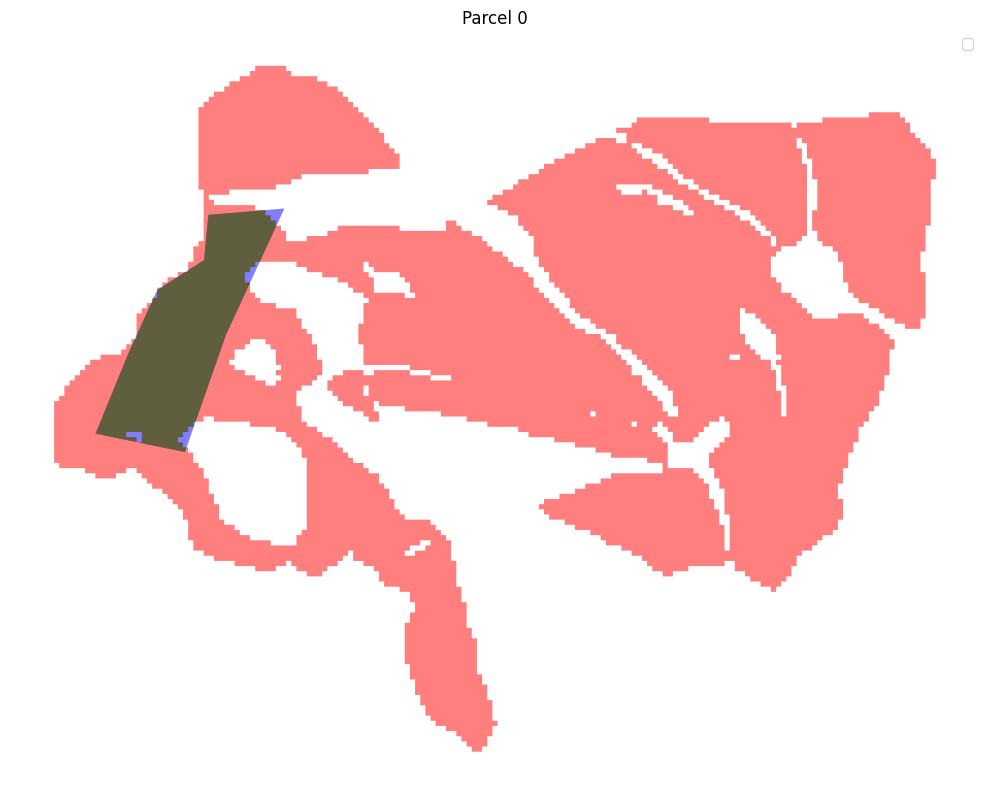

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 0:
True Positive (Correctly predicted): 17716.30 m²
False Negative (Missed): 538.99 m²
Adjusted IoU: 0.97




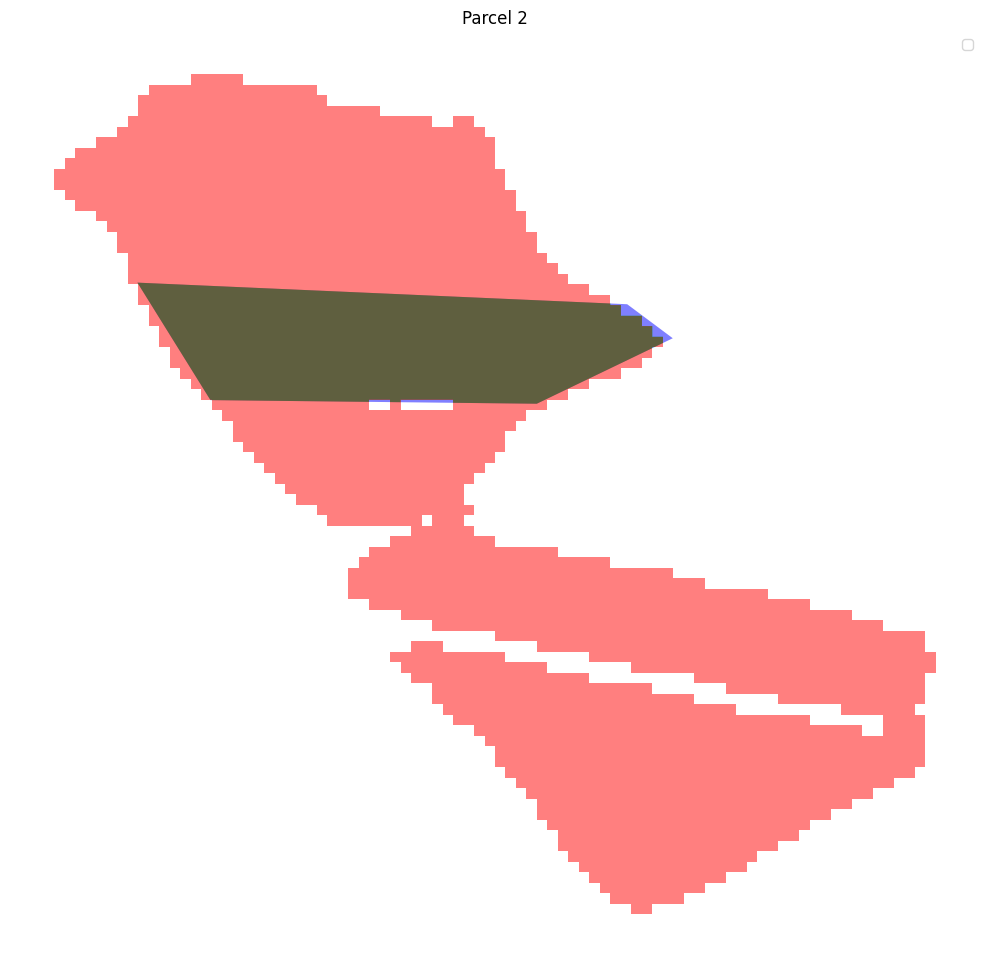

Parcel 2:
True Positive (Correctly predicted): 10791.03 m²
False Negative (Missed): 138.19 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

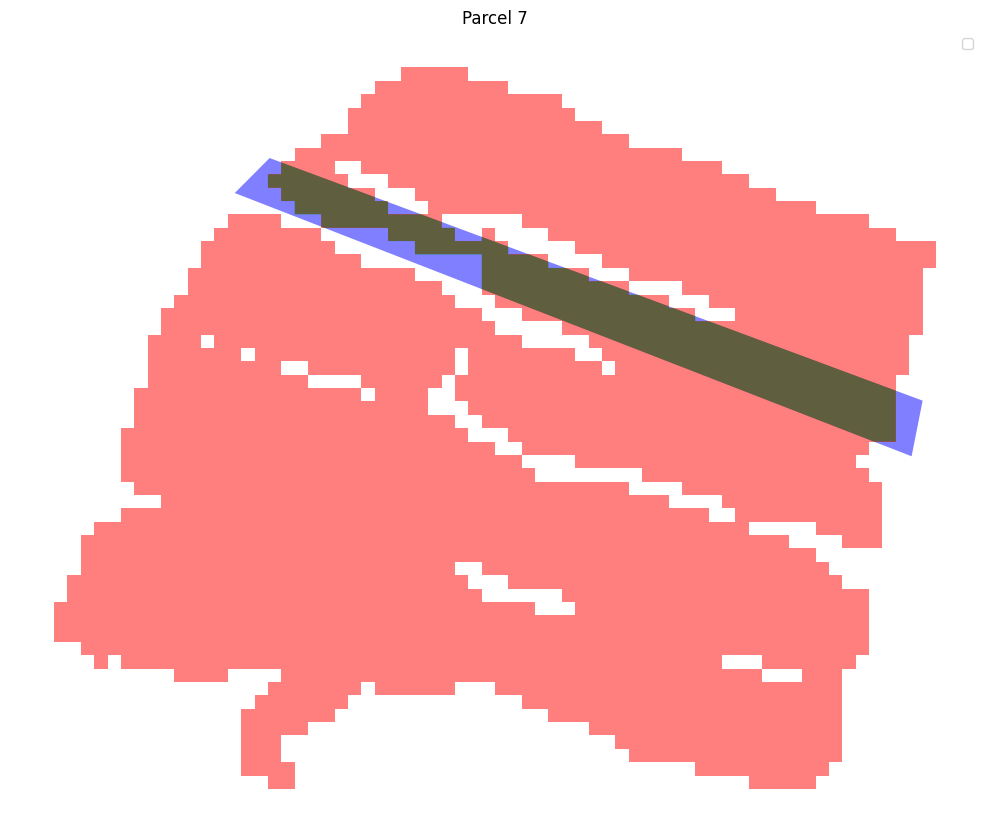

Parcel 7:
True Positive (Correctly predicted): 4138.29 m²
False Negative (Missed): 891.84 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

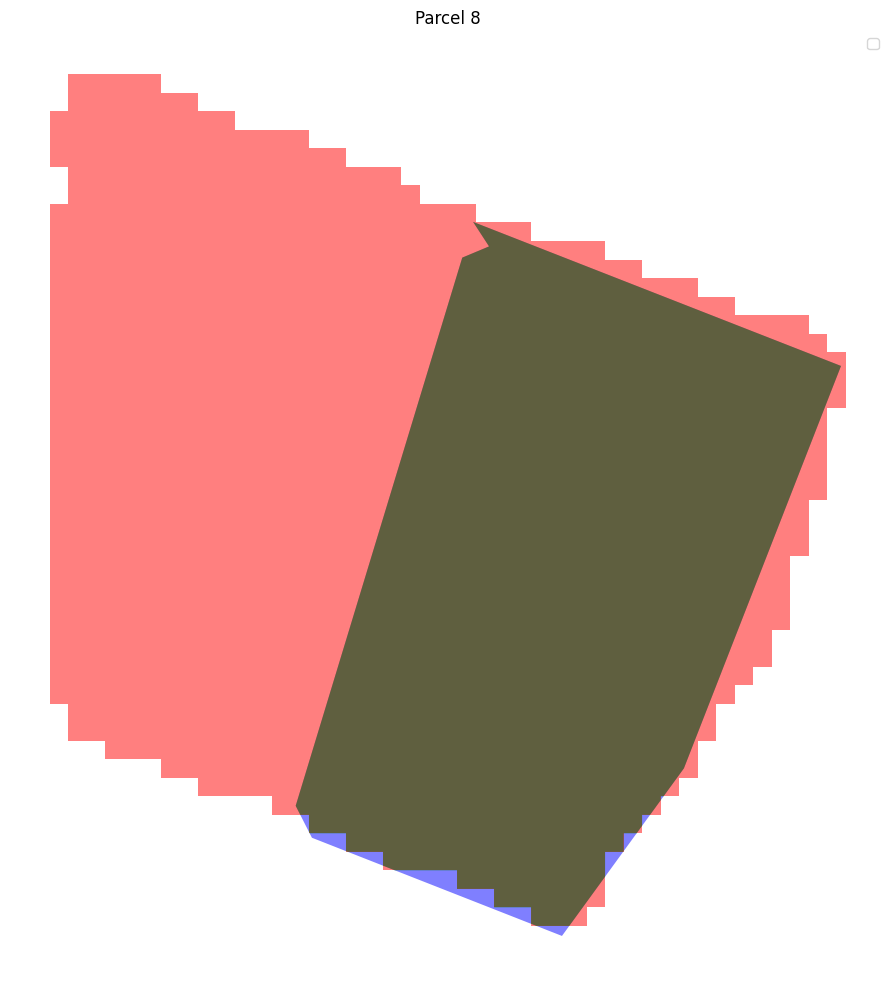

Parcel 8:
True Positive (Correctly predicted): 16455.67 m²
False Negative (Missed): 206.51 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

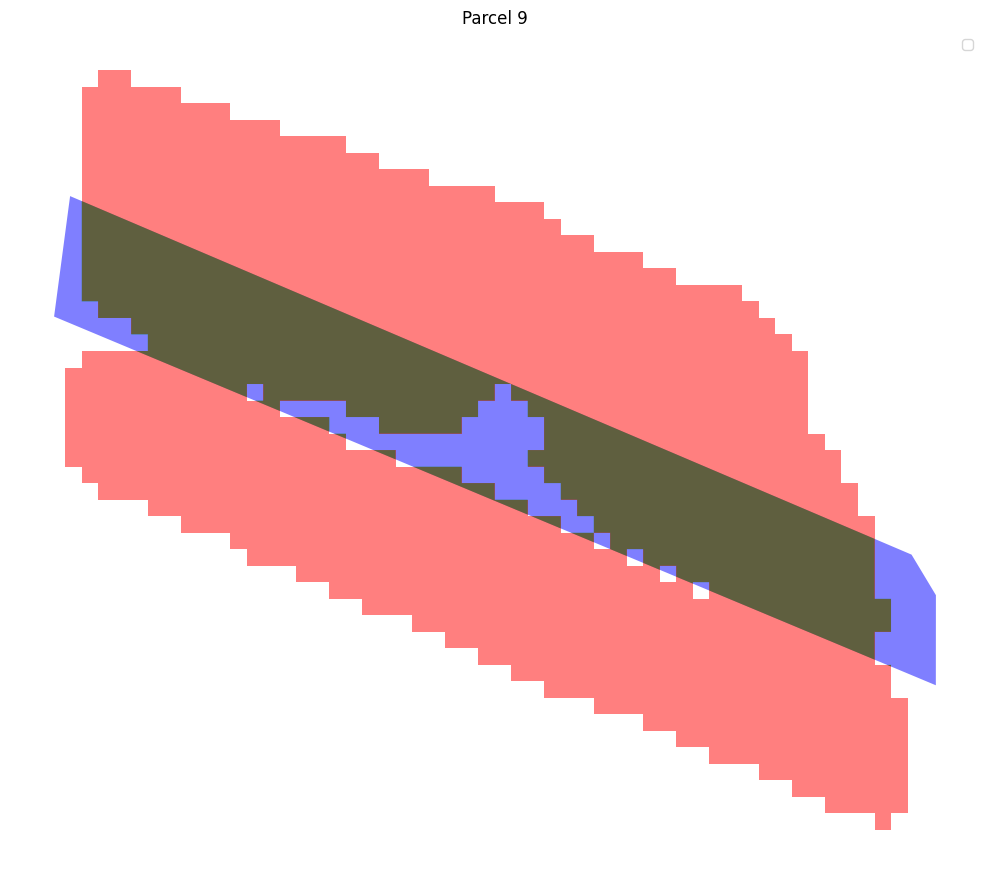

Parcel 9:
True Positive (Correctly predicted): 7609.54 m²
False Negative (Missed): 2265.06 m²
Adjusted IoU: 0.77




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

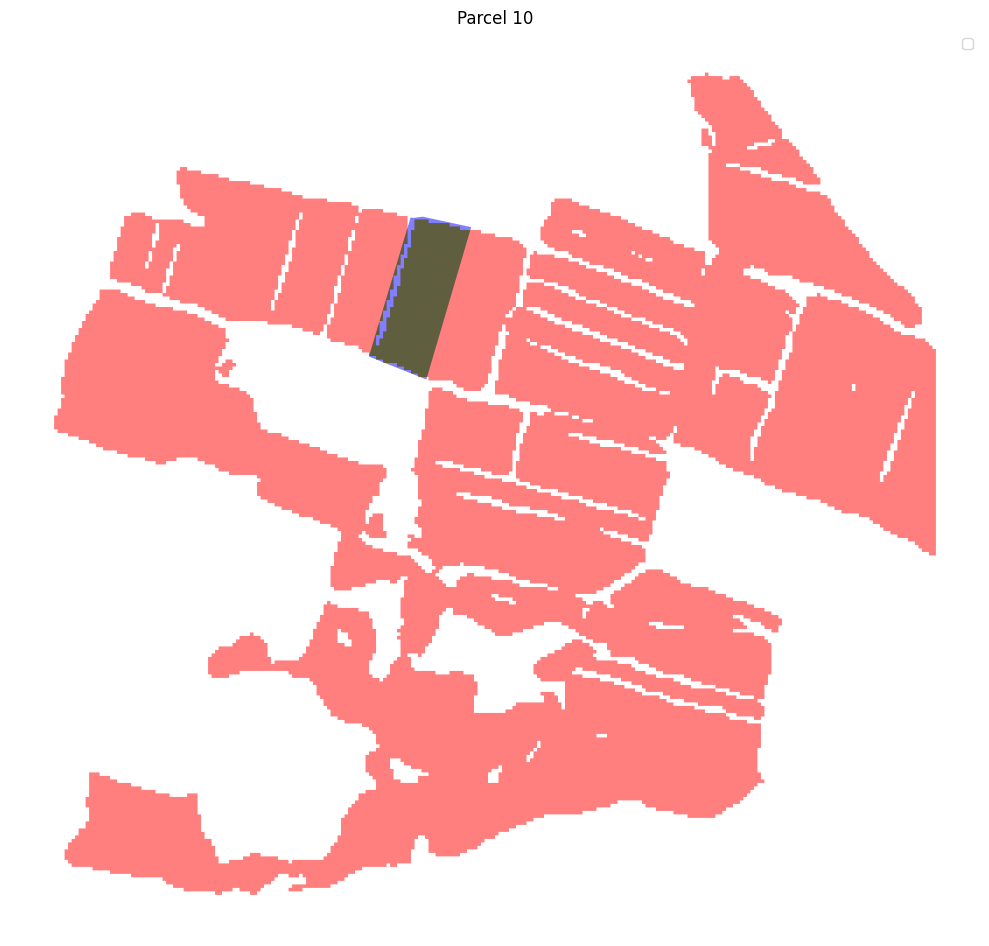

Parcel 10:
True Positive (Correctly predicted): 17209.98 m²
False Negative (Missed): 1916.36 m²
Adjusted IoU: 0.90




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

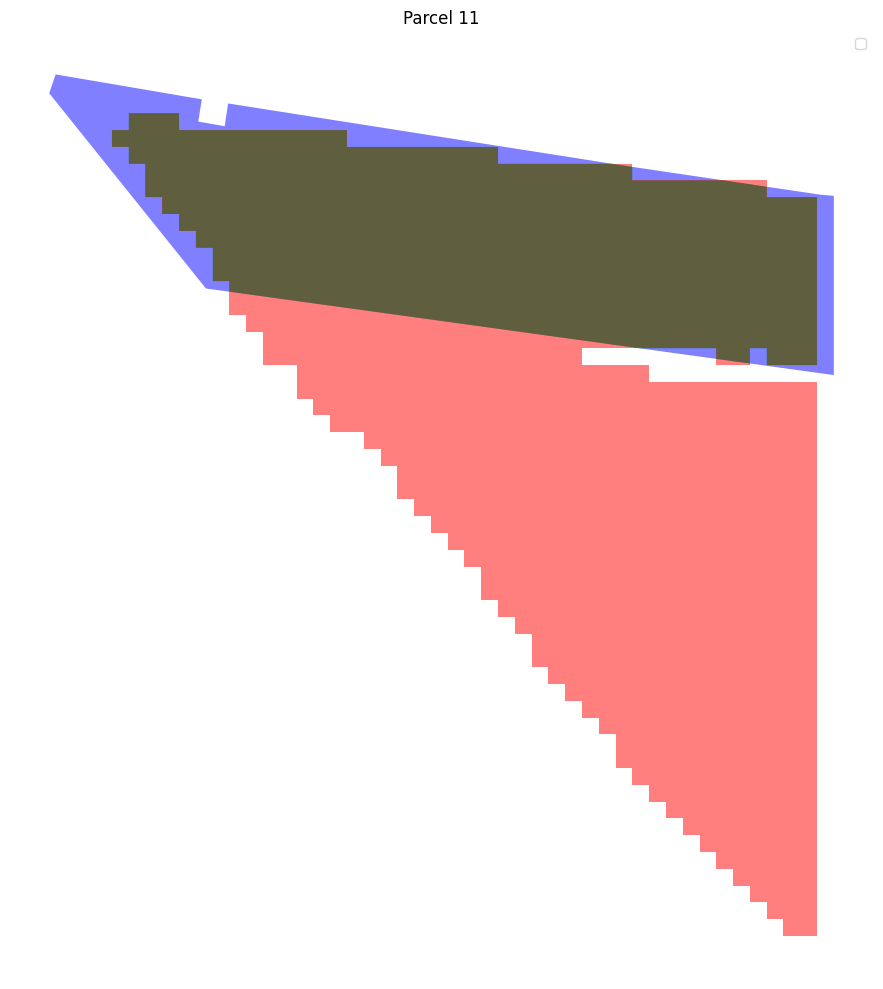

Parcel 11:
True Positive (Correctly predicted): 9842.61 m²
False Negative (Missed): 1727.57 m²
Adjusted IoU: 0.85




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

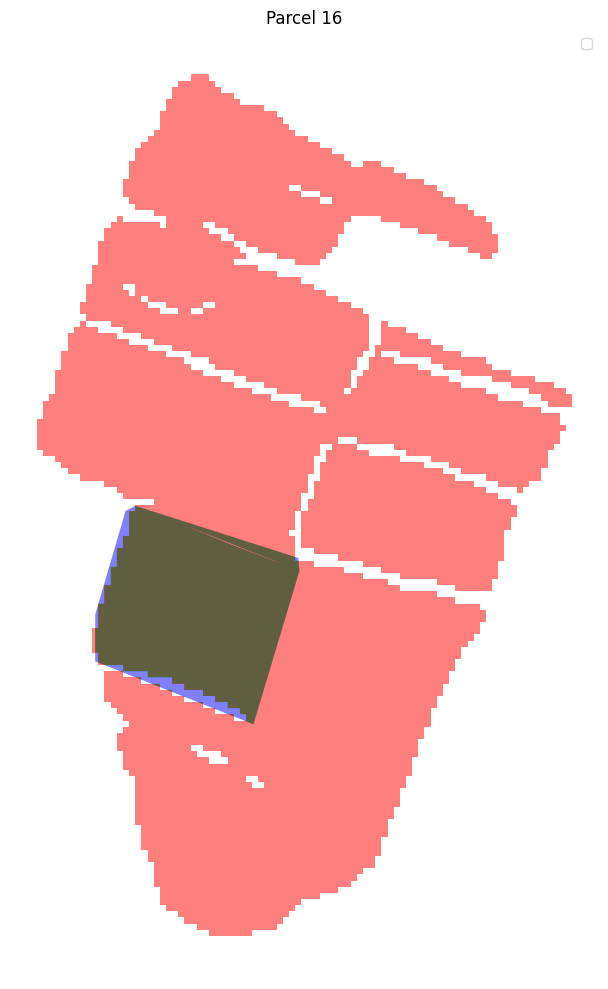

Parcel 16:
True Positive (Correctly predicted): 18649.50 m²
False Negative (Missed): 1141.13 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

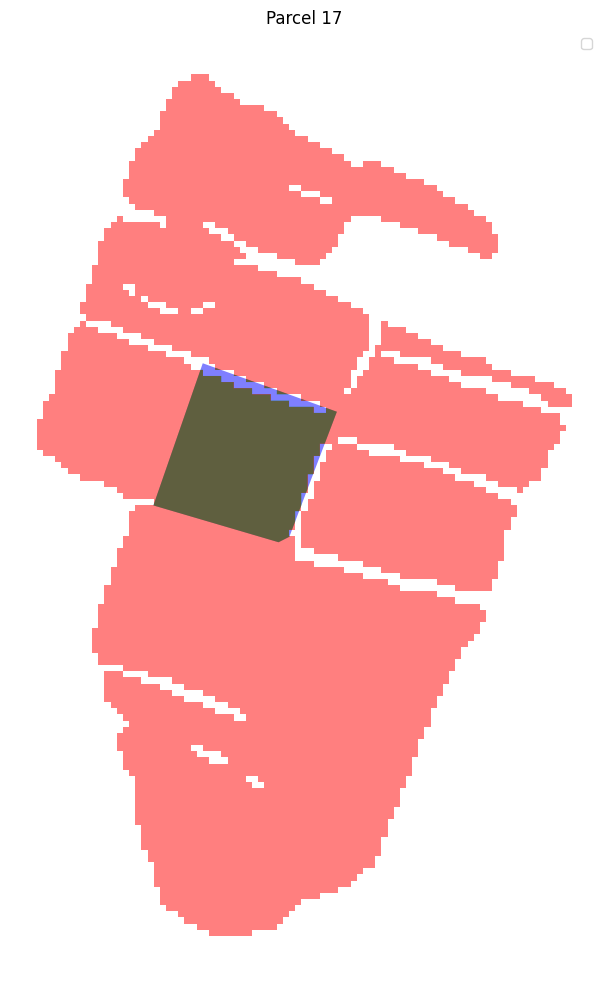

Parcel 17:
True Positive (Correctly predicted): 12715.59 m²
False Negative (Missed): 826.72 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

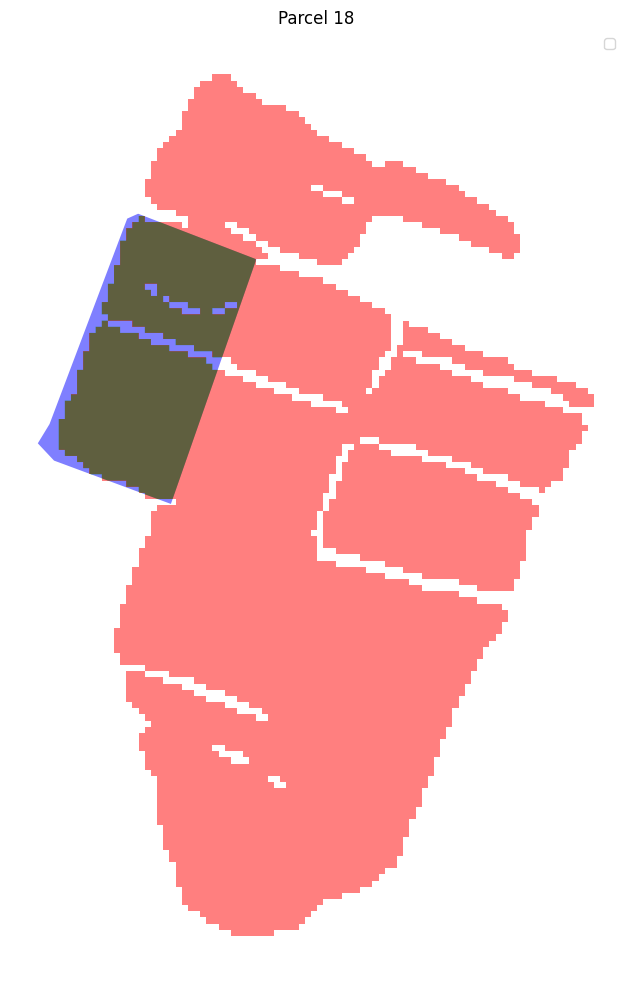

Parcel 18:
True Positive (Correctly predicted): 20744.32 m²
False Negative (Missed): 2975.70 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

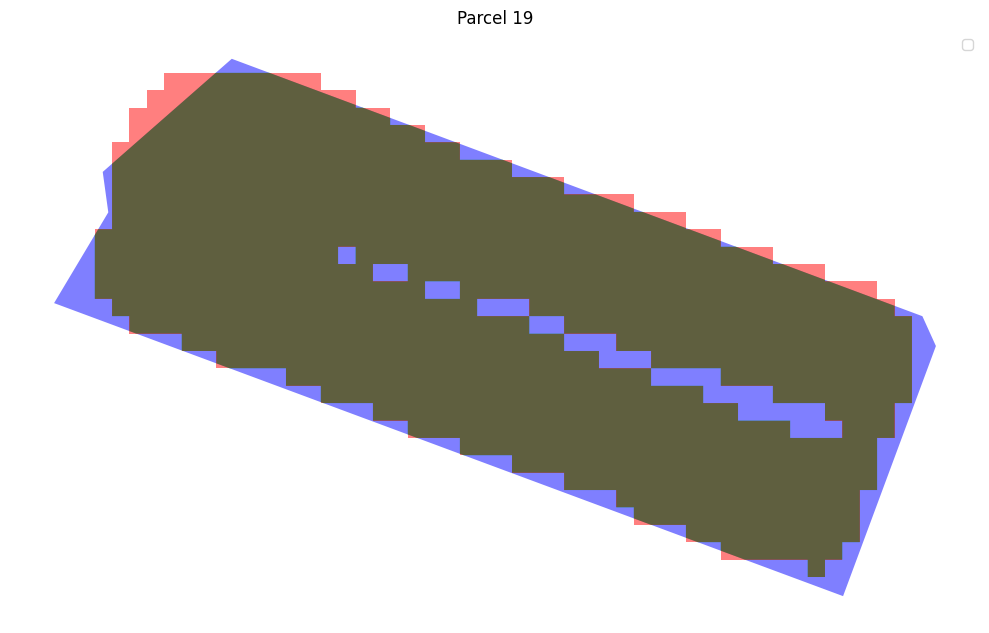

Parcel 19:
True Positive (Correctly predicted): 17595.80 m²
False Negative (Missed): 1978.11 m²
Adjusted IoU: 0.90




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

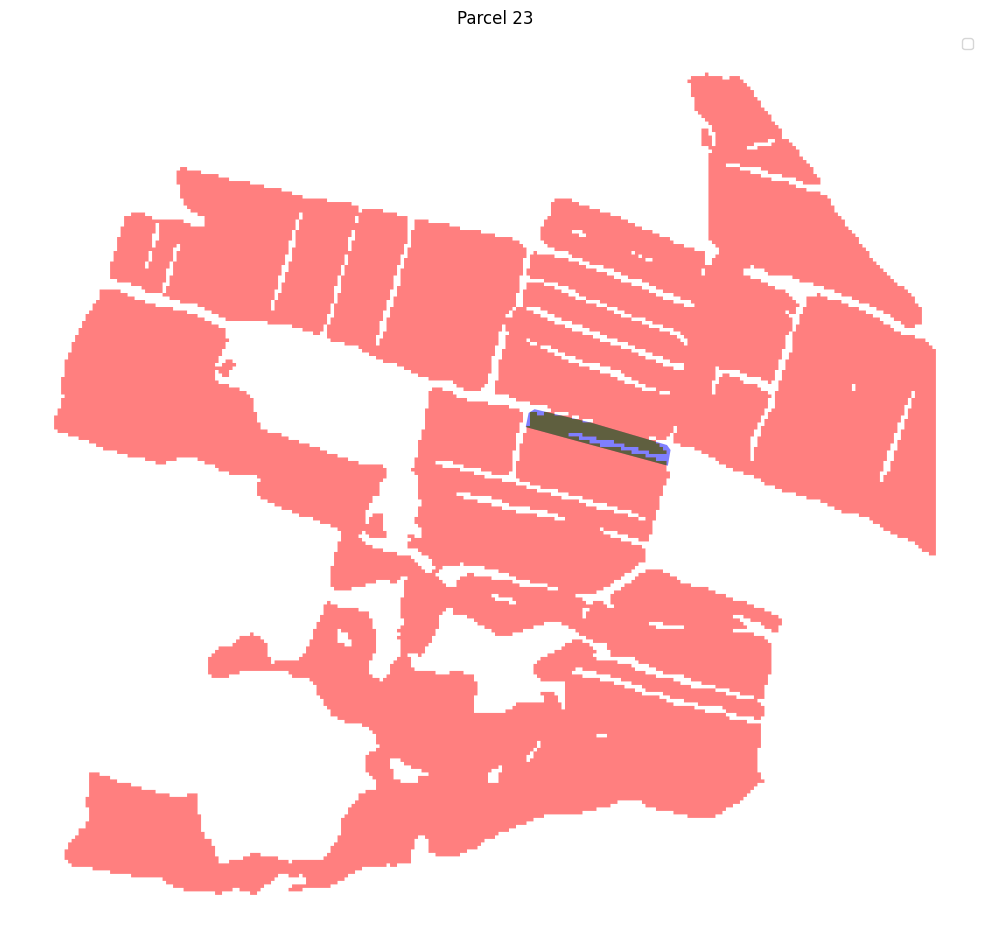

Parcel 23:
True Positive (Correctly predicted): 4651.41 m²
False Negative (Missed): 1439.07 m²
Adjusted IoU: 0.76




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

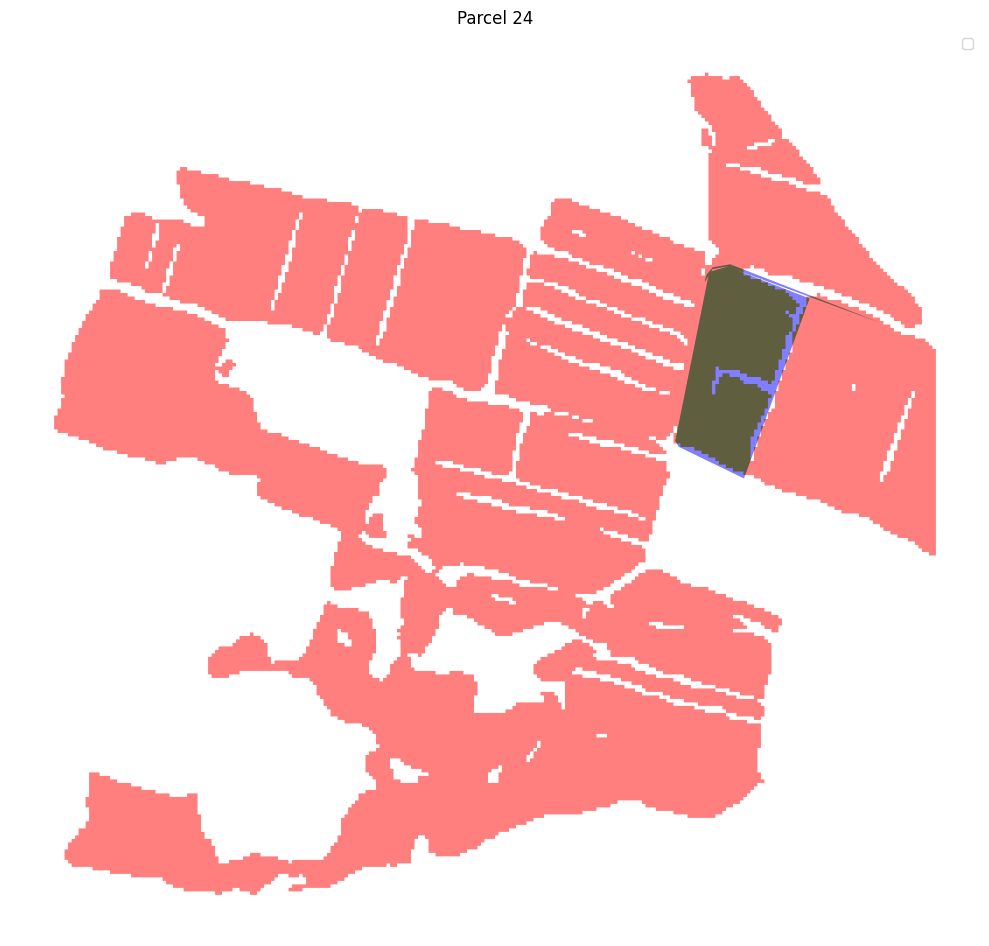

Parcel 24:
True Positive (Correctly predicted): 31072.11 m²
False Negative (Missed): 4194.83 m²
Adjusted IoU: 0.88




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

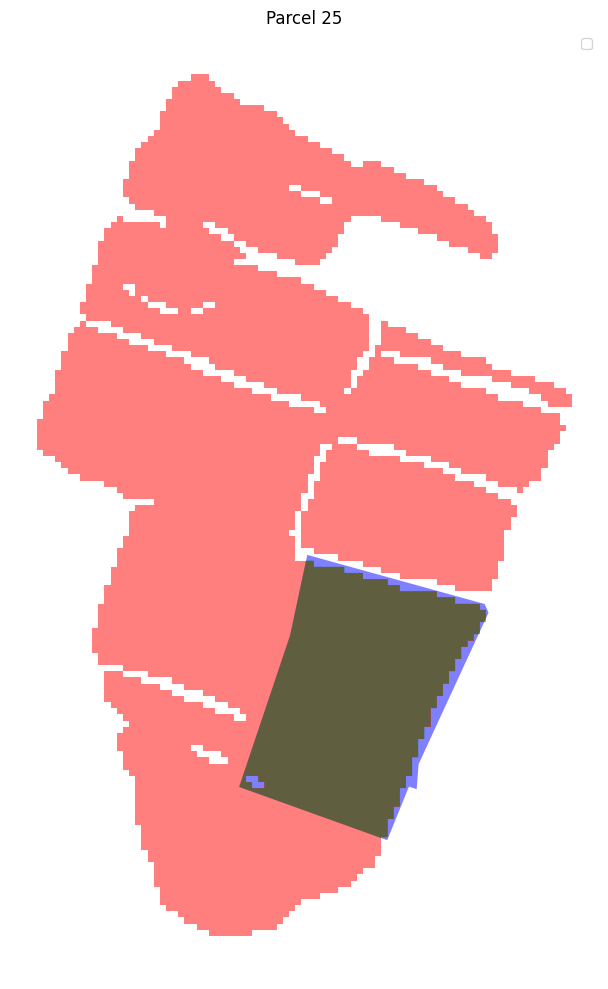

Parcel 25:
True Positive (Correctly predicted): 26116.17 m²
False Negative (Missed): 1781.68 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

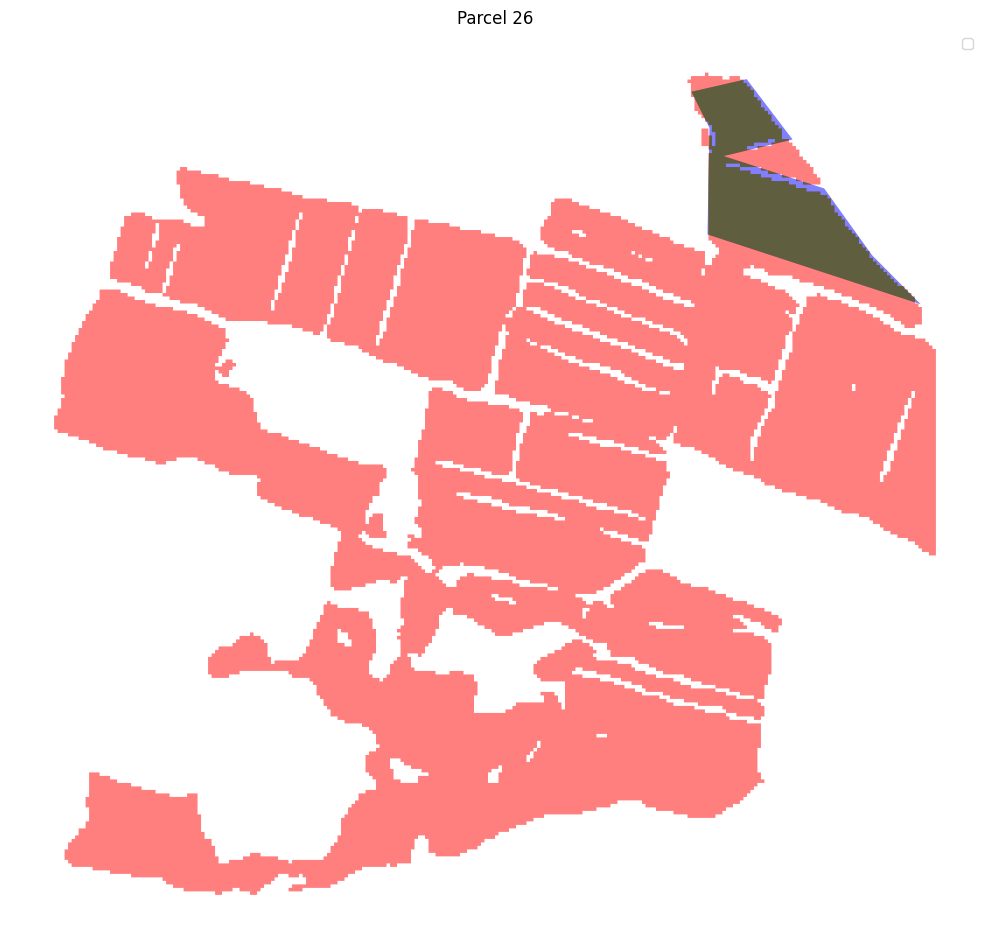

Parcel 26:
True Positive (Correctly predicted): 33805.72 m²
False Negative (Missed): 2837.69 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

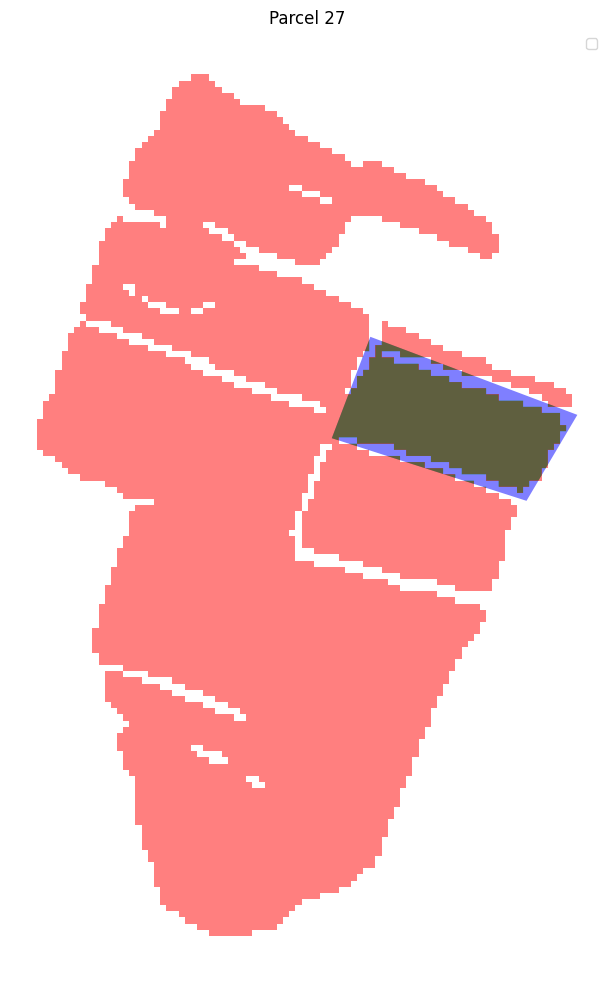

Parcel 27:
True Positive (Correctly predicted): 11771.49 m²
False Negative (Missed): 2725.29 m²
Adjusted IoU: 0.81




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

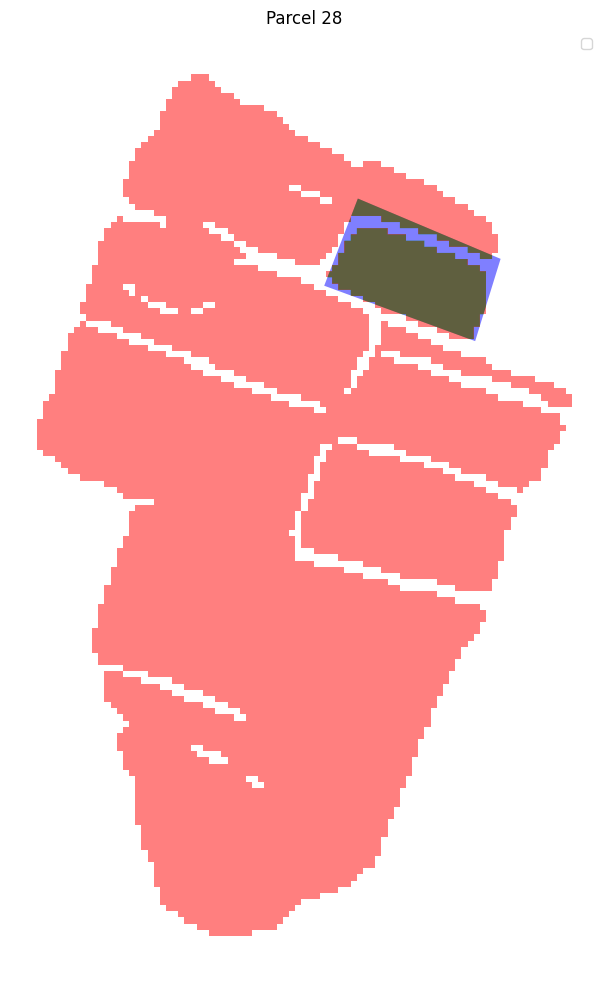

Parcel 28:
True Positive (Correctly predicted): 7768.34 m²
False Negative (Missed): 1571.22 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

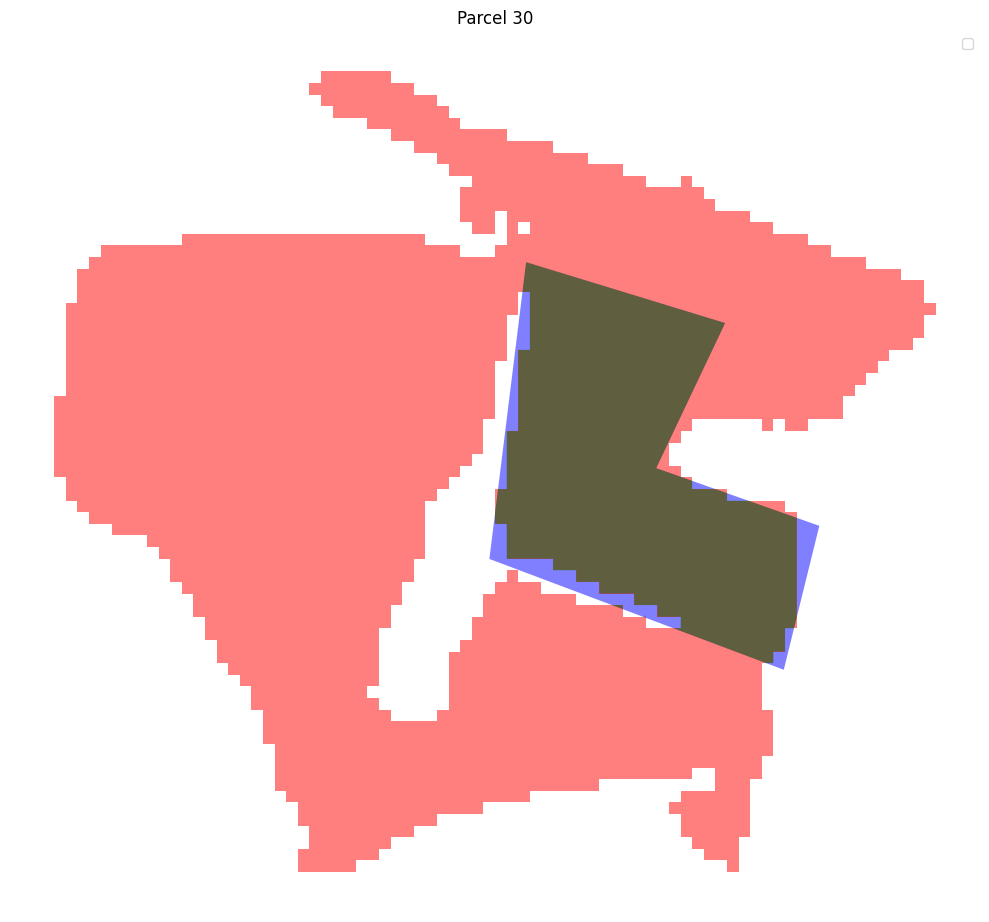

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 30:
True Positive (Correctly predicted): 12768.88 m²
False Negative (Missed): 1154.21 m²
Adjusted IoU: 0.92




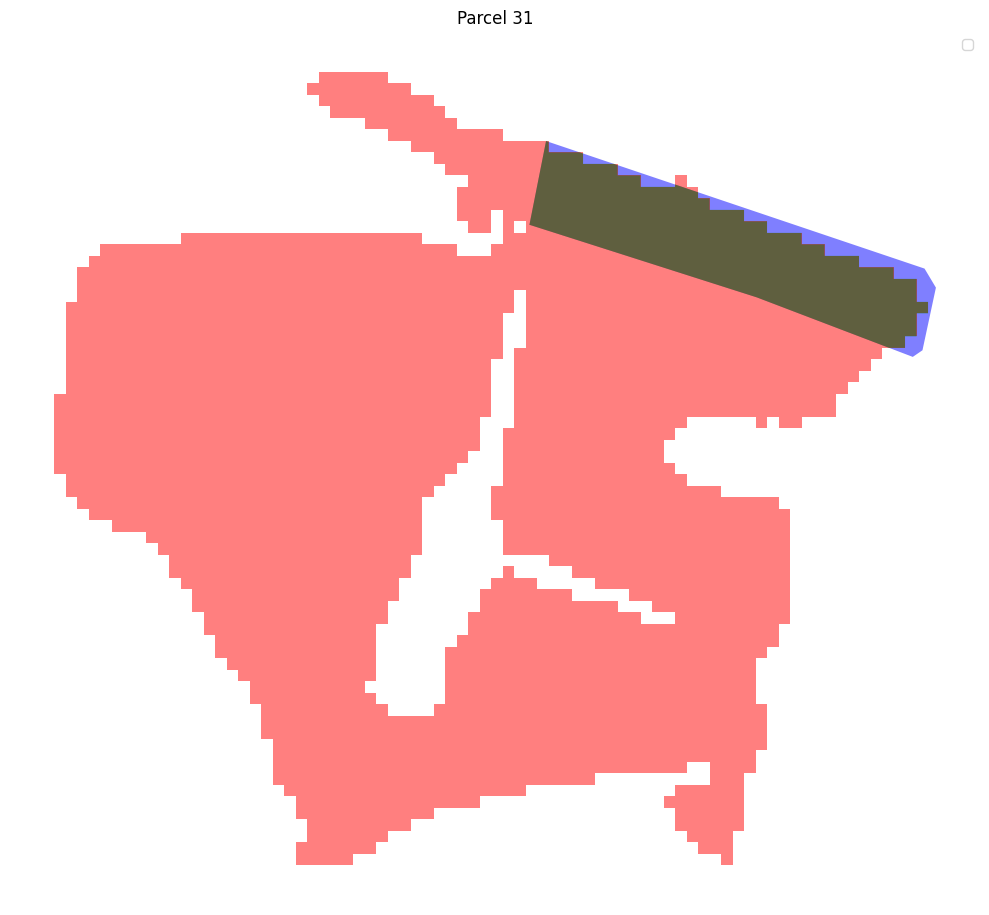

Parcel 31:
True Positive (Correctly predicted): 5622.47 m²
False Negative (Missed): 876.58 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

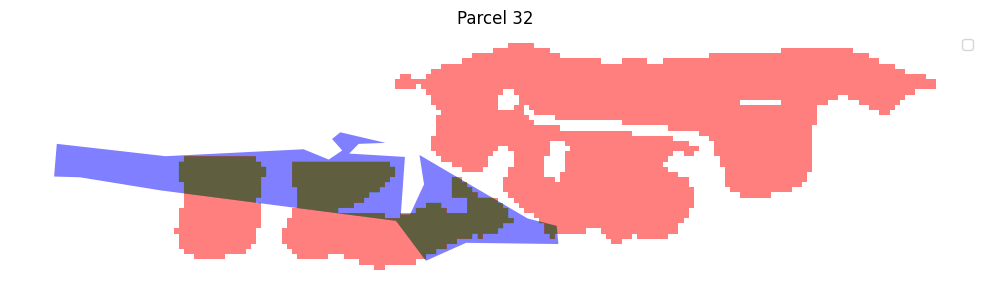

Parcel 32:
True Positive (Correctly predicted): 11261.47 m²
False Negative (Missed): 11577.88 m²
Adjusted IoU: 0.49




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

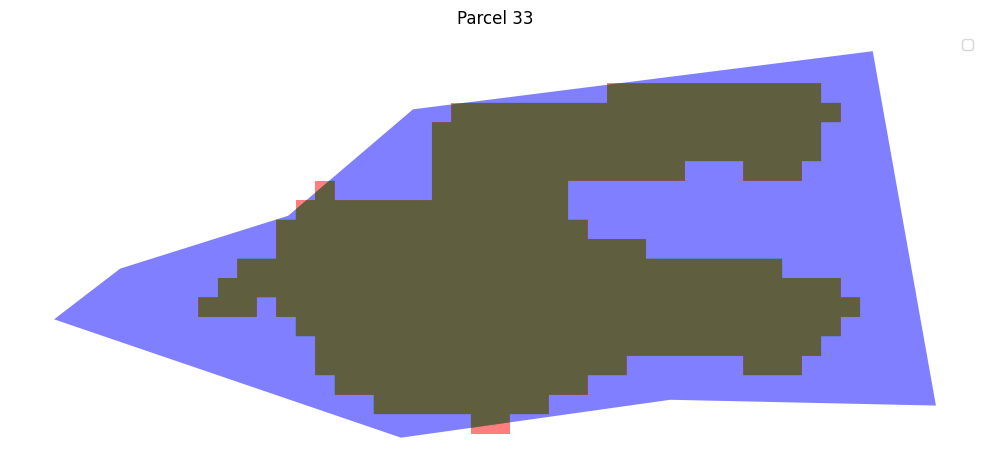

Parcel 33:
True Positive (Correctly predicted): 8317.76 m²
False Negative (Missed): 6153.49 m²
Adjusted IoU: 0.57




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

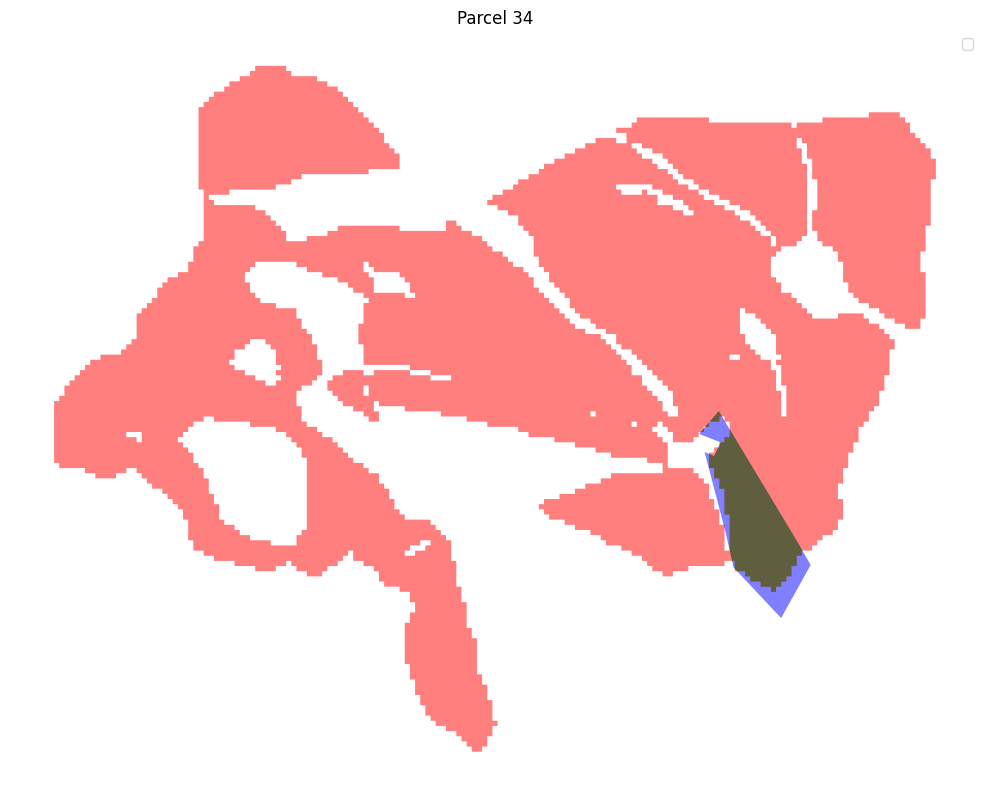

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 34:
True Positive (Correctly predicted): 6787.35 m²
False Negative (Missed): 2087.26 m²
Adjusted IoU: 0.76




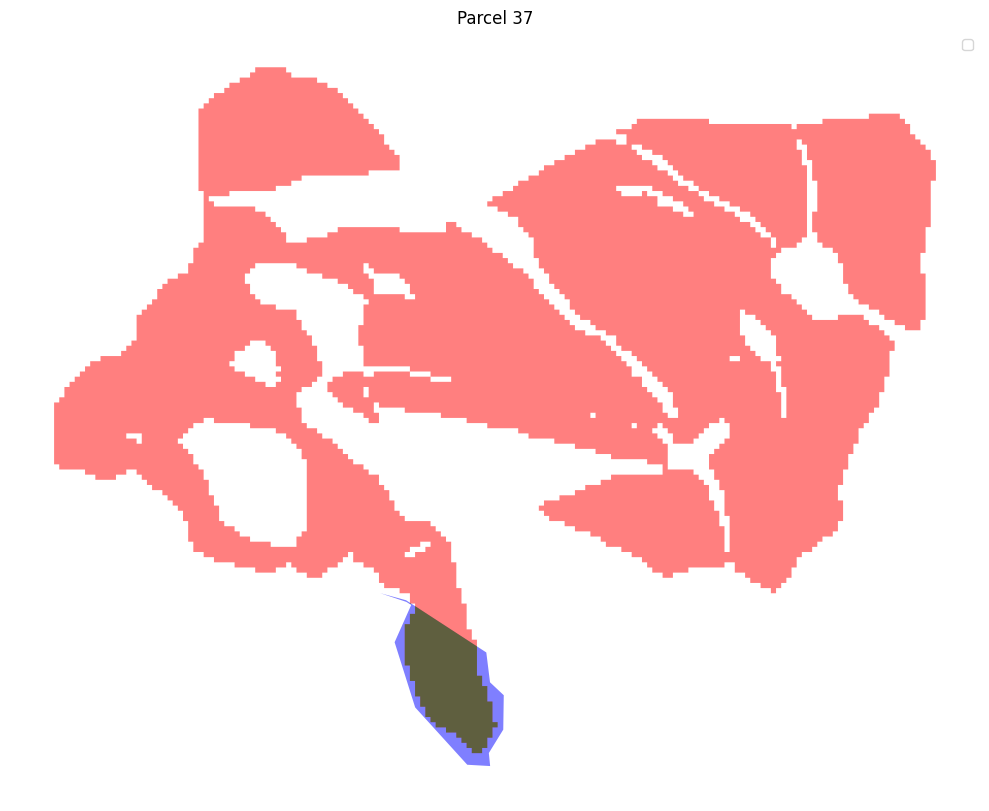

Parcel 37:
True Positive (Correctly predicted): 7356.17 m²
False Negative (Missed): 2381.13 m²
Adjusted IoU: 0.76




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

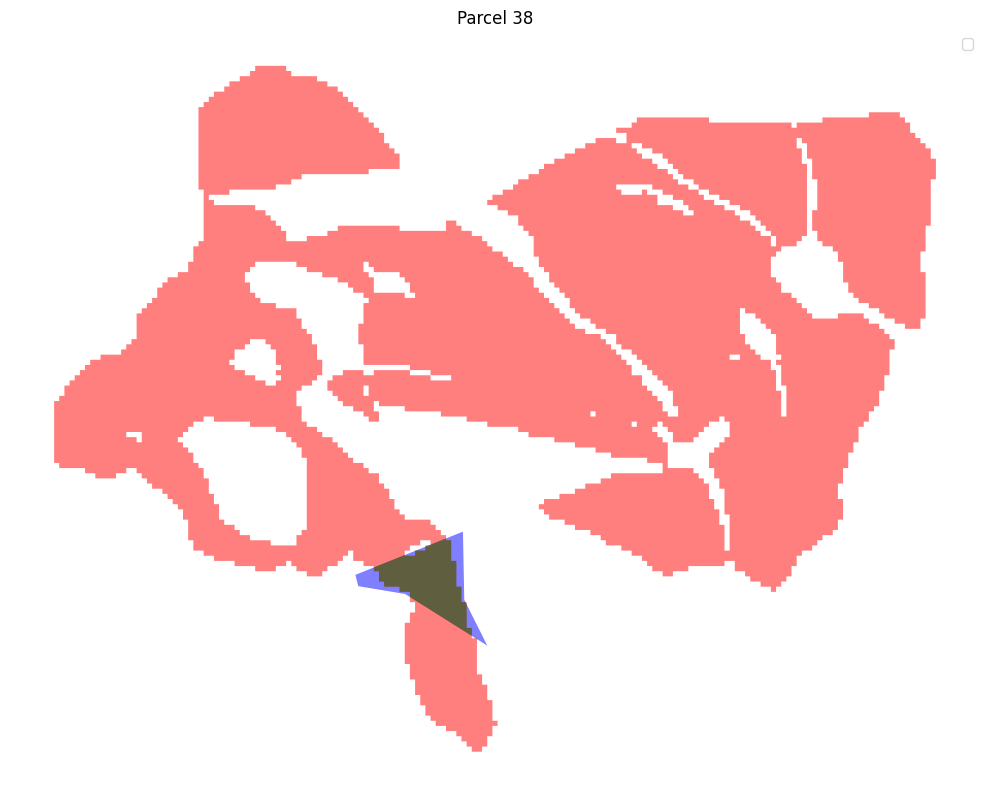

Parcel 38:
True Positive (Correctly predicted): 3999.51 m²
False Negative (Missed): 1318.61 m²
Adjusted IoU: 0.75




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

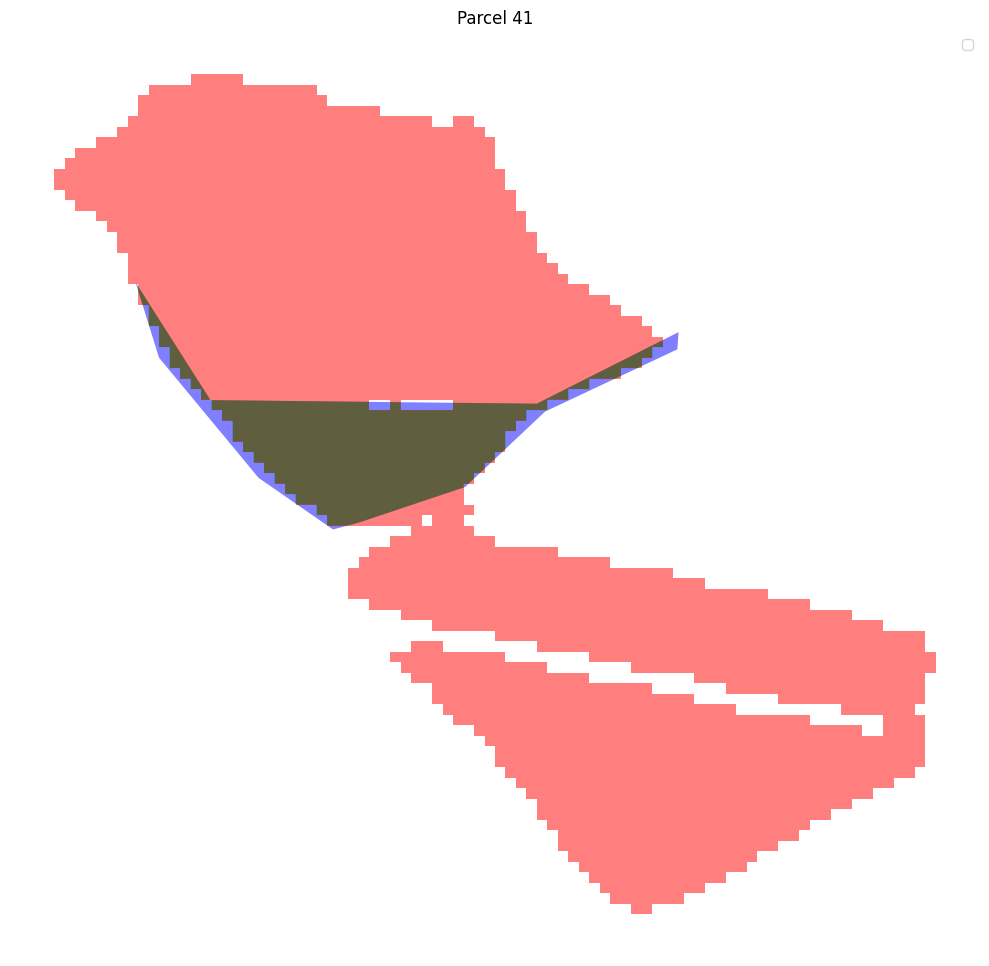

Parcel 41:
True Positive (Correctly predicted): 6209.70 m²
False Negative (Missed): 959.04 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

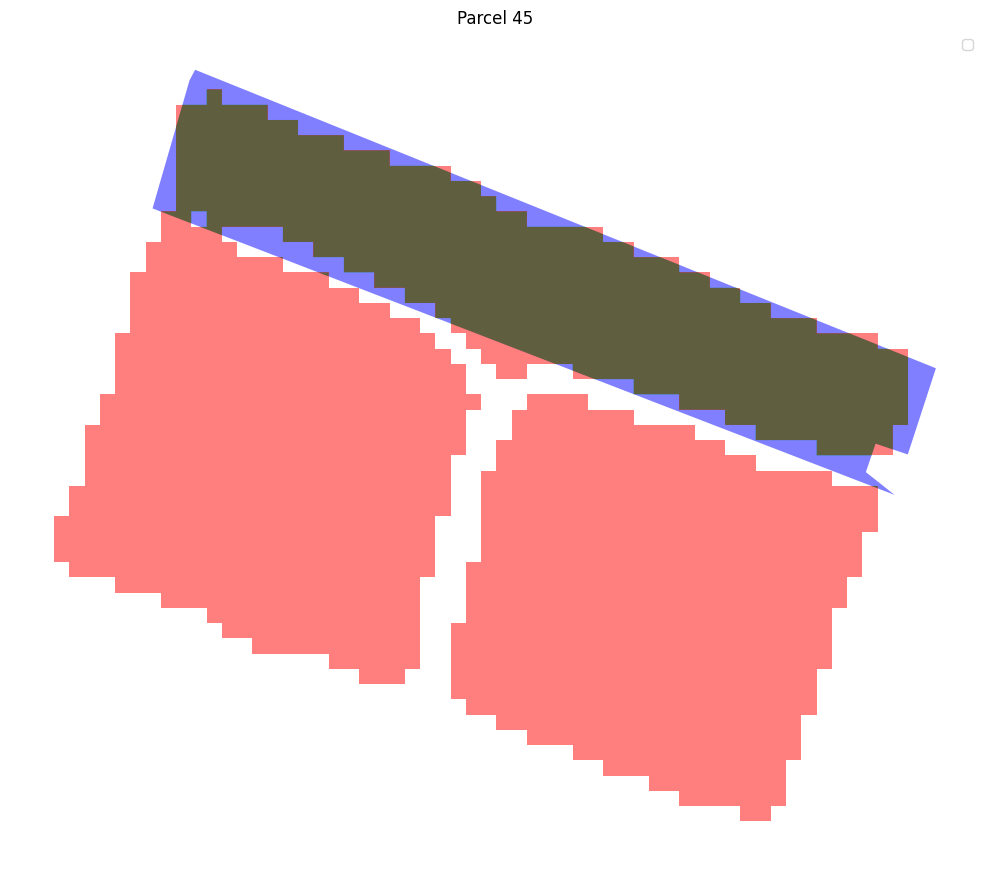

Parcel 45:
True Positive (Correctly predicted): 10035.91 m²
False Negative (Missed): 1739.25 m²
Adjusted IoU: 0.85




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

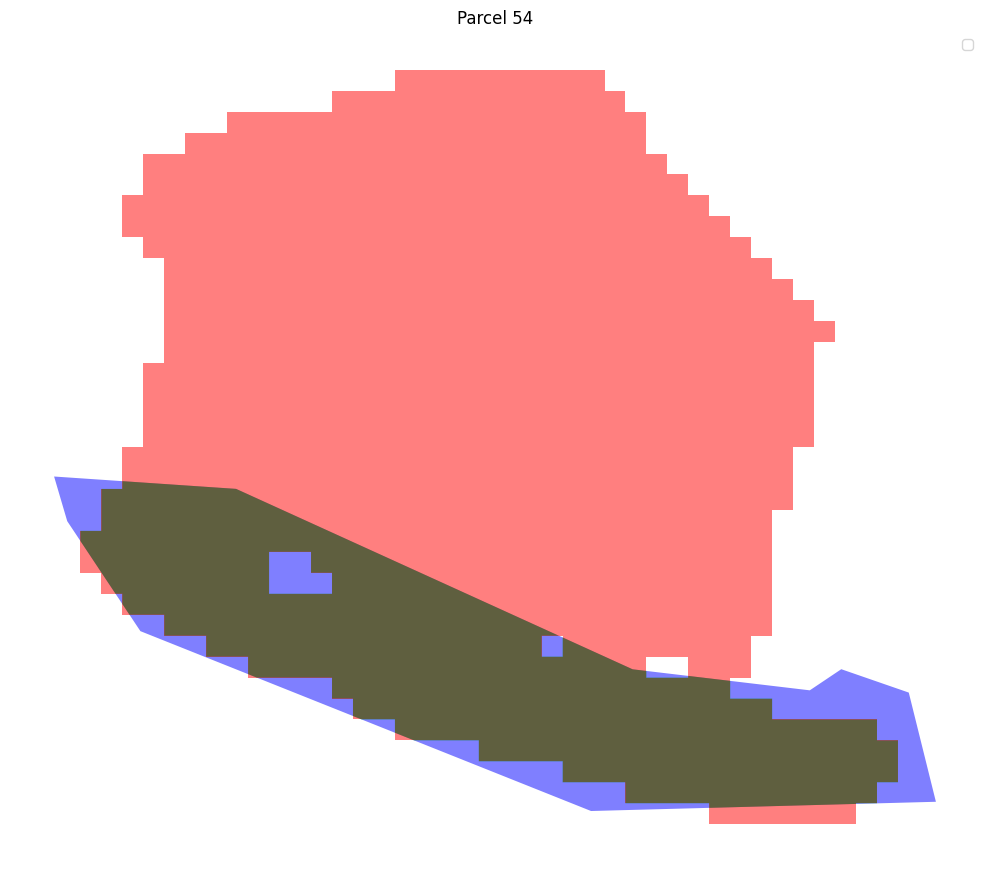

Parcel 54:
True Positive (Correctly predicted): 5931.74 m²
False Negative (Missed): 1249.26 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

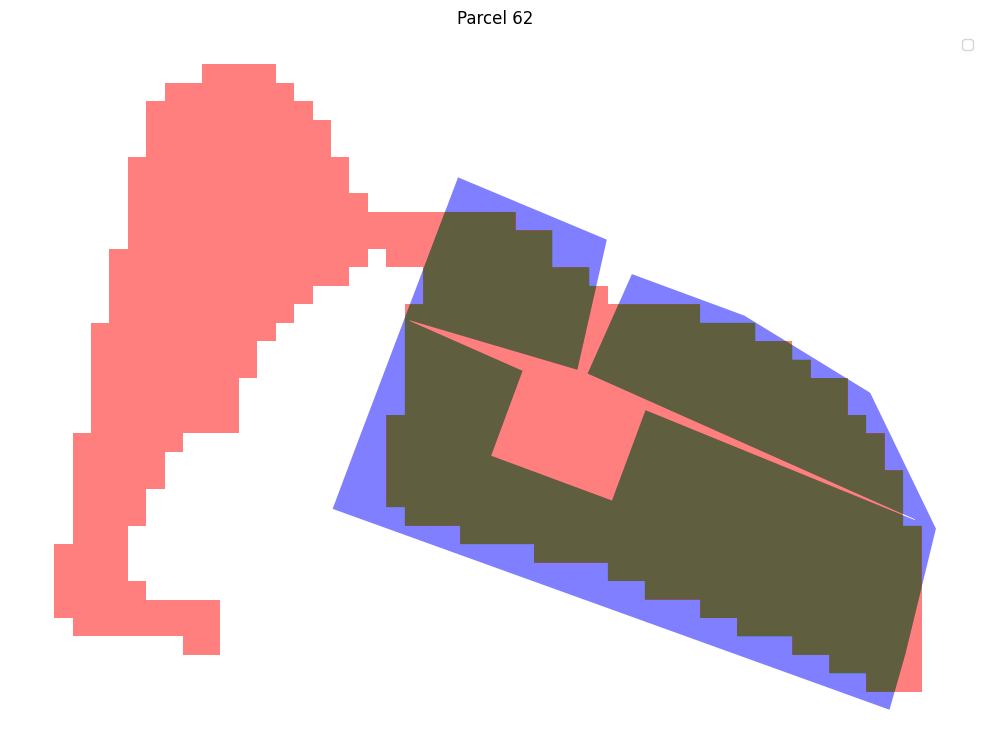

Parcel 62:
True Positive (Correctly predicted): 9565.67 m²
False Negative (Missed): 2196.63 m²
Adjusted IoU: 0.81




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

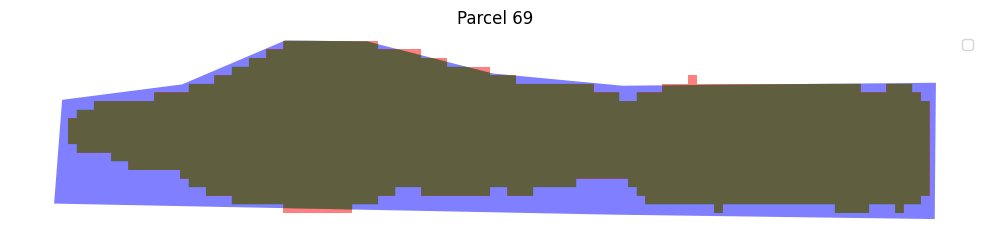

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 69:
True Positive (Correctly predicted): 33712.98 m²
False Negative (Missed): 6984.19 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


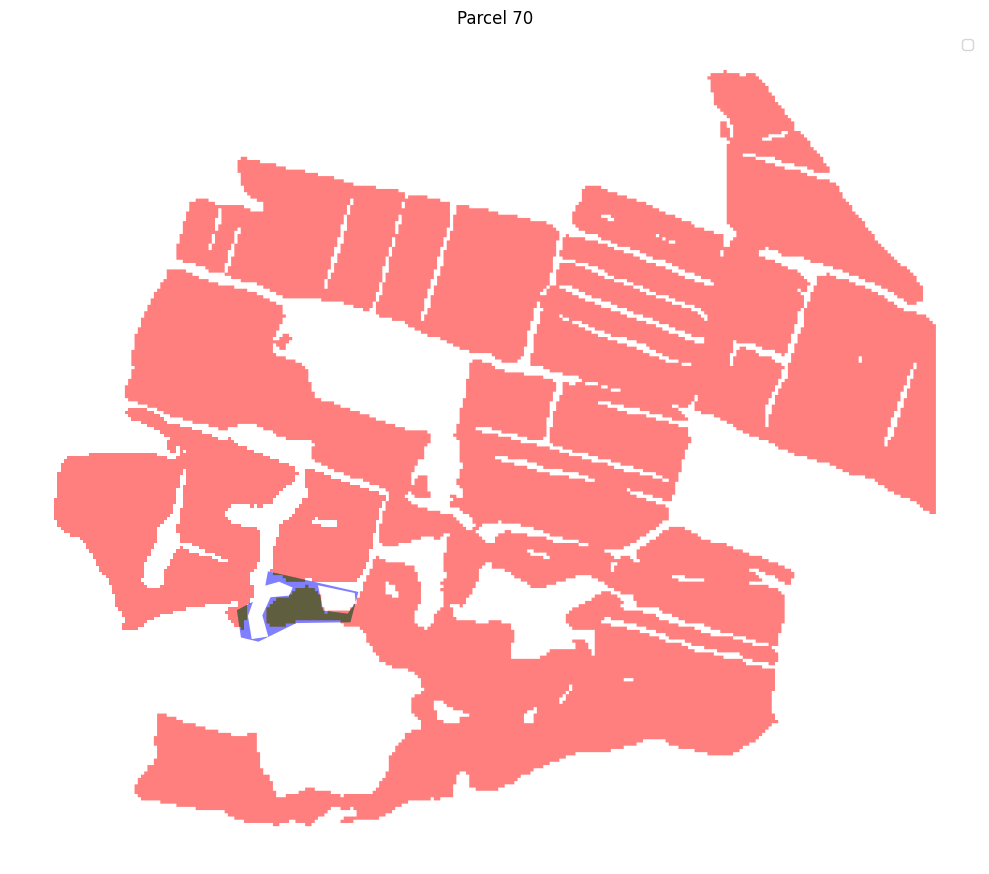

Parcel 70:
True Positive (Correctly predicted): 5134.98 m²
False Negative (Missed): 2701.60 m²
Adjusted IoU: 0.66




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

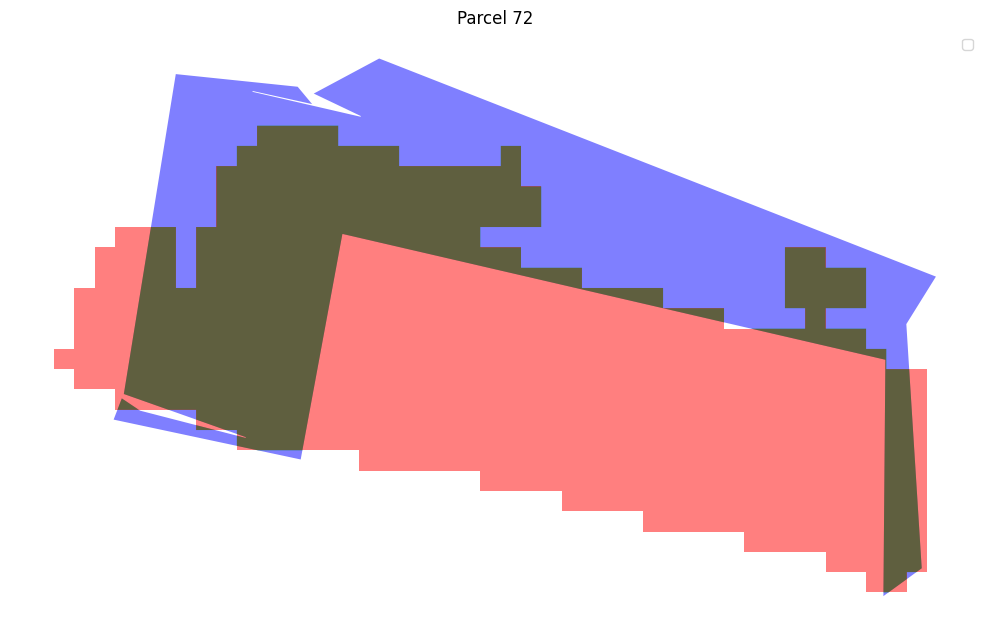

Parcel 72:
True Positive (Correctly predicted): 4898.70 m²
False Negative (Missed): 4452.99 m²
Adjusted IoU: 0.52




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

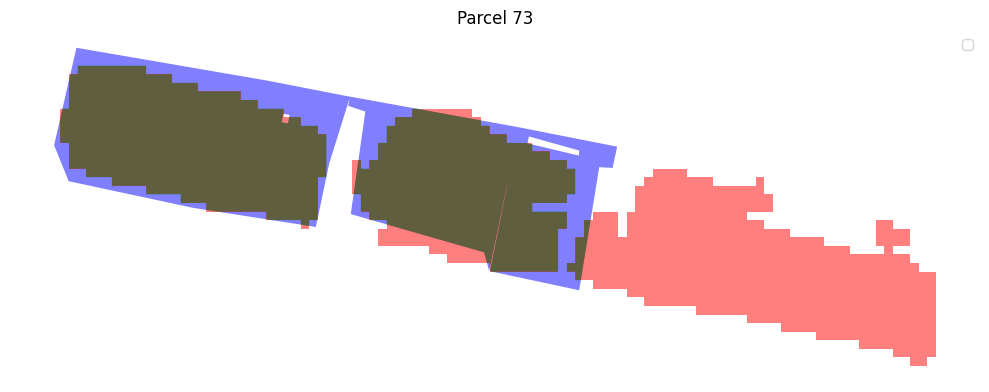

Parcel 73:
True Positive (Correctly predicted): 17883.32 m²
False Negative (Missed): 5388.07 m²
Adjusted IoU: 0.77




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


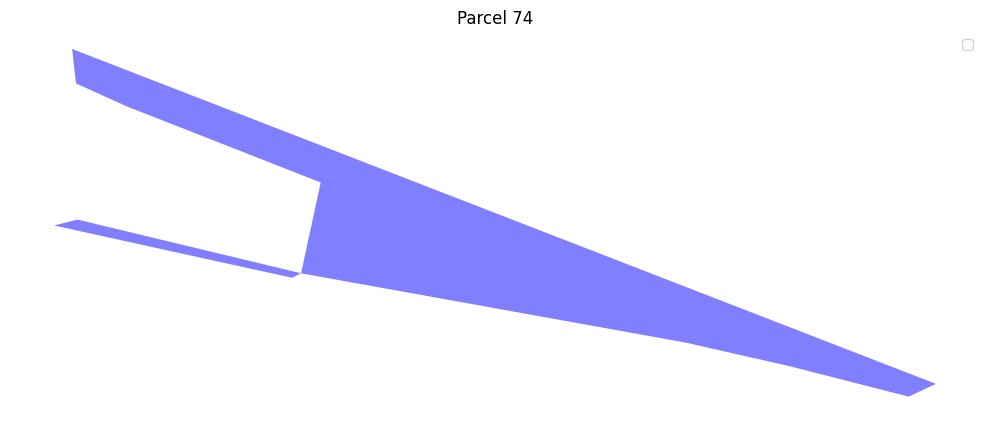

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 74:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 9043.76 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


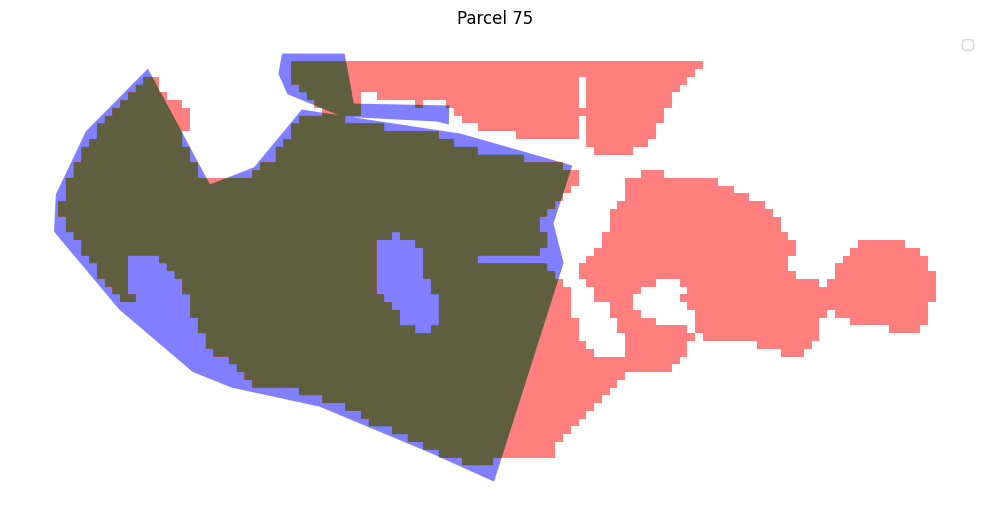

Parcel 75:
True Positive (Correctly predicted): 46072.39 m²
False Negative (Missed): 8664.37 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

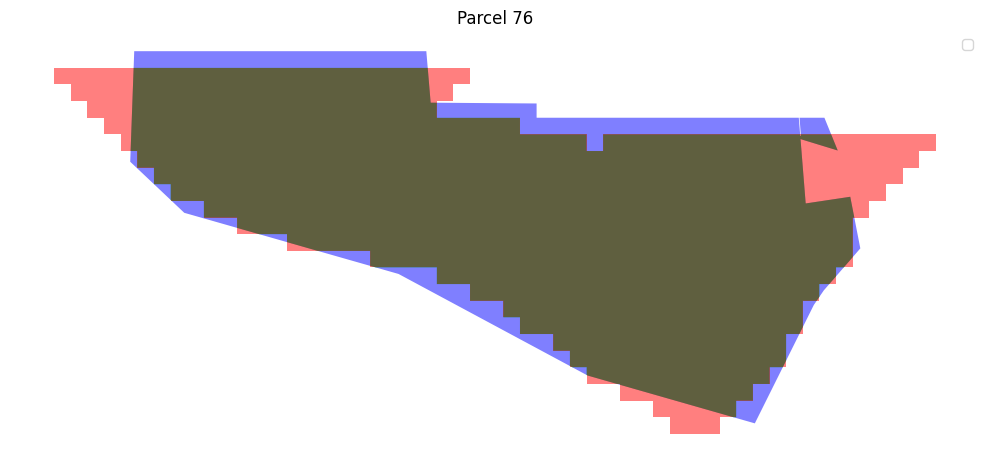

Parcel 76:
True Positive (Correctly predicted): 12466.34 m²
False Negative (Missed): 1601.95 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

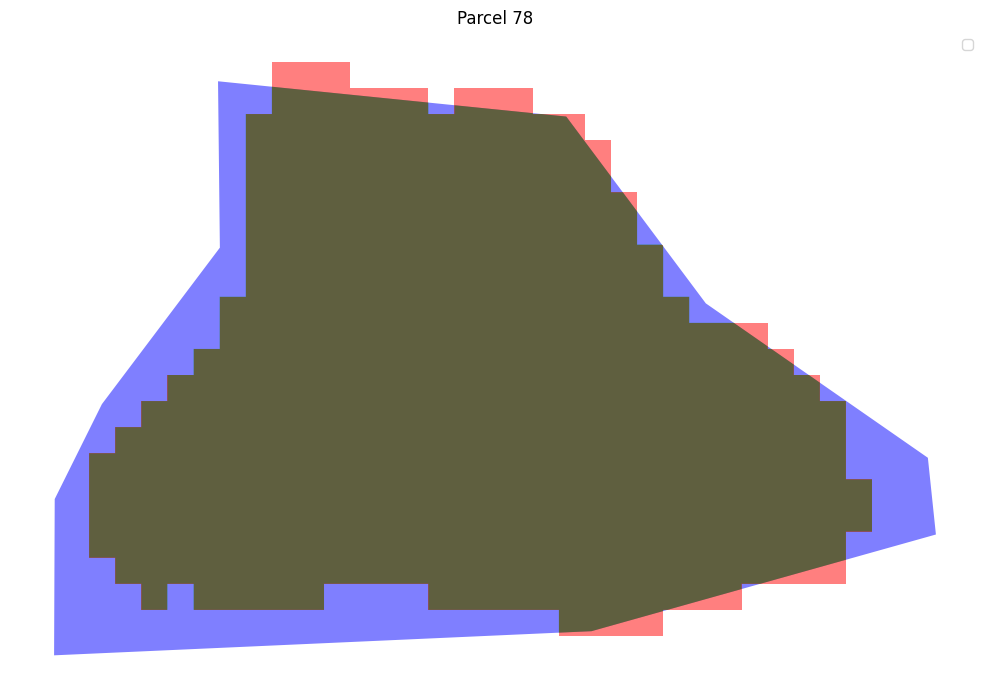

Parcel 78:
True Positive (Correctly predicted): 10283.98 m²
False Negative (Missed): 1994.19 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

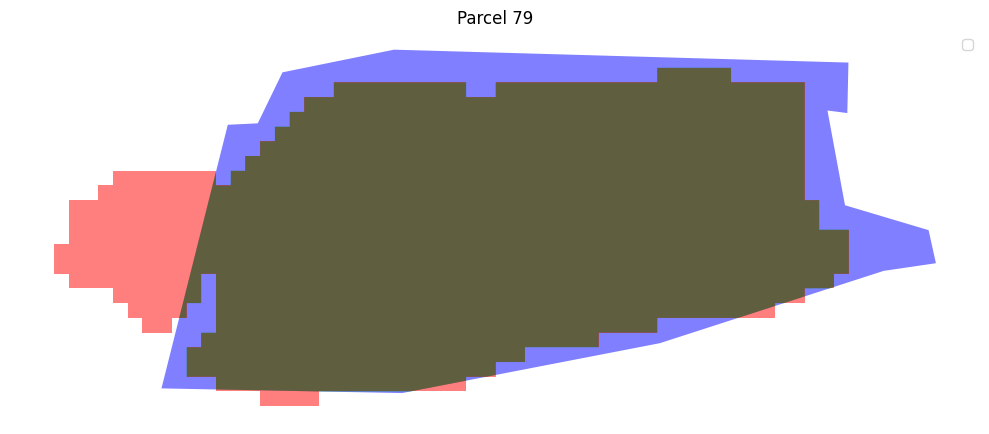

Parcel 79:
True Positive (Correctly predicted): 18703.10 m²
False Negative (Missed): 3882.91 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

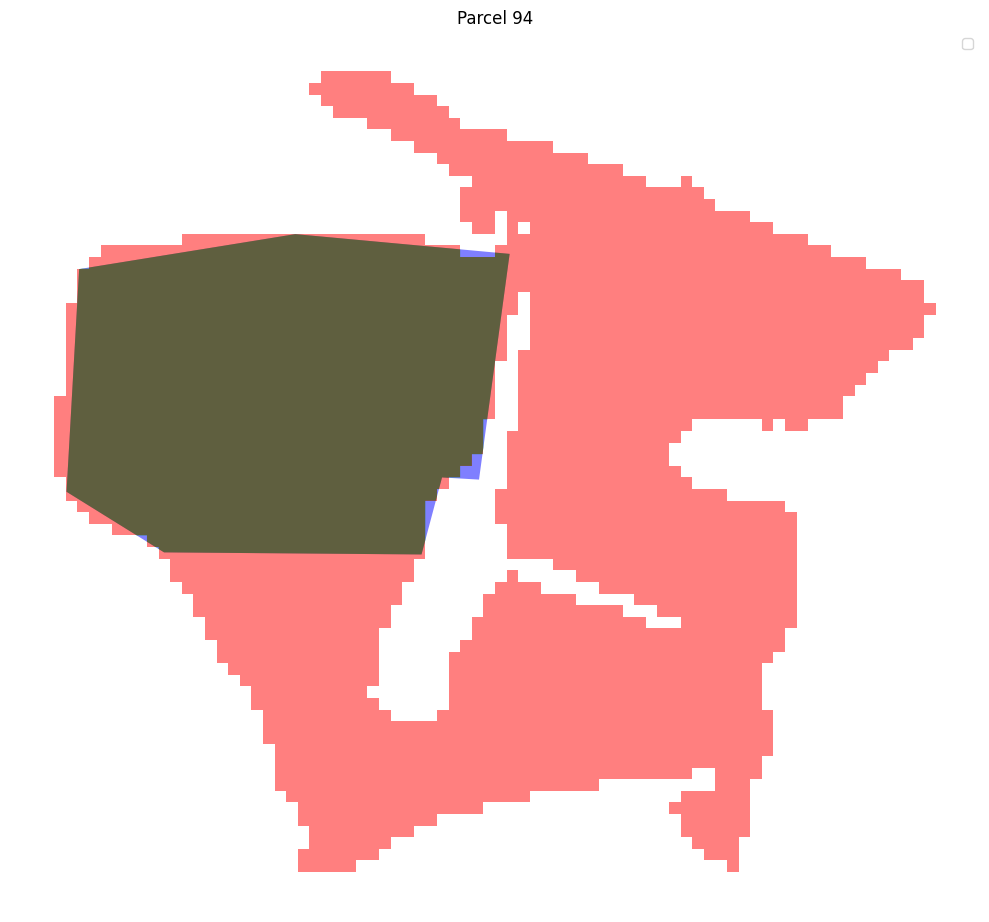

Parcel 94:
True Positive (Correctly predicted): 22381.08 m²
False Negative (Missed): 166.71 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

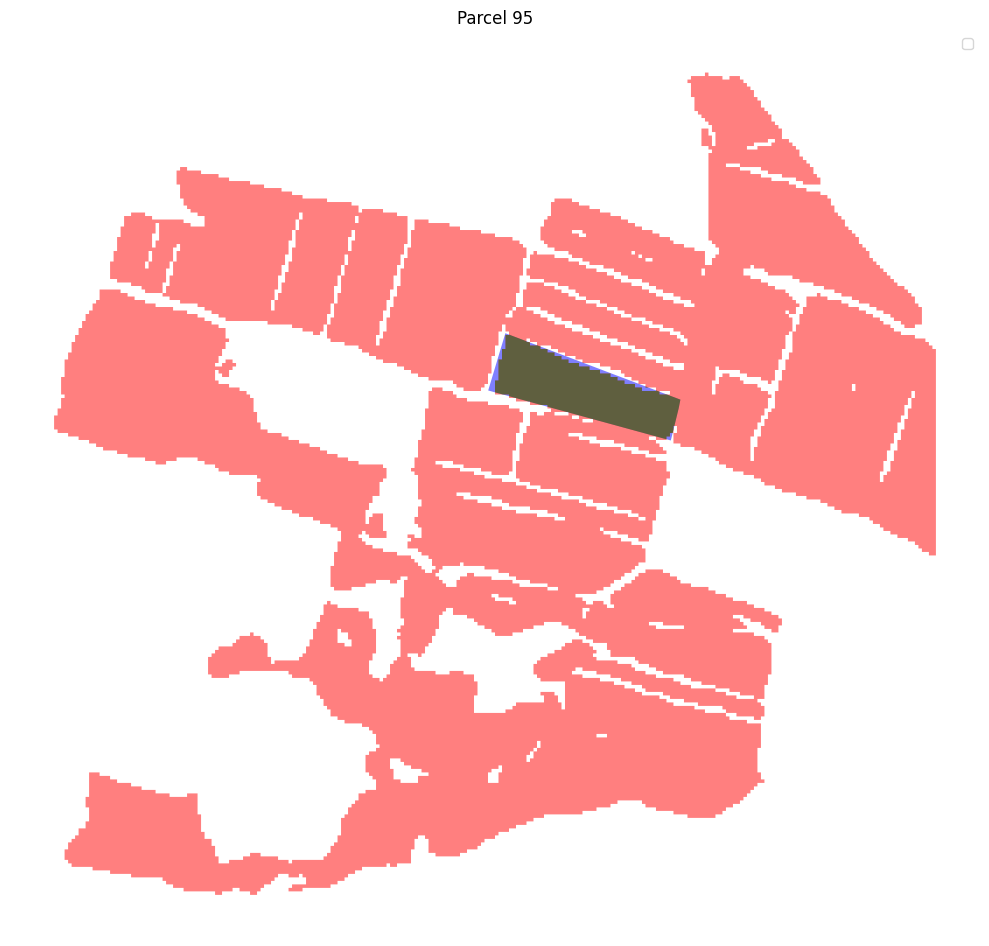

Parcel 95:
True Positive (Correctly predicted): 18226.29 m²
False Negative (Missed): 1277.26 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

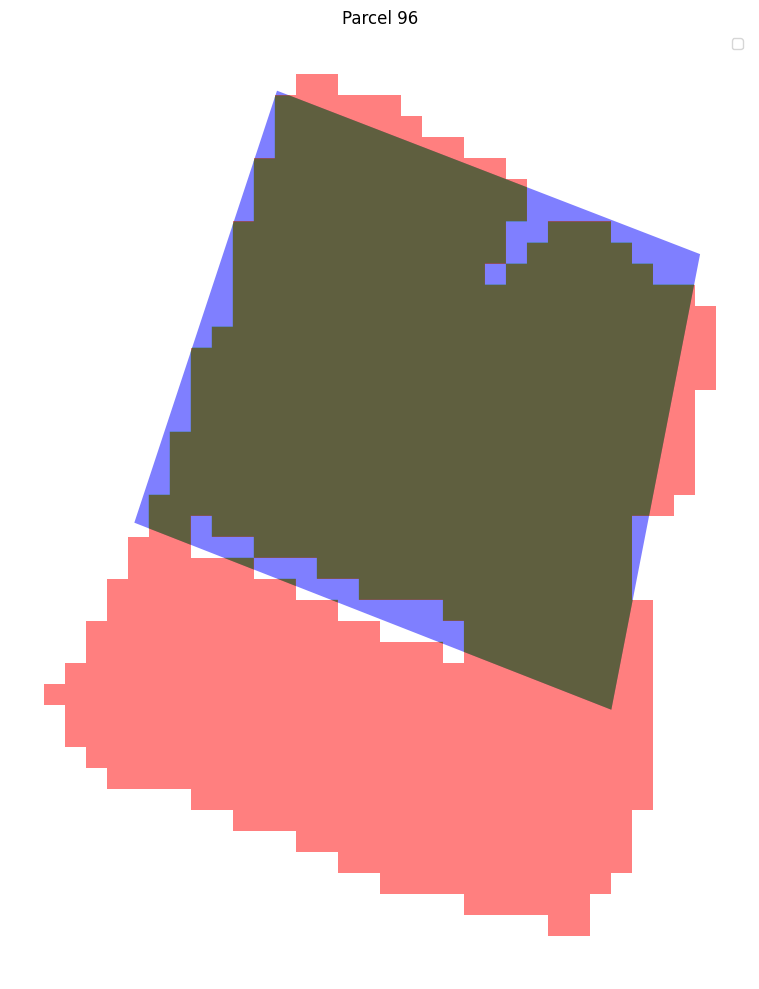

Parcel 96:
True Positive (Correctly predicted): 11359.20 m²
False Negative (Missed): 1097.66 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

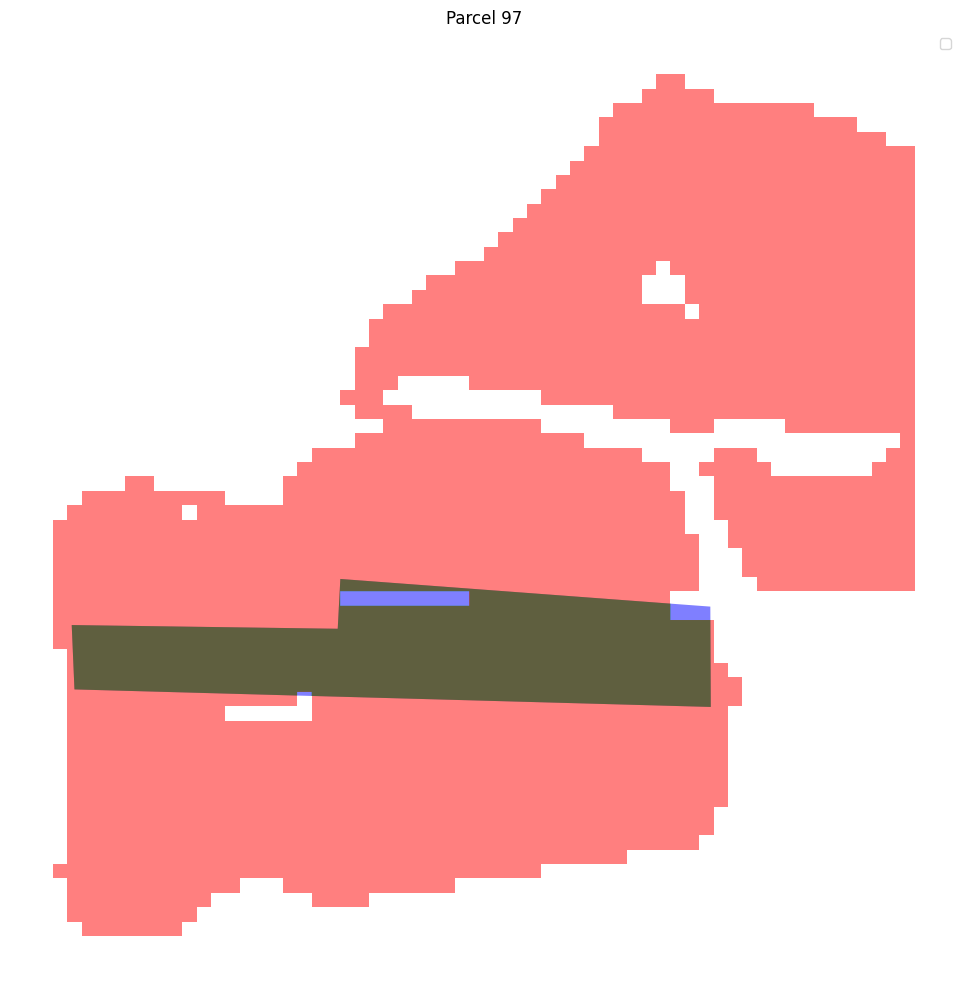

Parcel 97:
True Positive (Correctly predicted): 6742.32 m²
False Negative (Missed): 303.91 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

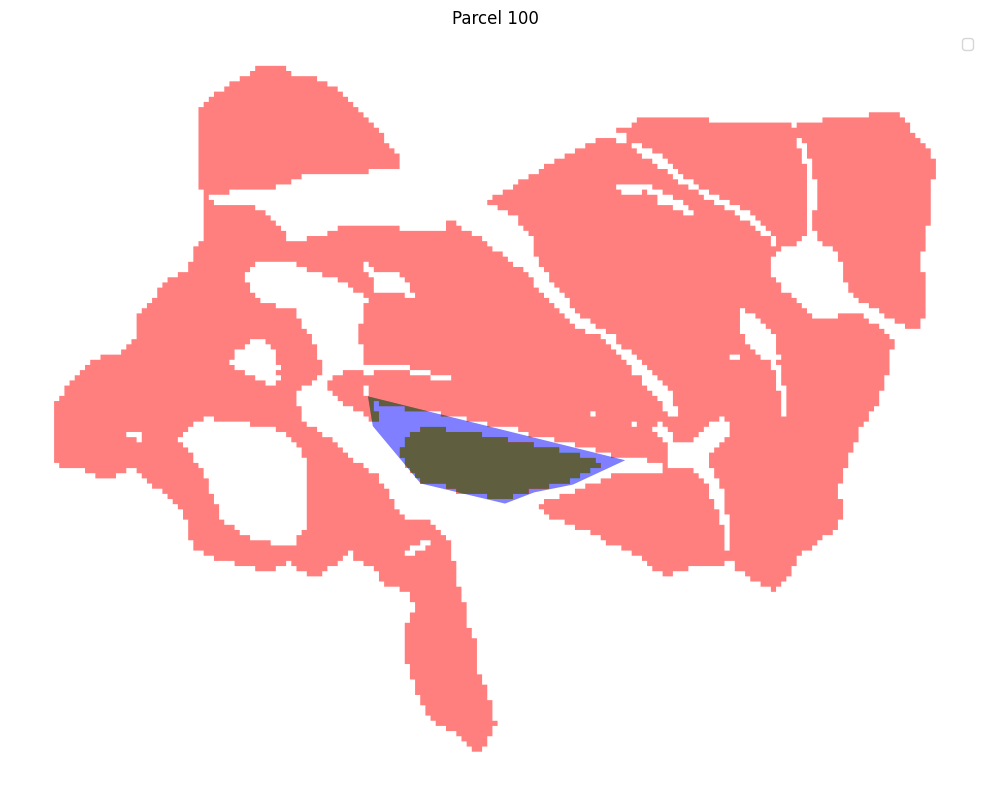

Parcel 100:
True Positive (Correctly predicted): 8805.18 m²
False Negative (Missed): 3747.77 m²
Adjusted IoU: 0.70




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

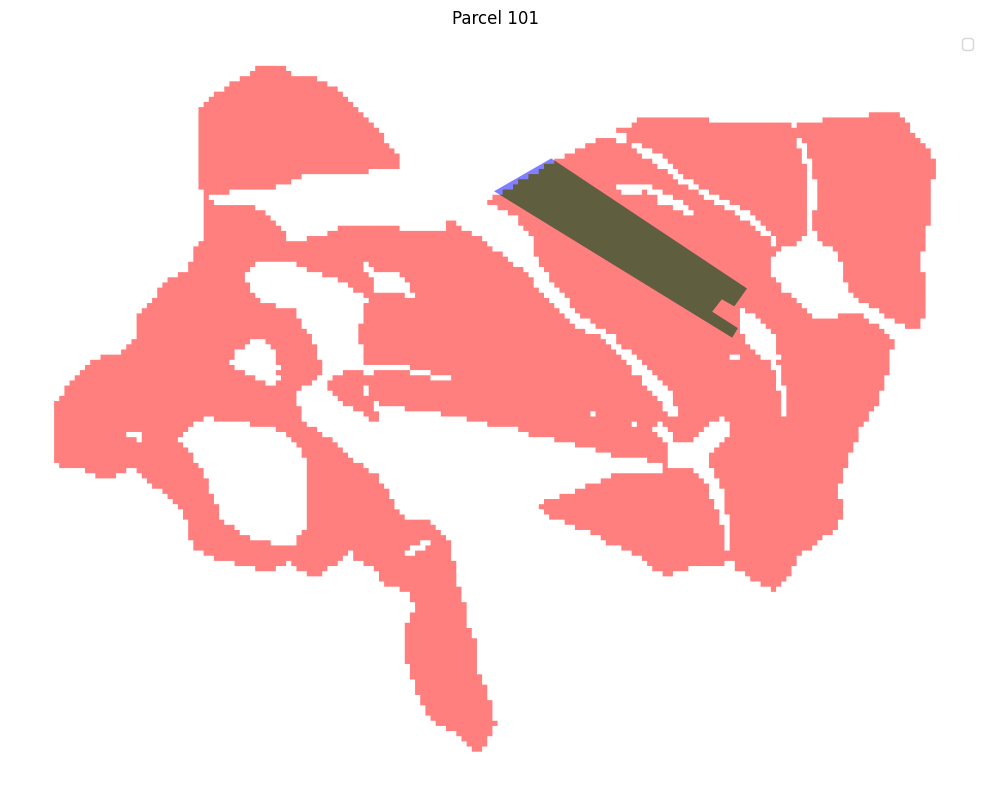

Parcel 101:
True Positive (Correctly predicted): 12300.88 m²
False Negative (Missed): 288.67 m²
Adjusted IoU: 0.98




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

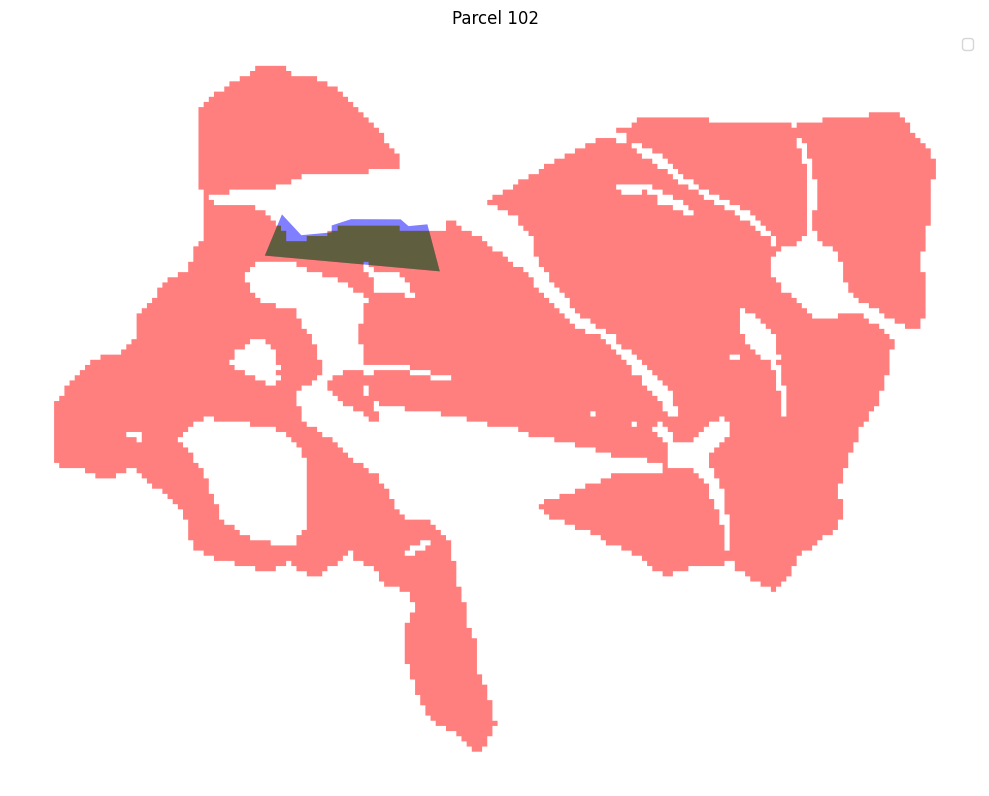

Parcel 102:
True Positive (Correctly predicted): 5036.92 m²
False Negative (Missed): 940.45 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

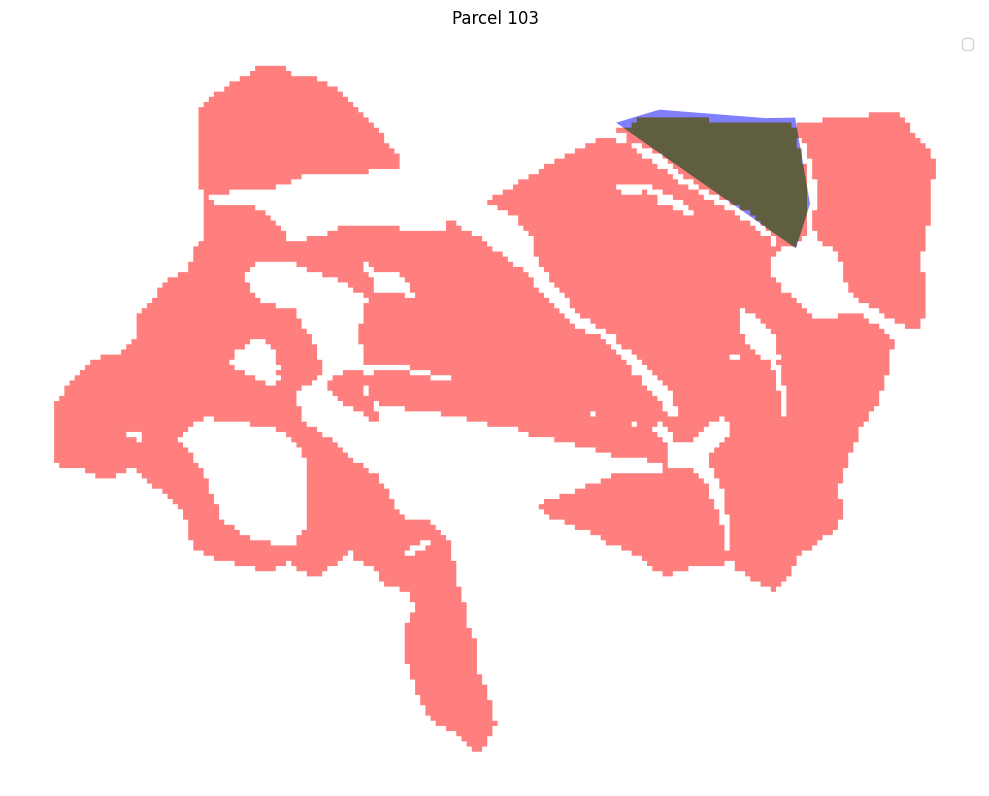

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 103:
True Positive (Correctly predicted): 11592.96 m²
False Negative (Missed): 1129.85 m²
Adjusted IoU: 0.91




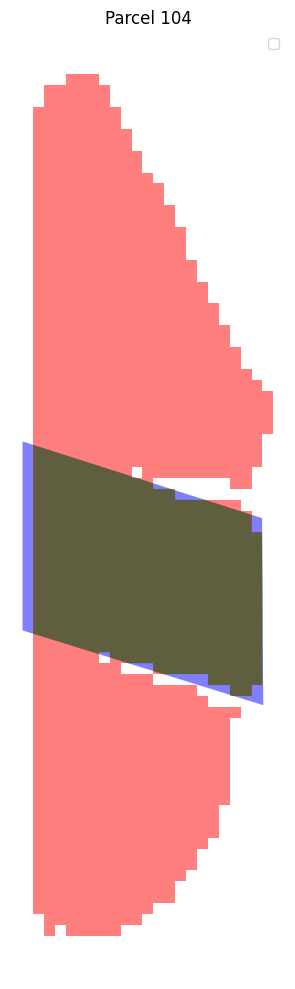

Parcel 104:
True Positive (Correctly predicted): 8788.12 m²
False Negative (Missed): 691.33 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

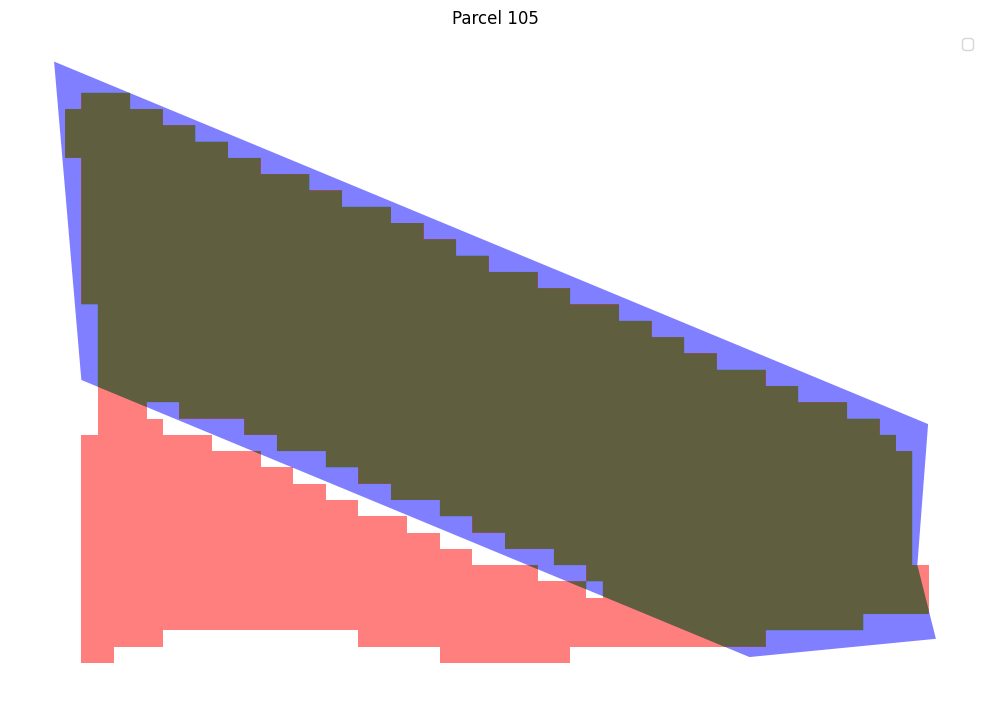

Parcel 105:
True Positive (Correctly predicted): 20872.75 m²
False Negative (Missed): 3155.13 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

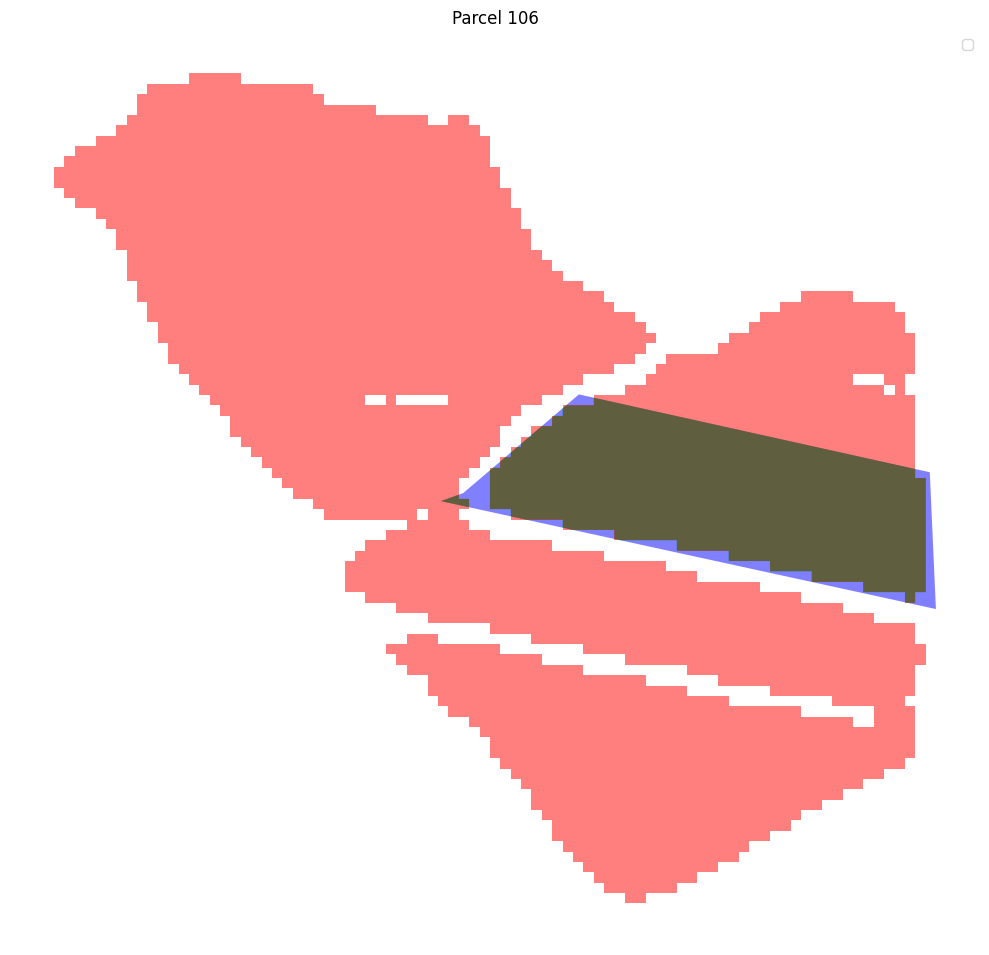

Parcel 106:
True Positive (Correctly predicted): 12193.90 m²
False Negative (Missed): 1037.77 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

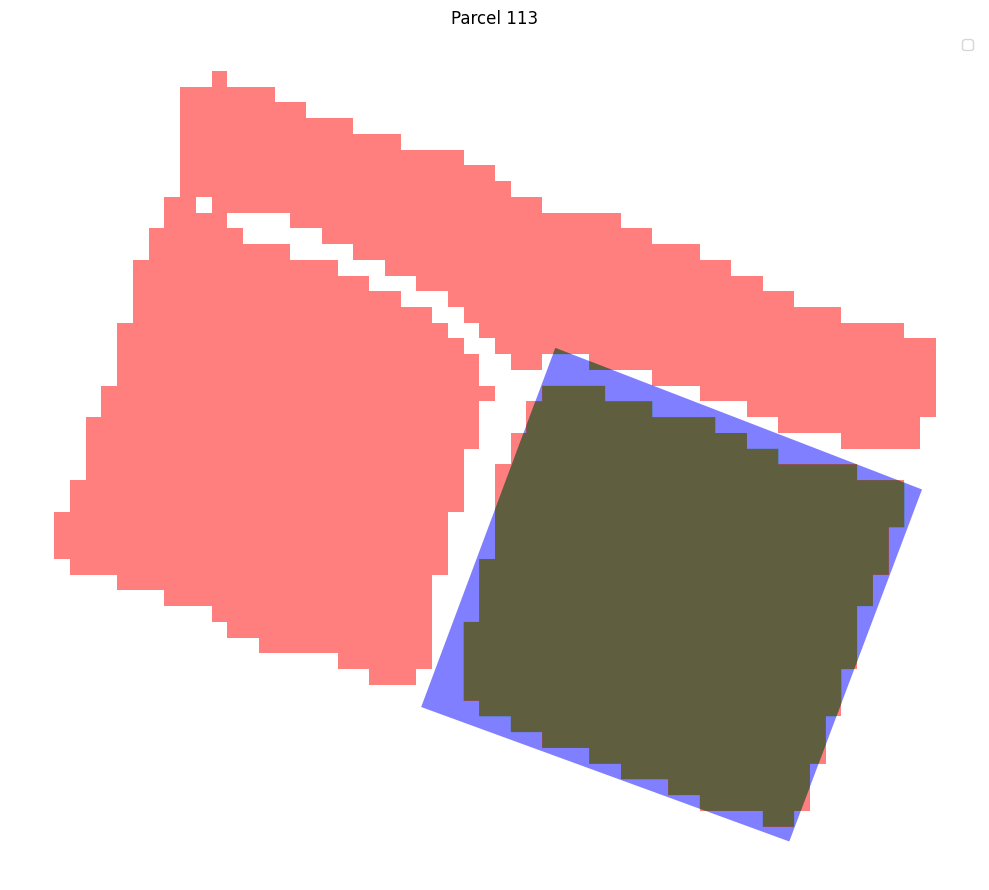

Parcel 113:
True Positive (Correctly predicted): 13322.20 m²
False Negative (Missed): 1704.71 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

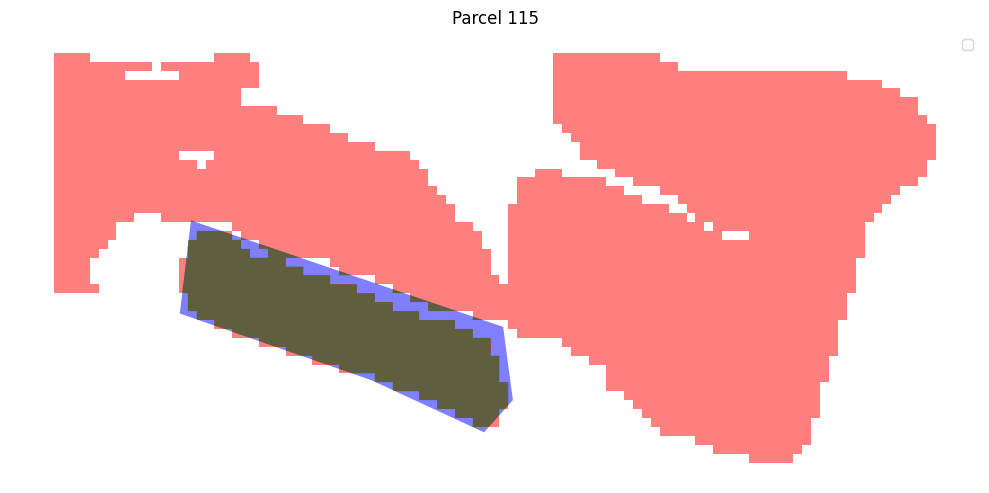

Parcel 115:
True Positive (Correctly predicted): 8597.70 m²
False Negative (Missed): 1569.73 m²
Adjusted IoU: 0.85




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

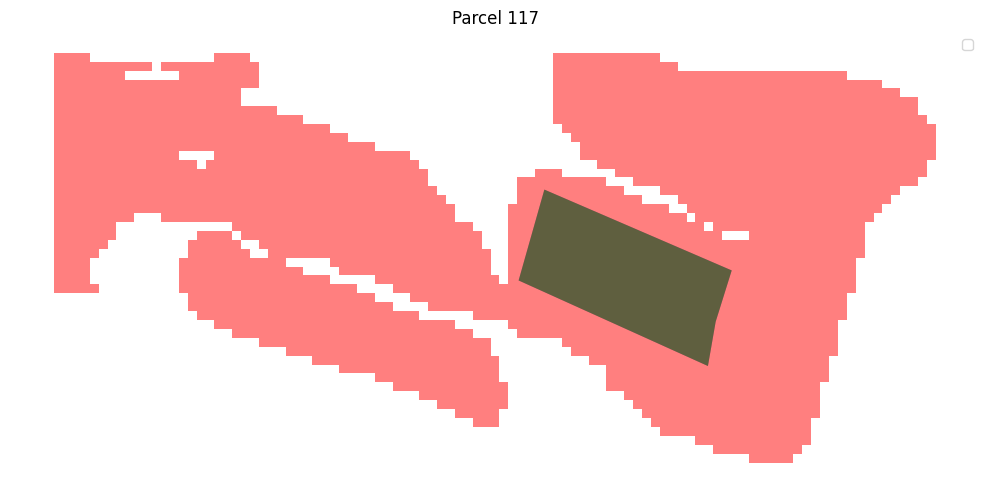

Parcel 117:
True Positive (Correctly predicted): 6131.33 m²
False Negative (Missed): 0.00 m²
Adjusted IoU: 1.00




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

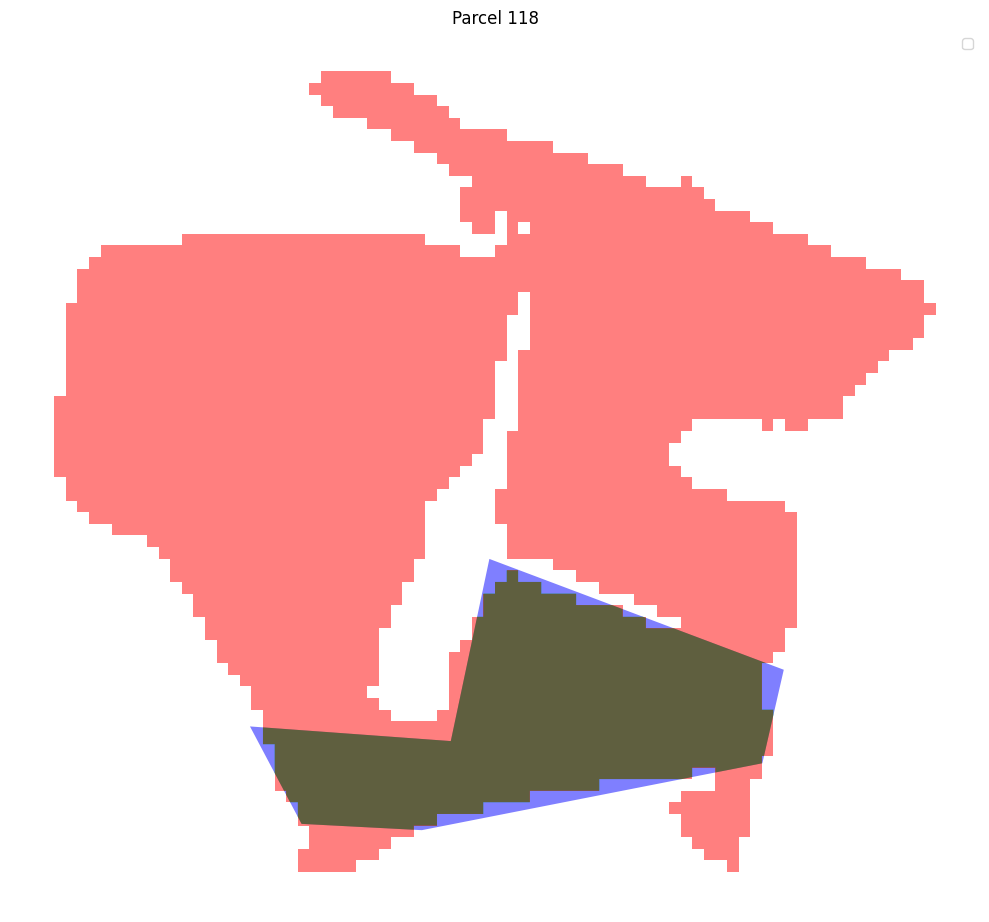

Parcel 118:
True Positive (Correctly predicted): 12513.70 m²
False Negative (Missed): 1005.24 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

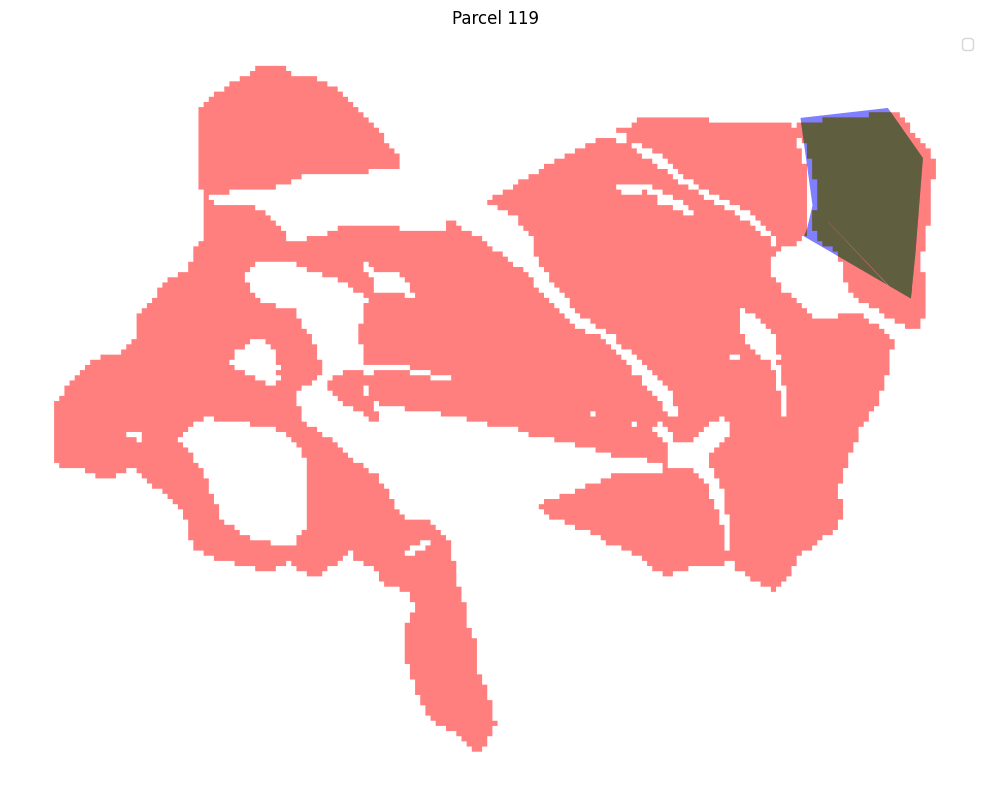

Parcel 119:
True Positive (Correctly predicted): 14923.28 m²
False Negative (Missed): 929.28 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

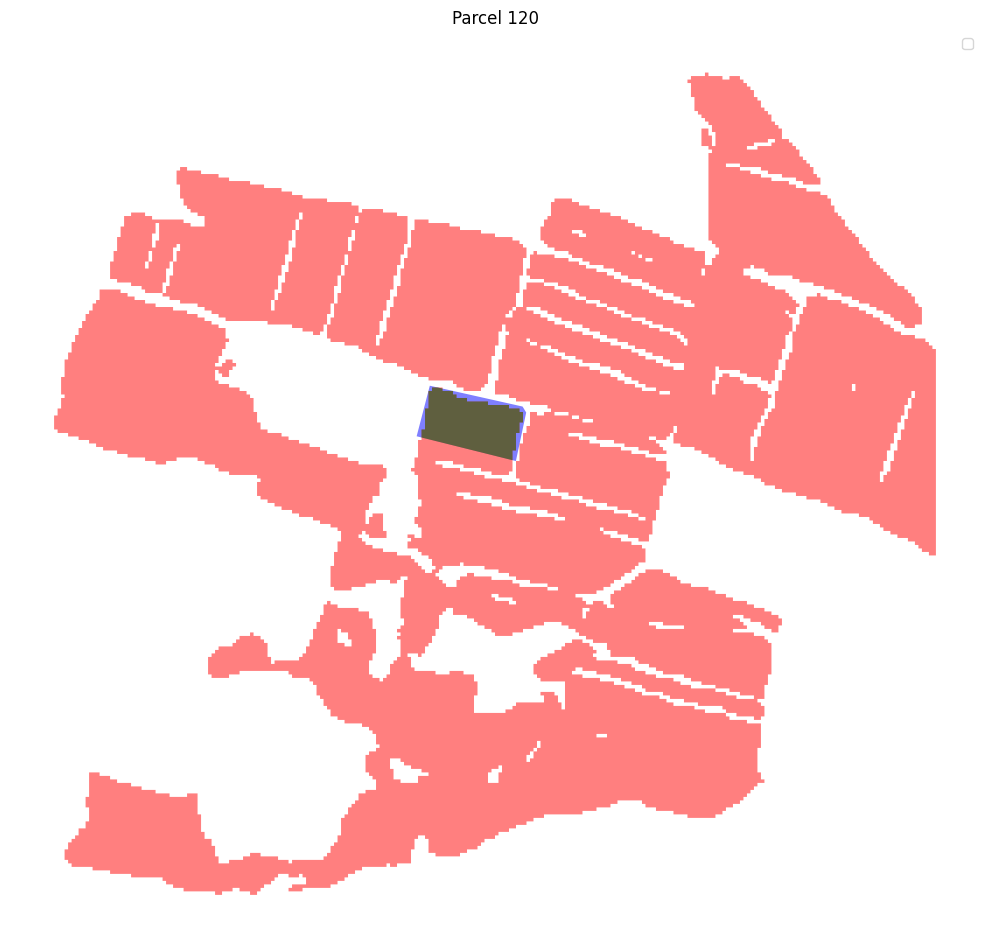

Parcel 120:
True Positive (Correctly predicted): 9614.91 m²
False Negative (Missed): 1381.12 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

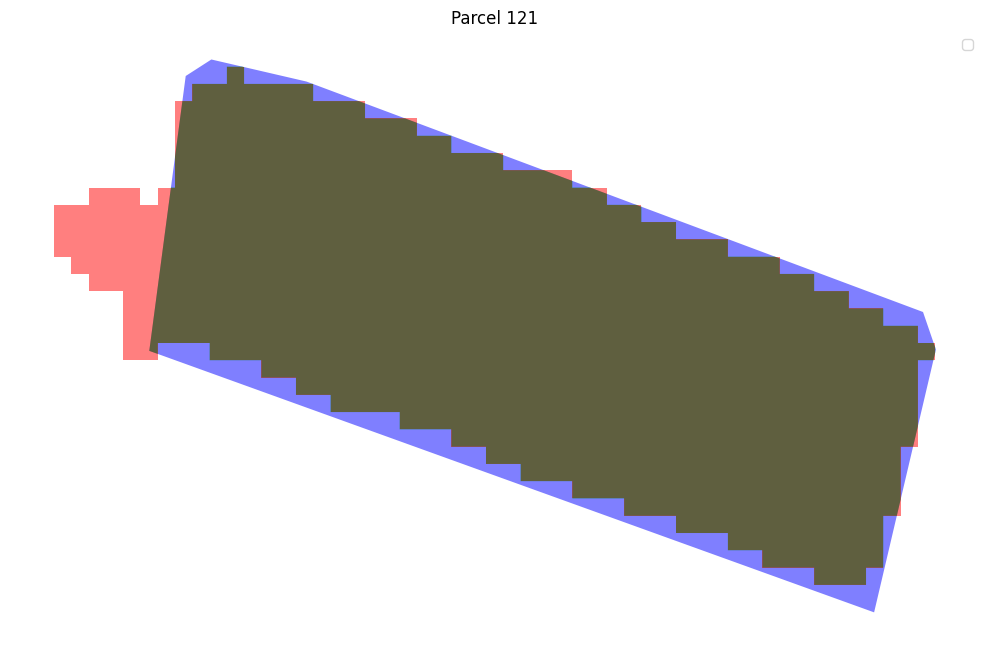

Parcel 121:
True Positive (Correctly predicted): 18097.65 m²
False Negative (Missed): 1754.86 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

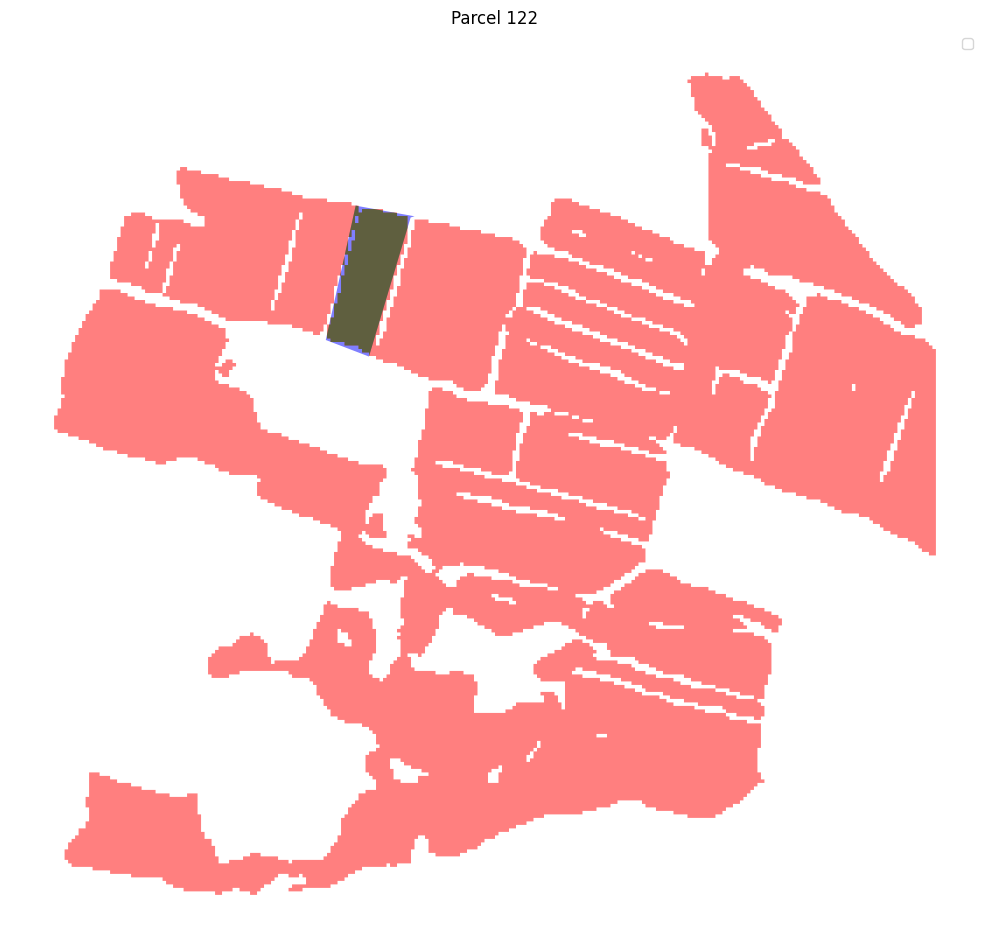

Parcel 122:
True Positive (Correctly predicted): 13784.97 m²
False Negative (Missed): 1051.80 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

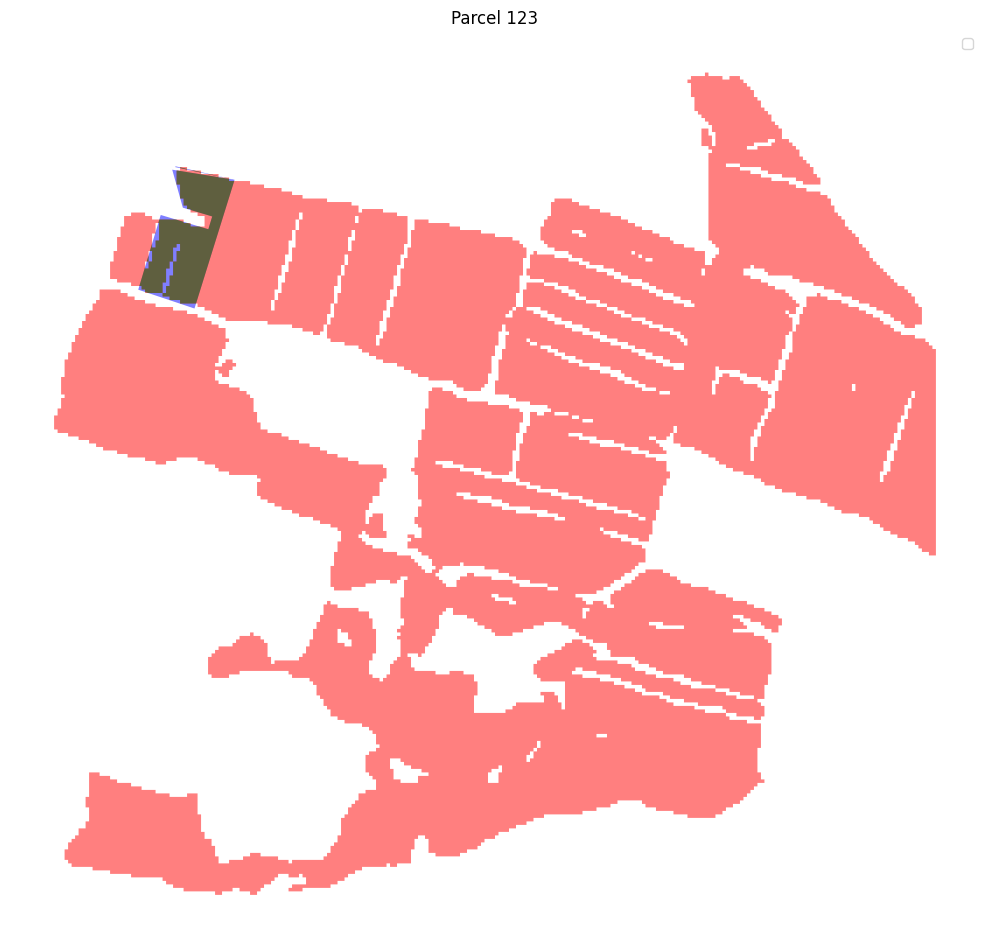

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 123:
True Positive (Correctly predicted): 12682.43 m²
False Negative (Missed): 1322.53 m²
Adjusted IoU: 0.91




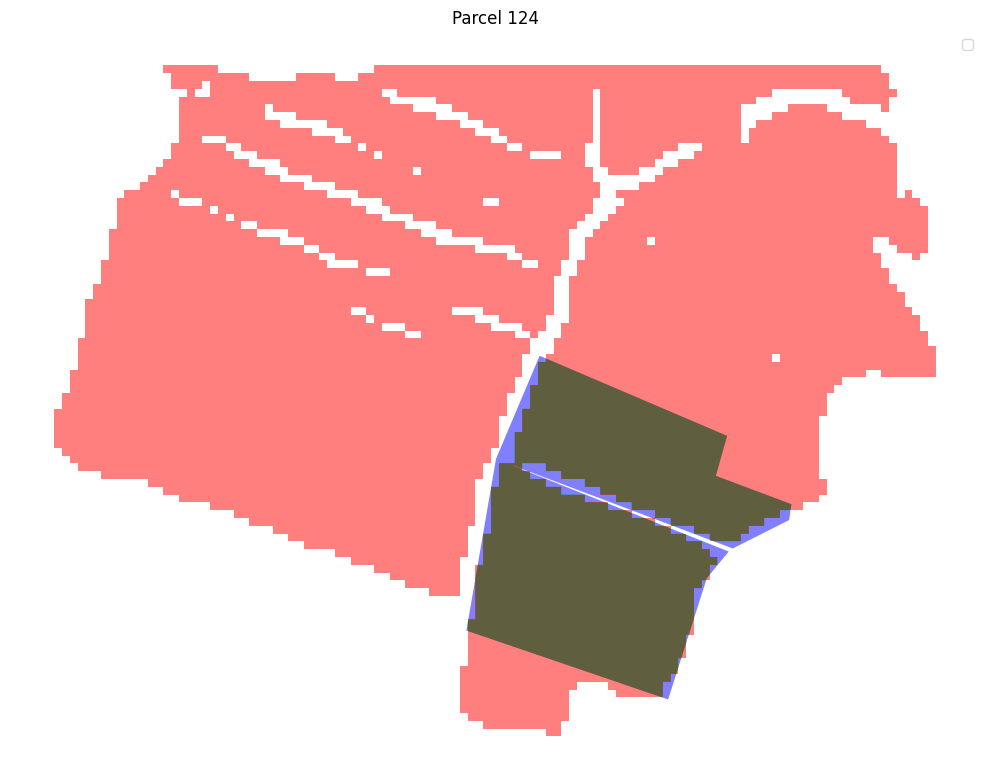

Parcel 124:
True Positive (Correctly predicted): 24461.77 m²
False Negative (Missed): 1893.17 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

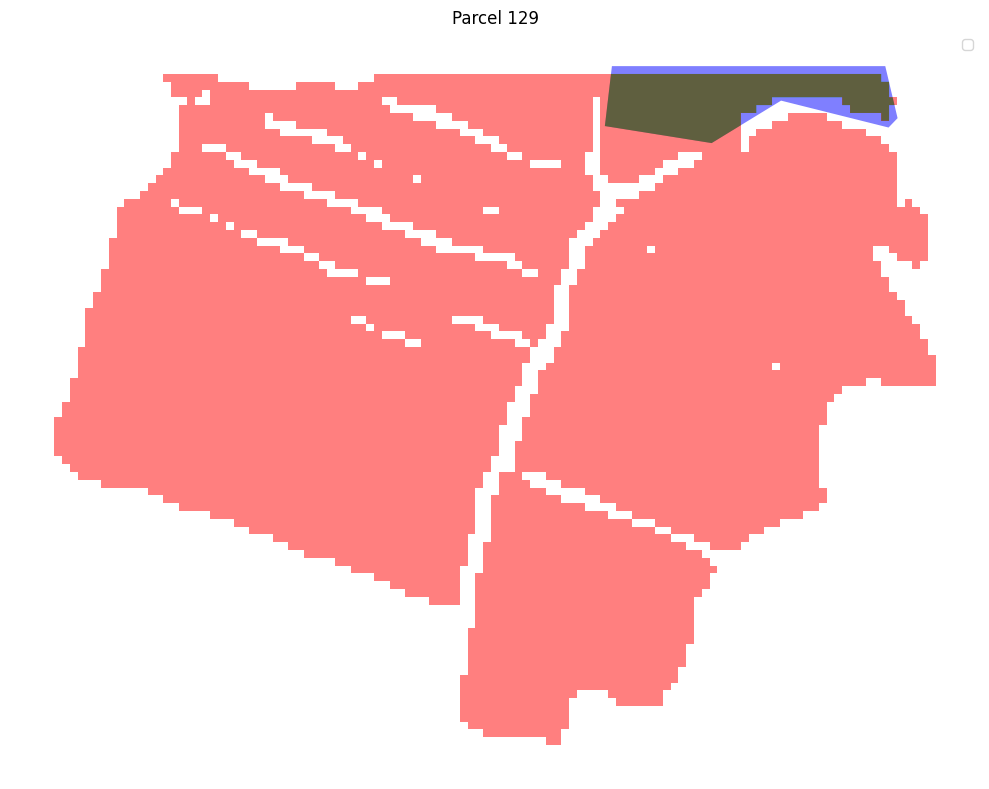

Parcel 129:
True Positive (Correctly predicted): 5177.49 m²
False Negative (Missed): 1517.78 m²
Adjusted IoU: 0.77




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

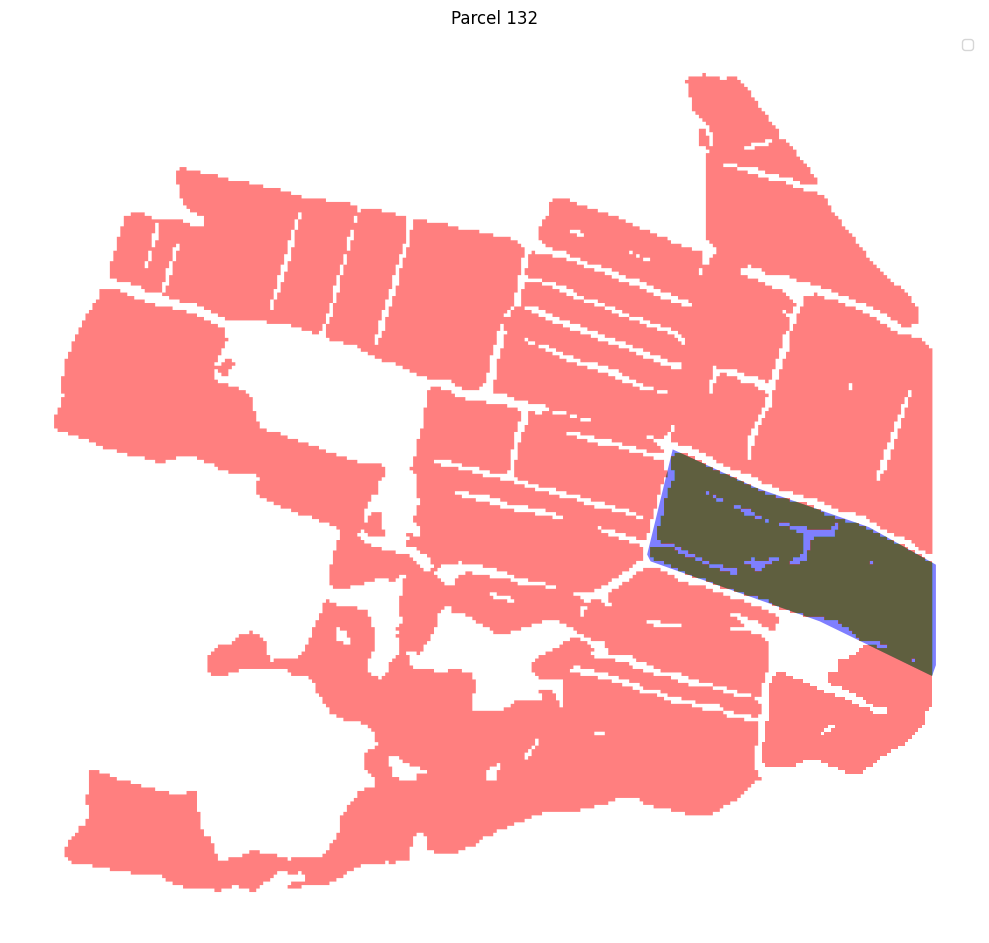

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 132:
True Positive (Correctly predicted): 58925.15 m²
False Negative (Missed): 6228.71 m²
Adjusted IoU: 0.90




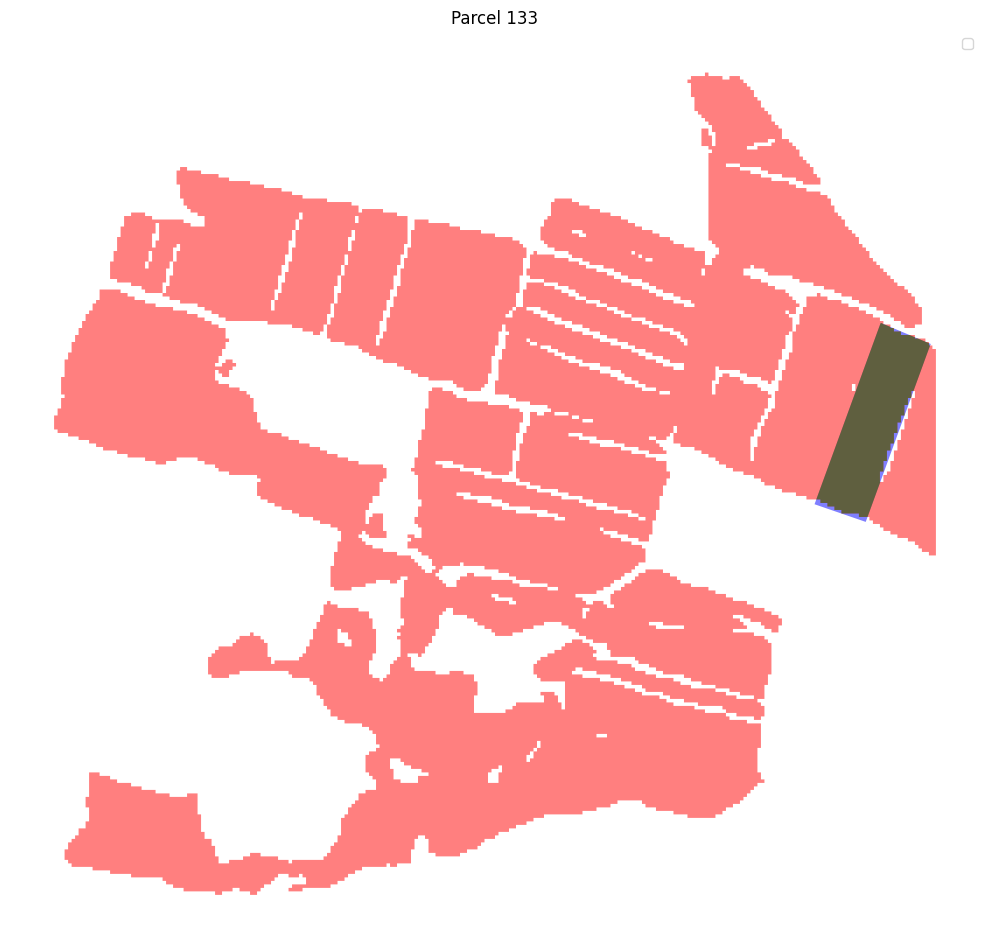

Parcel 133:
True Positive (Correctly predicted): 20264.46 m²
False Negative (Missed): 870.48 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

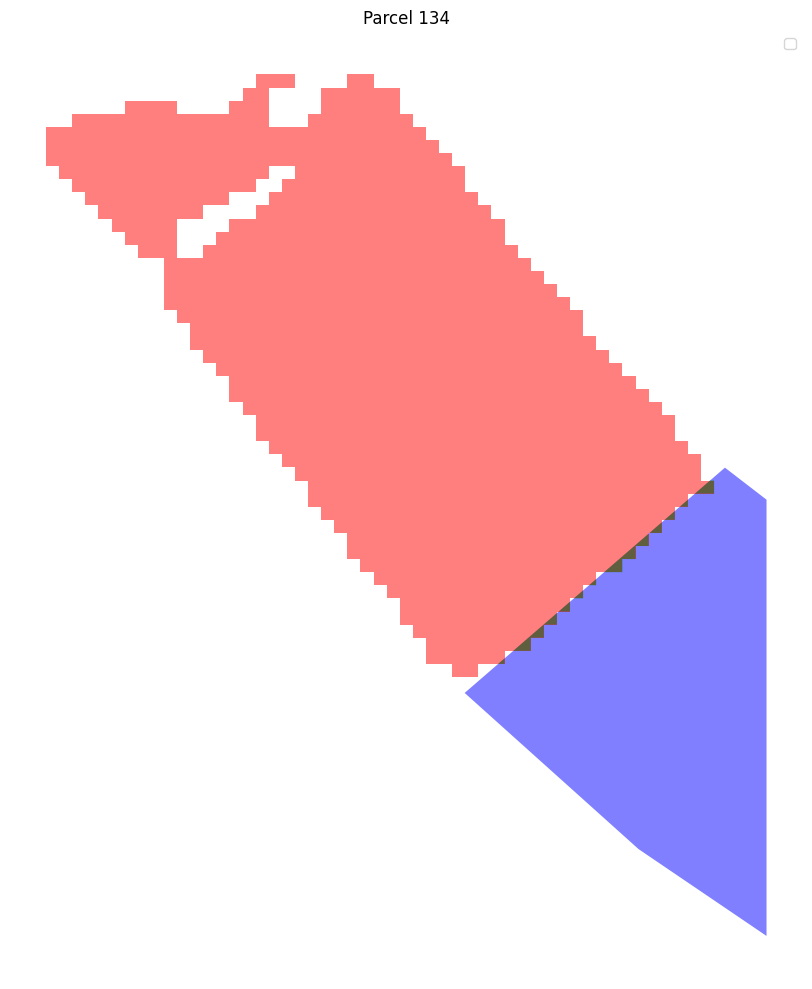

Parcel 134:
True Positive (Correctly predicted): 155.65 m²
False Negative (Missed): 11081.26 m²
Adjusted IoU: 0.01




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

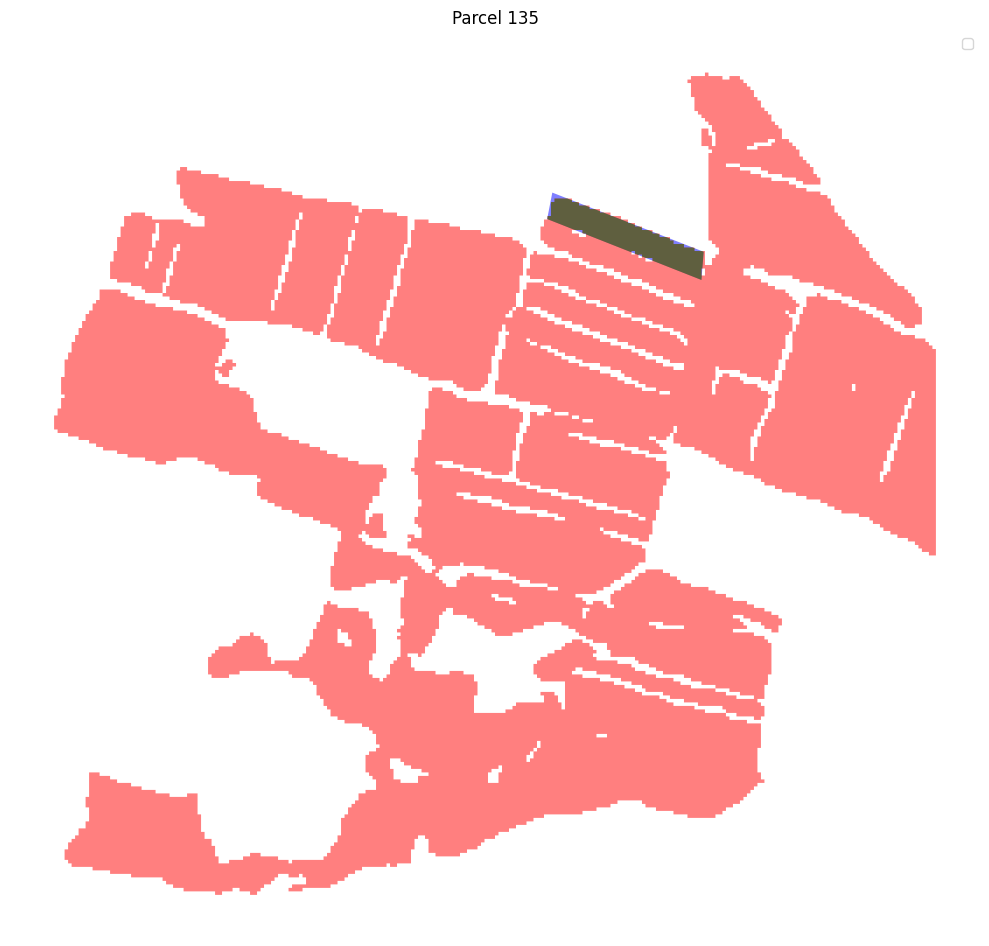

Parcel 135:
True Positive (Correctly predicted): 8524.76 m²
False Negative (Missed): 442.22 m²
Adjusted IoU: 0.95




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

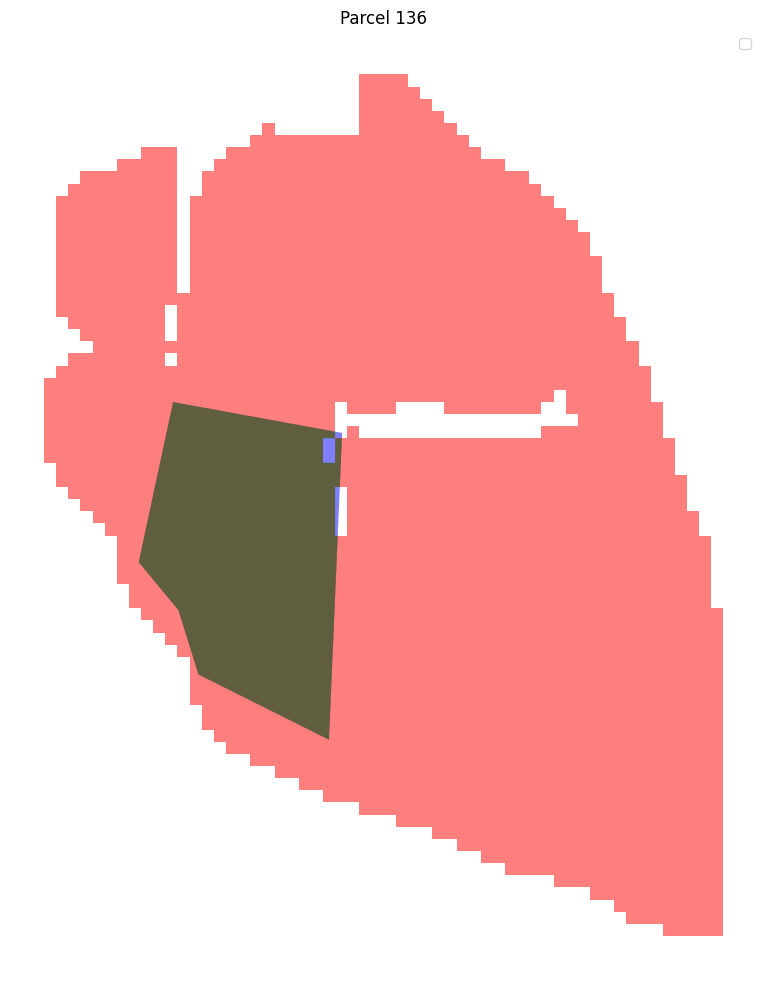

Parcel 136:
True Positive (Correctly predicted): 8234.19 m²
False Negative (Missed): 86.80 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

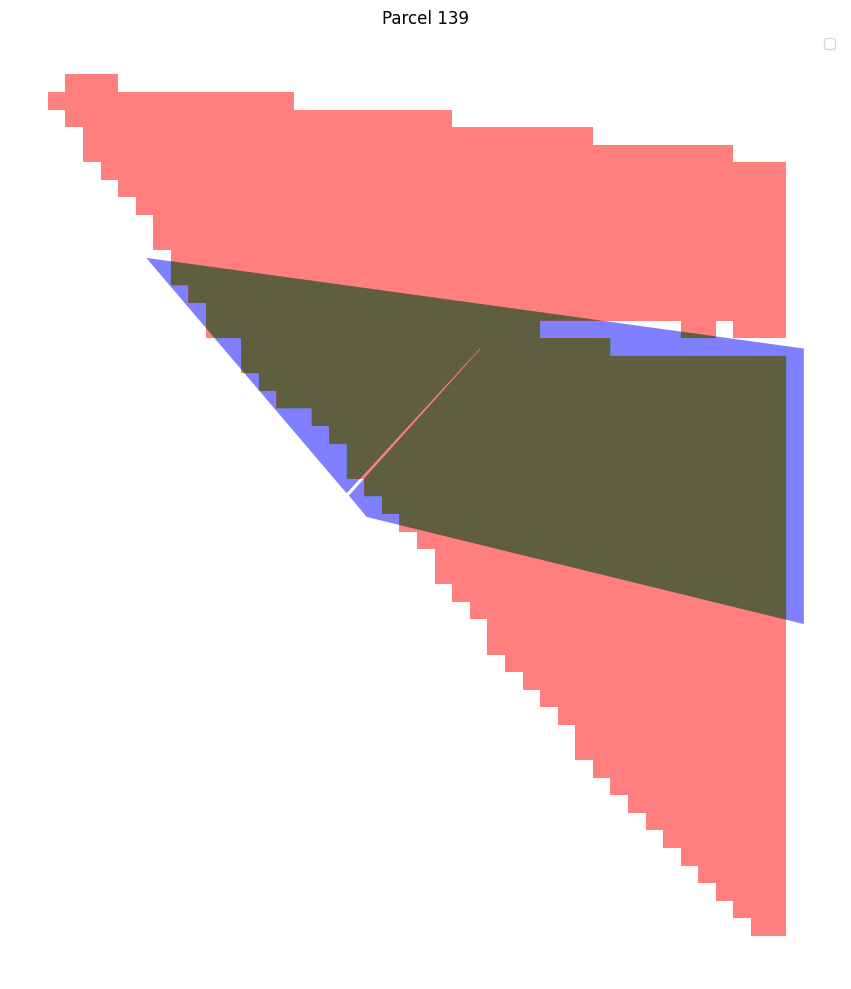

Parcel 139:
True Positive (Correctly predicted): 9764.07 m²
False Negative (Missed): 1154.14 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

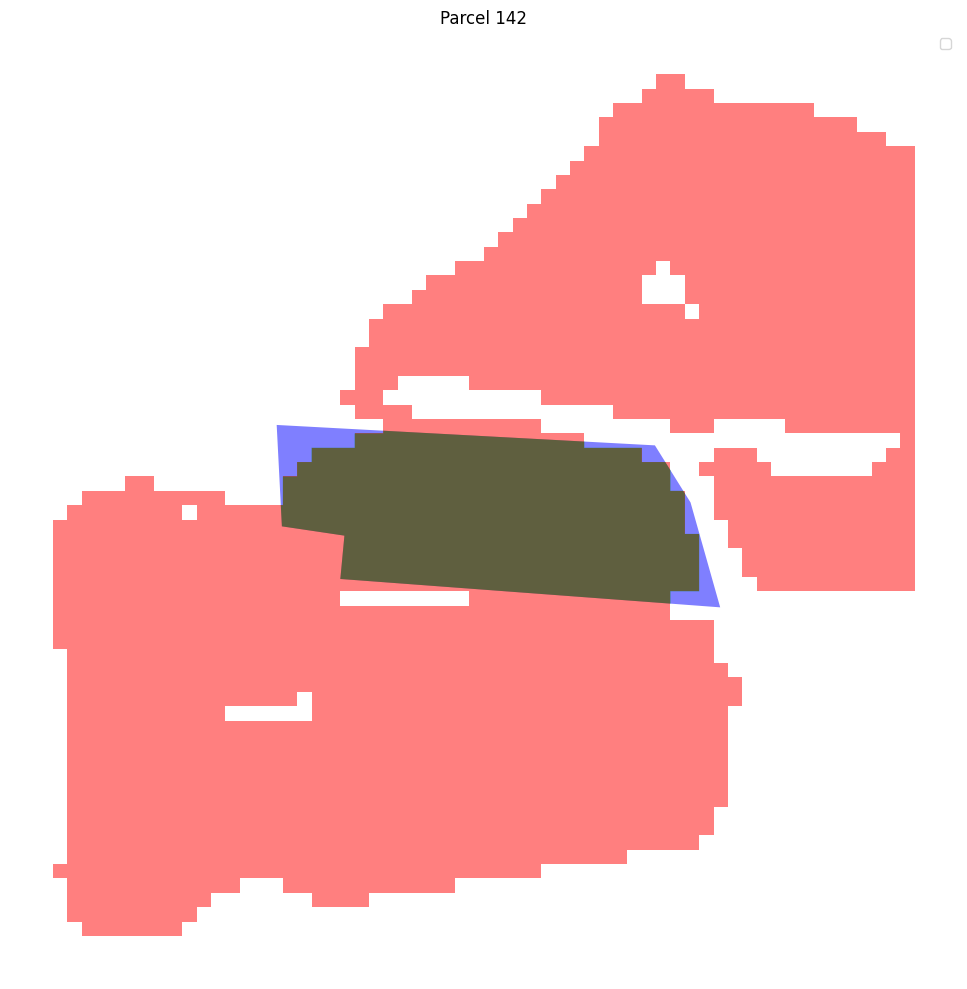

Parcel 142:
True Positive (Correctly predicted): 6799.51 m²
False Negative (Missed): 571.47 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

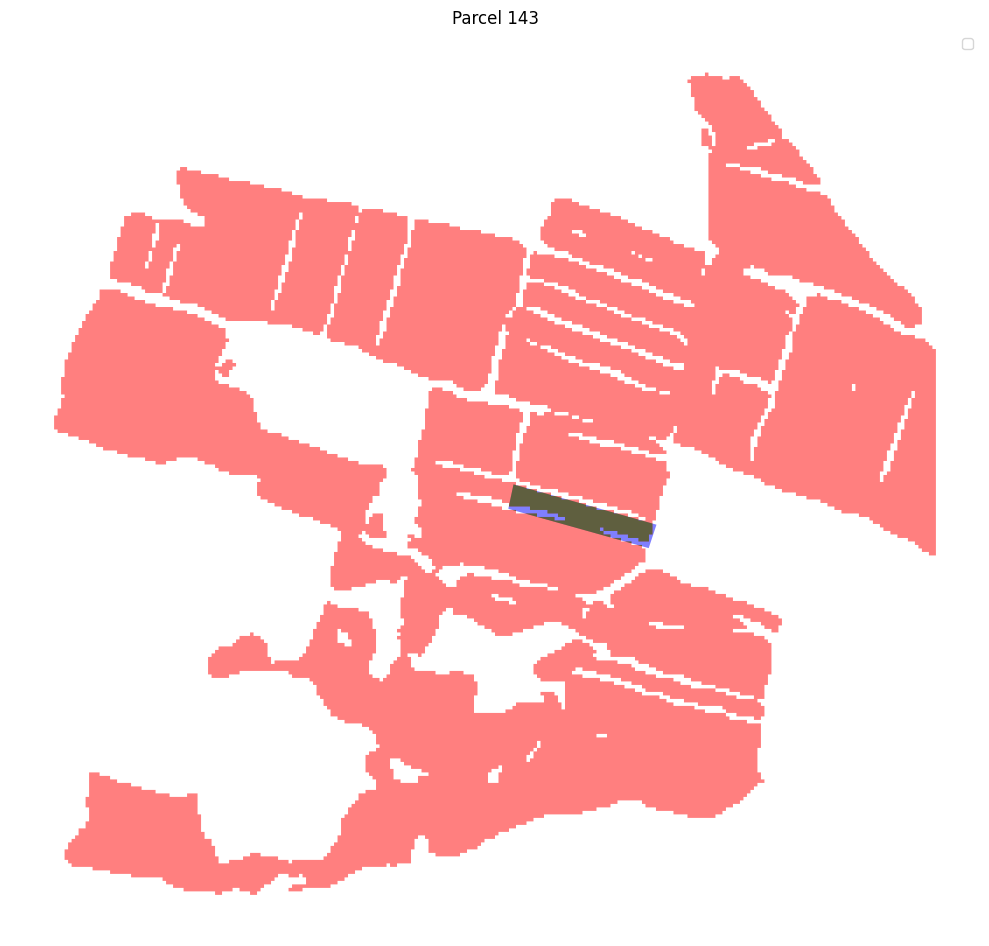

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 143:
True Positive (Correctly predicted): 6192.26 m²
False Negative (Missed): 1256.87 m²
Adjusted IoU: 0.83




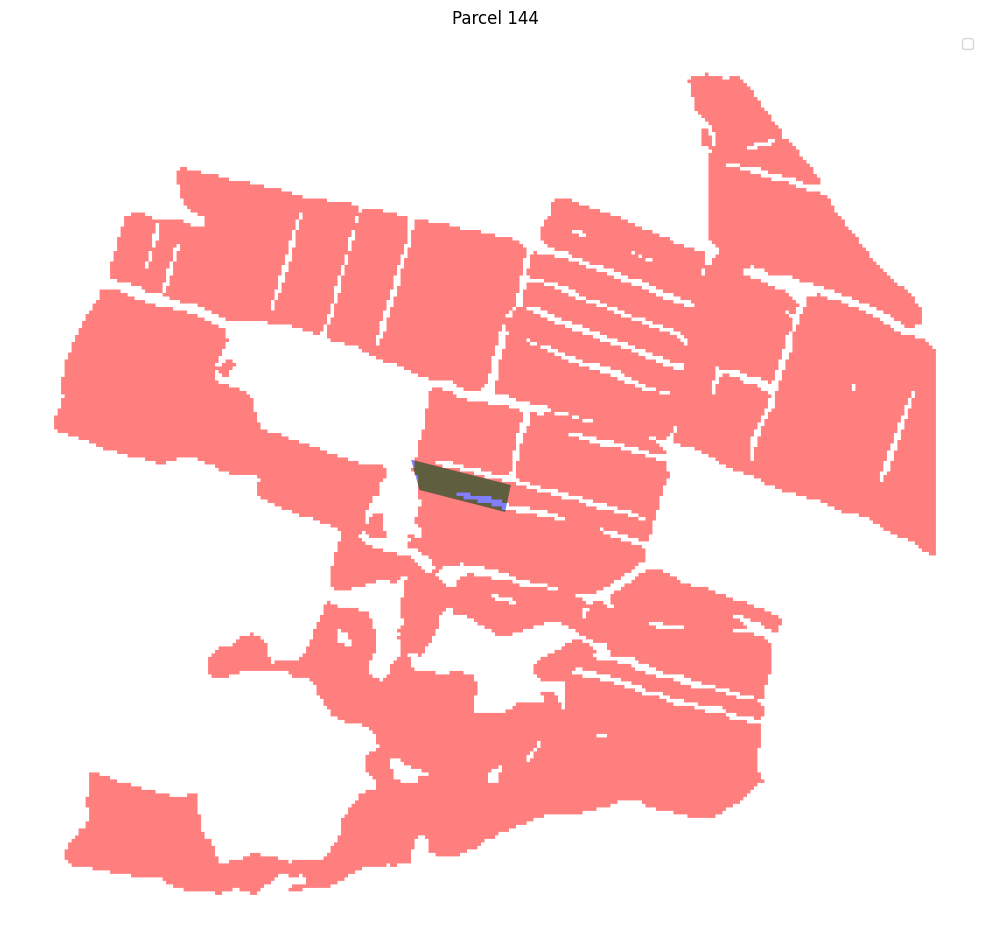

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 144:
True Positive (Correctly predicted): 4665.50 m²
False Negative (Missed): 672.53 m²
Adjusted IoU: 0.87




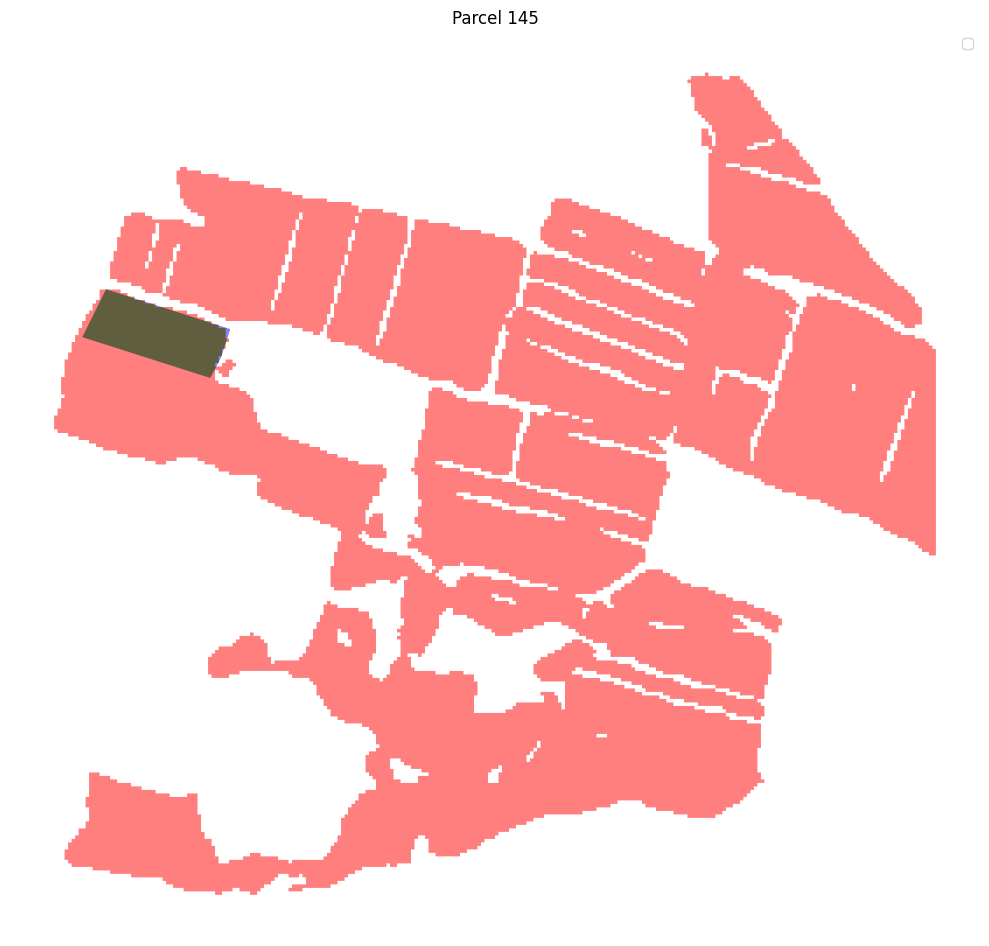

Parcel 145:
True Positive (Correctly predicted): 14176.71 m²
False Negative (Missed): 172.12 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

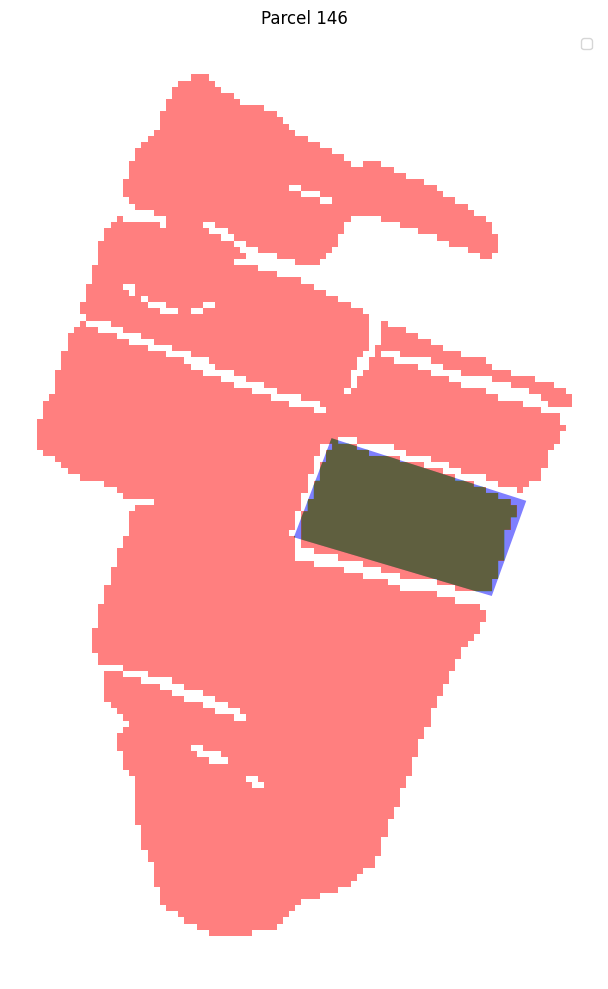

Parcel 146:
True Positive (Correctly predicted): 13373.27 m²
False Negative (Missed): 659.06 m²
Adjusted IoU: 0.95




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

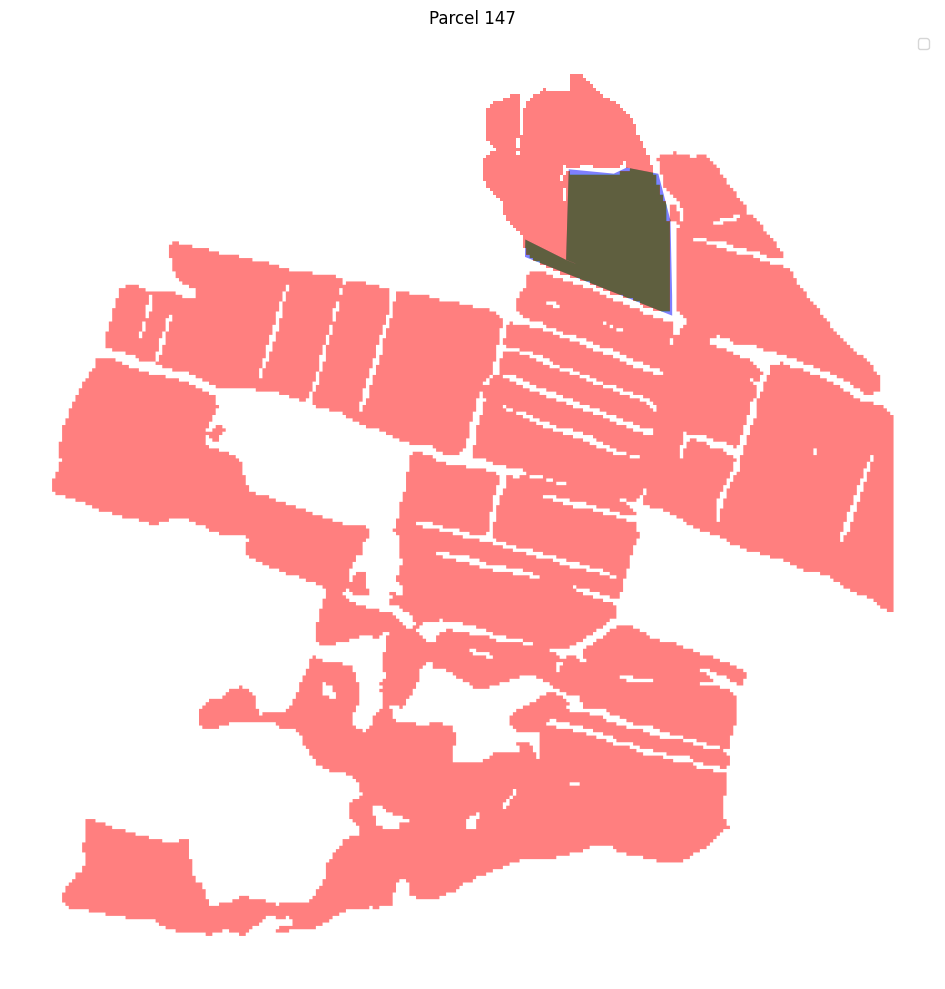

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 147:
True Positive (Correctly predicted): 28355.47 m²
False Negative (Missed): 1112.29 m²
Adjusted IoU: 0.96




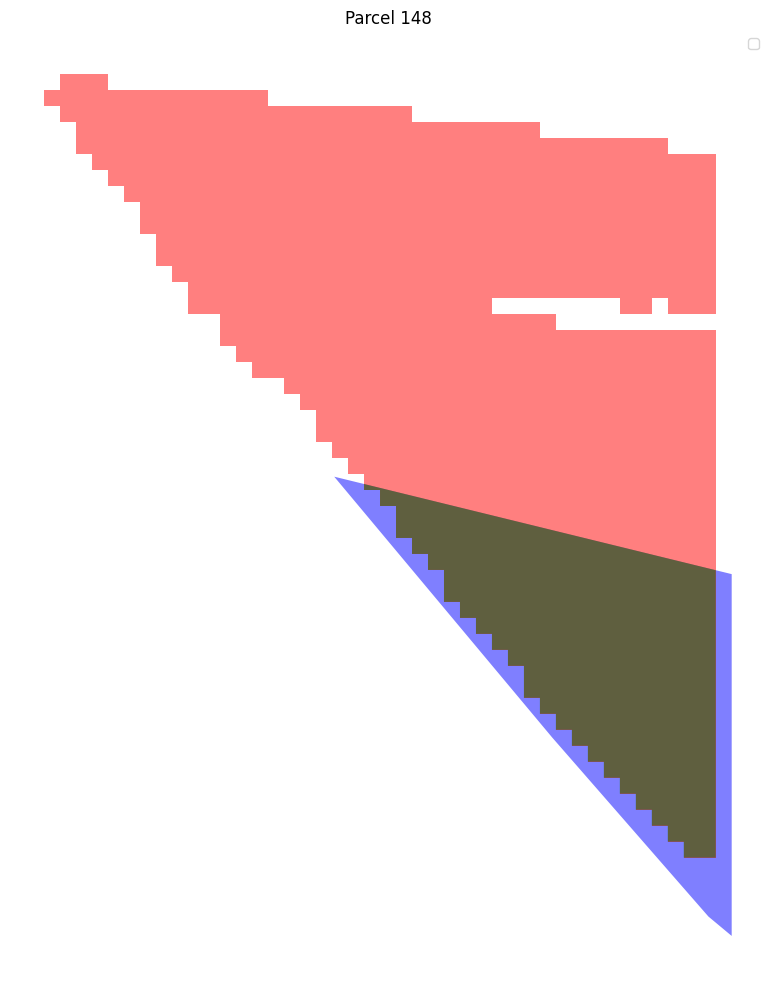

Parcel 148:
True Positive (Correctly predicted): 5698.27 m²
False Negative (Missed): 1567.08 m²
Adjusted IoU: 0.78




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

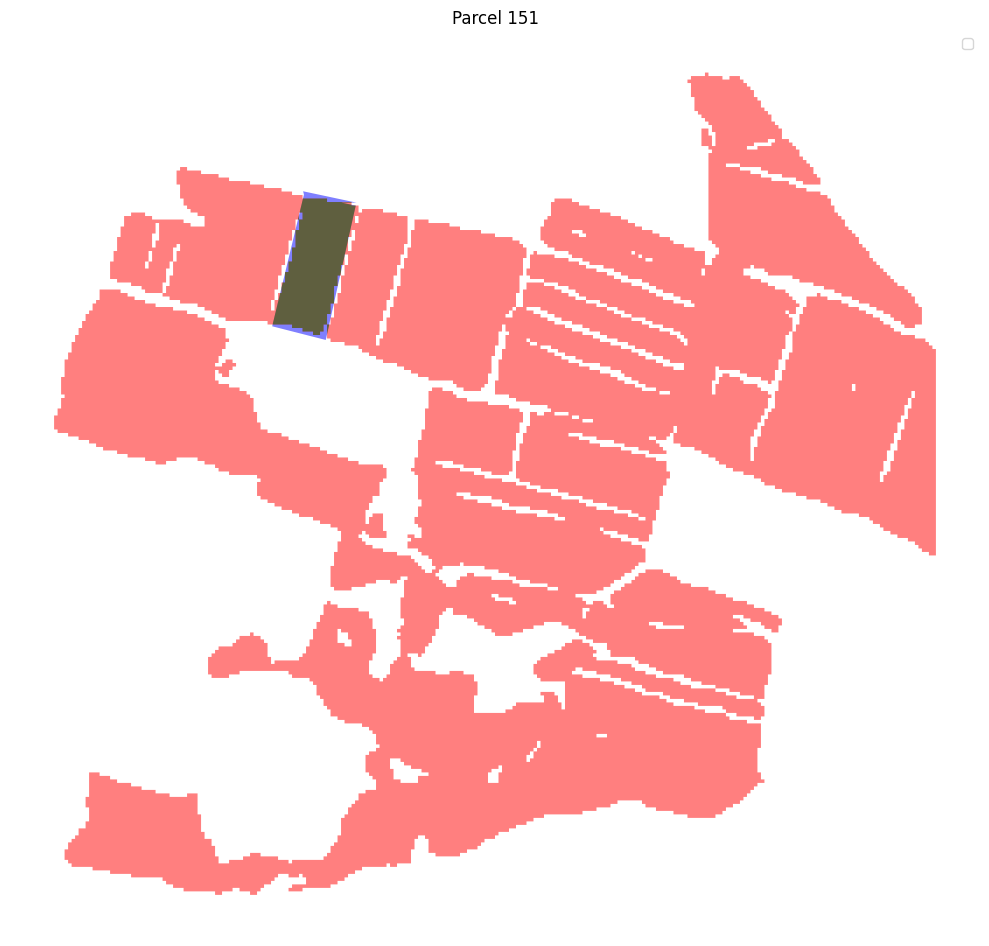

Parcel 151:
True Positive (Correctly predicted): 13884.23 m²
False Negative (Missed): 1483.08 m²
Adjusted IoU: 0.90




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

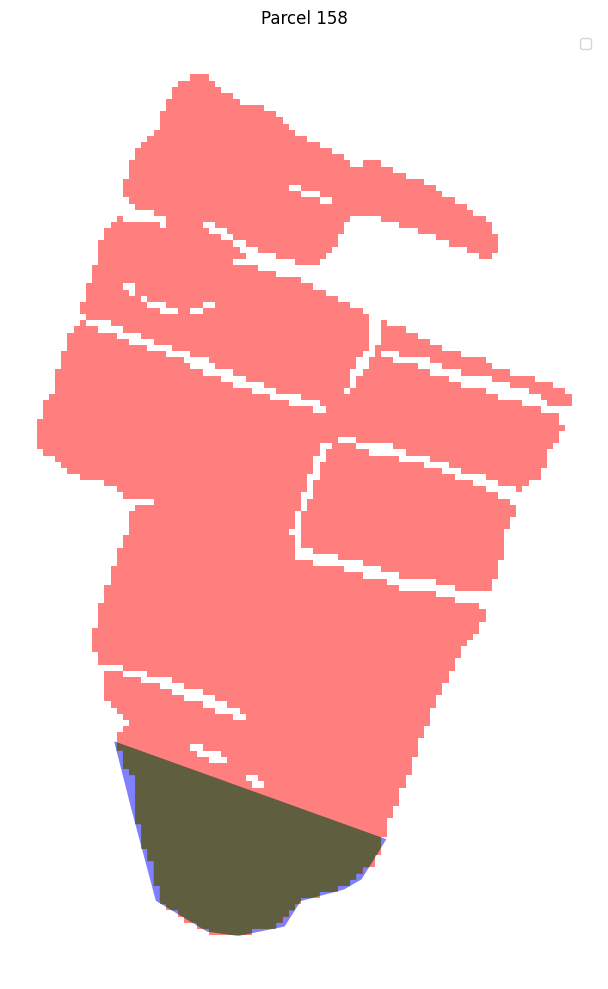

Parcel 158:
True Positive (Correctly predicted): 18201.87 m²
False Negative (Missed): 766.92 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

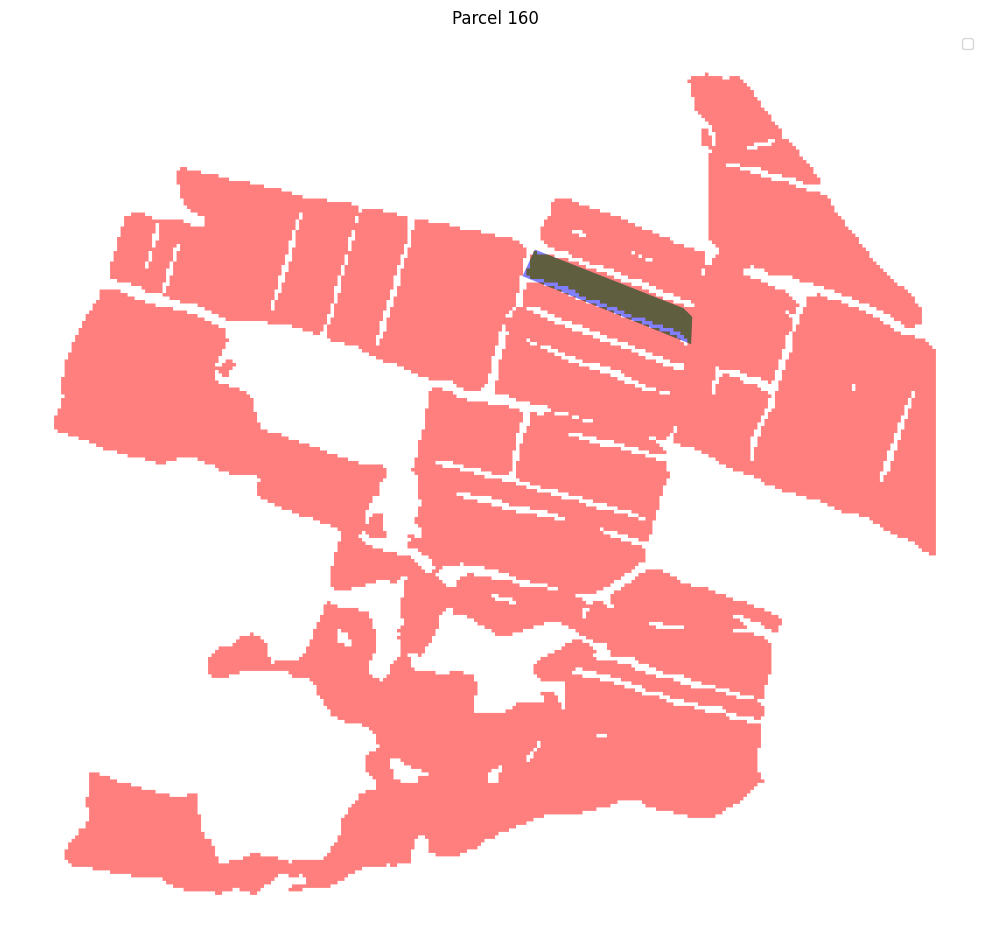

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 160:
True Positive (Correctly predicted): 9124.77 m²
False Negative (Missed): 1557.13 m²
Adjusted IoU: 0.85




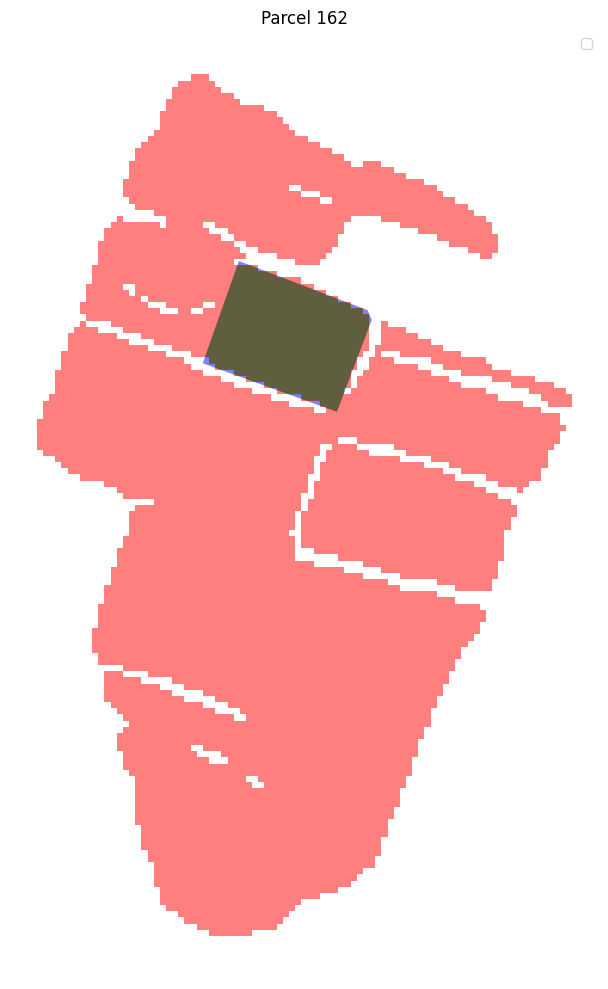

Parcel 162:
True Positive (Correctly predicted): 9940.12 m²
False Negative (Missed): 214.80 m²
Adjusted IoU: 0.98




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

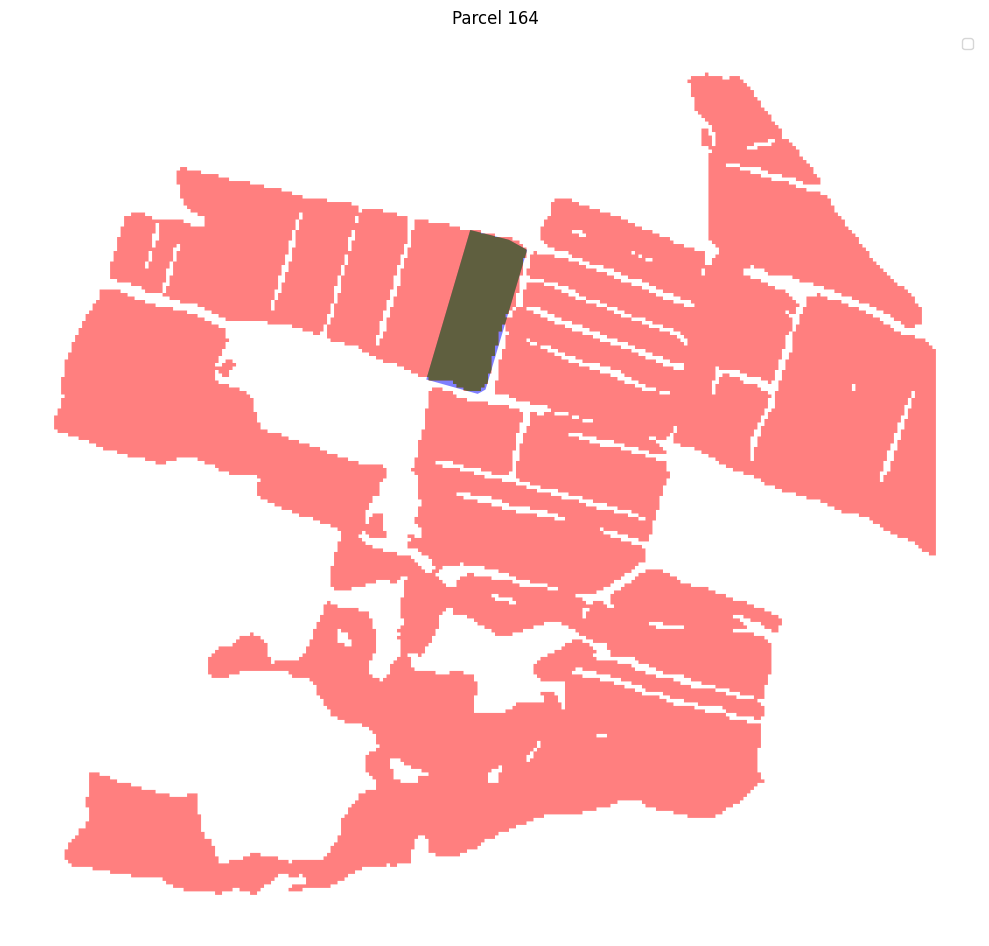

Parcel 164:
True Positive (Correctly predicted): 18461.72 m²
False Negative (Missed): 543.38 m²
Adjusted IoU: 0.97




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

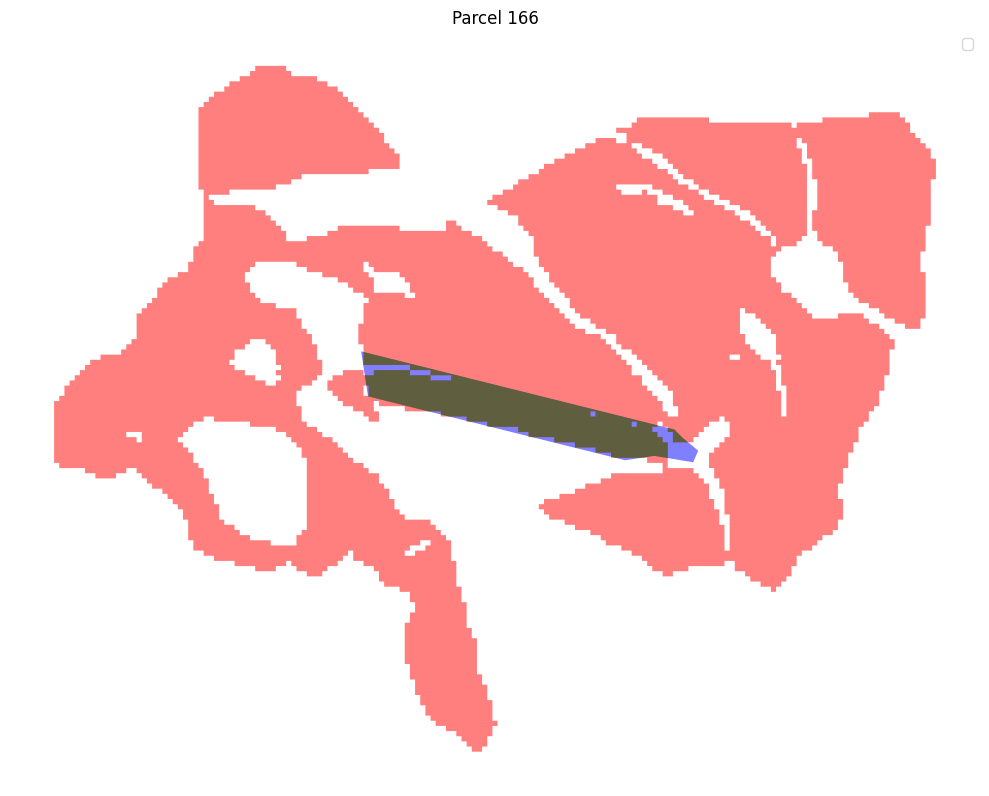

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 166:
True Positive (Correctly predicted): 10947.06 m²
False Negative (Missed): 1647.56 m²
Adjusted IoU: 0.87




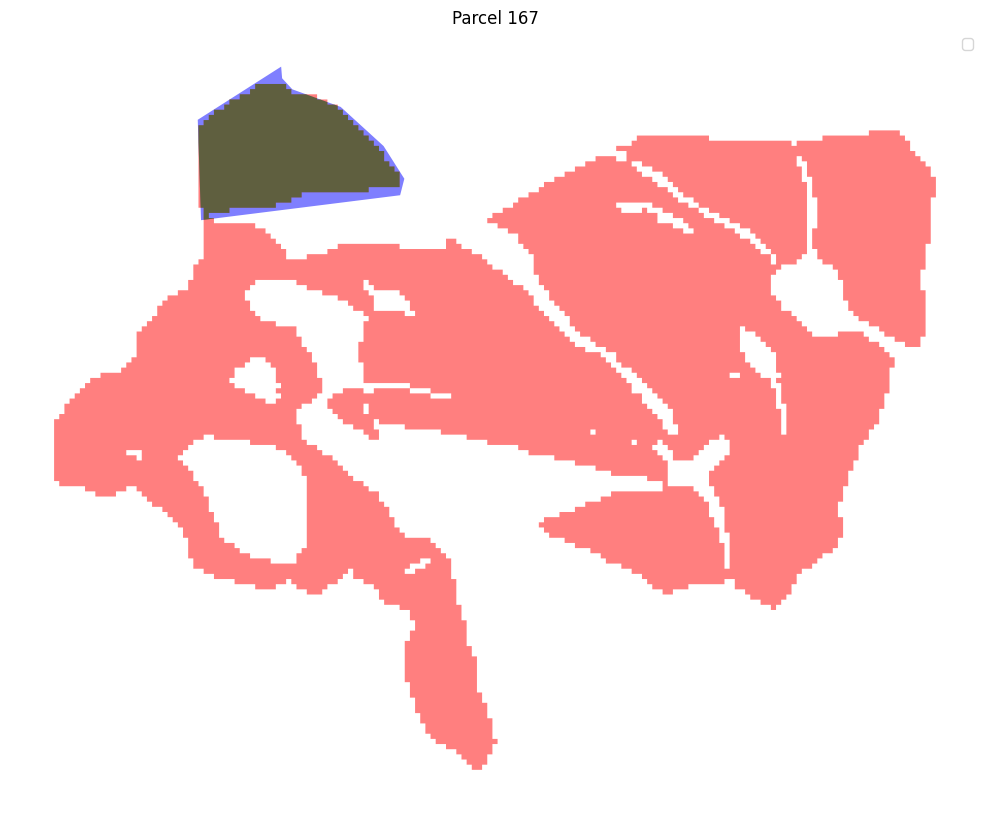

Parcel 167:
True Positive (Correctly predicted): 16713.57 m²
False Negative (Missed): 2518.62 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

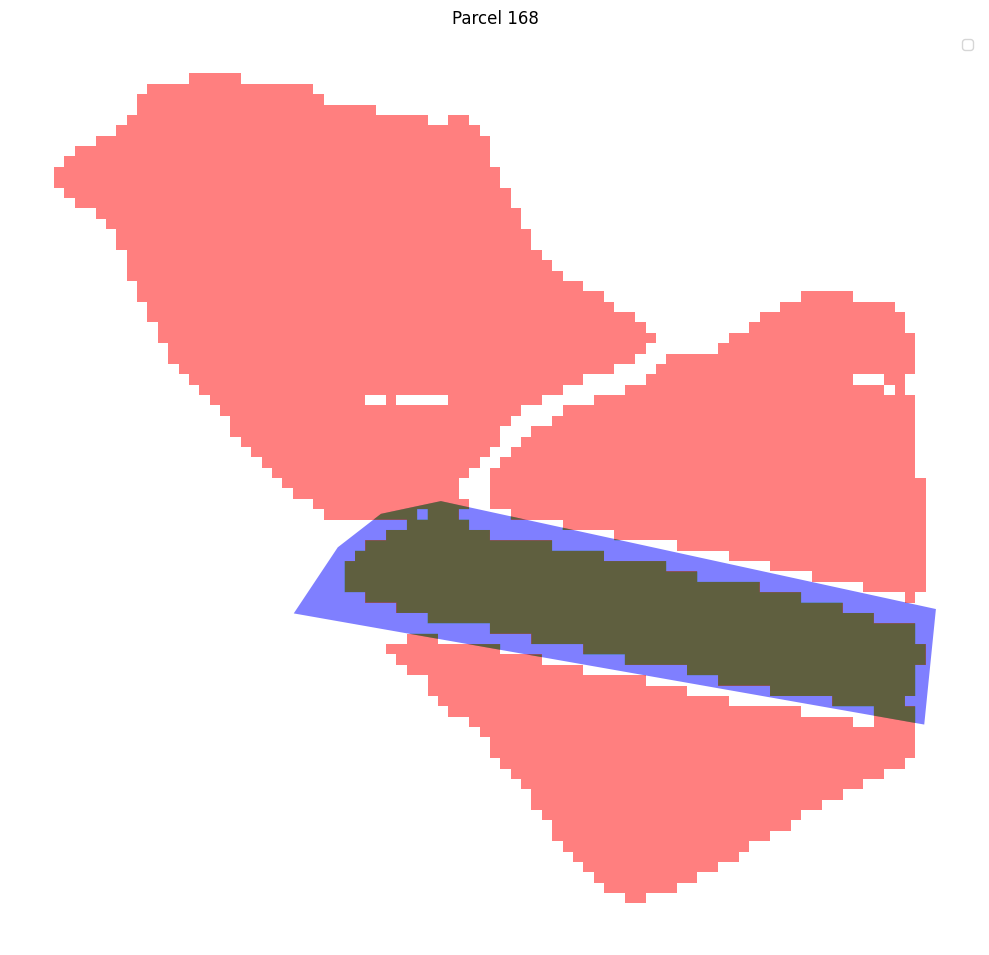

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 168:
True Positive (Correctly predicted): 12727.66 m²
False Negative (Missed): 4901.15 m²
Adjusted IoU: 0.72




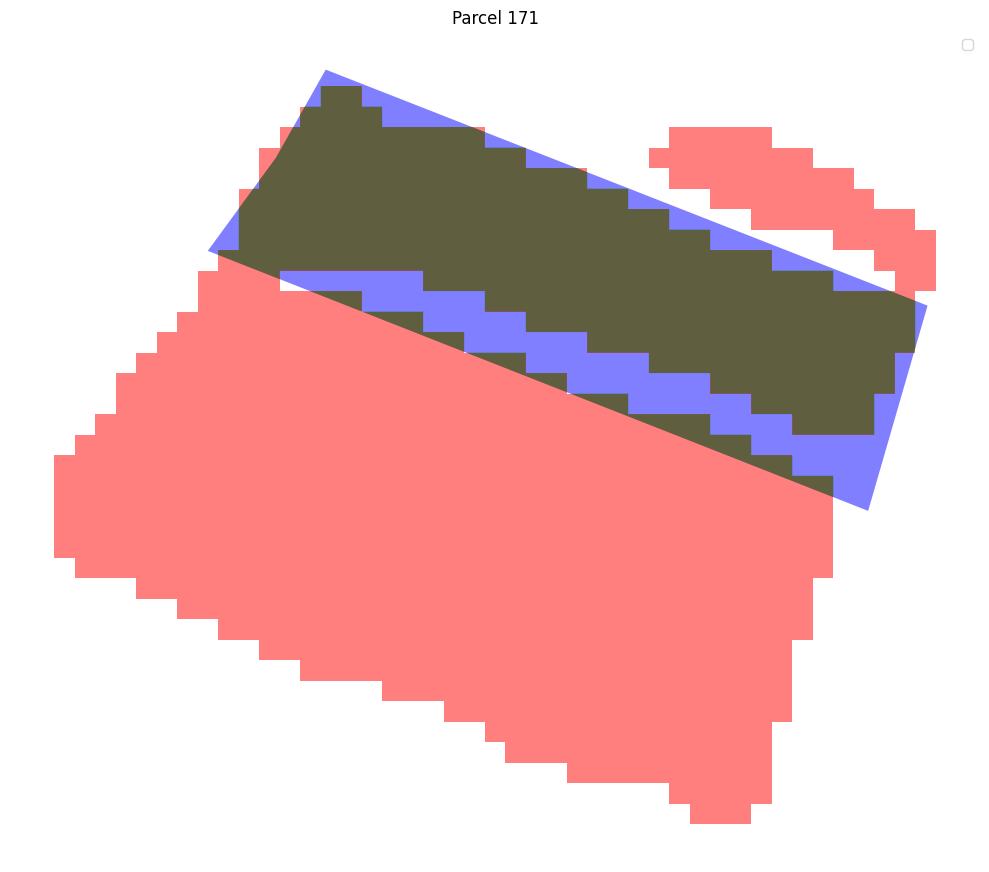

Parcel 171:
True Positive (Correctly predicted): 6414.79 m²
False Negative (Missed): 2100.19 m²
Adjusted IoU: 0.75




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

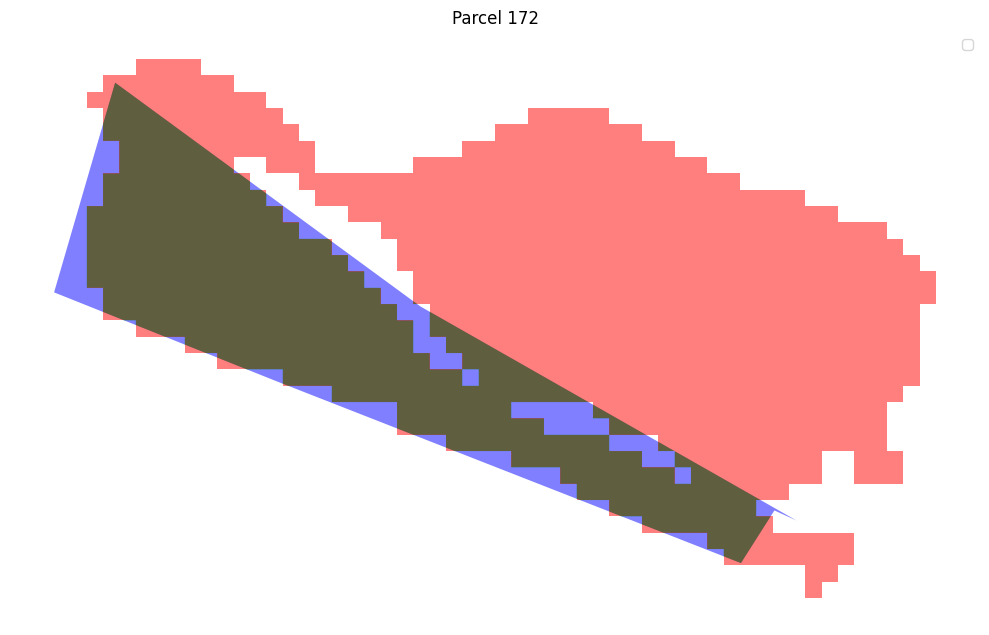

Parcel 172:
True Positive (Correctly predicted): 7618.94 m²
False Negative (Missed): 1493.43 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

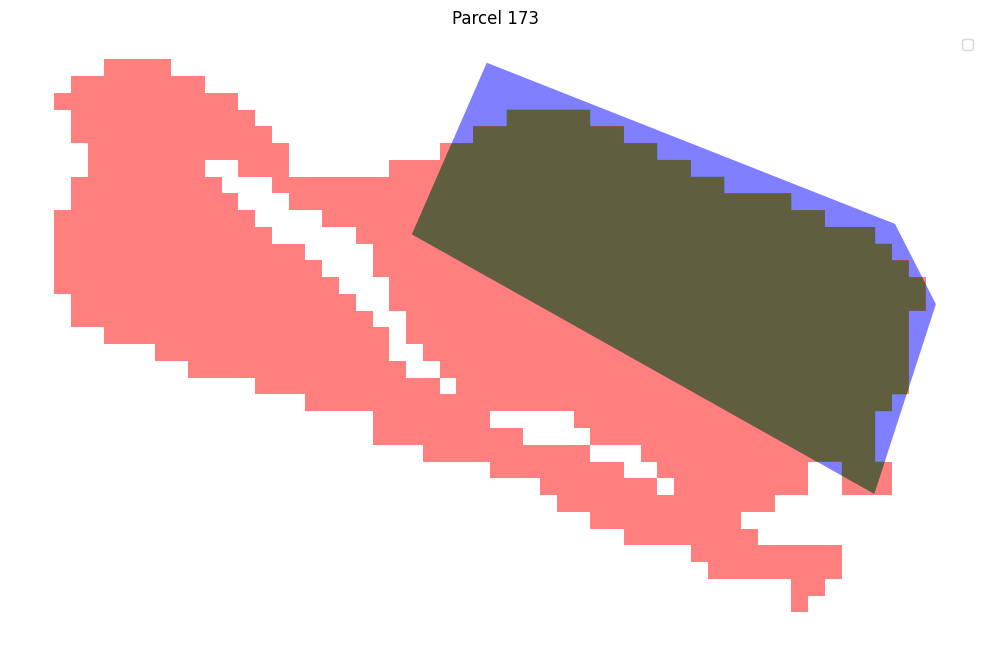

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 173:
True Positive (Correctly predicted): 8785.36 m²
False Negative (Missed): 1230.93 m²
Adjusted IoU: 0.88




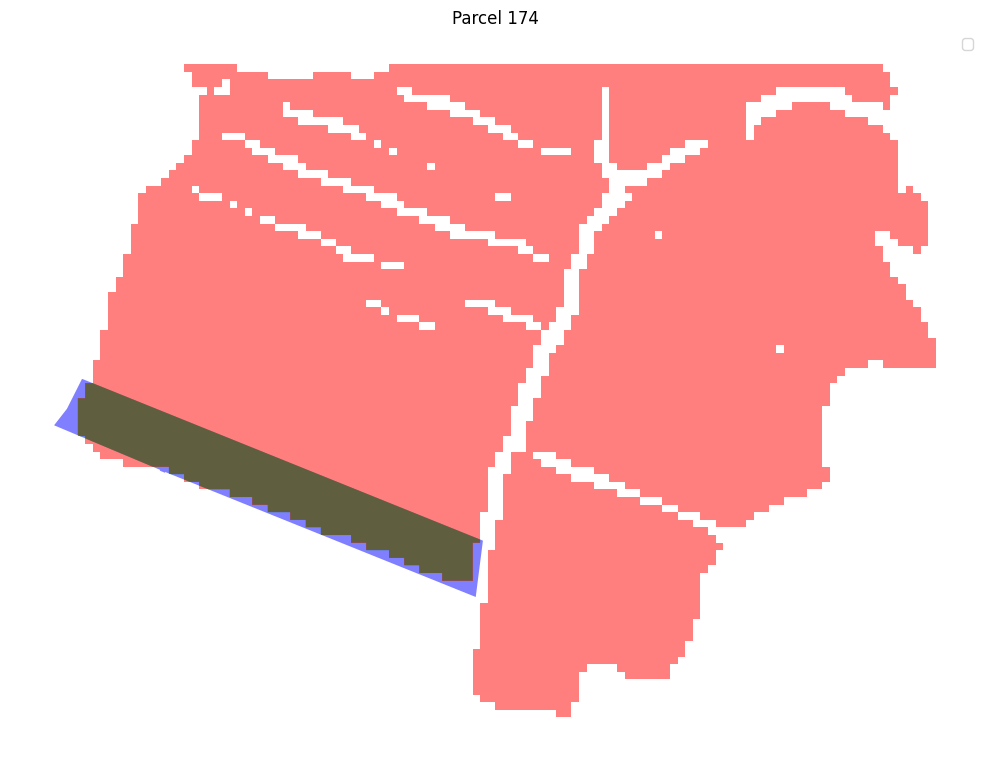

Parcel 174:
True Positive (Correctly predicted): 9342.50 m²
False Negative (Missed): 1191.17 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

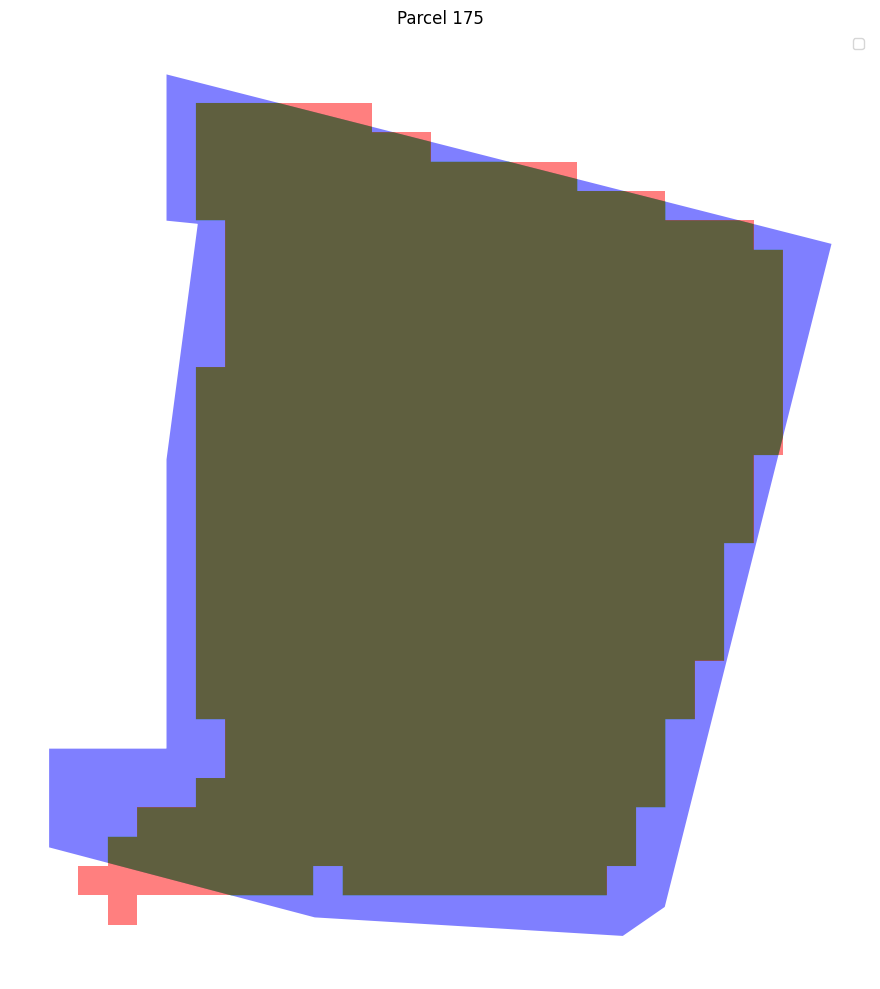

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 175:
True Positive (Correctly predicted): 11303.57 m²
False Negative (Missed): 1958.91 m²
Adjusted IoU: 0.85




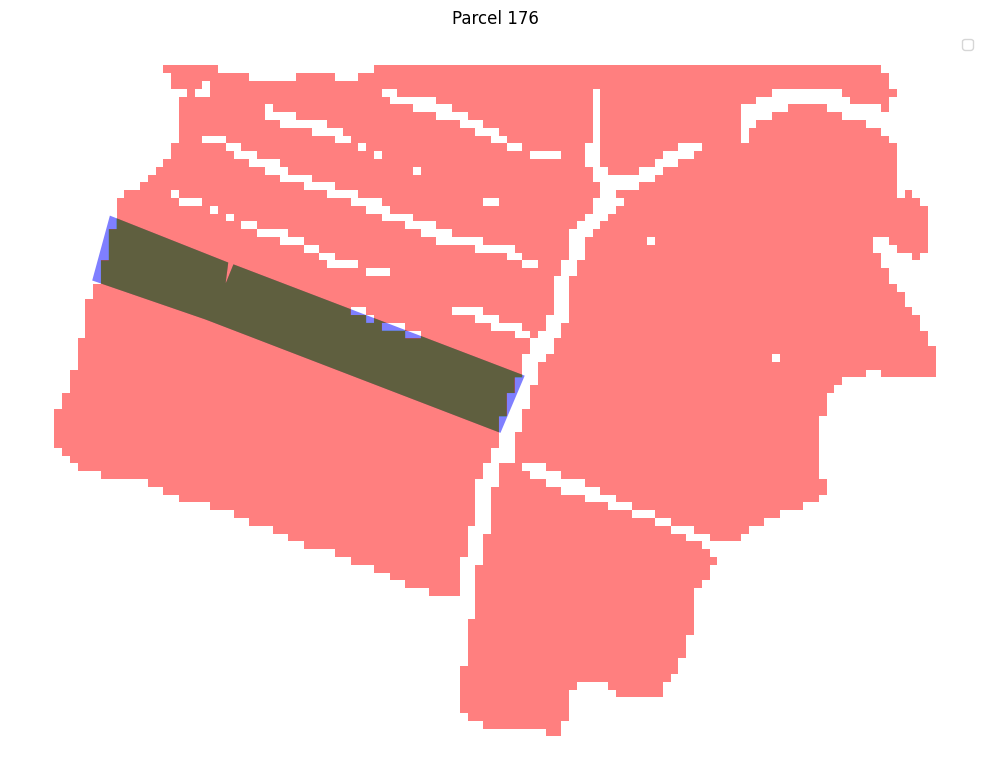

Parcel 176:
True Positive (Correctly predicted): 10825.96 m²
False Negative (Missed): 435.41 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

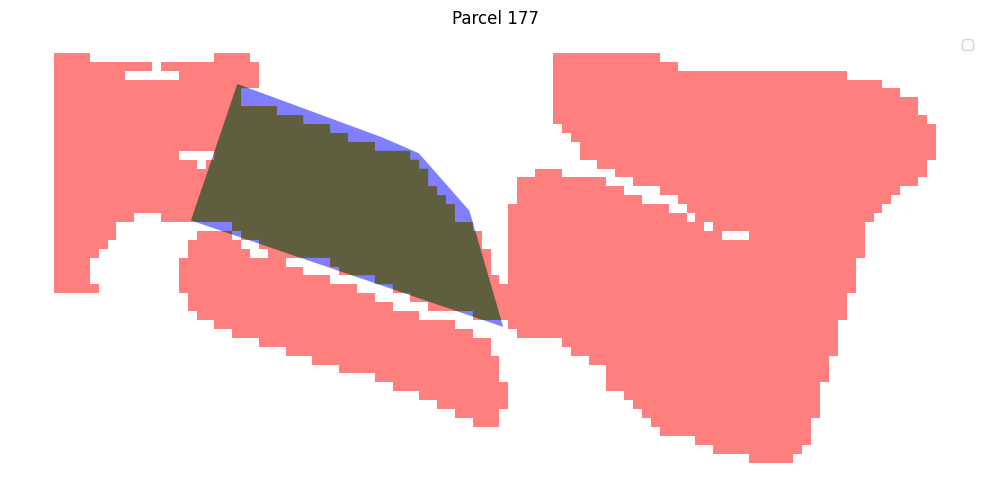

Parcel 177:
True Positive (Correctly predicted): 11090.68 m²
False Negative (Missed): 1117.20 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

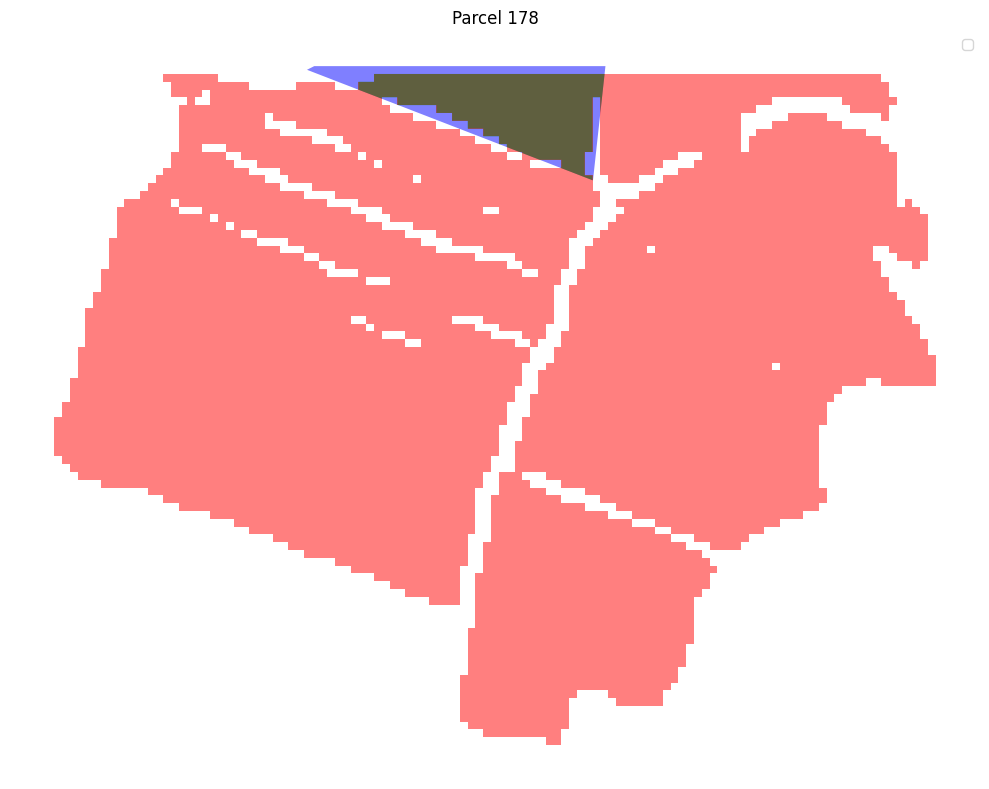

Parcel 178:
True Positive (Correctly predicted): 5476.85 m²
False Negative (Missed): 1732.74 m²
Adjusted IoU: 0.76




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

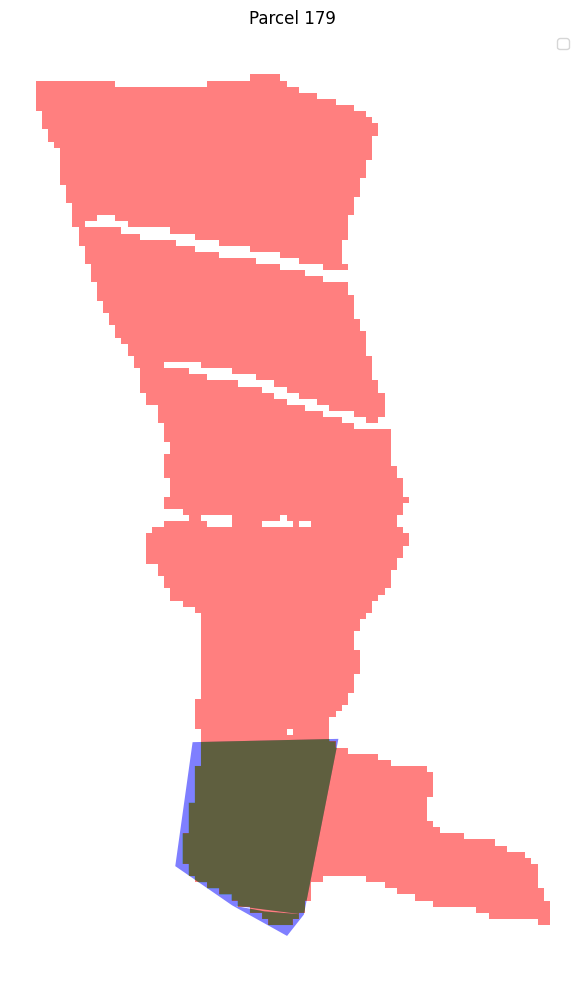

Parcel 179:
True Positive (Correctly predicted): 14340.41 m²
False Negative (Missed): 1055.64 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

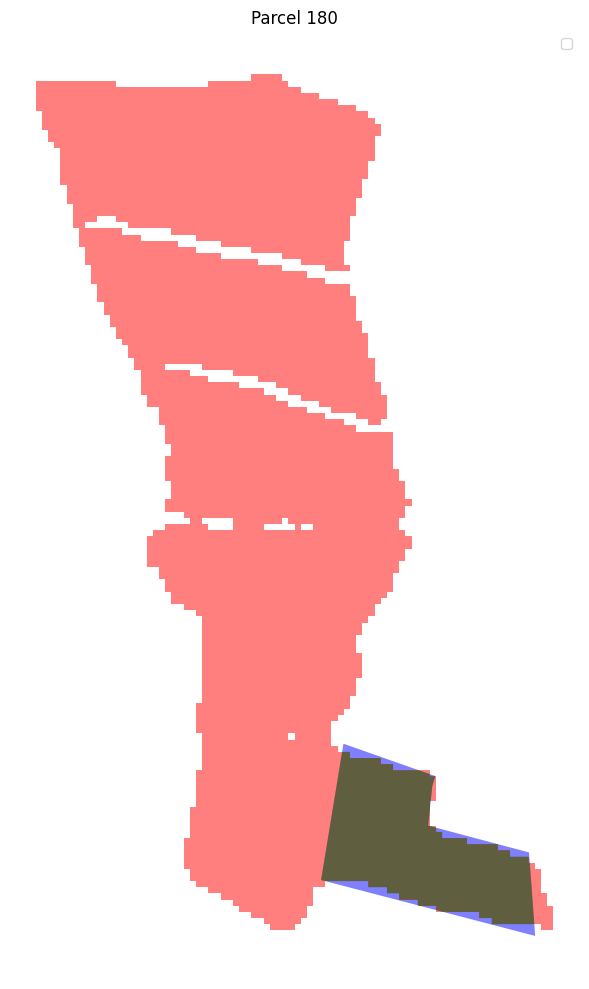

Parcel 180:
True Positive (Correctly predicted): 13213.35 m²
False Negative (Missed): 1276.27 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

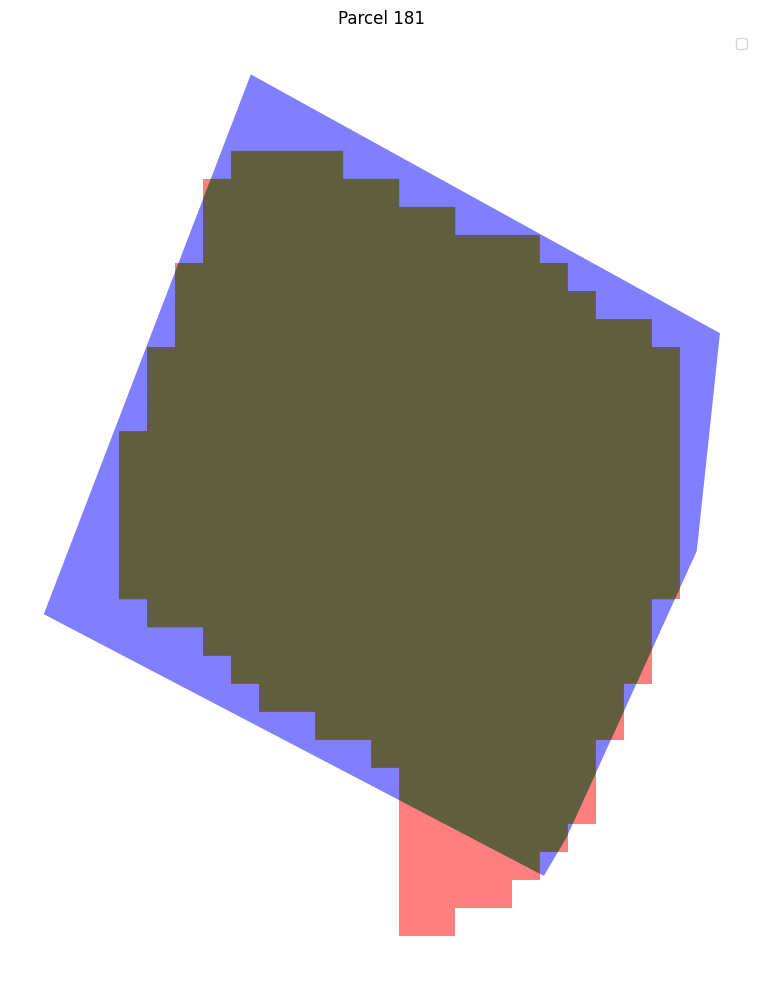

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 181:
True Positive (Correctly predicted): 8795.19 m²
False Negative (Missed): 1561.56 m²
Adjusted IoU: 0.85




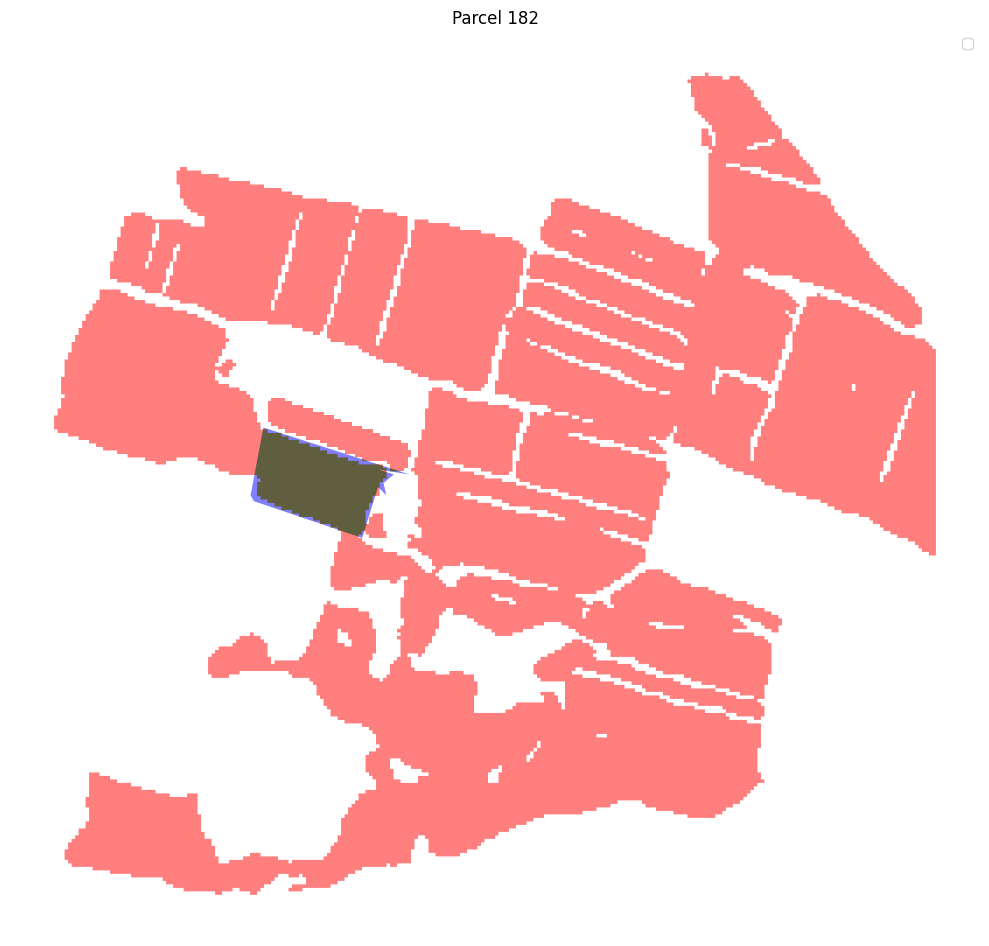

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 182:
True Positive (Correctly predicted): 17026.13 m²
False Negative (Missed): 1866.42 m²
Adjusted IoU: 0.90




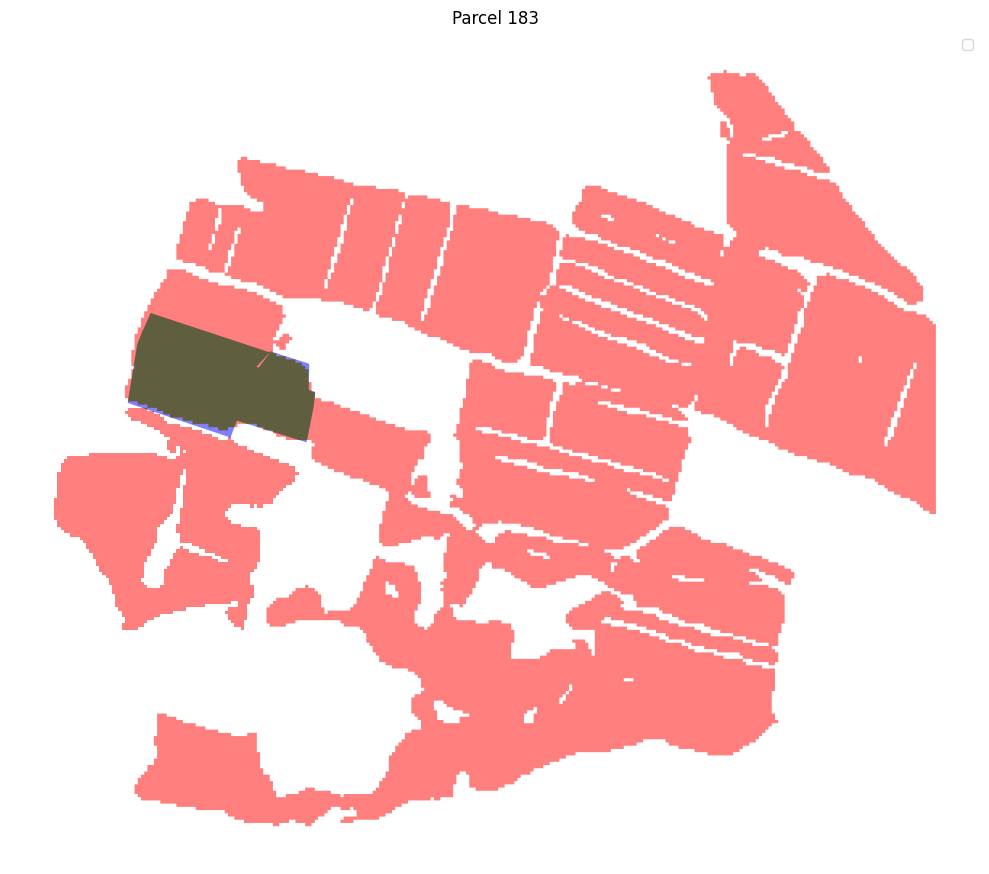

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 183:
True Positive (Correctly predicted): 36340.46 m²
False Negative (Missed): 1207.10 m²
Adjusted IoU: 0.97




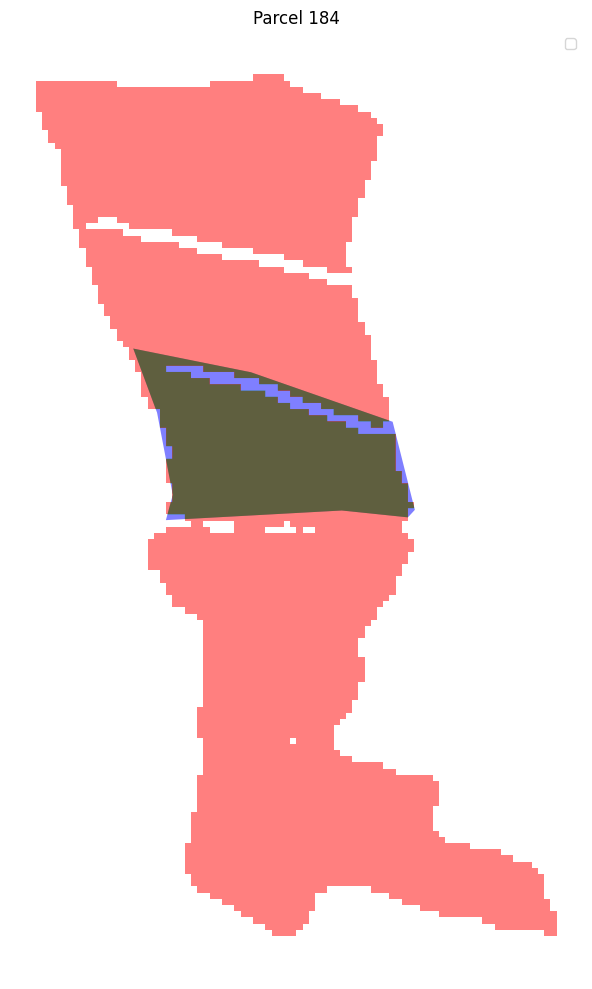

Parcel 184:
True Positive (Correctly predicted): 18802.99 m²
False Negative (Missed): 1936.24 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

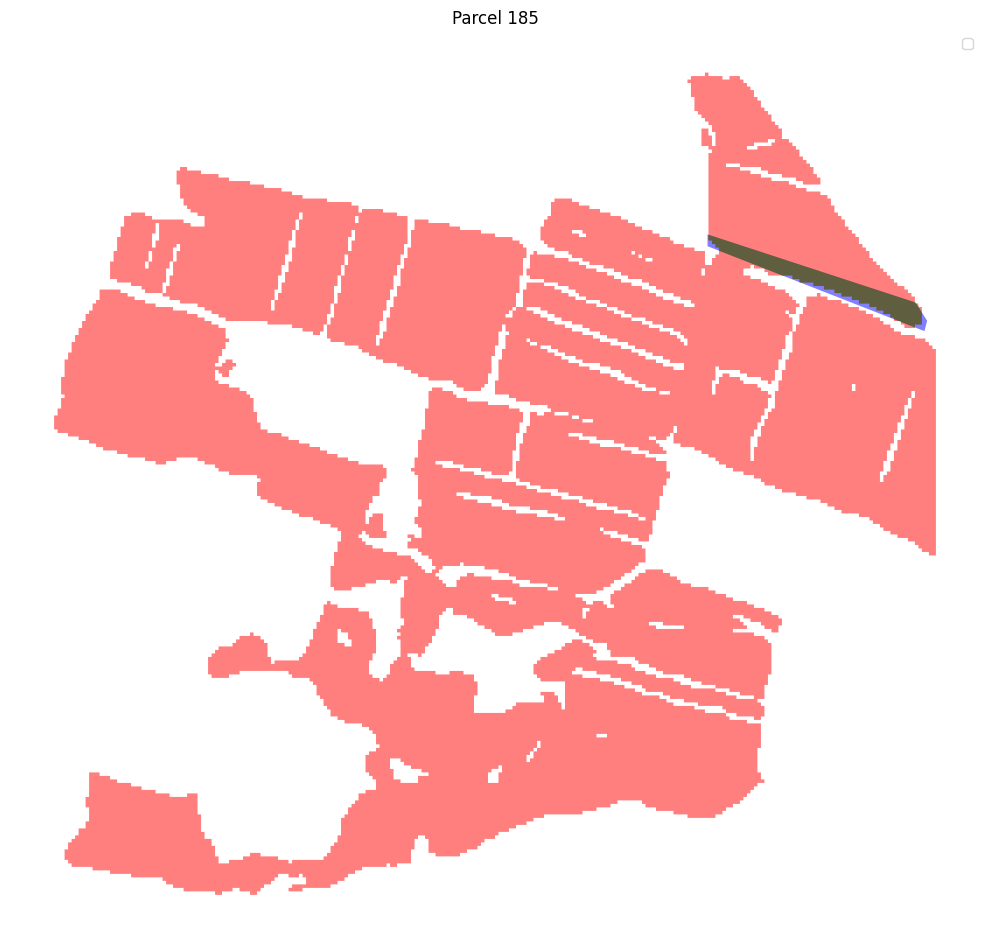

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 185:
True Positive (Correctly predicted): 7176.54 m²
False Negative (Missed): 1054.50 m²
Adjusted IoU: 0.87




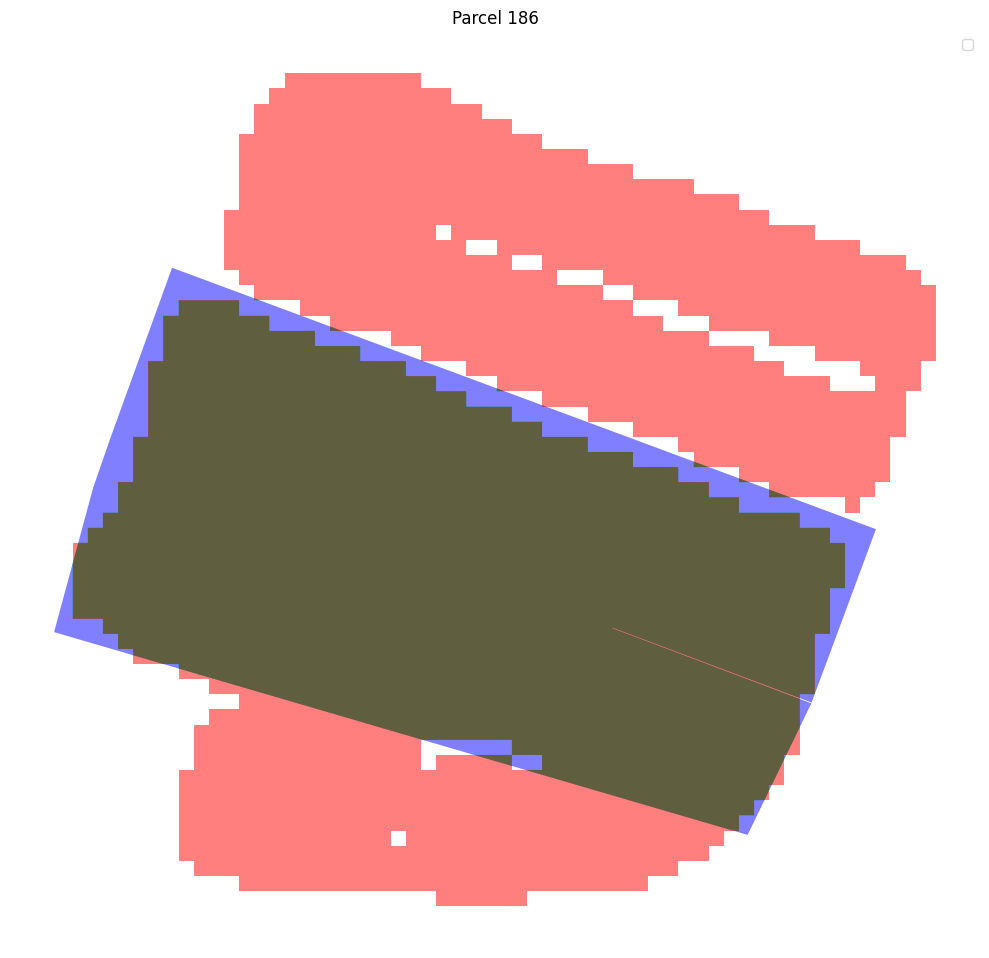

Parcel 186:
True Positive (Correctly predicted): 26119.04 m²
False Negative (Missed): 2786.64 m²
Adjusted IoU: 0.90




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

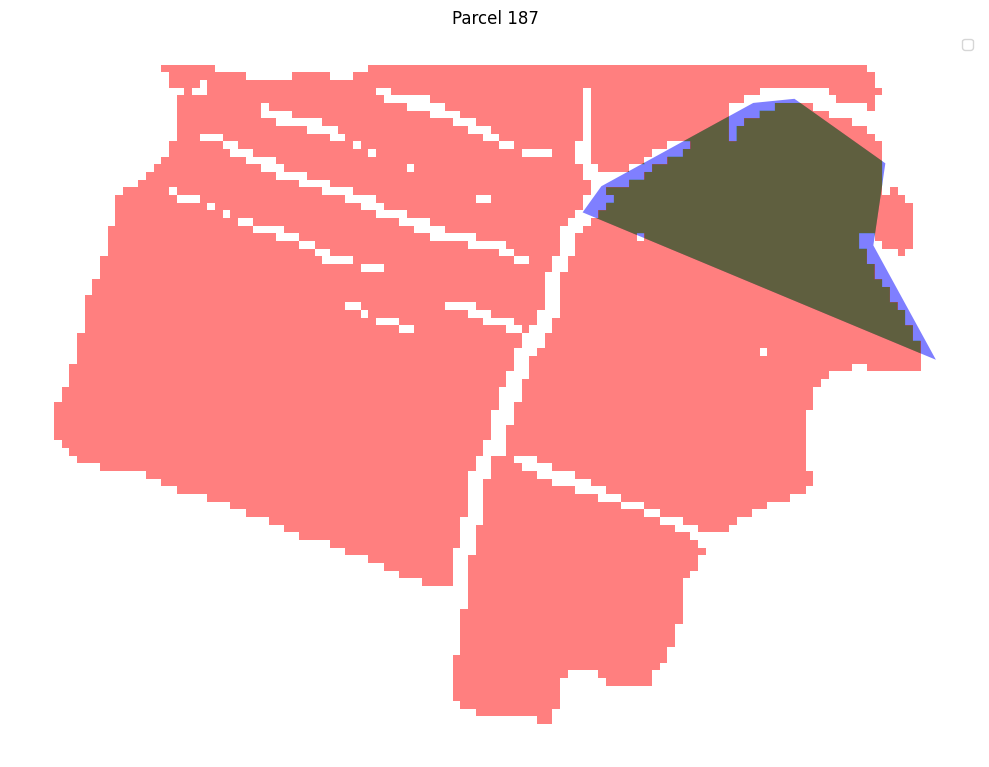

Parcel 187:
True Positive (Correctly predicted): 16713.83 m²
False Negative (Missed): 1496.57 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

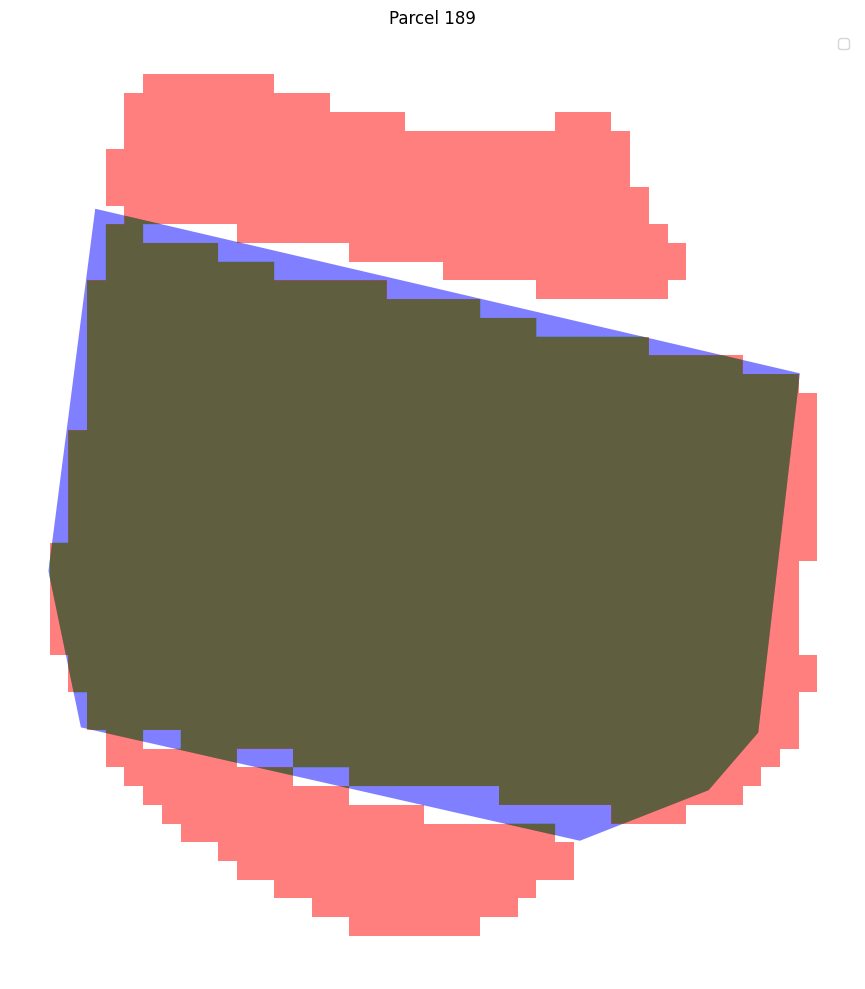

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 189:
True Positive (Correctly predicted): 23827.16 m²
False Negative (Missed): 1457.64 m²
Adjusted IoU: 0.94




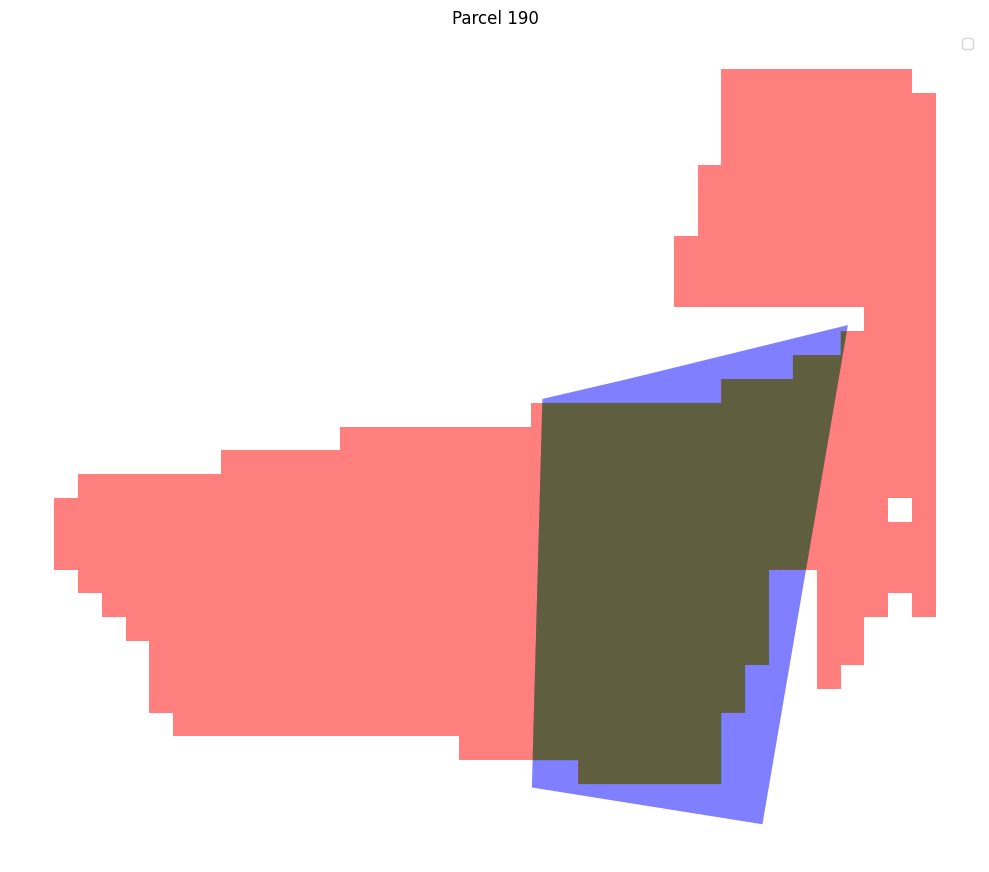

Parcel 190:
True Positive (Correctly predicted): 4195.28 m²
False Negative (Missed): 995.84 m²
Adjusted IoU: 0.81




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

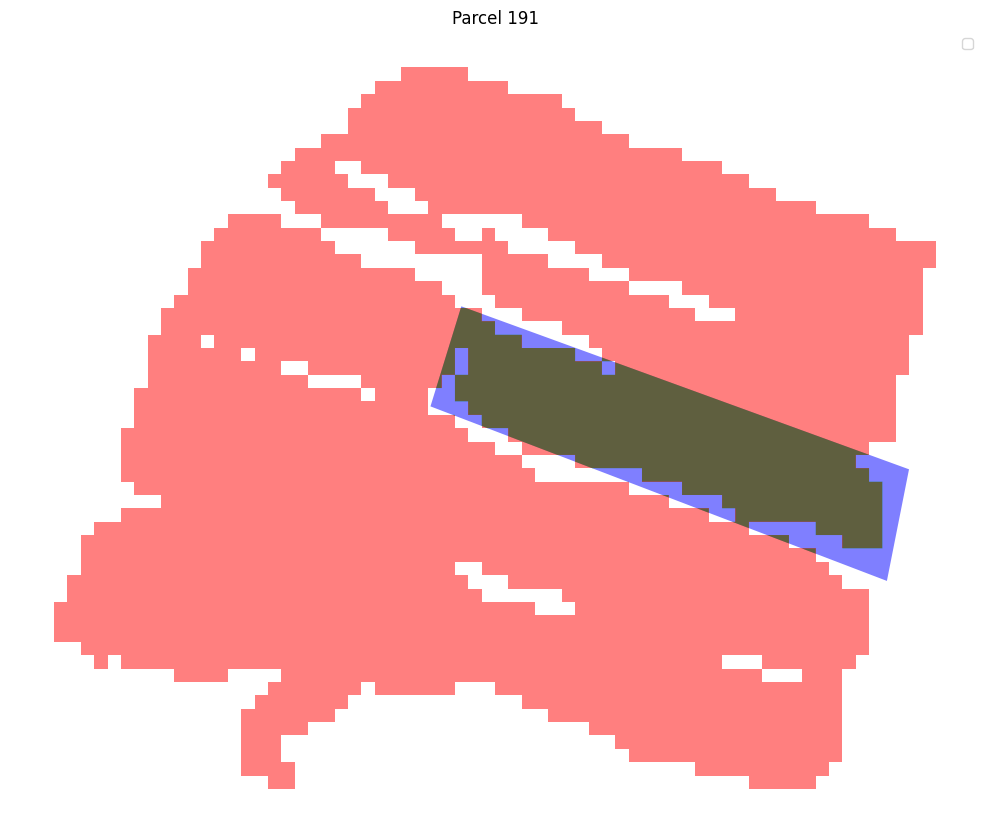

Parcel 191:
True Positive (Correctly predicted): 5973.22 m²
False Negative (Missed): 1352.41 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

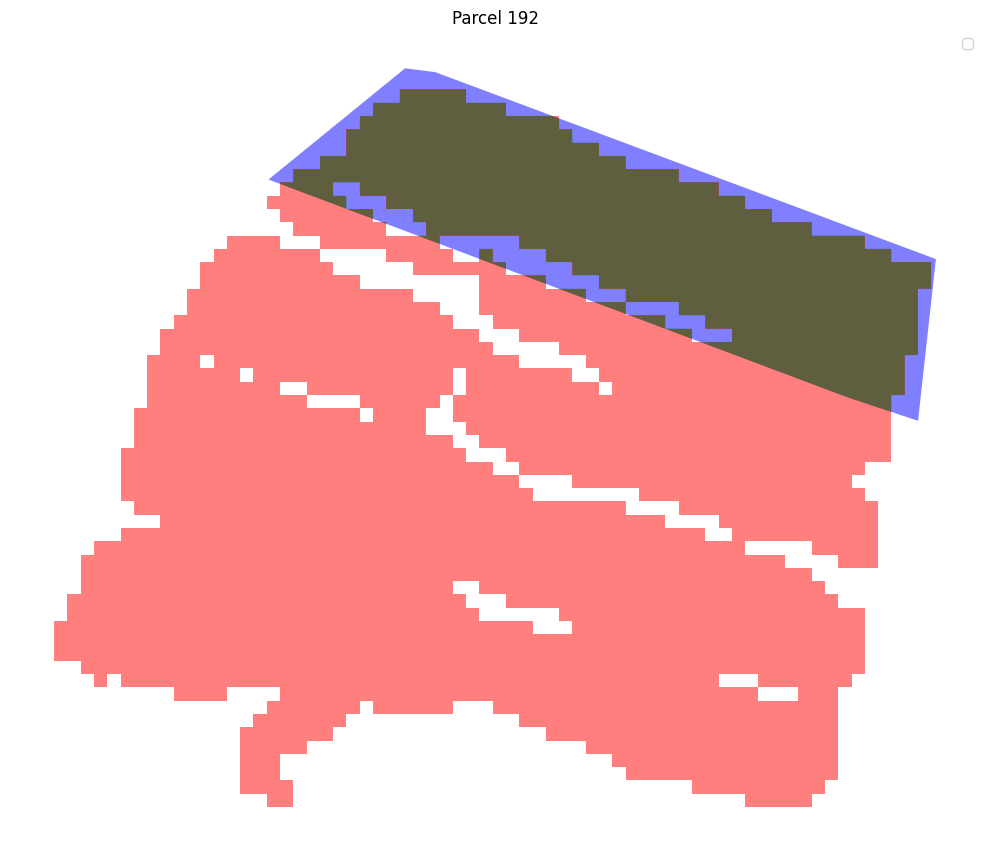

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 192:
True Positive (Correctly predicted): 11423.68 m²
False Negative (Missed): 2725.27 m²
Adjusted IoU: 0.81




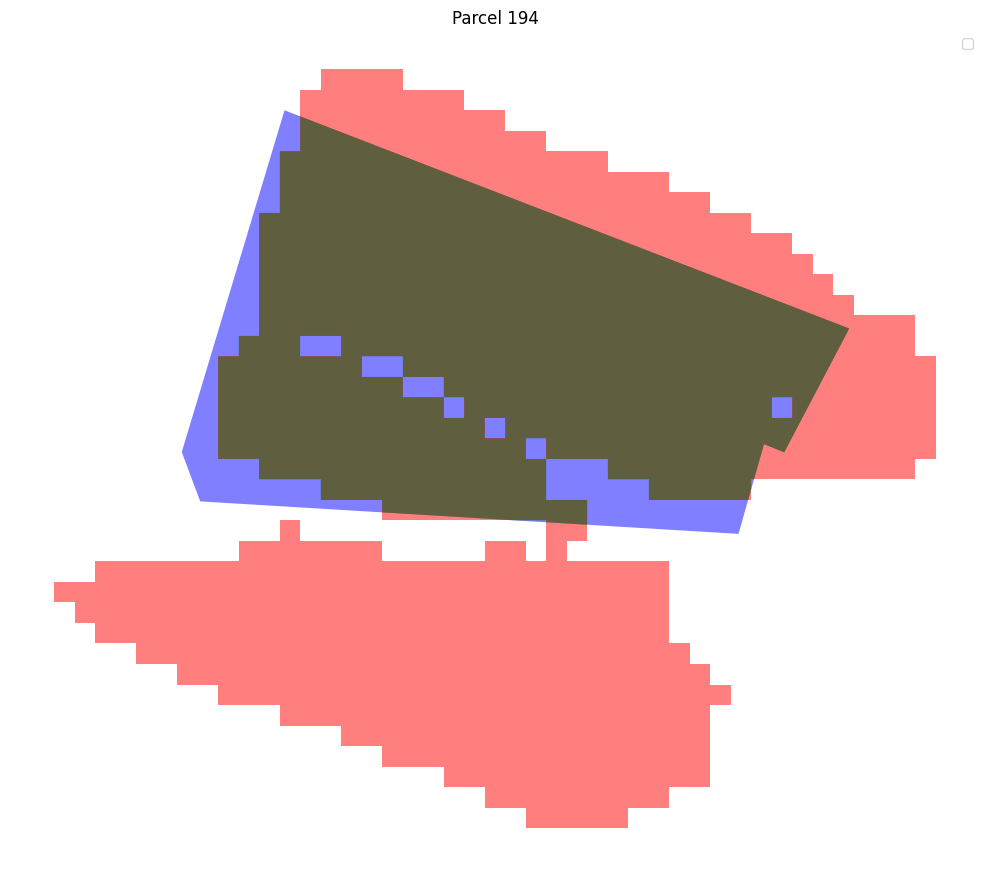

Parcel 194:
True Positive (Correctly predicted): 9296.35 m²
False Negative (Missed): 1496.59 m²
Adjusted IoU: 0.86




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

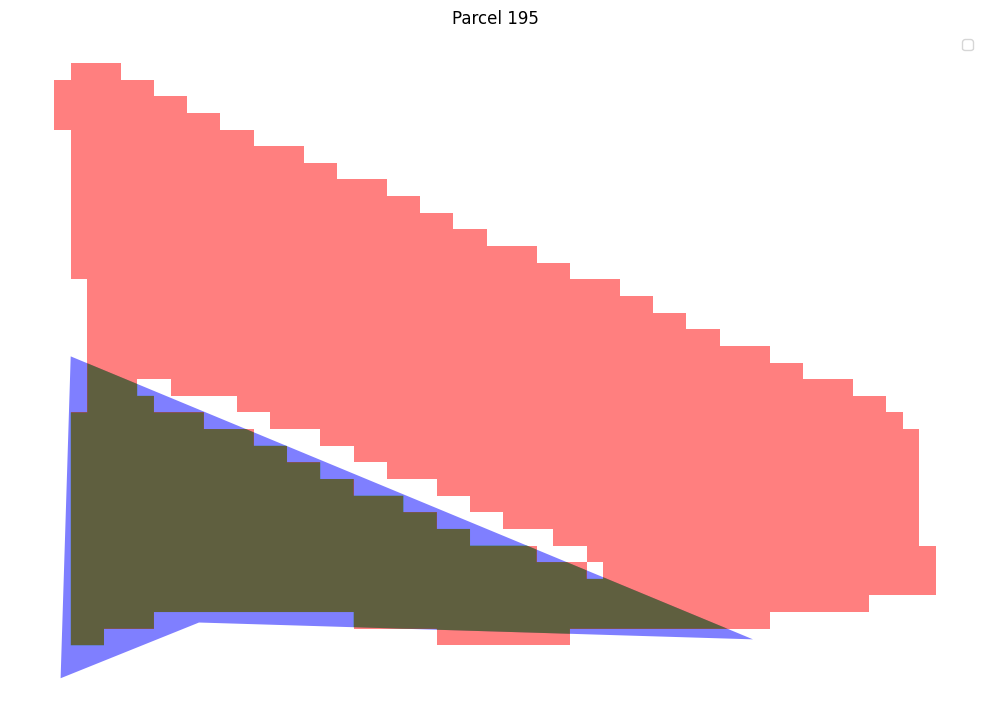

Parcel 195:
True Positive (Correctly predicted): 7386.81 m²
False Negative (Missed): 1159.23 m²
Adjusted IoU: 0.86




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

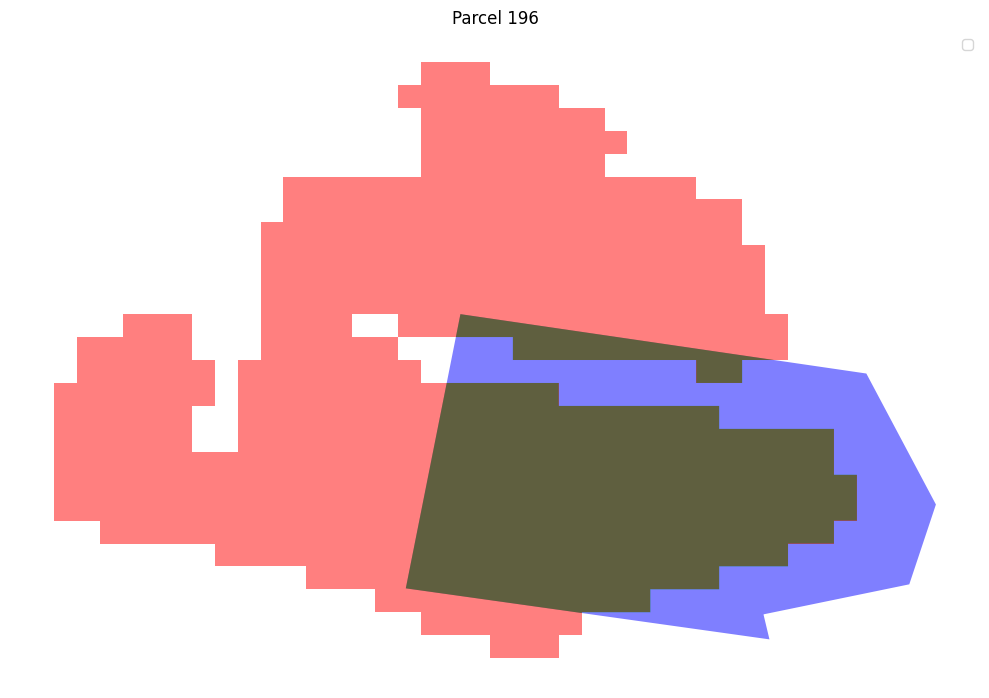

Parcel 196:
True Positive (Correctly predicted): 3956.60 m²
False Negative (Missed): 2060.14 m²
Adjusted IoU: 0.66




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

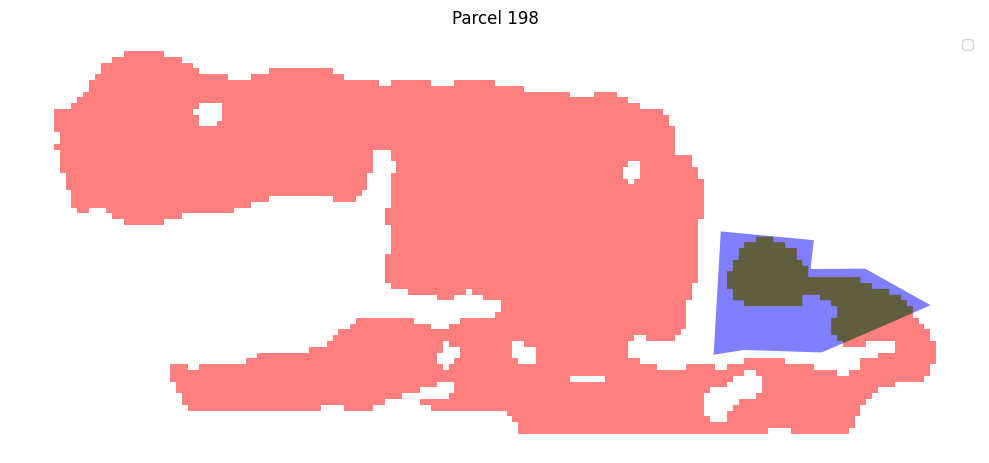

/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Parcel 198:
True Positive (Correctly predicted): 6179.08 m²
False Negative (Missed): 6554.81 m²
Adjusted IoU: 0.49




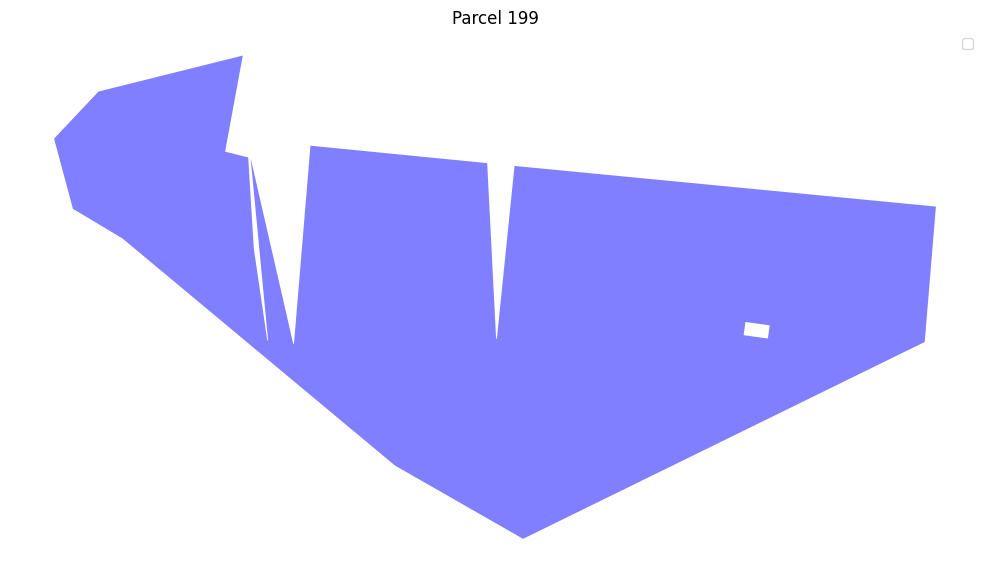

/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Parcel 199:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 11422.39 m²
Adjusted IoU: 0.00




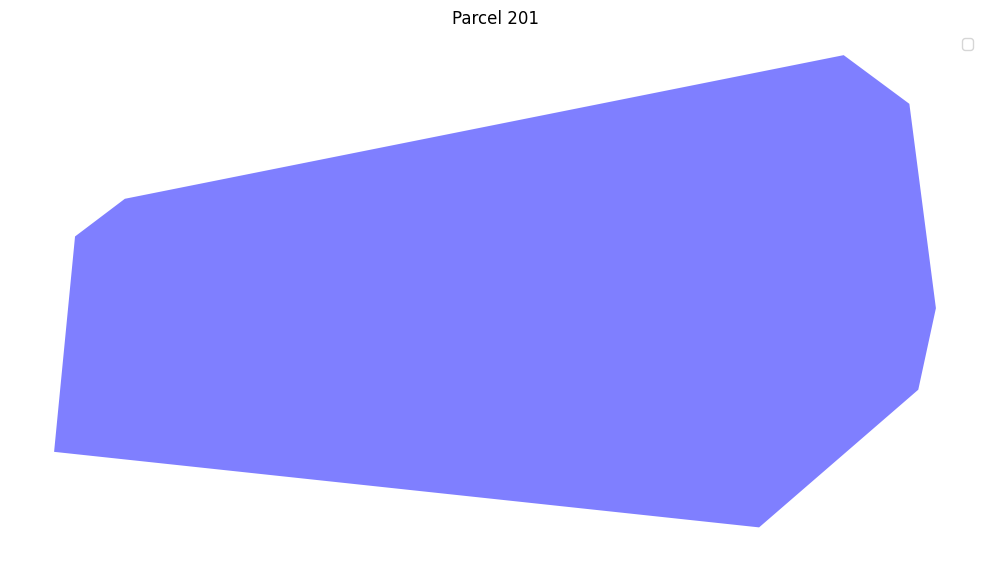

Parcel 201:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 6682.32 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

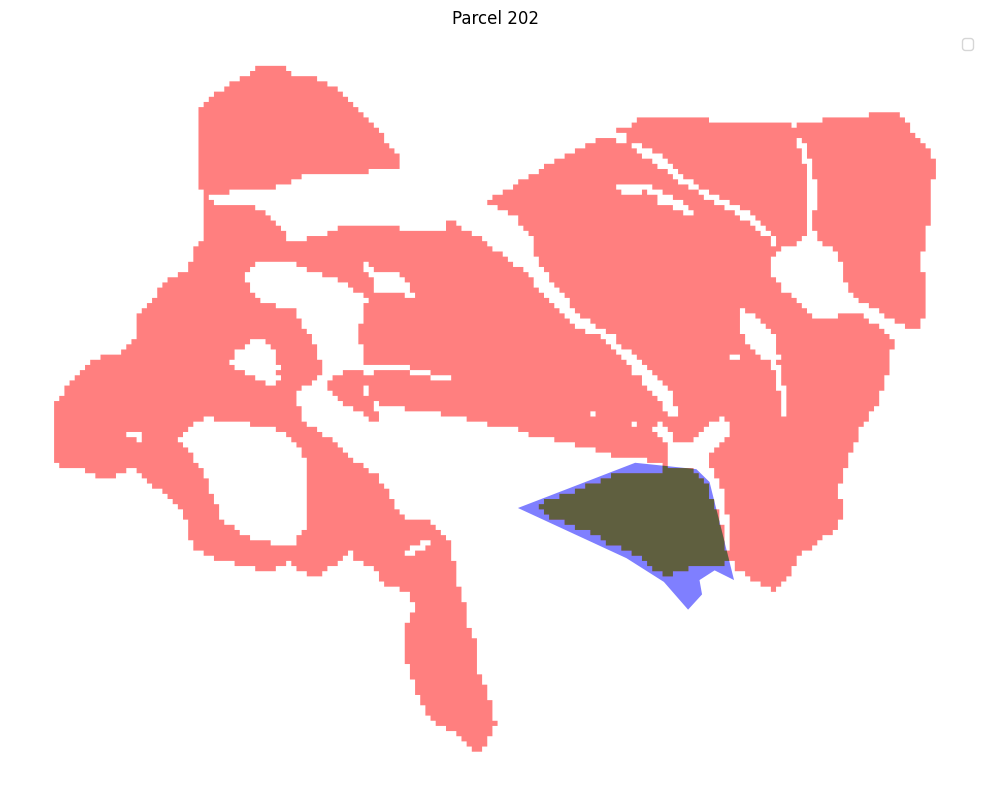

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 202:
True Positive (Correctly predicted): 11641.36 m²
False Negative (Missed): 3108.61 m²
Adjusted IoU: 0.79




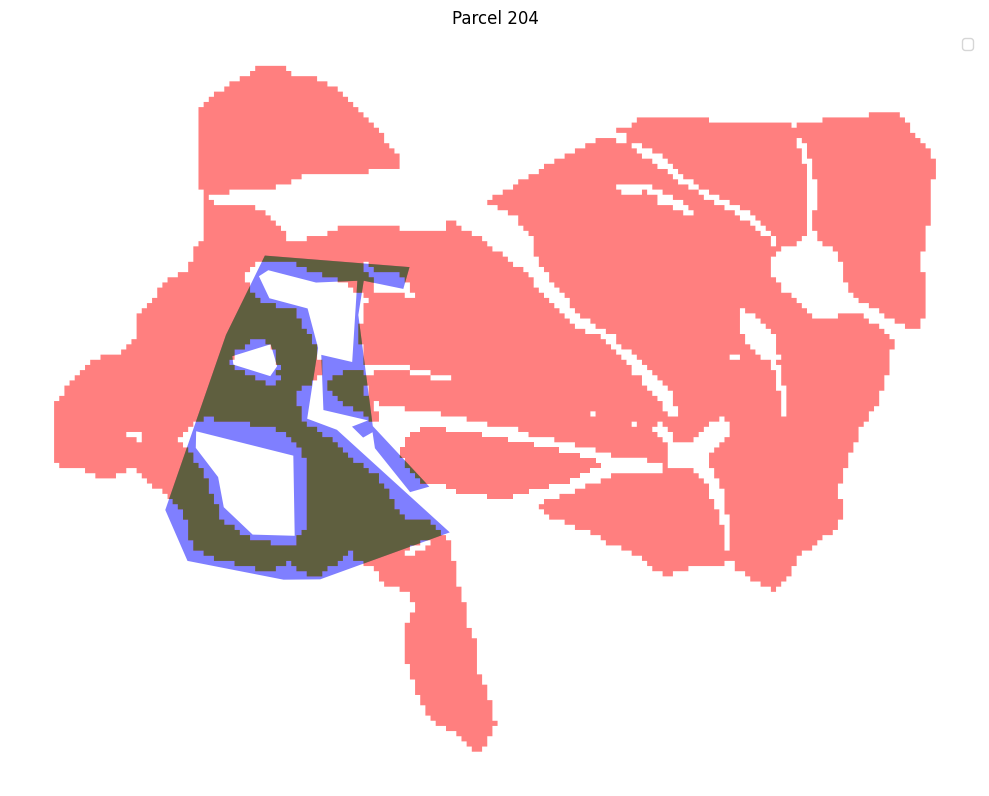

Parcel 204:
True Positive (Correctly predicted): 27215.77 m²
False Negative (Missed): 13401.18 m²
Adjusted IoU: 0.67




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

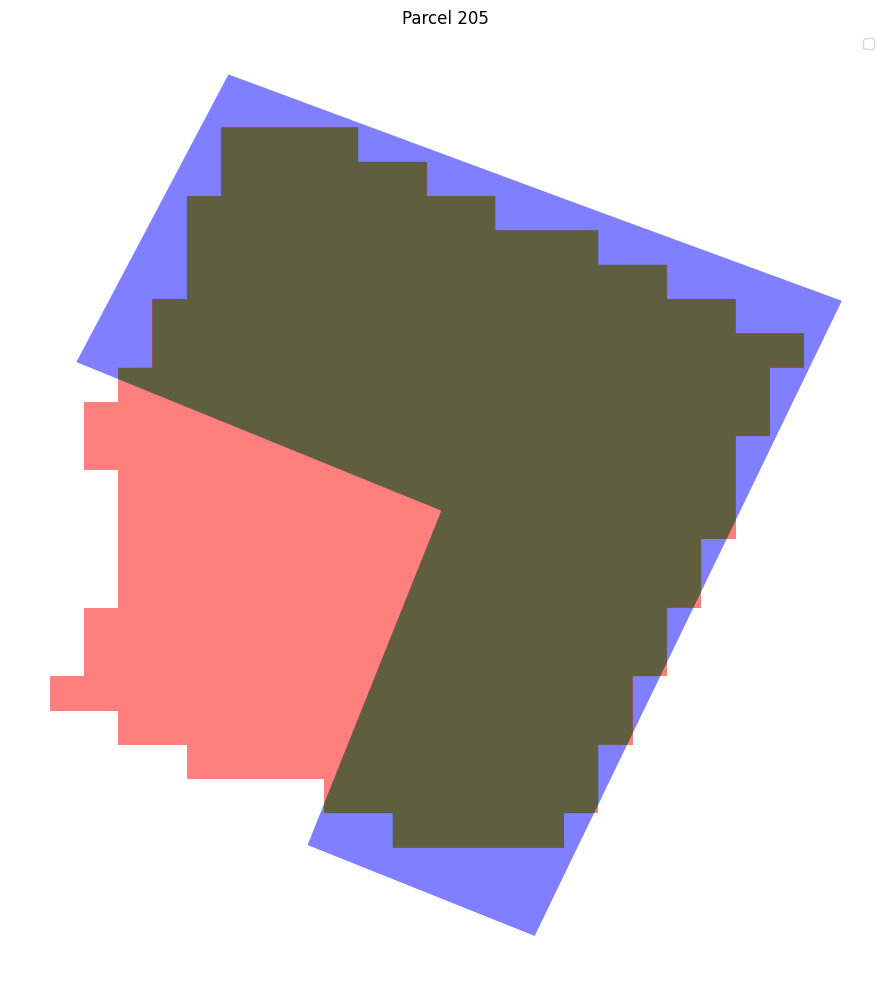

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 205:
True Positive (Correctly predicted): 5402.50 m²
False Negative (Missed): 1235.51 m²
Adjusted IoU: 0.81




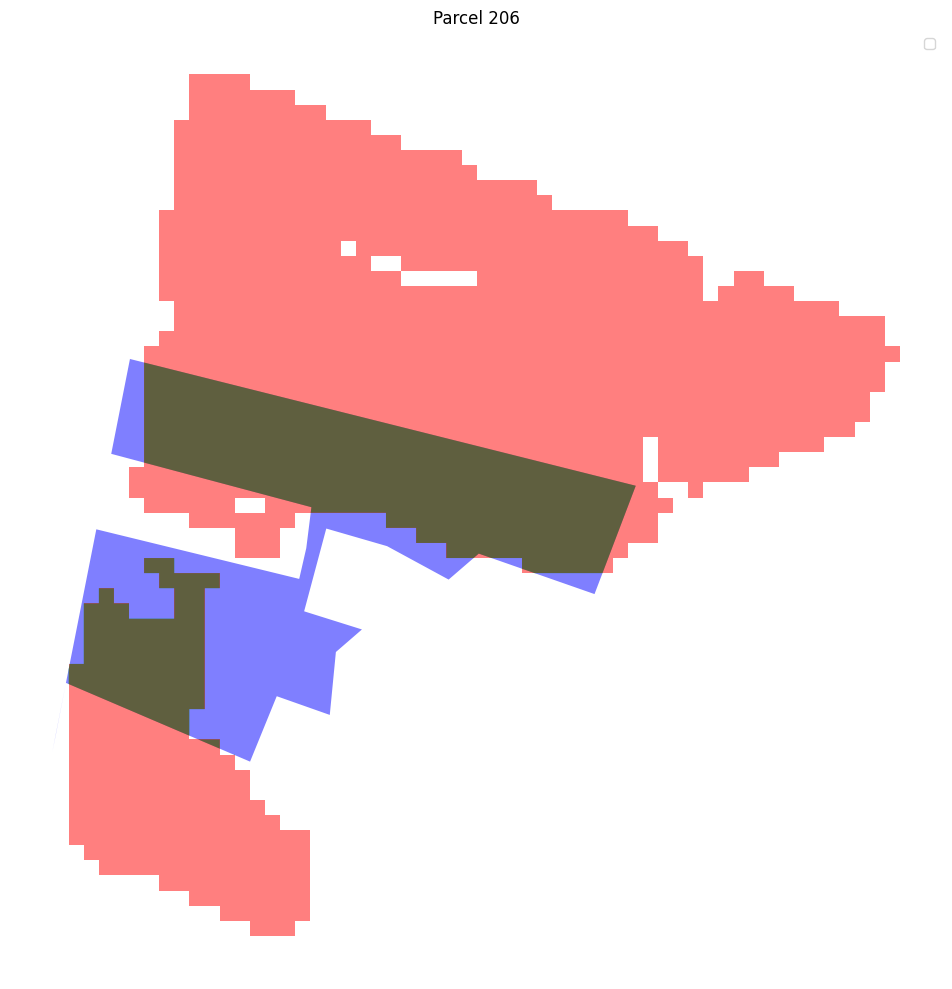

Parcel 206:
True Positive (Correctly predicted): 7011.84 m²
False Negative (Missed): 3710.43 m²
Adjusted IoU: 0.65




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

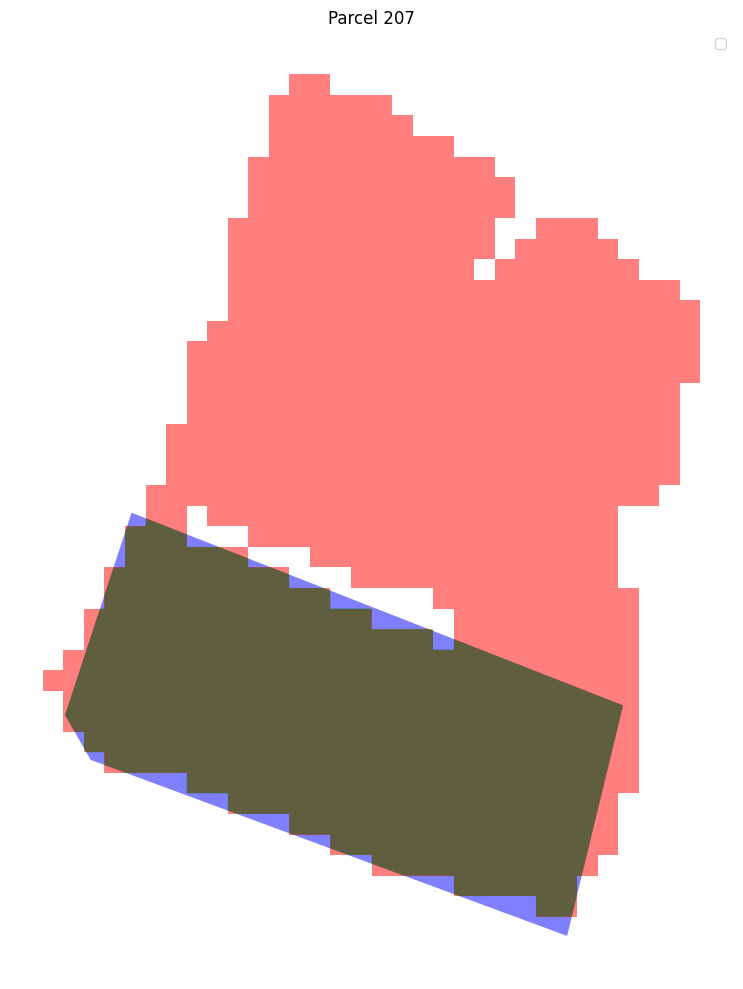

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 207:
True Positive (Correctly predicted): 7233.09 m²
False Negative (Missed): 386.35 m²
Adjusted IoU: 0.95




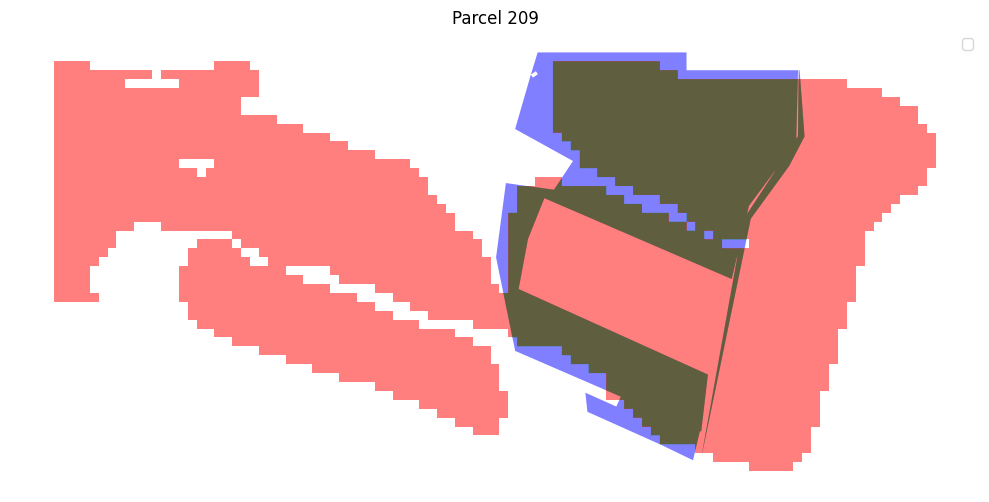

Parcel 209:
True Positive (Correctly predicted): 16122.86 m²
False Negative (Missed): 3653.34 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

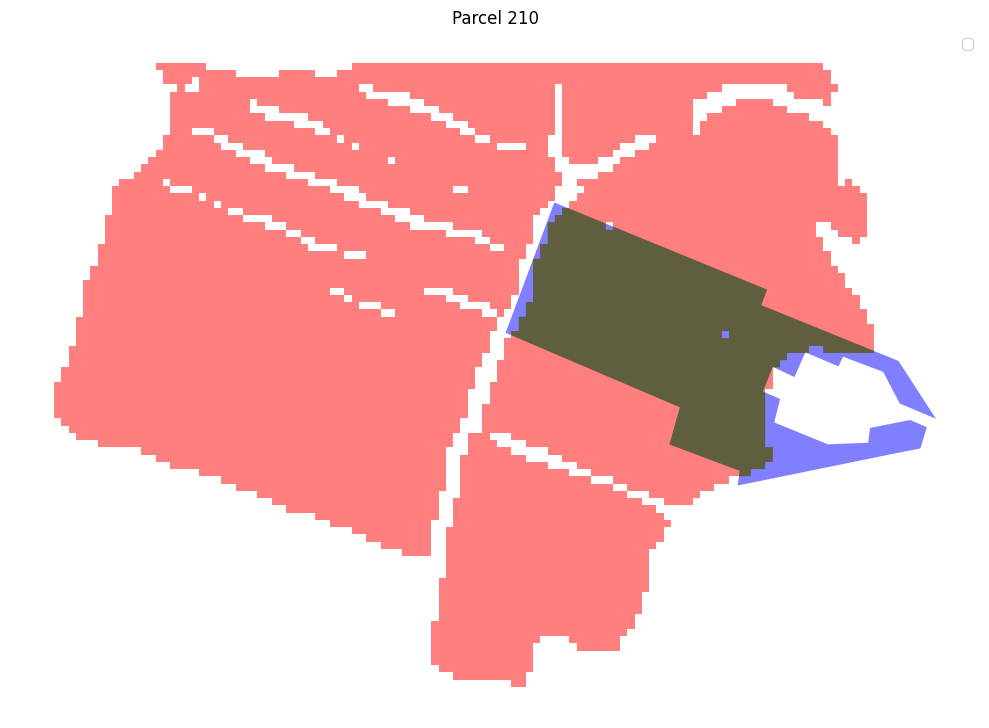

Parcel 210:
True Positive (Correctly predicted): 19572.15 m²
False Negative (Missed): 4281.55 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

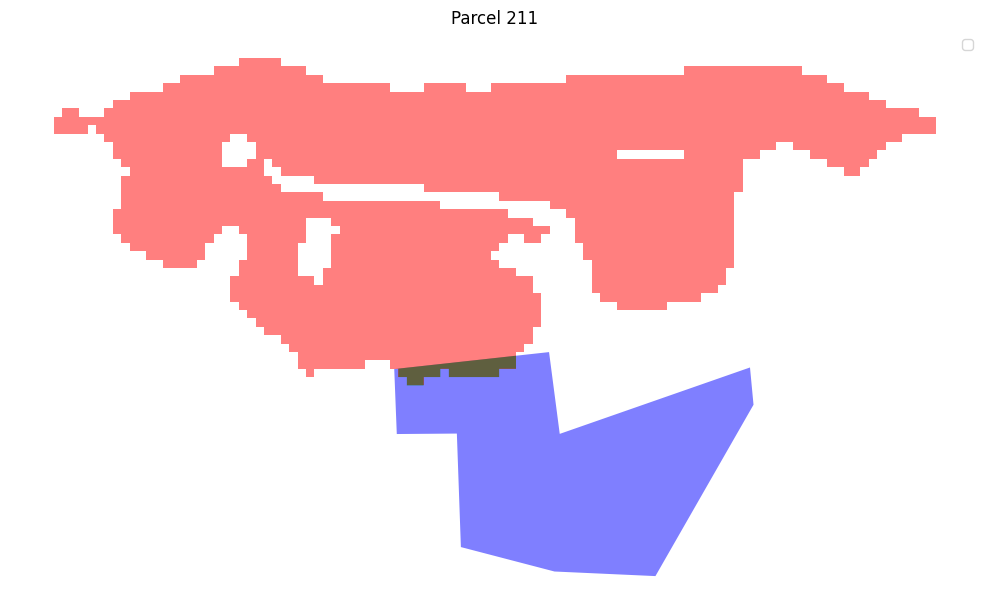

Parcel 211:
True Positive (Correctly predicted): 597.14 m²
False Negative (Missed): 17060.16 m²
Adjusted IoU: 0.03




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

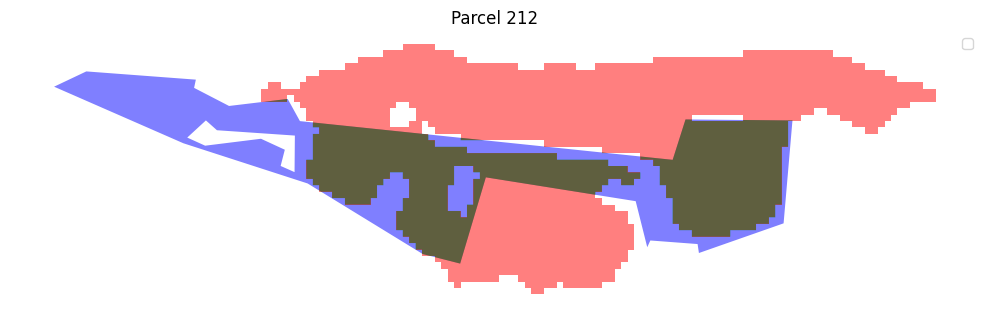

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 212:
True Positive (Correctly predicted): 17947.38 m²
False Negative (Missed): 12922.25 m²
Adjusted IoU: 0.58




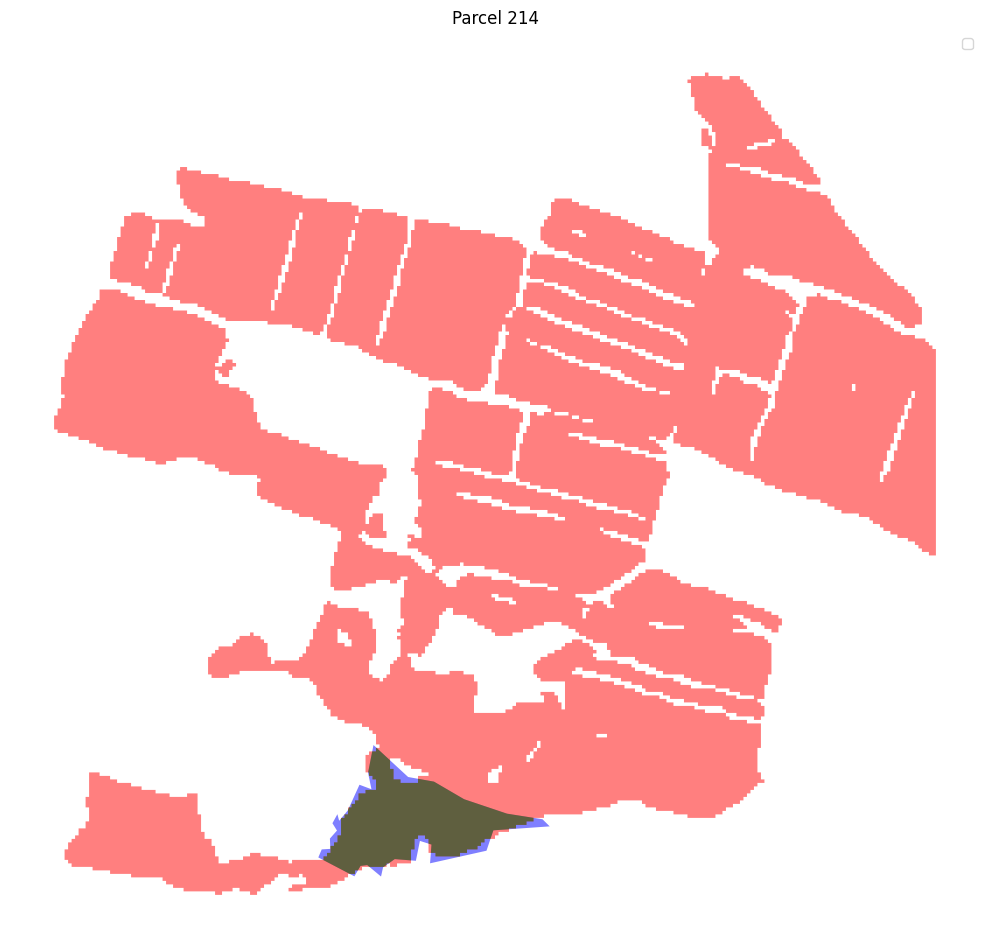

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 214:
True Positive (Correctly predicted): 22883.01 m²
False Negative (Missed): 2952.29 m²
Adjusted IoU: 0.89




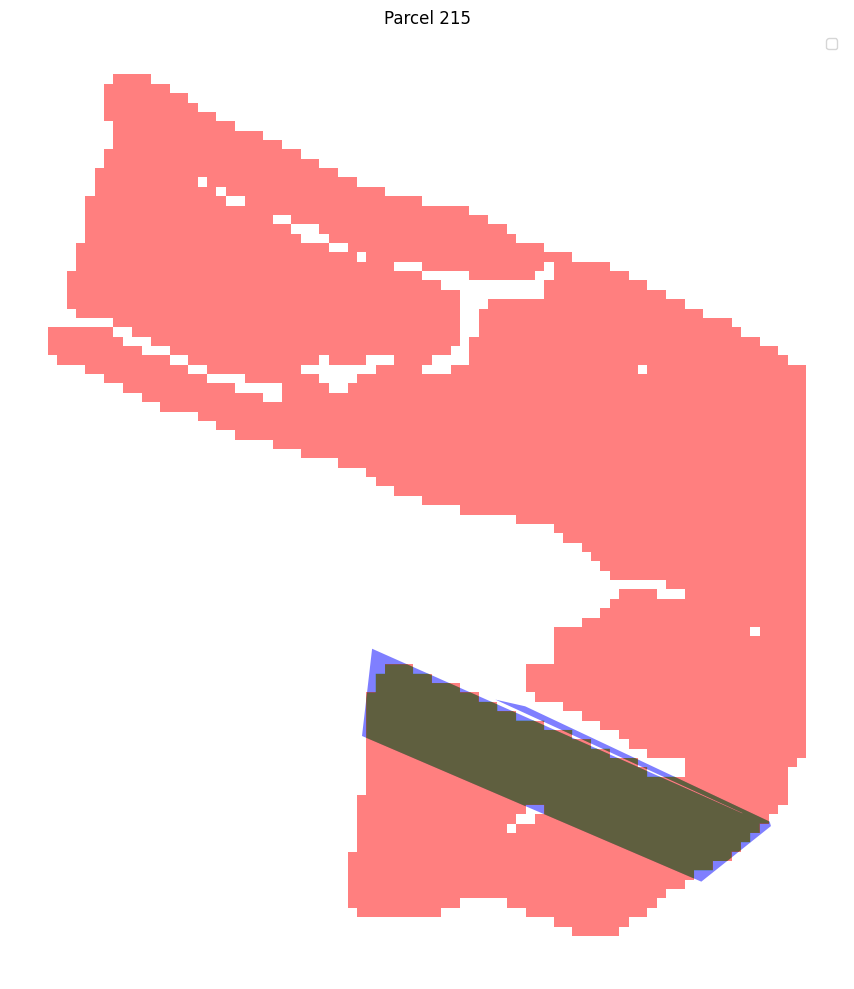

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 215:
True Positive (Correctly predicted): 9067.21 m²
False Negative (Missed): 691.49 m²
Adjusted IoU: 0.93




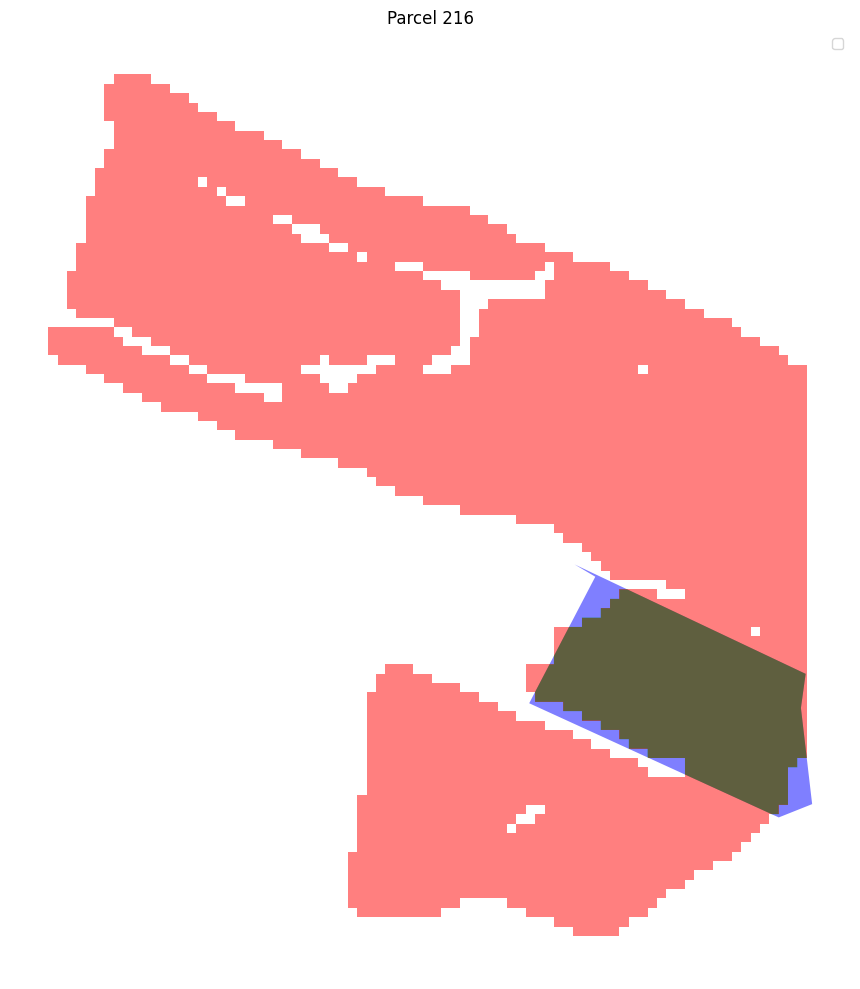

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 216:
True Positive (Correctly predicted): 9770.50 m²
False Negative (Missed): 1077.80 m²
Adjusted IoU: 0.90




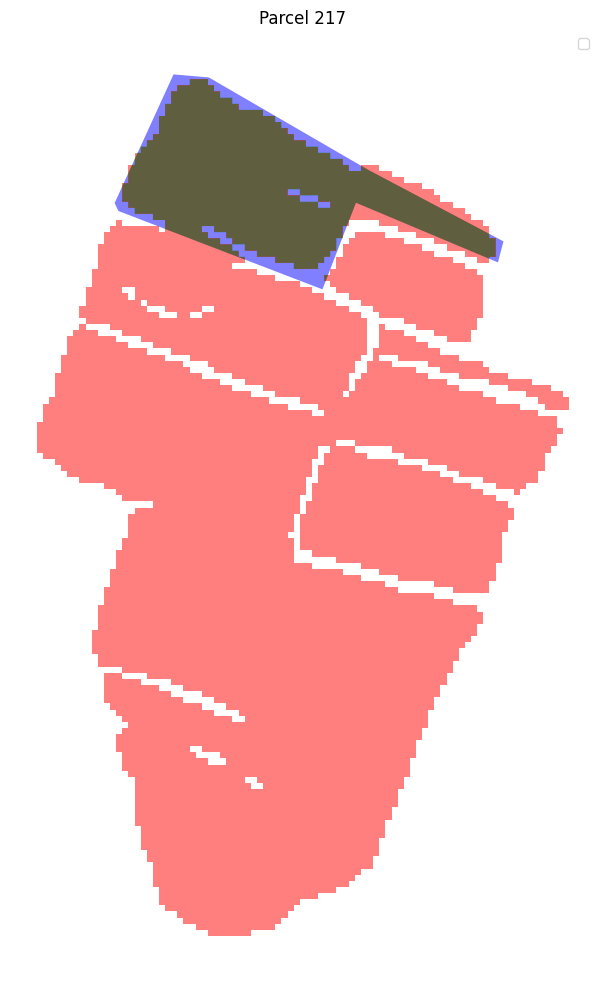

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 217:
True Positive (Correctly predicted): 21061.75 m²
False Negative (Missed): 3044.28 m²
Adjusted IoU: 0.87




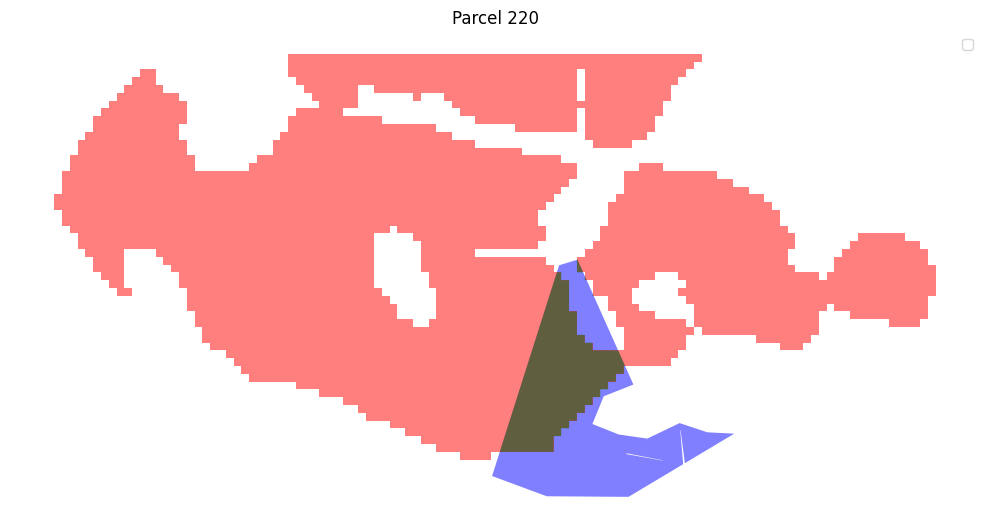

Parcel 220:
True Positive (Correctly predicted): 4113.76 m²
False Negative (Missed): 5598.52 m²
Adjusted IoU: 0.42




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

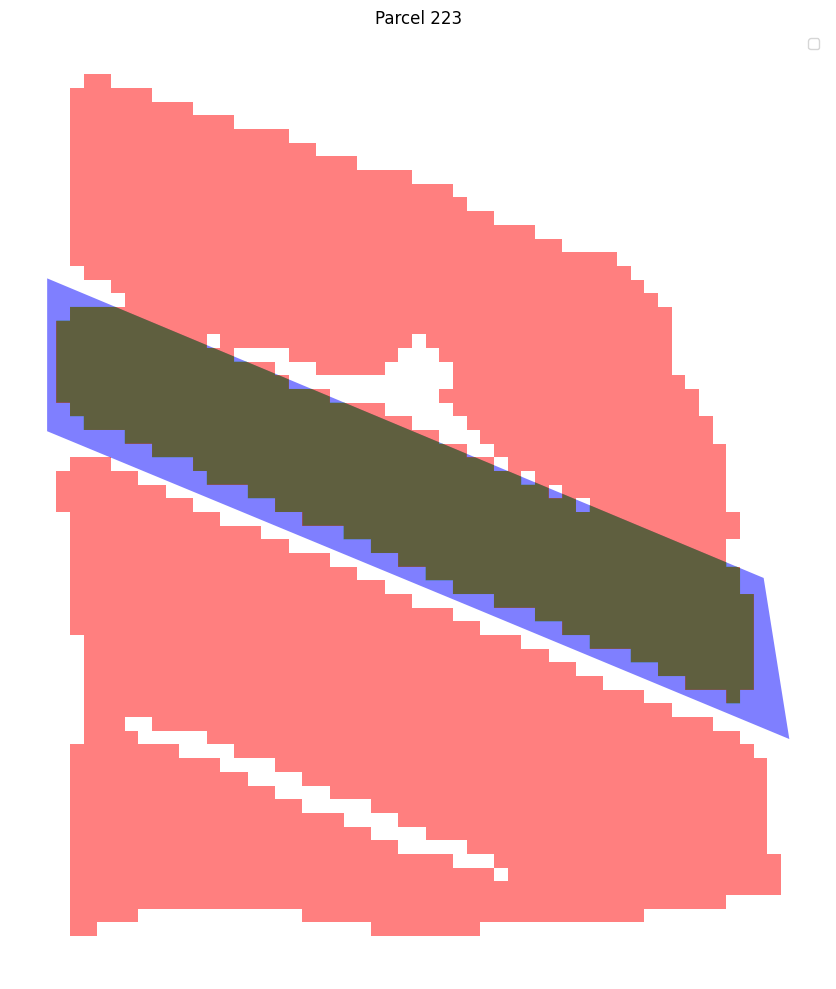

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 223:
True Positive (Correctly predicted): 12089.30 m²
False Negative (Missed): 2681.93 m²
Adjusted IoU: 0.82




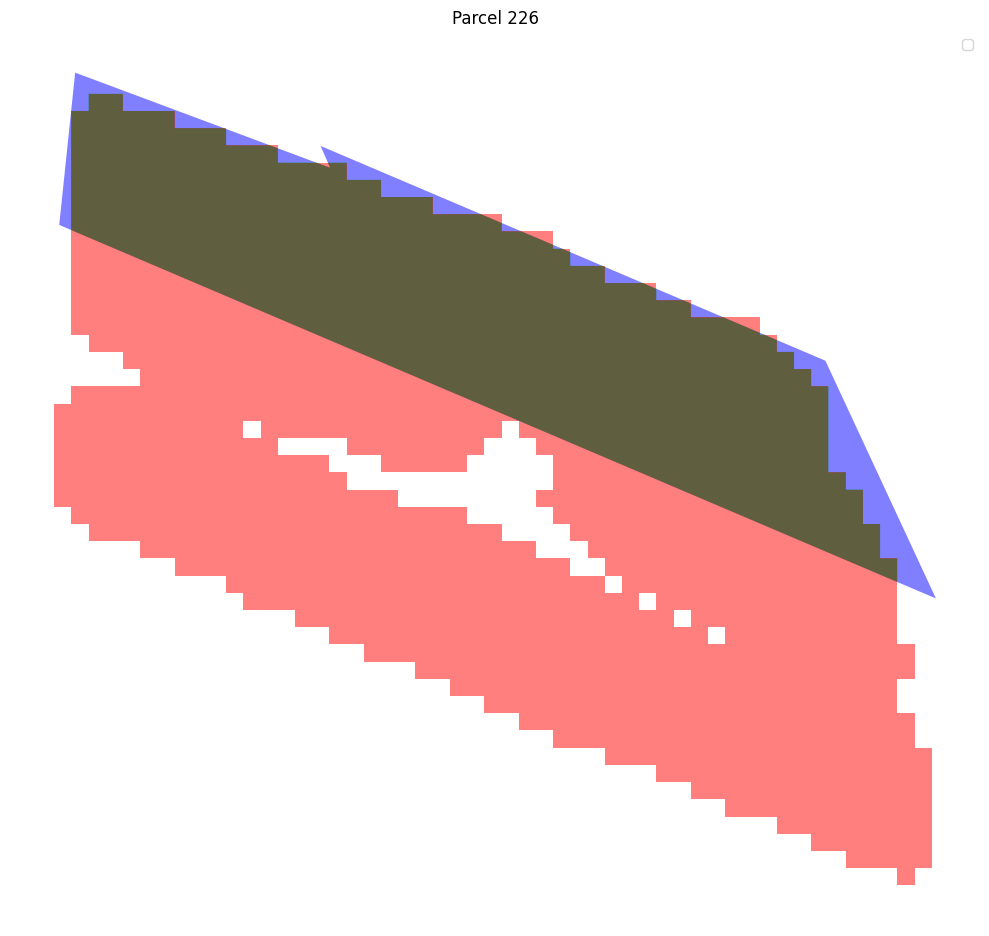

Parcel 226:
True Positive (Correctly predicted): 11415.58 m²
False Negative (Missed): 1121.27 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

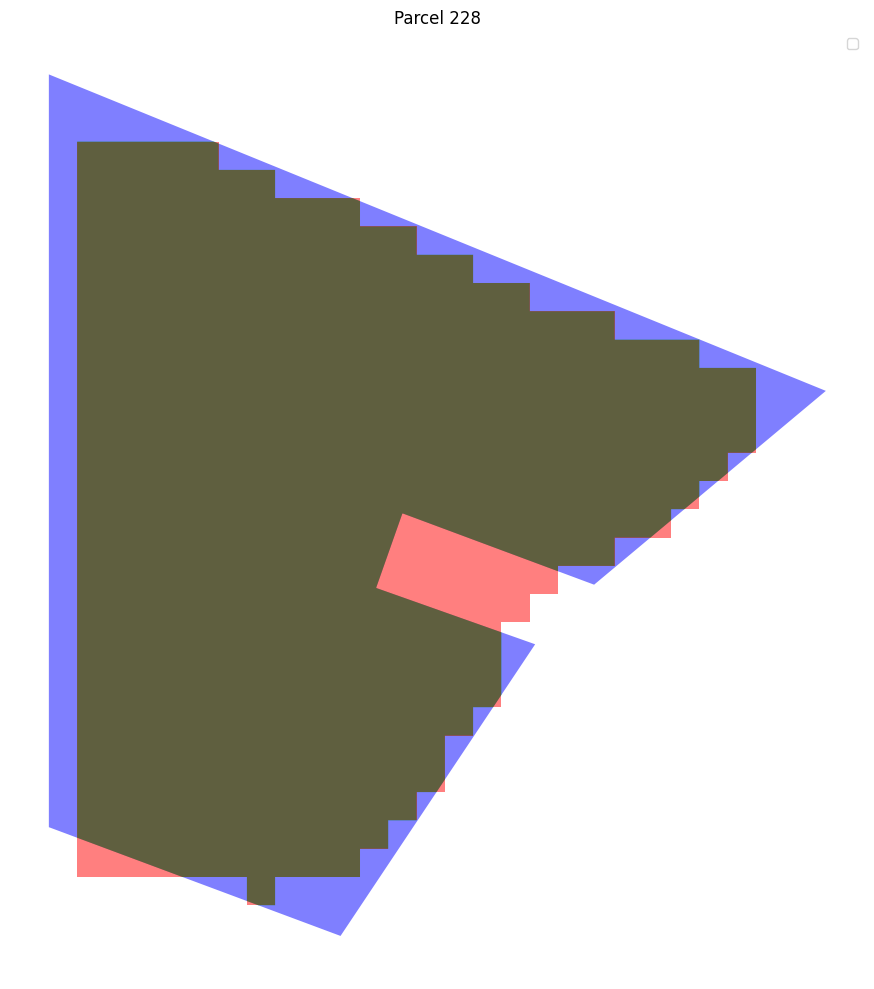

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 228:
True Positive (Correctly predicted): 9895.25 m²
False Negative (Missed): 1506.03 m²
Adjusted IoU: 0.87




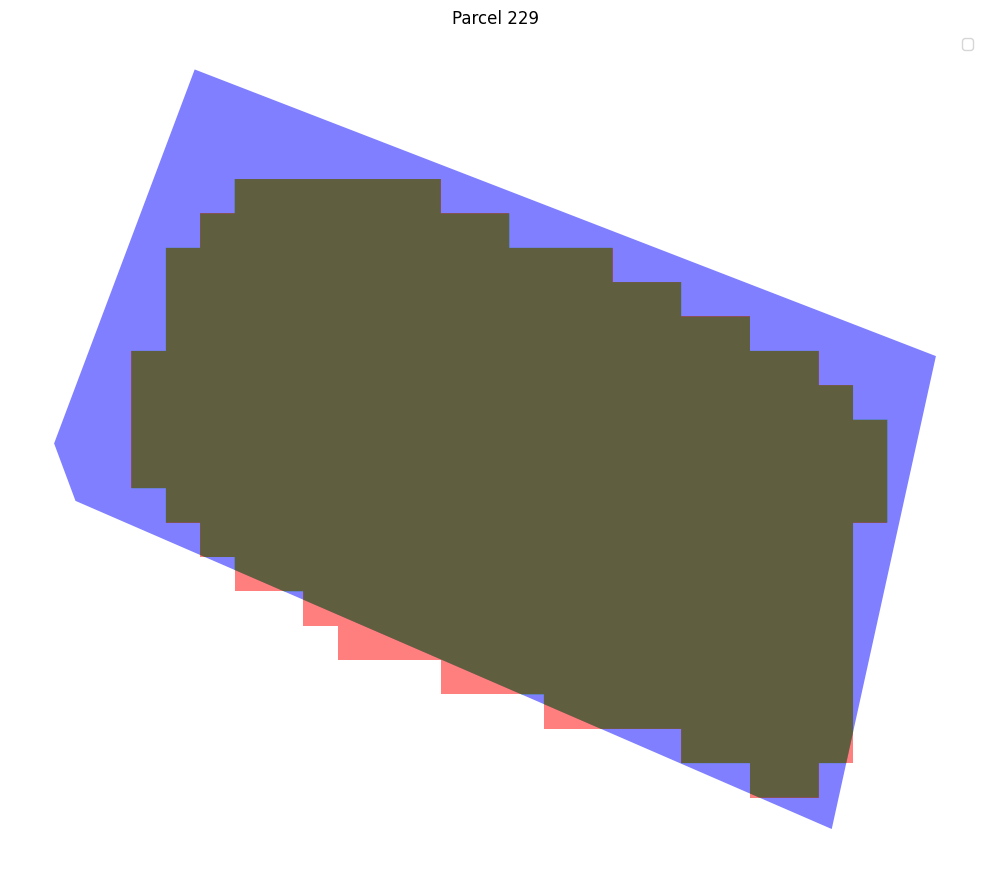

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 229:
True Positive (Correctly predicted): 6426.97 m²
False Negative (Missed): 1637.89 m²
Adjusted IoU: 0.80




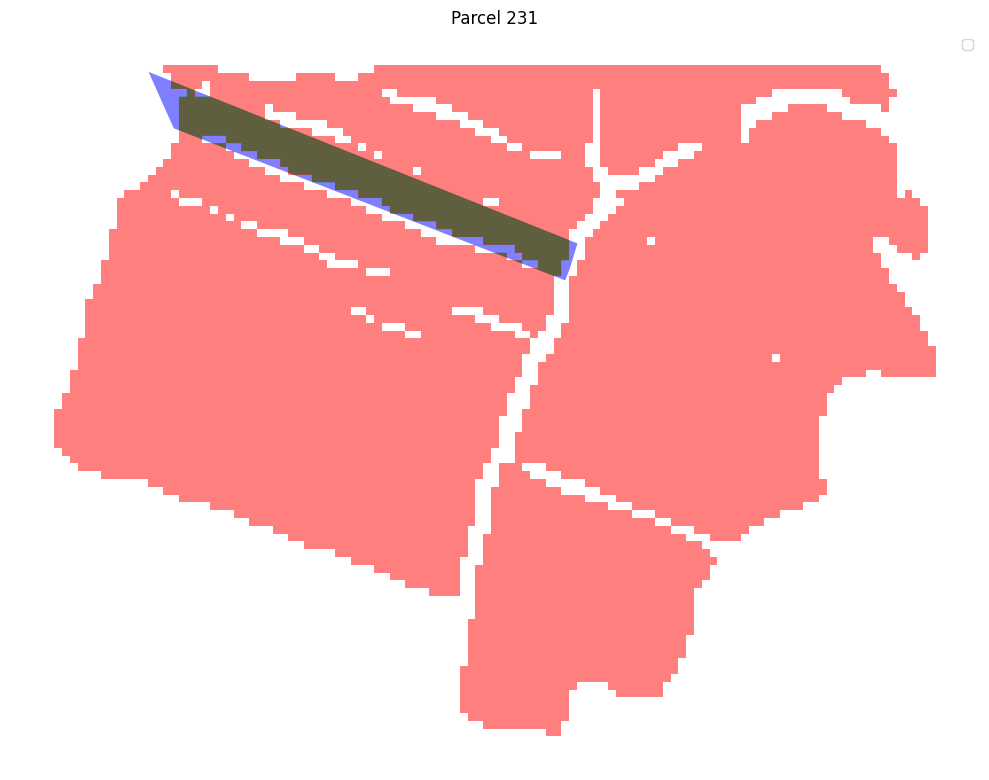

Parcel 231:
True Positive (Correctly predicted): 6174.13 m²
False Negative (Missed): 1256.51 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

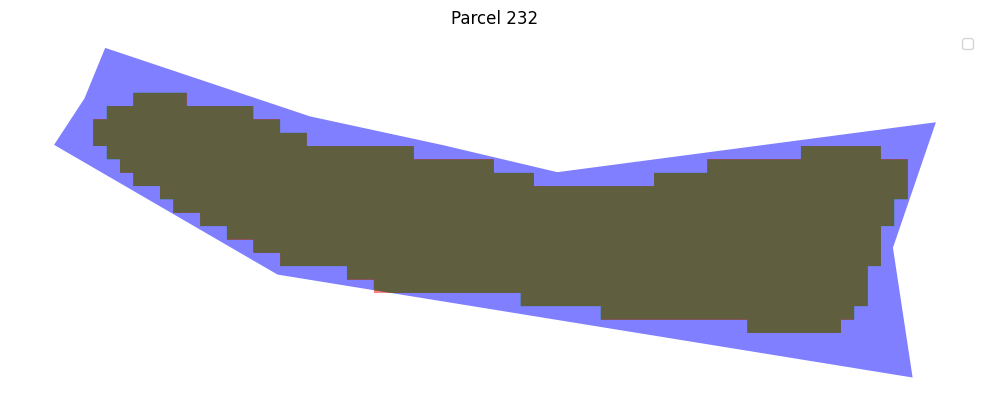

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 232:
True Positive (Correctly predicted): 14921.73 m²
False Negative (Missed): 5054.15 m²
Adjusted IoU: 0.75




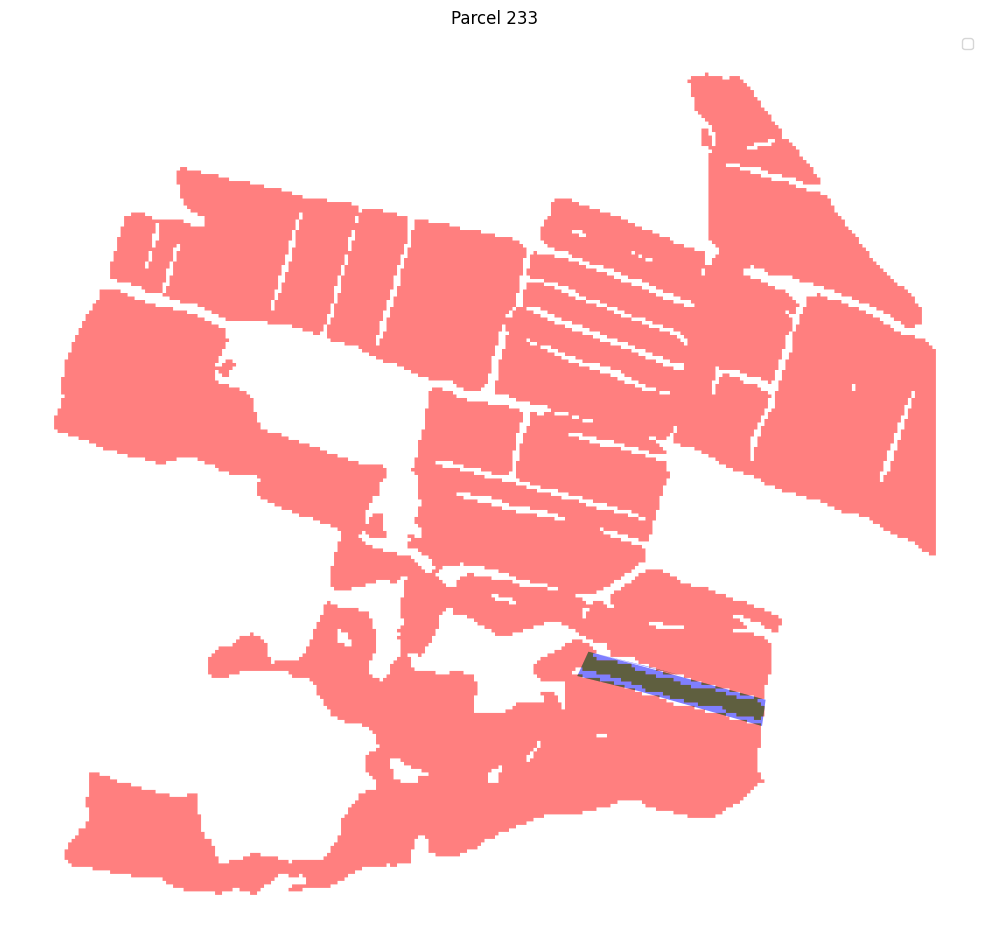

Parcel 233:
True Positive (Correctly predicted): 6478.46 m²
False Negative (Missed): 3359.85 m²
Adjusted IoU: 0.66




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

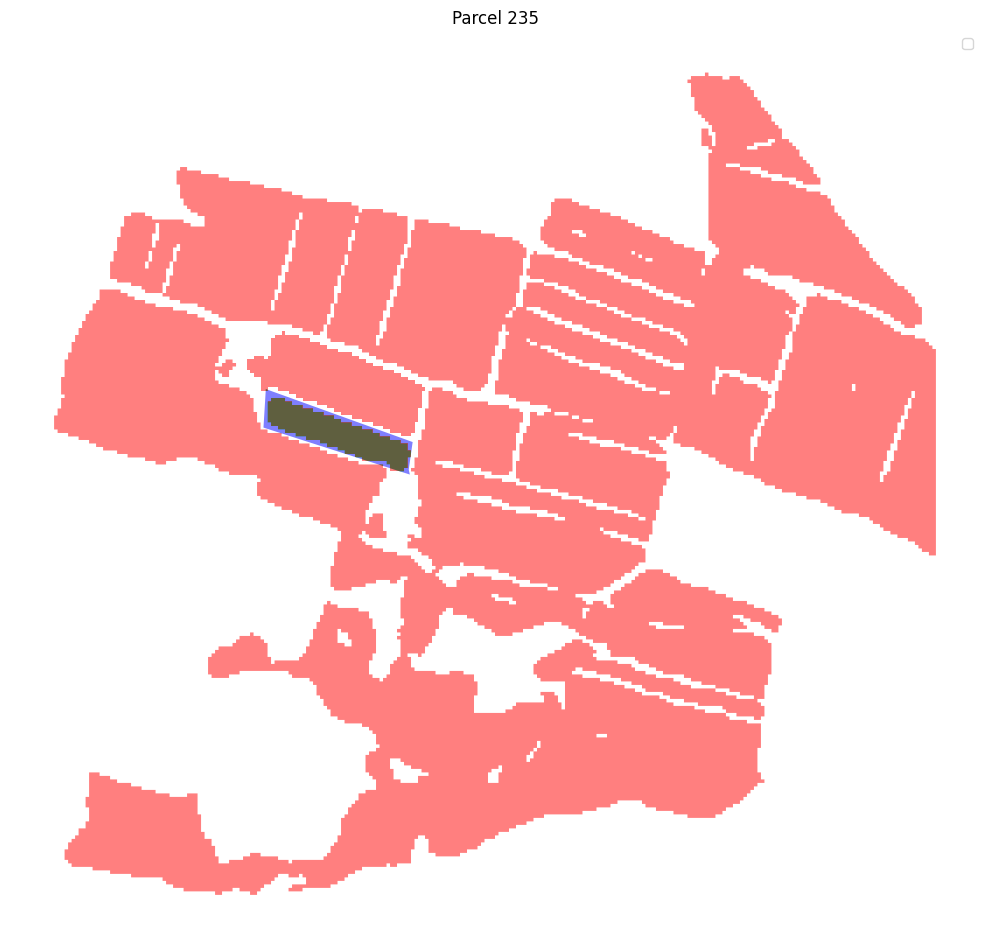

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 235:
True Positive (Correctly predicted): 8440.51 m²
False Negative (Missed): 2397.21 m²
Adjusted IoU: 0.78




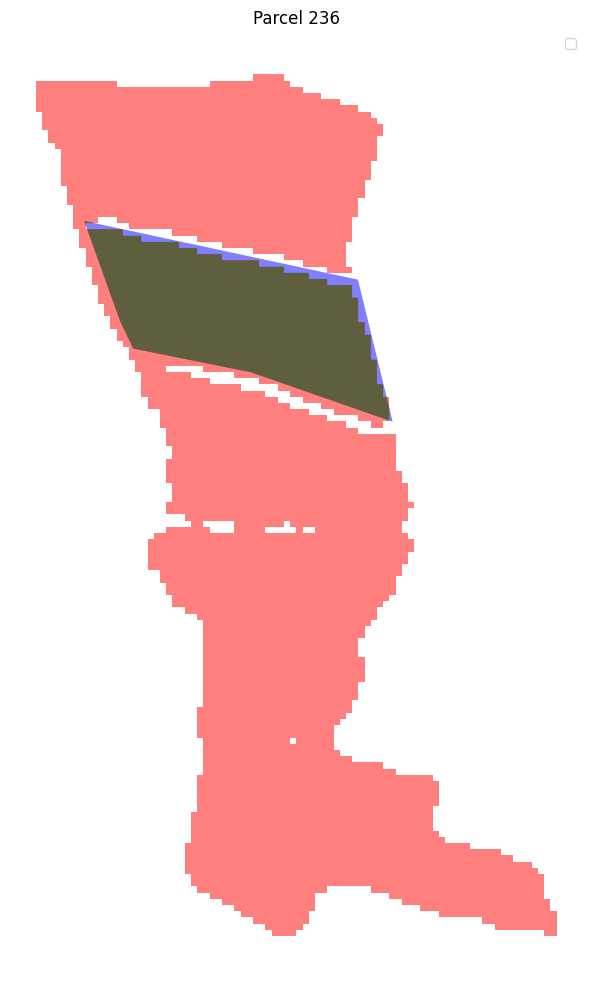

Parcel 236:
True Positive (Correctly predicted): 19515.69 m²
False Negative (Missed): 1393.22 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

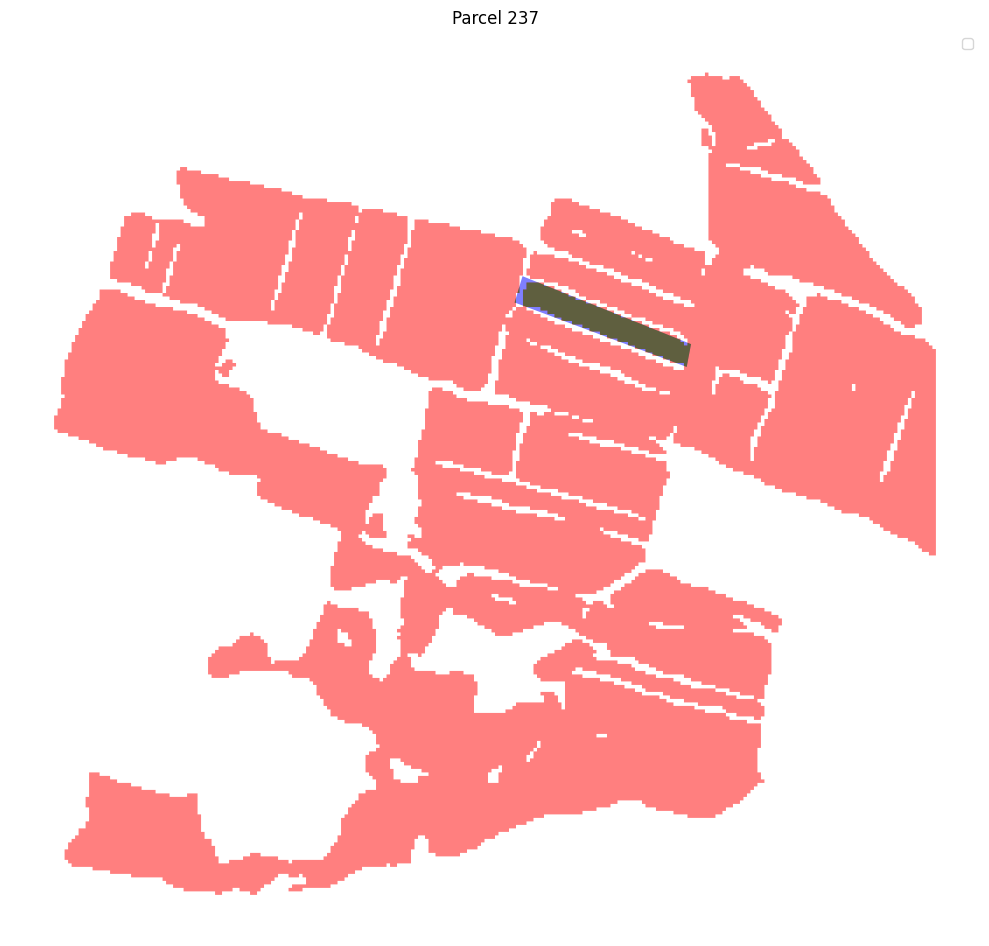

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 237:
True Positive (Correctly predicted): 8500.80 m²
False Negative (Missed): 866.13 m²
Adjusted IoU: 0.91




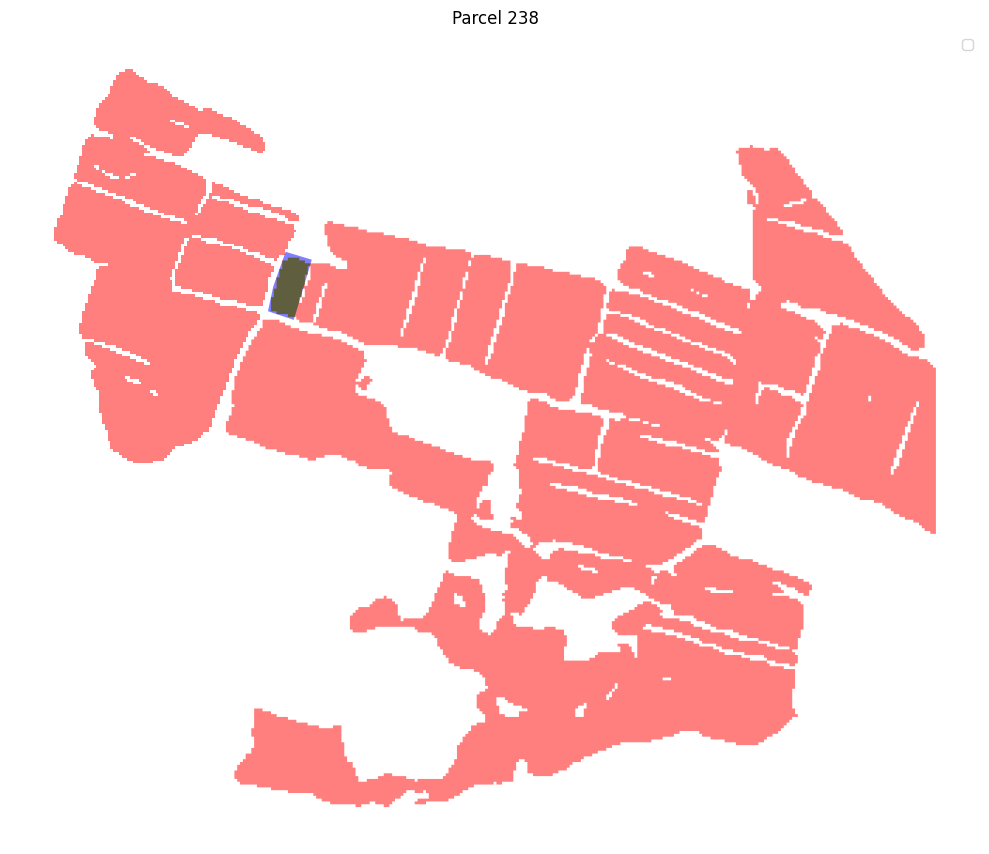

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 238:
True Positive (Correctly predicted): 4660.01 m²
False Negative (Missed): 882.66 m²
Adjusted IoU: 0.84




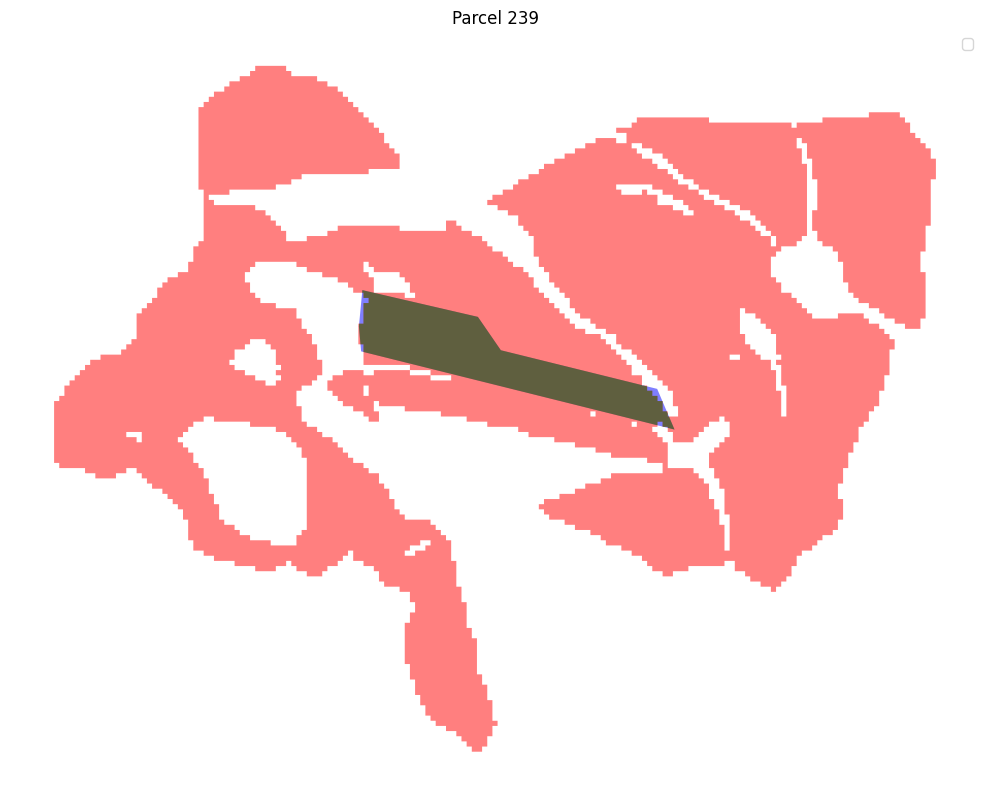

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 239:
True Positive (Correctly predicted): 13344.93 m²
False Negative (Missed): 251.59 m²
Adjusted IoU: 0.98




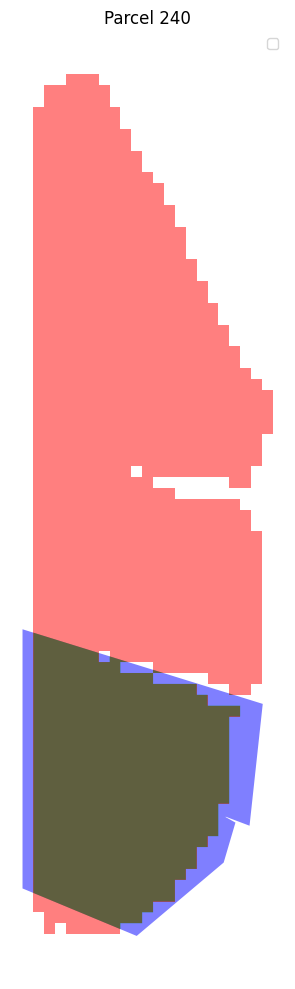

Parcel 240:
True Positive (Correctly predicted): 9331.55 m²
False Negative (Missed): 2032.47 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

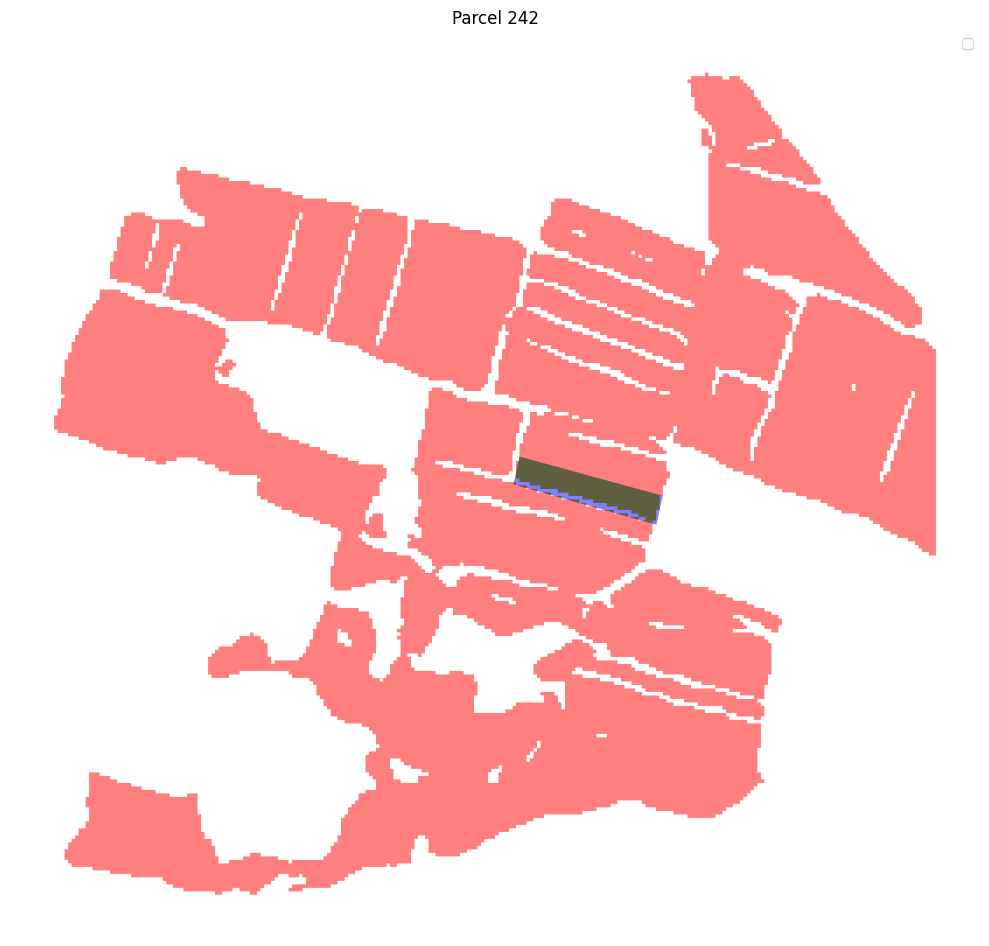

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 242:
True Positive (Correctly predicted): 7358.37 m²
False Negative (Missed): 1403.79 m²
Adjusted IoU: 0.84




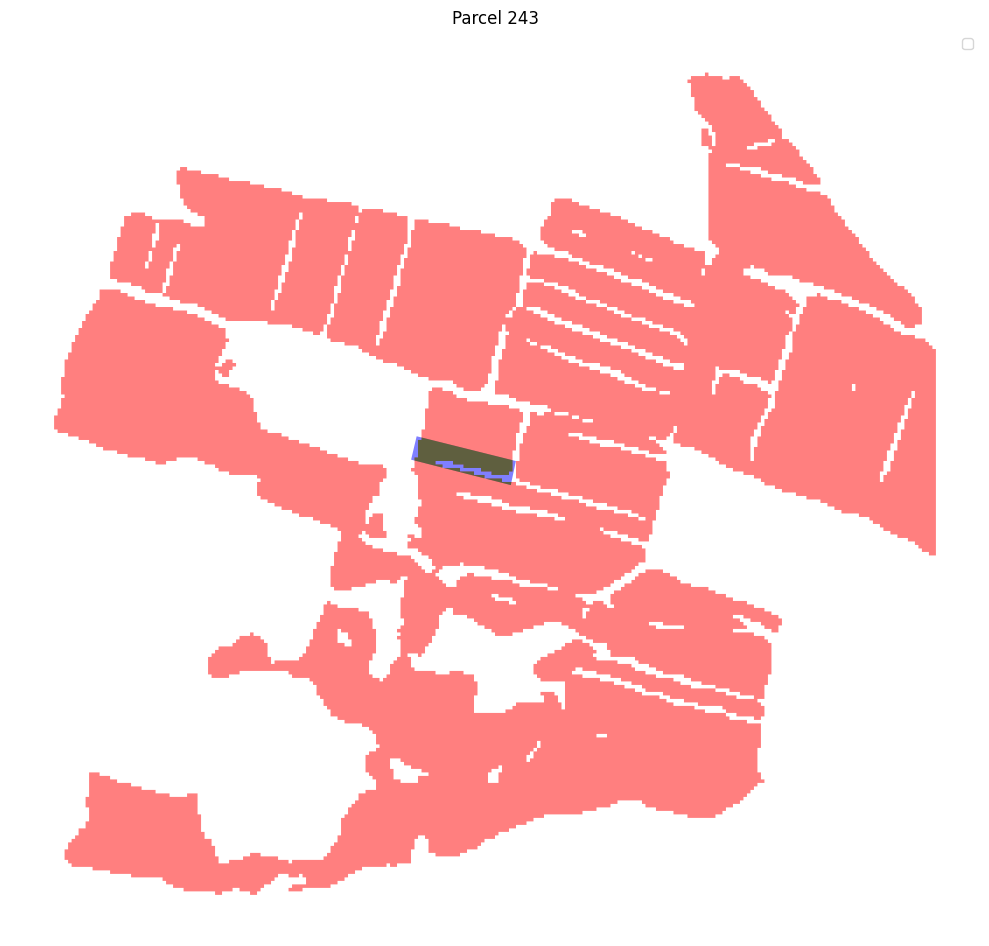

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 243:
True Positive (Correctly predicted): 3977.86 m²
False Negative (Missed): 1107.58 m²
Adjusted IoU: 0.78




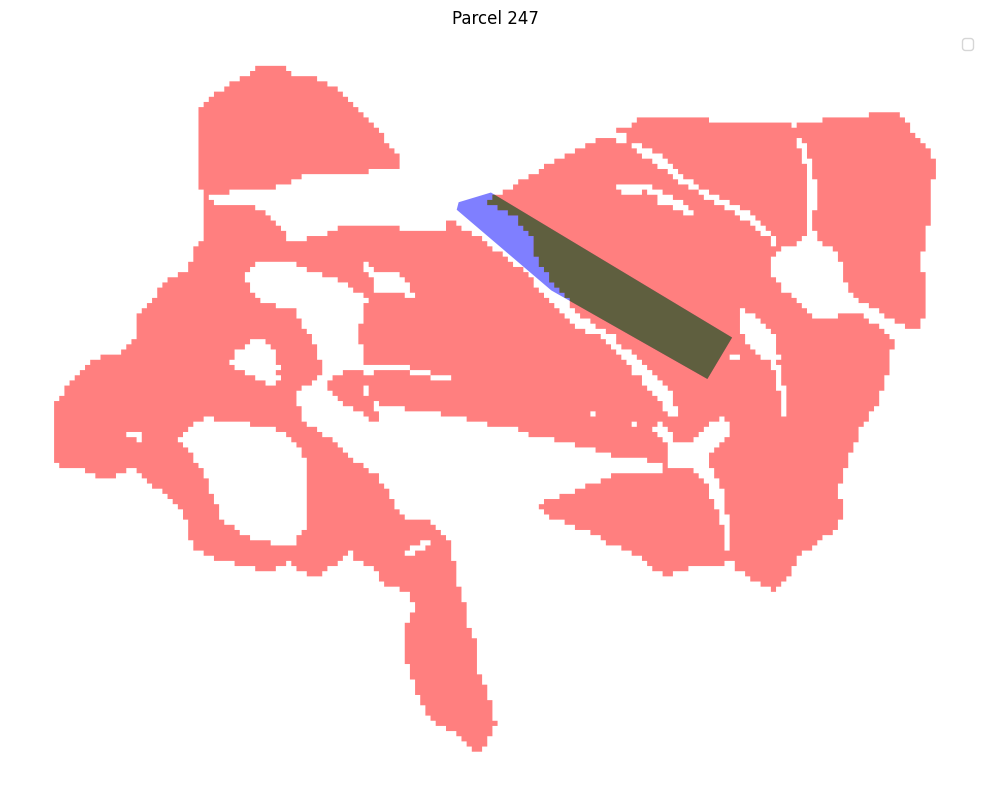

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 247:
True Positive (Correctly predicted): 10469.20 m²
False Negative (Missed): 2749.53 m²
Adjusted IoU: 0.79




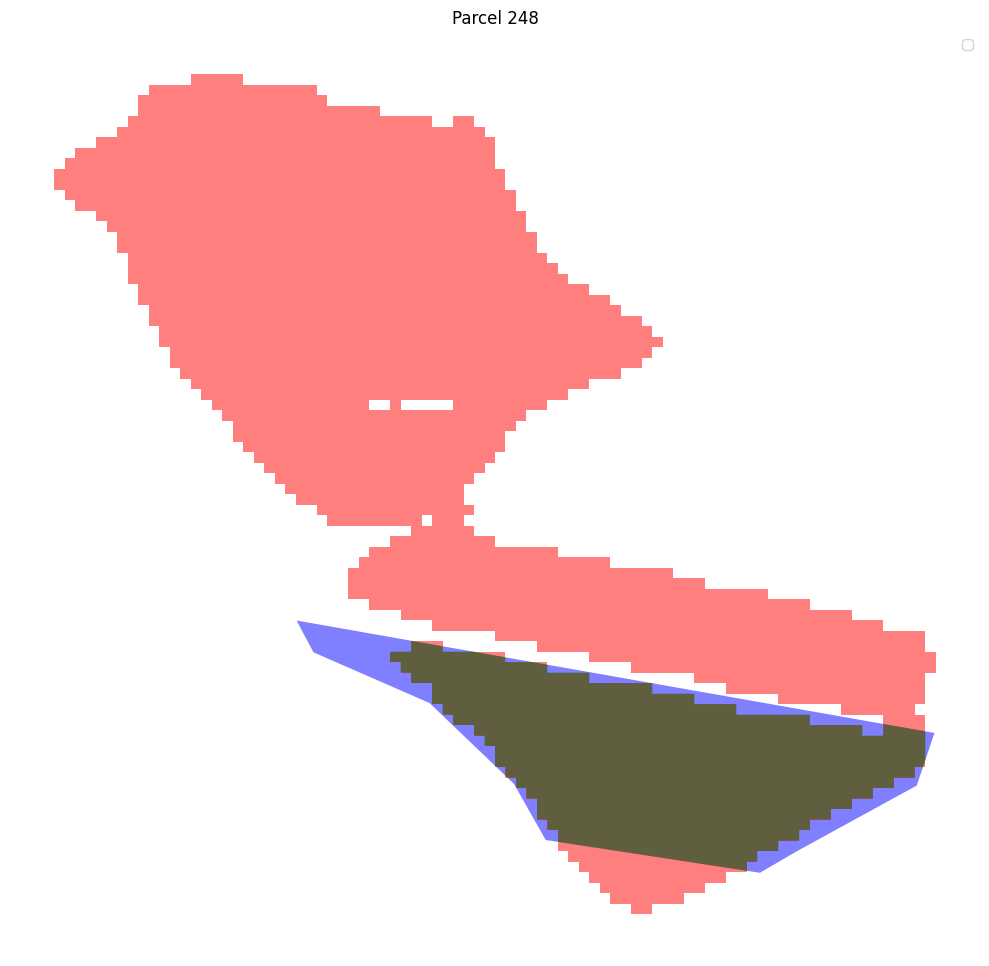

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 248:
True Positive (Correctly predicted): 14006.68 m²
False Negative (Missed): 2581.71 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


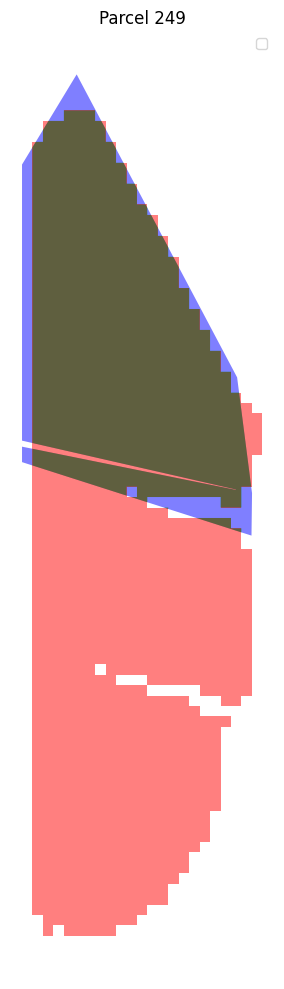

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 249:
True Positive (Correctly predicted): 13170.48 m²
False Negative (Missed): 1665.66 m²
Adjusted IoU: 0.89




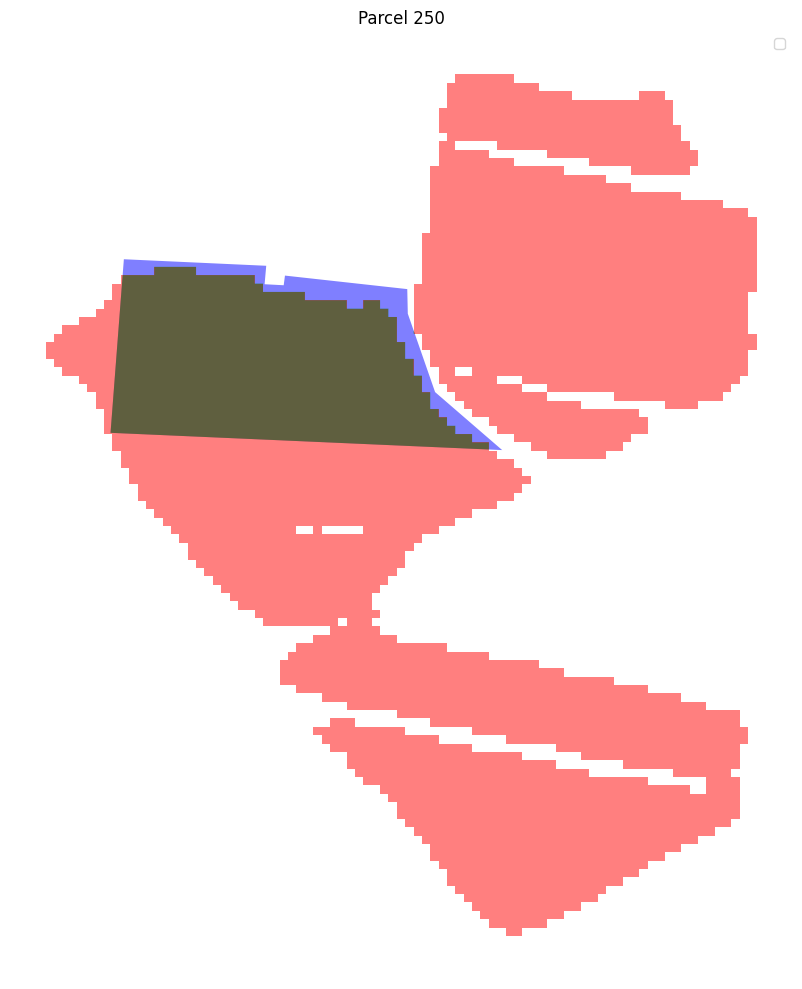

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 250:
True Positive (Correctly predicted): 16676.52 m²
False Negative (Missed): 2258.07 m²
Adjusted IoU: 0.88




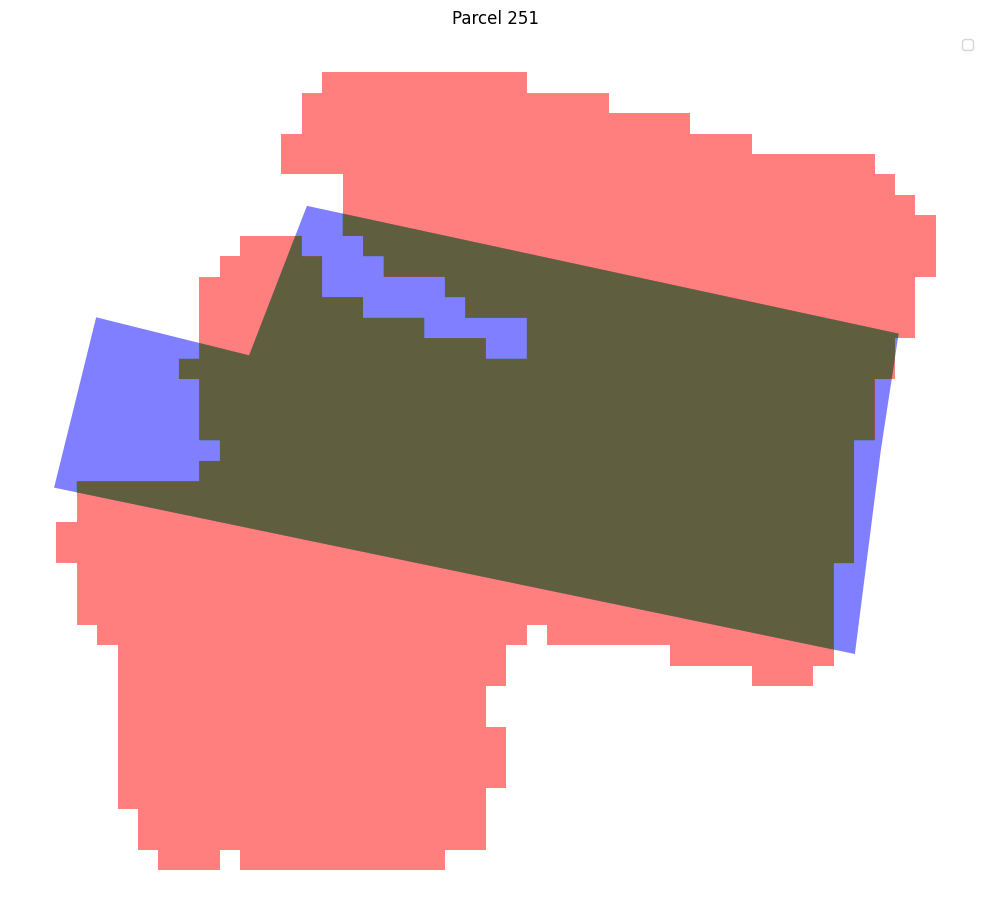

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 251:
True Positive (Correctly predicted): 11839.90 m²
False Negative (Missed): 2147.37 m²
Adjusted IoU: 0.85




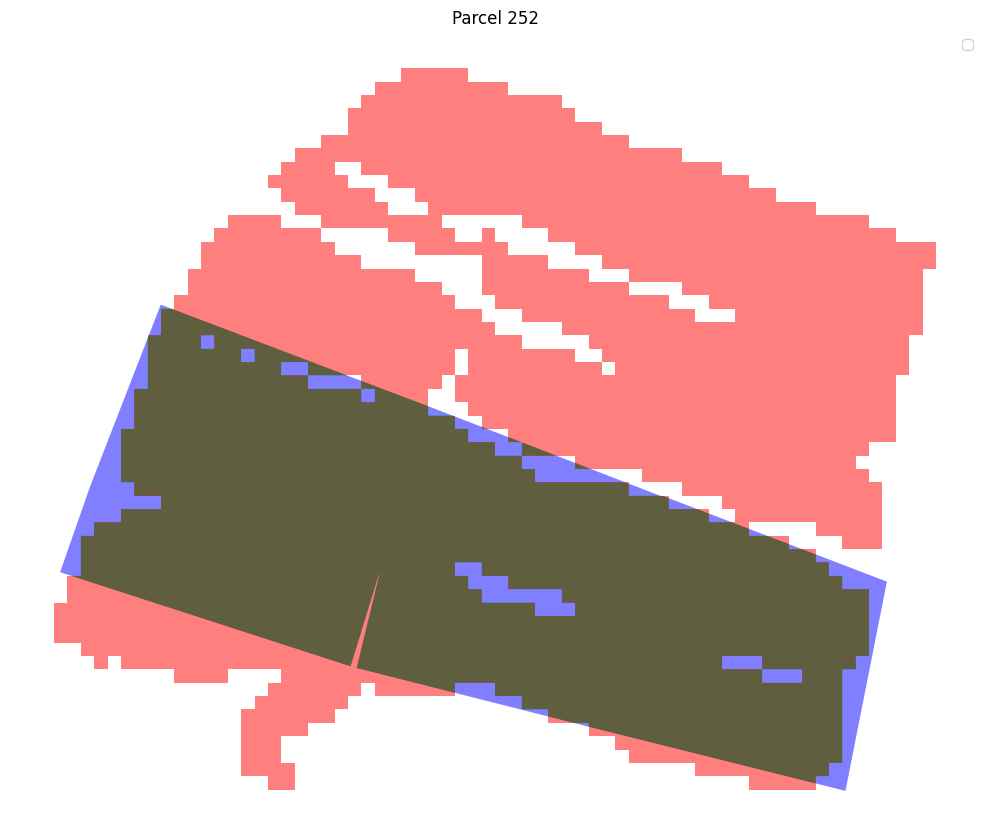

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 252:
True Positive (Correctly predicted): 25813.21 m²
False Negative (Missed): 2633.20 m²
Adjusted IoU: 0.91




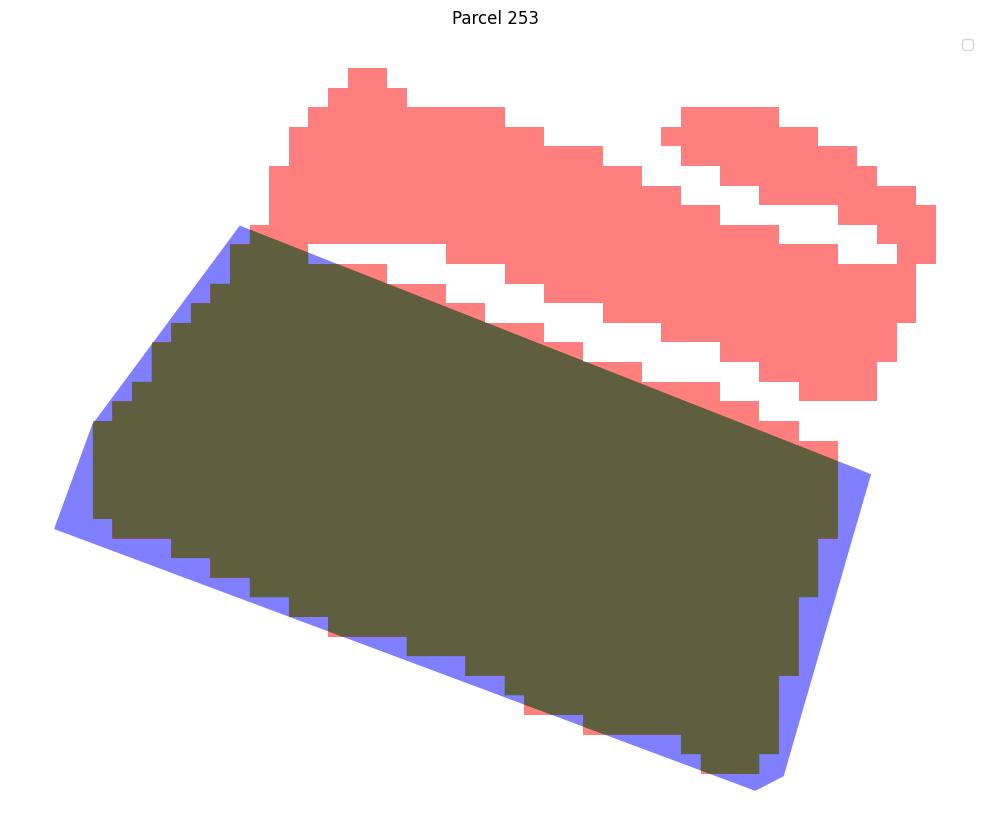

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 253:
True Positive (Correctly predicted): 15012.44 m²
False Negative (Missed): 1413.17 m²
Adjusted IoU: 0.91




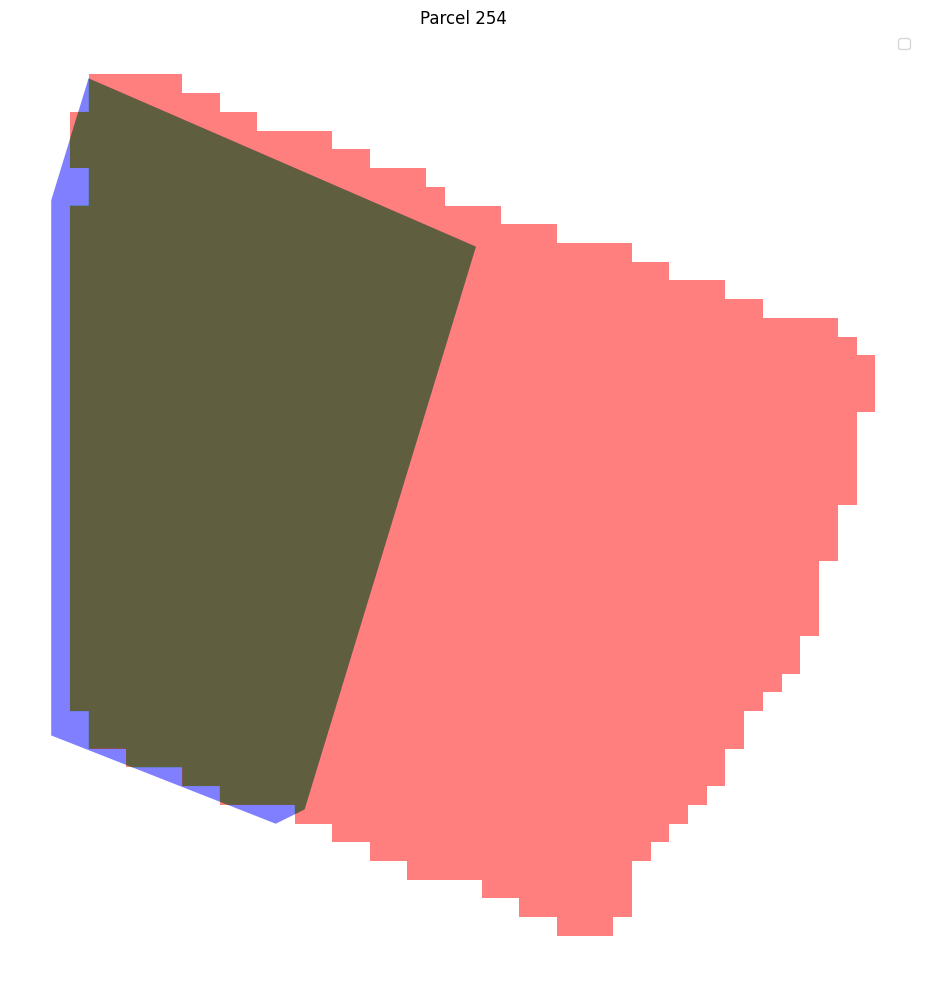

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 254:
True Positive (Correctly predicted): 14743.31 m²
False Negative (Missed): 1001.88 m²
Adjusted IoU: 0.94




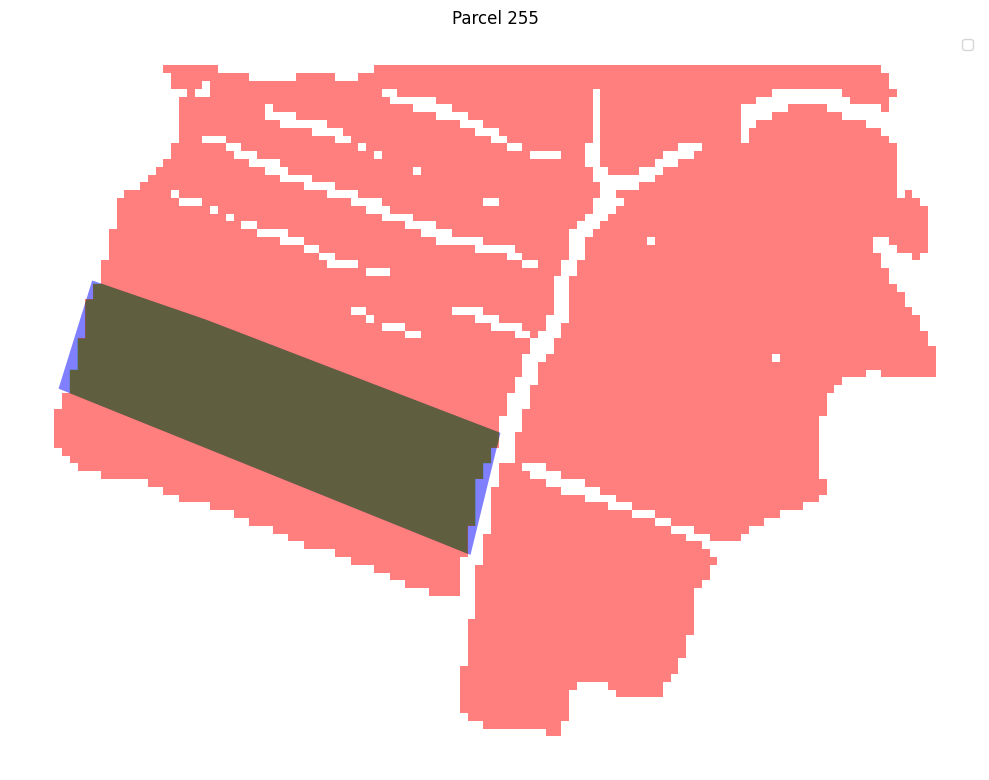

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 255:
True Positive (Correctly predicted): 21132.01 m²
False Negative (Missed): 599.11 m²
Adjusted IoU: 0.97




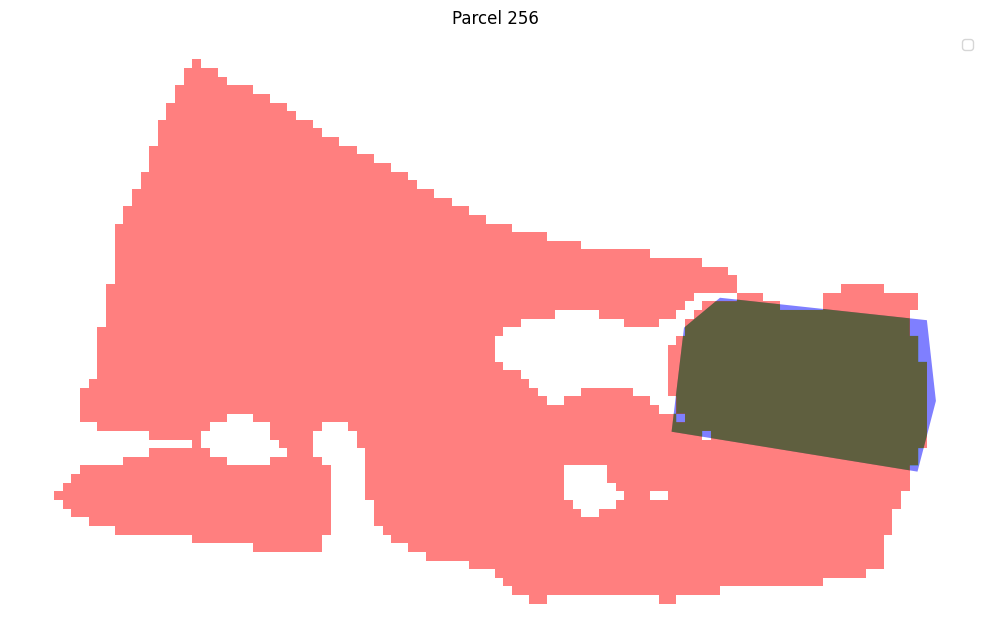

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 256:
True Positive (Correctly predicted): 11537.42 m²
False Negative (Missed): 497.38 m²
Adjusted IoU: 0.96




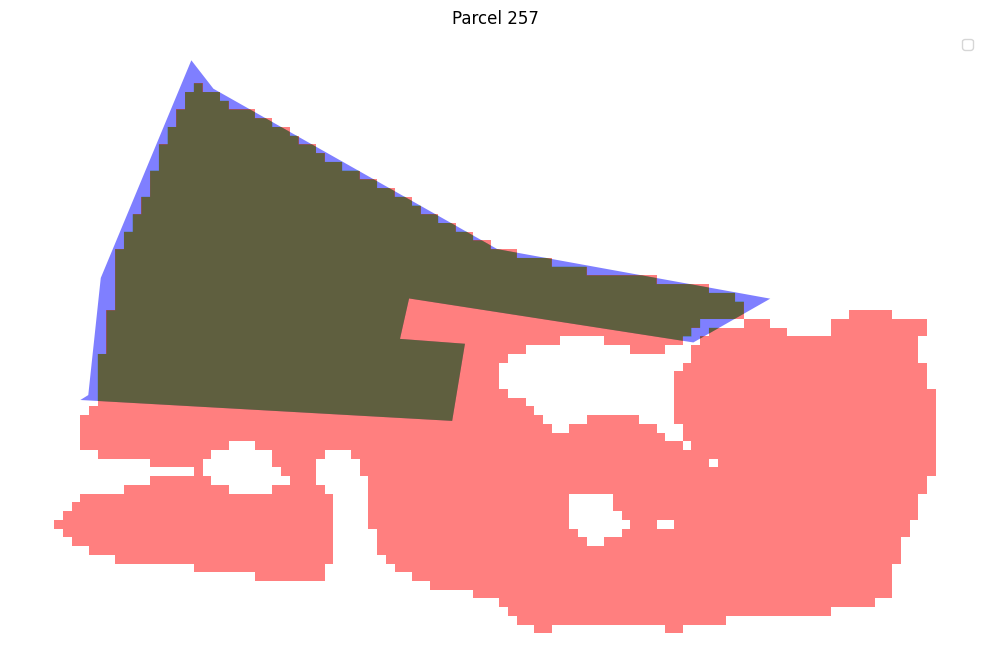

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 257:
True Positive (Correctly predicted): 33135.64 m²
False Negative (Missed): 1936.59 m²
Adjusted IoU: 0.94




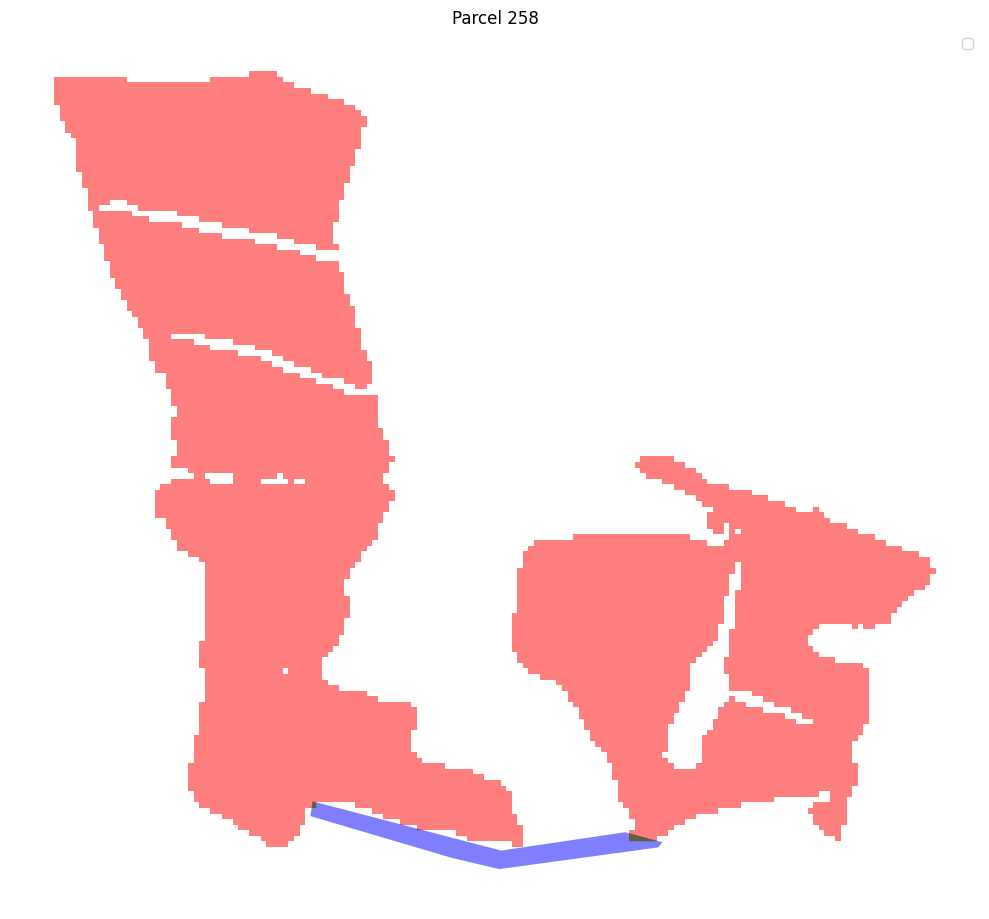

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 258:
True Positive (Correctly predicted): 125.75 m²
False Negative (Missed): 4893.46 m²
Adjusted IoU: 0.03




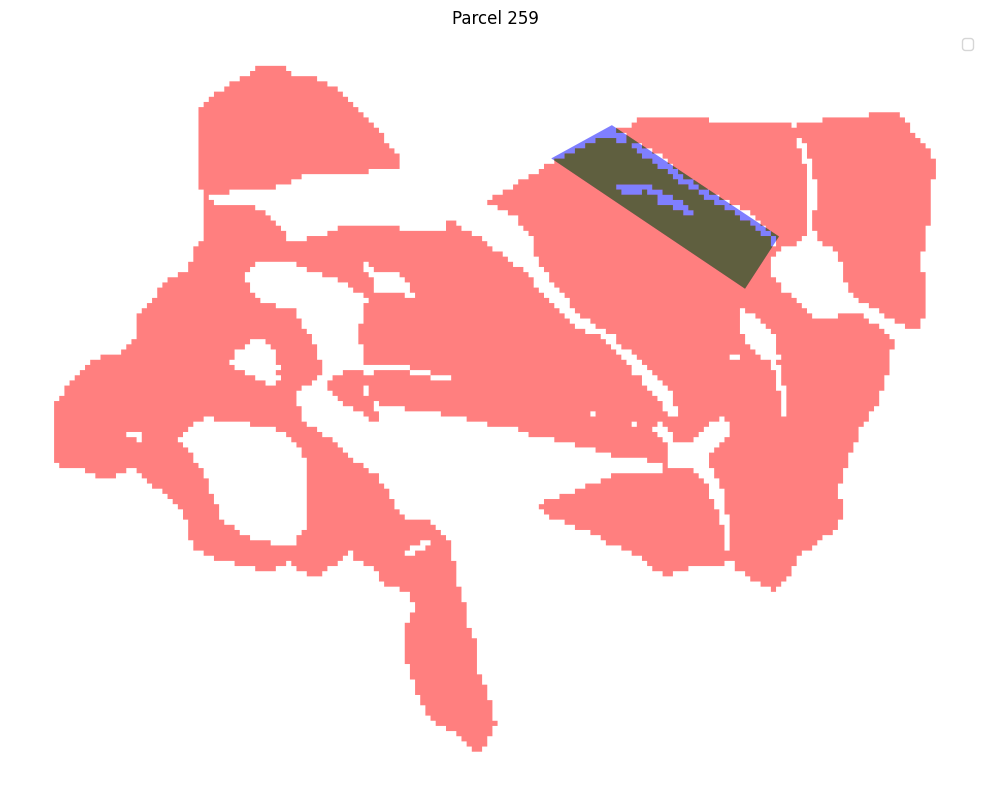

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 259:
True Positive (Correctly predicted): 10381.47 m²
False Negative (Missed): 2240.57 m²
Adjusted IoU: 0.82




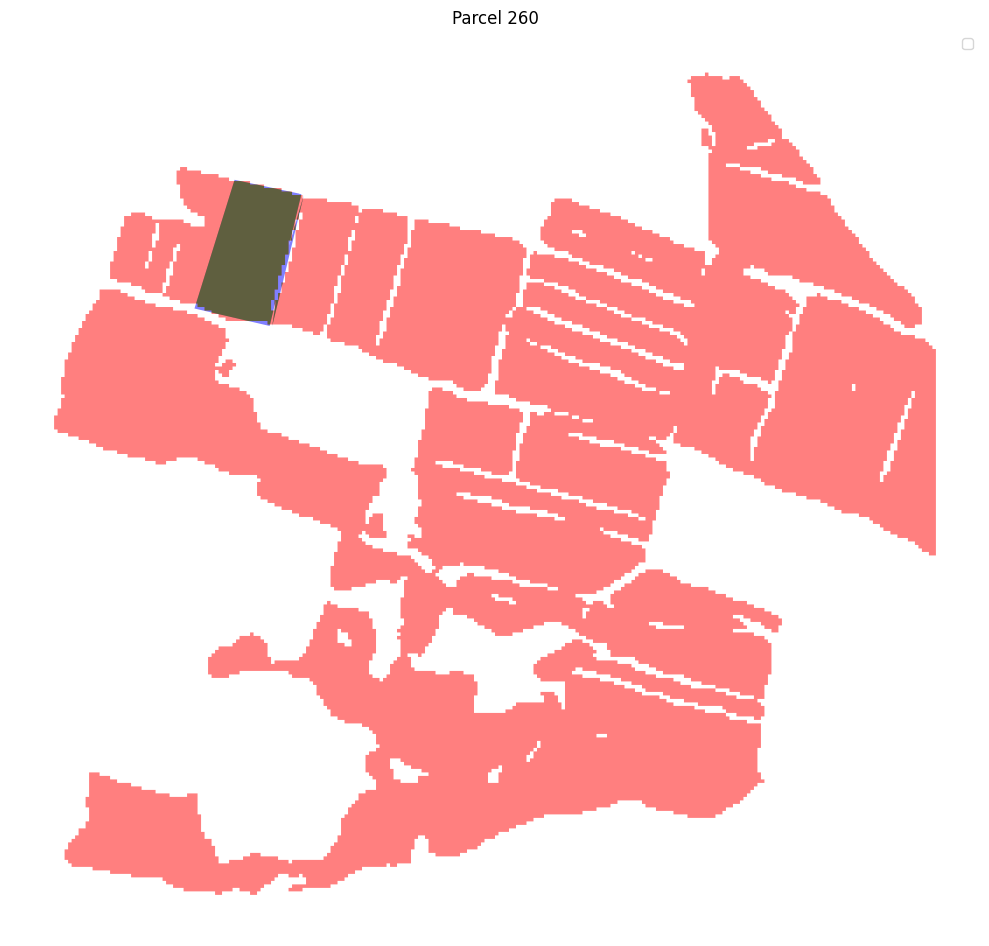

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 260:
True Positive (Correctly predicted): 19694.78 m²
False Negative (Missed): 847.37 m²
Adjusted IoU: 0.96




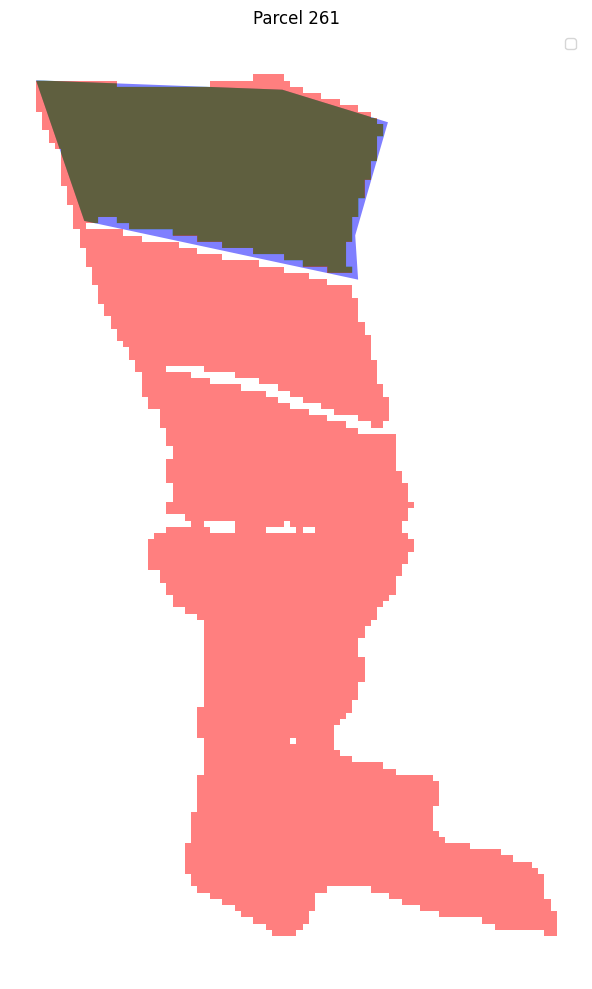

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 261:
True Positive (Correctly predicted): 30156.48 m²
False Negative (Missed): 1583.93 m²
Adjusted IoU: 0.95




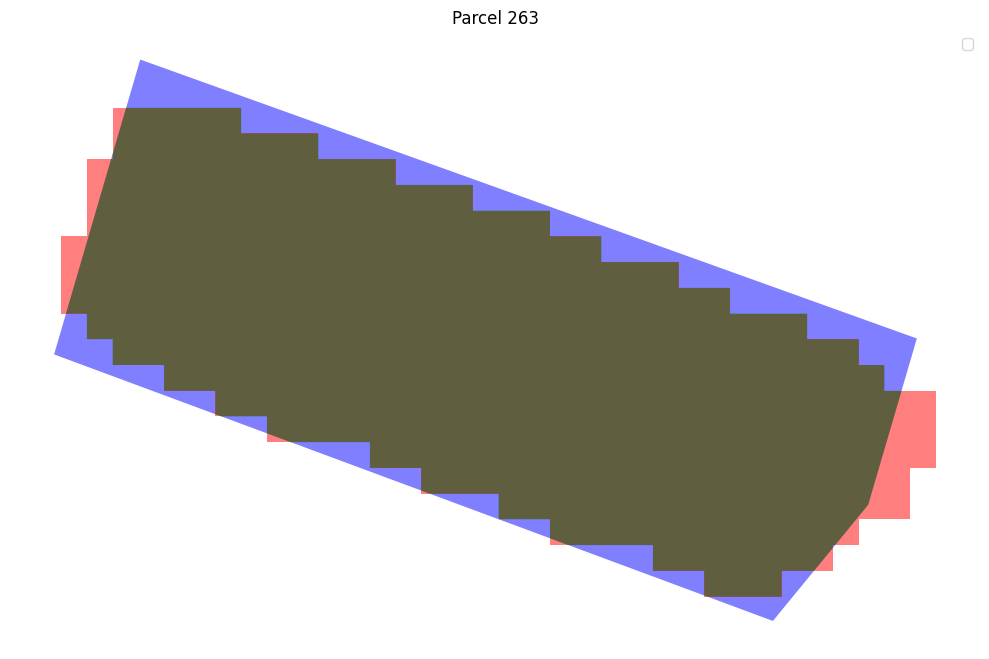

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 263:
True Positive (Correctly predicted): 8339.05 m²
False Negative (Missed): 1188.85 m²
Adjusted IoU: 0.88




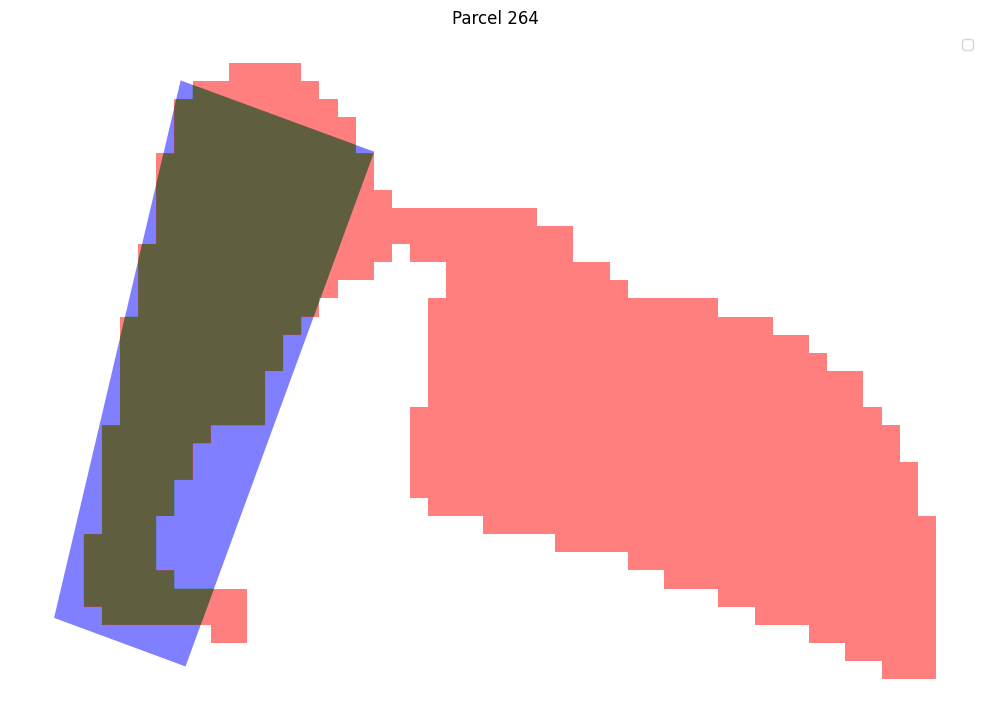

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 264:
True Positive (Correctly predicted): 5578.75 m²
False Negative (Missed): 1639.98 m²
Adjusted IoU: 0.77




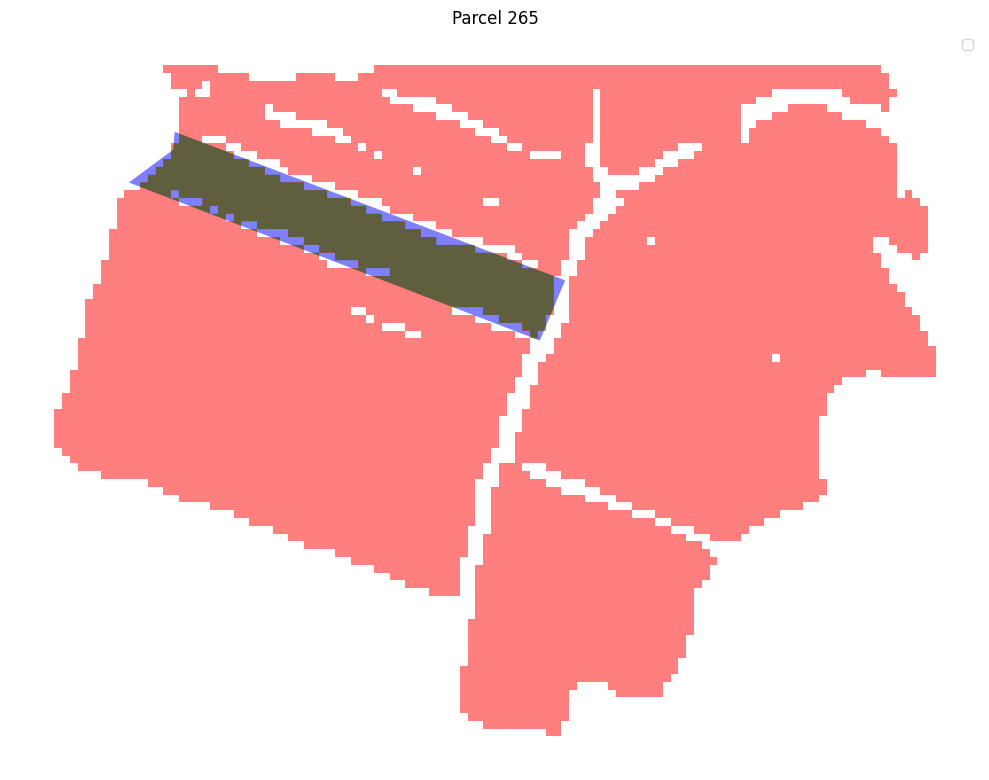

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 265:
True Positive (Correctly predicted): 9647.58 m²
False Negative (Missed): 1552.86 m²
Adjusted IoU: 0.86




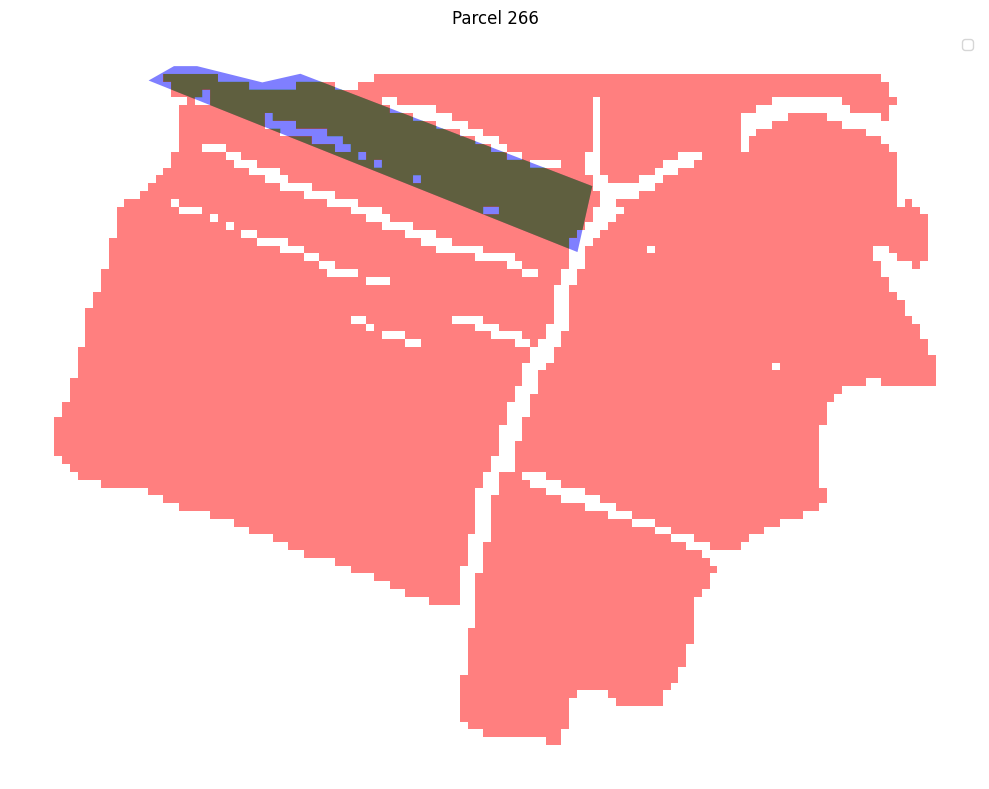

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 266:
True Positive (Correctly predicted): 9156.79 m²
False Negative (Missed): 1279.82 m²
Adjusted IoU: 0.88




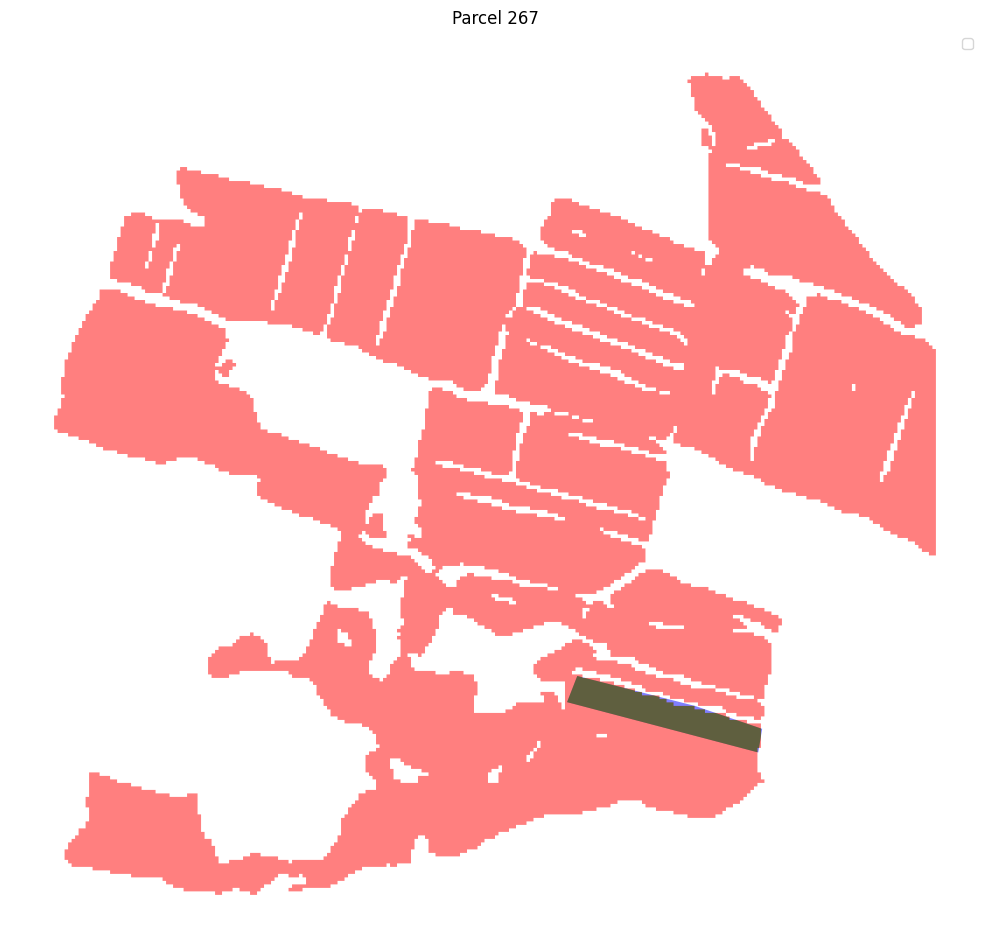

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 267:
True Positive (Correctly predicted): 10660.56 m²
False Negative (Missed): 334.96 m²
Adjusted IoU: 0.97




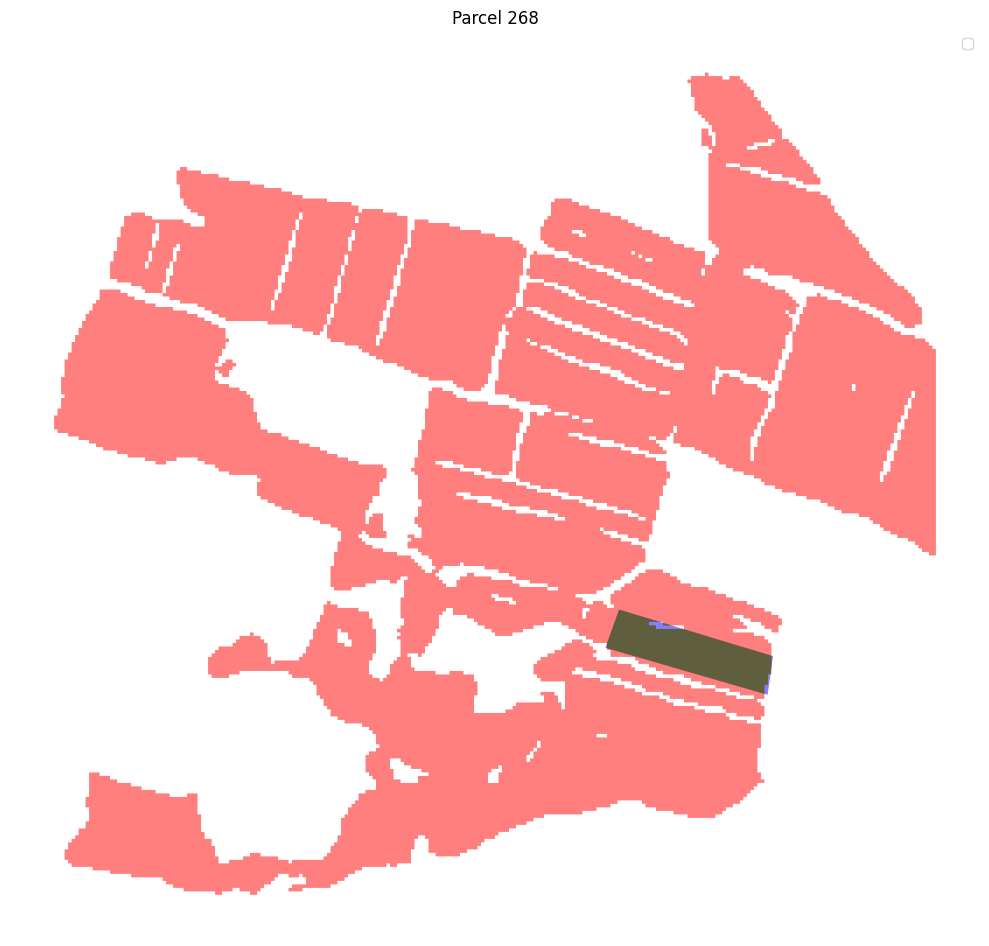

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 268:
True Positive (Correctly predicted): 12916.73 m²
False Negative (Missed): 387.56 m²
Adjusted IoU: 0.97




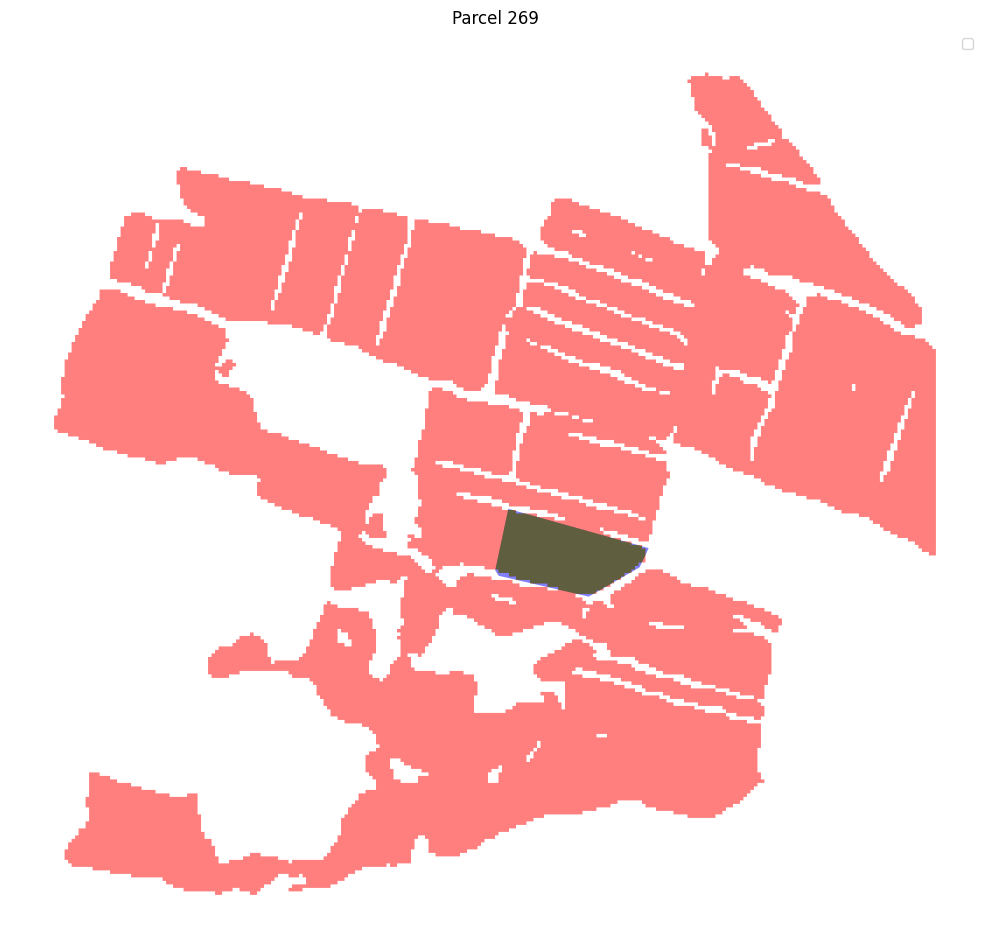

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 269:
True Positive (Correctly predicted): 16237.87 m²
False Negative (Missed): 492.25 m²
Adjusted IoU: 0.97




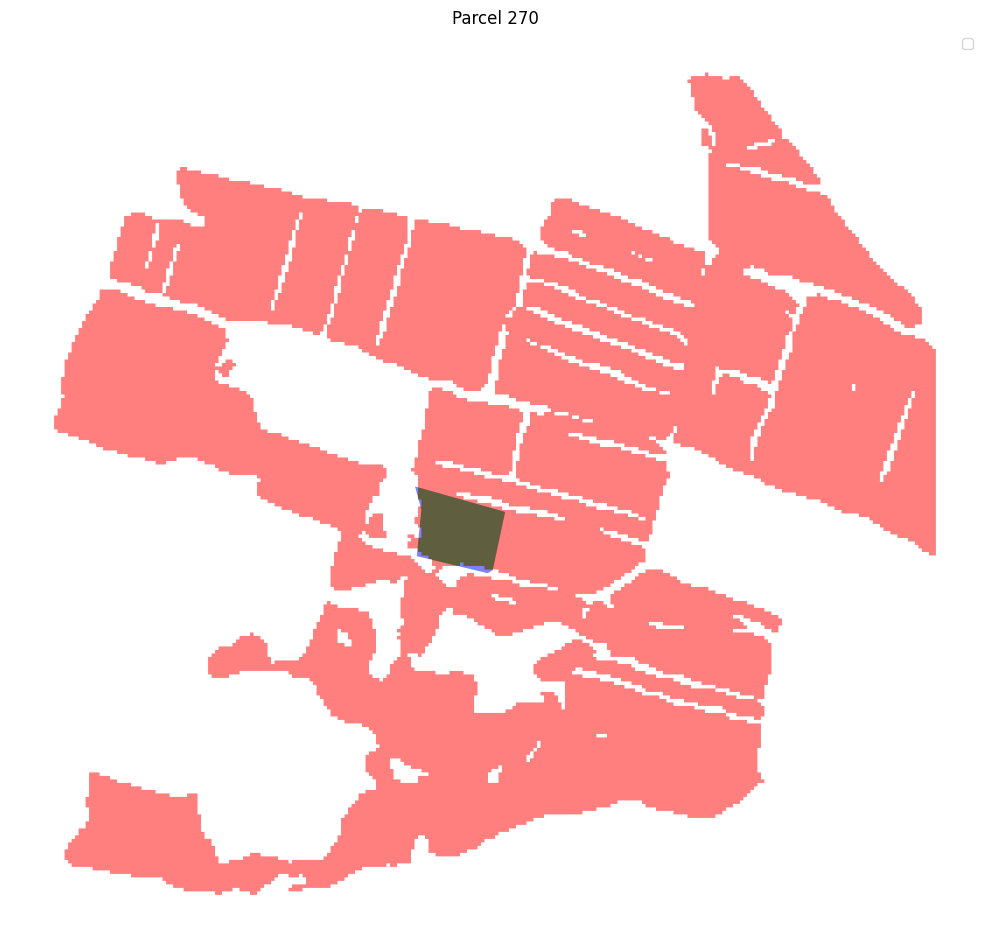

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 270:
True Positive (Correctly predicted): 10492.49 m²
False Negative (Missed): 446.58 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


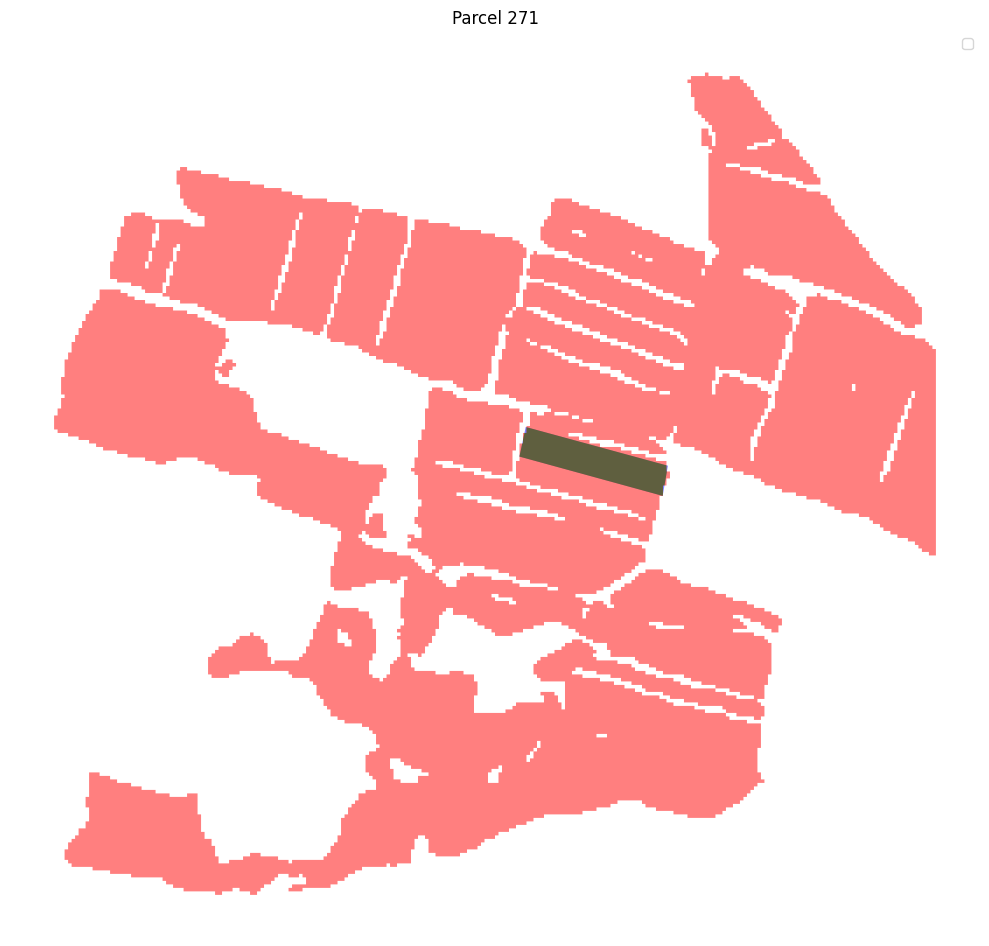

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 271:
True Positive (Correctly predicted): 9115.19 m²
False Negative (Missed): 44.41 m²
Adjusted IoU: 1.00




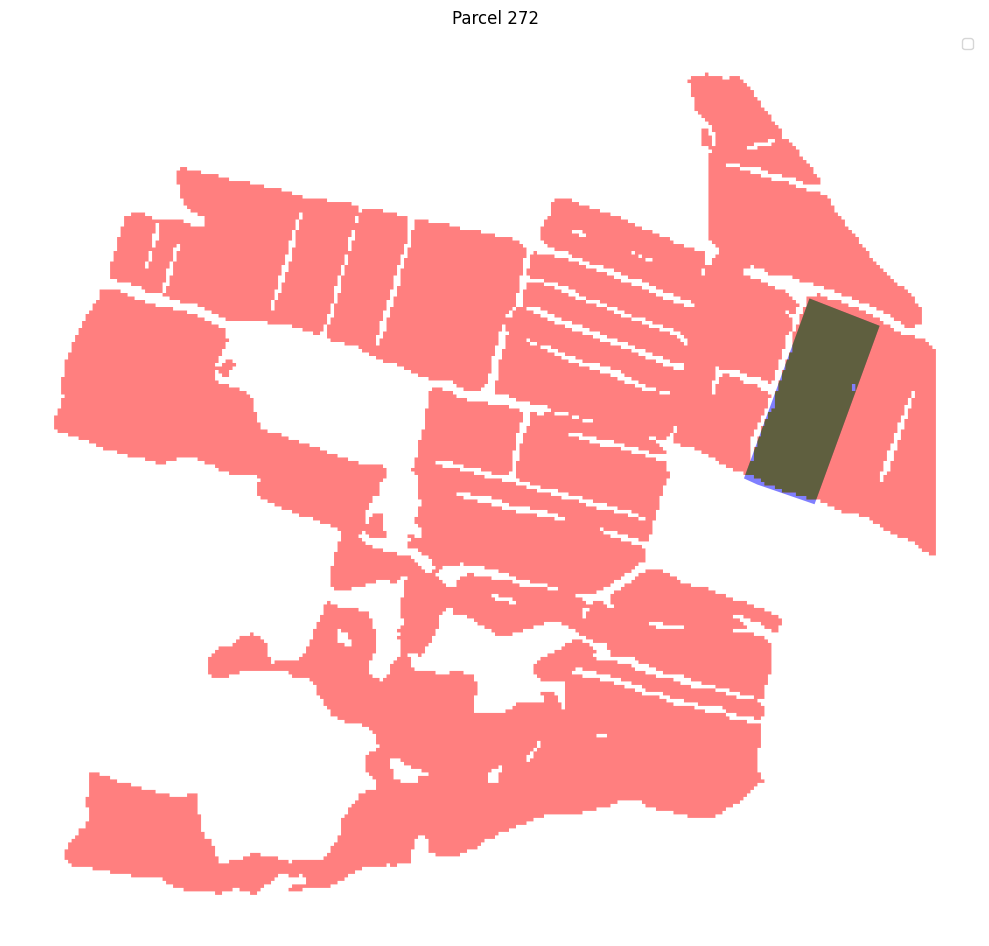

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 272:
True Positive (Correctly predicted): 28491.95 m²
False Negative (Missed): 871.27 m²
Adjusted IoU: 0.97




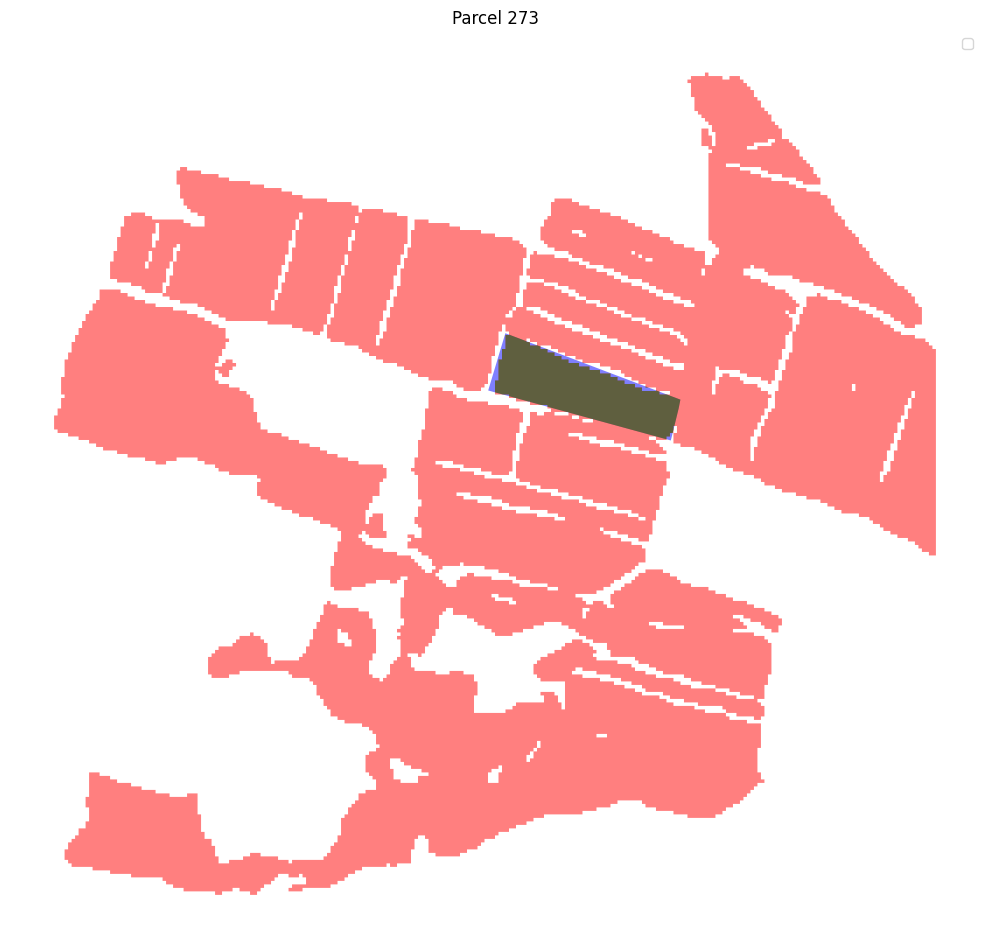

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 273:
True Positive (Correctly predicted): 18226.29 m²
False Negative (Missed): 1277.26 m²
Adjusted IoU: 0.93




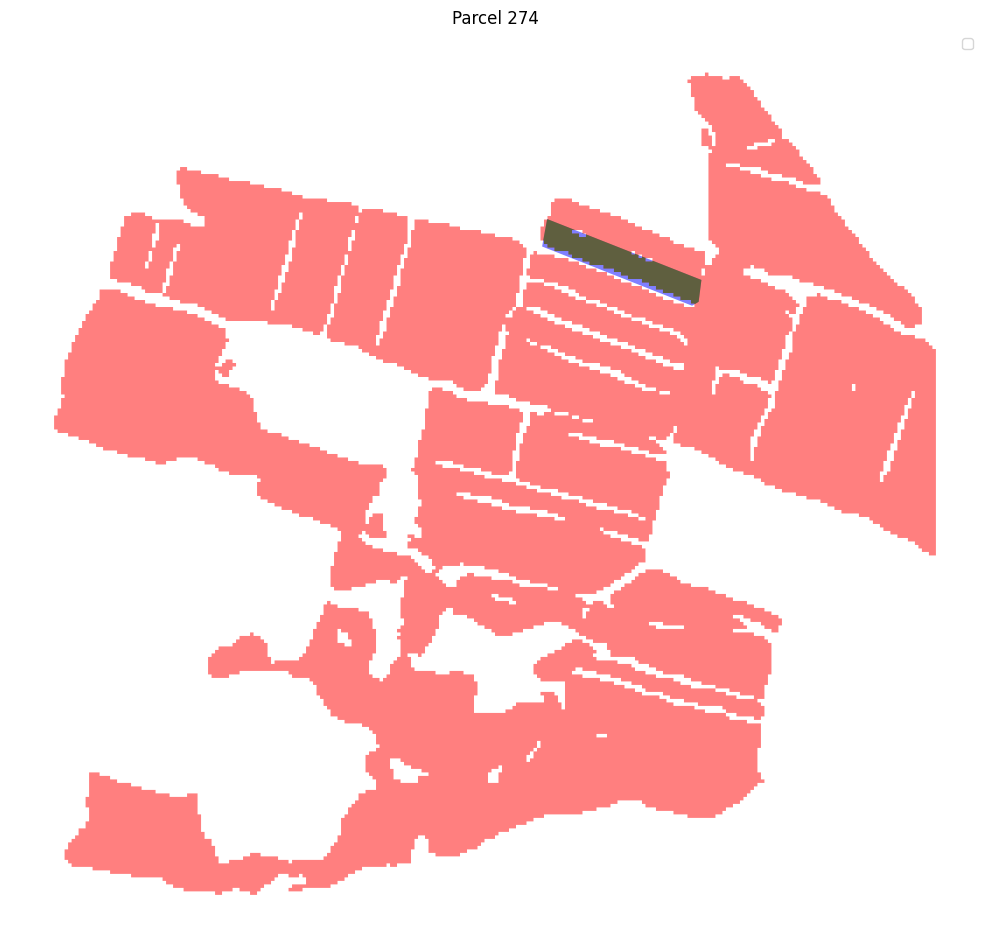

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 274:
True Positive (Correctly predicted): 8072.39 m²
False Negative (Missed): 1214.07 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


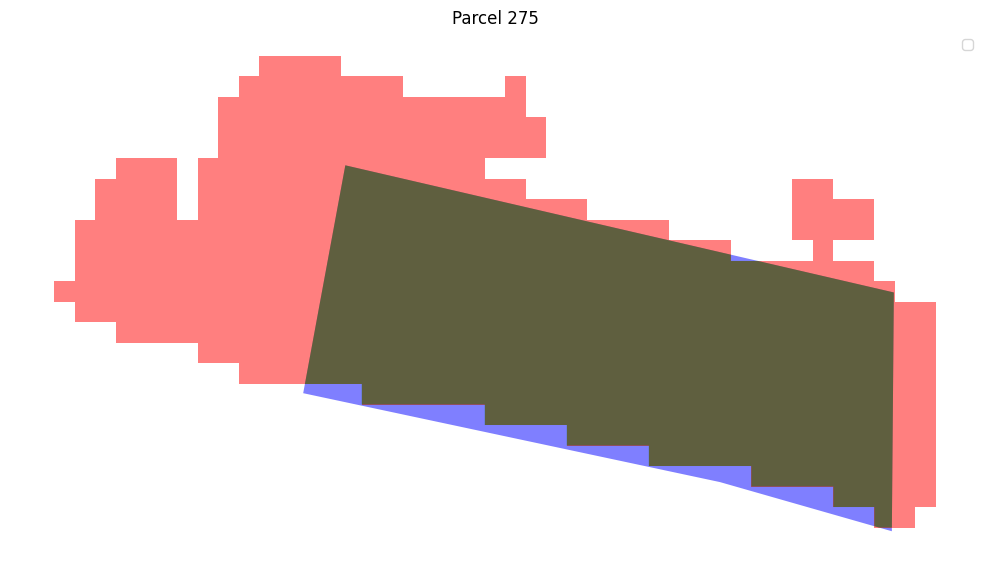

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 275:
True Positive (Correctly predicted): 7417.49 m²
False Negative (Missed): 488.18 m²
Adjusted IoU: 0.94




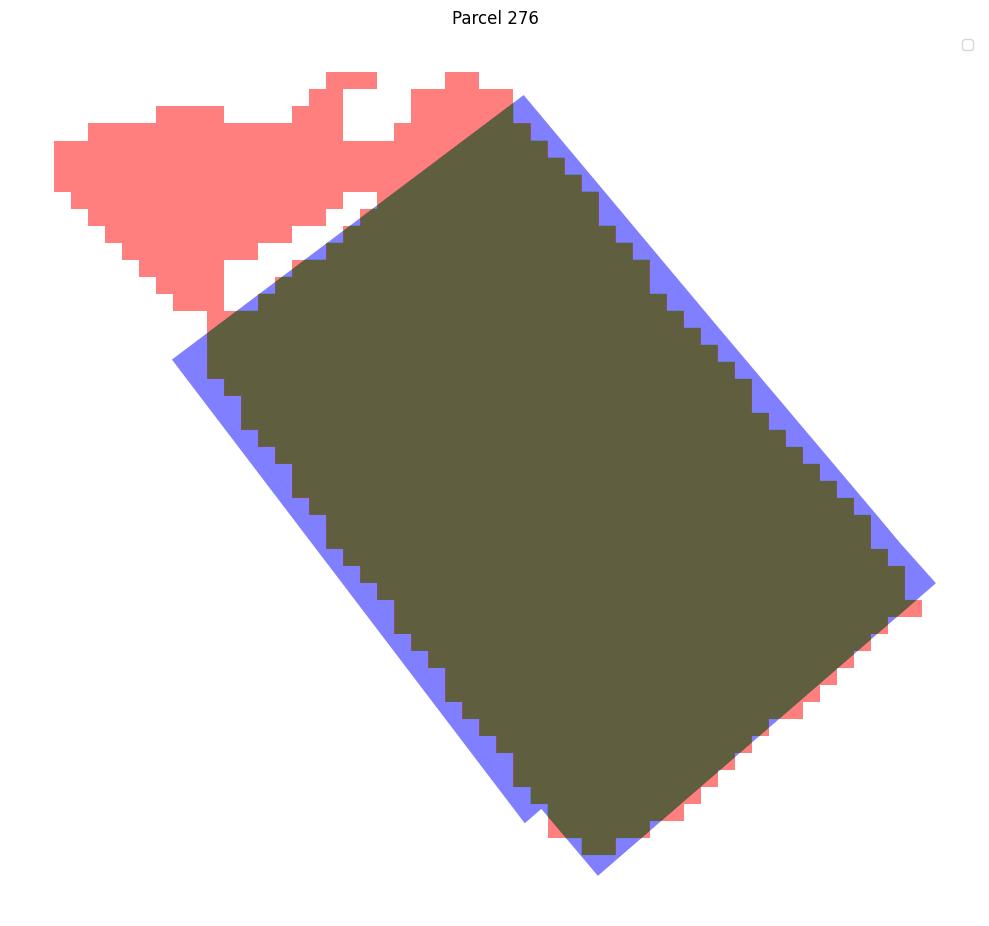

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 276:
True Positive (Correctly predicted): 23327.27 m²
False Negative (Missed): 2240.09 m²
Adjusted IoU: 0.91




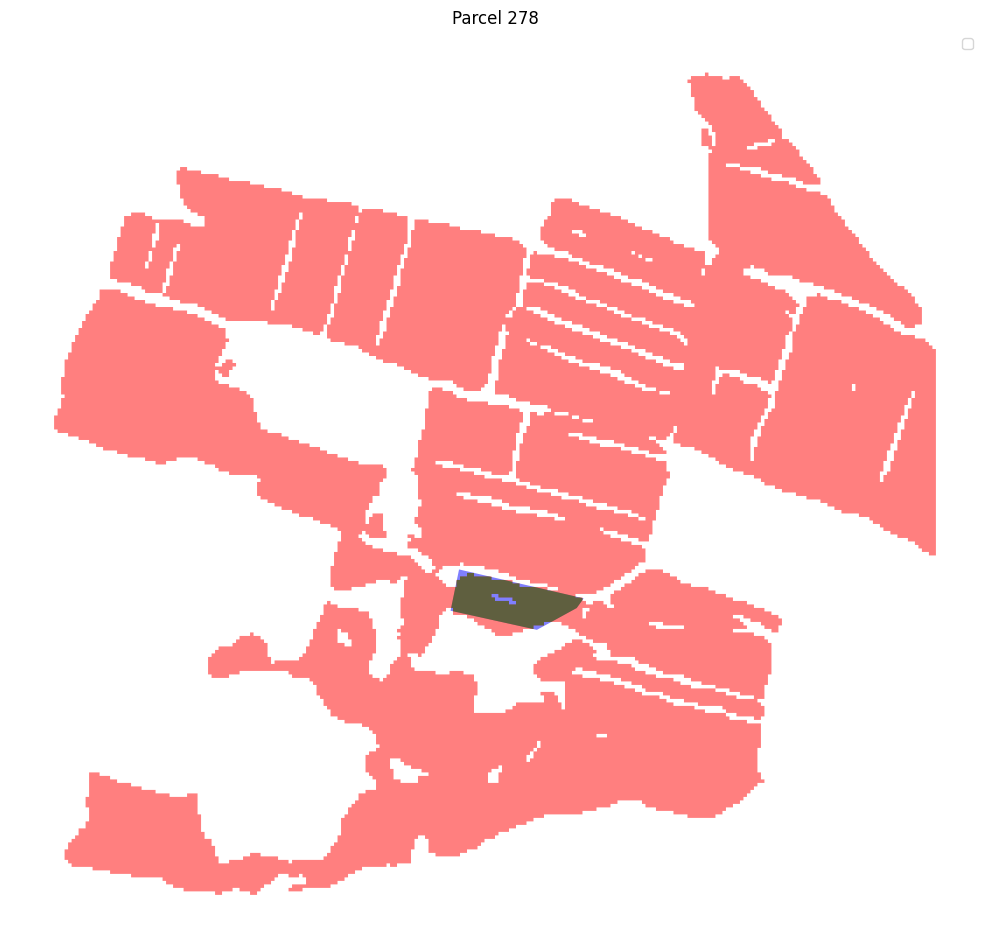

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 278:
True Positive (Correctly predicted): 8778.63 m²
False Negative (Missed): 643.46 m²
Adjusted IoU: 0.93




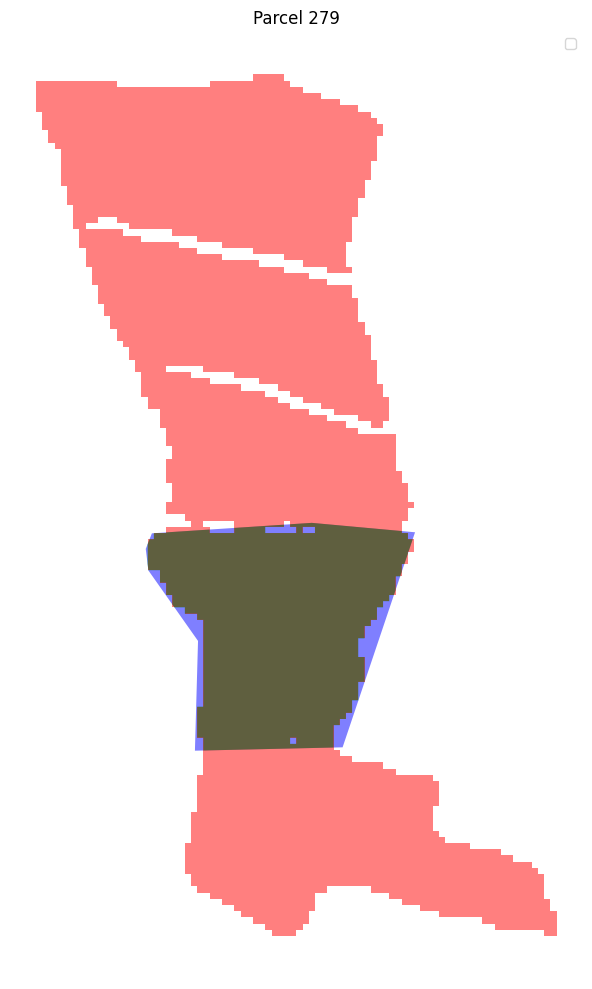

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 279:
True Positive (Correctly predicted): 26632.21 m²
False Negative (Missed): 2069.22 m²
Adjusted IoU: 0.93




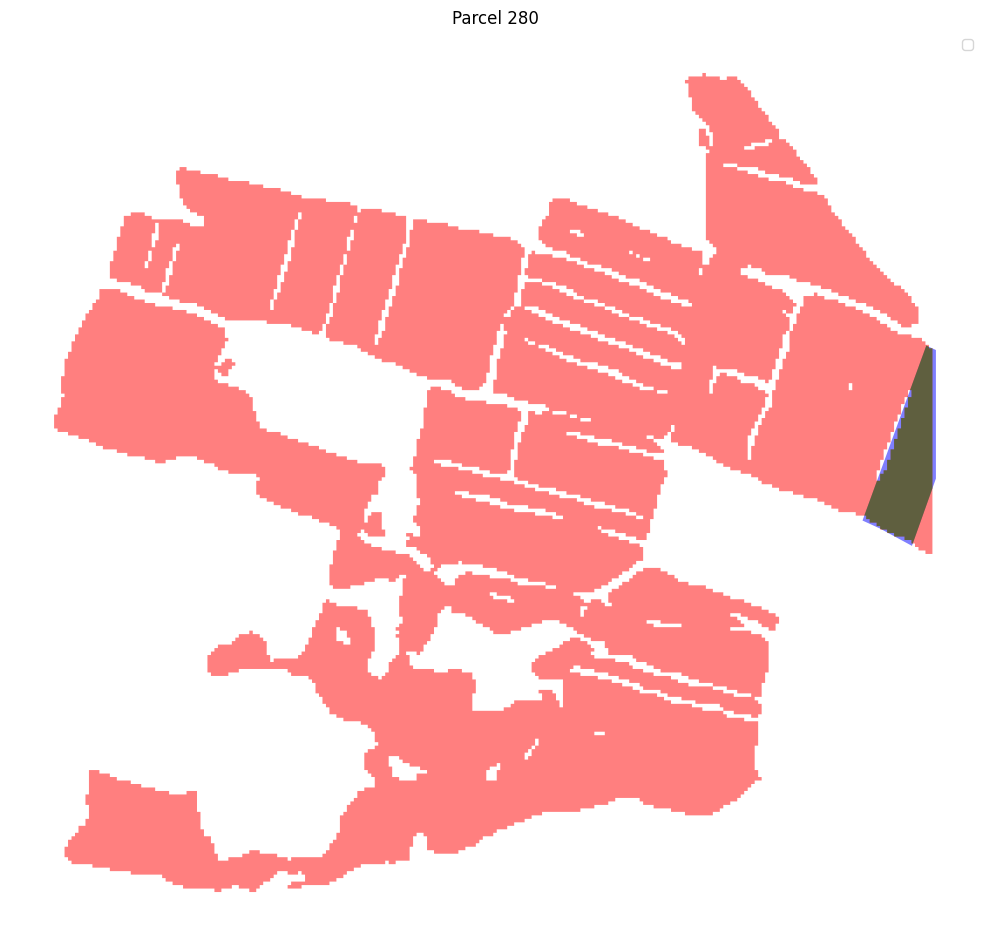

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 280:
True Positive (Correctly predicted): 13895.50 m²
False Negative (Missed): 1829.36 m²
Adjusted IoU: 0.88




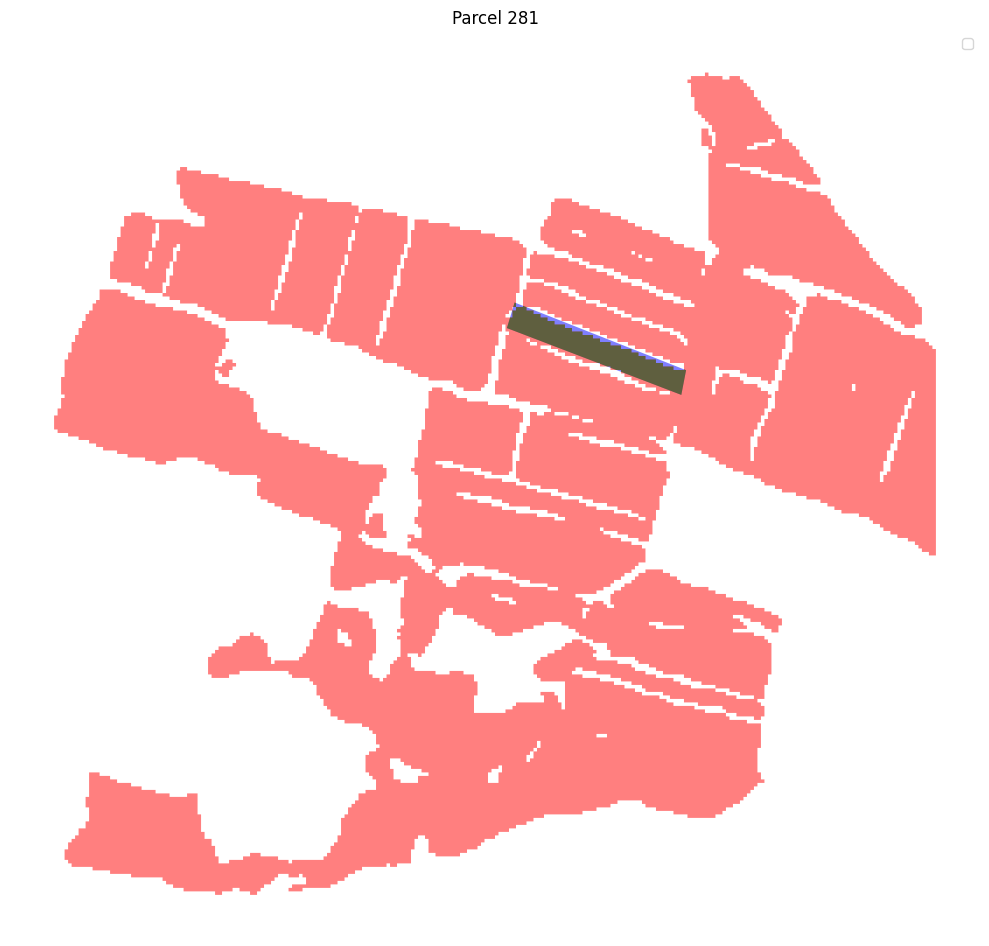

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 281:
True Positive (Correctly predicted): 8563.08 m²
False Negative (Missed): 1166.61 m²
Adjusted IoU: 0.88




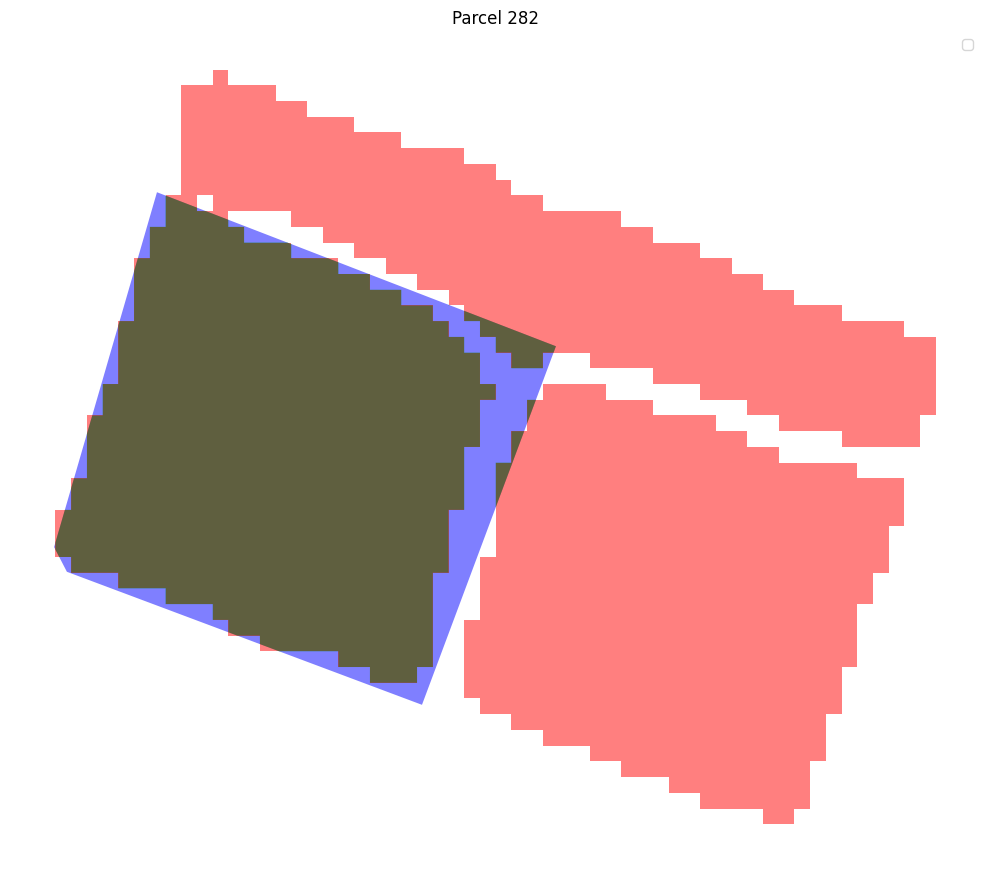

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 282:
True Positive (Correctly predicted): 14050.87 m²
False Negative (Missed): 2005.62 m²
Adjusted IoU: 0.88




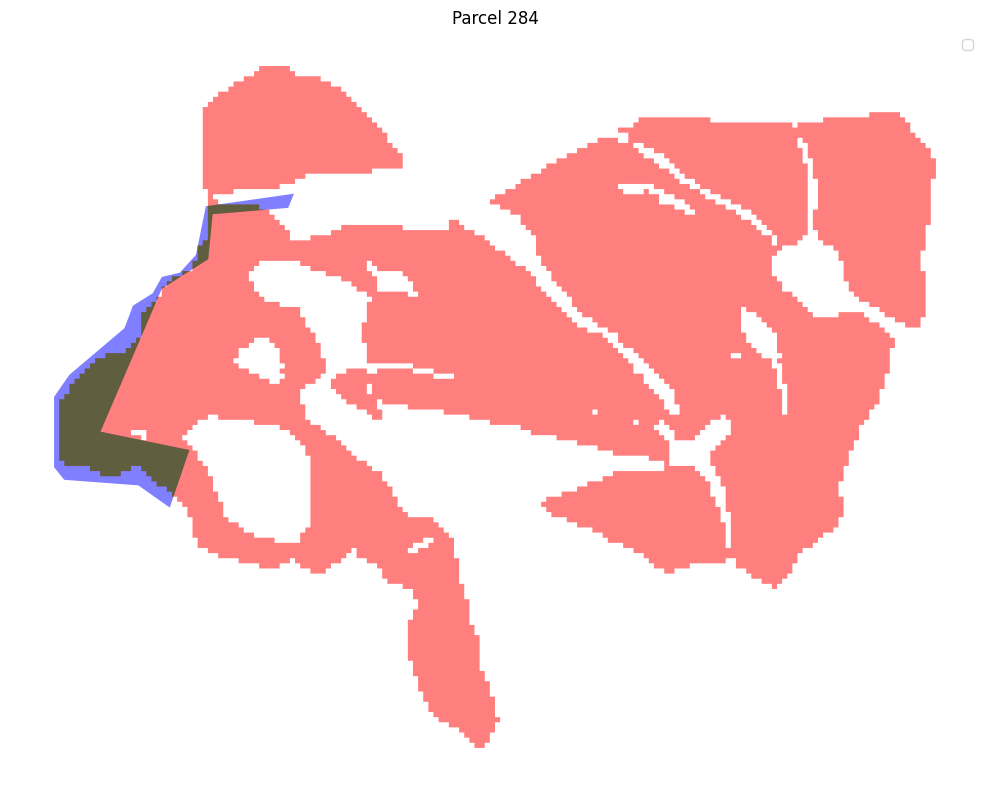

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 284:
True Positive (Correctly predicted): 8774.67 m²
False Negative (Missed): 4294.24 m²
Adjusted IoU: 0.67




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


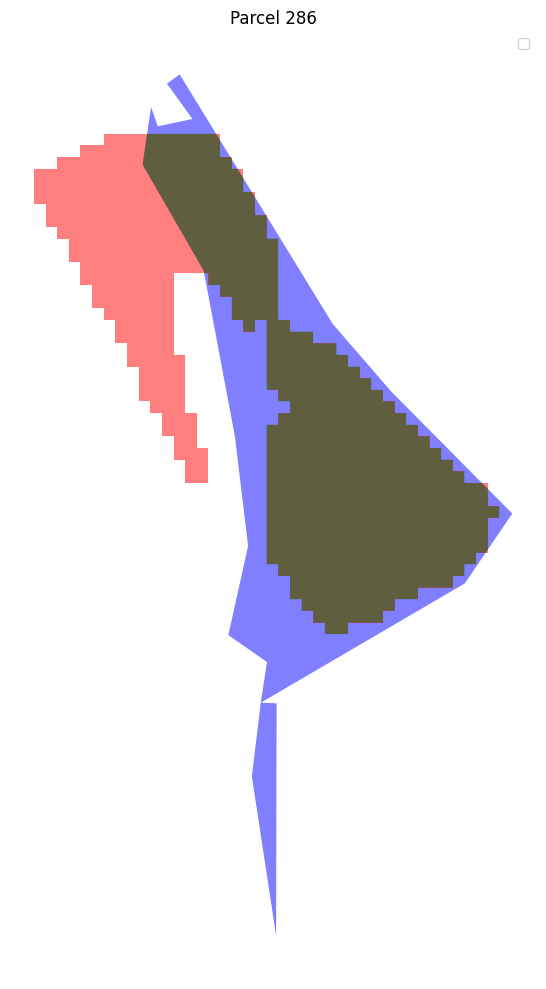

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 286:
True Positive (Correctly predicted): 10941.64 m²
False Negative (Missed): 5647.34 m²
Adjusted IoU: 0.66




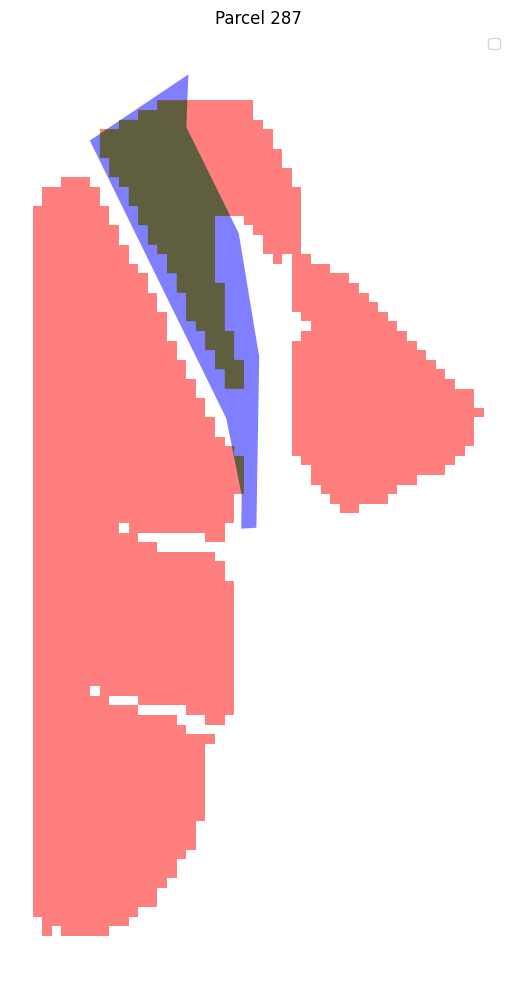

Parcel 287:
True Positive (Correctly predicted): 4569.65 m²
False Negative (Missed): 3107.43 m²
Adjusted IoU: 0.60




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

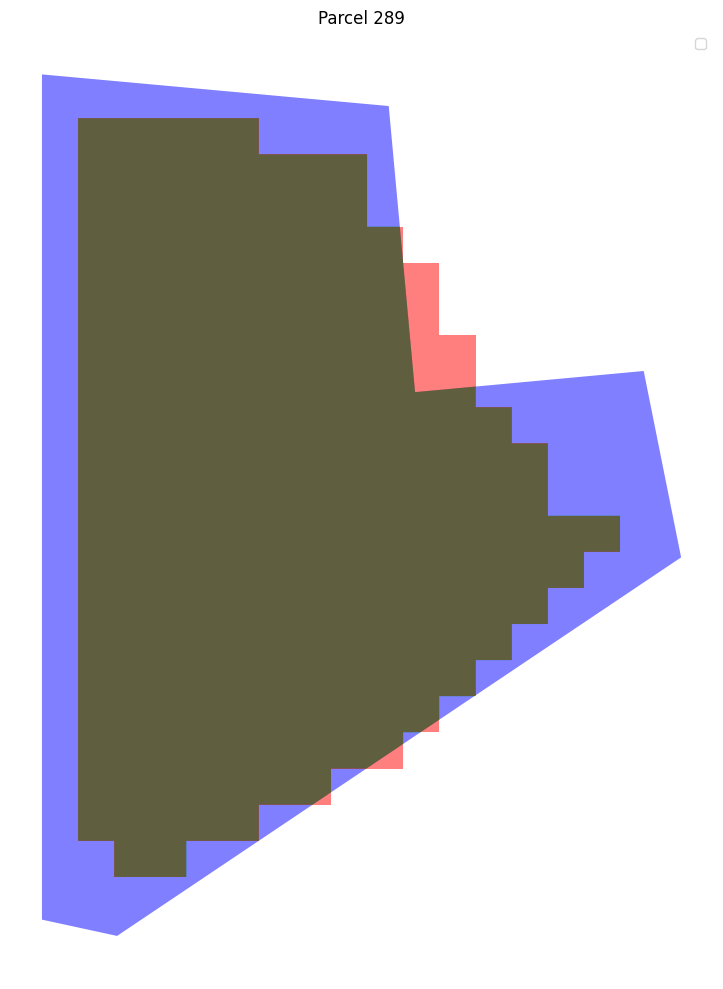

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 289:
True Positive (Correctly predicted): 5074.09 m²
False Negative (Missed): 1597.33 m²
Adjusted IoU: 0.76




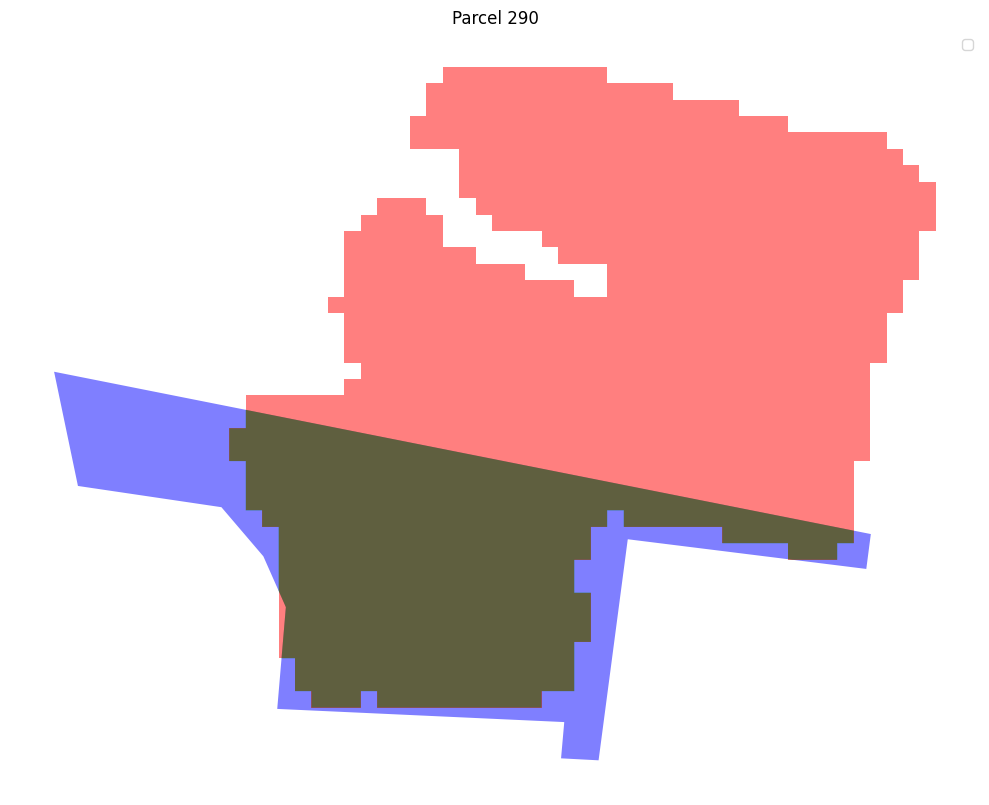

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 290:
True Positive (Correctly predicted): 8332.03 m²
False Negative (Missed): 3370.69 m²
Adjusted IoU: 0.71




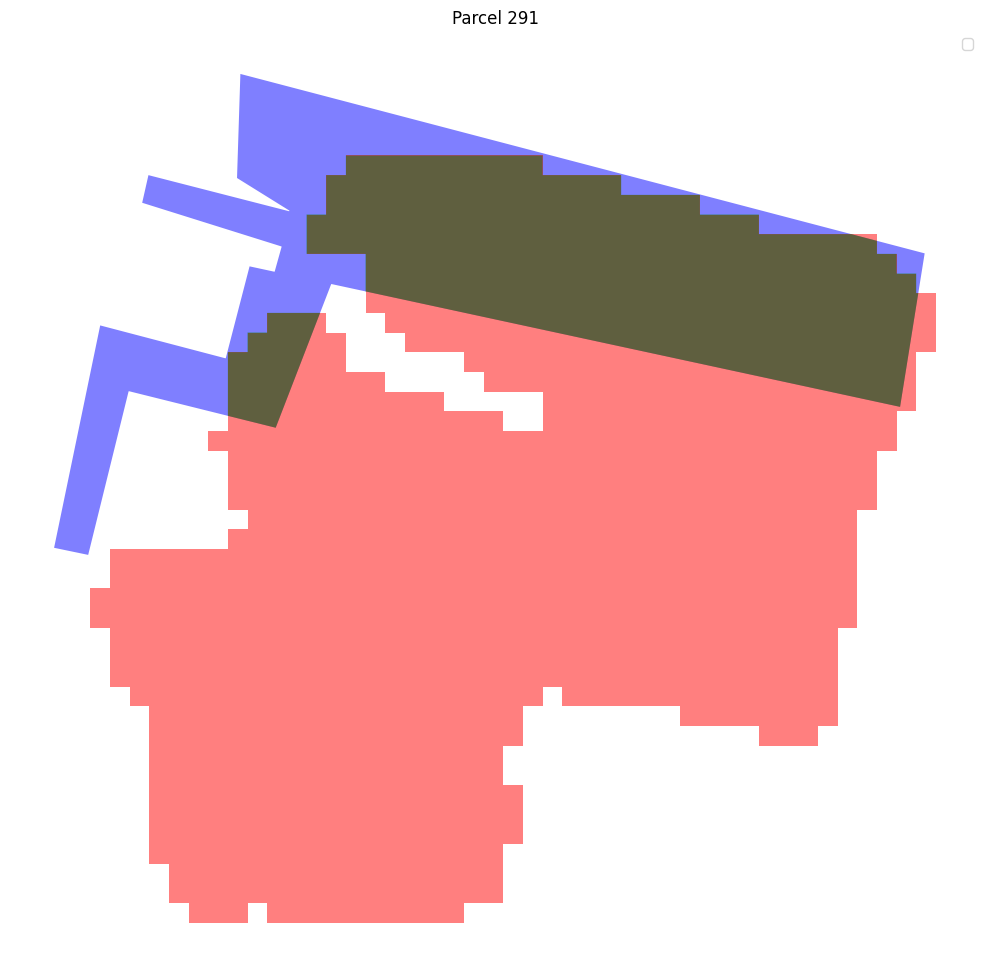

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 291:
True Positive (Correctly predicted): 6195.75 m²
False Negative (Missed): 3118.78 m²
Adjusted IoU: 0.67




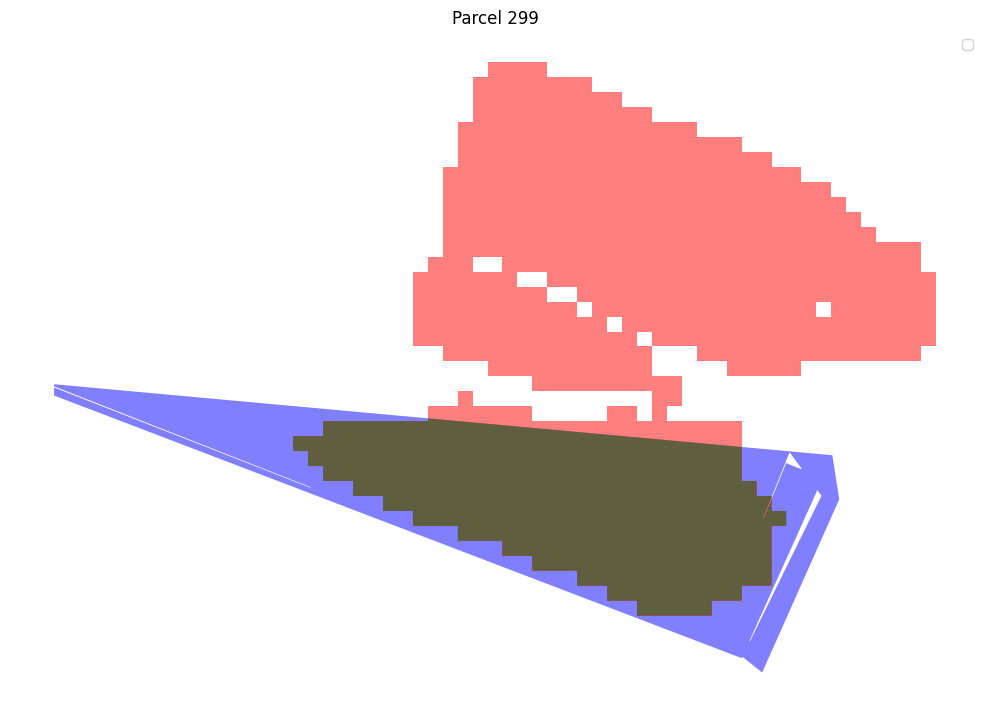

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 299:
True Positive (Correctly predicted): 6471.81 m²
False Negative (Missed): 3617.54 m²
Adjusted IoU: 0.64




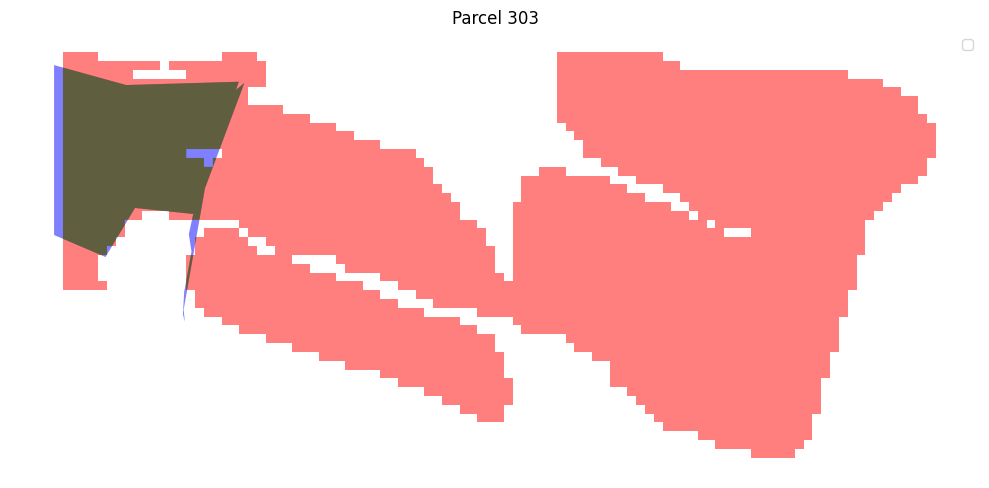

Parcel 303:
True Positive (Correctly predicted): 7240.36 m²
False Negative (Missed): 693.86 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

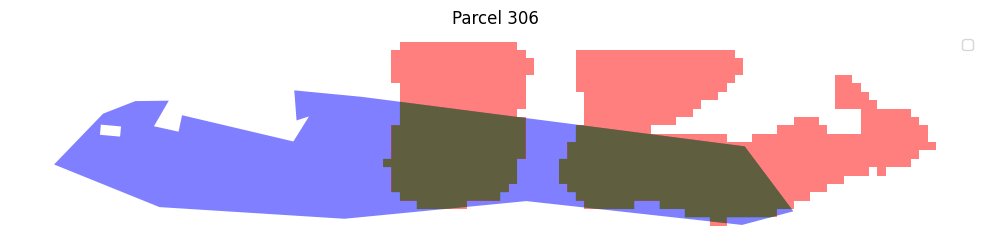

Parcel 306:
True Positive (Correctly predicted): 9610.65 m²
False Negative (Missed): 12606.67 m²
Adjusted IoU: 0.43




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

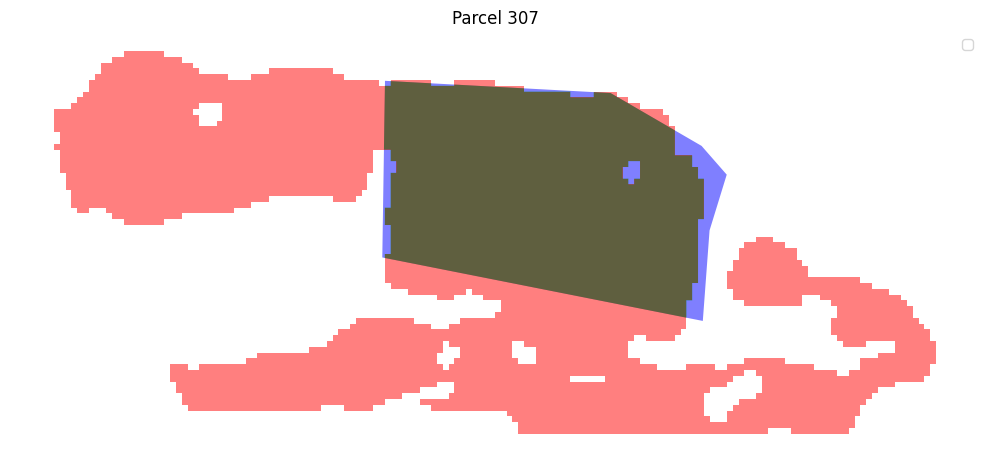

Parcel 307:
True Positive (Correctly predicted): 43688.80 m²
False Negative (Missed): 3151.51 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

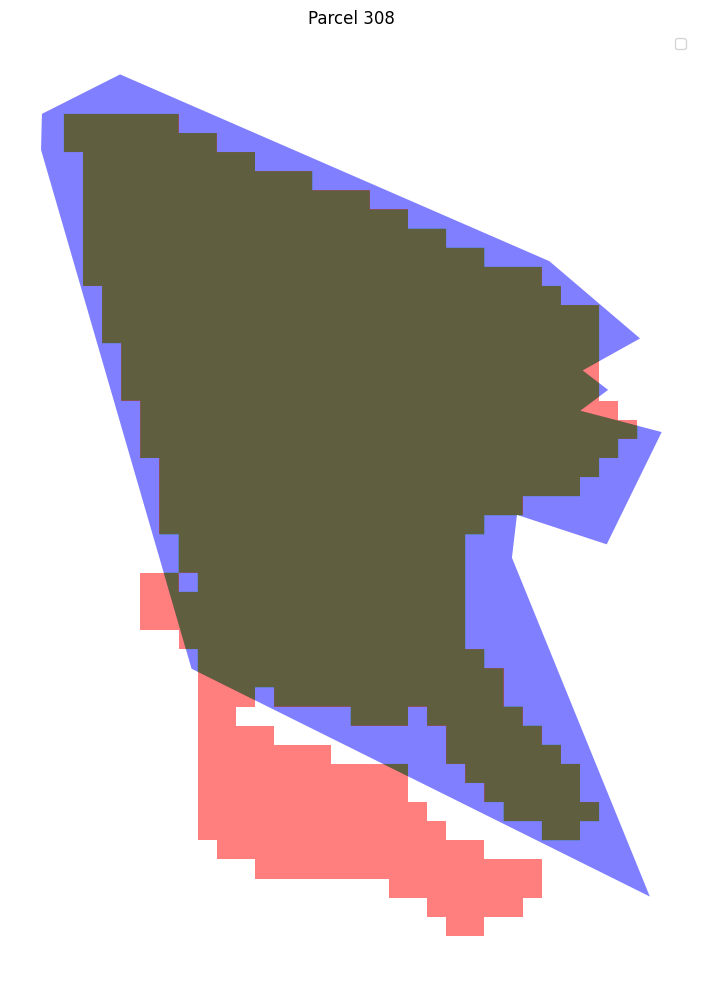

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 308:
True Positive (Correctly predicted): 15172.55 m²
False Negative (Missed): 3833.21 m²
Adjusted IoU: 0.80




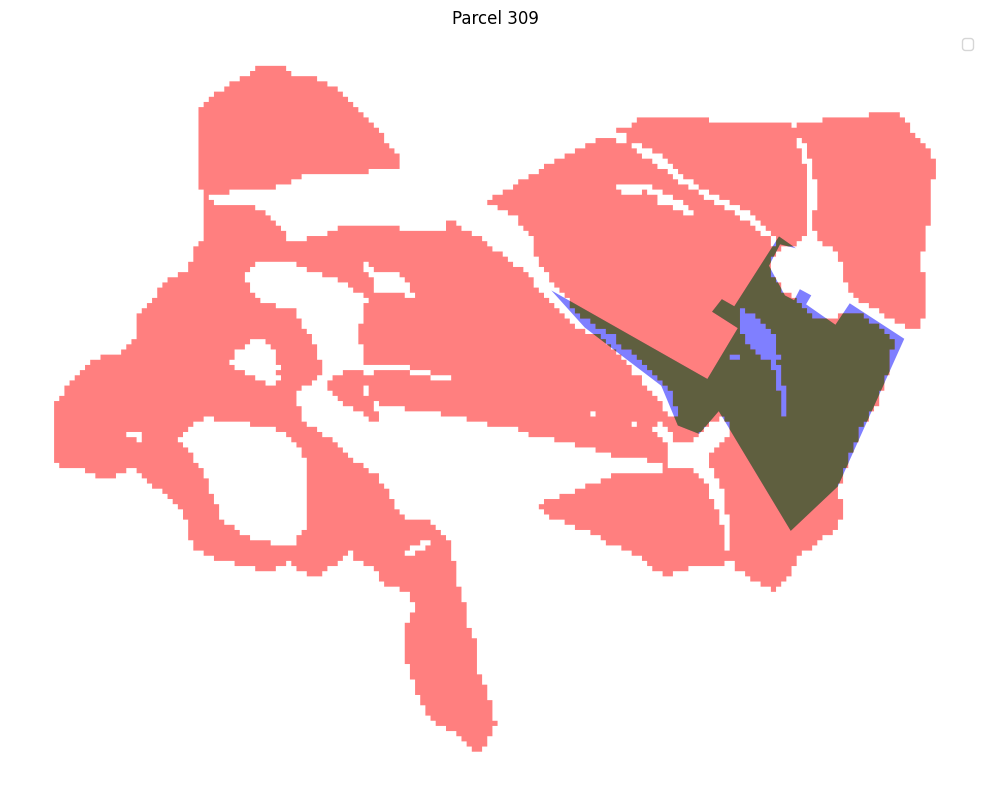

Parcel 309:
True Positive (Correctly predicted): 28668.78 m²
False Negative (Missed): 3406.98 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

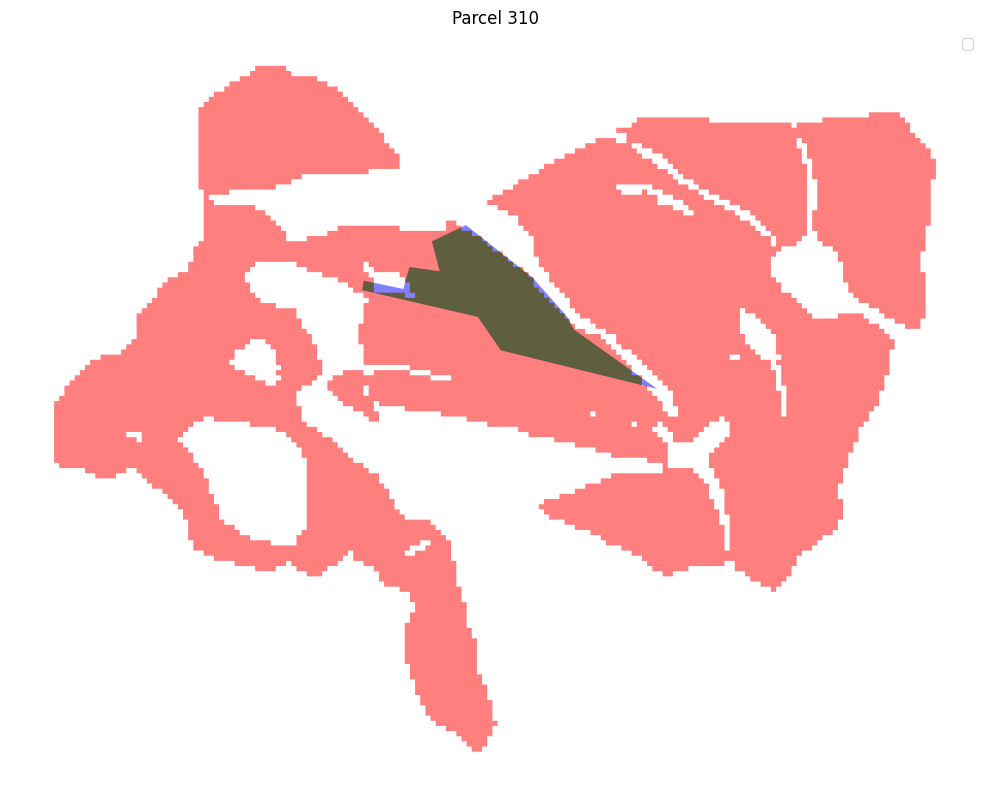

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 310:
True Positive (Correctly predicted): 12456.35 m²
False Negative (Missed): 618.55 m²
Adjusted IoU: 0.95




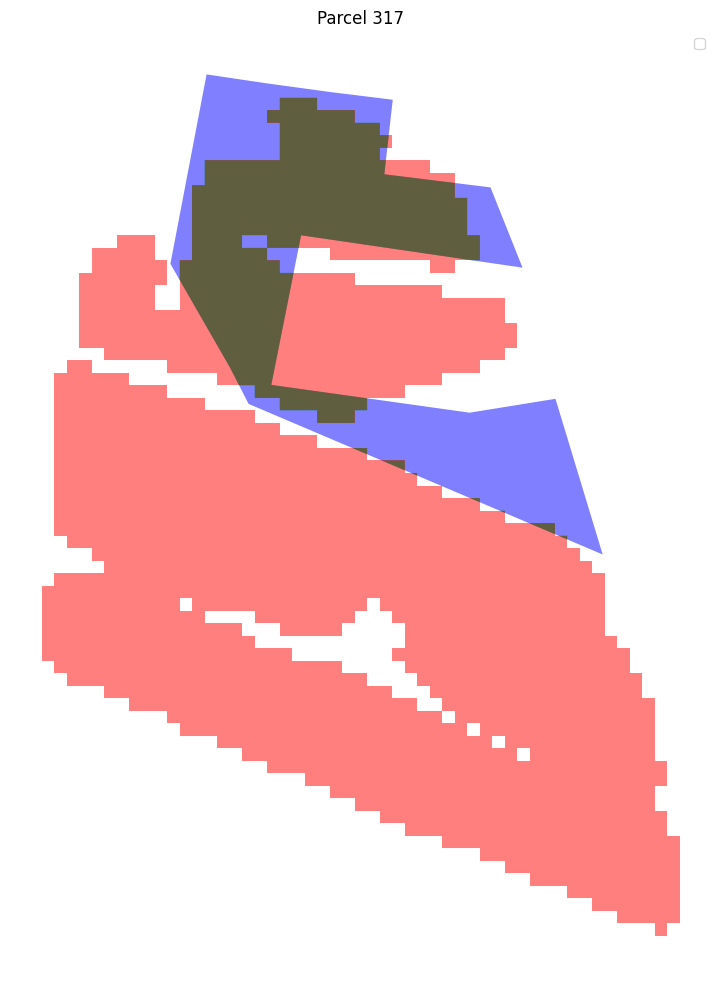

Parcel 317:
True Positive (Correctly predicted): 6500.52 m²
False Negative (Missed): 5700.86 m²
Adjusted IoU: 0.53




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

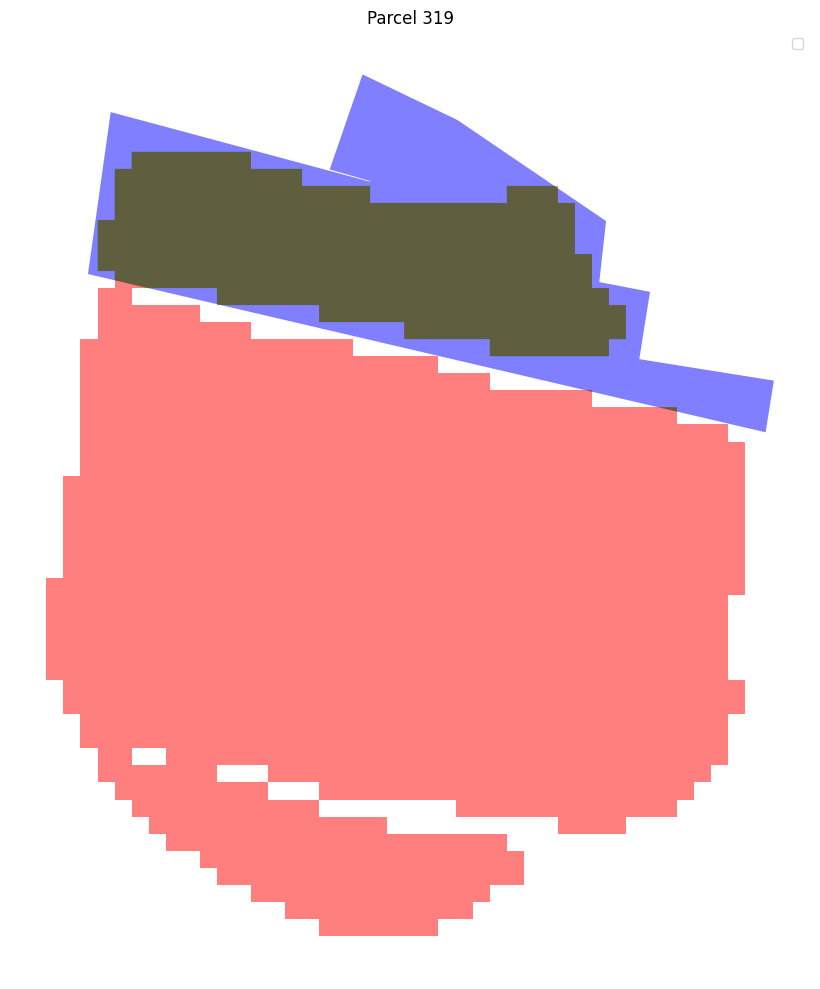

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 319:
True Positive (Correctly predicted): 5916.57 m²
False Negative (Missed): 3506.31 m²
Adjusted IoU: 0.63




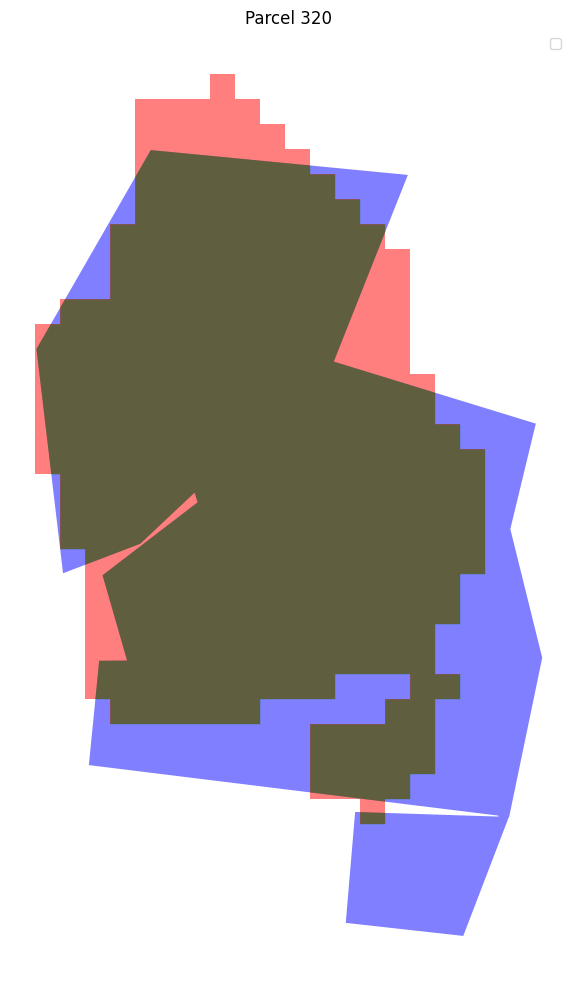

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 320:
True Positive (Correctly predicted): 7659.01 m²
False Negative (Missed): 2717.76 m²
Adjusted IoU: 0.74




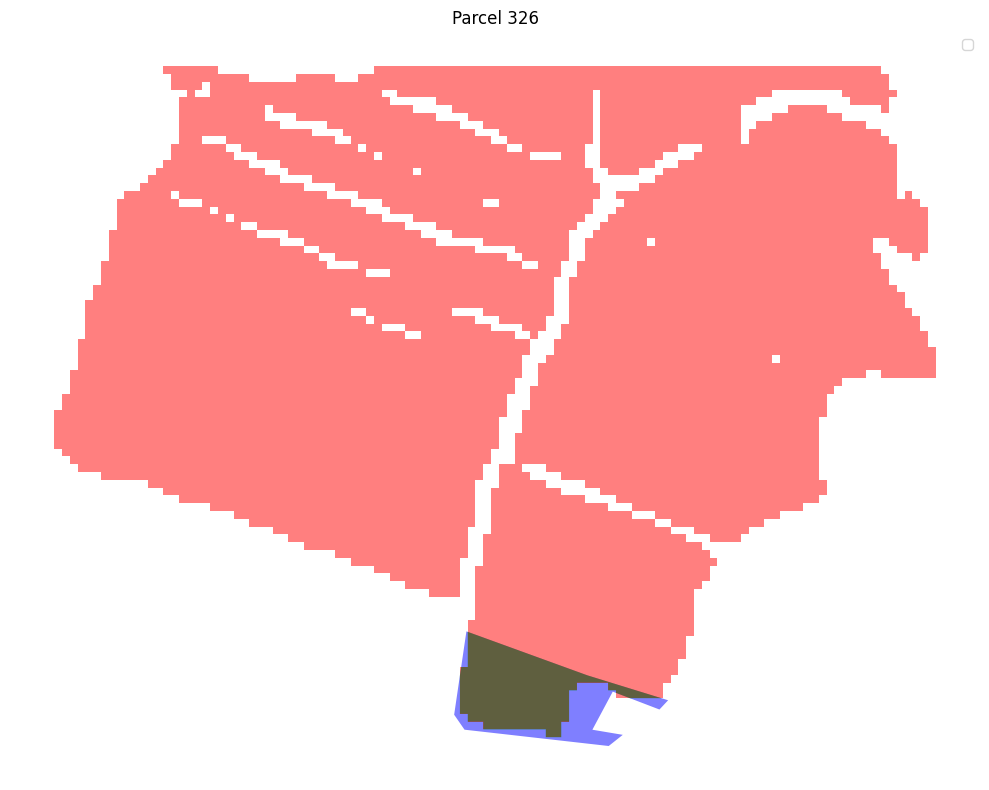

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 326:
True Positive (Correctly predicted): 3700.07 m²
False Negative (Missed): 1438.63 m²
Adjusted IoU: 0.72




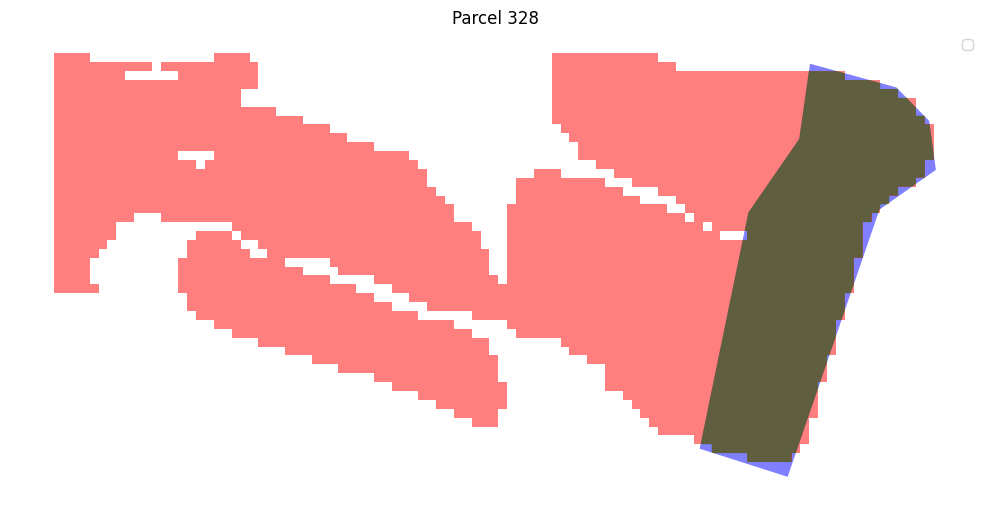

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 328:
True Positive (Correctly predicted): 13952.45 m²
False Negative (Missed): 577.19 m²
Adjusted IoU: 0.96




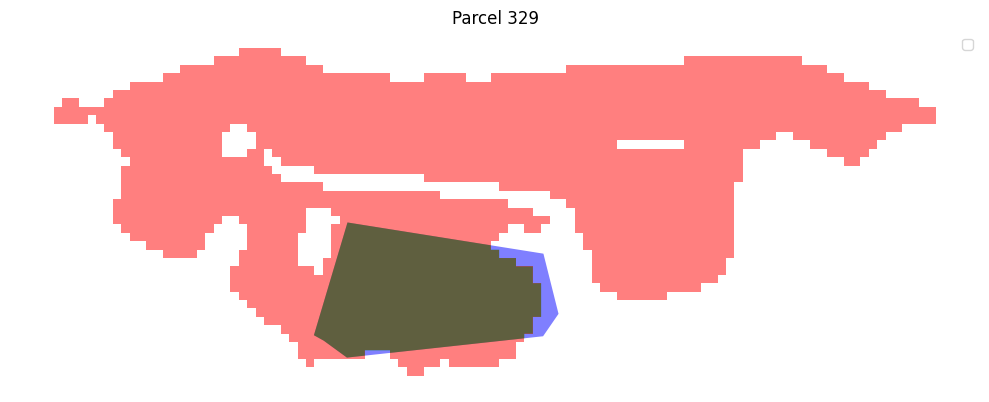

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 329:
True Positive (Correctly predicted): 7927.02 m²
False Negative (Missed): 648.13 m²
Adjusted IoU: 0.92




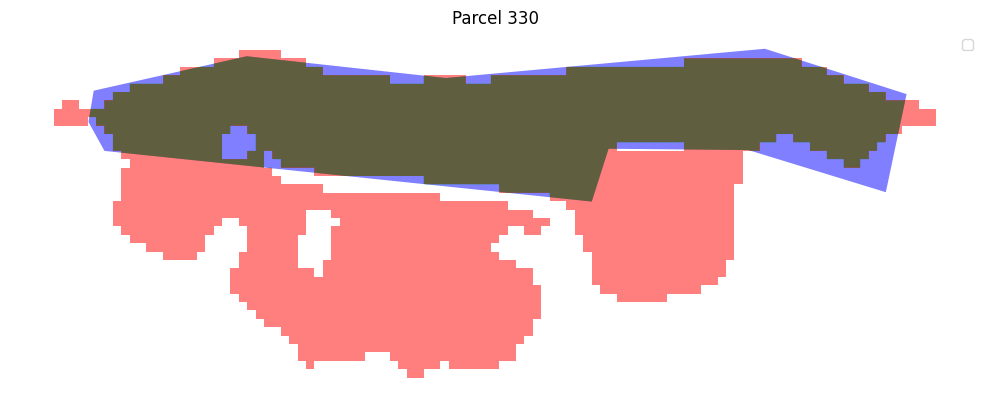

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 330:
True Positive (Correctly predicted): 25815.80 m²
False Negative (Missed): 3559.26 m²
Adjusted IoU: 0.88




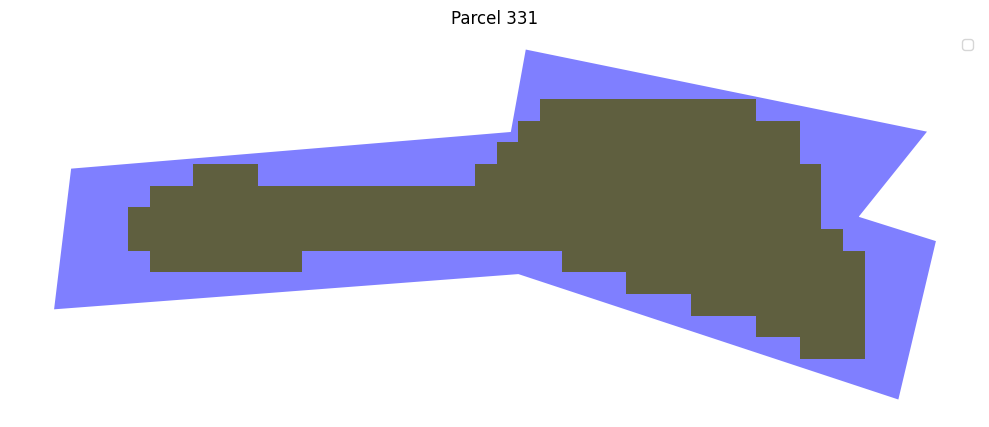

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 331:
True Positive (Correctly predicted): 5000.00 m²
False Negative (Missed): 3622.94 m²
Adjusted IoU: 0.58




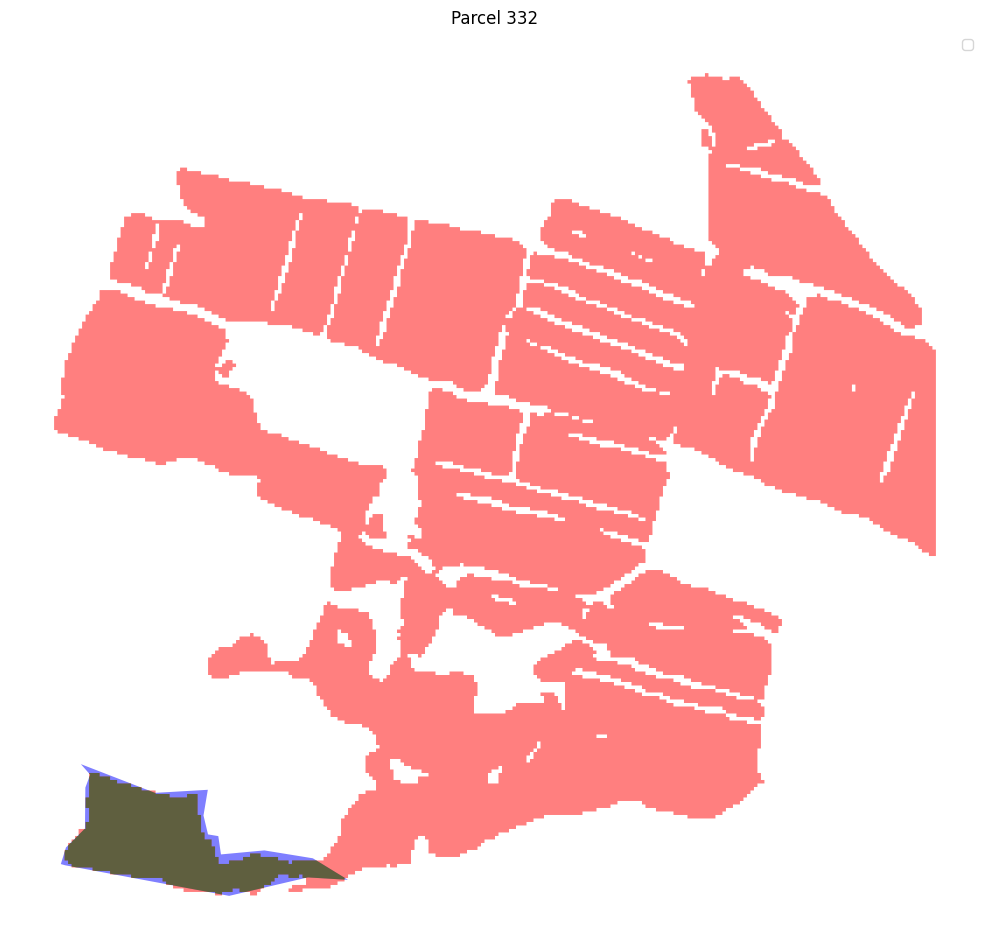

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 332:
True Positive (Correctly predicted): 29462.06 m²
False Negative (Missed): 3999.79 m²
Adjusted IoU: 0.88




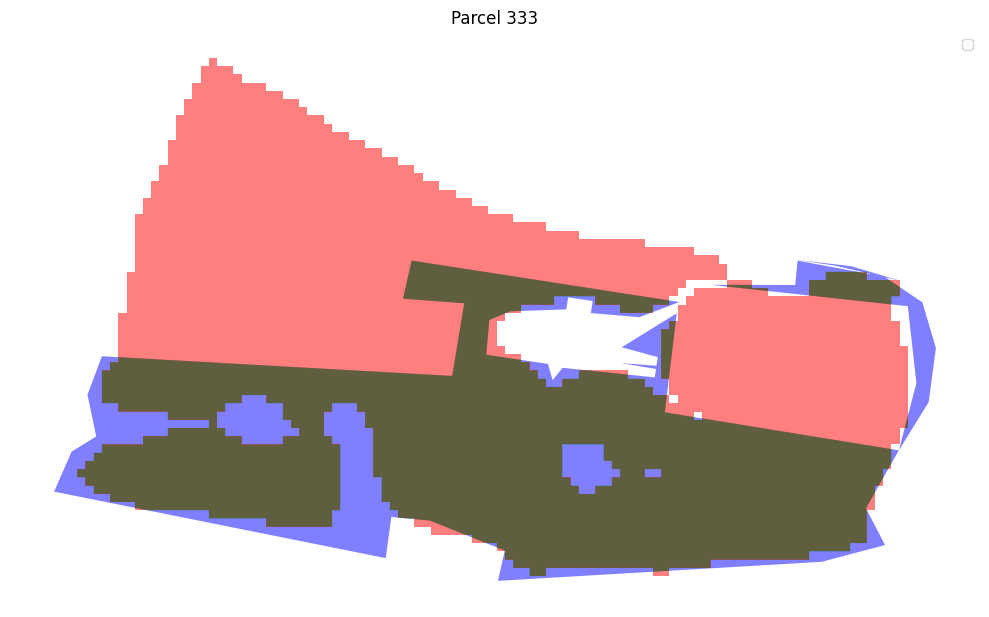

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 333:
True Positive (Correctly predicted): 44171.89 m²
False Negative (Missed): 10304.97 m²
Adjusted IoU: 0.81




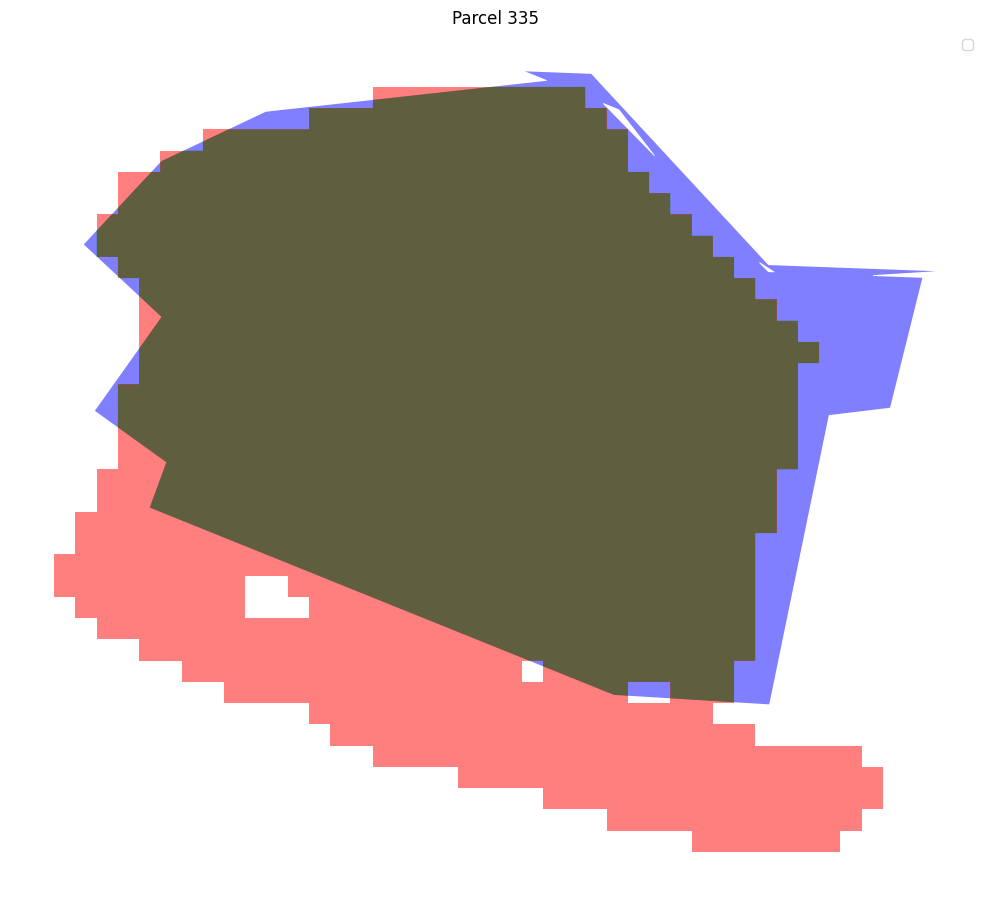

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 335:
True Positive (Correctly predicted): 17060.88 m²
False Negative (Missed): 2096.12 m²
Adjusted IoU: 0.89




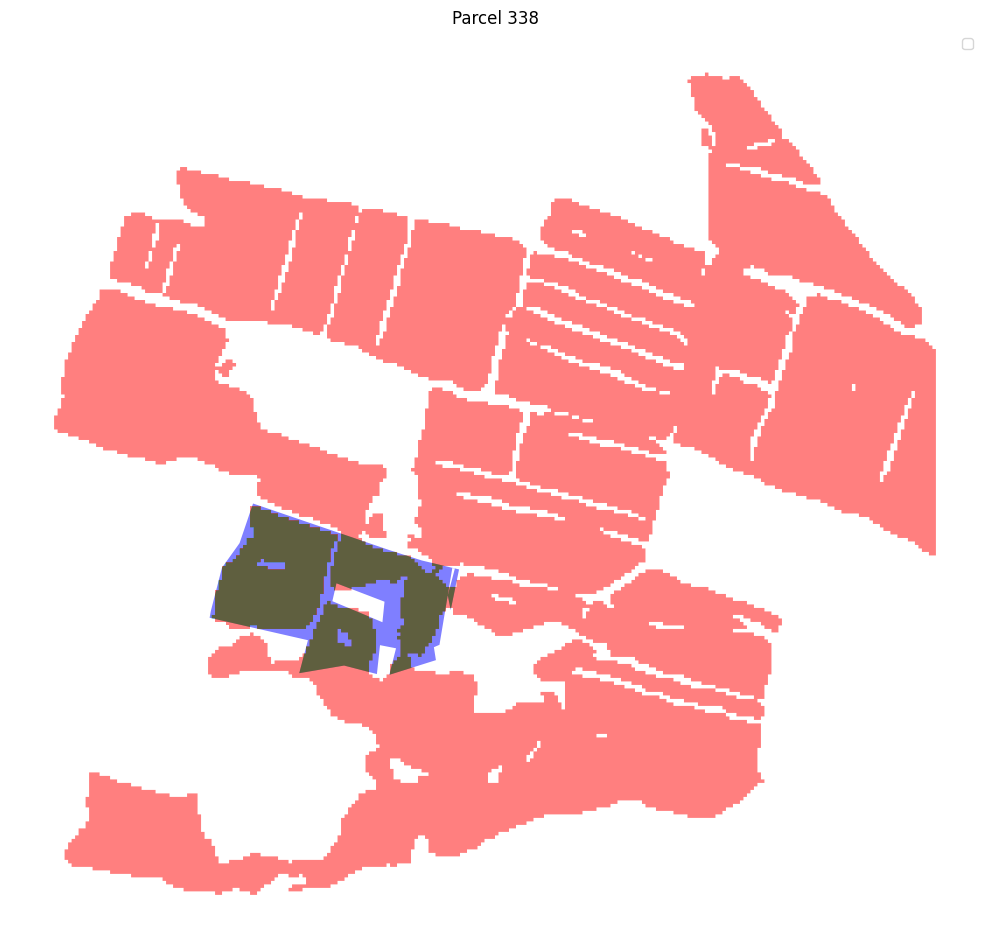

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 338:
True Positive (Correctly predicted): 41241.09 m²
False Negative (Missed): 10347.40 m²
Adjusted IoU: 0.80




/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


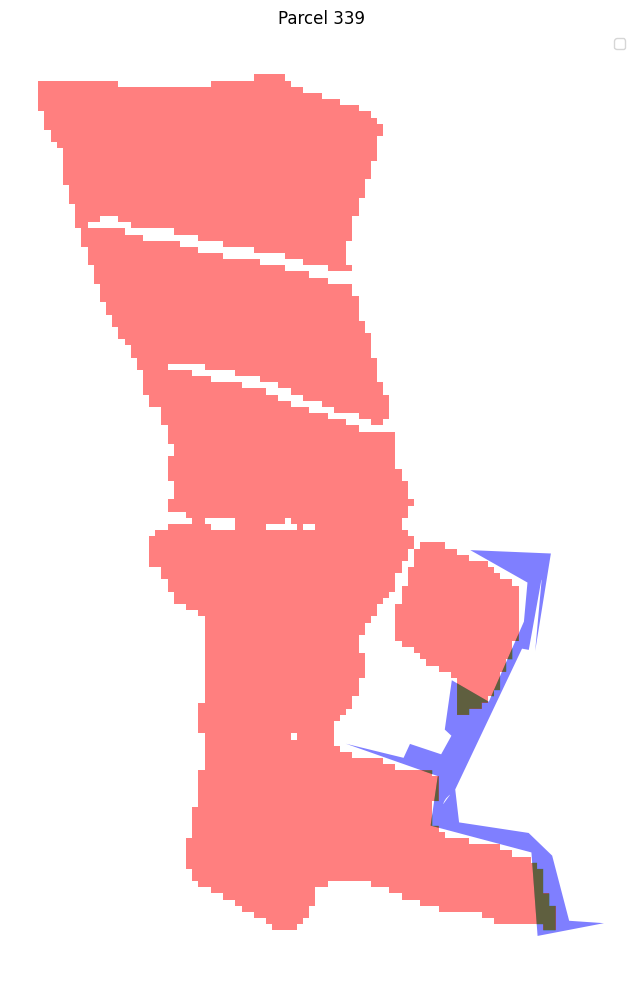

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 339:
True Positive (Correctly predicted): 1092.51 m²
False Negative (Missed): 6630.83 m²
Adjusted IoU: 0.14




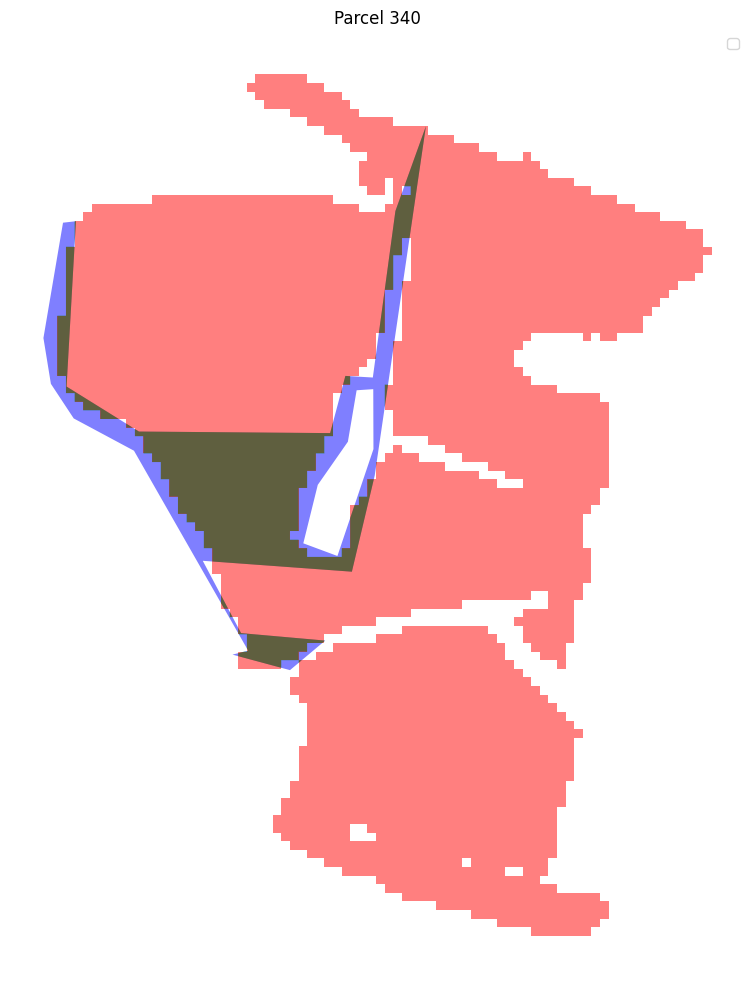

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 340:
True Positive (Correctly predicted): 7982.15 m²
False Negative (Missed): 4092.25 m²
Adjusted IoU: 0.66




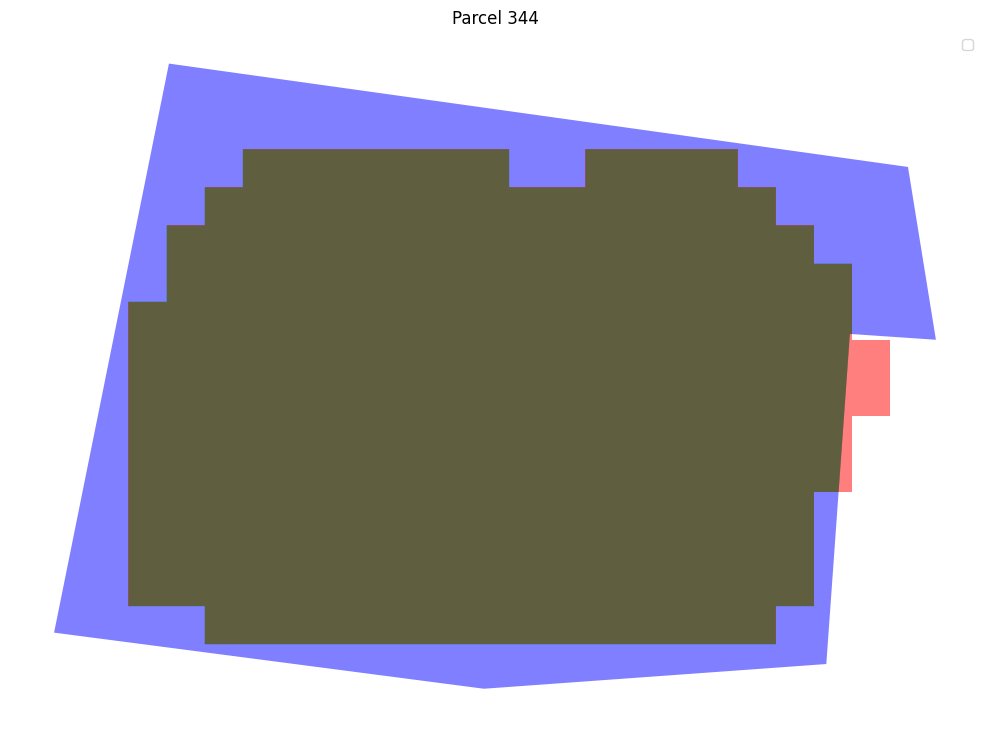

/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Parcel 344:
True Positive (Correctly predicted): 5603.80 m²
False Negative (Missed): 1706.17 m²
Adjusted IoU: 0.77




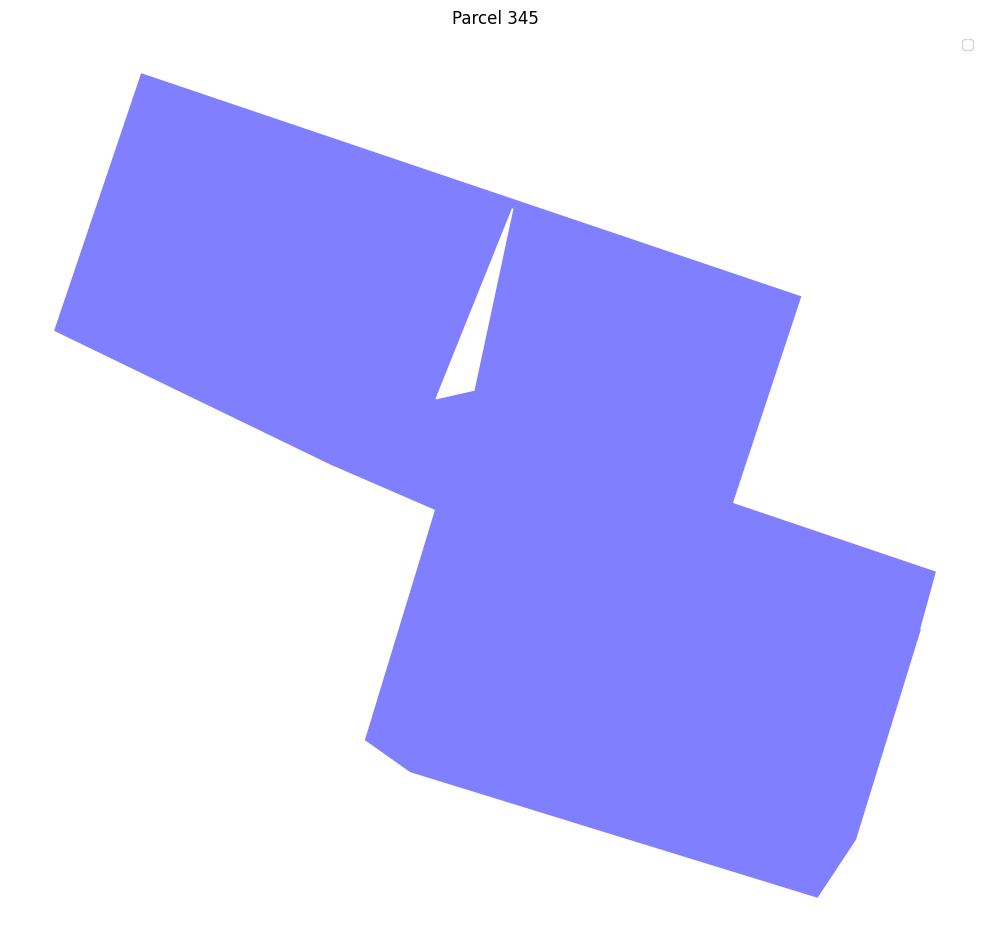

Parcel 345:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 5087.76 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

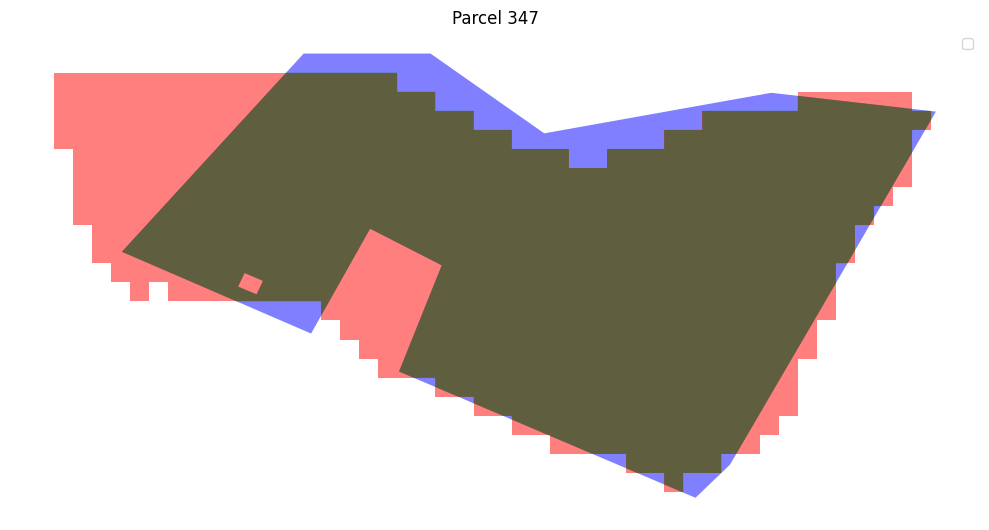

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 347:
True Positive (Correctly predicted): 12145.84 m²
False Negative (Missed): 1118.74 m²
Adjusted IoU: 0.92




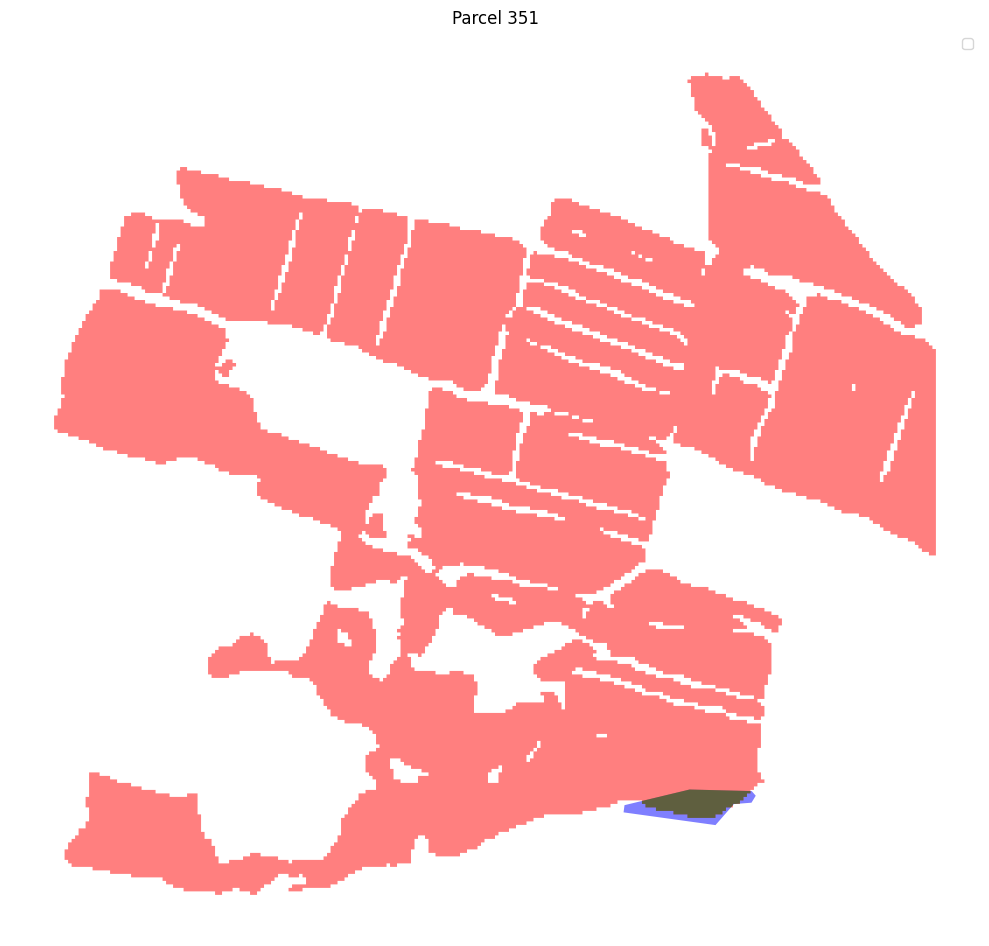

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 351:
True Positive (Correctly predicted): 4053.92 m²
False Negative (Missed): 1744.99 m²
Adjusted IoU: 0.70




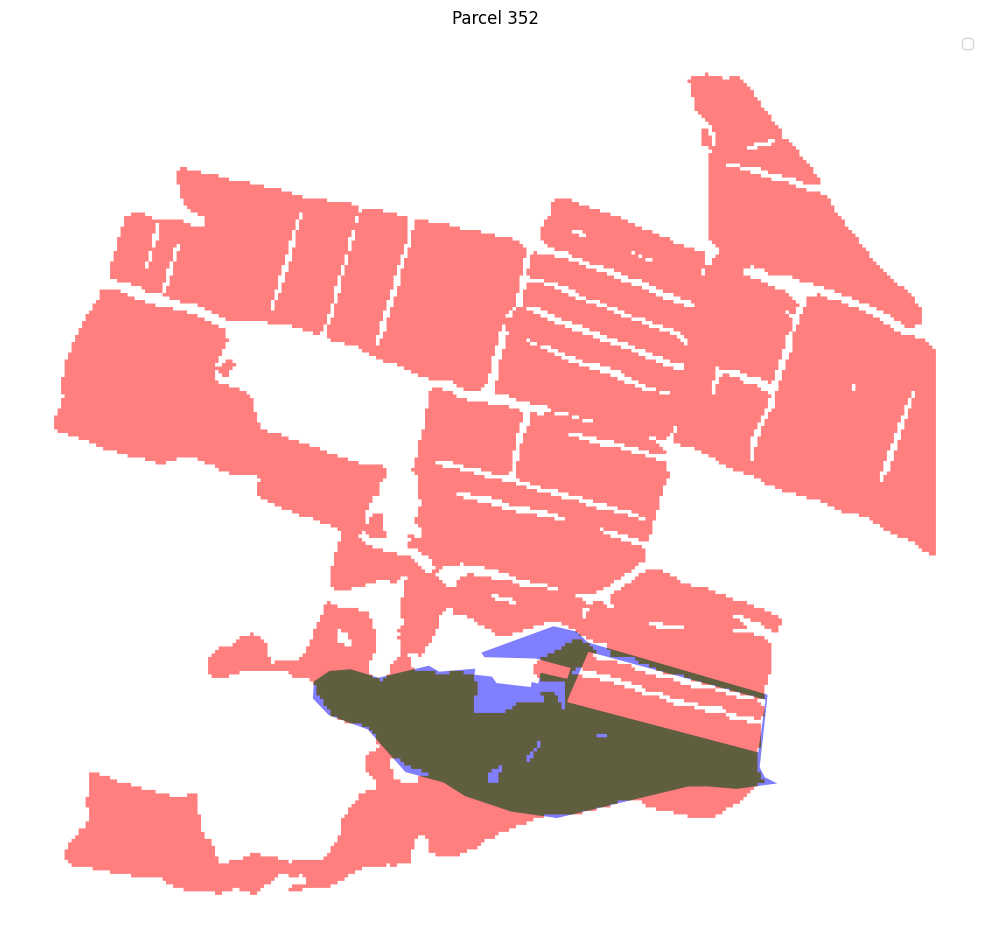

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 352:
True Positive (Correctly predicted): 76339.97 m²
False Negative (Missed): 11171.68 m²
Adjusted IoU: 0.87




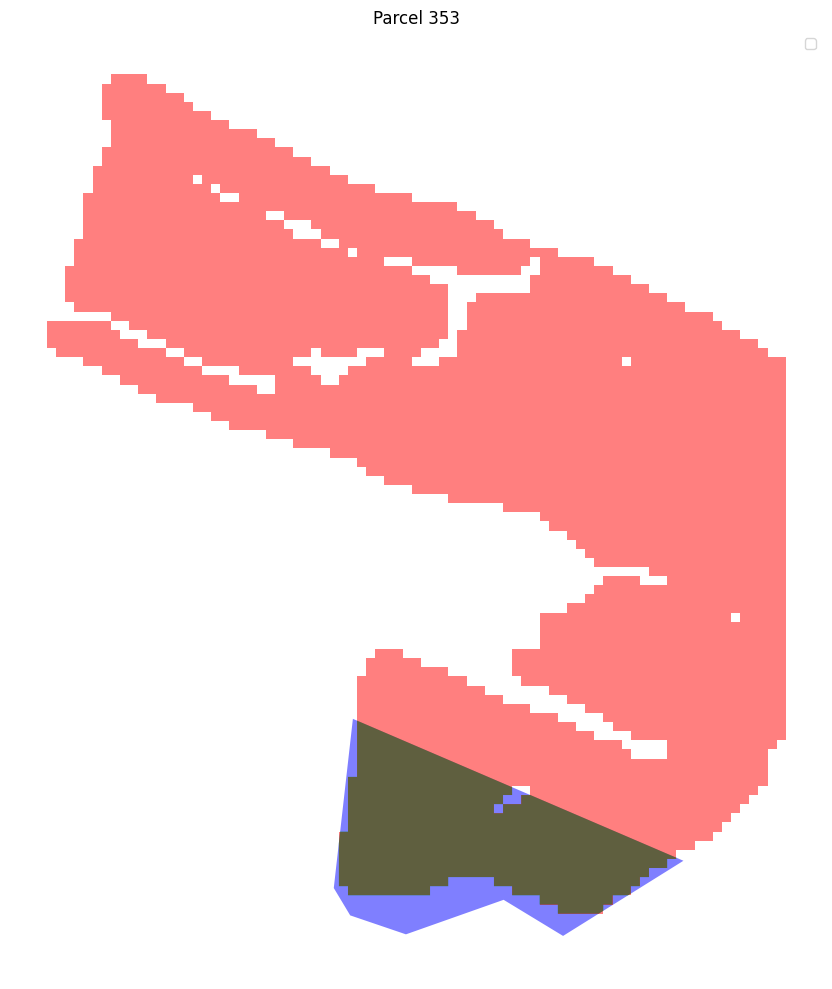

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 353:
True Positive (Correctly predicted): 10210.43 m²
False Negative (Missed): 2471.91 m²
Adjusted IoU: 0.81




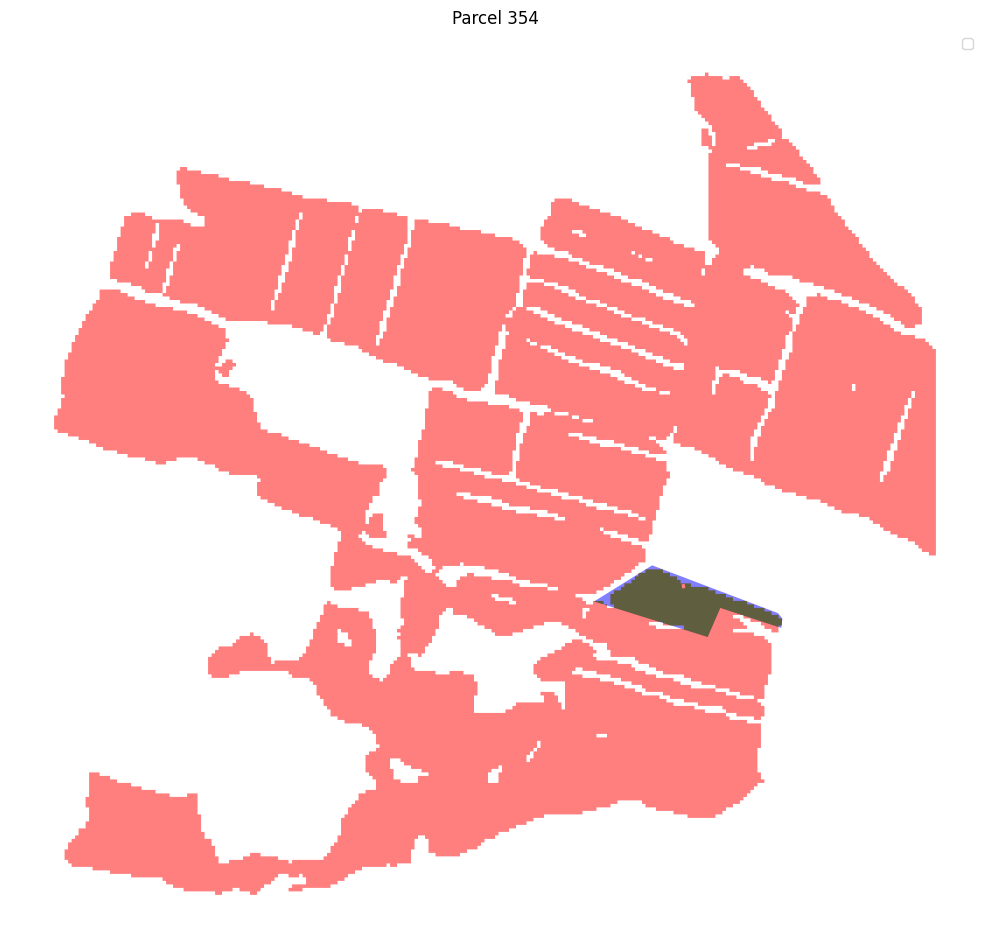

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 354:
True Positive (Correctly predicted): 10598.92 m²
False Negative (Missed): 1273.96 m²
Adjusted IoU: 0.89




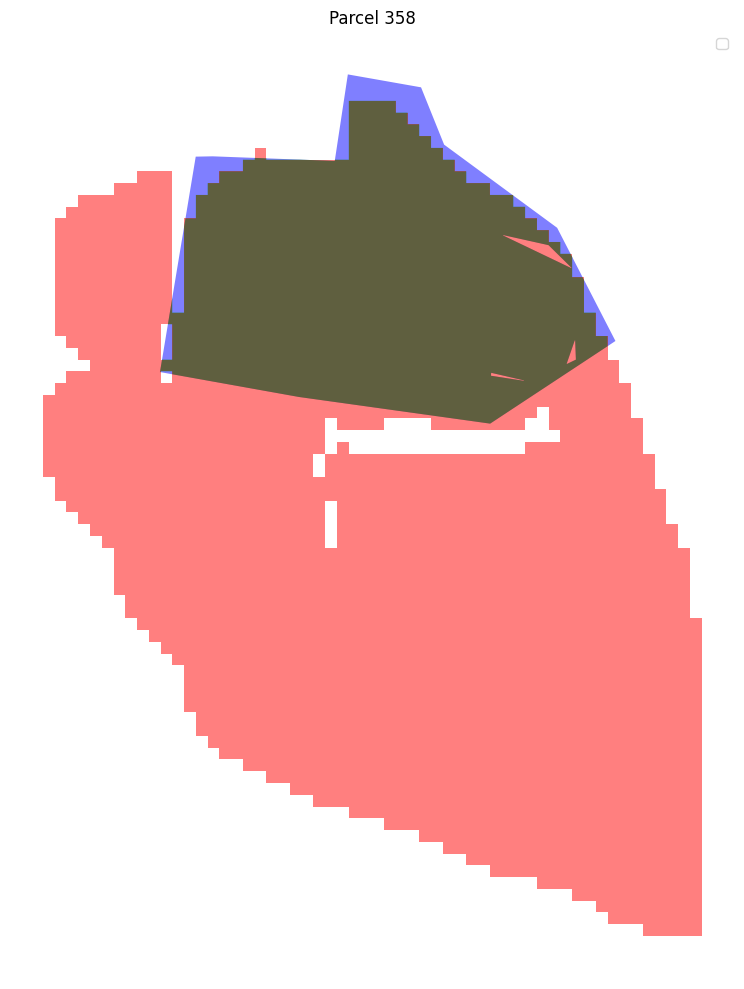

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 358:
True Positive (Correctly predicted): 16686.85 m²
False Negative (Missed): 1378.34 m²
Adjusted IoU: 0.92




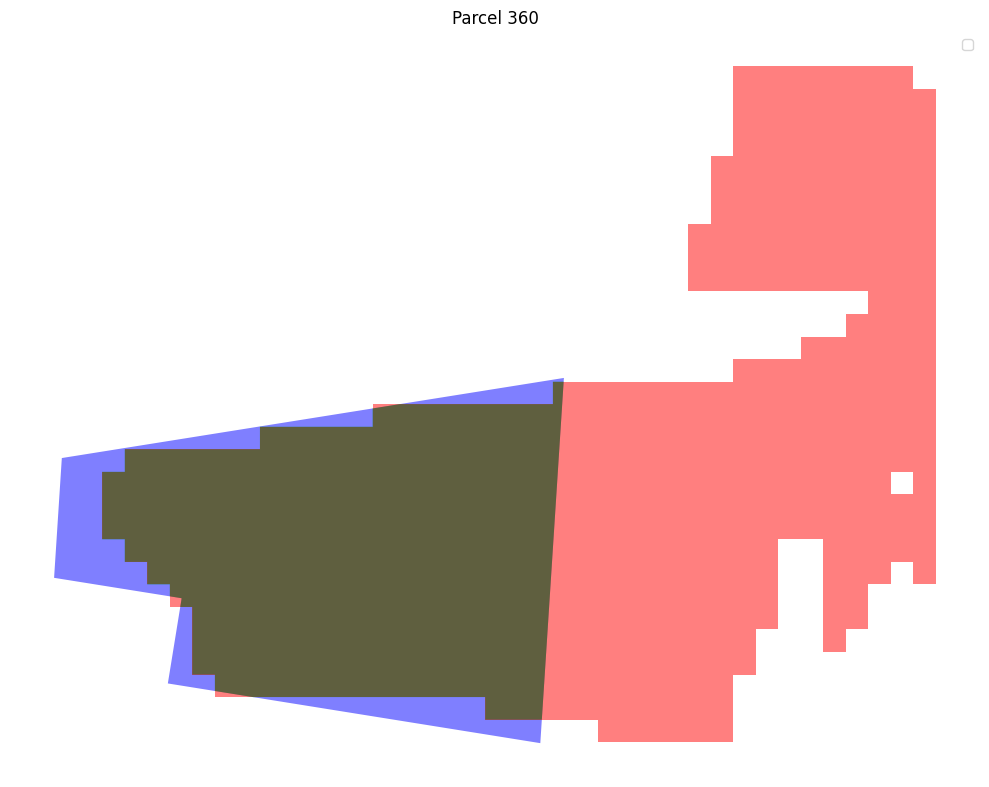

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 360:
True Positive (Correctly predicted): 5484.31 m²
False Negative (Missed): 975.06 m²
Adjusted IoU: 0.85




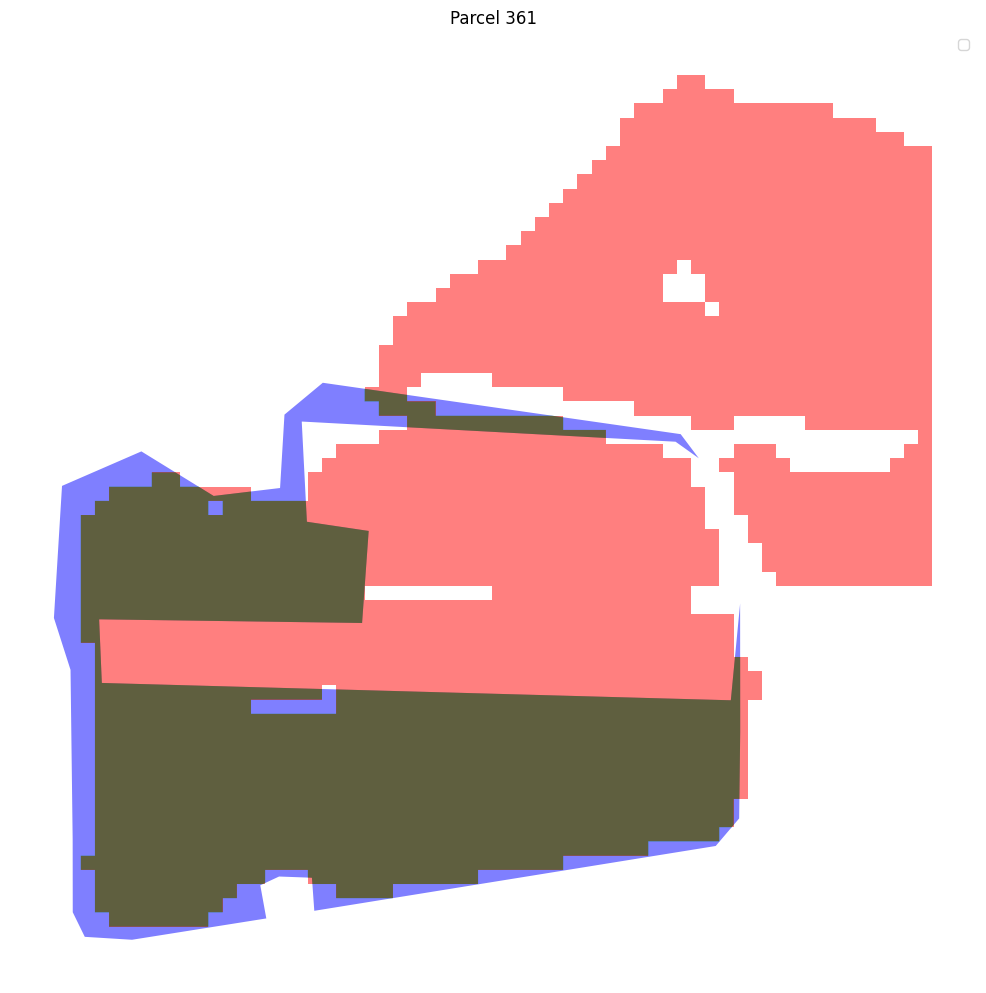

/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 361:
True Positive (Correctly predicted): 19824.71 m²
False Negative (Missed): 3578.71 m²
Adjusted IoU: 0.85




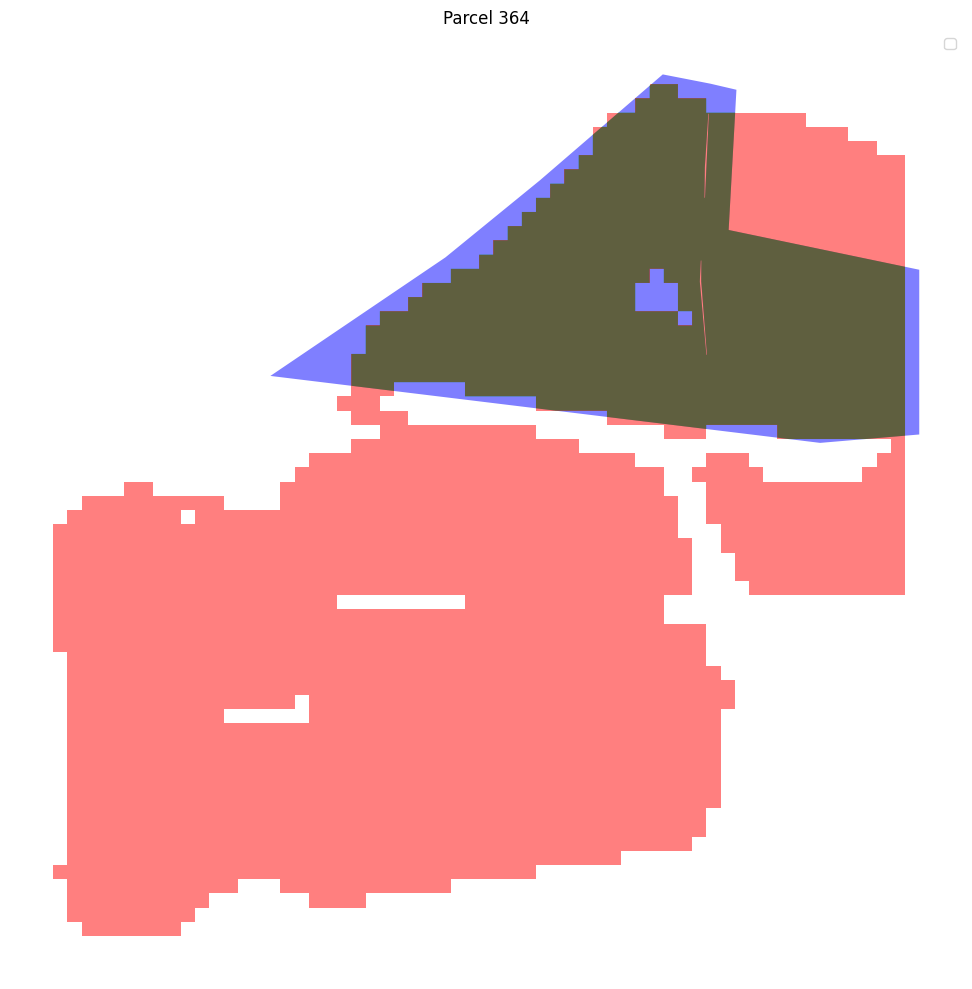

/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Parcel 364:
True Positive (Correctly predicted): 13411.81 m²
False Negative (Missed): 1996.83 m²
Adjusted IoU: 0.87




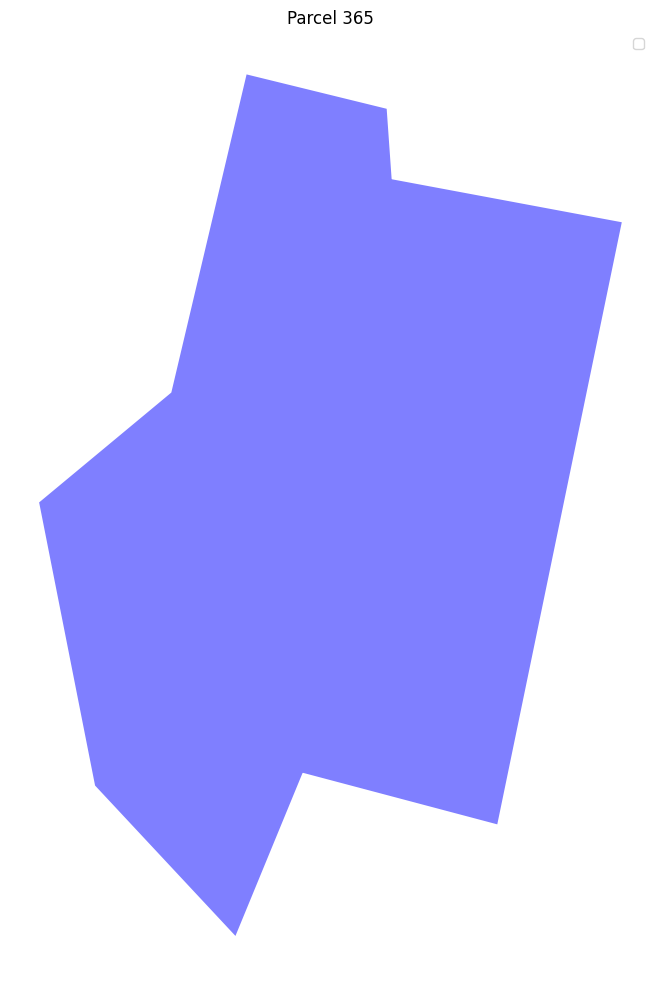

Parcel 365:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 5874.27 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/660839903.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:35: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/660839903.py:41: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

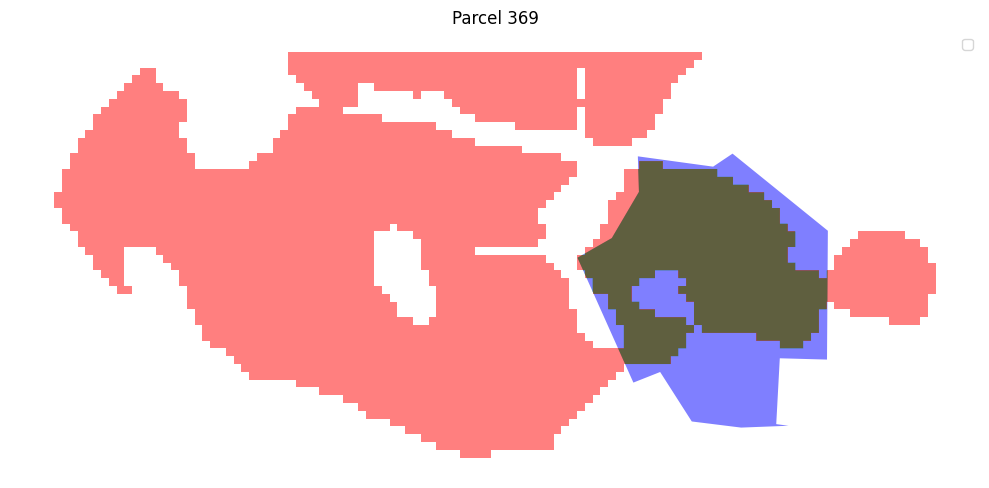

Parcel 369:
True Positive (Correctly predicted): 12237.89 m²
False Negative (Missed): 7198.74 m²
Adjusted IoU: 0.63


Overall Metrics:
Average Adjusted IoU: 0.81
Results saved to parcel_evaluation_results.csv
Updated original parcels saved to original_parcels_with_iou.gpkg


/tmp/ipykernel_29810/660839903.py:107: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Low-performing parcels saved to low_performing_parcels.gpkg


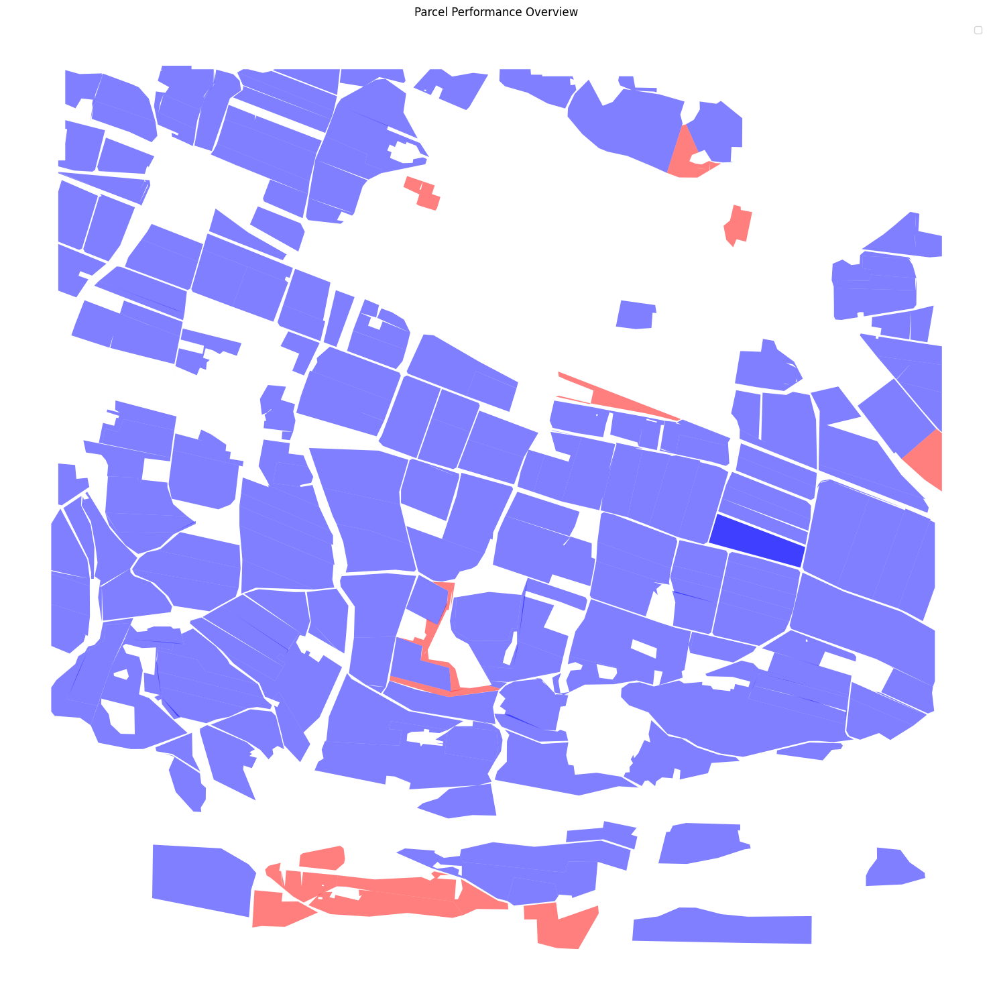

In [8]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

class ParcelEvaluator:
    def __init__(self, original_gdf_path, predicted_gdf_path):
        self.original_gdf = self.load_gdf(original_gdf_path)
        self.original_gdf = self.original_gdf[self.original_gdf.area > 5000]
        self.predicted_gdf = self.load_gdf(predicted_gdf_path)
        
        if self.original_gdf.crs != self.predicted_gdf.crs:
            self.predicted_gdf = self.predicted_gdf.to_crs(self.original_gdf.crs)

    def load_gdf(self, path):
        return gpd.read_file(path)

    def calculate_overlap(self, original_polygon, predicted_polygons):
        if predicted_polygons.empty:
            return 0, original_polygon.area
        
        intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]), 
                                   predicted_polygons, how='intersection')
        true_positive = intersection.area.sum()
        false_negative = original_polygon.area - true_positive
        return true_positive, false_negative

    def visualize_overlap(self, original_polygon, predicted_polygons, title):
        fig, ax = plt.subplots(figsize=(10, 10))
        
        gpd.GeoSeries([original_polygon]).plot(ax=ax, color='blue', alpha=0.5, label='Original')
        
        if not predicted_polygons.empty:
            predicted_polygons.plot(ax=ax, color='red', alpha=0.5, label='Predicted')
        
        intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]), 
                                   predicted_polygons, how='intersection')
        if not intersection.empty:
            intersection.plot(ax=ax, color='green', alpha=0.5, label='Overlap')
        
        ax.set_title(title)
        ax.legend()
        plt.axis('off')
        plt.tight_layout()
        plt.show()

    def evaluate_parcels(self):
        results = []

        for idx, original_row in self.original_gdf.iterrows():
            original_polygon = original_row.geometry
            
            intersecting_predictions = self.predicted_gdf[self.predicted_gdf.intersects(original_polygon)]
            
            true_positive, false_negative = self.calculate_overlap(original_polygon, intersecting_predictions)
            
            self.visualize_overlap(original_polygon, intersecting_predictions, f"Parcel {idx}")
            
            adjusted_iou = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0
            
            results.append({
                'Parcel ID': idx,
                'True Positive': true_positive,
                'False Negative': false_negative,
                'Adjusted IoU': adjusted_iou
            })
            
            print(f"Parcel {idx}:")
            print(f"True Positive (Correctly predicted): {true_positive:.2f} m²")
            print(f"False Negative (Missed): {false_negative:.2f} m²")
            print(f"Adjusted IoU: {adjusted_iou:.2f}")
            print("\n")

        results_df = pd.DataFrame(results)
        results_df.set_index('Parcel ID', inplace=True)
        
        print("Overall Metrics:")
        print(f"Average Adjusted IoU: {results_df['Adjusted IoU'].mean():.2f}")
        
        results_df.to_csv("parcel_evaluation_results.csv")
        print("Results saved to parcel_evaluation_results.csv")

        return results_df

    def mark_low_performing_parcels(self, results_df):
        # Add IoU scores to original GeoDataFrame
        self.original_gdf['Adjusted IoU'] = results_df['Adjusted IoU']
        
        # Mark low-performing parcels
        self.original_gdf['Low Performing'] = self.original_gdf['Adjusted IoU'] <= 0.5
        
        # Create a separate GeoDataFrame for low-performing parcels
        low_performing_gdf = self.original_gdf[self.original_gdf['Low Performing']]
        
        # Save the updated original GeoDataFrame
        self.original_gdf.to_file("original_parcels_with_iou.gpkg", driver="GPKG")
        print("Updated original parcels saved to original_parcels_with_iou.gpkg")
        
        # Save the low-performing parcels GeoDataFrame
        low_performing_gdf.to_file("low_performing_parcels.gpkg", driver="GPKG")
        print("Low-performing parcels saved to low_performing_parcels.gpkg")
        
        # Visualize all parcels with color-coding
        fig, ax = plt.subplots(figsize=(15, 15))
        self.original_gdf[~self.original_gdf['Low Performing']].plot(ax=ax, color='blue', alpha=0.5, label='Good Performance (IoU > 0.5)')
        self.original_gdf[self.original_gdf['Low Performing']].plot(ax=ax, color='red', alpha=0.5, label='Low Performance (IoU ≤ 0.5)')
        ax.set_title("Parcel Performance Overview")
        ax.legend()
        plt.axis('off')
        plt.tight_layout()
        plt.show()

# Usage
evaluator = ParcelEvaluator("/workspaces/Satelite/data/parcels/ZH_ZH_parcel_2.gpkg",
                            "/workspaces/Satelite/data/experiment/predictions/ZH_ZH_parcel_2.gpkg")
results = evaluator.evaluate_parcels()
evaluator.mark_low_performing_parcels(results)

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

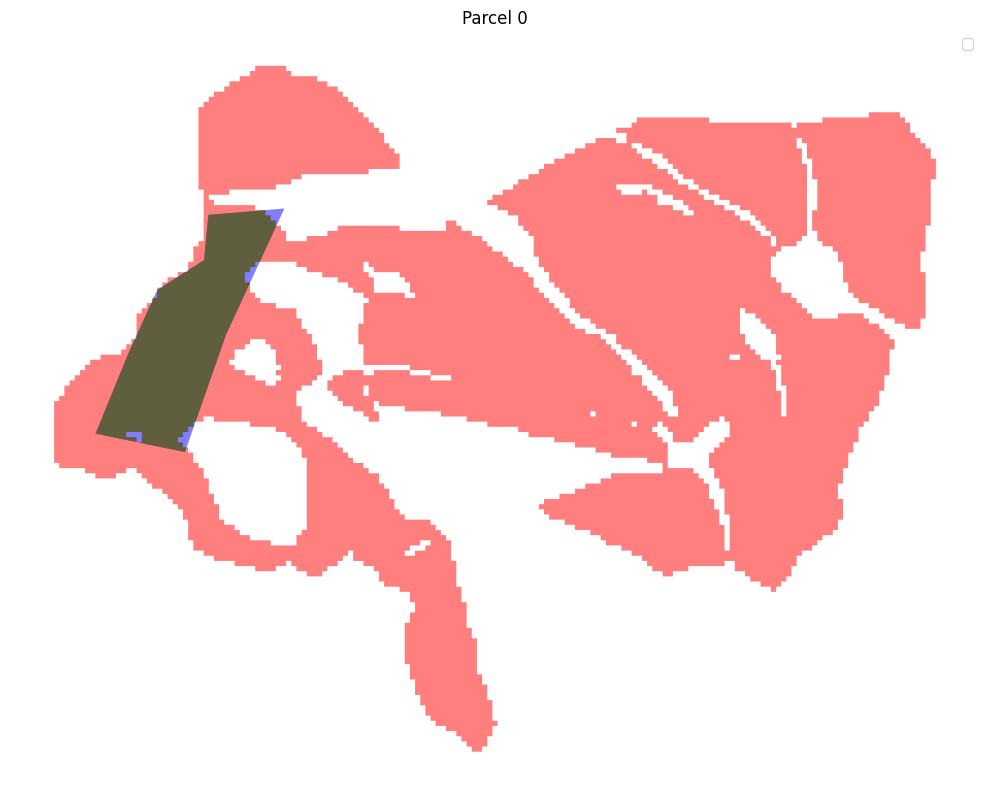

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 0:
True Positive (Correctly predicted): 17716.30 m²
False Negative (Missed): 538.99 m²
Adjusted IoU: 0.97




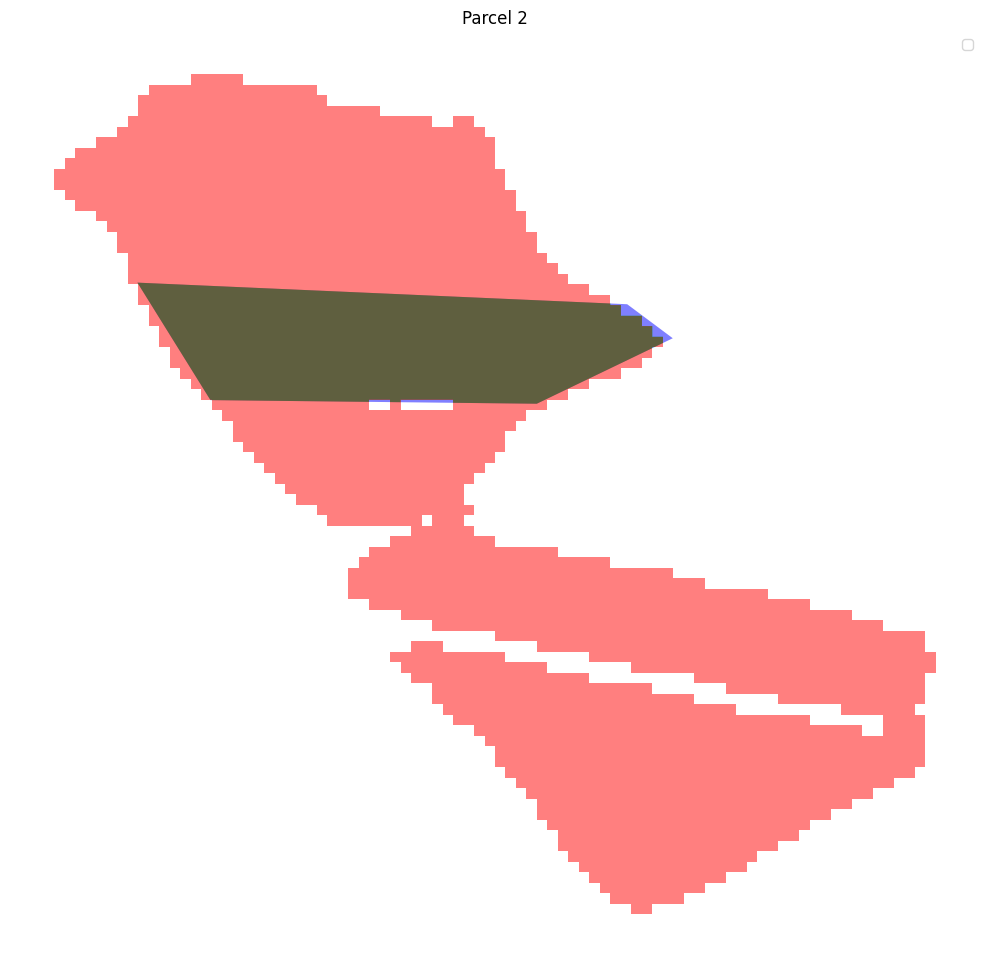

Parcel 2:
True Positive (Correctly predicted): 10791.03 m²
False Negative (Missed): 138.19 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

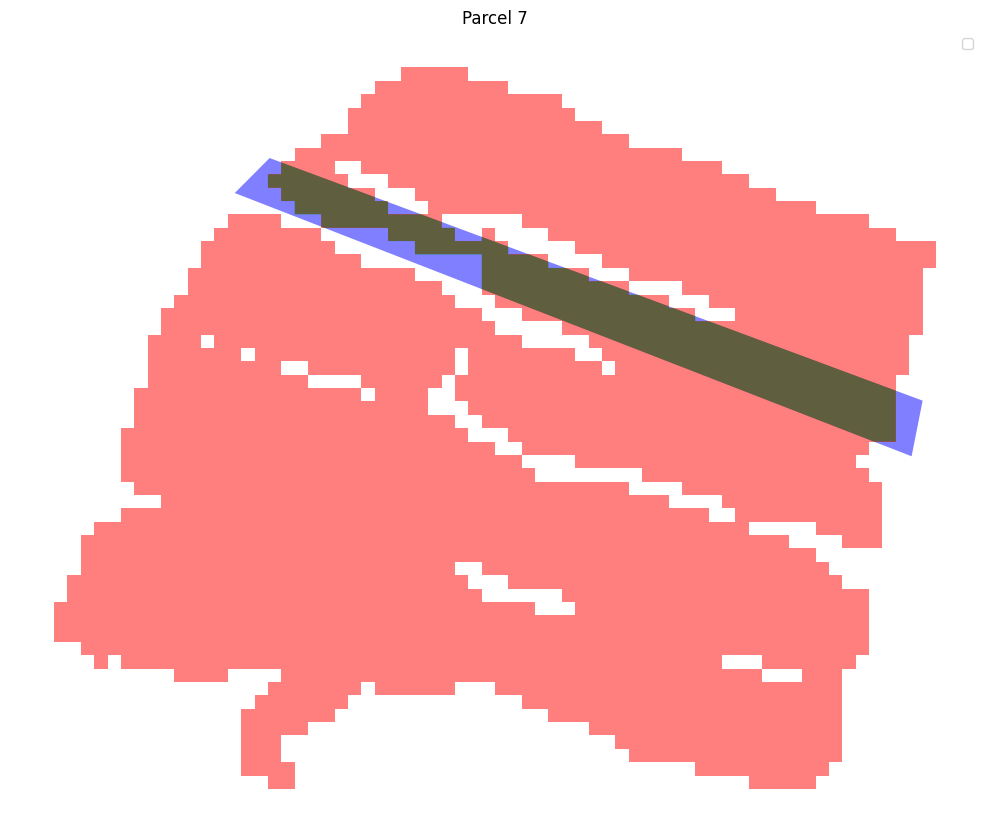

Parcel 7:
True Positive (Correctly predicted): 4138.29 m²
False Negative (Missed): 891.84 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

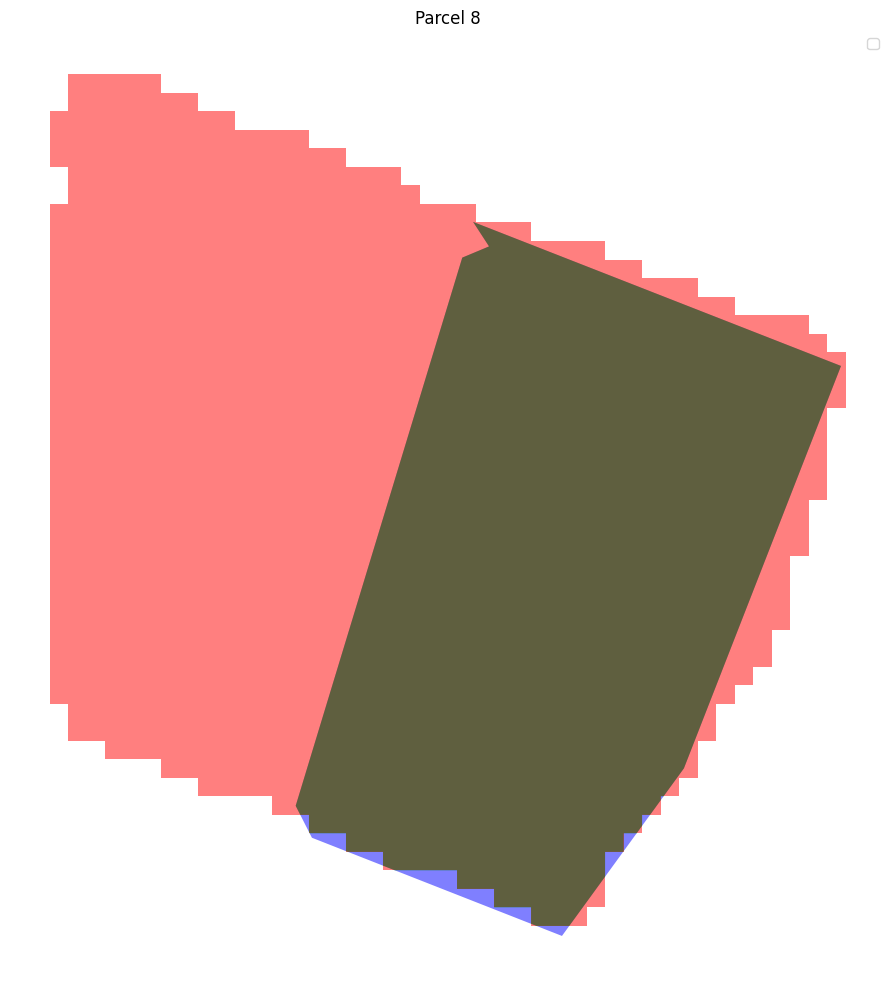

Parcel 8:
True Positive (Correctly predicted): 16455.67 m²
False Negative (Missed): 206.51 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

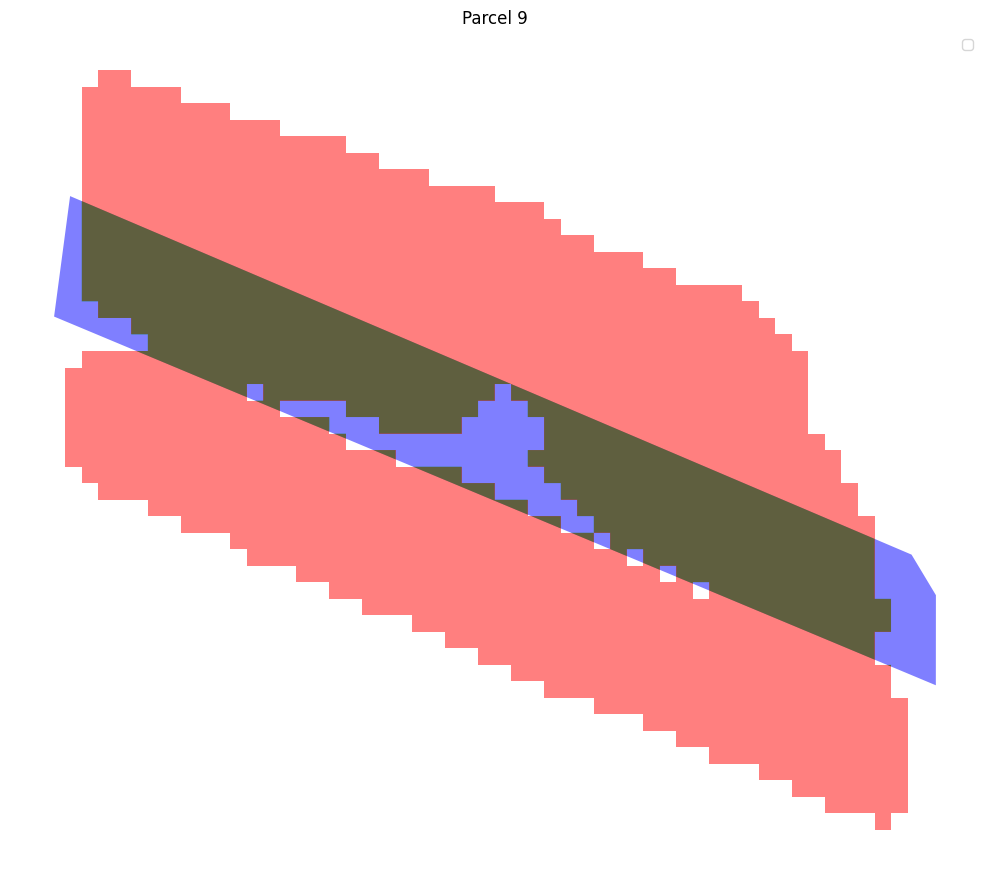

Parcel 9:
True Positive (Correctly predicted): 7609.54 m²
False Negative (Missed): 2265.06 m²
Adjusted IoU: 0.77




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

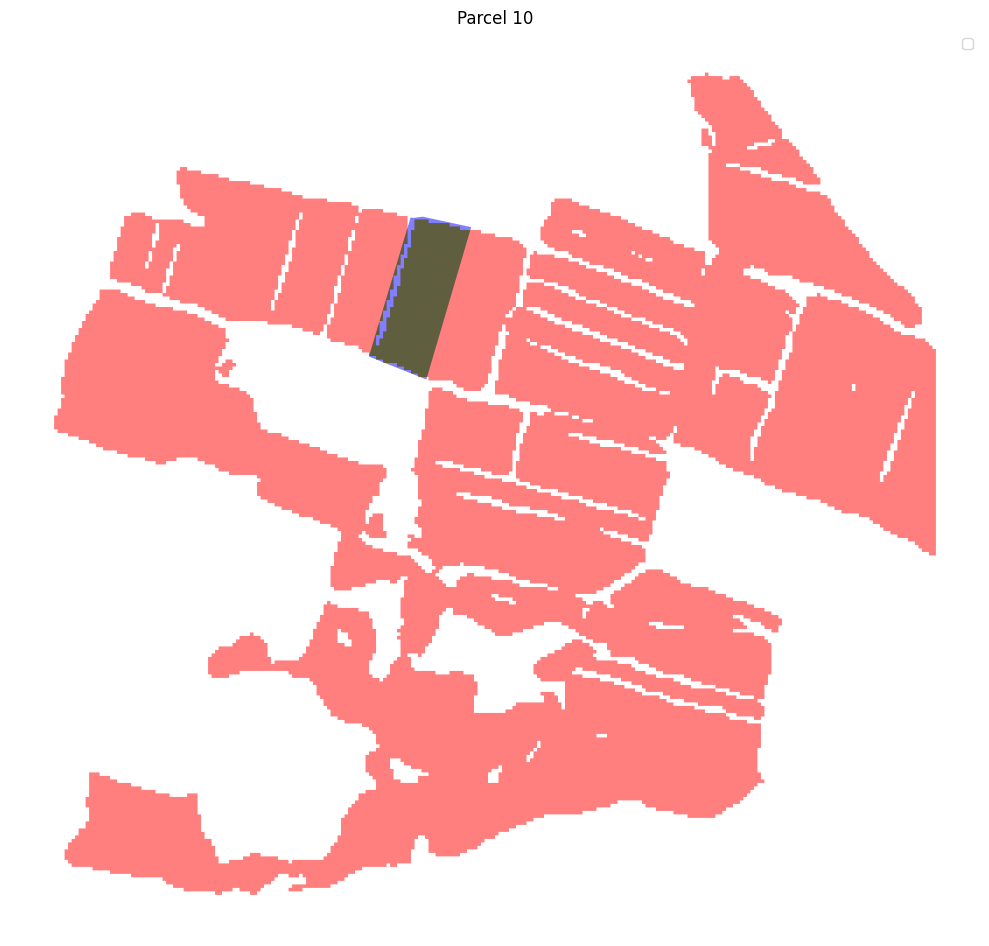

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 10:
True Positive (Correctly predicted): 17209.98 m²
False Negative (Missed): 1916.36 m²
Adjusted IoU: 0.90




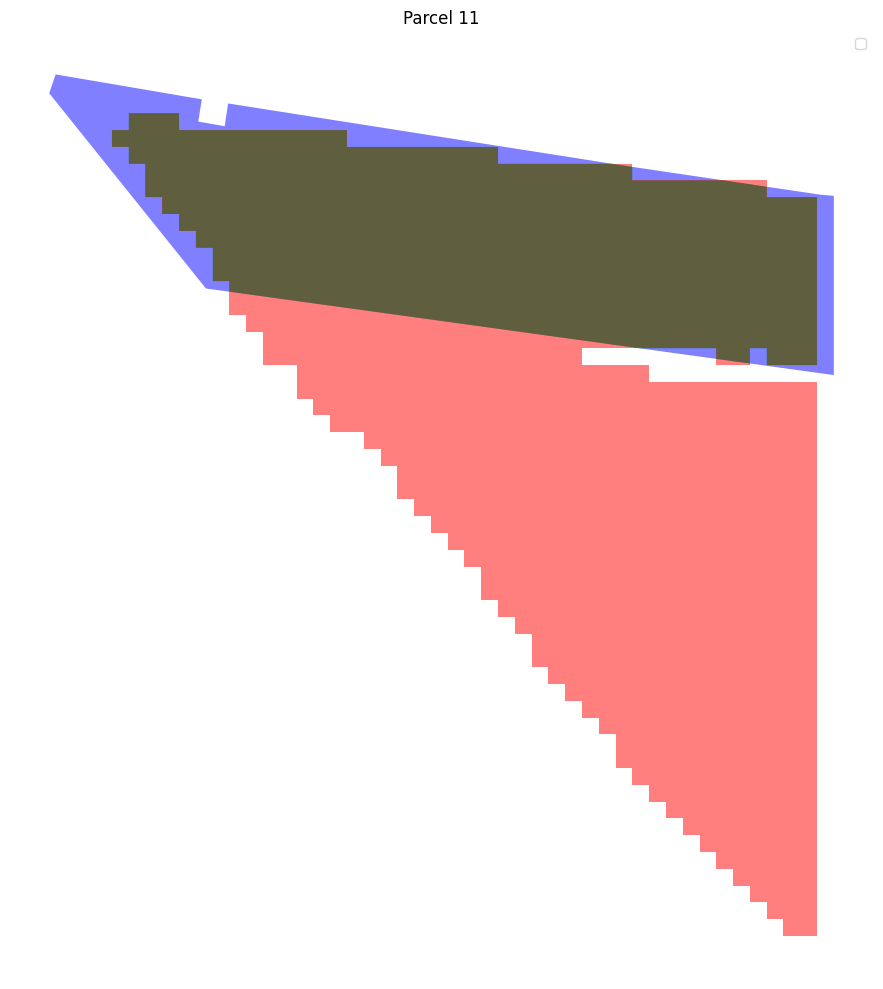

Parcel 11:
True Positive (Correctly predicted): 9842.61 m²
False Negative (Missed): 1727.57 m²
Adjusted IoU: 0.85




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

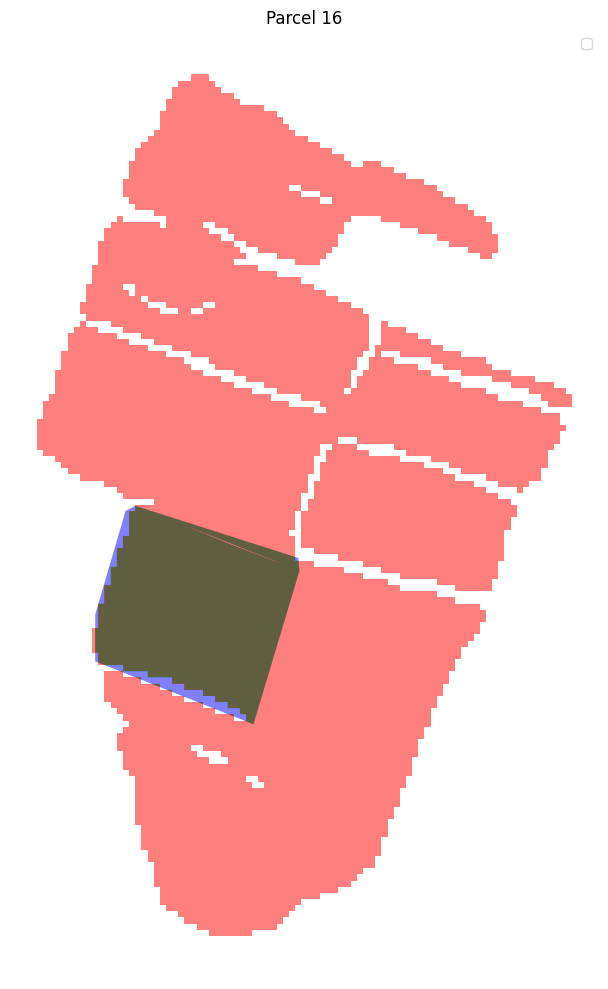

Parcel 16:
True Positive (Correctly predicted): 18649.50 m²
False Negative (Missed): 1141.13 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

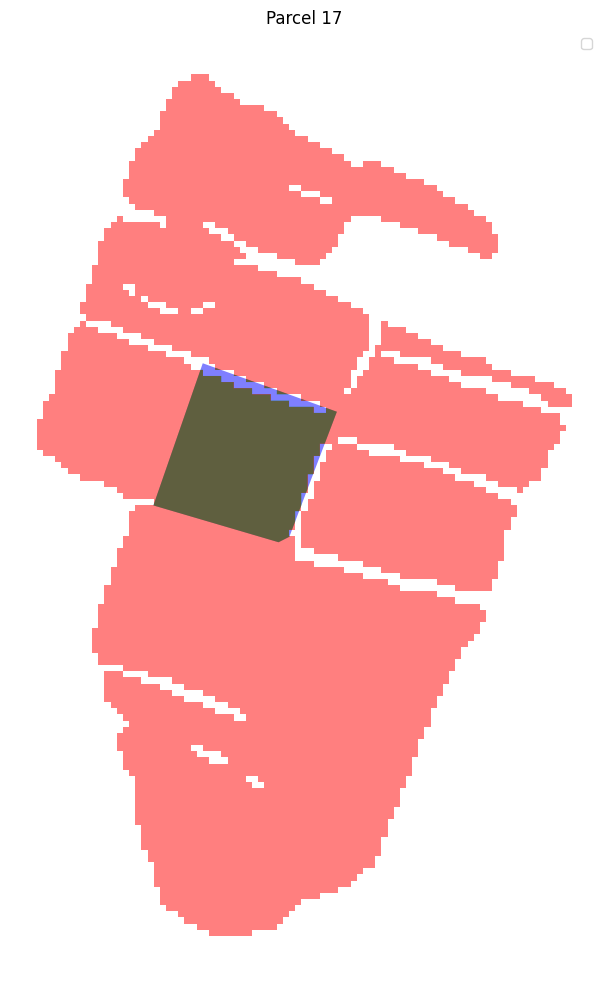

Parcel 17:
True Positive (Correctly predicted): 12715.59 m²
False Negative (Missed): 826.72 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

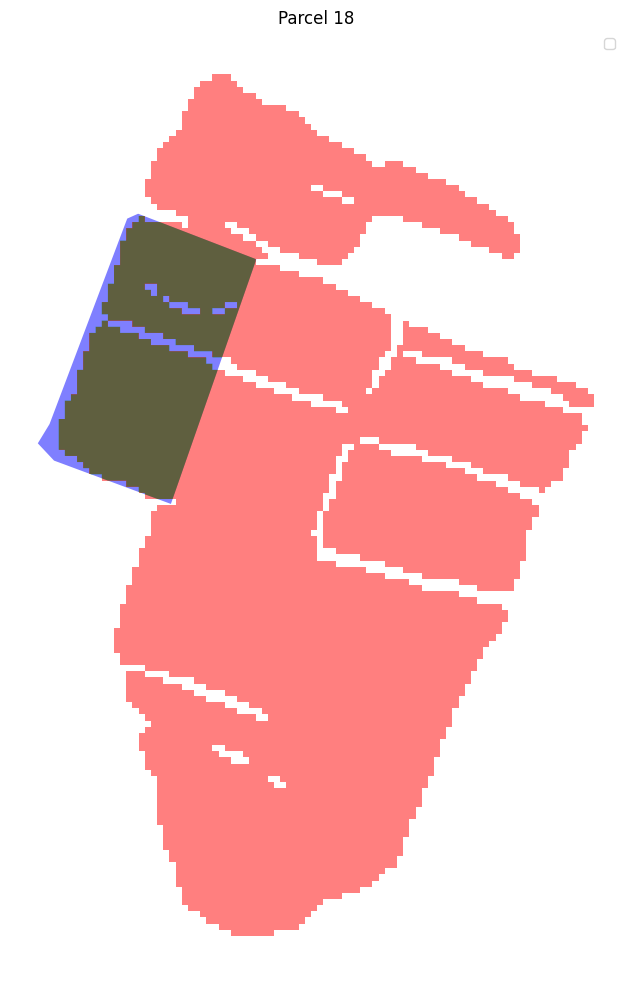

Parcel 18:
True Positive (Correctly predicted): 20744.32 m²
False Negative (Missed): 2975.70 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

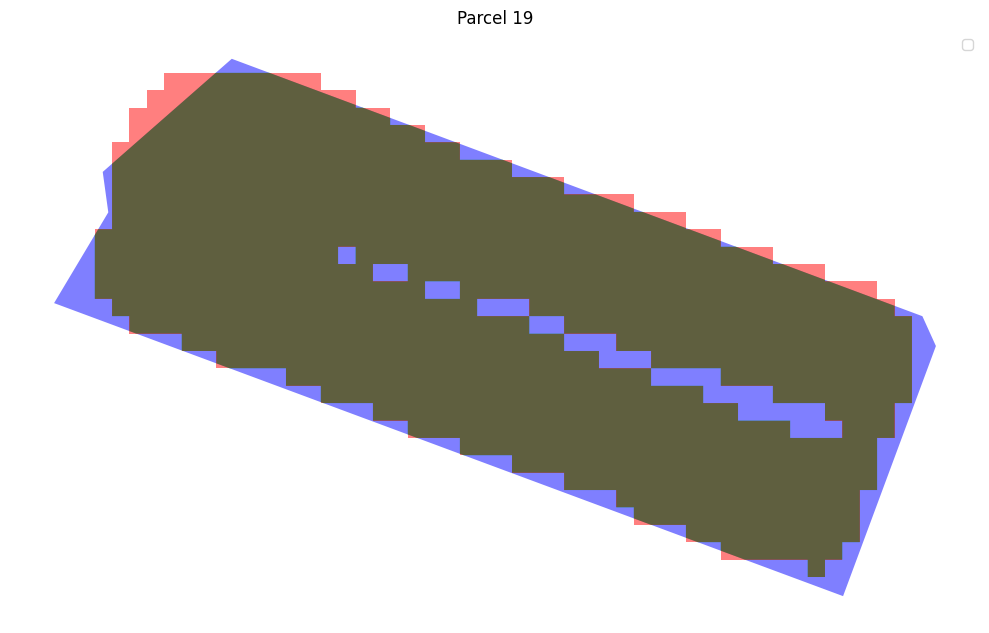

Parcel 19:
True Positive (Correctly predicted): 17595.80 m²
False Negative (Missed): 1978.11 m²
Adjusted IoU: 0.90




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

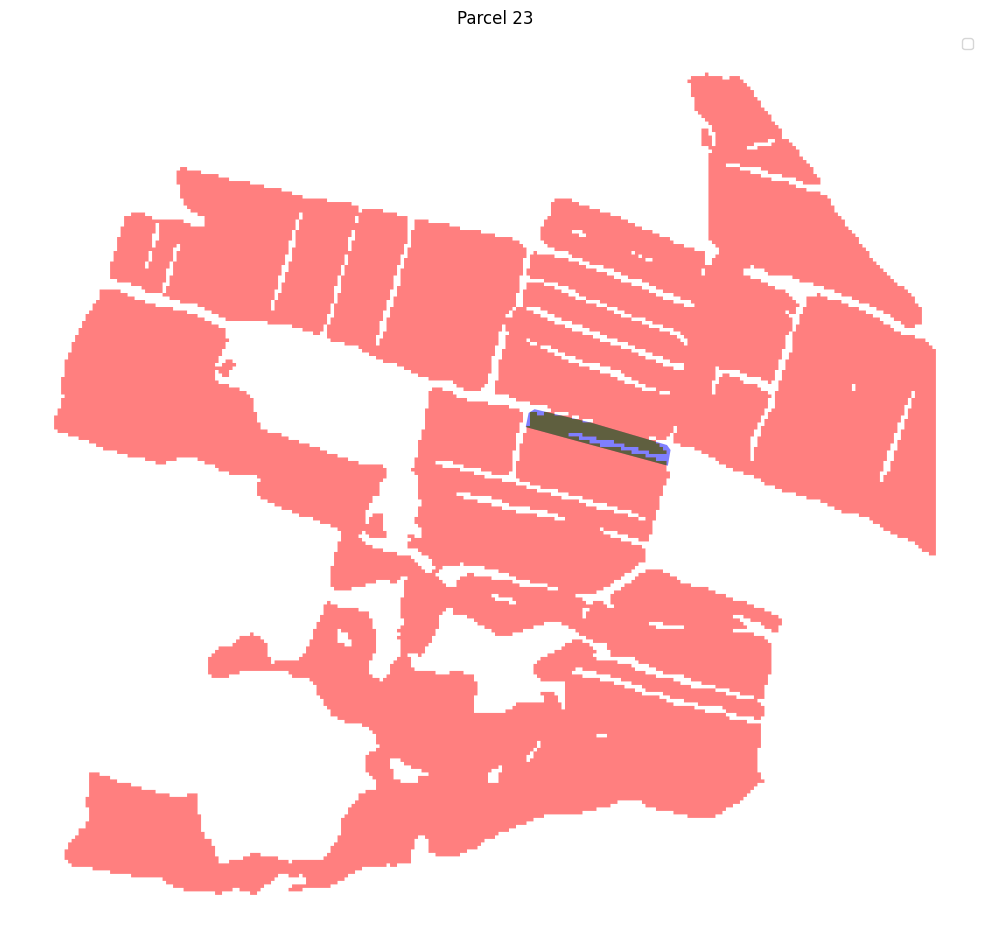

Parcel 23:
True Positive (Correctly predicted): 4651.41 m²
False Negative (Missed): 1439.07 m²
Adjusted IoU: 0.76




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

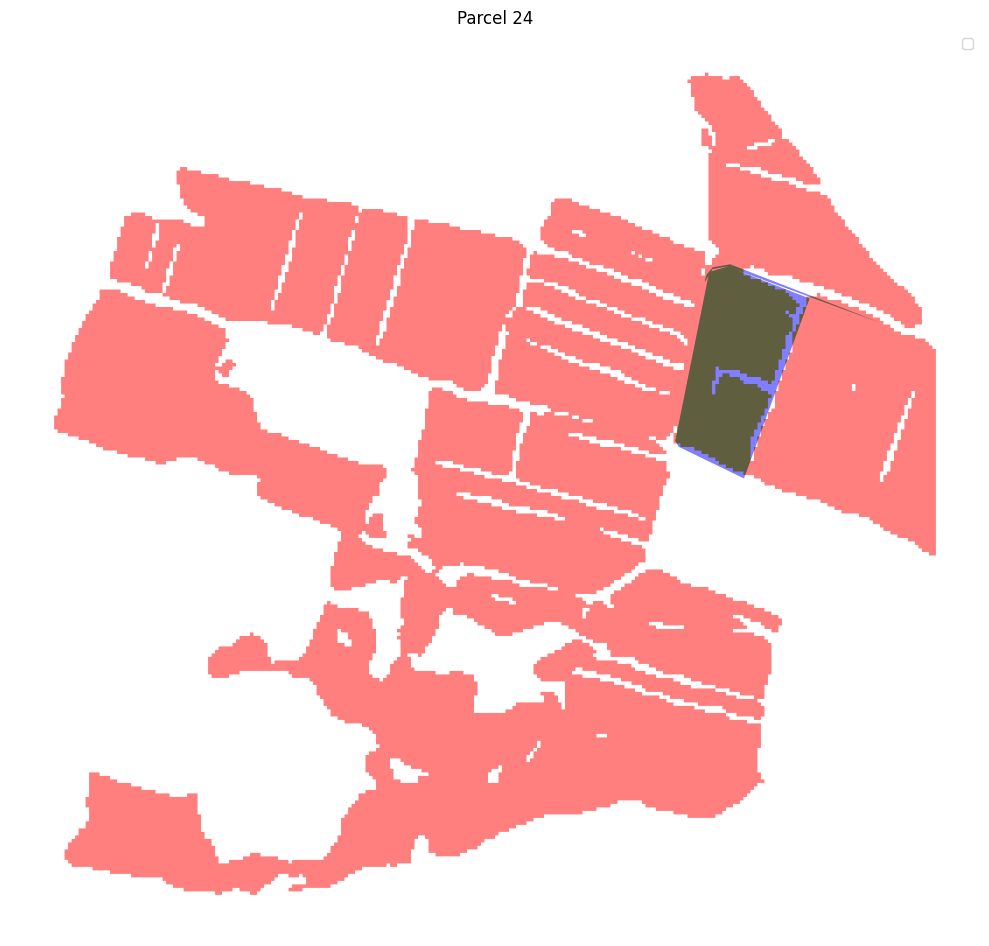

Parcel 24:
True Positive (Correctly predicted): 31072.11 m²
False Negative (Missed): 4194.83 m²
Adjusted IoU: 0.88




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

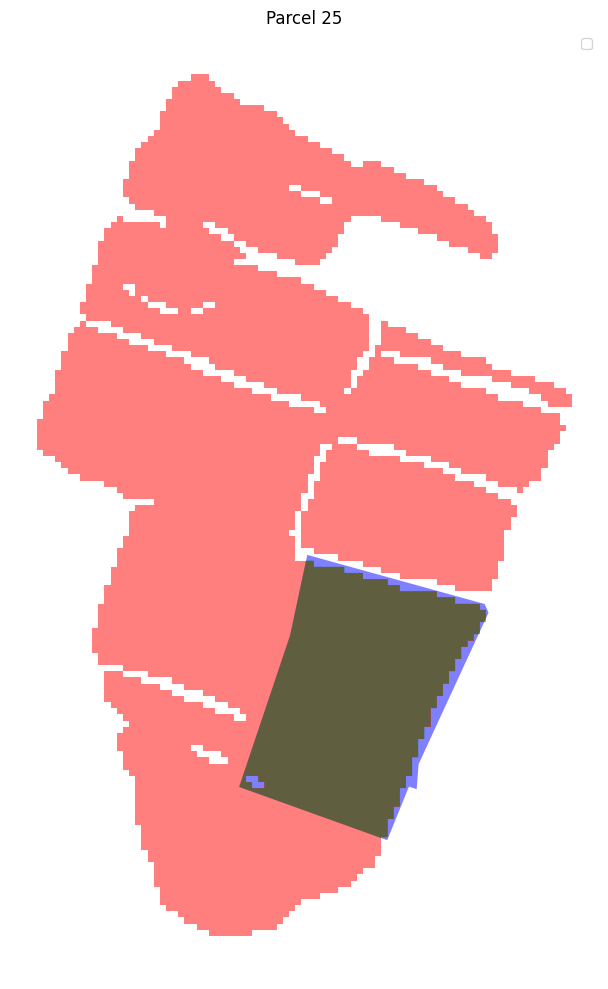

Parcel 25:
True Positive (Correctly predicted): 26116.17 m²
False Negative (Missed): 1781.68 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

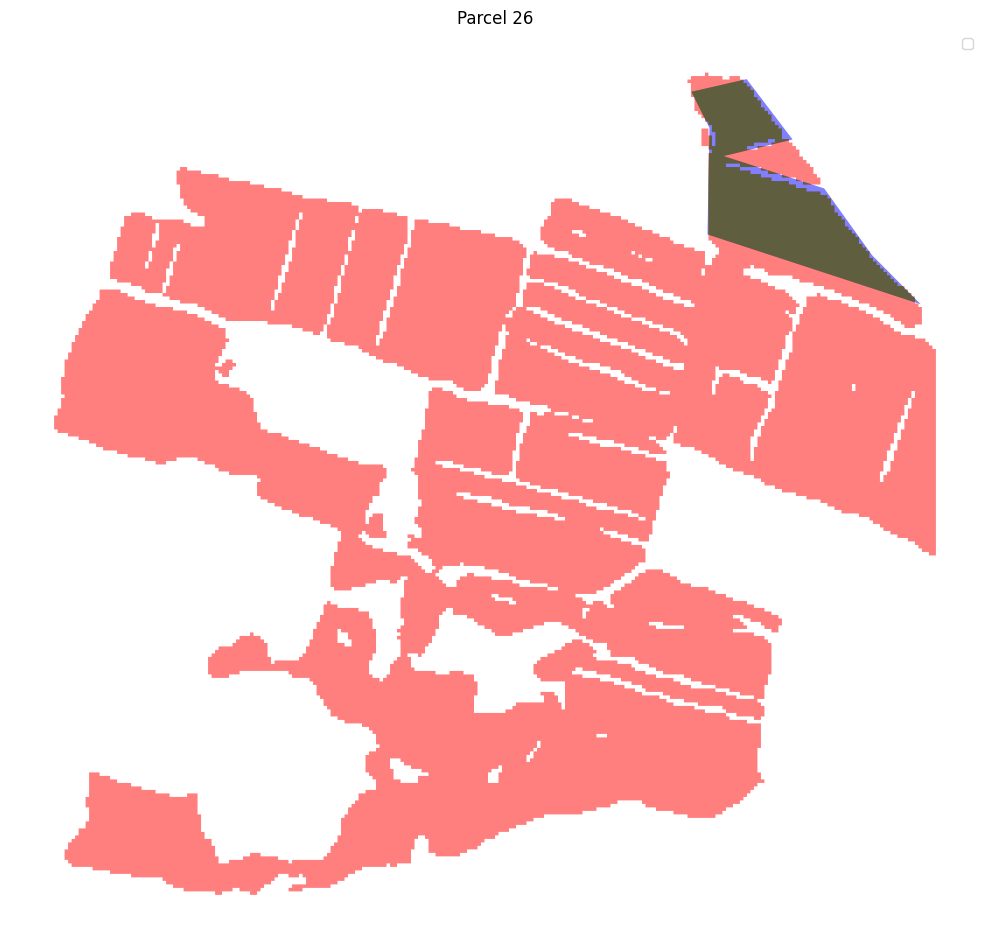

Parcel 26:
True Positive (Correctly predicted): 33805.72 m²
False Negative (Missed): 2837.69 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

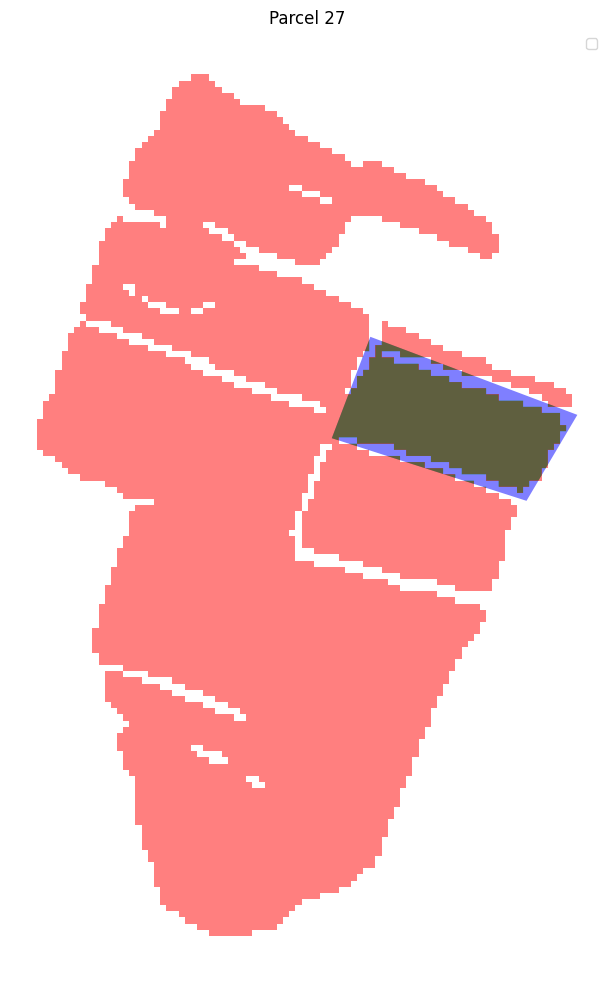

Parcel 27:
True Positive (Correctly predicted): 11771.49 m²
False Negative (Missed): 2725.29 m²
Adjusted IoU: 0.81




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

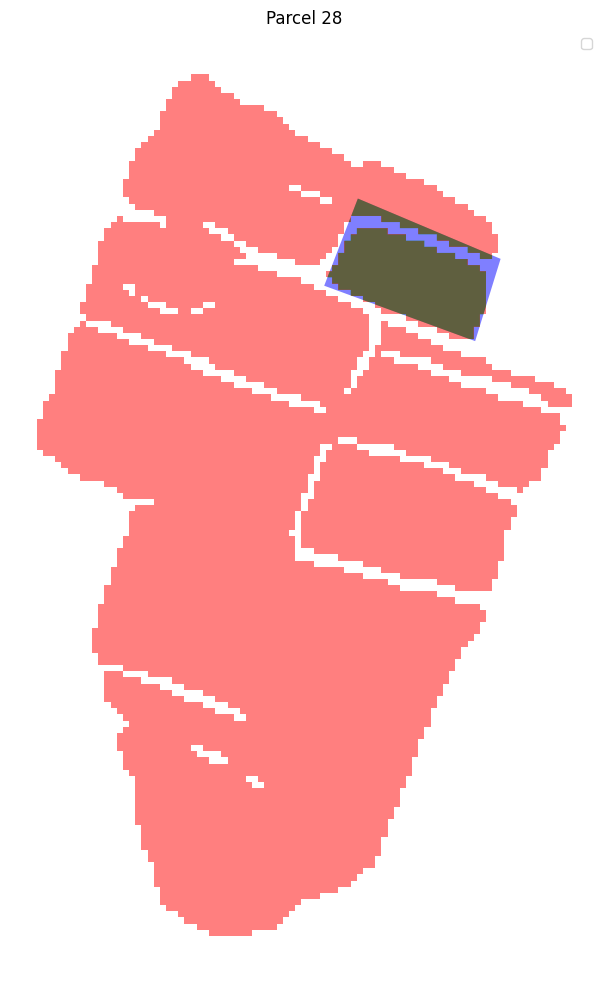

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 28:
True Positive (Correctly predicted): 7768.34 m²
False Negative (Missed): 1571.22 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


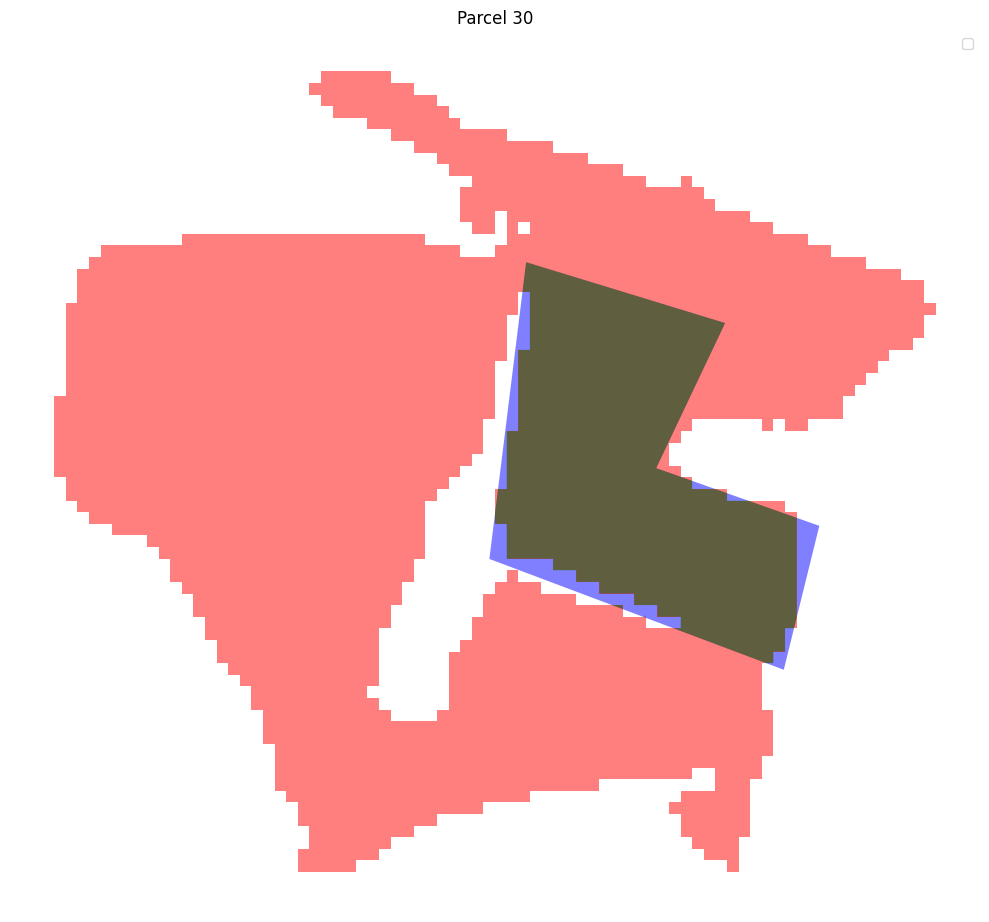

Parcel 30:
True Positive (Correctly predicted): 12768.88 m²
False Negative (Missed): 1154.21 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

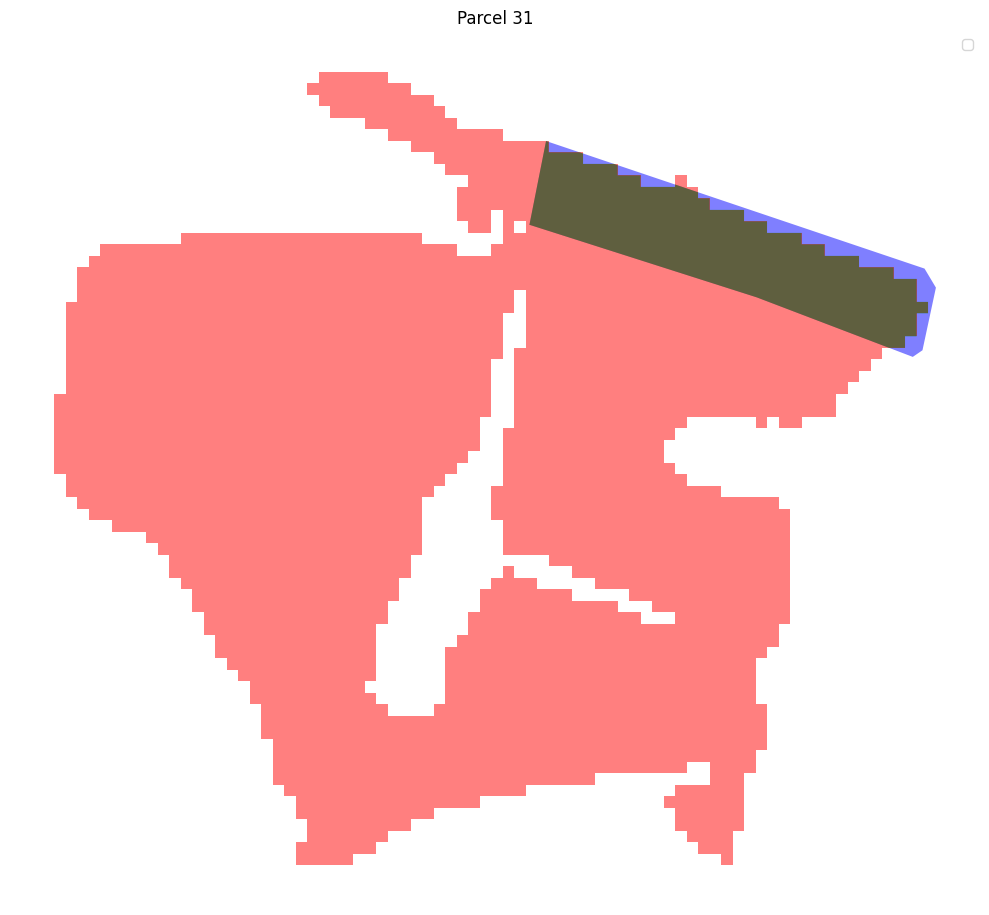

Parcel 31:
True Positive (Correctly predicted): 5622.47 m²
False Negative (Missed): 876.58 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

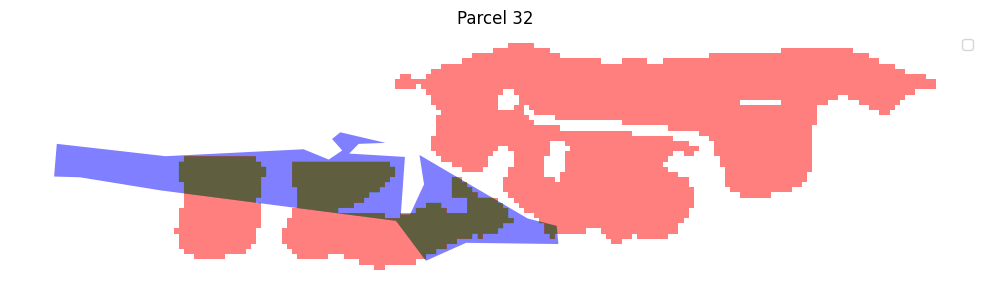

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 32:
True Positive (Correctly predicted): 11261.47 m²
False Negative (Missed): 11577.88 m²
Adjusted IoU: 0.49




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


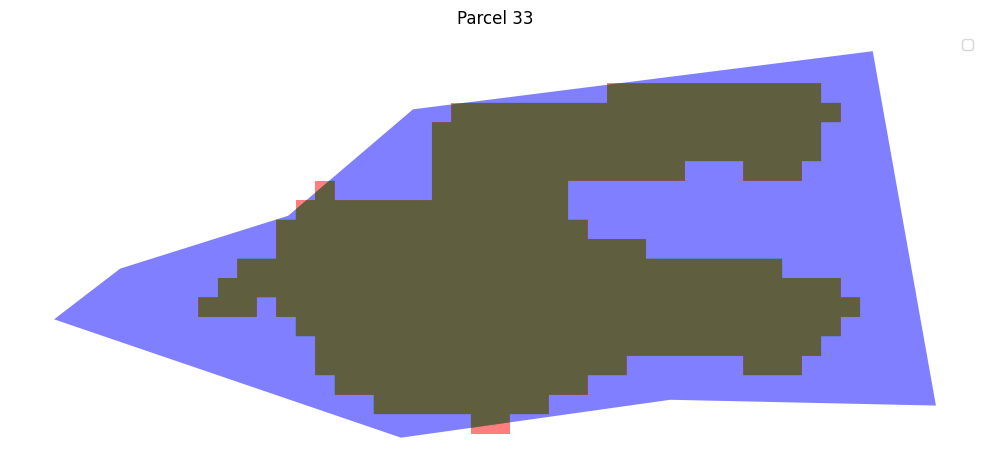

Parcel 33:
True Positive (Correctly predicted): 8317.76 m²
False Negative (Missed): 6153.49 m²
Adjusted IoU: 0.57




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

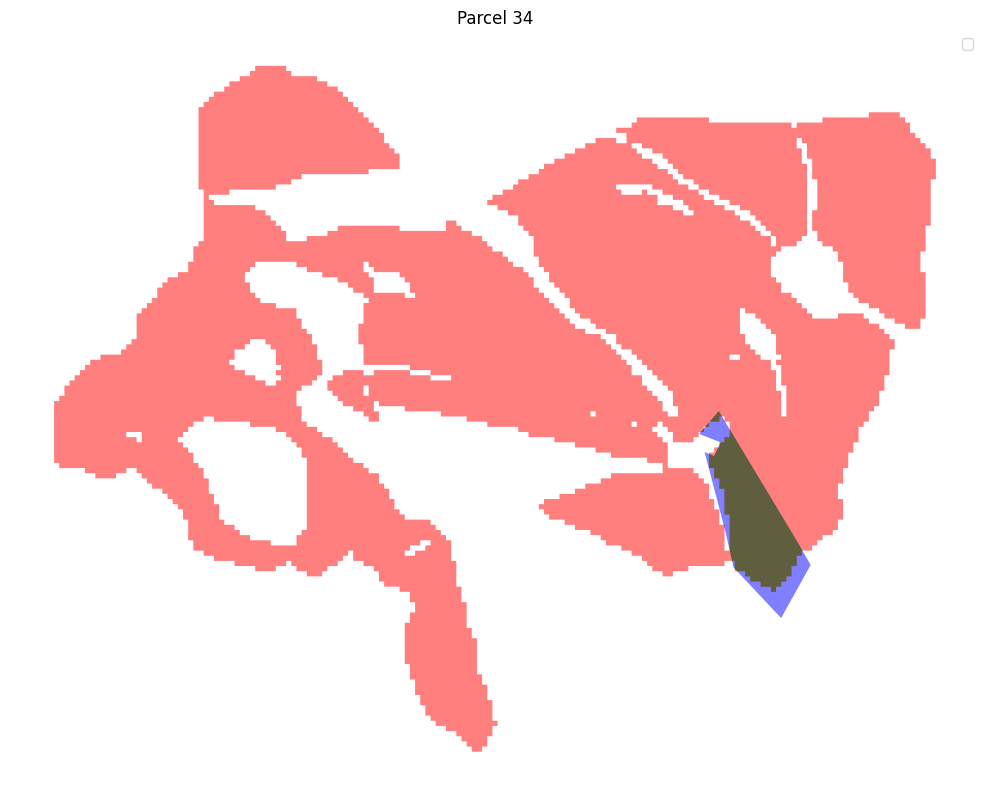

Parcel 34:
True Positive (Correctly predicted): 6787.35 m²
False Negative (Missed): 2087.26 m²
Adjusted IoU: 0.76




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

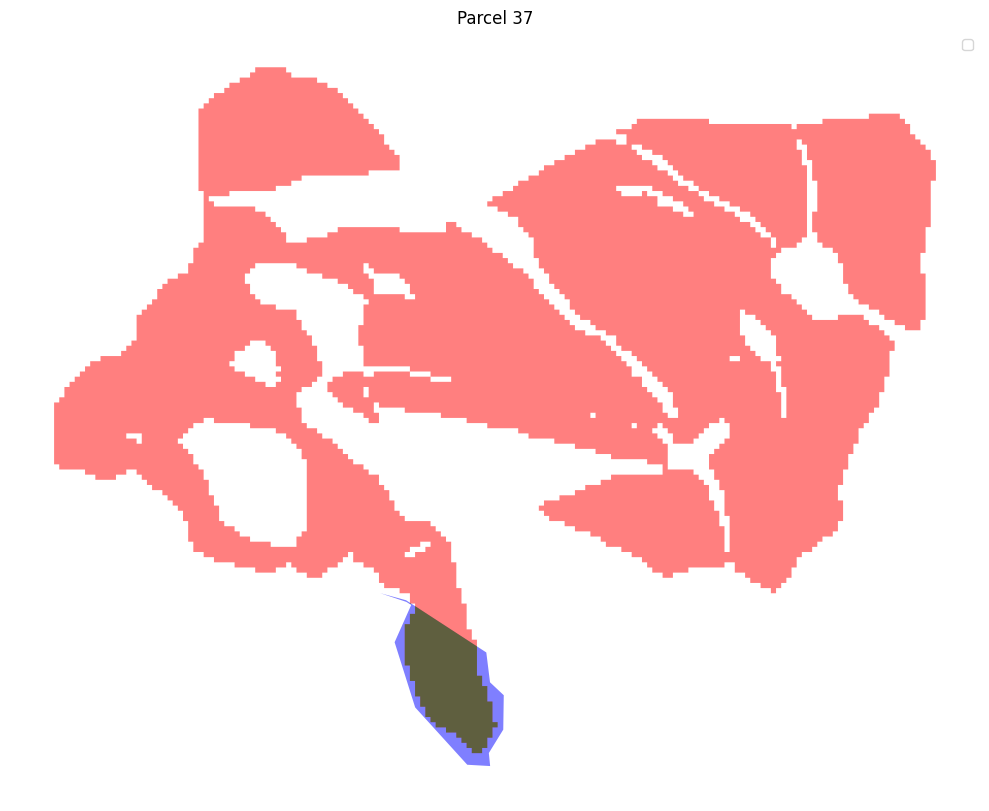

Parcel 37:
True Positive (Correctly predicted): 7356.17 m²
False Negative (Missed): 2381.13 m²
Adjusted IoU: 0.76




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

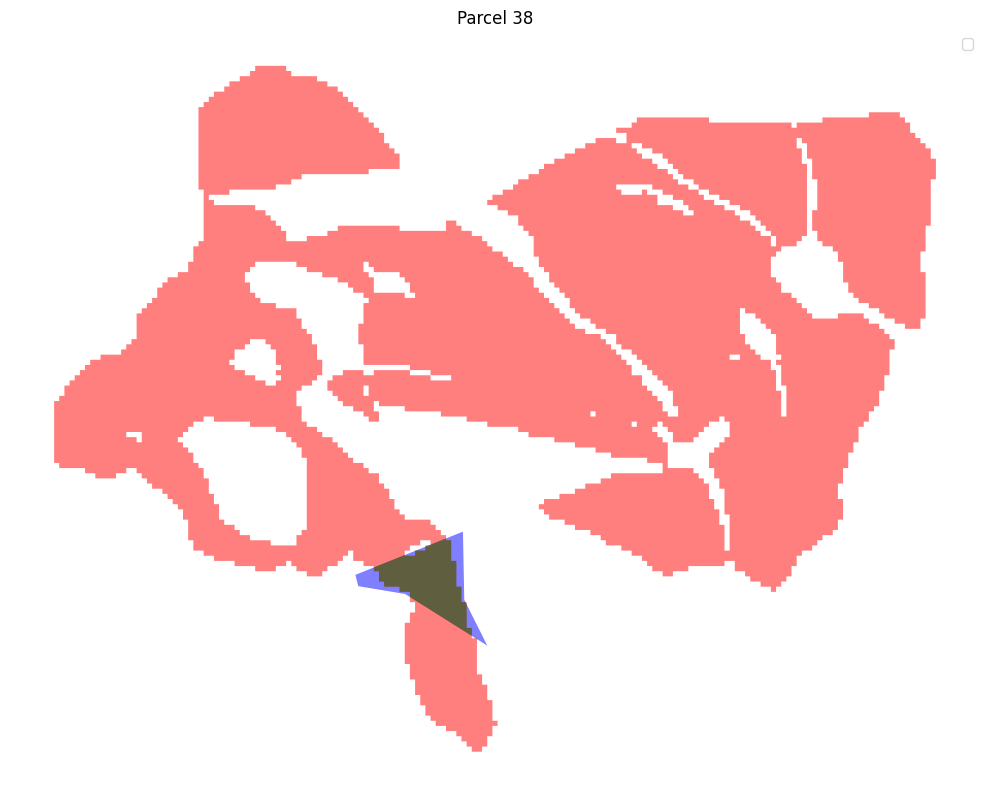

Parcel 38:
True Positive (Correctly predicted): 3999.51 m²
False Negative (Missed): 1318.61 m²
Adjusted IoU: 0.75




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

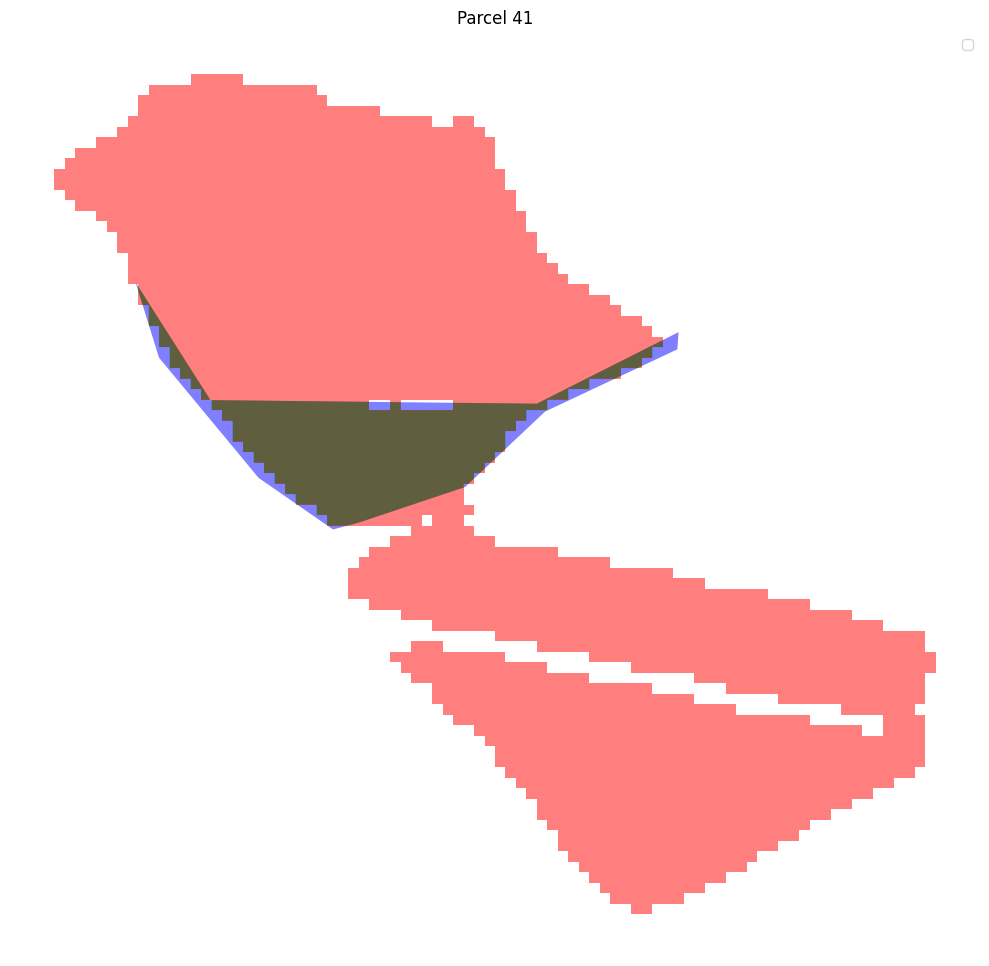

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 41:
True Positive (Correctly predicted): 6209.70 m²
False Negative (Missed): 959.04 m²
Adjusted IoU: 0.87




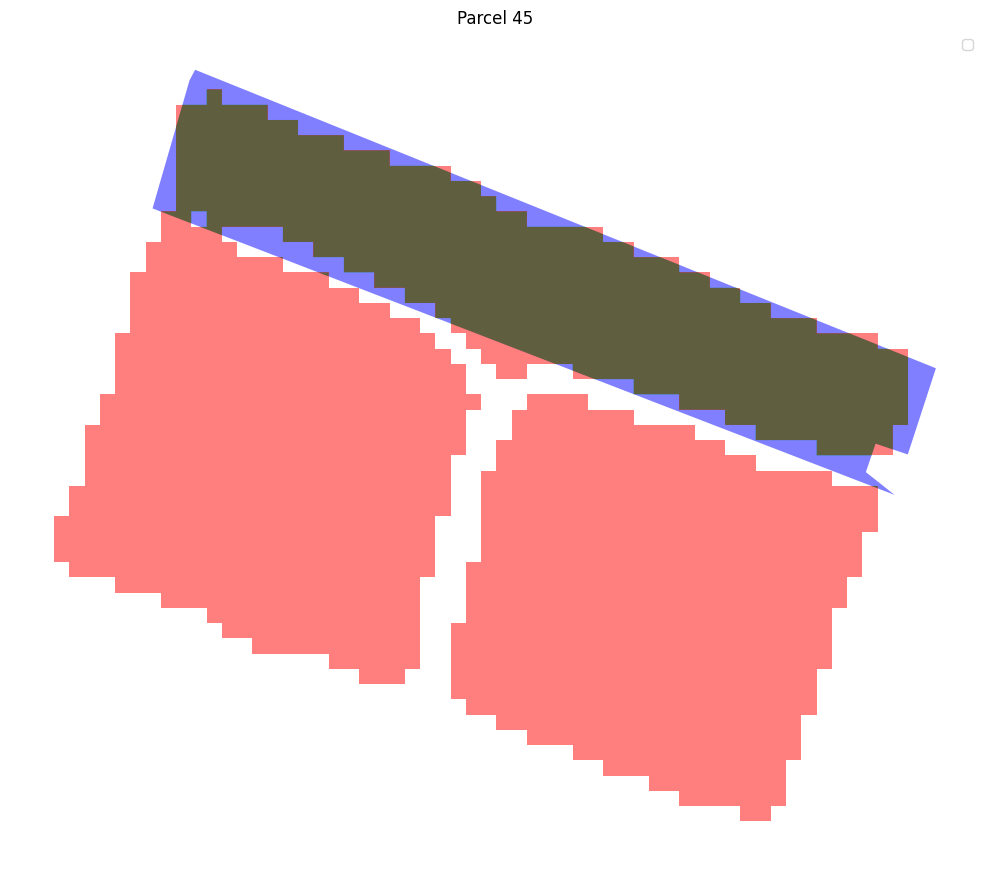

Parcel 45:
True Positive (Correctly predicted): 10035.91 m²
False Negative (Missed): 1739.25 m²
Adjusted IoU: 0.85




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

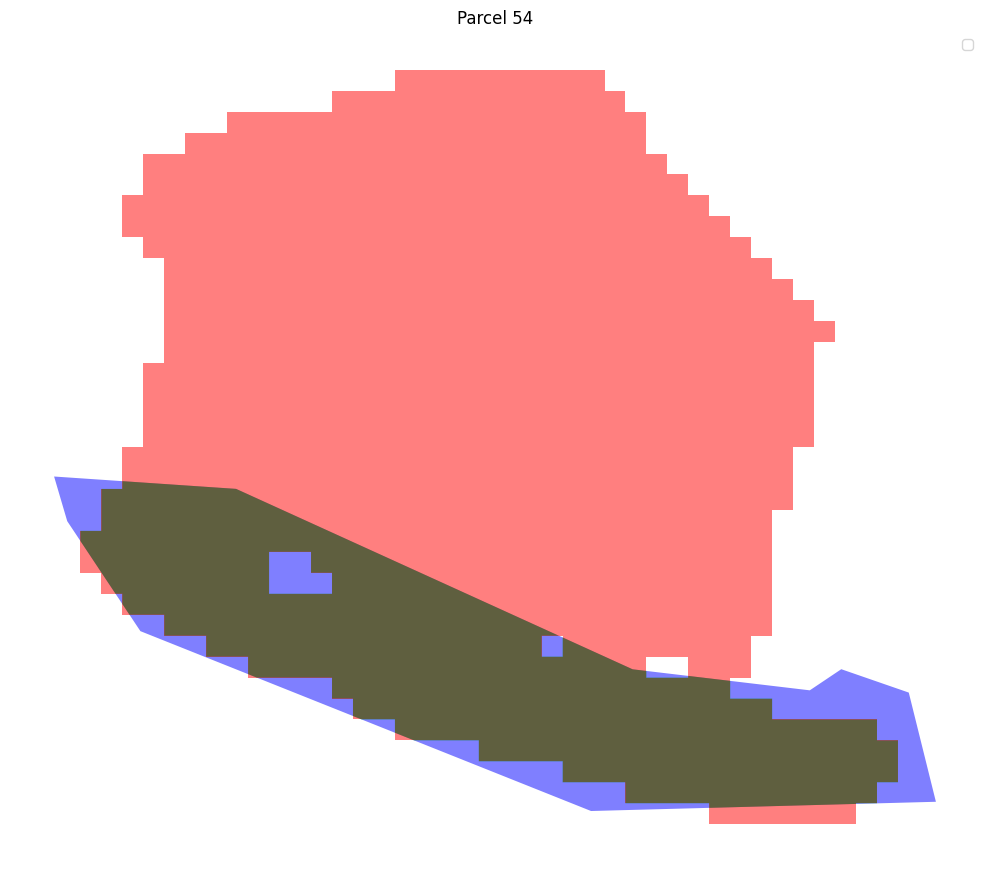

Parcel 54:
True Positive (Correctly predicted): 5931.74 m²
False Negative (Missed): 1249.26 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

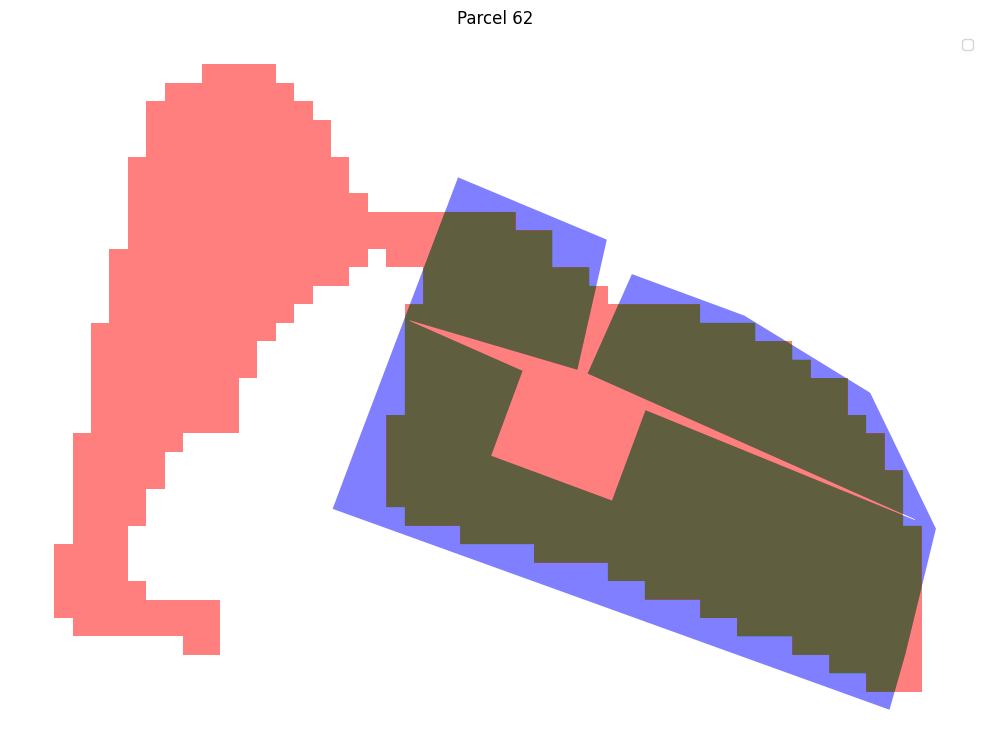

Parcel 62:
True Positive (Correctly predicted): 9565.67 m²
False Negative (Missed): 2196.63 m²
Adjusted IoU: 0.81




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

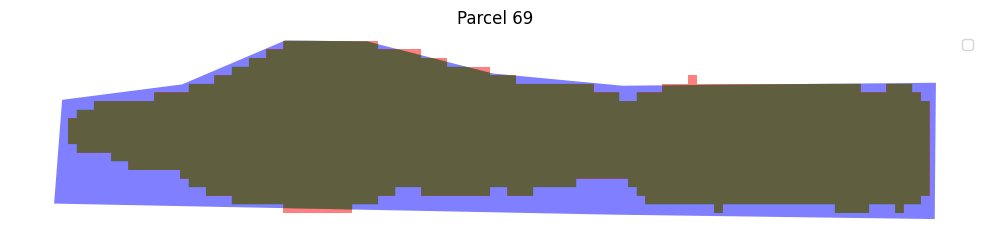

Parcel 69:
True Positive (Correctly predicted): 33712.98 m²
False Negative (Missed): 6984.19 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

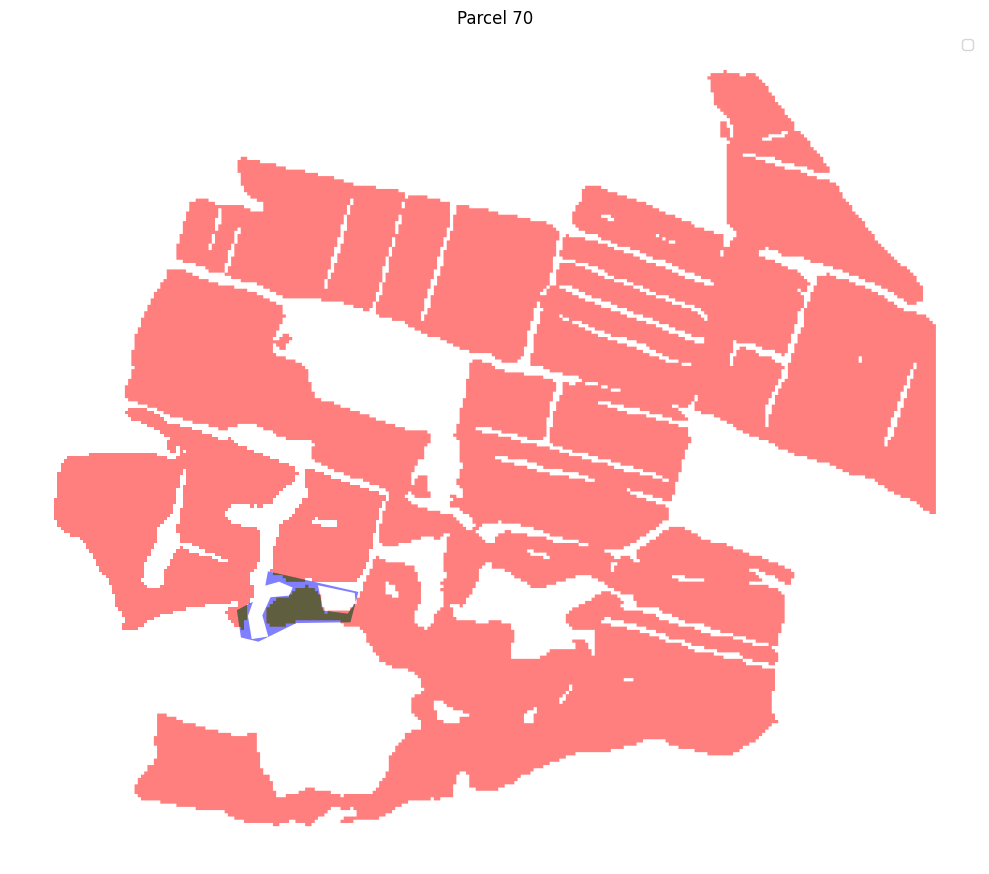

Parcel 70:
True Positive (Correctly predicted): 5134.98 m²
False Negative (Missed): 2701.60 m²
Adjusted IoU: 0.66




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

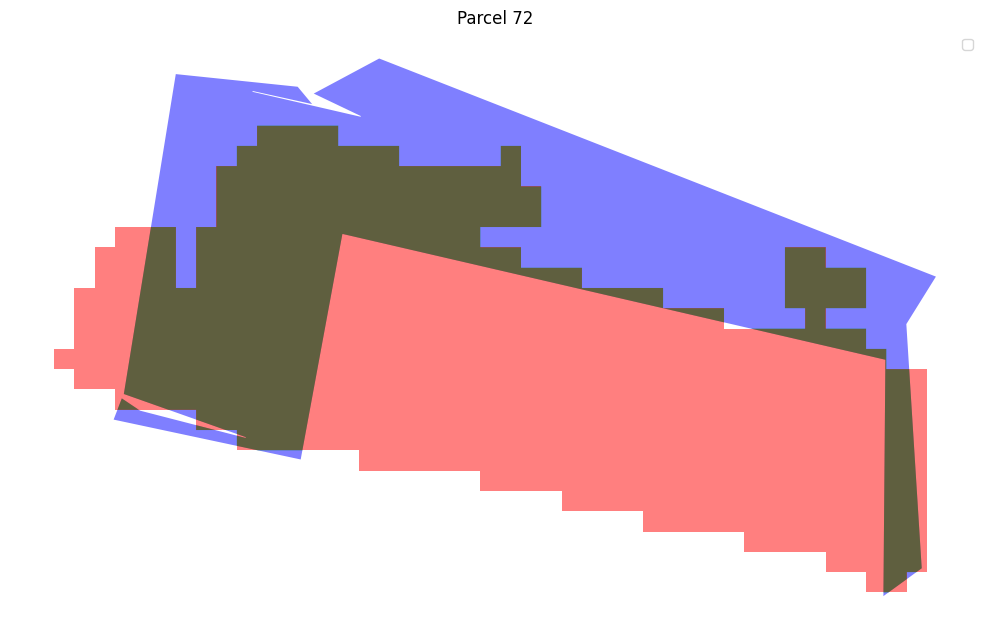

Parcel 72:
True Positive (Correctly predicted): 4898.70 m²
False Negative (Missed): 4452.99 m²
Adjusted IoU: 0.52




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

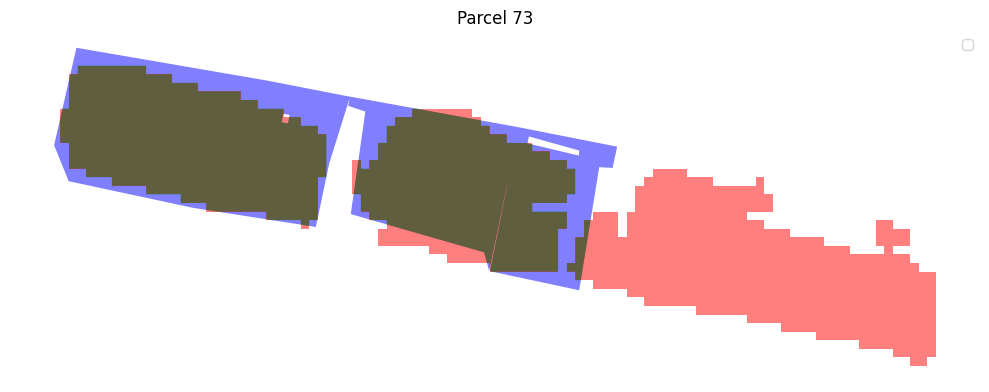

Parcel 73:
True Positive (Correctly predicted): 17883.32 m²
False Negative (Missed): 5388.07 m²
Adjusted IoU: 0.77




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


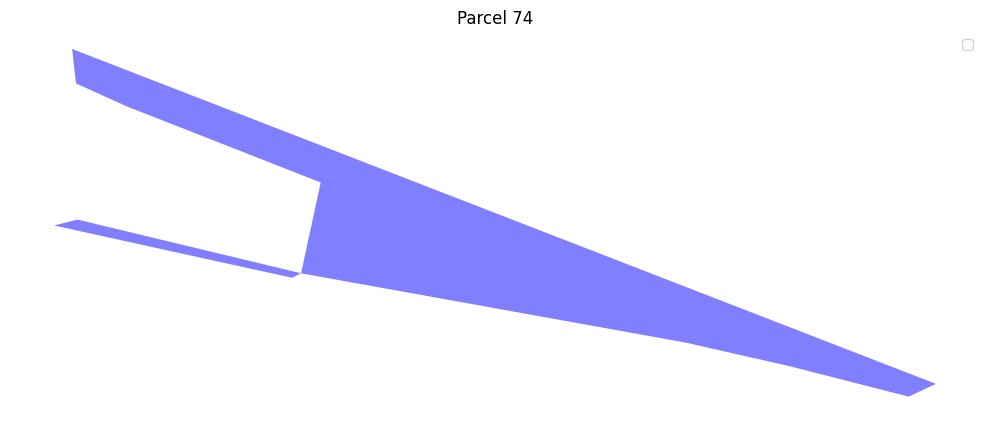

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 74:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 9043.76 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


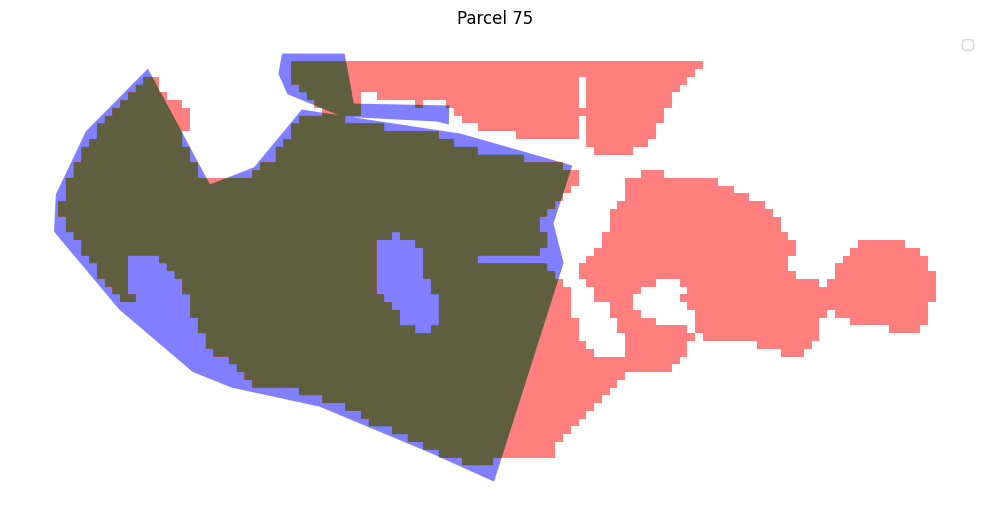

Parcel 75:
True Positive (Correctly predicted): 46072.39 m²
False Negative (Missed): 8664.37 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

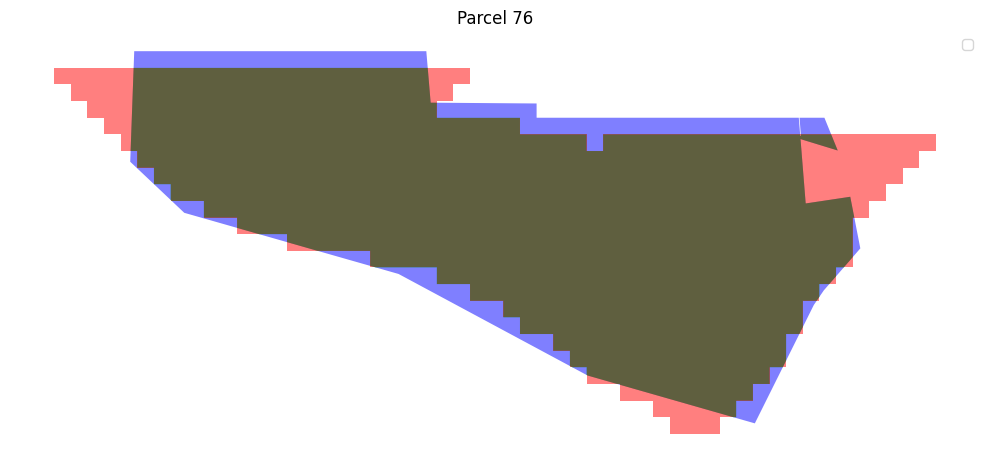

Parcel 76:
True Positive (Correctly predicted): 12466.34 m²
False Negative (Missed): 1601.95 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

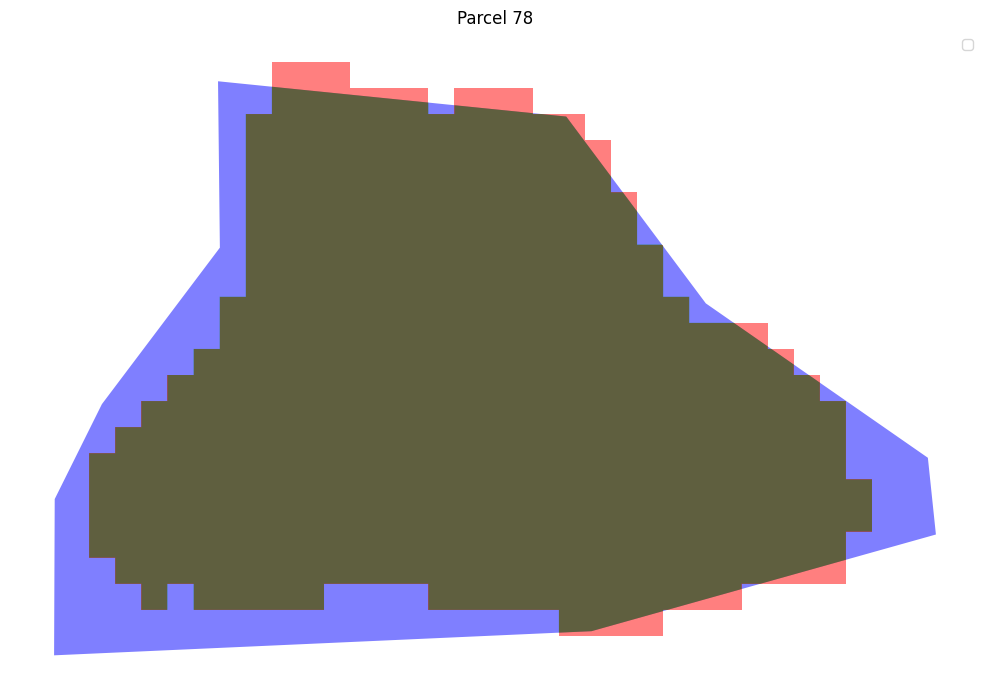

Parcel 78:
True Positive (Correctly predicted): 10283.98 m²
False Negative (Missed): 1994.19 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

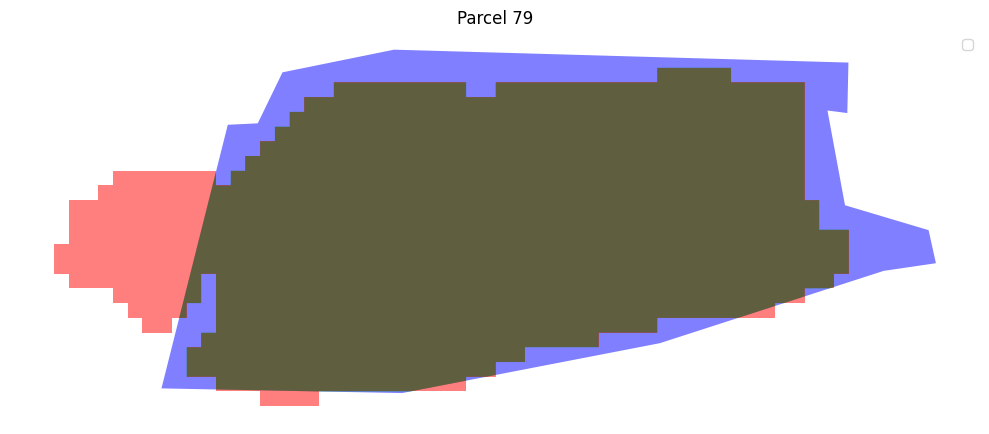

Parcel 79:
True Positive (Correctly predicted): 18703.10 m²
False Negative (Missed): 3882.91 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

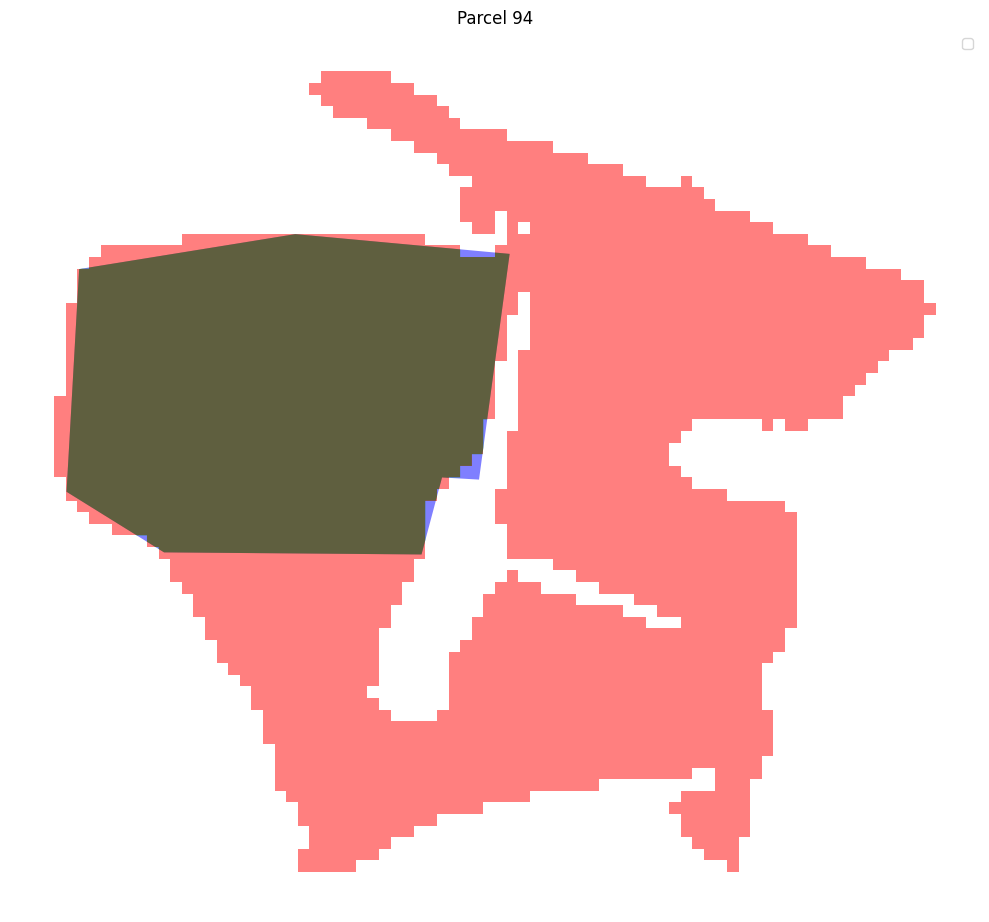

Parcel 94:
True Positive (Correctly predicted): 22381.08 m²
False Negative (Missed): 166.71 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

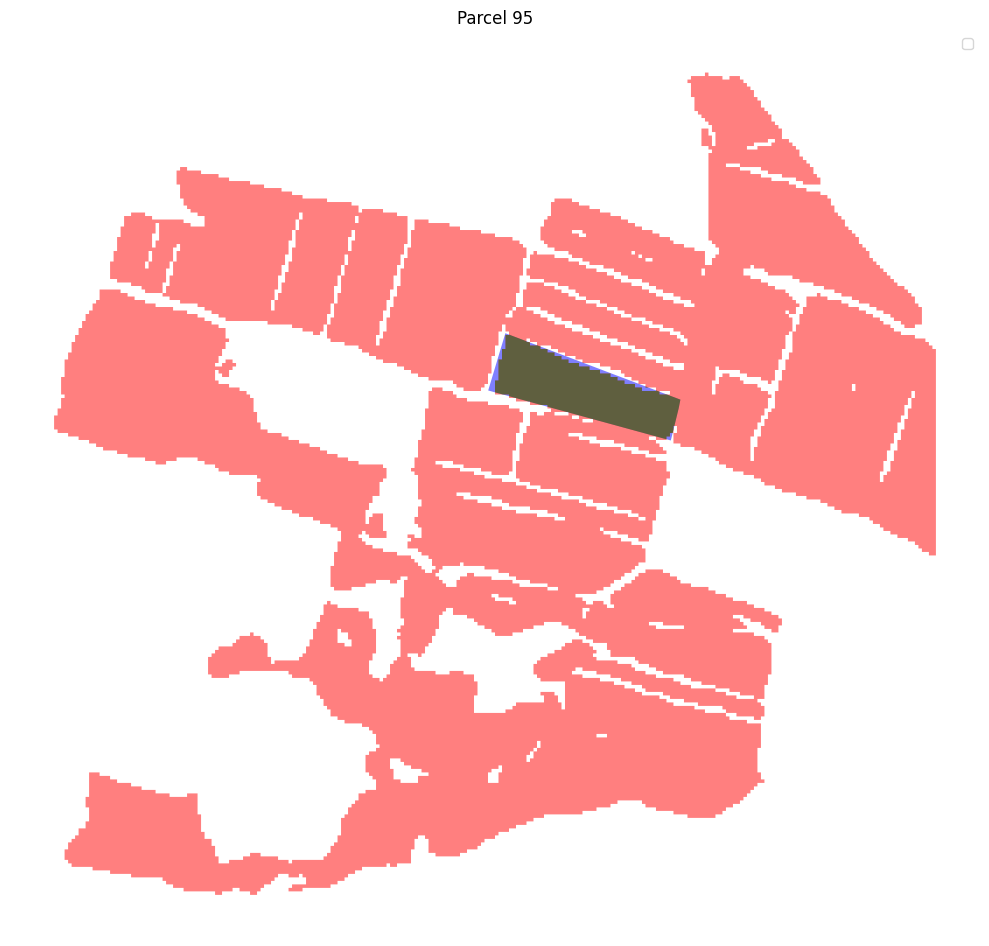

Parcel 95:
True Positive (Correctly predicted): 18226.29 m²
False Negative (Missed): 1277.26 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

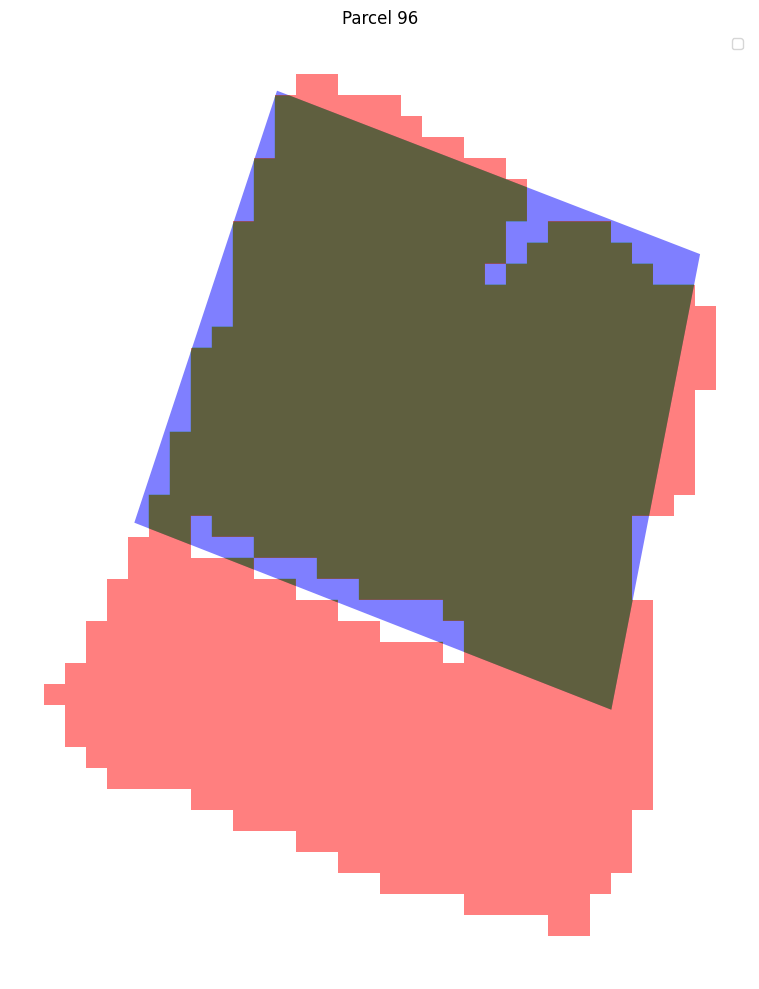

Parcel 96:
True Positive (Correctly predicted): 11359.20 m²
False Negative (Missed): 1097.66 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

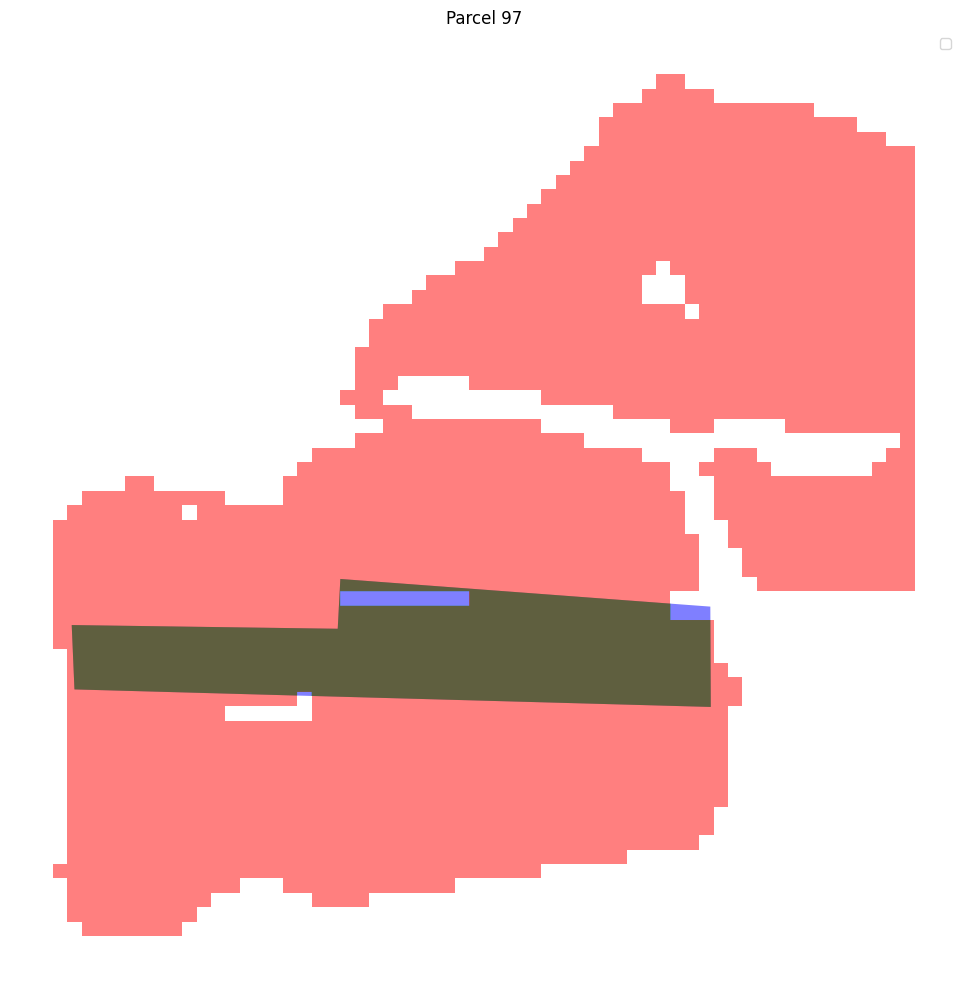

Parcel 97:
True Positive (Correctly predicted): 6742.32 m²
False Negative (Missed): 303.91 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

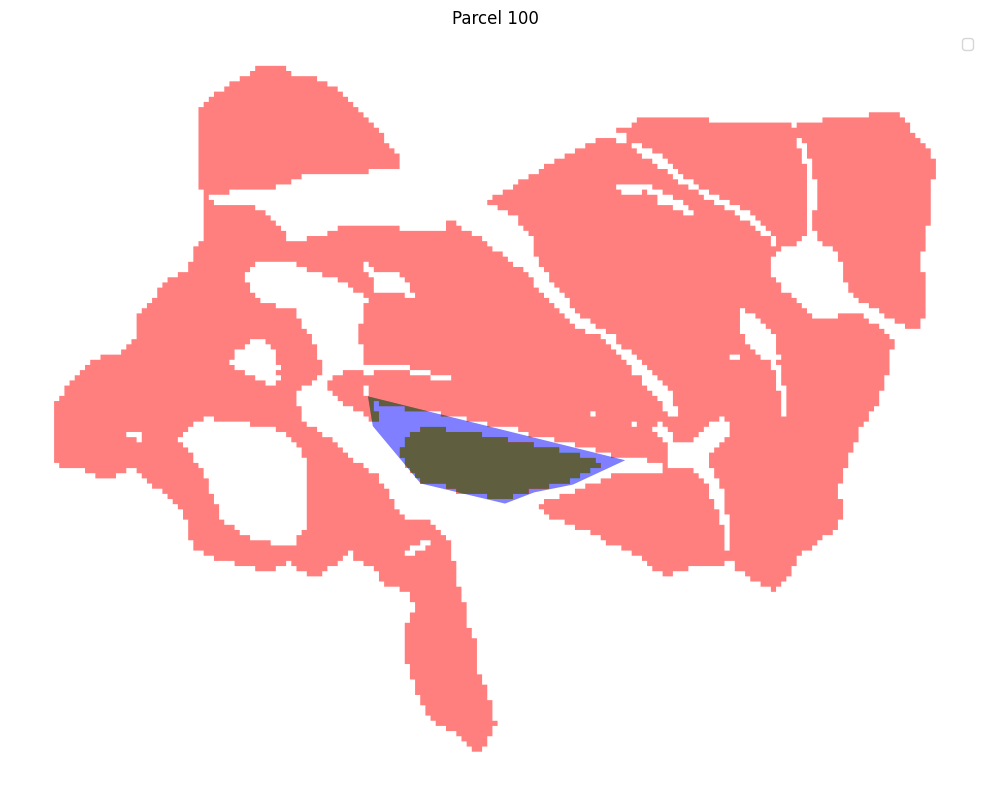

Parcel 100:
True Positive (Correctly predicted): 8805.18 m²
False Negative (Missed): 3747.77 m²
Adjusted IoU: 0.70




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

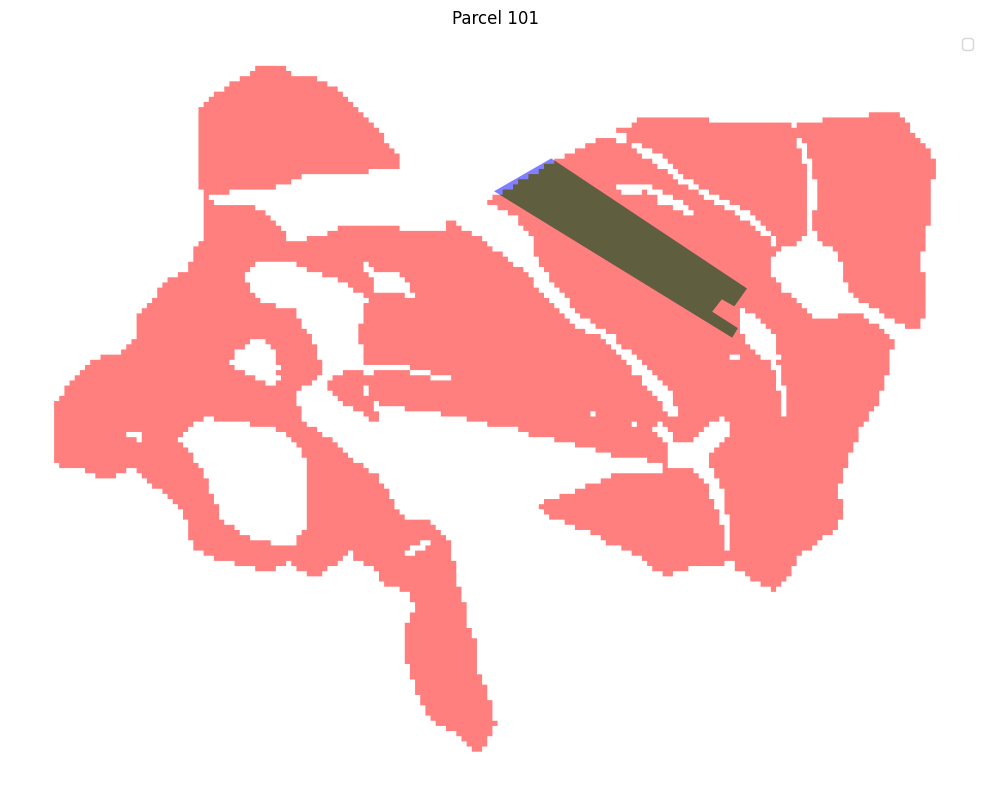

Parcel 101:
True Positive (Correctly predicted): 12300.88 m²
False Negative (Missed): 288.67 m²
Adjusted IoU: 0.98




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

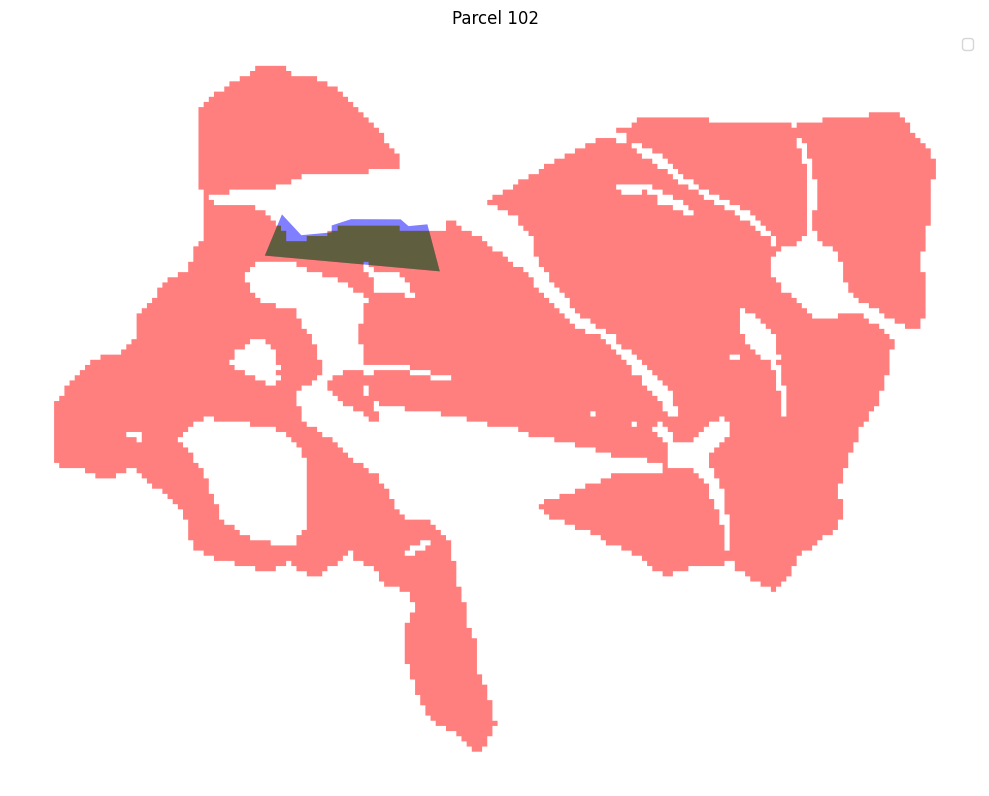

Parcel 102:
True Positive (Correctly predicted): 5036.92 m²
False Negative (Missed): 940.45 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

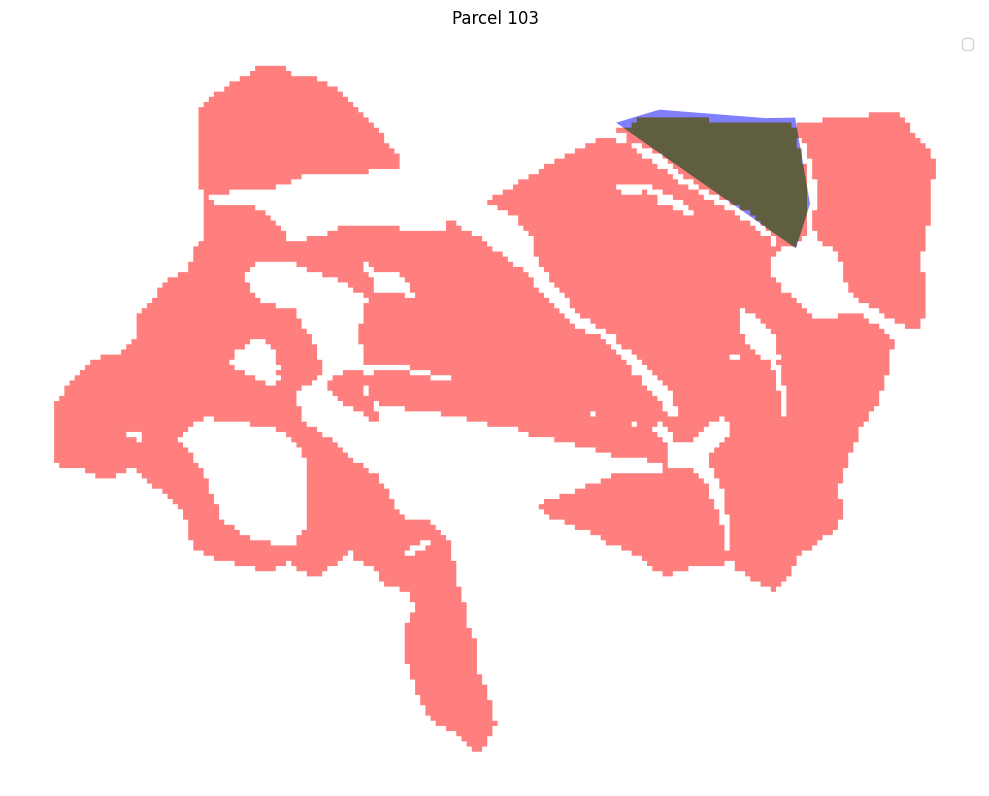

Parcel 103:
True Positive (Correctly predicted): 11592.96 m²
False Negative (Missed): 1129.85 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

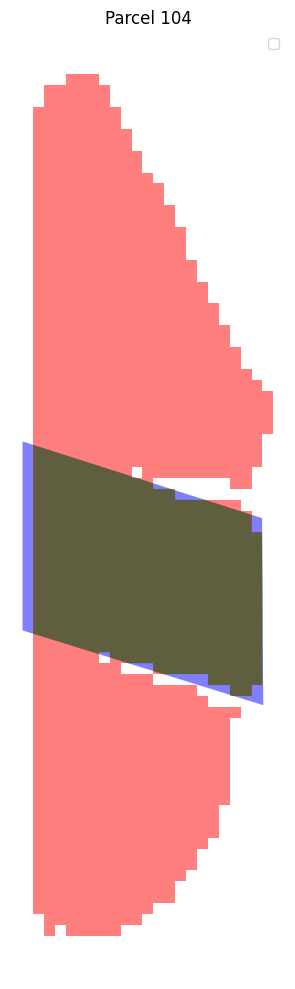

Parcel 104:
True Positive (Correctly predicted): 8788.12 m²
False Negative (Missed): 691.33 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

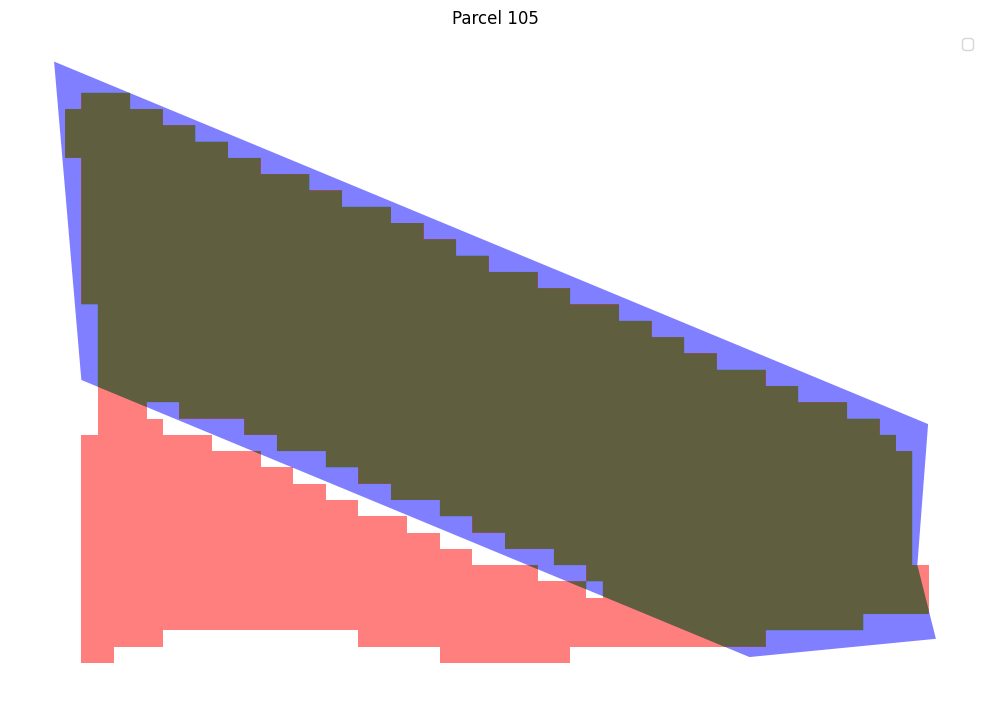

Parcel 105:
True Positive (Correctly predicted): 20872.75 m²
False Negative (Missed): 3155.13 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

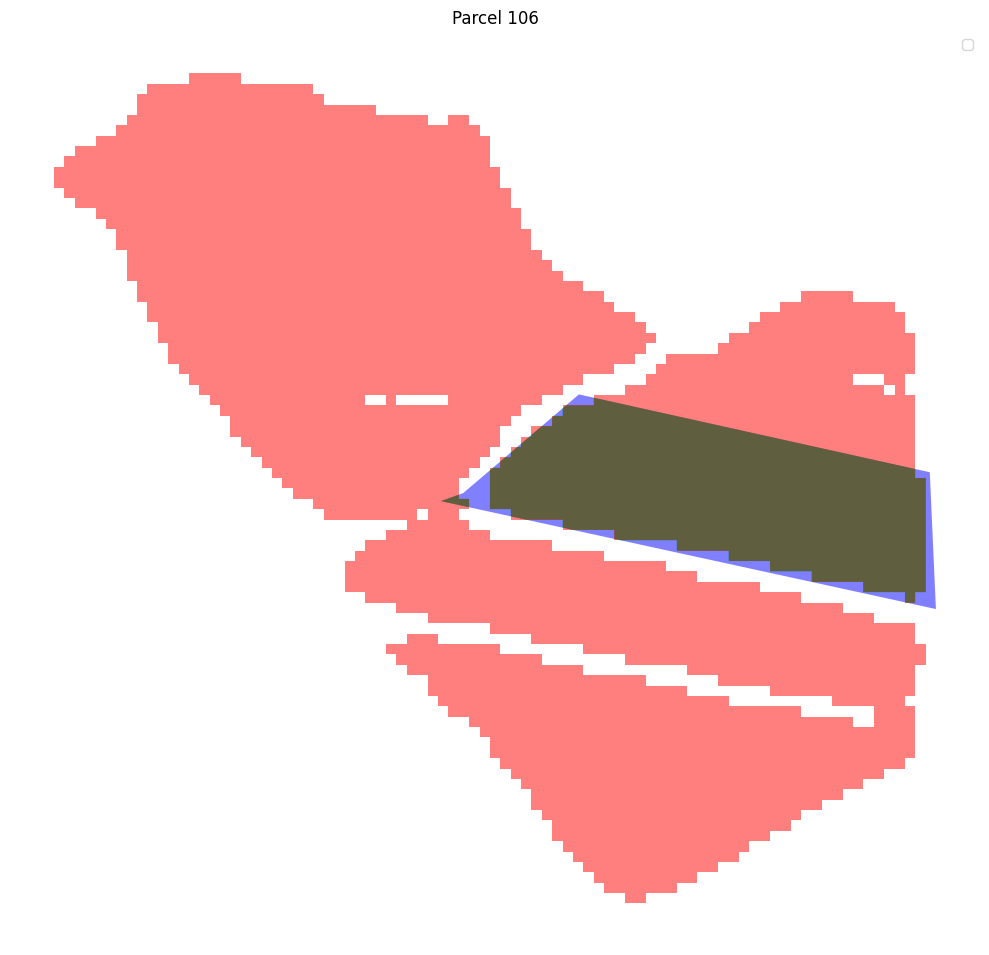

Parcel 106:
True Positive (Correctly predicted): 12193.90 m²
False Negative (Missed): 1037.77 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

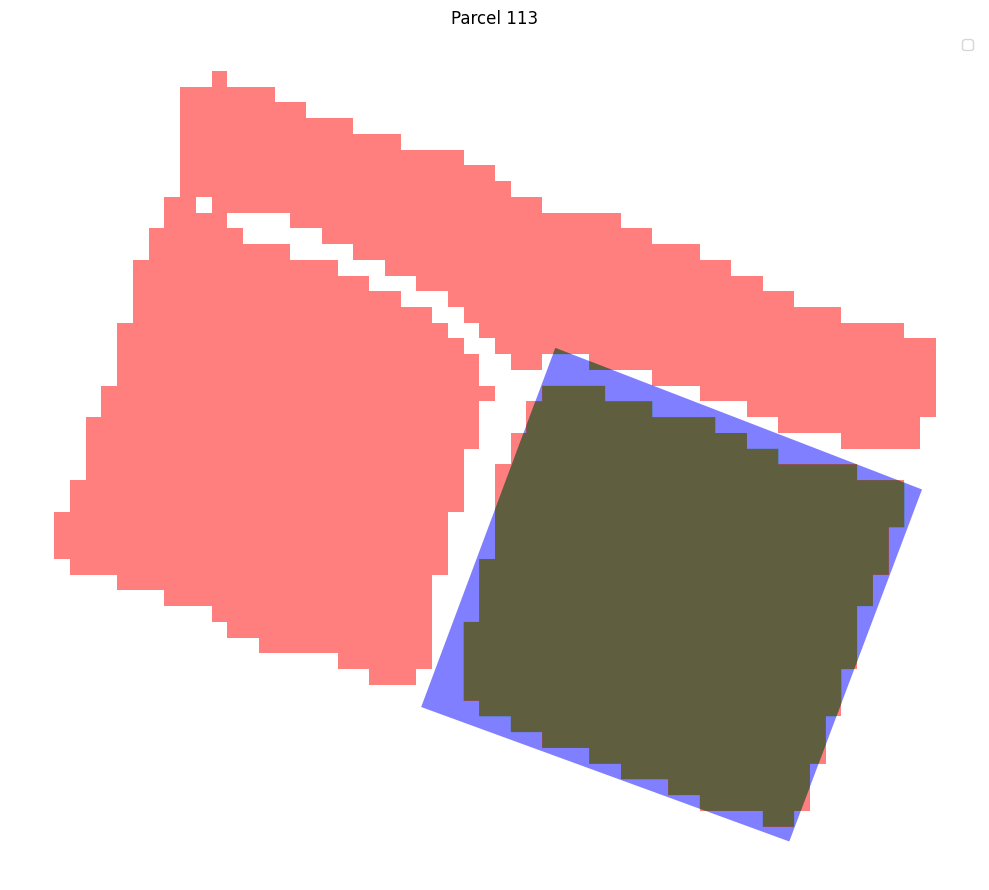

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 113:
True Positive (Correctly predicted): 13322.20 m²
False Negative (Missed): 1704.71 m²
Adjusted IoU: 0.89




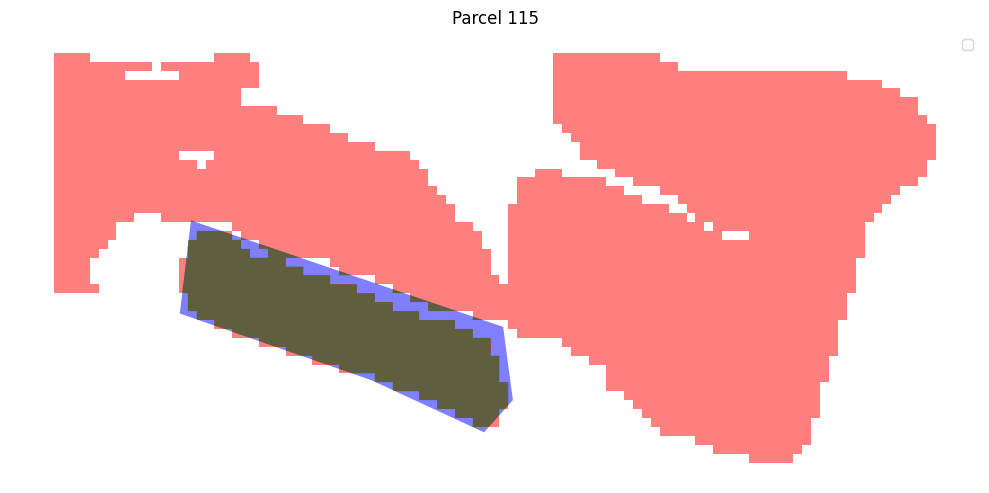

Parcel 115:
True Positive (Correctly predicted): 8597.70 m²
False Negative (Missed): 1569.73 m²
Adjusted IoU: 0.85




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

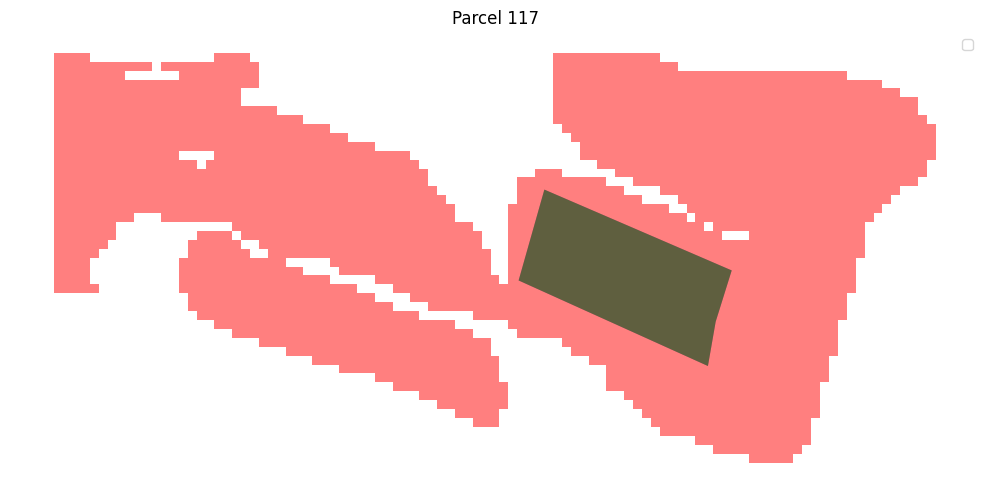

Parcel 117:
True Positive (Correctly predicted): 6131.33 m²
False Negative (Missed): 0.00 m²
Adjusted IoU: 1.00




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

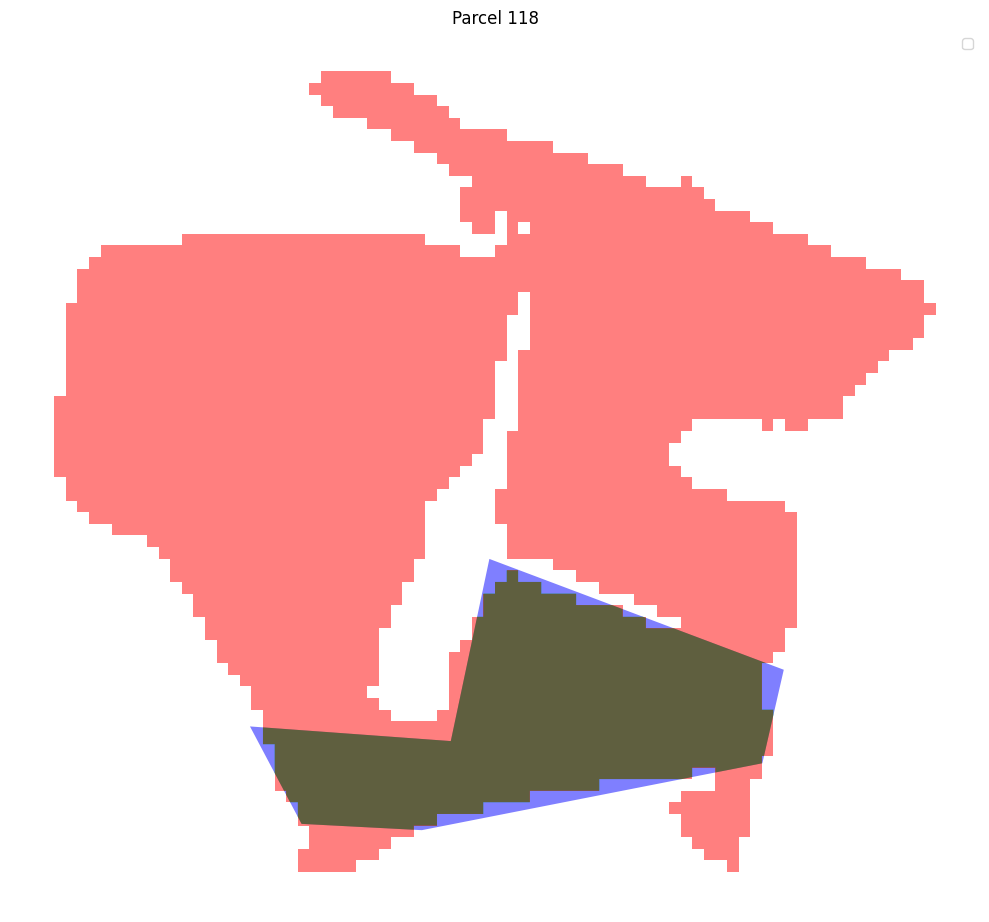

Parcel 118:
True Positive (Correctly predicted): 12513.70 m²
False Negative (Missed): 1005.24 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

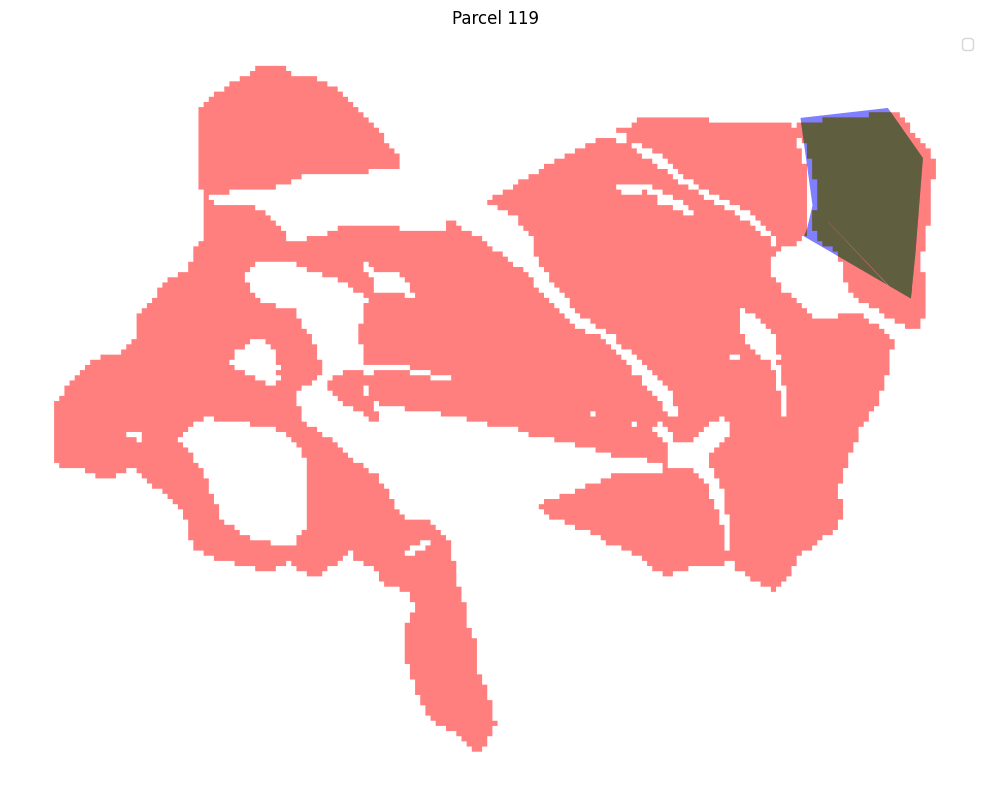

Parcel 119:
True Positive (Correctly predicted): 14923.28 m²
False Negative (Missed): 929.28 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

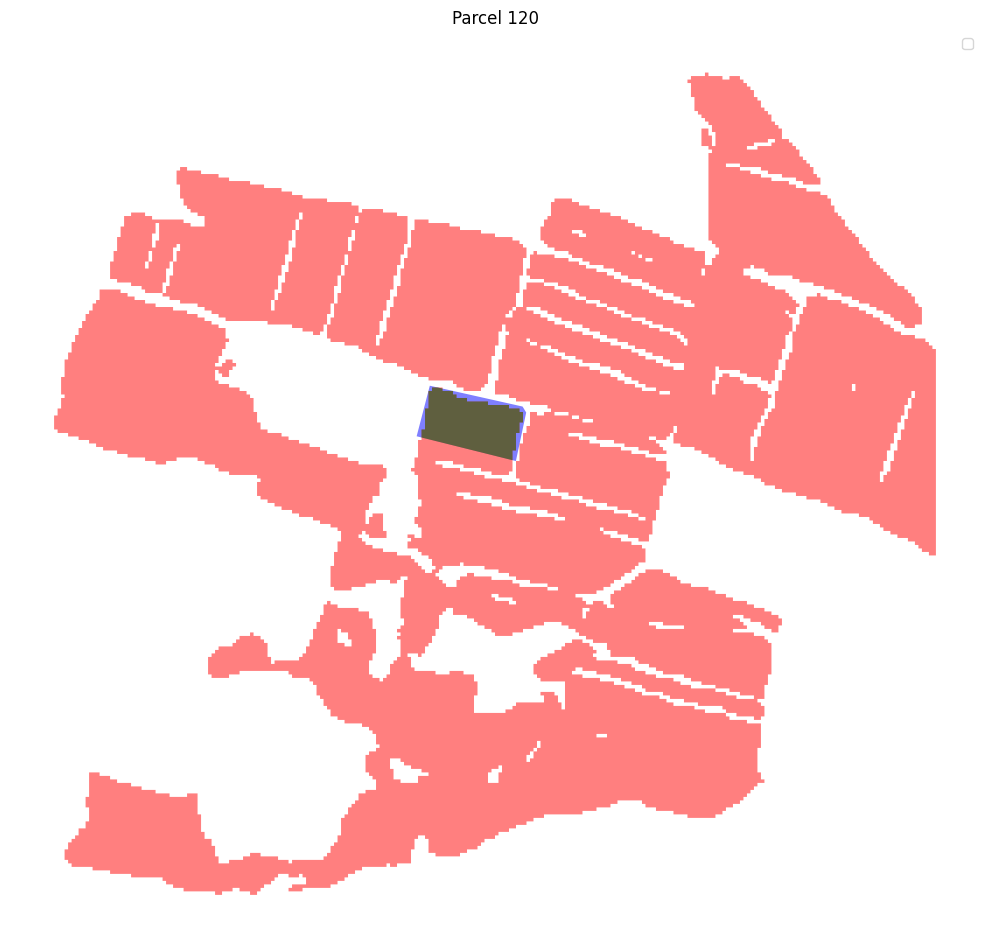

Parcel 120:
True Positive (Correctly predicted): 9614.91 m²
False Negative (Missed): 1381.12 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

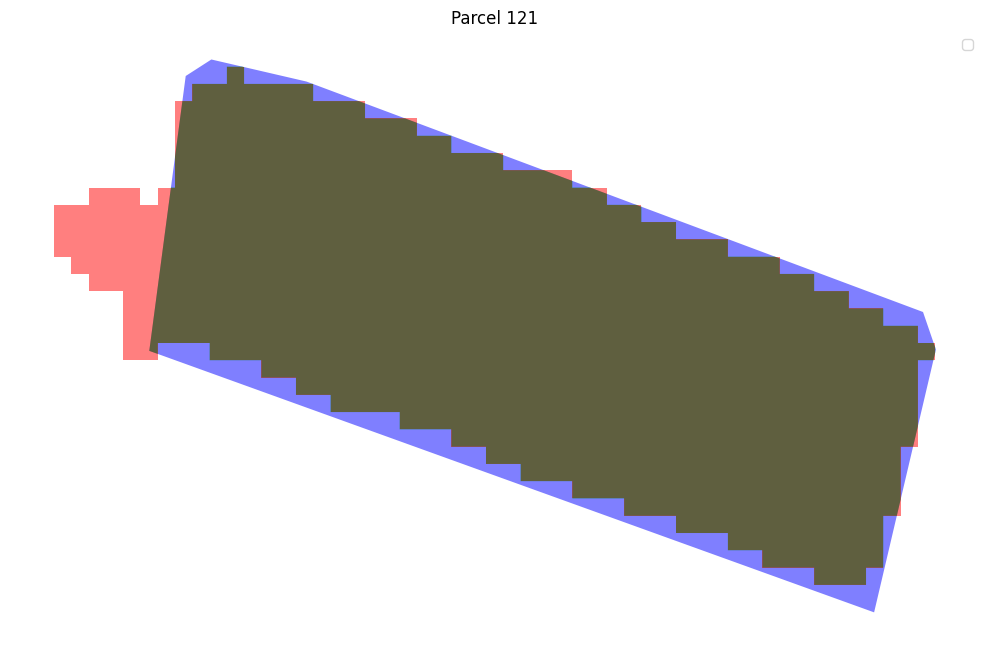

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 121:
True Positive (Correctly predicted): 18097.65 m²
False Negative (Missed): 1754.86 m²
Adjusted IoU: 0.91




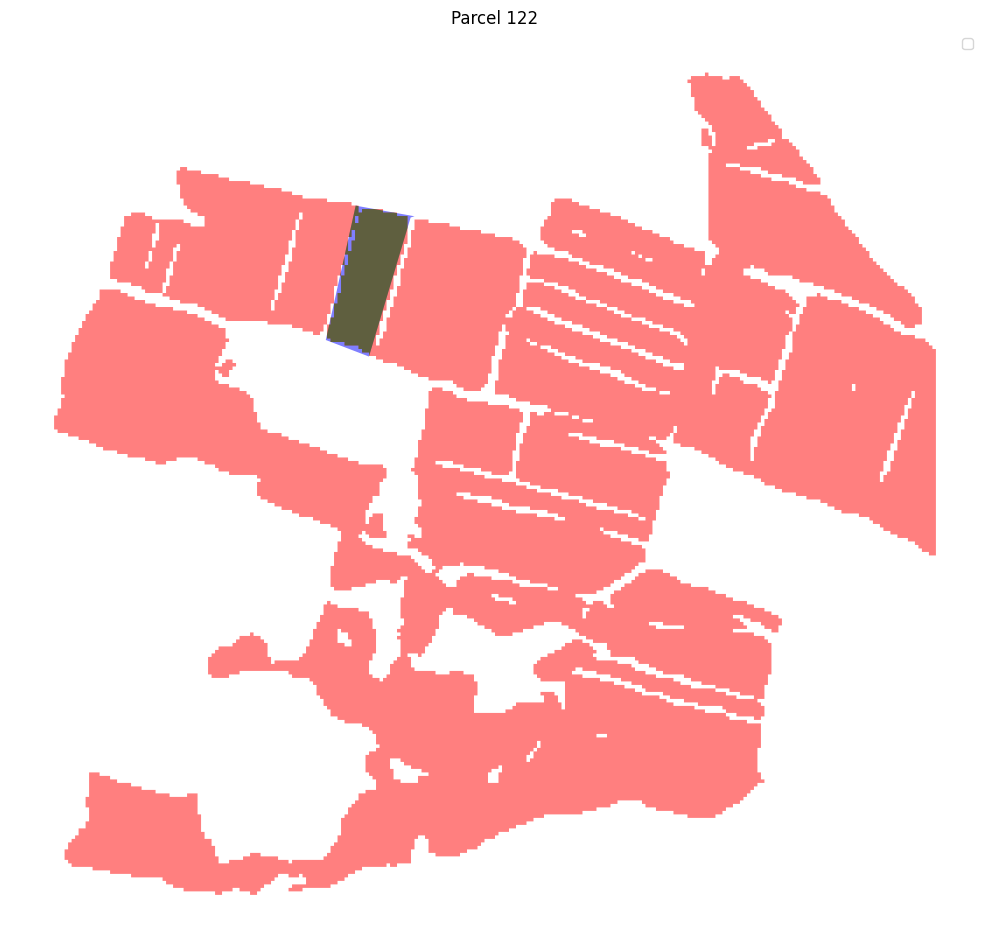

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 122:
True Positive (Correctly predicted): 13784.97 m²
False Negative (Missed): 1051.80 m²
Adjusted IoU: 0.93




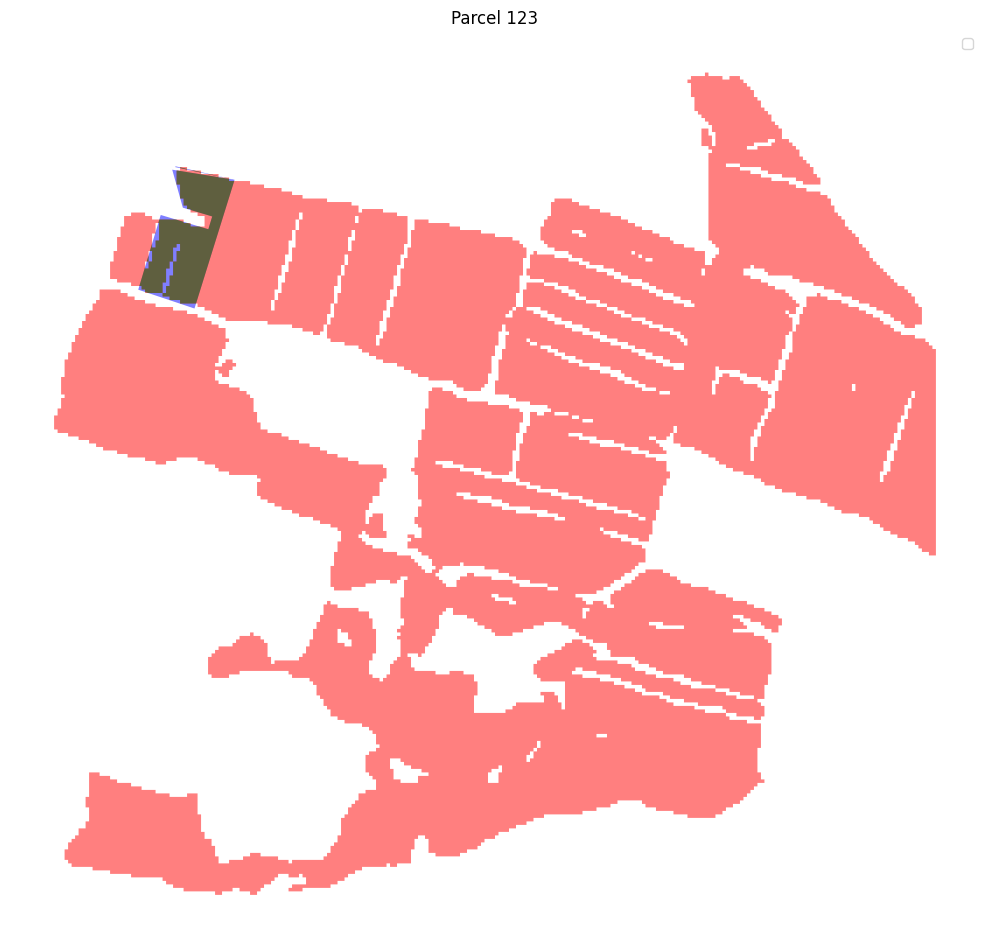

Parcel 123:
True Positive (Correctly predicted): 12682.43 m²
False Negative (Missed): 1322.53 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

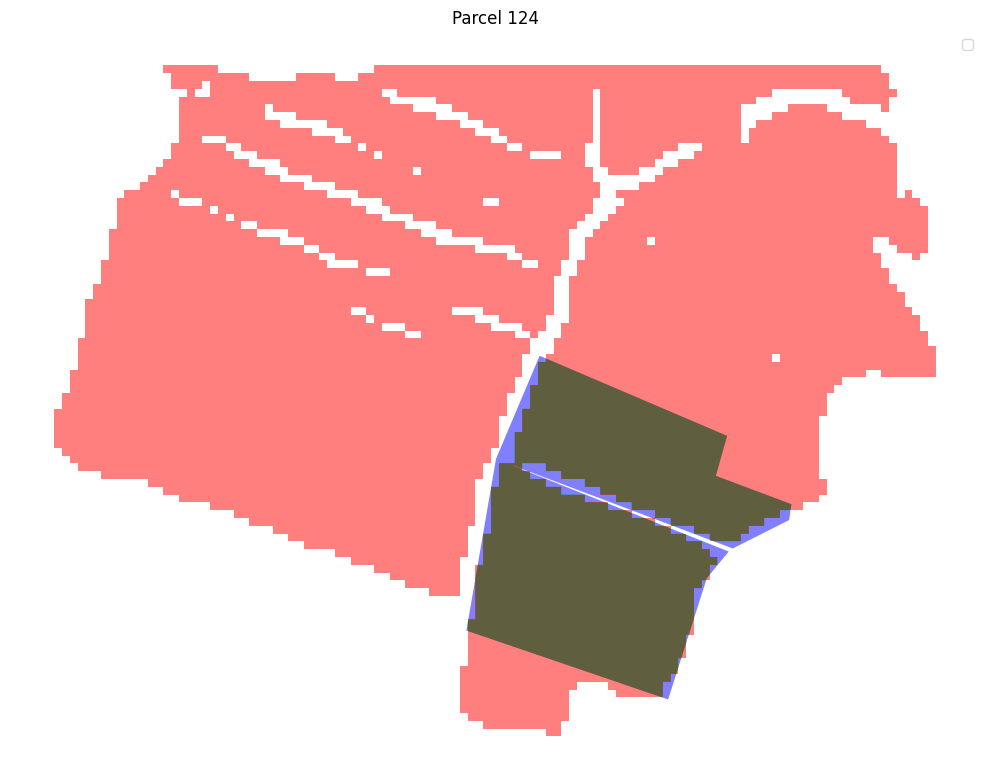

Parcel 124:
True Positive (Correctly predicted): 24461.77 m²
False Negative (Missed): 1893.17 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

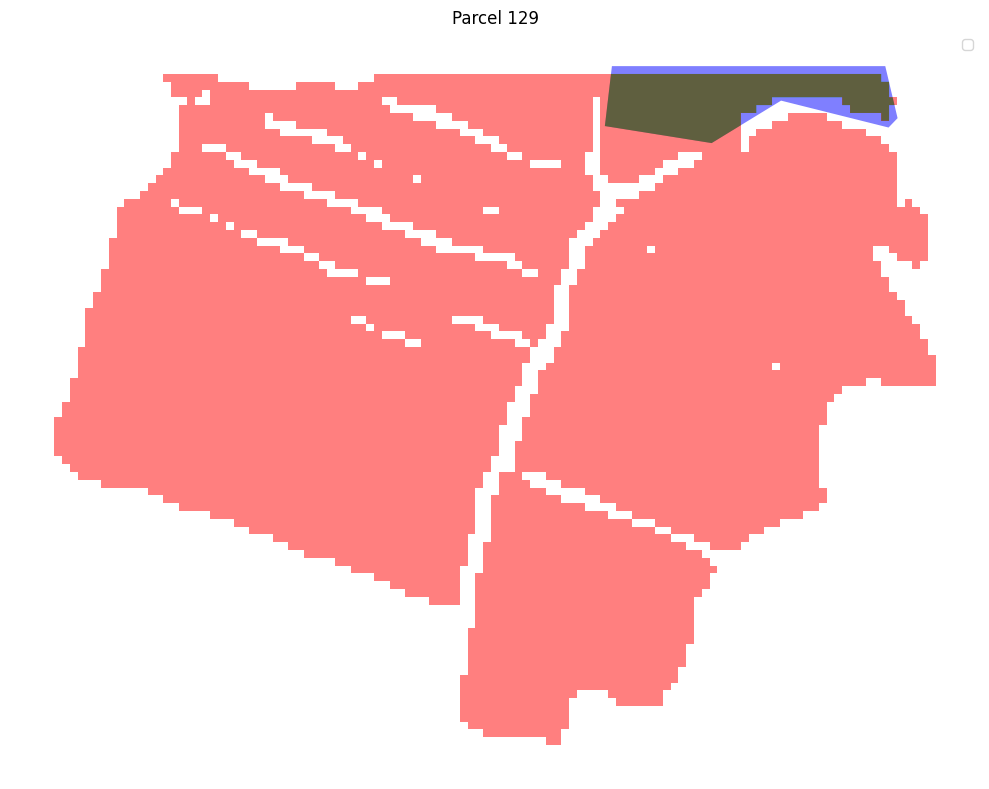

Parcel 129:
True Positive (Correctly predicted): 5177.49 m²
False Negative (Missed): 1517.78 m²
Adjusted IoU: 0.77




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

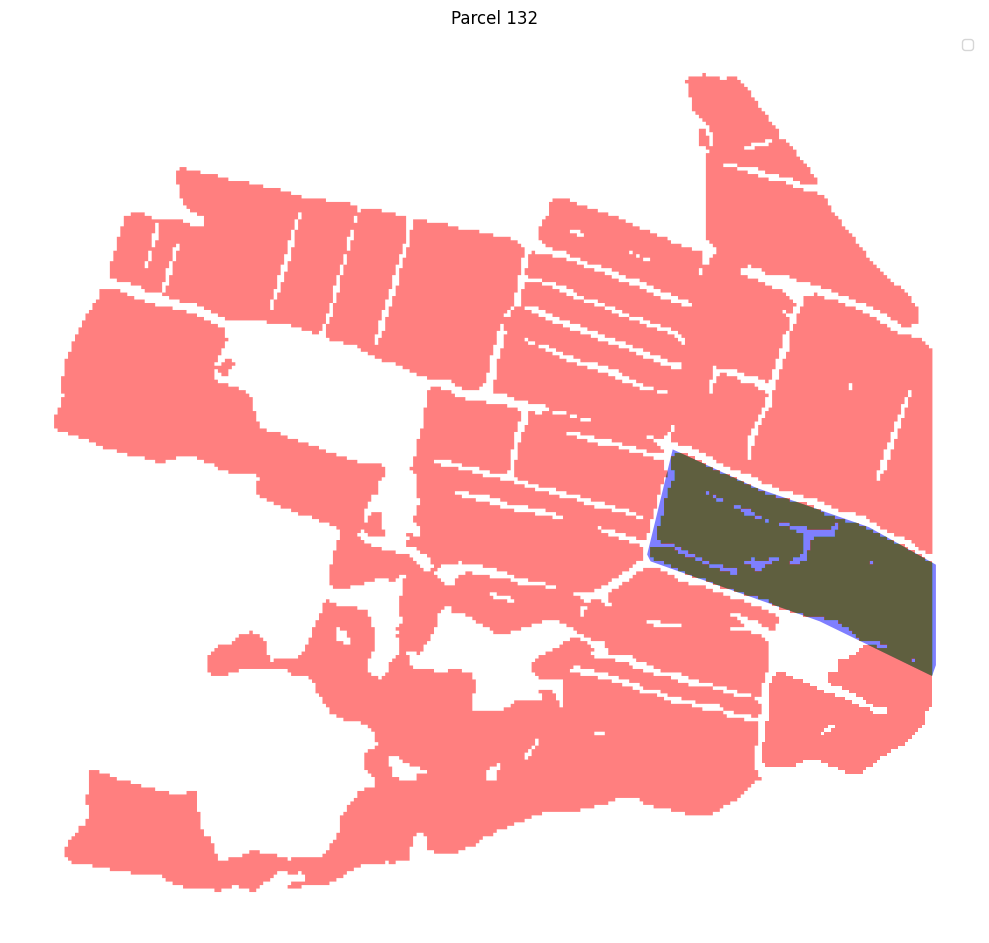

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 132:
True Positive (Correctly predicted): 58925.15 m²
False Negative (Missed): 6228.71 m²
Adjusted IoU: 0.90




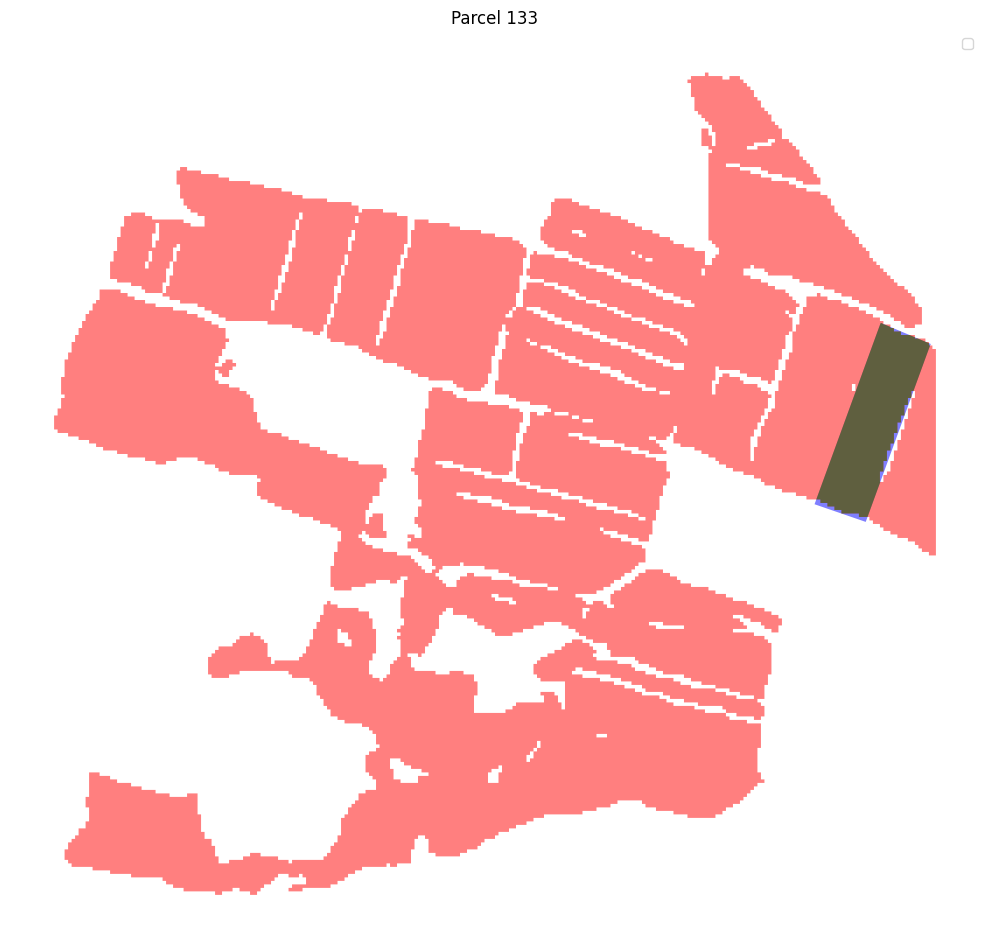

Parcel 133:
True Positive (Correctly predicted): 20264.46 m²
False Negative (Missed): 870.48 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

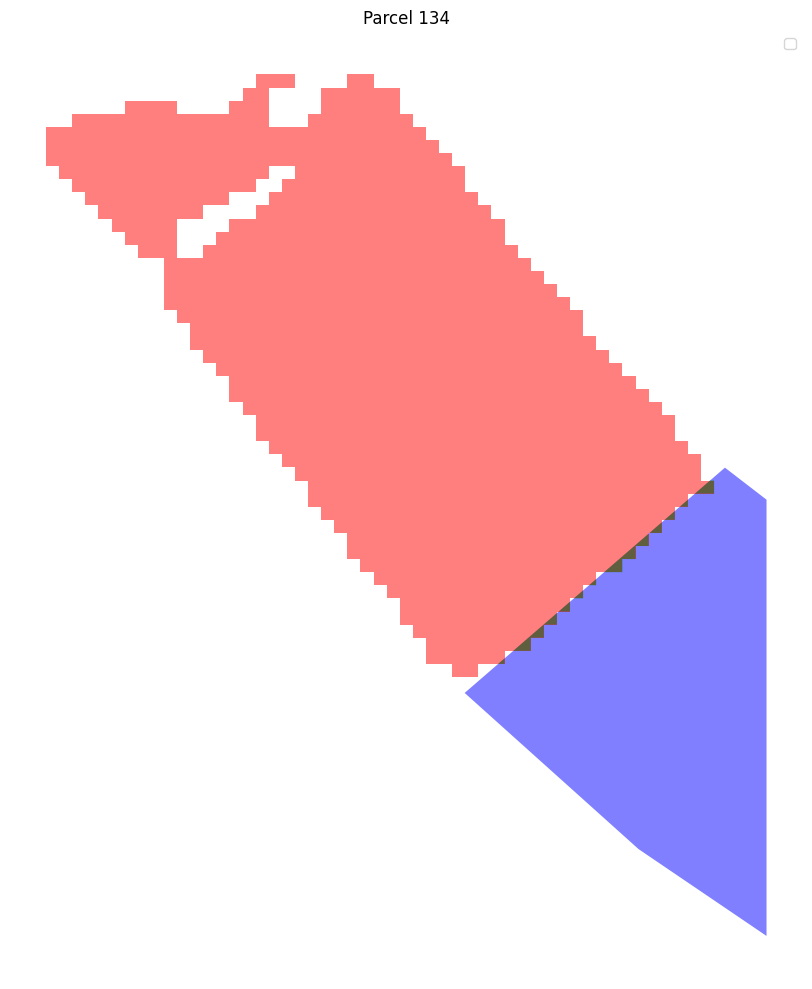

Parcel 134:
True Positive (Correctly predicted): 155.65 m²
False Negative (Missed): 11081.26 m²
Adjusted IoU: 0.01




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

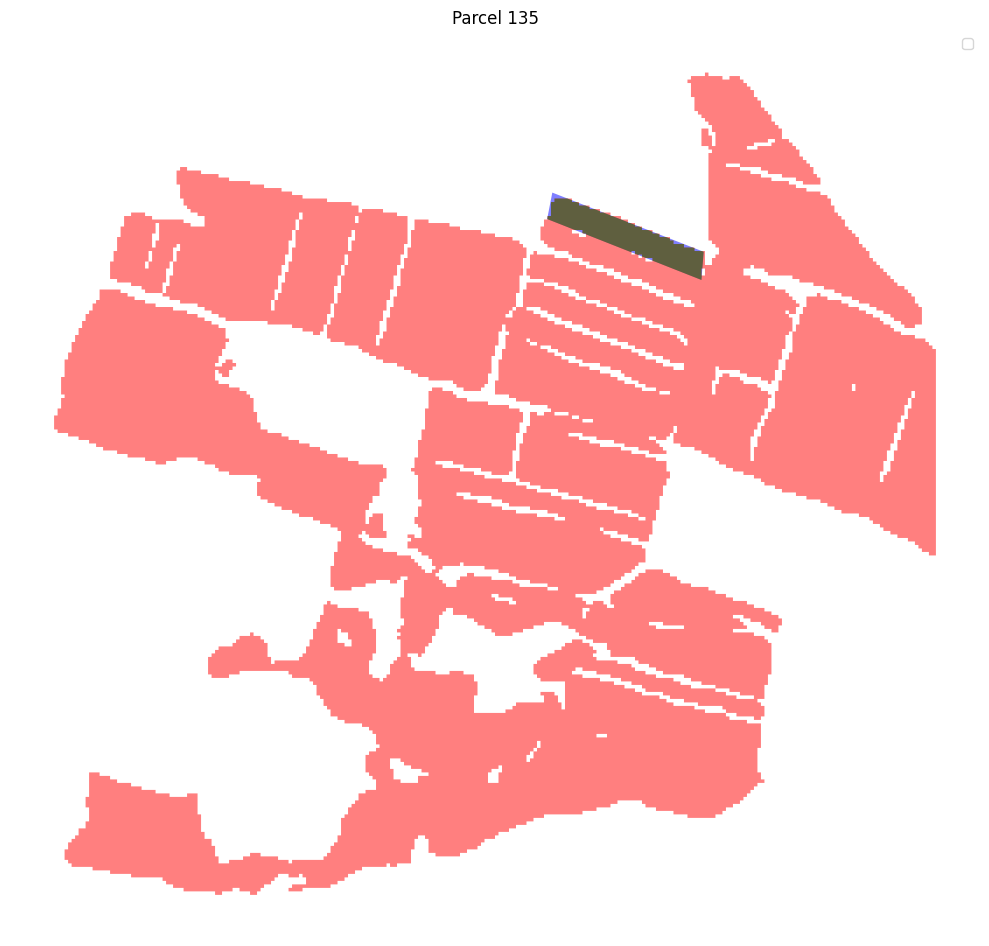

Parcel 135:
True Positive (Correctly predicted): 8524.76 m²
False Negative (Missed): 442.22 m²
Adjusted IoU: 0.95




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

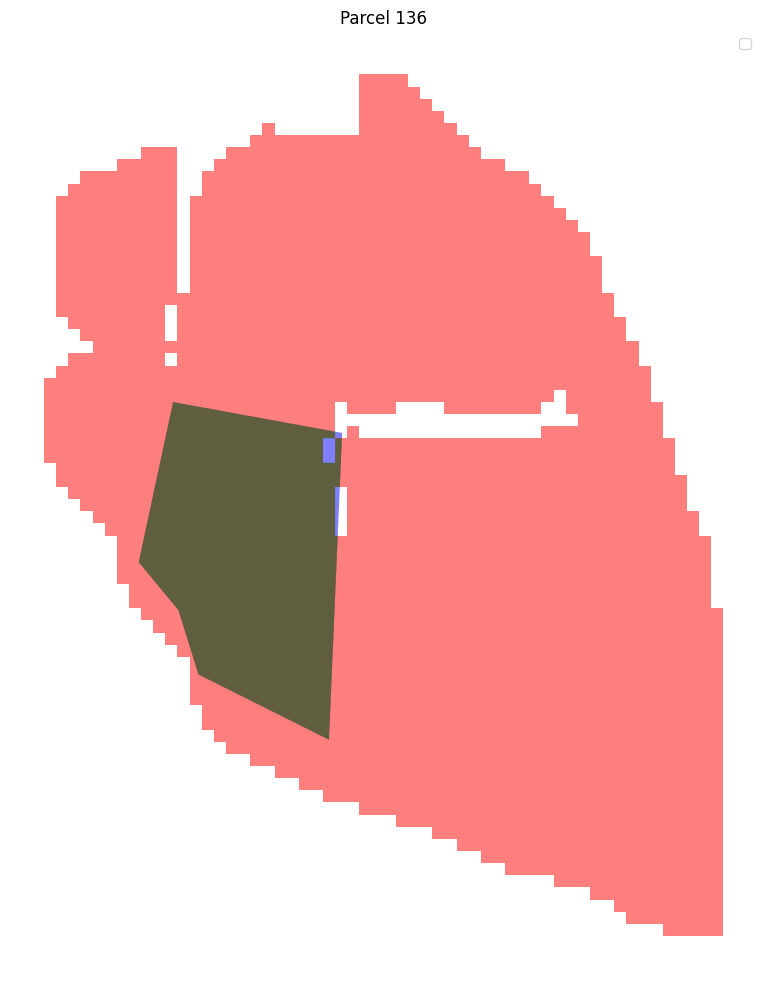

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 136:
True Positive (Correctly predicted): 8234.19 m²
False Negative (Missed): 86.80 m²
Adjusted IoU: 0.99




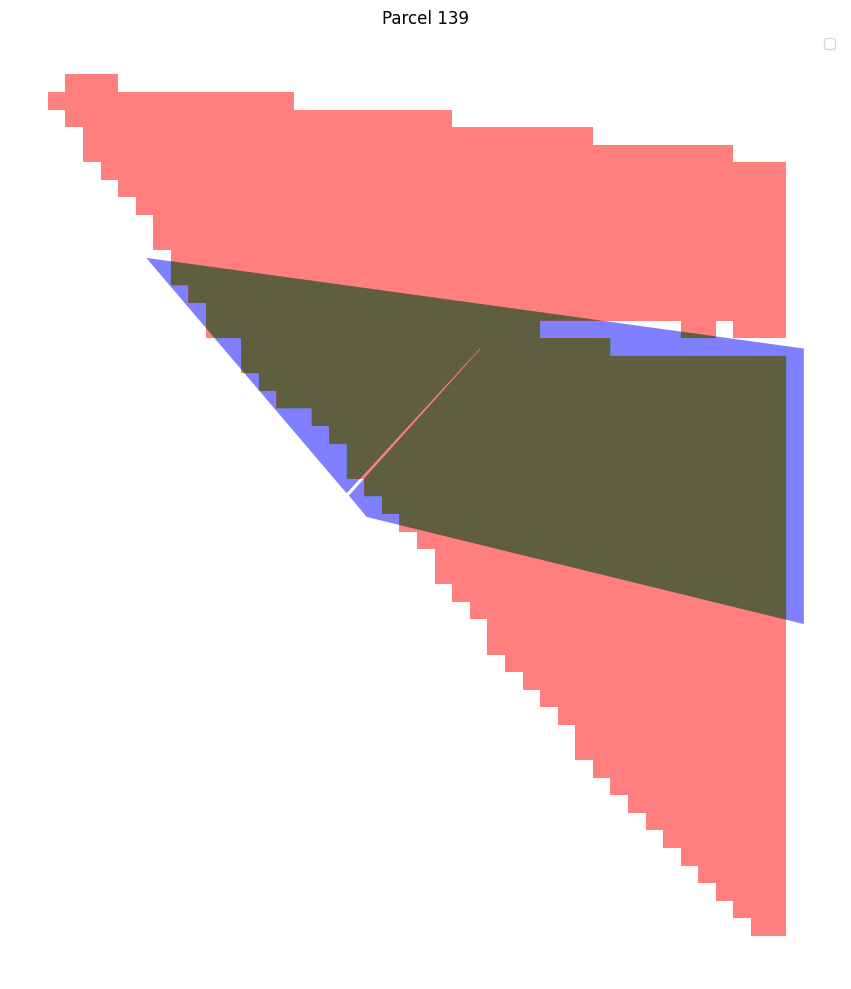

Parcel 139:
True Positive (Correctly predicted): 9764.07 m²
False Negative (Missed): 1154.14 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

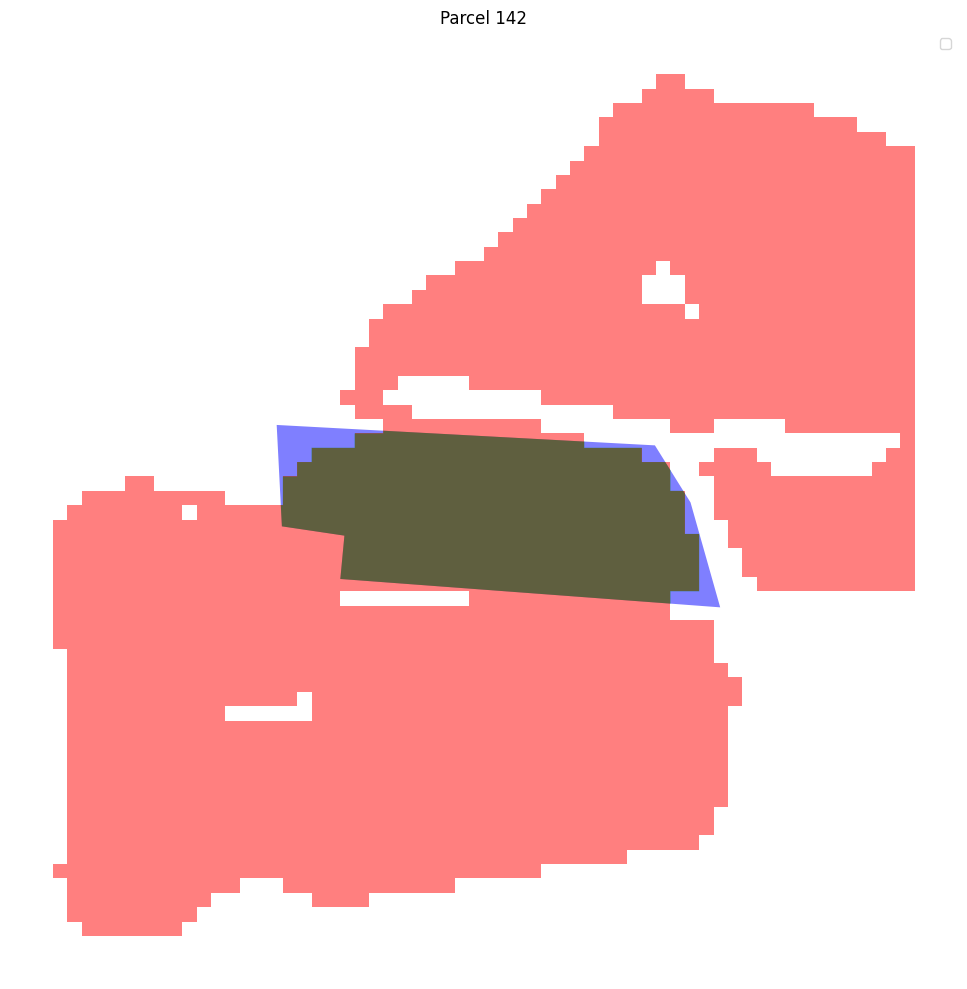

Parcel 142:
True Positive (Correctly predicted): 6799.51 m²
False Negative (Missed): 571.47 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

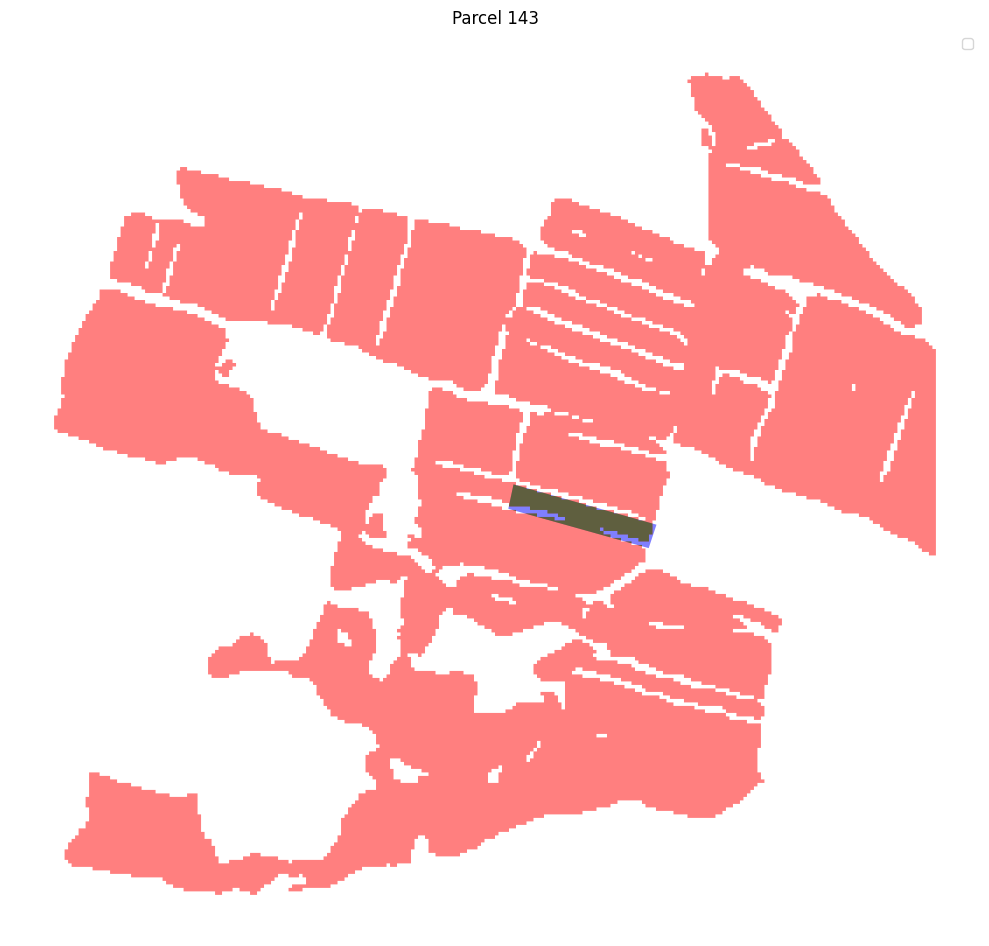

Parcel 143:
True Positive (Correctly predicted): 6192.26 m²
False Negative (Missed): 1256.87 m²
Adjusted IoU: 0.83




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

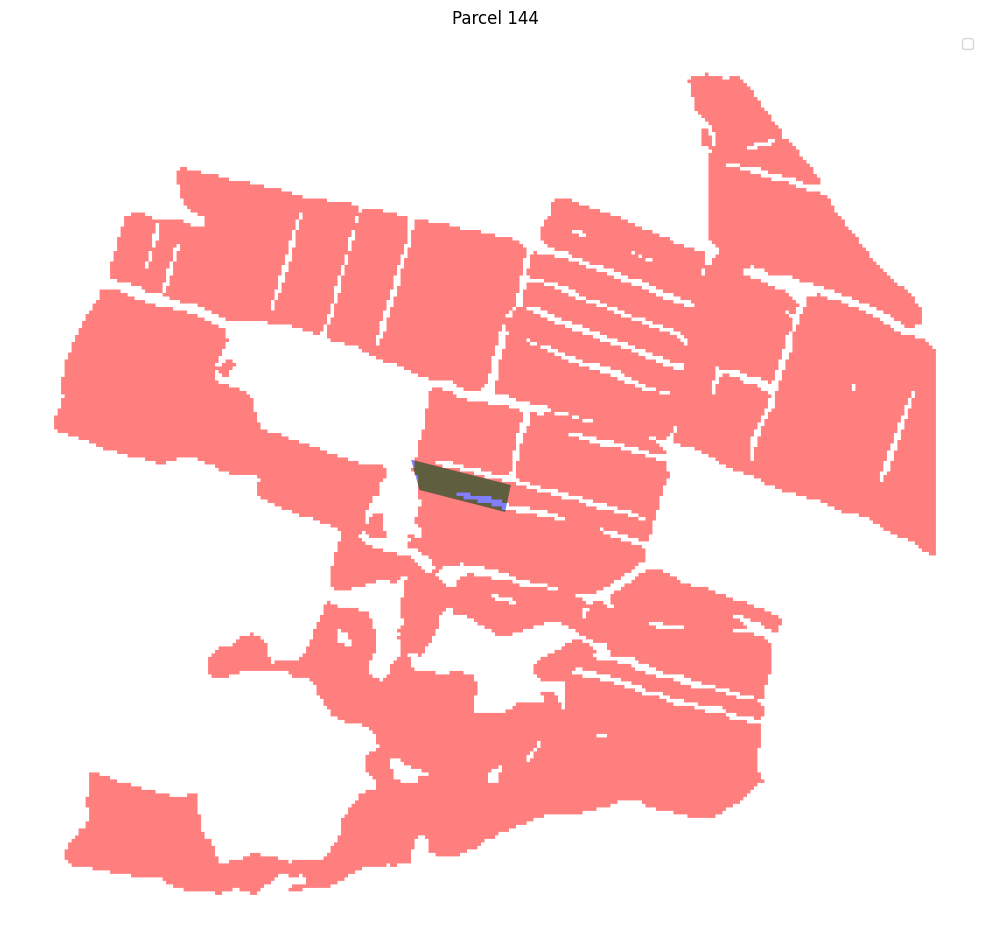

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 144:
True Positive (Correctly predicted): 4665.50 m²
False Negative (Missed): 672.53 m²
Adjusted IoU: 0.87




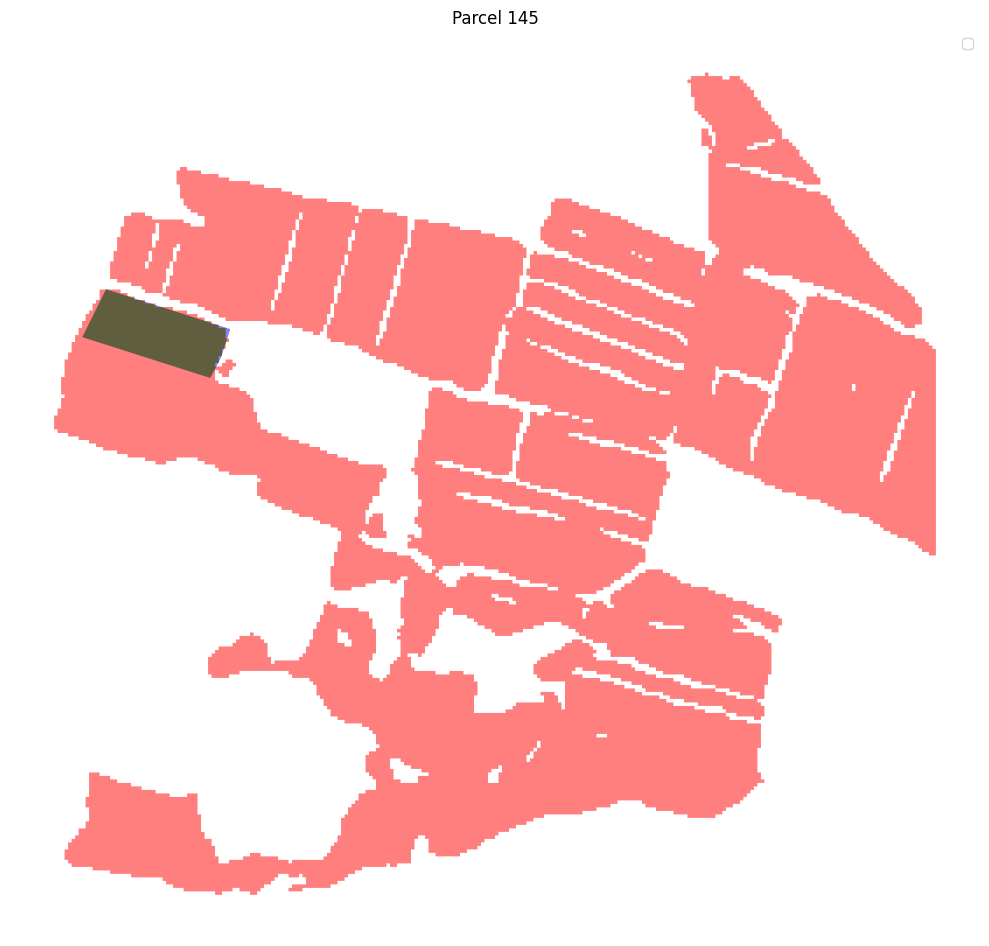

Parcel 145:
True Positive (Correctly predicted): 14176.71 m²
False Negative (Missed): 172.12 m²
Adjusted IoU: 0.99




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

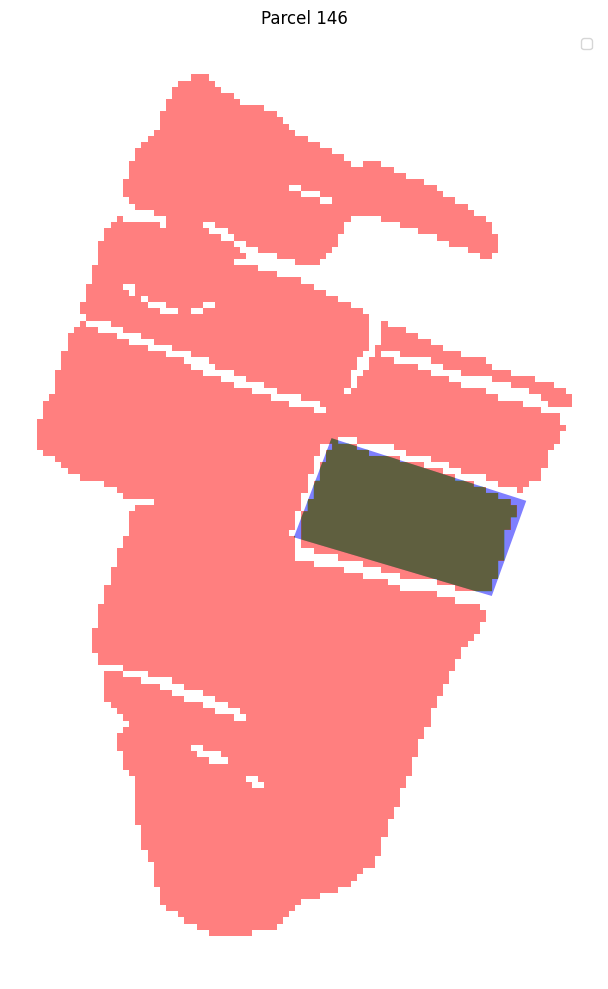

Parcel 146:
True Positive (Correctly predicted): 13373.27 m²
False Negative (Missed): 659.06 m²
Adjusted IoU: 0.95




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

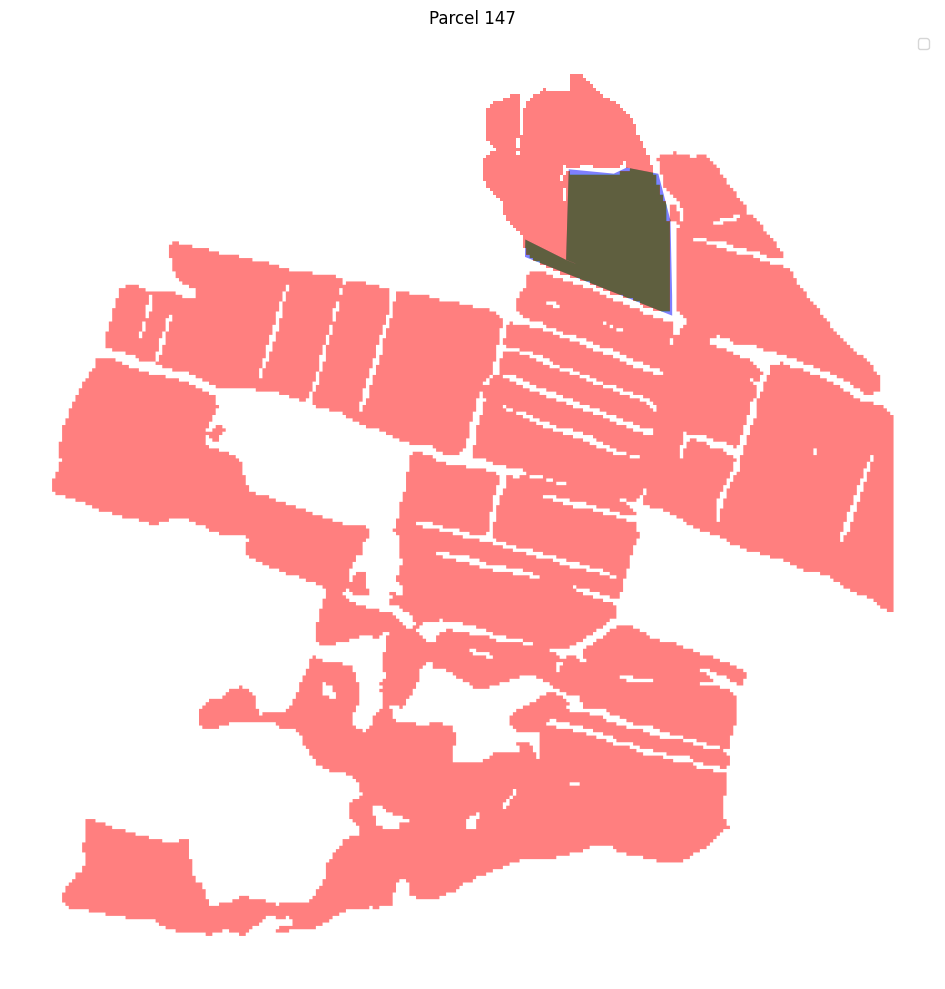

Parcel 147:
True Positive (Correctly predicted): 28355.47 m²
False Negative (Missed): 1112.29 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

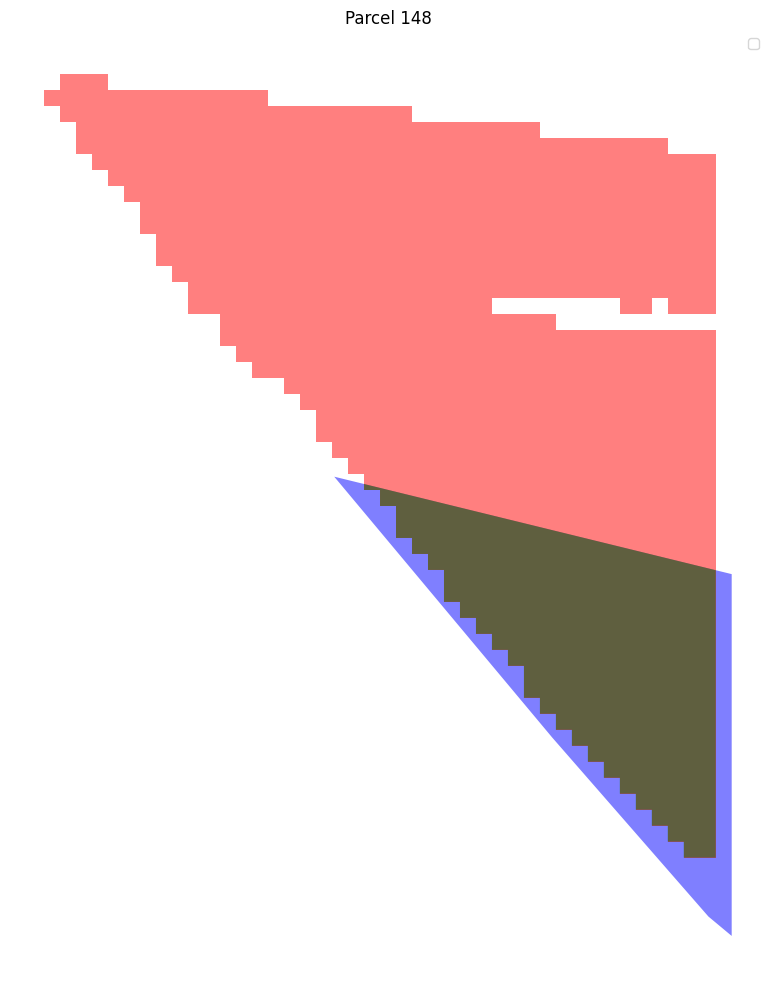

Parcel 148:
True Positive (Correctly predicted): 5698.27 m²
False Negative (Missed): 1567.08 m²
Adjusted IoU: 0.78




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

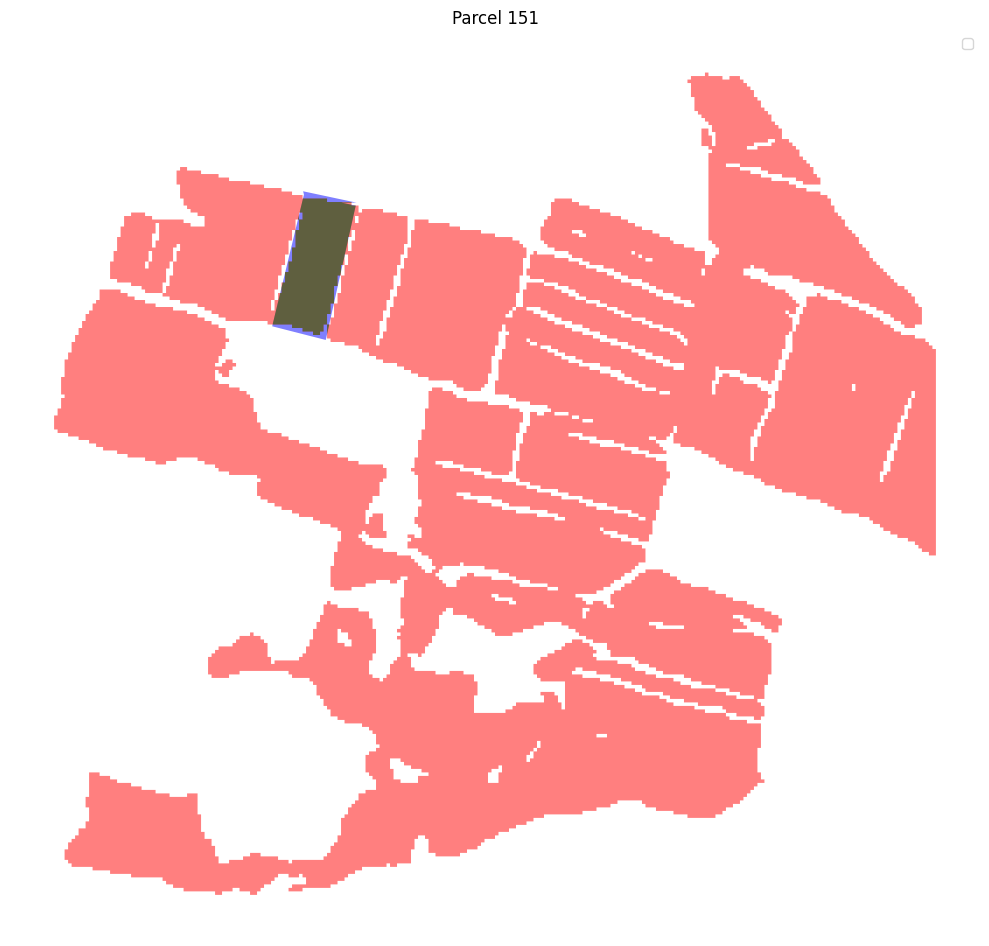

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 151:
True Positive (Correctly predicted): 13884.23 m²
False Negative (Missed): 1483.08 m²
Adjusted IoU: 0.90




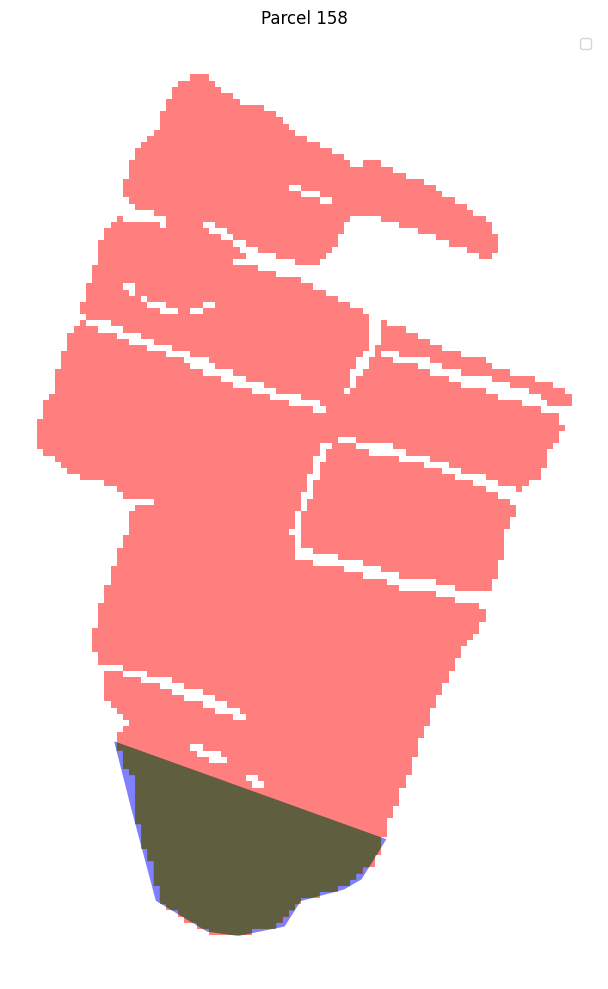

Parcel 158:
True Positive (Correctly predicted): 18201.87 m²
False Negative (Missed): 766.92 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

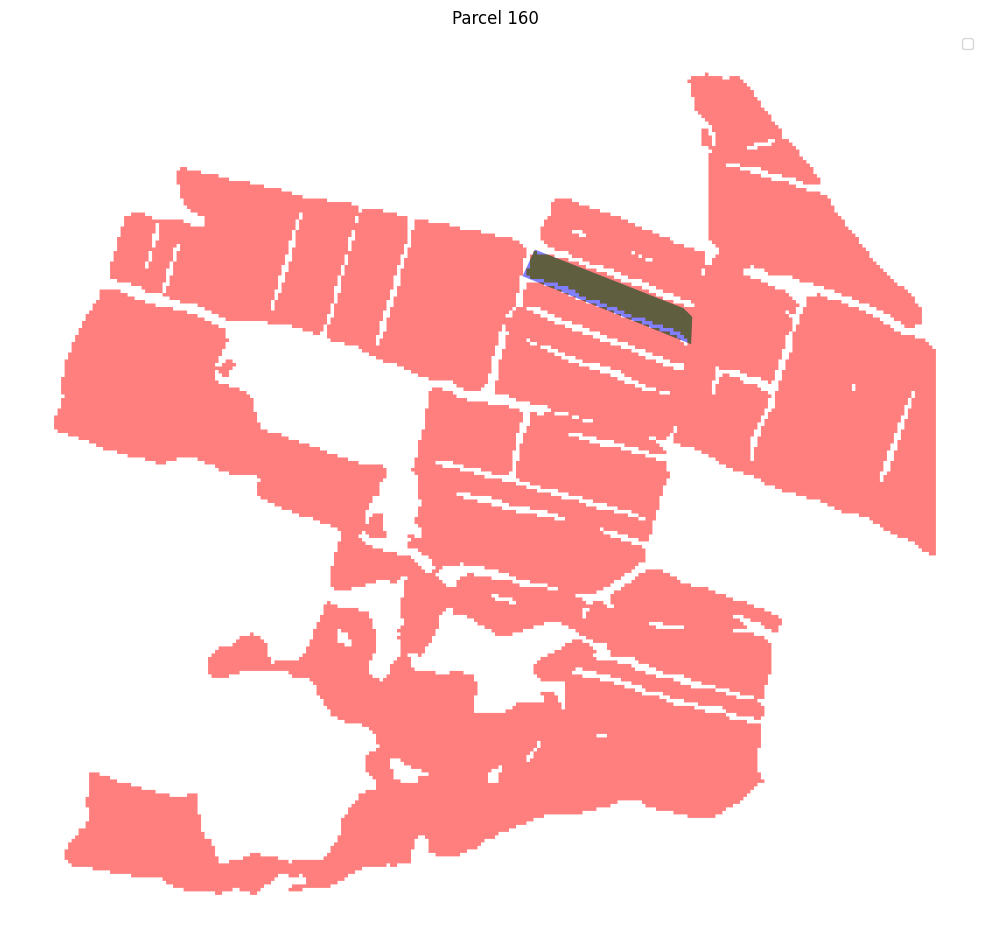

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 160:
True Positive (Correctly predicted): 9124.77 m²
False Negative (Missed): 1557.13 m²
Adjusted IoU: 0.85




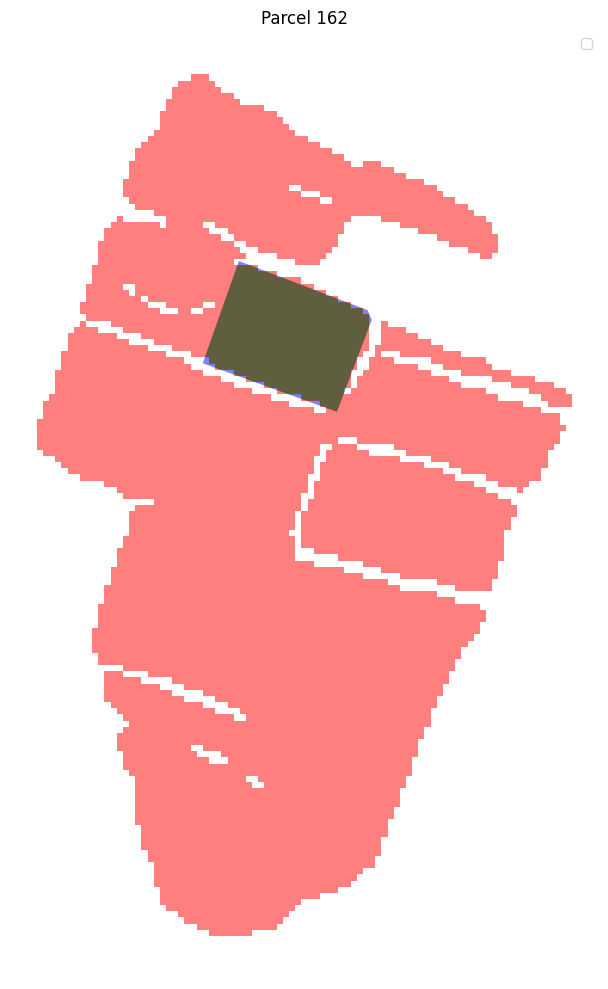

Parcel 162:
True Positive (Correctly predicted): 9940.12 m²
False Negative (Missed): 214.80 m²
Adjusted IoU: 0.98




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

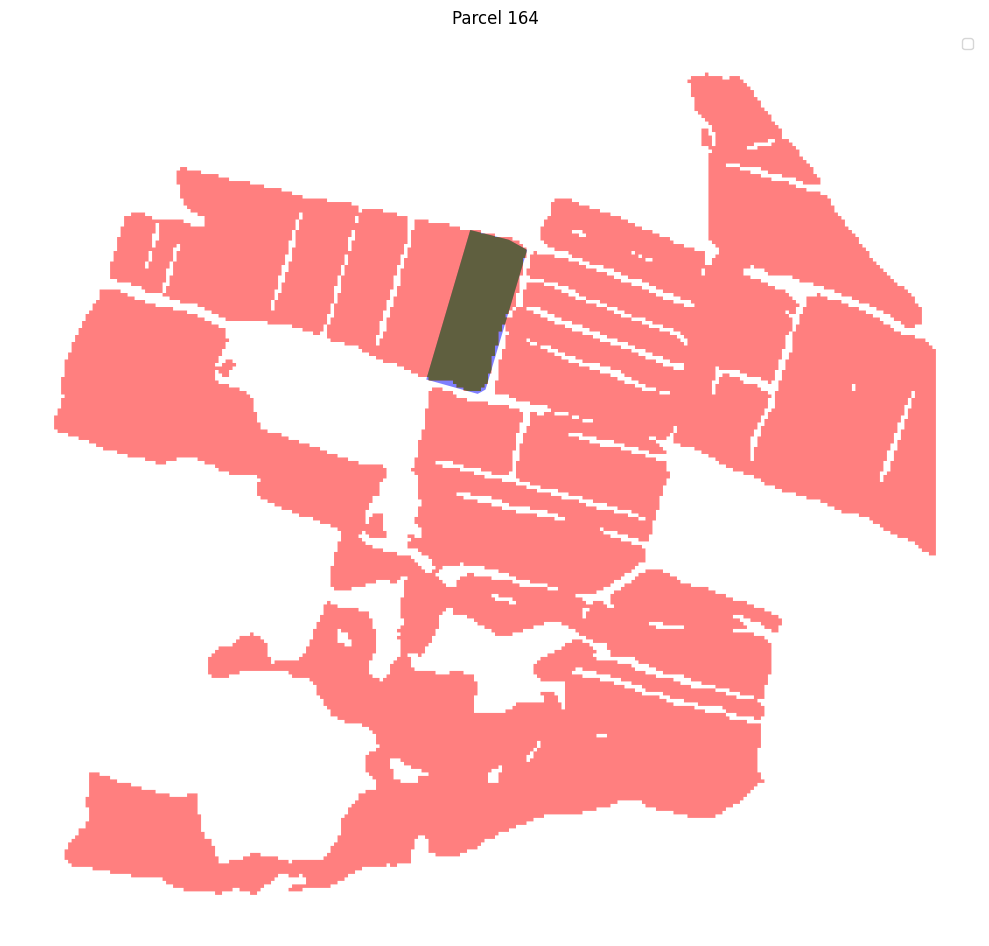

Parcel 164:
True Positive (Correctly predicted): 18461.72 m²
False Negative (Missed): 543.38 m²
Adjusted IoU: 0.97




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

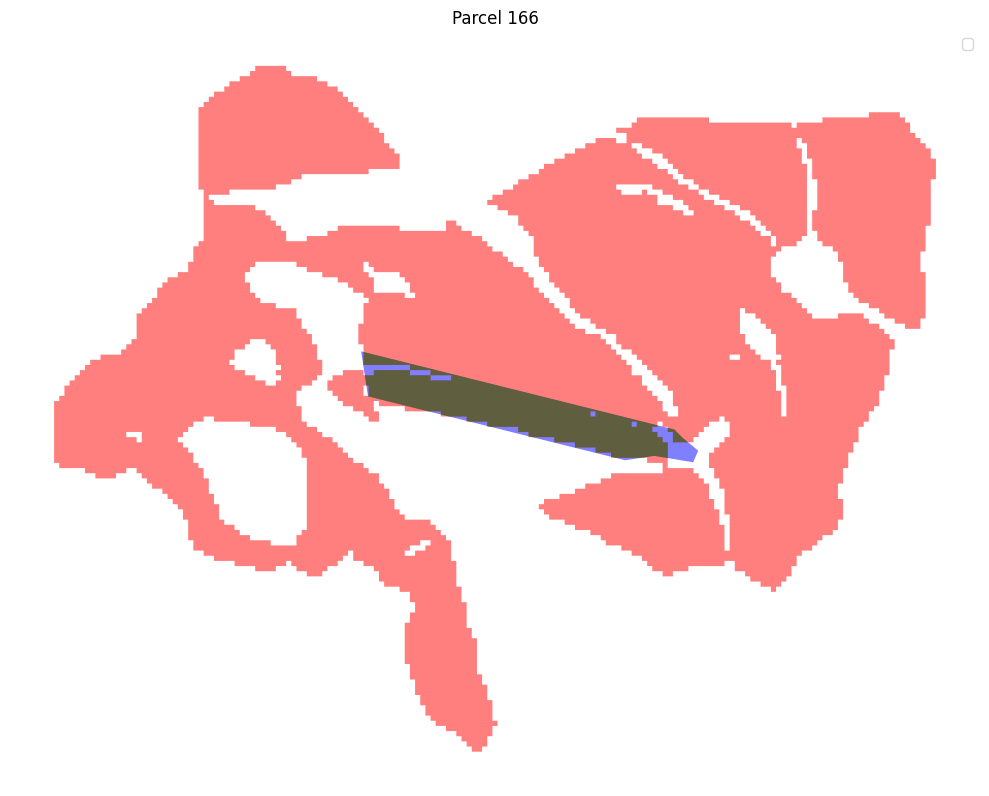

Parcel 166:
True Positive (Correctly predicted): 10947.06 m²
False Negative (Missed): 1647.56 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

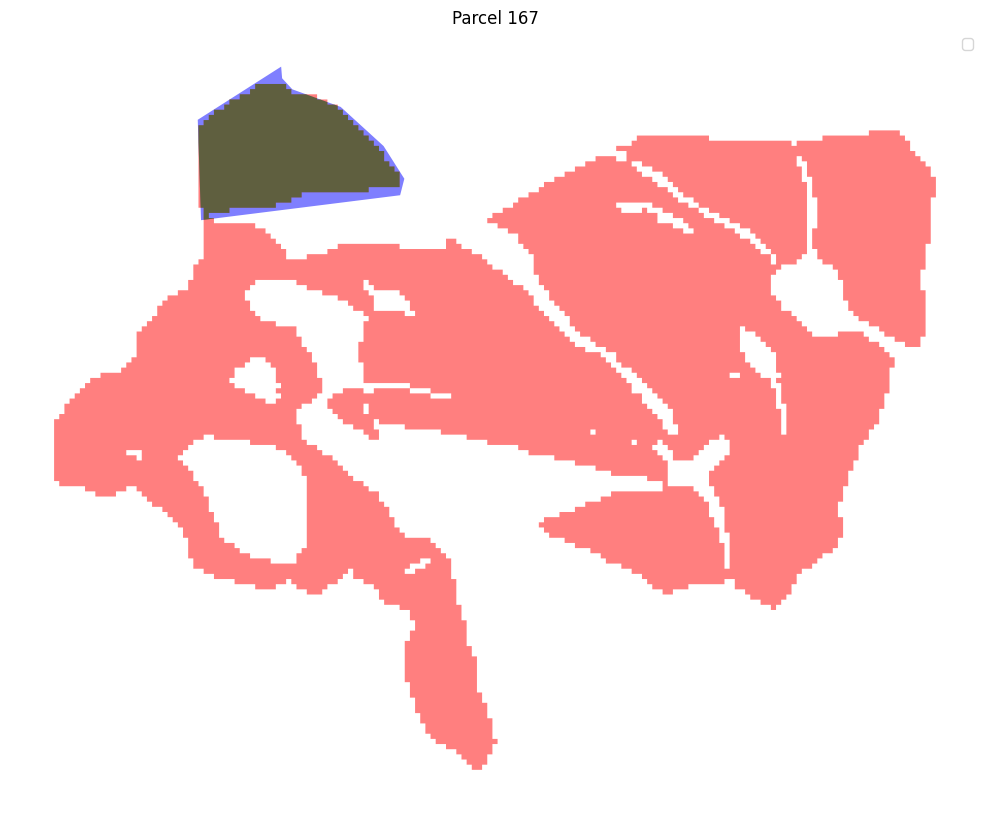

Parcel 167:
True Positive (Correctly predicted): 16713.57 m²
False Negative (Missed): 2518.62 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

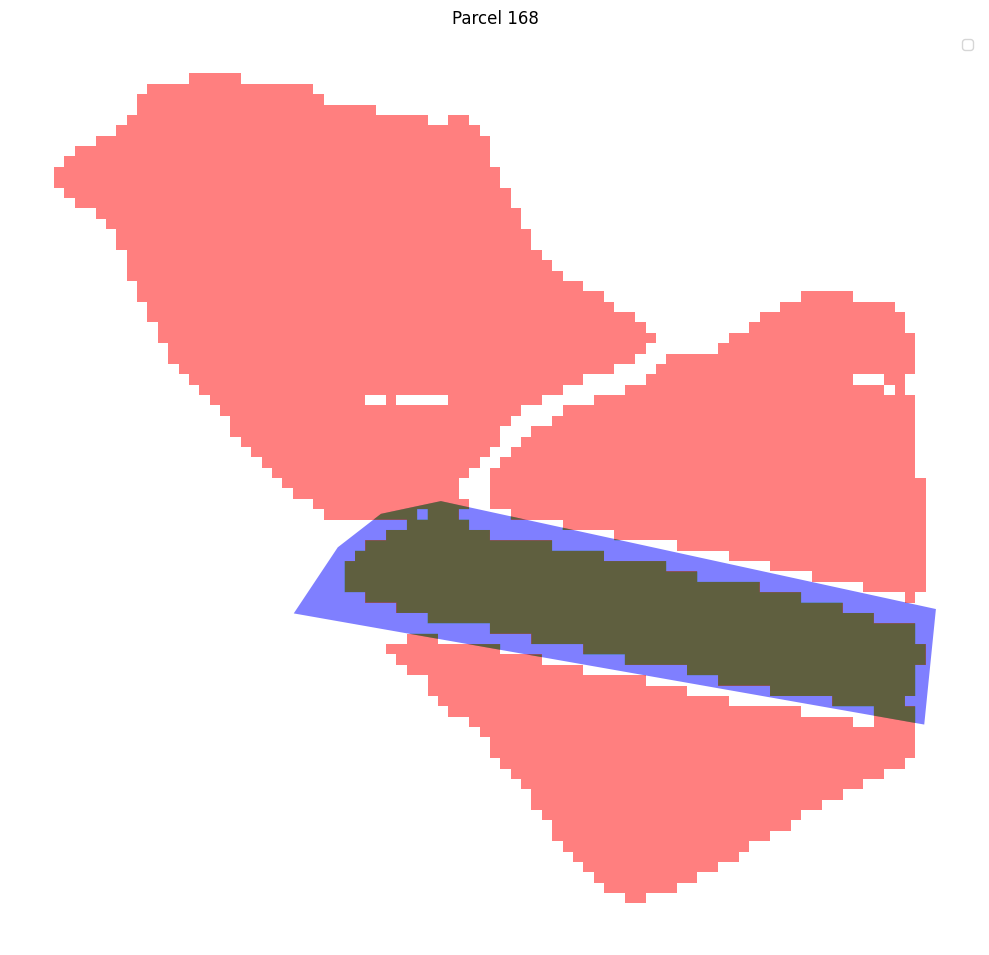

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 168:
True Positive (Correctly predicted): 12727.66 m²
False Negative (Missed): 4901.15 m²
Adjusted IoU: 0.72




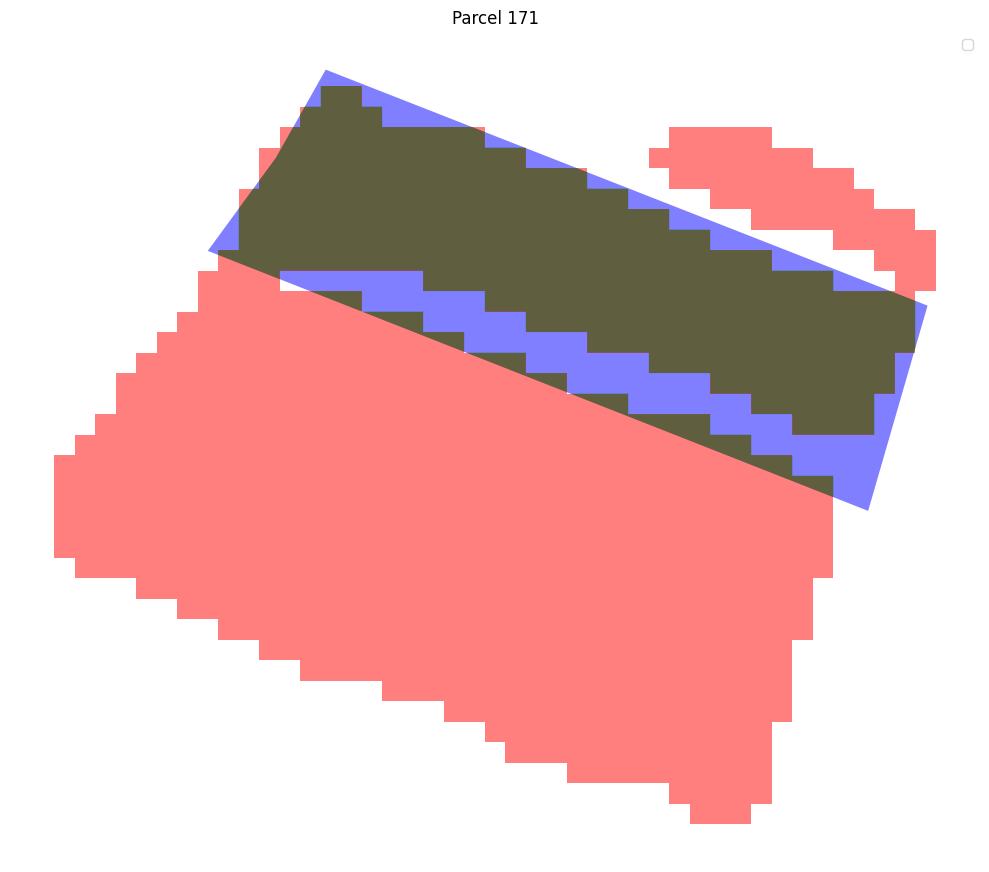

Parcel 171:
True Positive (Correctly predicted): 6414.79 m²
False Negative (Missed): 2100.19 m²
Adjusted IoU: 0.75




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

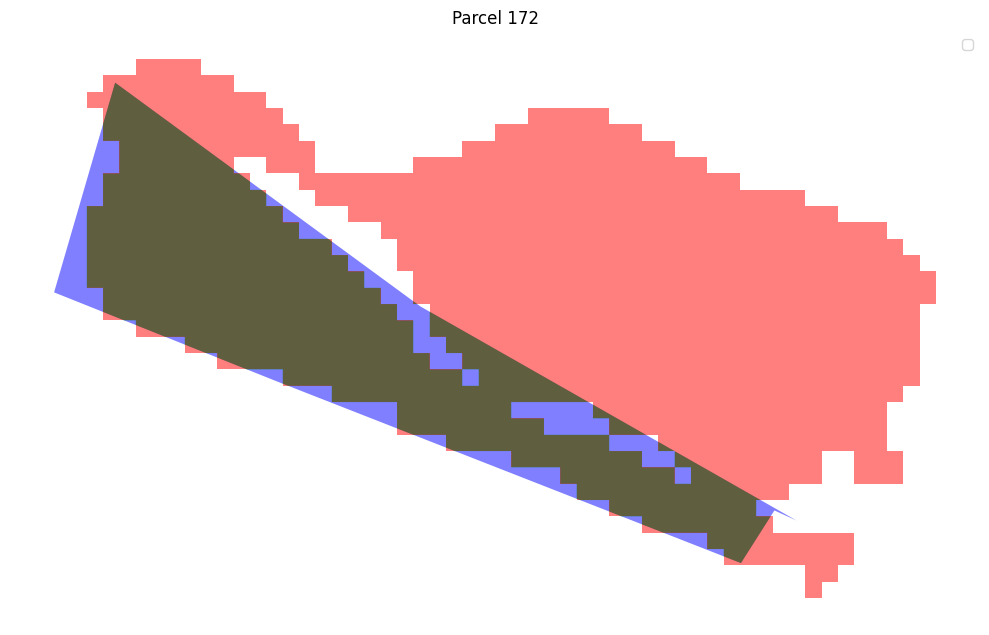

Parcel 172:
True Positive (Correctly predicted): 7618.94 m²
False Negative (Missed): 1493.43 m²
Adjusted IoU: 0.84




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

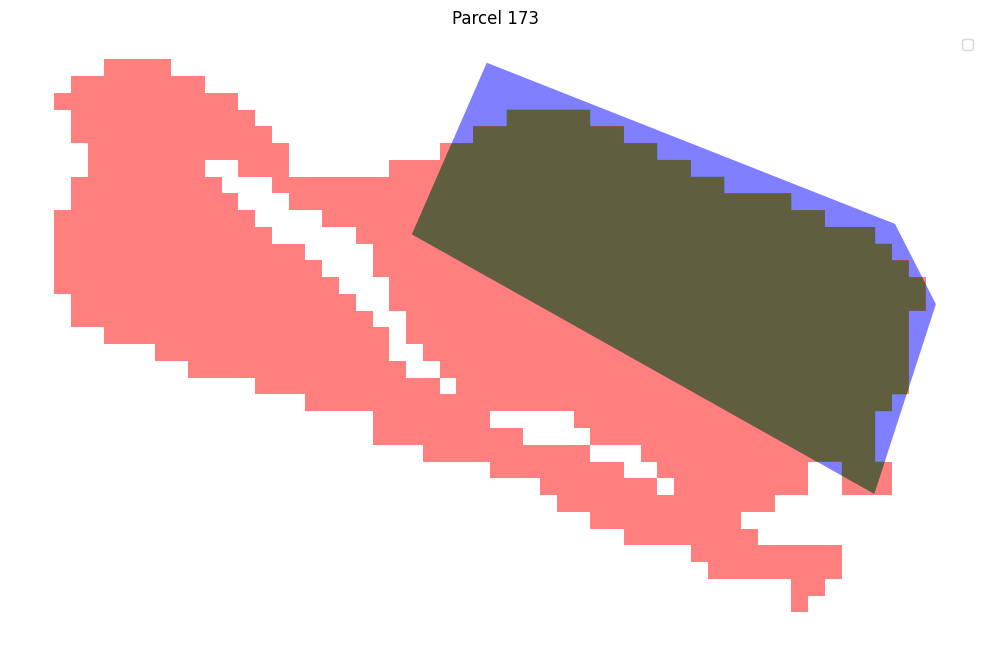

Parcel 173:
True Positive (Correctly predicted): 8785.36 m²
False Negative (Missed): 1230.93 m²
Adjusted IoU: 0.88




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

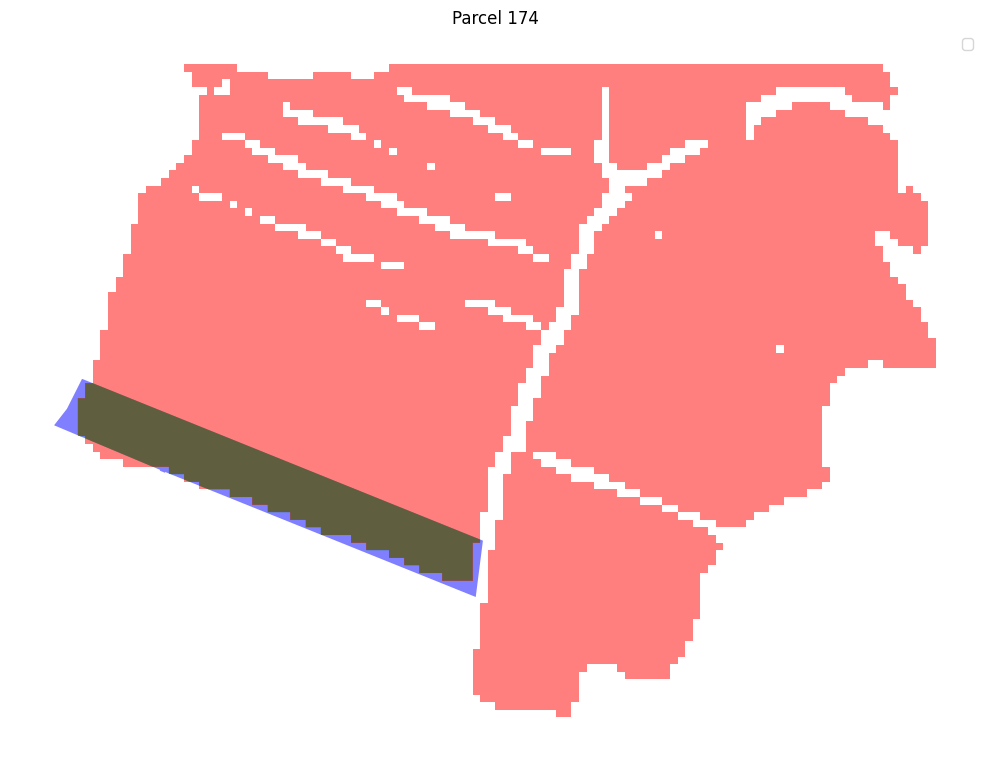

Parcel 174:
True Positive (Correctly predicted): 9342.50 m²
False Negative (Missed): 1191.17 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

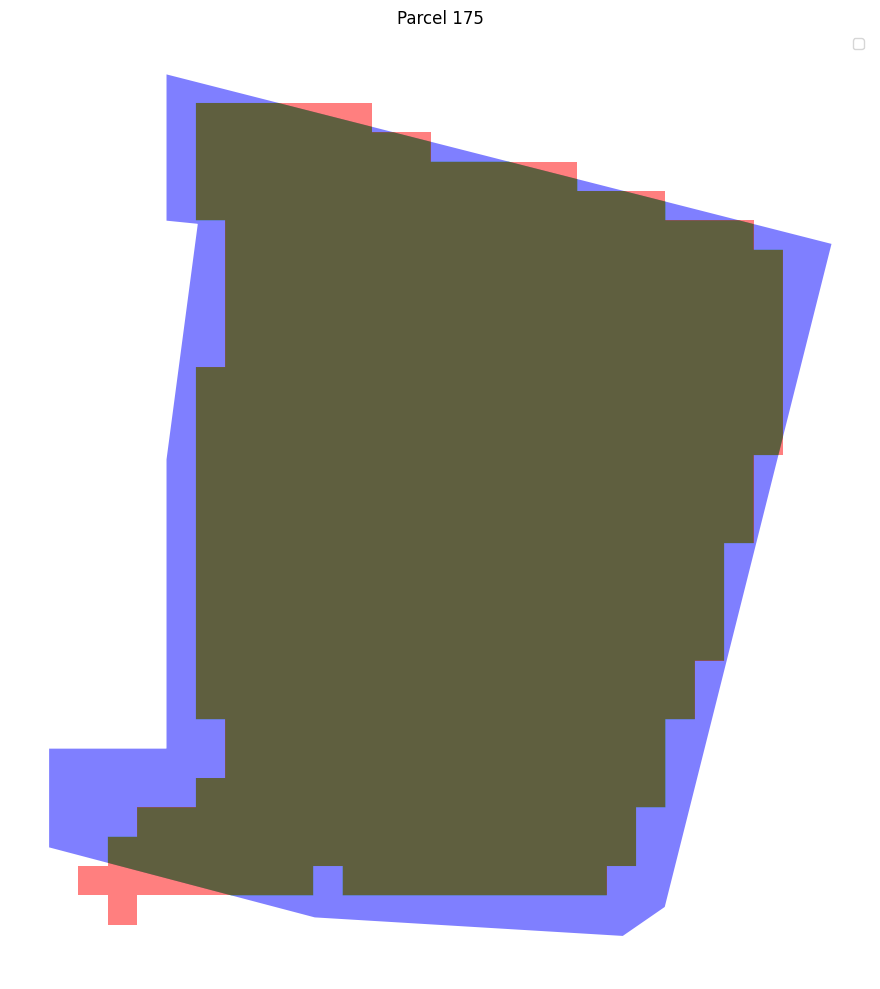

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 175:
True Positive (Correctly predicted): 11303.57 m²
False Negative (Missed): 1958.91 m²
Adjusted IoU: 0.85




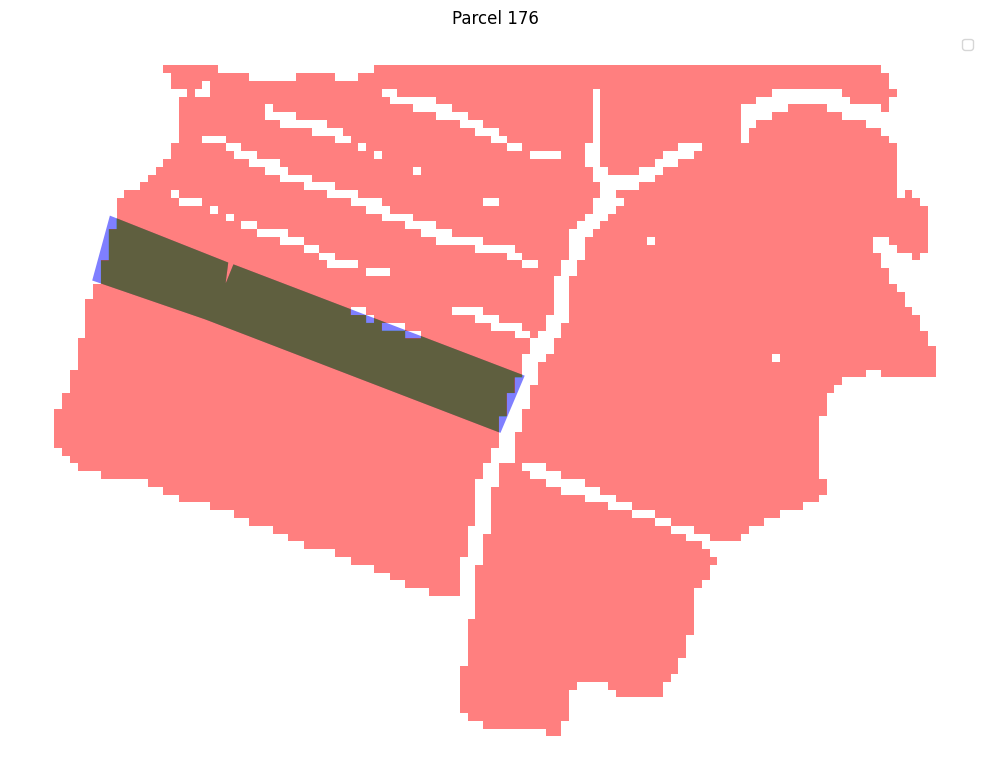

Parcel 176:
True Positive (Correctly predicted): 10825.96 m²
False Negative (Missed): 435.41 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

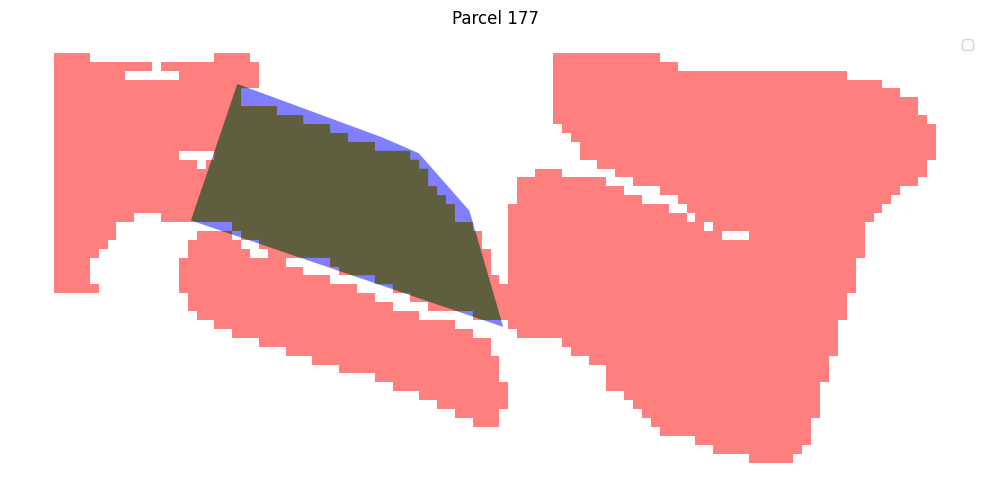

Parcel 177:
True Positive (Correctly predicted): 11090.68 m²
False Negative (Missed): 1117.20 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

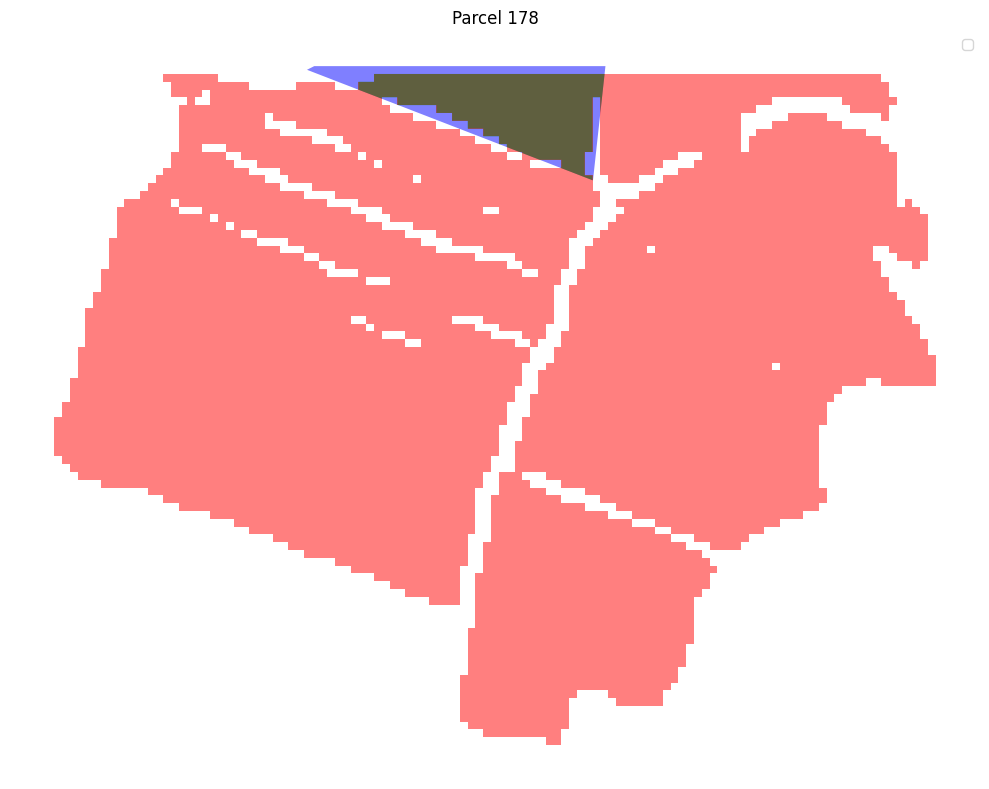

Parcel 178:
True Positive (Correctly predicted): 5476.85 m²
False Negative (Missed): 1732.74 m²
Adjusted IoU: 0.76




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

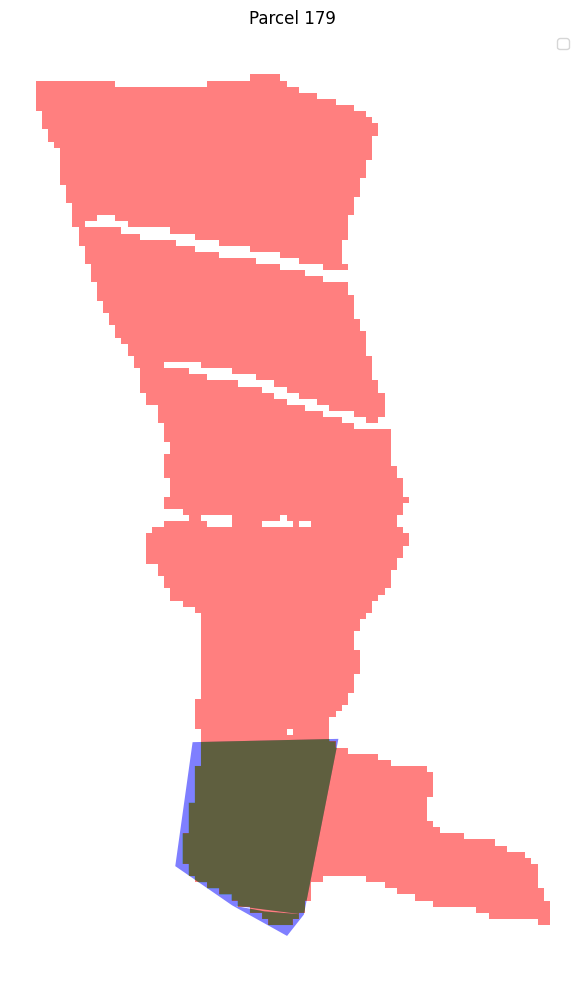

Parcel 179:
True Positive (Correctly predicted): 14340.41 m²
False Negative (Missed): 1055.64 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

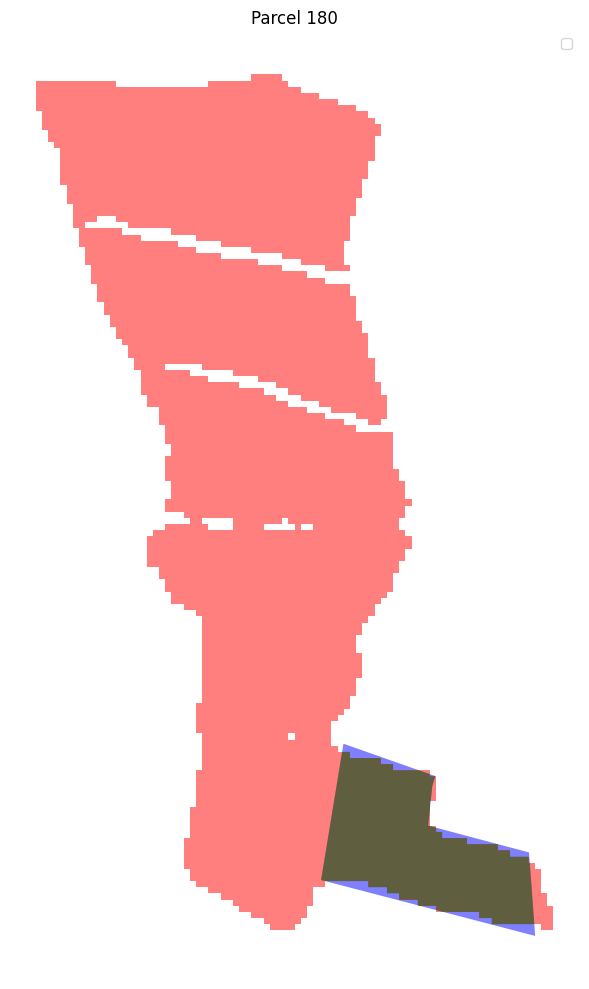

Parcel 180:
True Positive (Correctly predicted): 13213.35 m²
False Negative (Missed): 1276.27 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

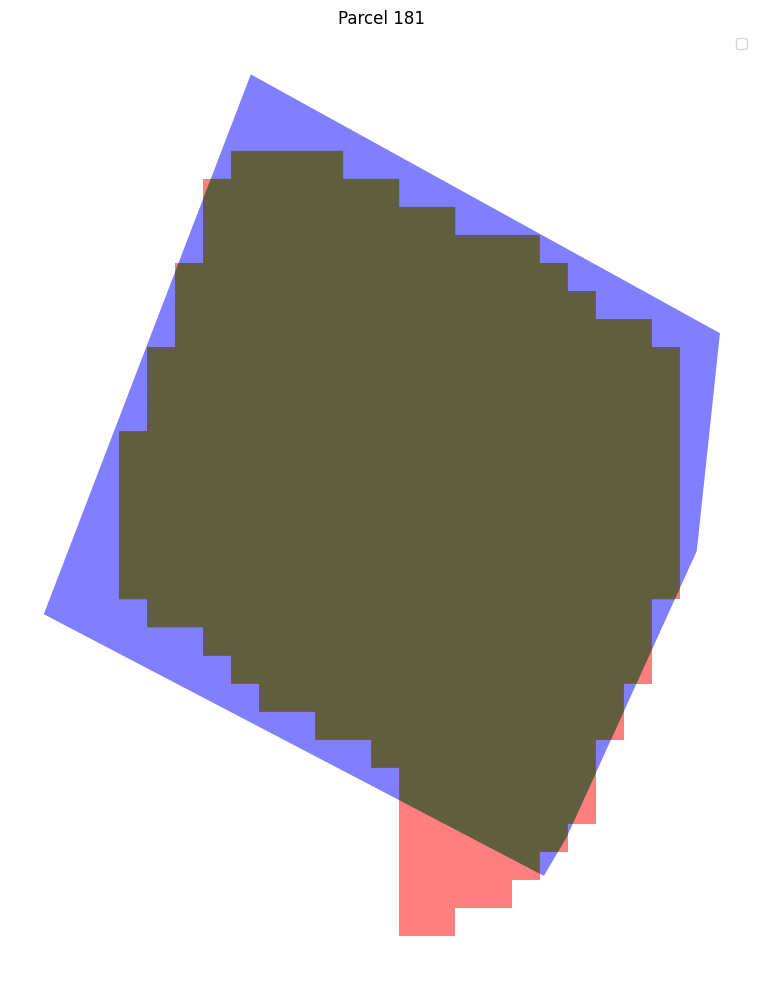

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 181:
True Positive (Correctly predicted): 8795.19 m²
False Negative (Missed): 1561.56 m²
Adjusted IoU: 0.85




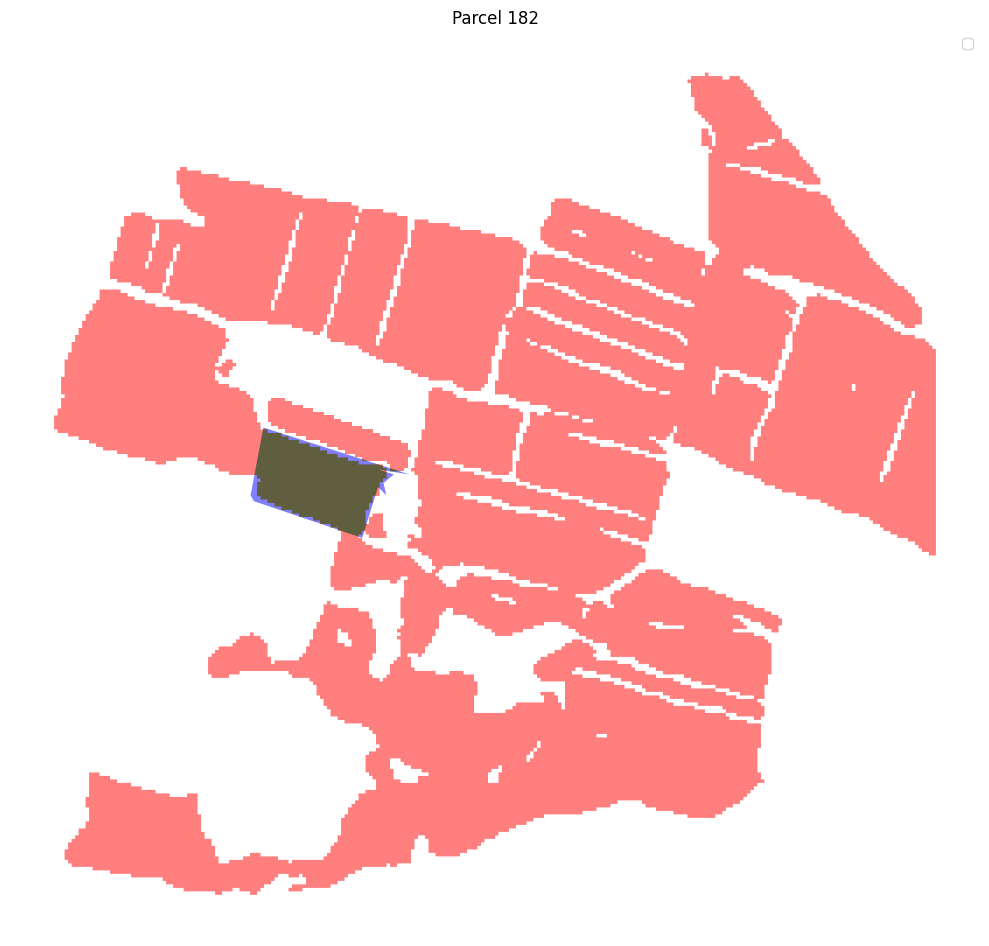

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 182:
True Positive (Correctly predicted): 17026.13 m²
False Negative (Missed): 1866.42 m²
Adjusted IoU: 0.90




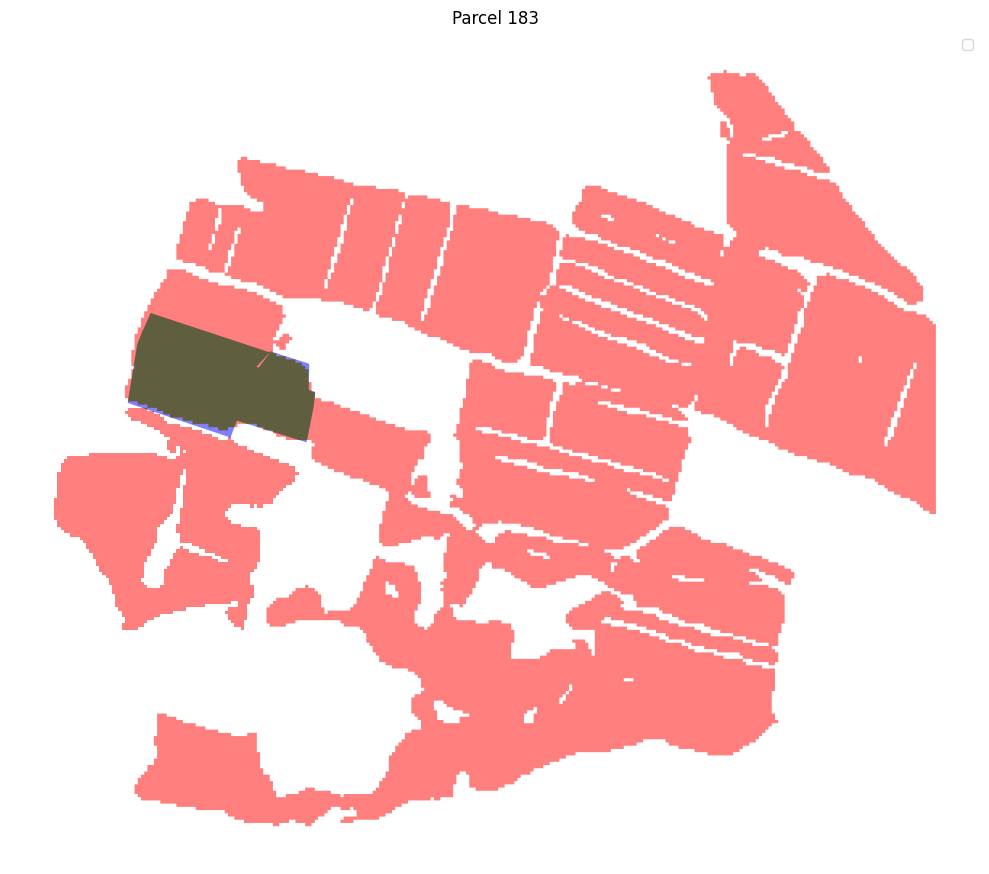

Parcel 183:
True Positive (Correctly predicted): 36340.46 m²
False Negative (Missed): 1207.10 m²
Adjusted IoU: 0.97




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

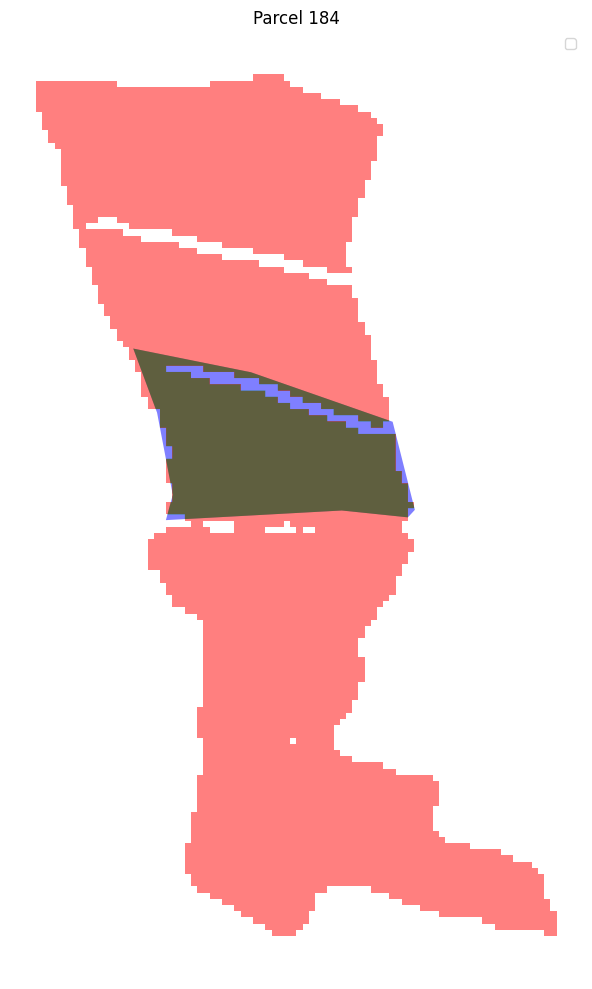

Parcel 184:
True Positive (Correctly predicted): 18802.99 m²
False Negative (Missed): 1936.24 m²
Adjusted IoU: 0.91




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

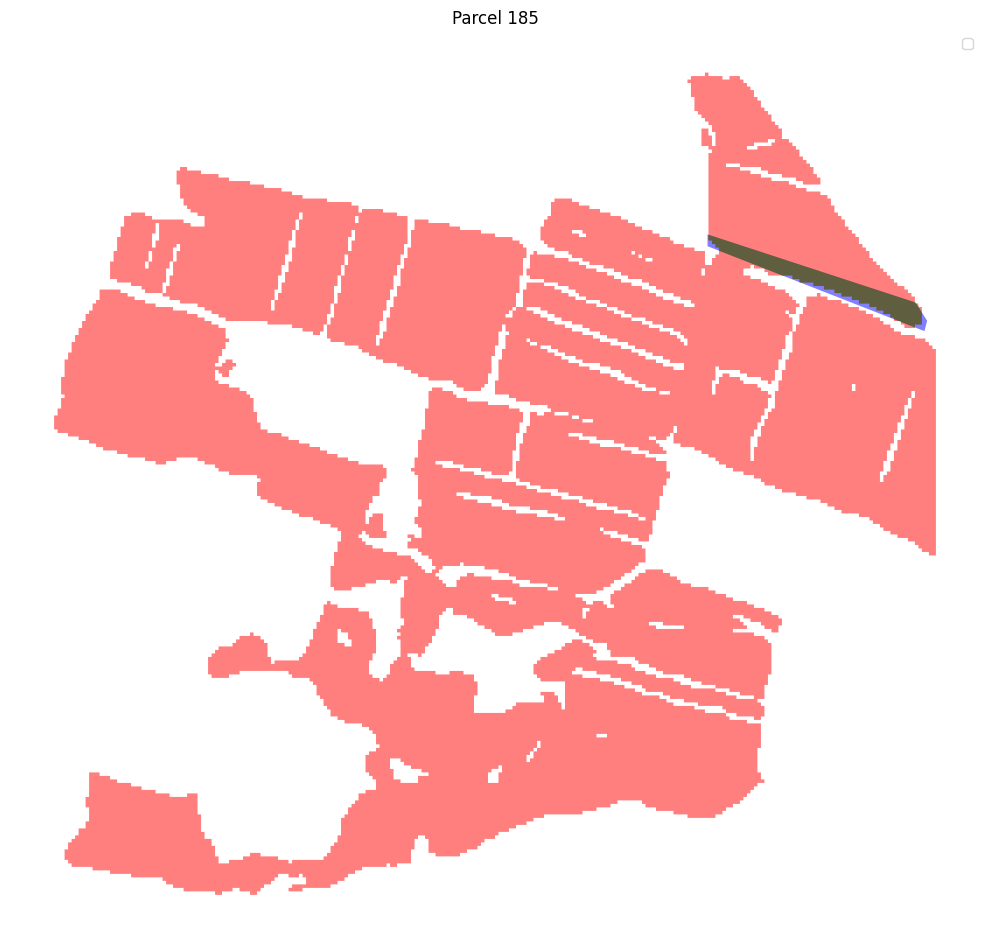

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 185:
True Positive (Correctly predicted): 7176.54 m²
False Negative (Missed): 1054.50 m²
Adjusted IoU: 0.87




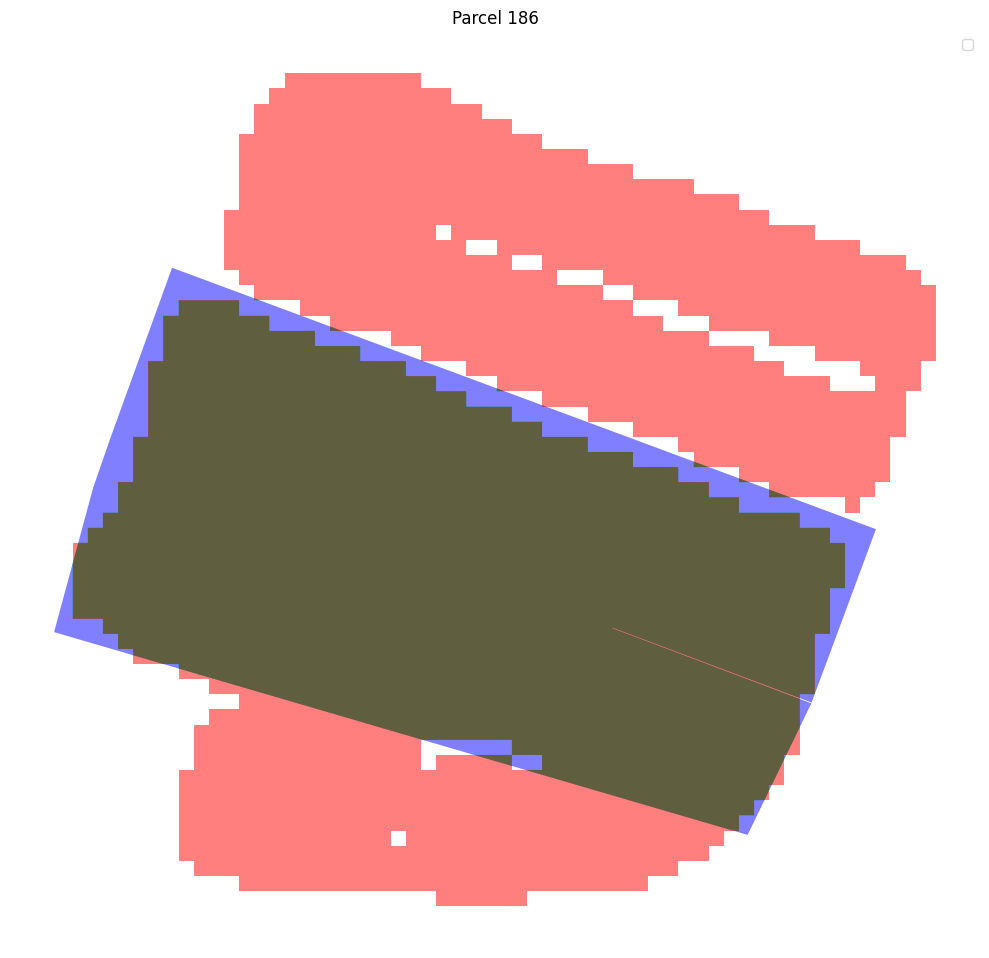

Parcel 186:
True Positive (Correctly predicted): 26119.04 m²
False Negative (Missed): 2786.64 m²
Adjusted IoU: 0.90




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

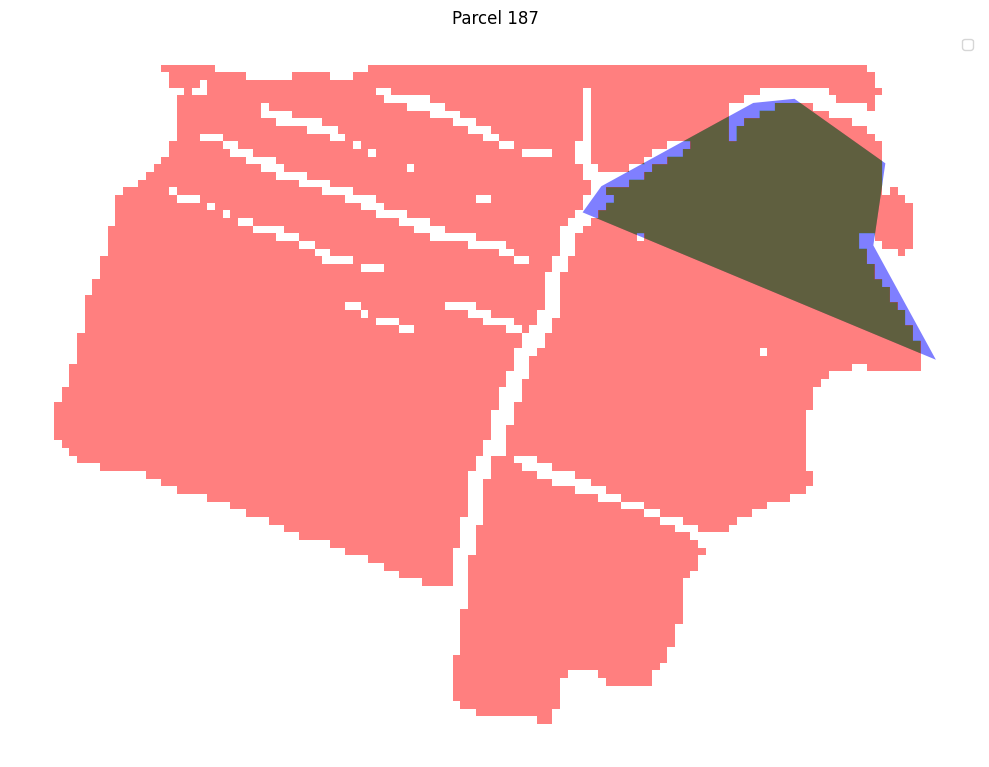

Parcel 187:
True Positive (Correctly predicted): 16713.83 m²
False Negative (Missed): 1496.57 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

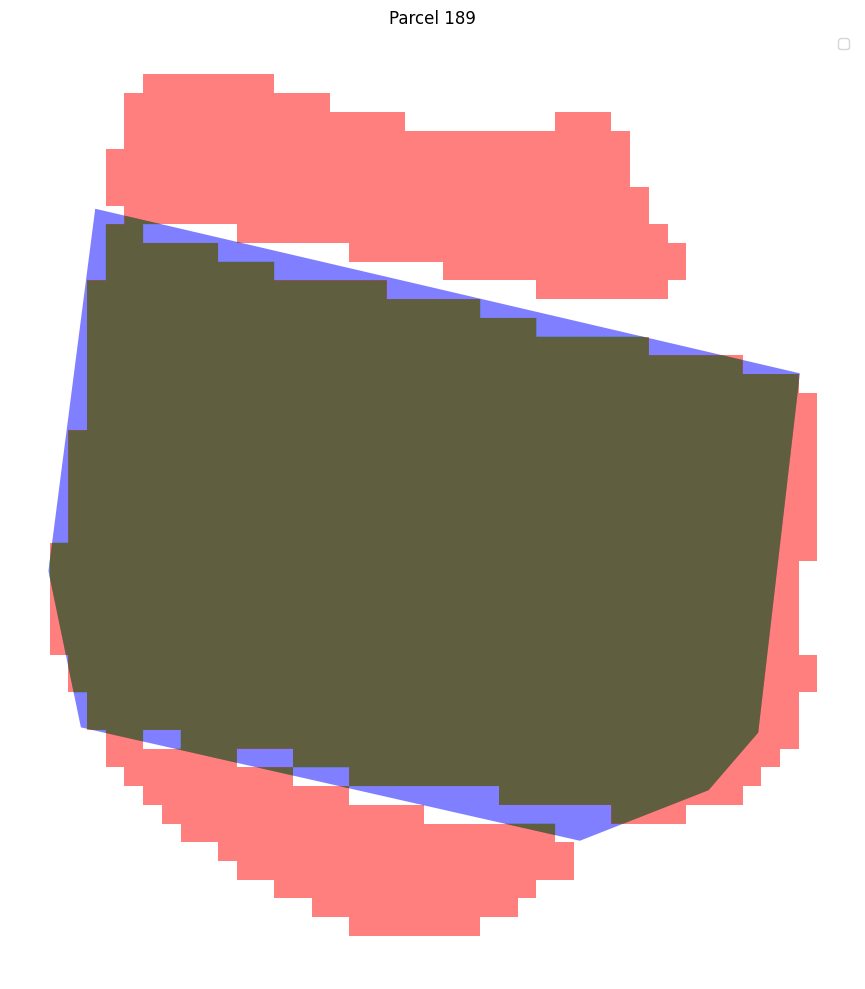

Parcel 189:
True Positive (Correctly predicted): 23827.16 m²
False Negative (Missed): 1457.64 m²
Adjusted IoU: 0.94




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

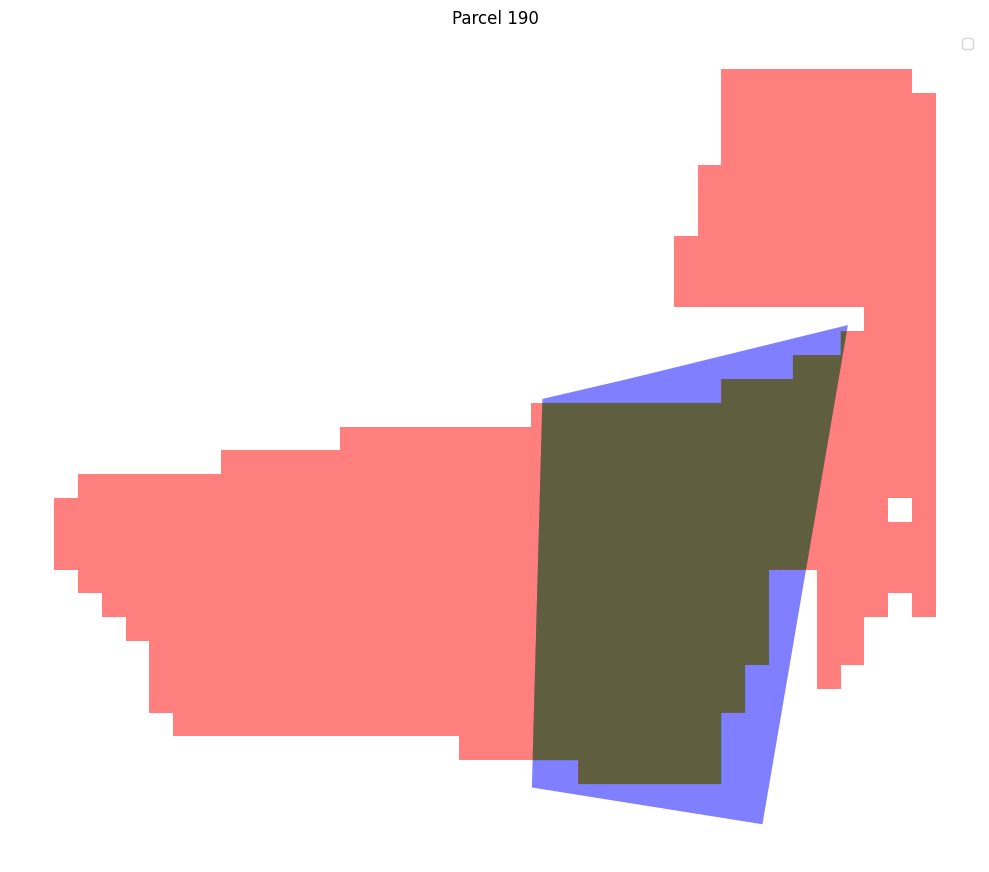

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 190:
True Positive (Correctly predicted): 4195.28 m²
False Negative (Missed): 995.84 m²
Adjusted IoU: 0.81




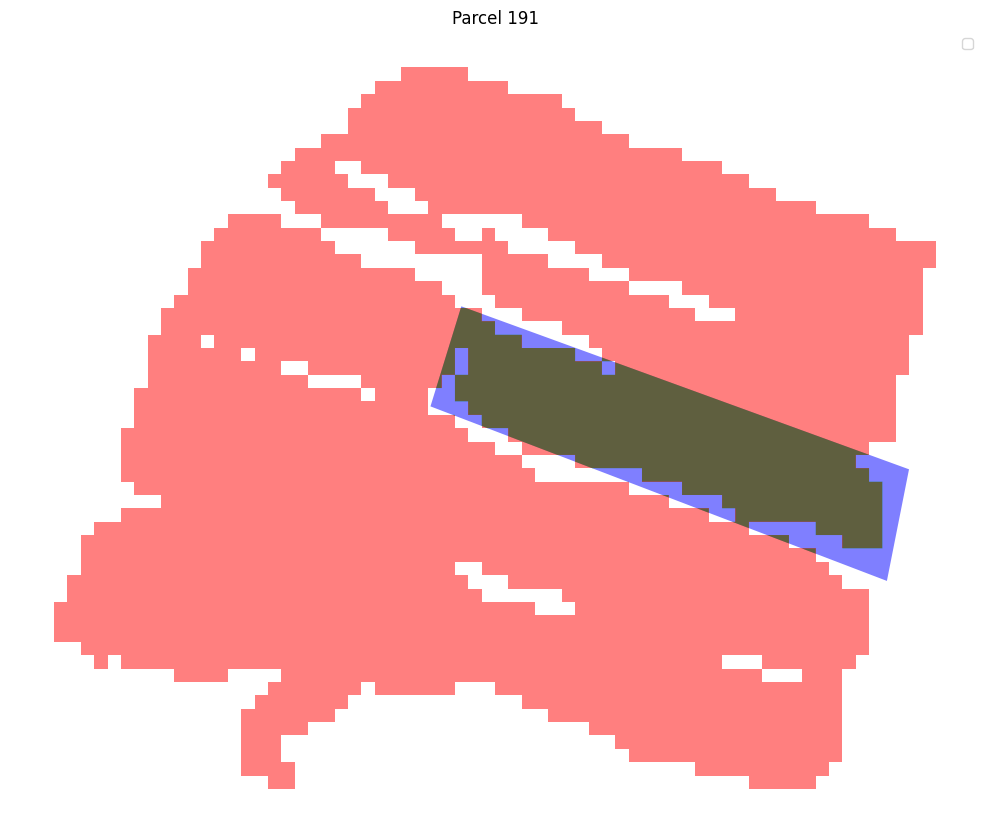

Parcel 191:
True Positive (Correctly predicted): 5973.22 m²
False Negative (Missed): 1352.41 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

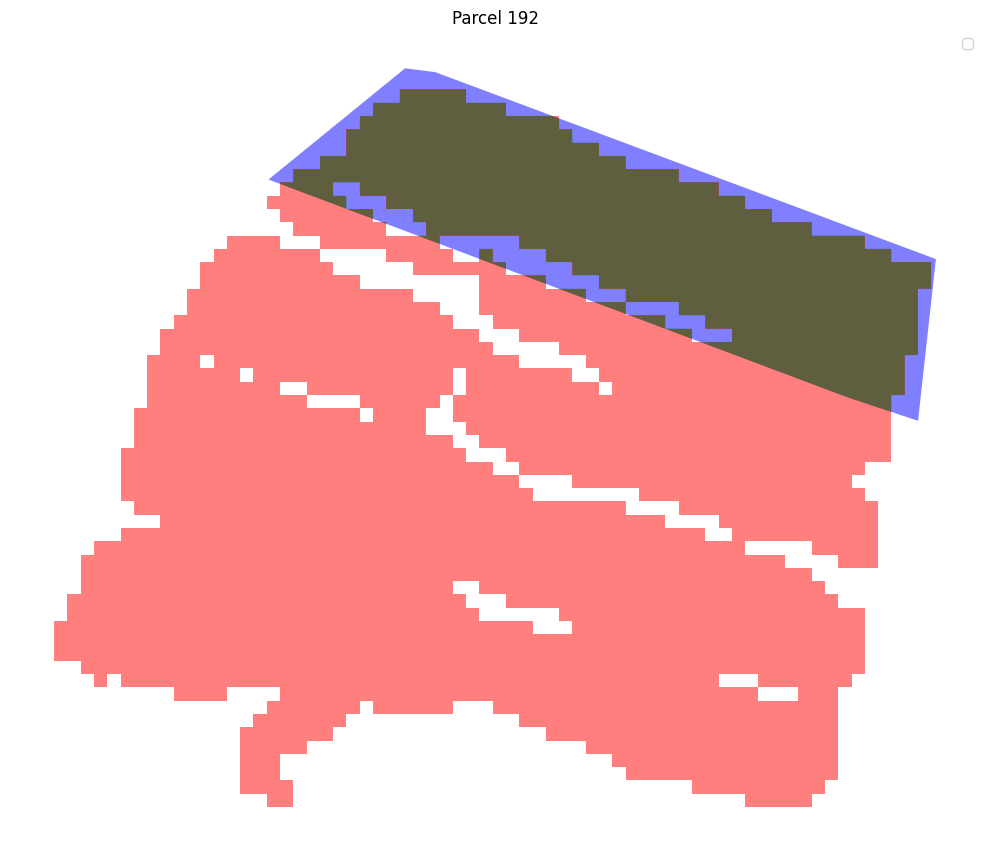

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 192:
True Positive (Correctly predicted): 11423.68 m²
False Negative (Missed): 2725.27 m²
Adjusted IoU: 0.81




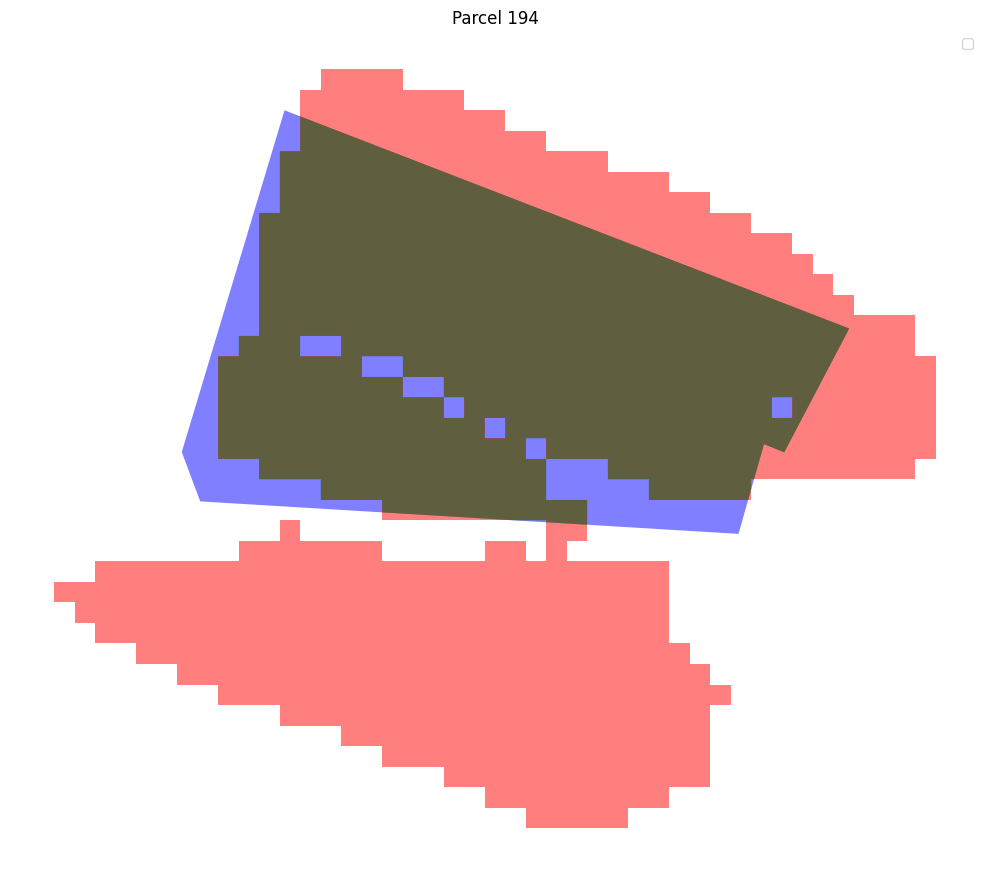

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 194:
True Positive (Correctly predicted): 9296.35 m²
False Negative (Missed): 1496.59 m²
Adjusted IoU: 0.86




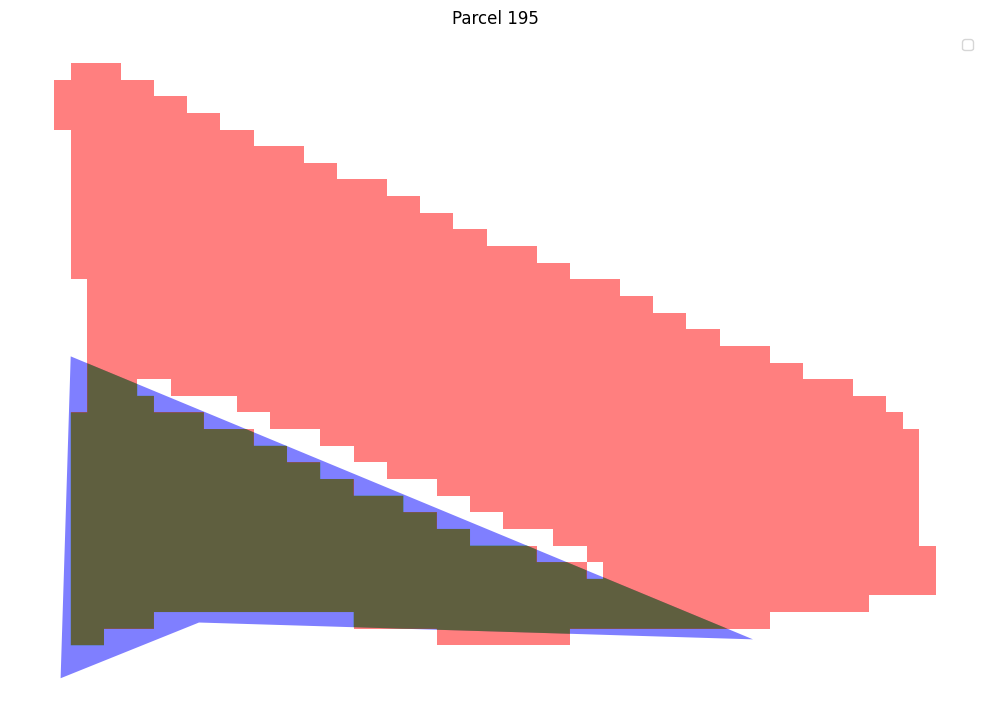

Parcel 195:
True Positive (Correctly predicted): 7386.81 m²
False Negative (Missed): 1159.23 m²
Adjusted IoU: 0.86




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

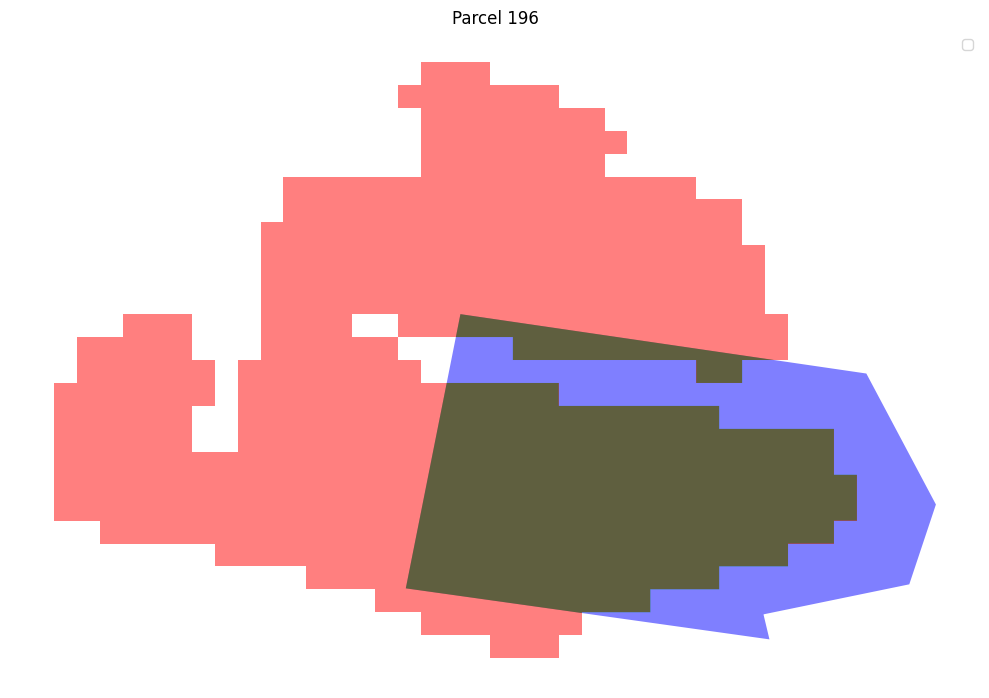

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 196:
True Positive (Correctly predicted): 3956.60 m²
False Negative (Missed): 2060.14 m²
Adjusted IoU: 0.66




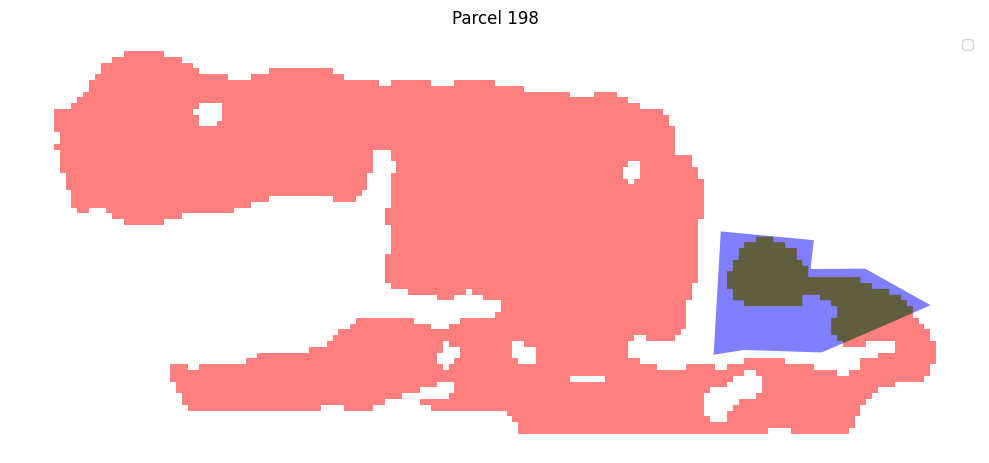

Parcel 198:
True Positive (Correctly predicted): 6179.08 m²
False Negative (Missed): 6554.81 m²
Adjusted IoU: 0.49




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


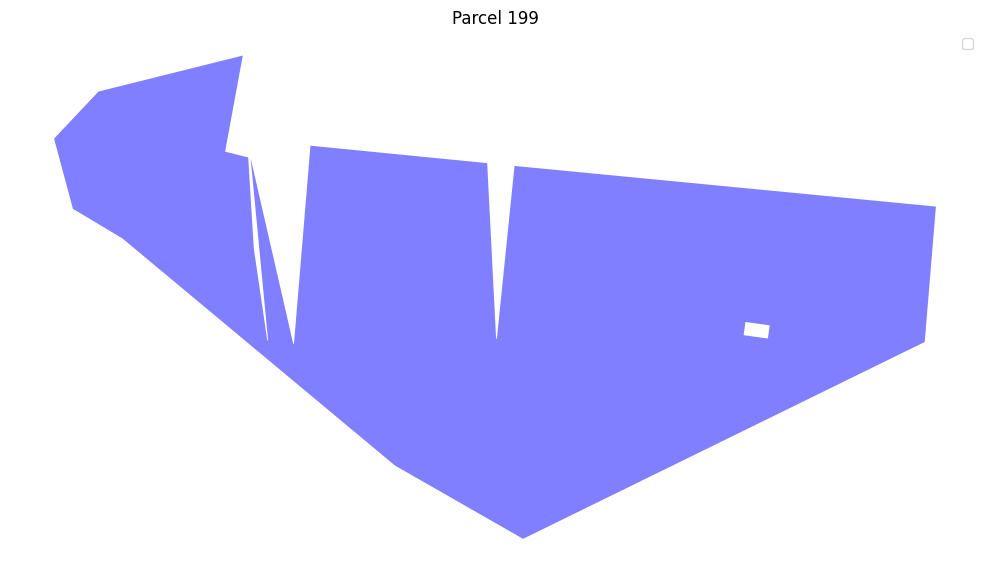

Parcel 199:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 11422.39 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


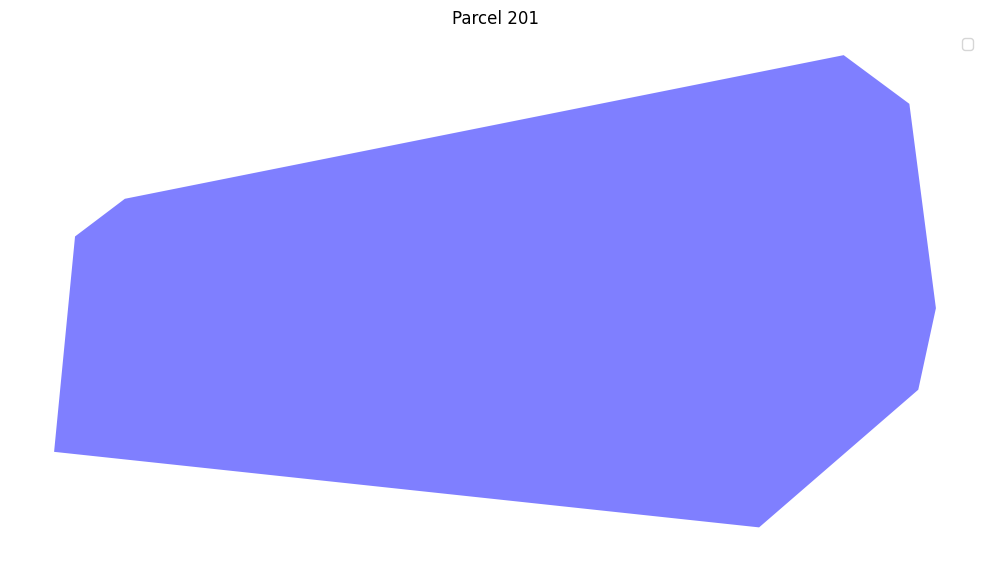

Parcel 201:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 6682.32 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

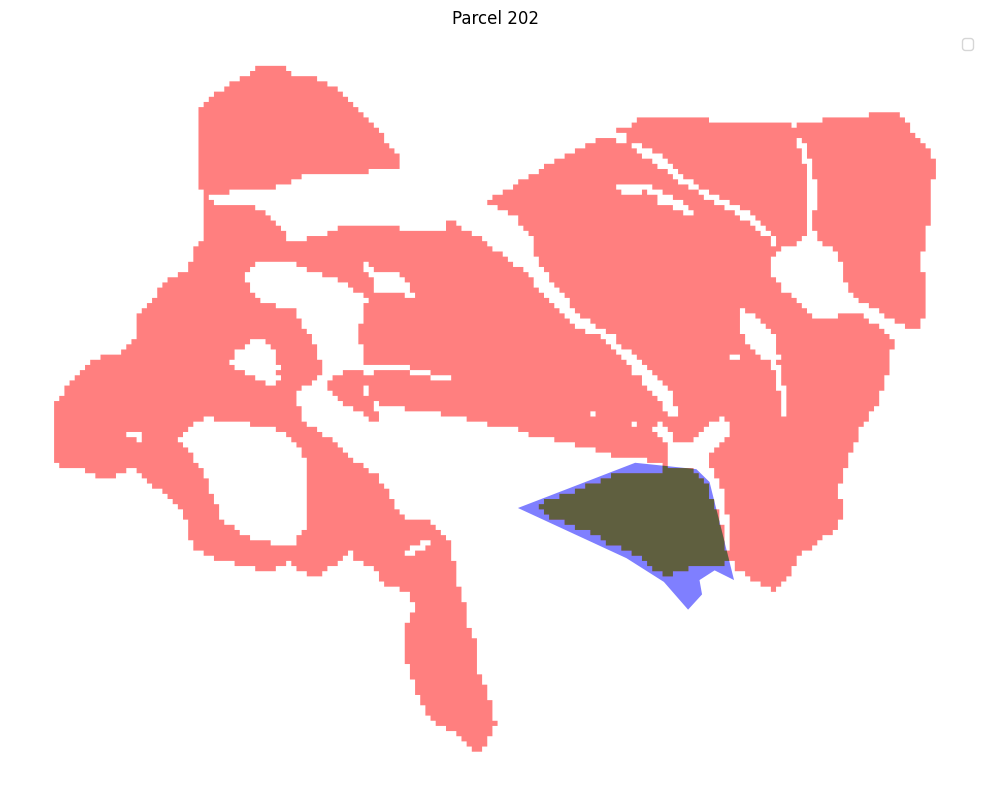

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 202:
True Positive (Correctly predicted): 11641.36 m²
False Negative (Missed): 3108.61 m²
Adjusted IoU: 0.79




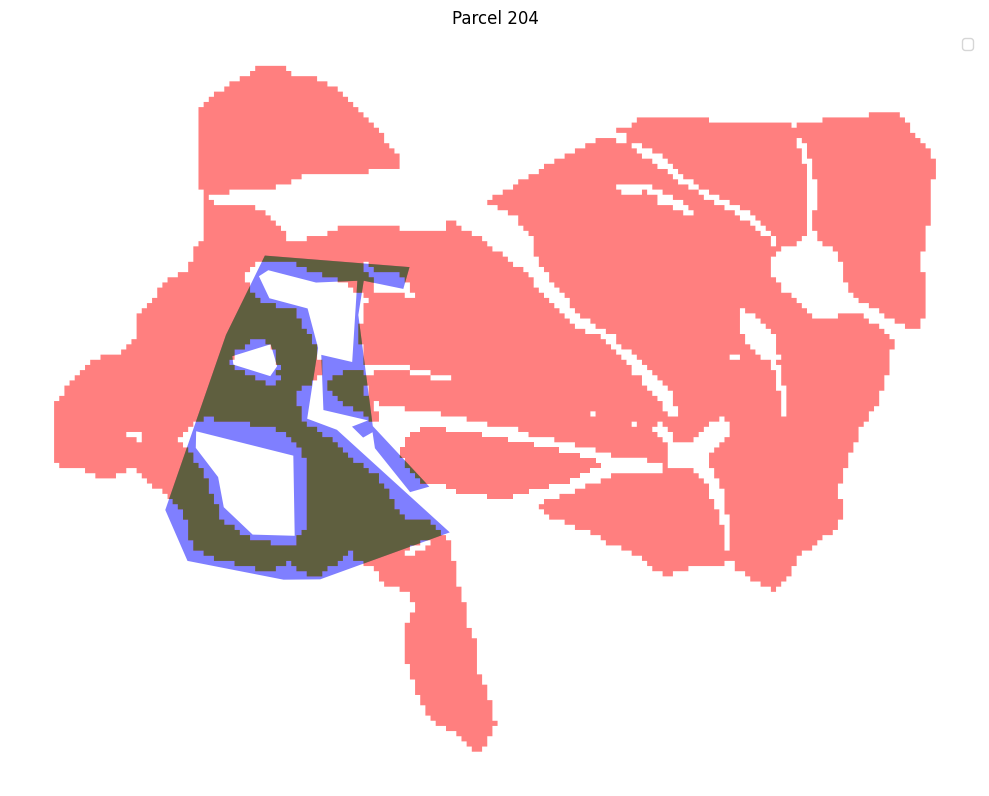

Parcel 204:
True Positive (Correctly predicted): 27215.77 m²
False Negative (Missed): 13401.18 m²
Adjusted IoU: 0.67




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

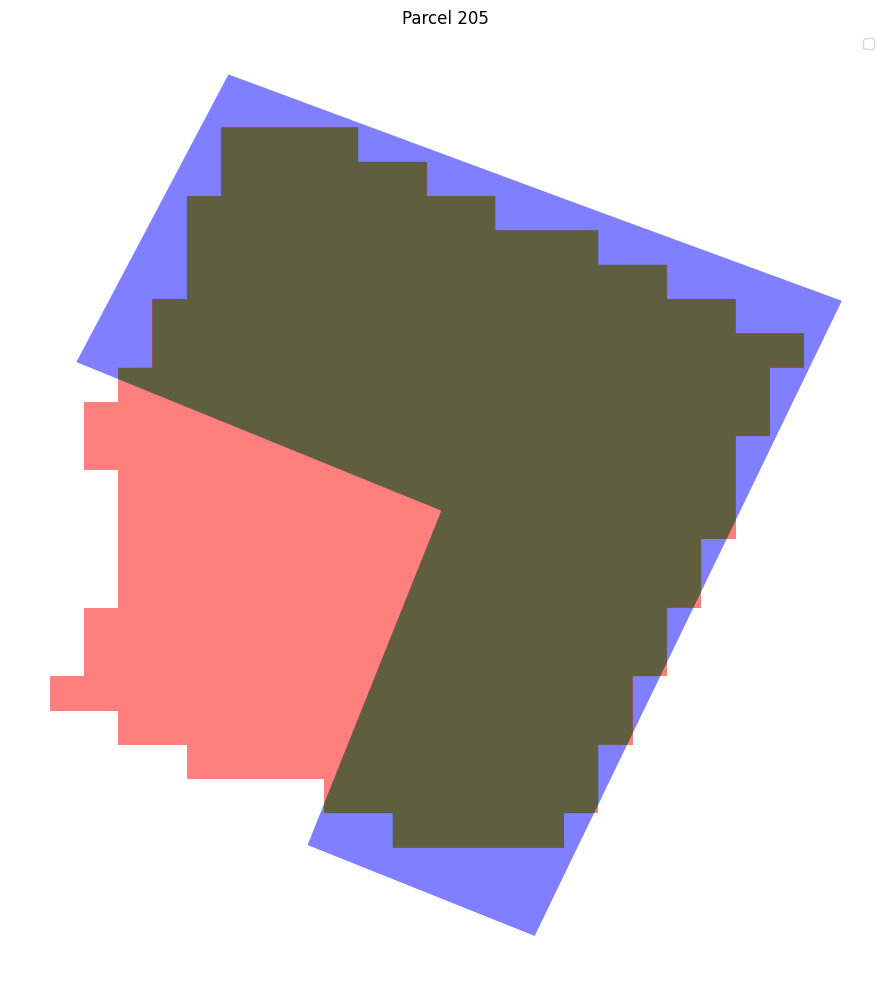

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 205:
True Positive (Correctly predicted): 5402.50 m²
False Negative (Missed): 1235.51 m²
Adjusted IoU: 0.81




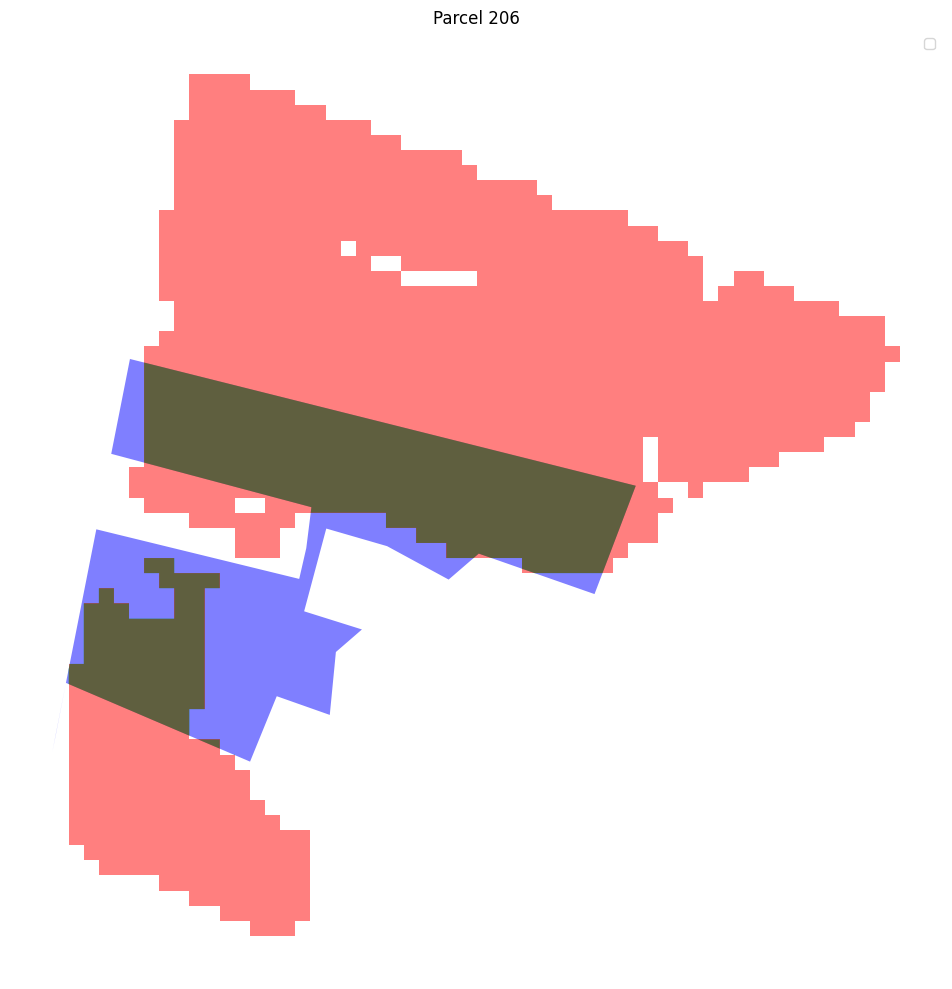

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 206:
True Positive (Correctly predicted): 7011.84 m²
False Negative (Missed): 3710.43 m²
Adjusted IoU: 0.65




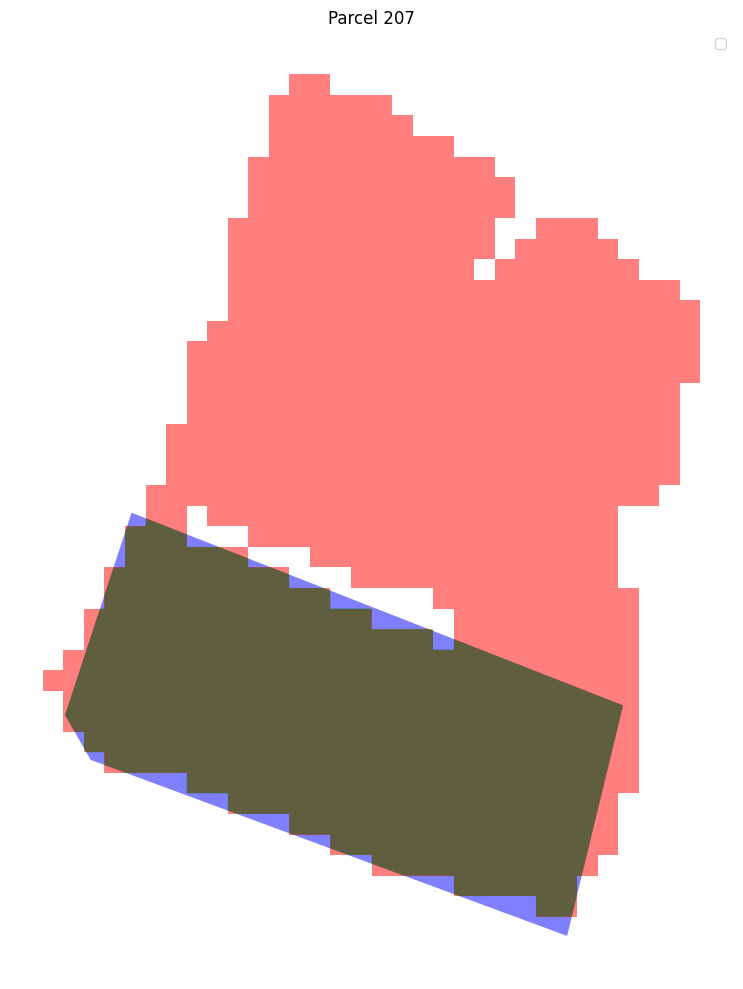

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 207:
True Positive (Correctly predicted): 7233.09 m²
False Negative (Missed): 386.35 m²
Adjusted IoU: 0.95




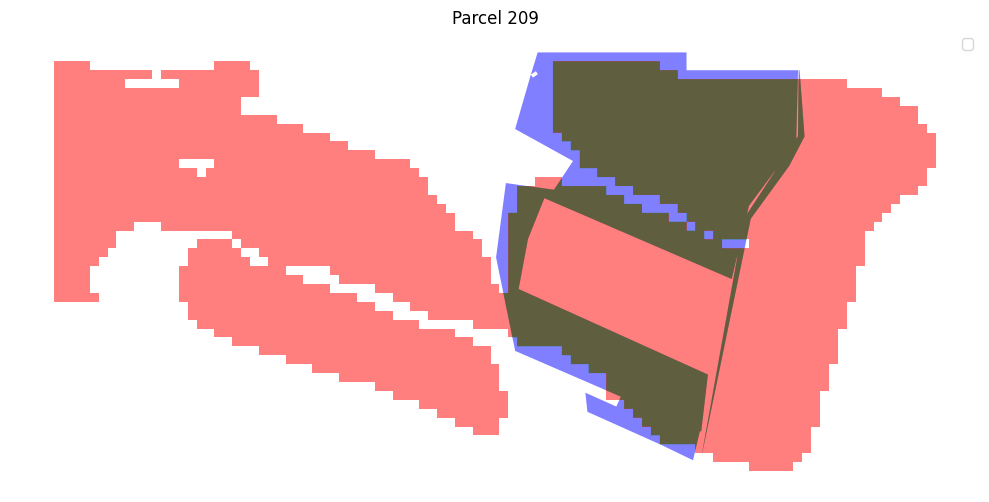

Parcel 209:
True Positive (Correctly predicted): 16122.86 m²
False Negative (Missed): 3653.34 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

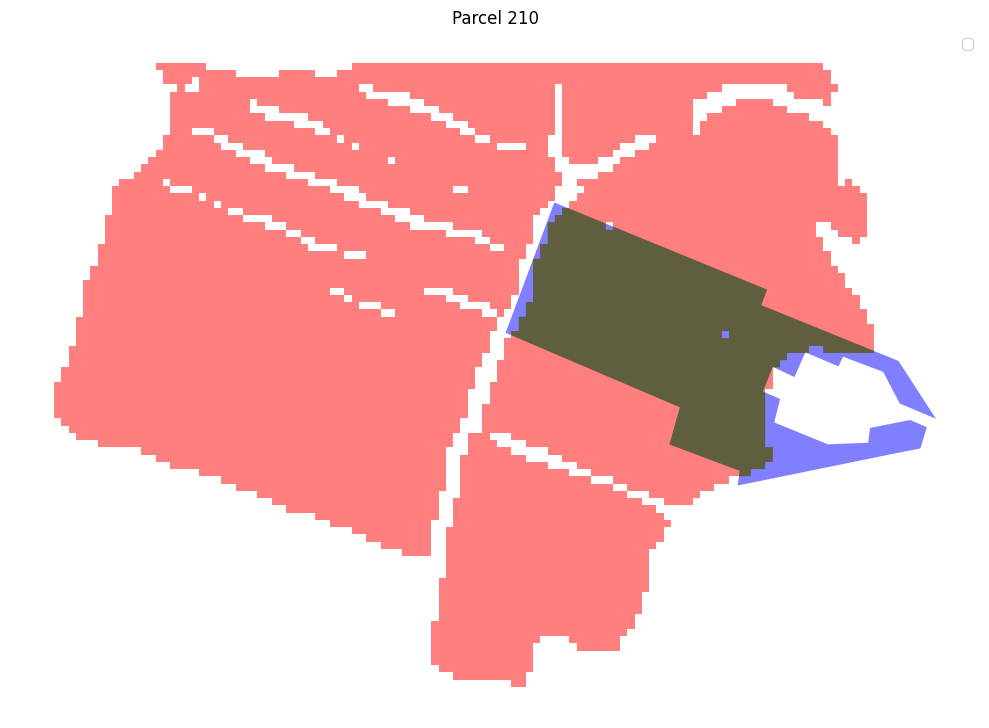

Parcel 210:
True Positive (Correctly predicted): 19572.15 m²
False Negative (Missed): 4281.55 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

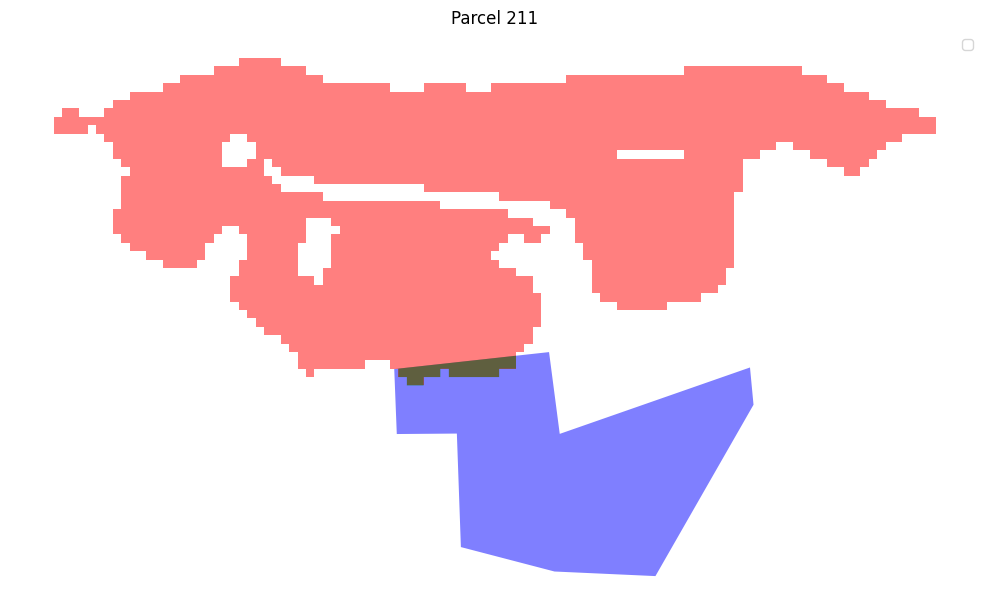

Parcel 211:
True Positive (Correctly predicted): 597.14 m²
False Negative (Missed): 17060.16 m²
Adjusted IoU: 0.03




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

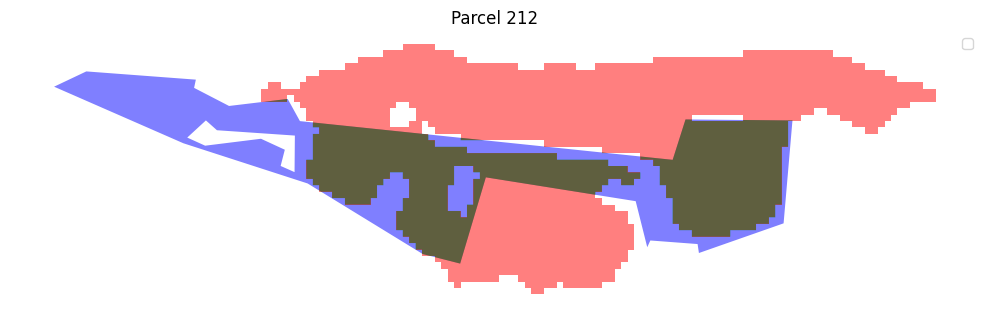

Parcel 212:
True Positive (Correctly predicted): 17947.38 m²
False Negative (Missed): 12922.25 m²
Adjusted IoU: 0.58




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

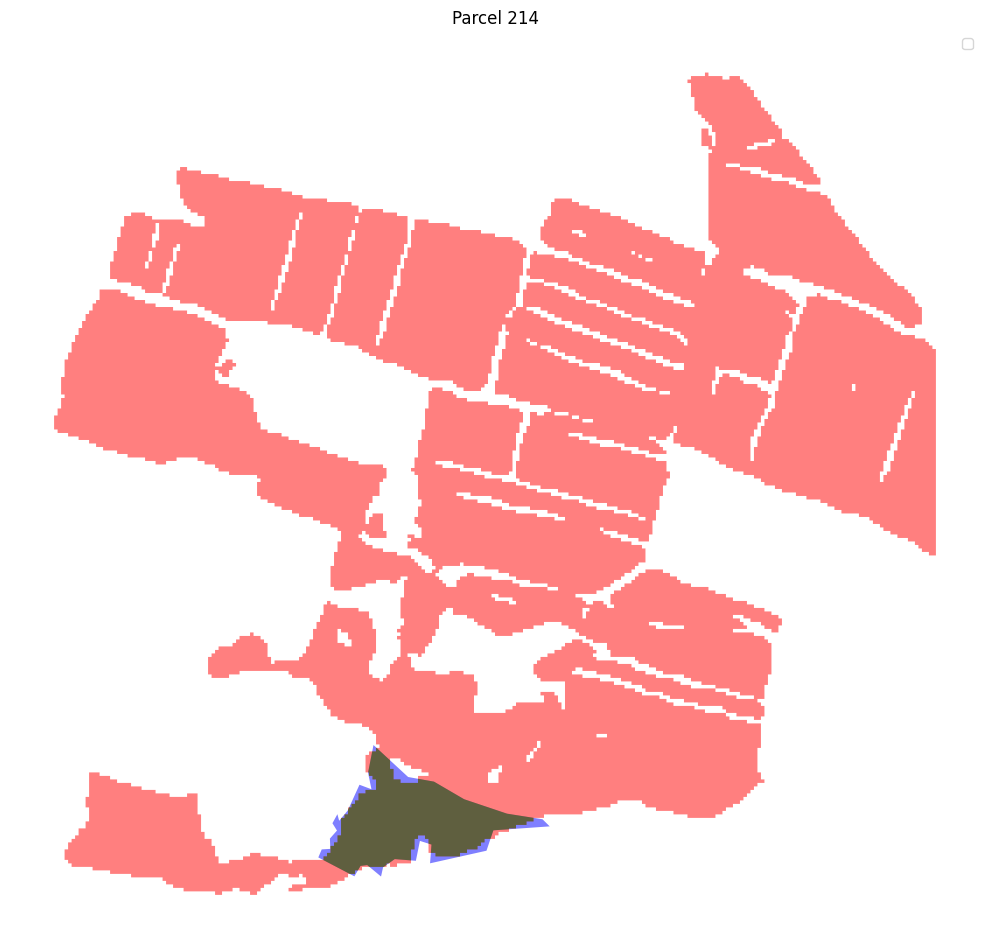

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 214:
True Positive (Correctly predicted): 22883.01 m²
False Negative (Missed): 2952.29 m²
Adjusted IoU: 0.89




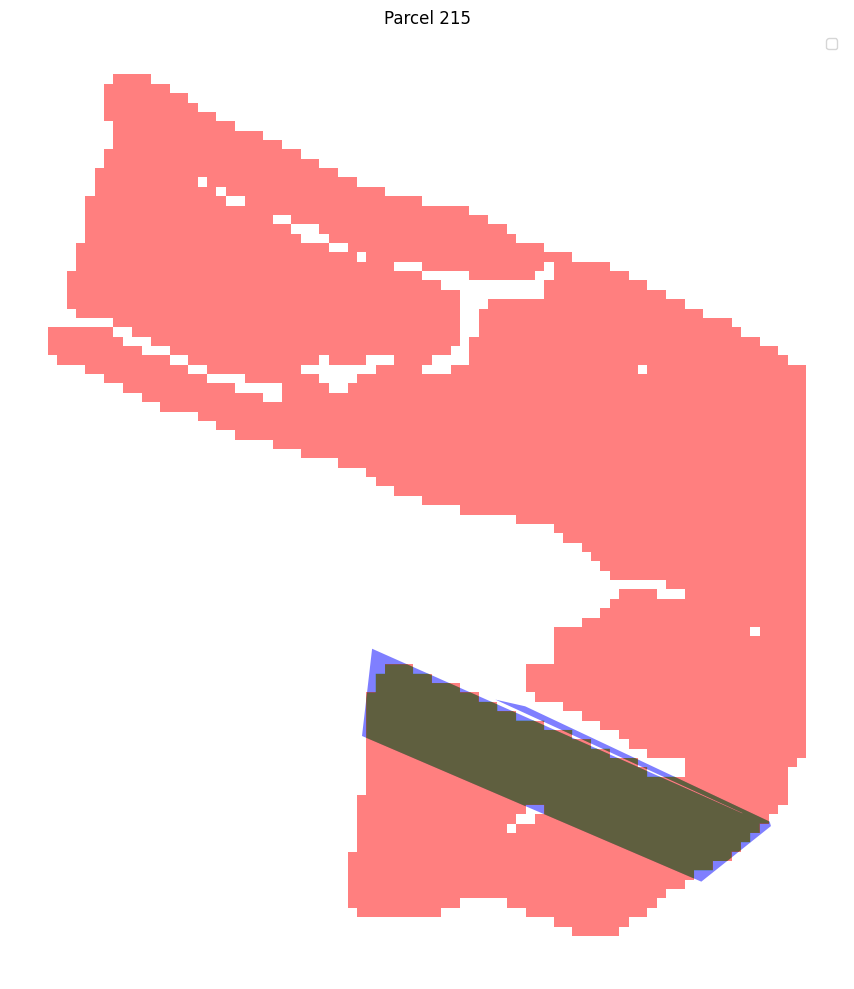

Parcel 215:
True Positive (Correctly predicted): 9067.21 m²
False Negative (Missed): 691.49 m²
Adjusted IoU: 0.93




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

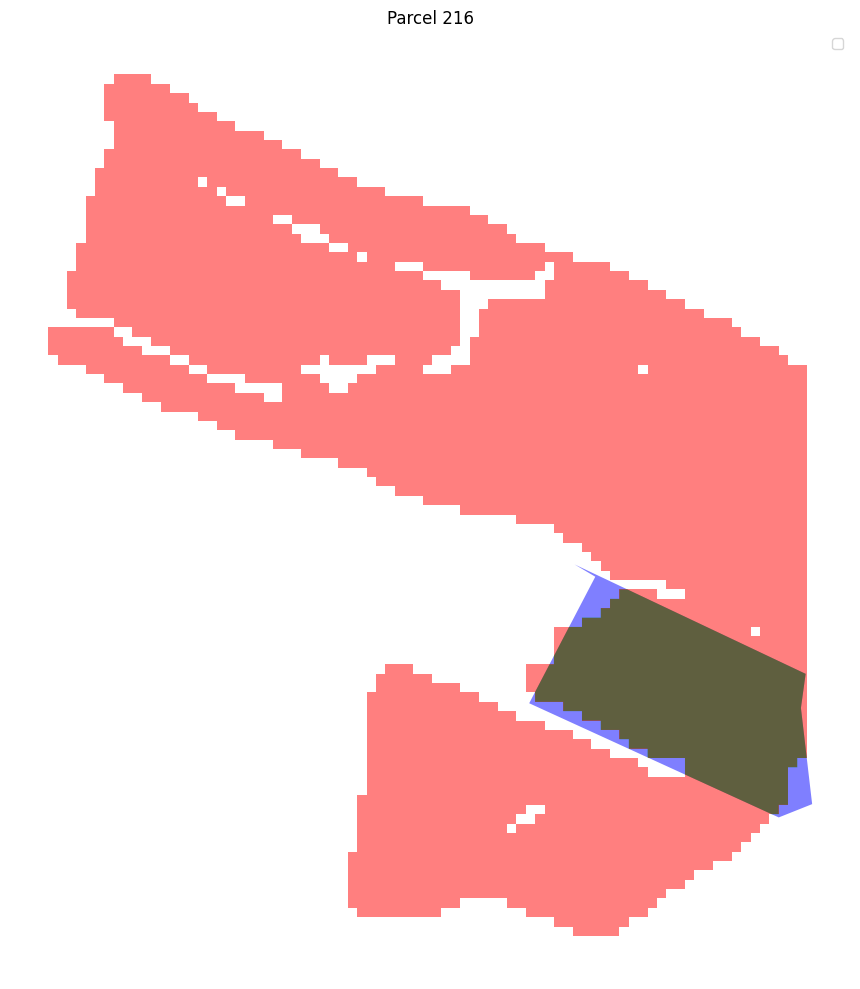

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 216:
True Positive (Correctly predicted): 9770.50 m²
False Negative (Missed): 1077.80 m²
Adjusted IoU: 0.90




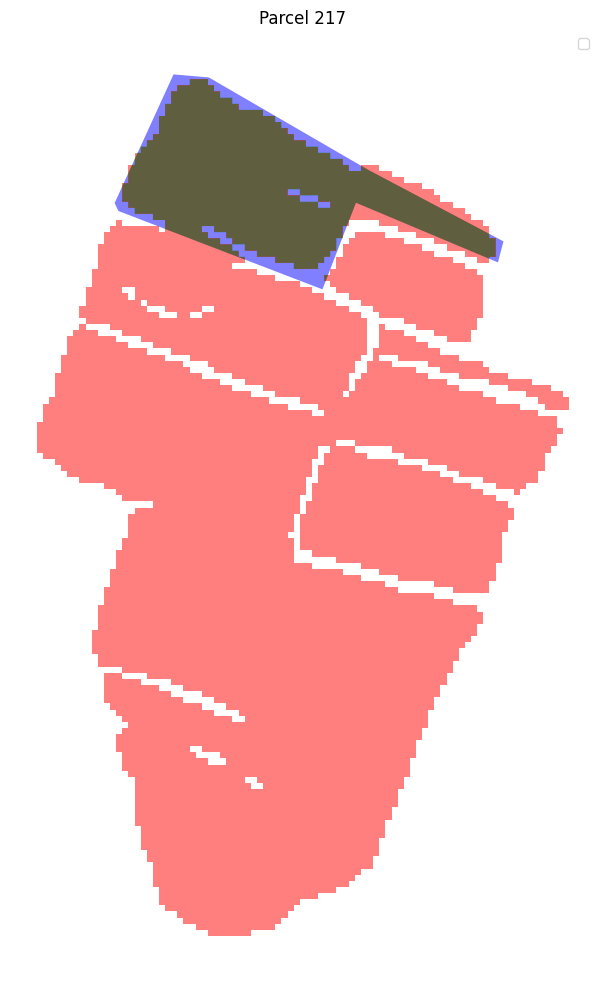

Parcel 217:
True Positive (Correctly predicted): 21061.75 m²
False Negative (Missed): 3044.28 m²
Adjusted IoU: 0.87




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

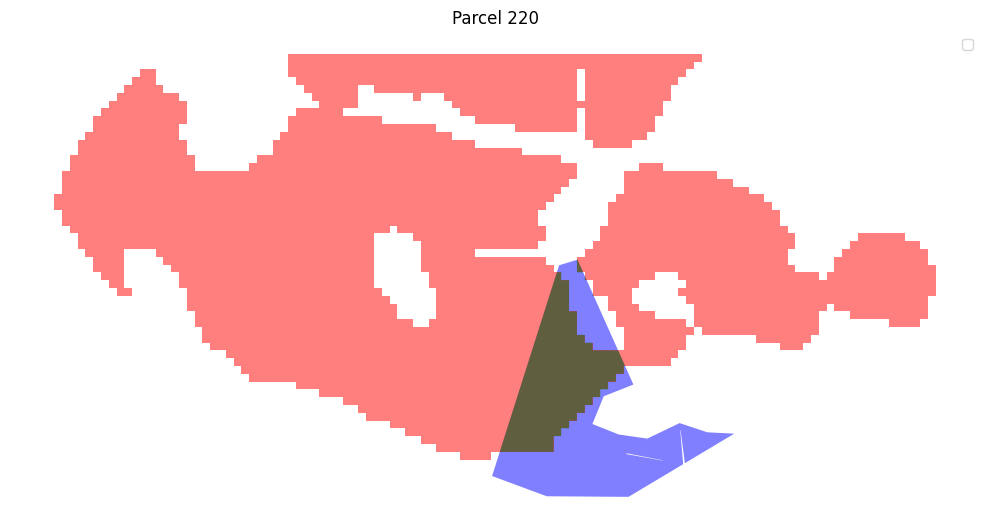

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 220:
True Positive (Correctly predicted): 4113.76 m²
False Negative (Missed): 5598.52 m²
Adjusted IoU: 0.42




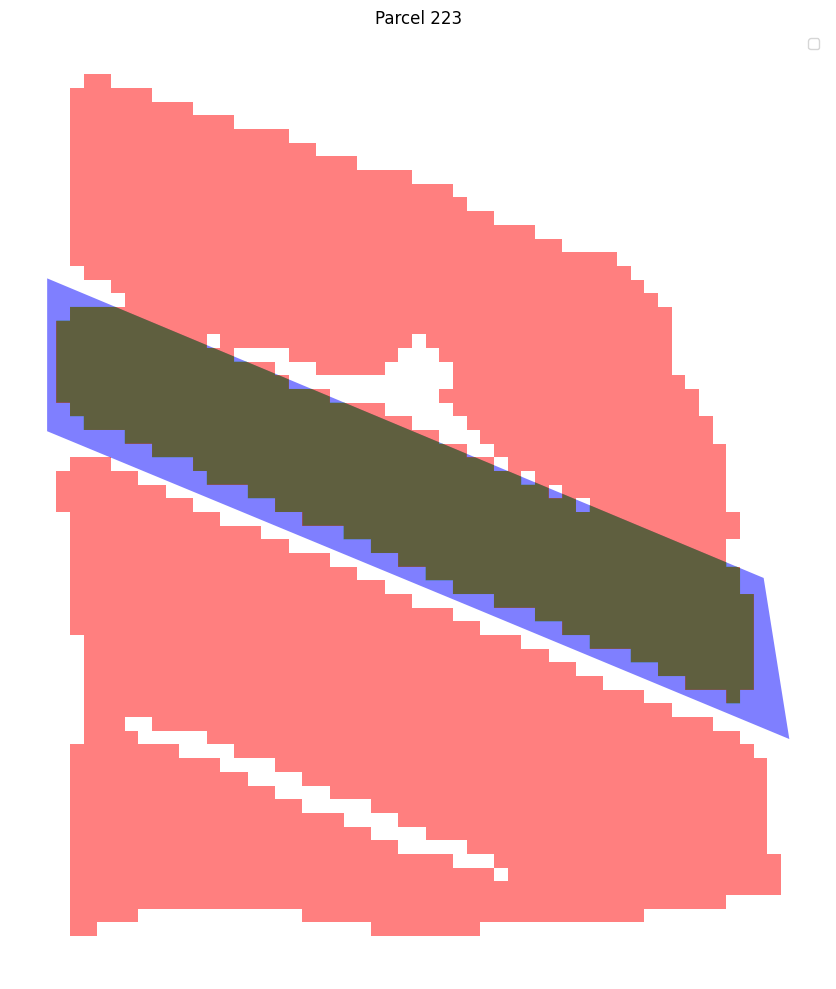

Parcel 223:
True Positive (Correctly predicted): 12089.30 m²
False Negative (Missed): 2681.93 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

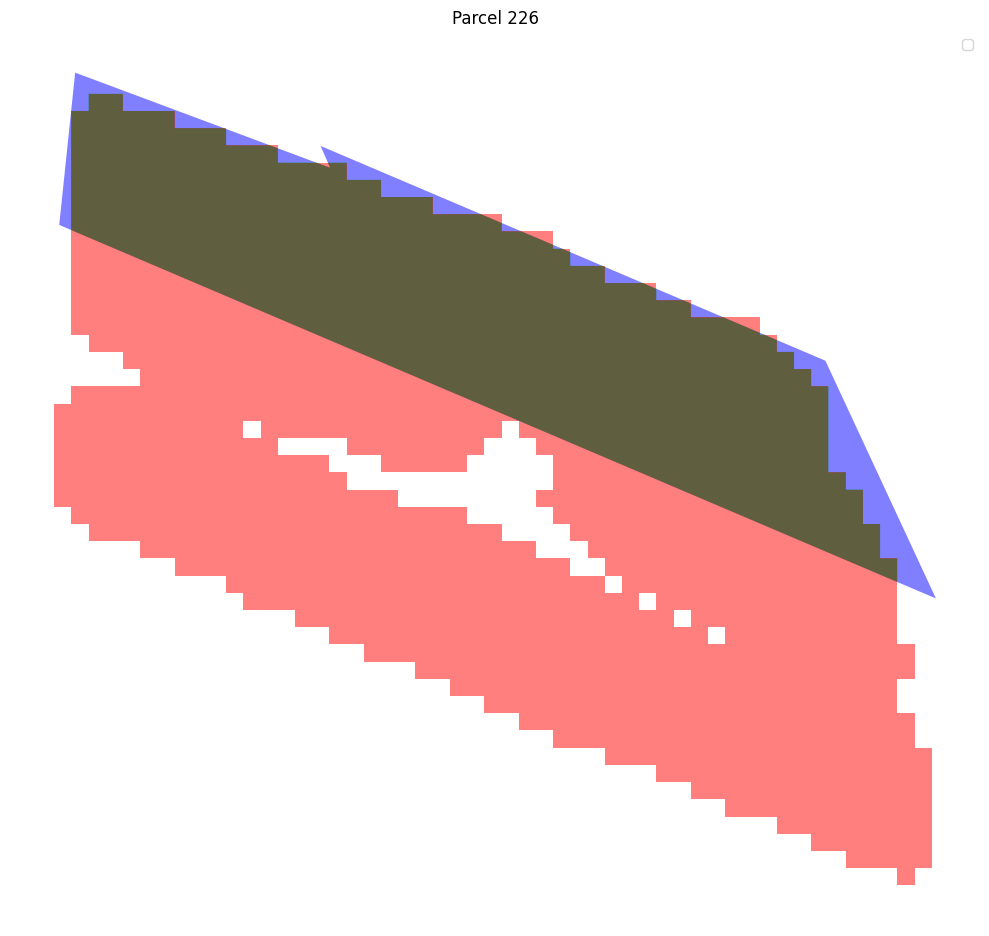

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 226:
True Positive (Correctly predicted): 11415.58 m²
False Negative (Missed): 1121.27 m²
Adjusted IoU: 0.91




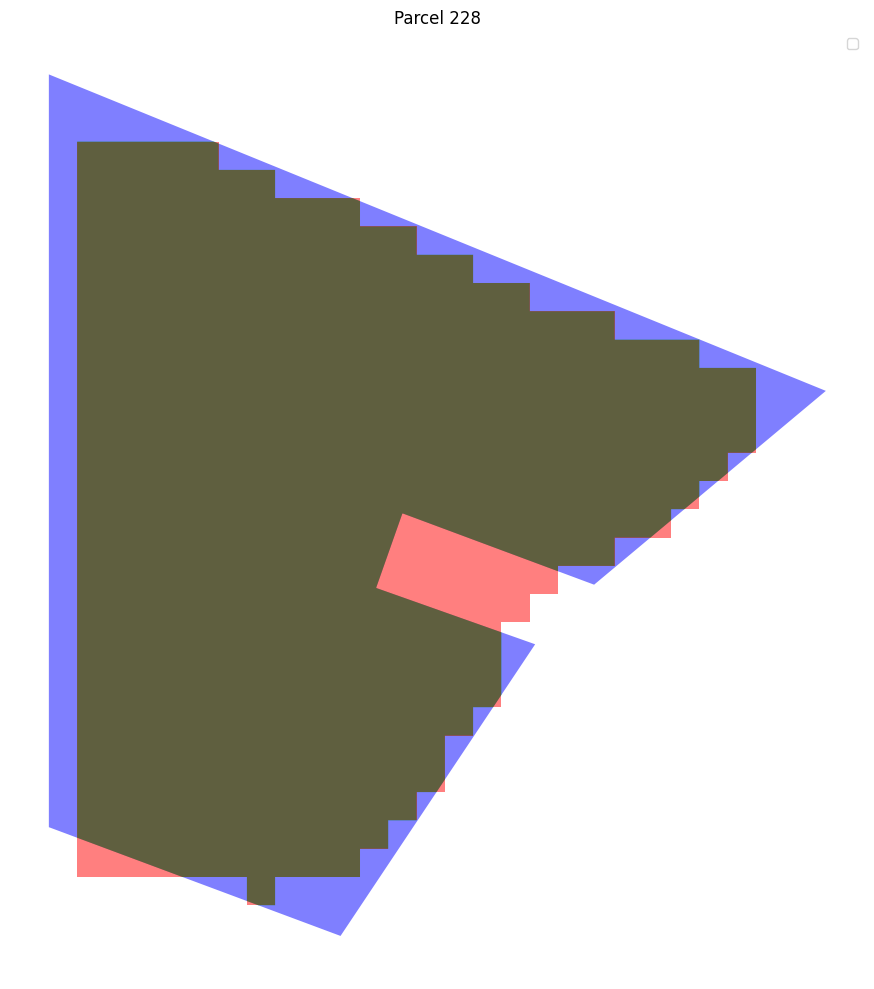

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 228:
True Positive (Correctly predicted): 9895.25 m²
False Negative (Missed): 1506.03 m²
Adjusted IoU: 0.87




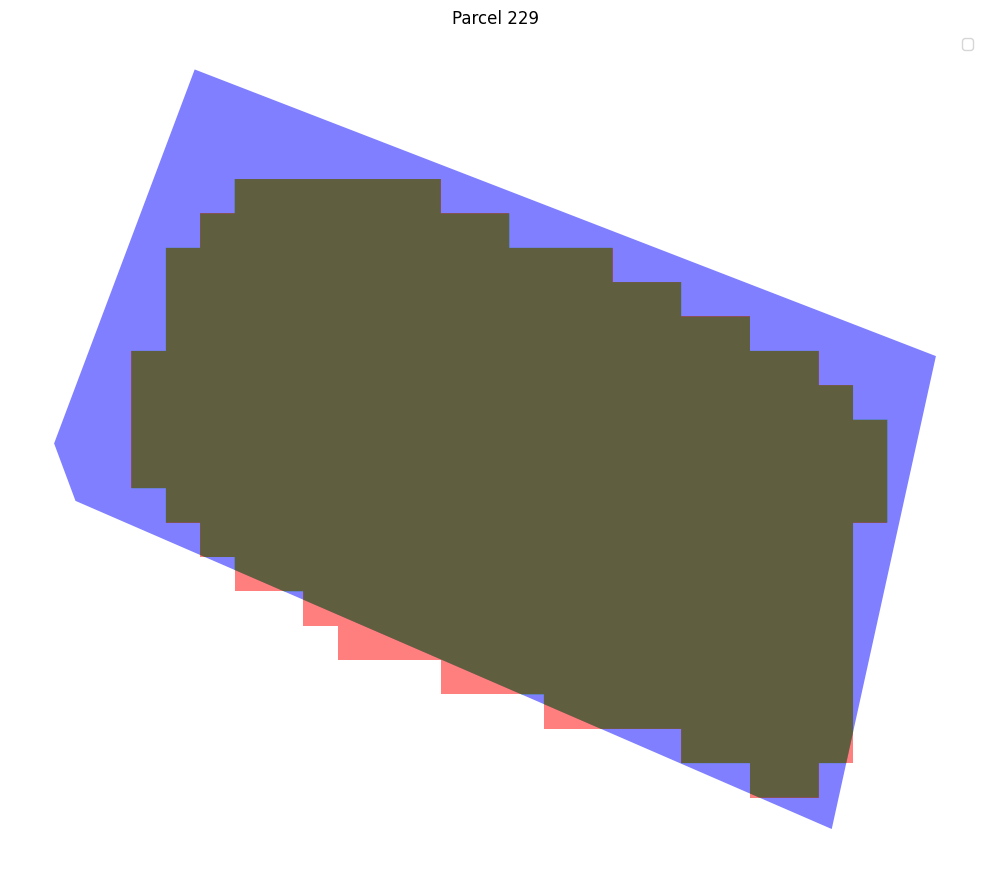

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 229:
True Positive (Correctly predicted): 6426.97 m²
False Negative (Missed): 1637.89 m²
Adjusted IoU: 0.80




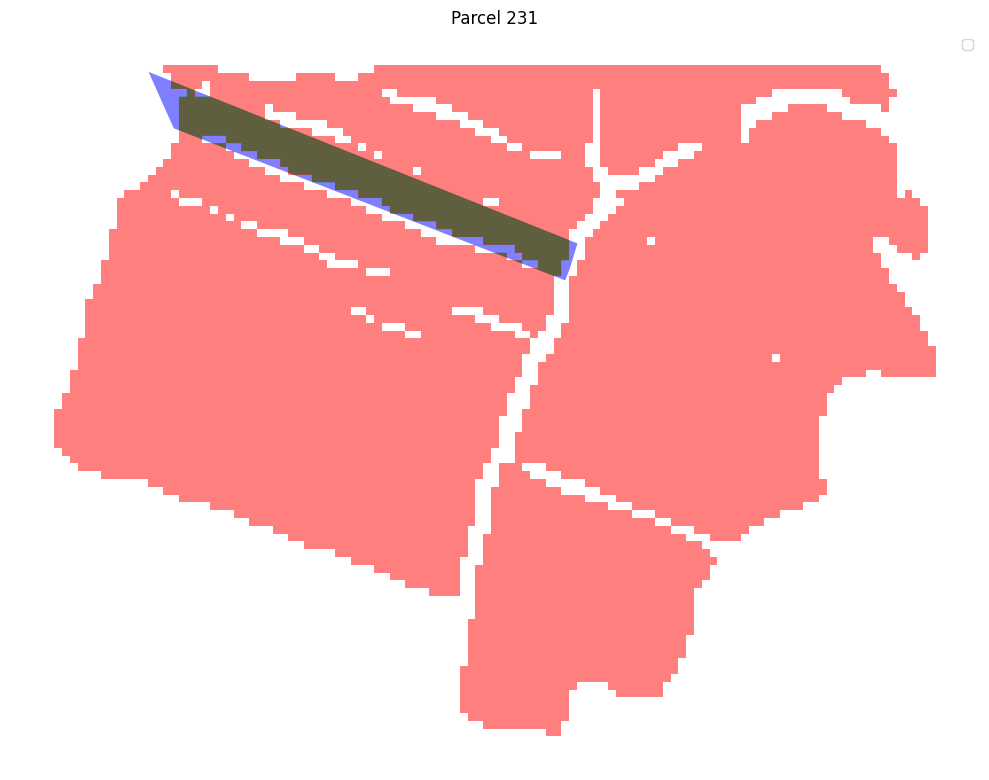

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 231:
True Positive (Correctly predicted): 6174.13 m²
False Negative (Missed): 1256.51 m²
Adjusted IoU: 0.83




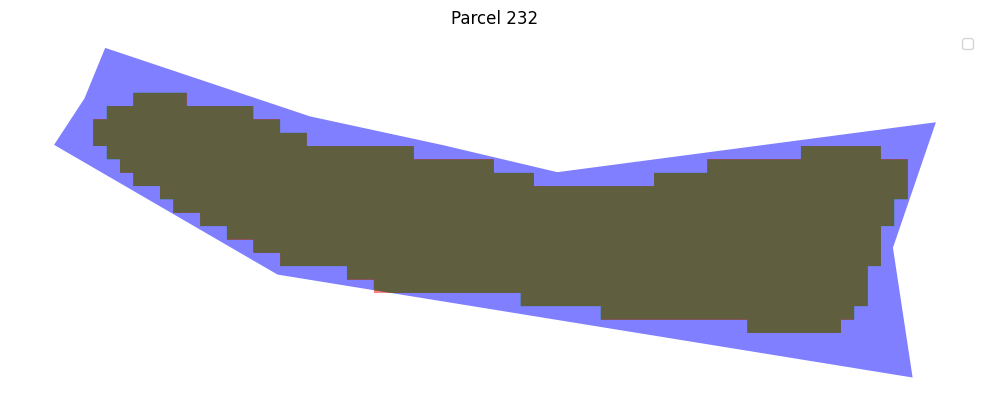

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 232:
True Positive (Correctly predicted): 14921.73 m²
False Negative (Missed): 5054.15 m²
Adjusted IoU: 0.75




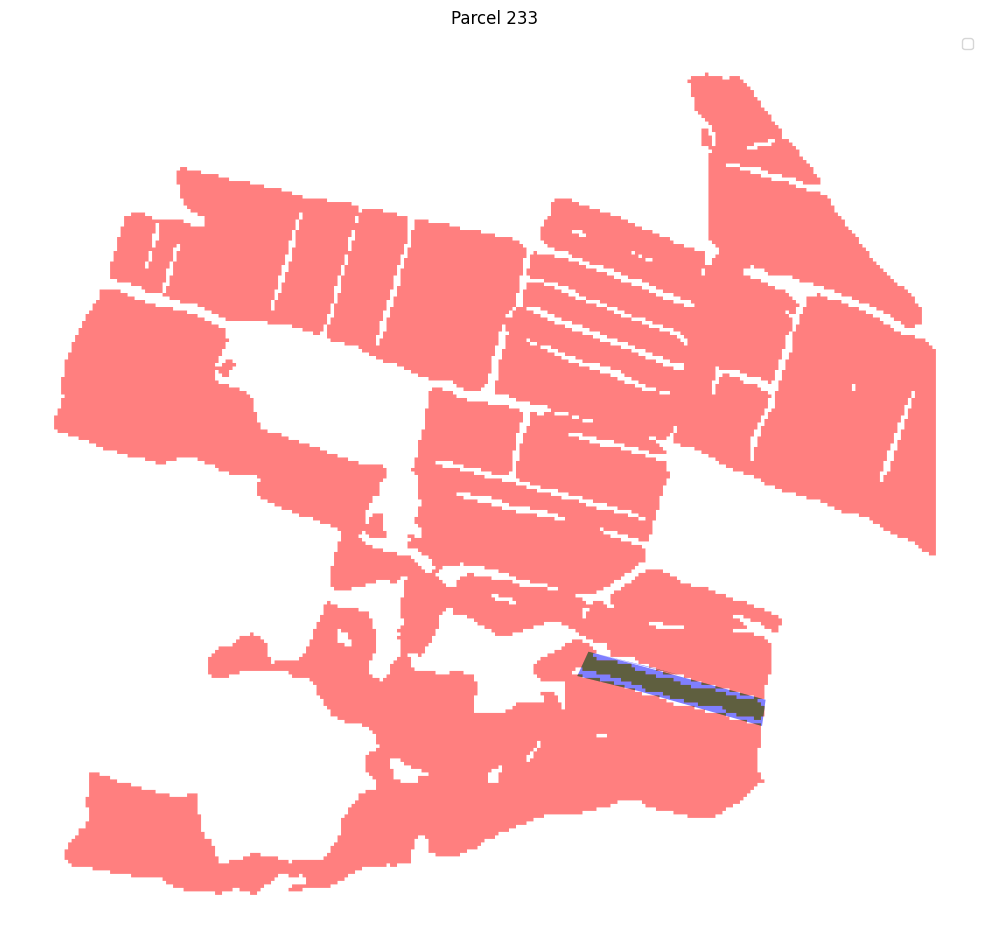

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 233:
True Positive (Correctly predicted): 6478.46 m²
False Negative (Missed): 3359.85 m²
Adjusted IoU: 0.66




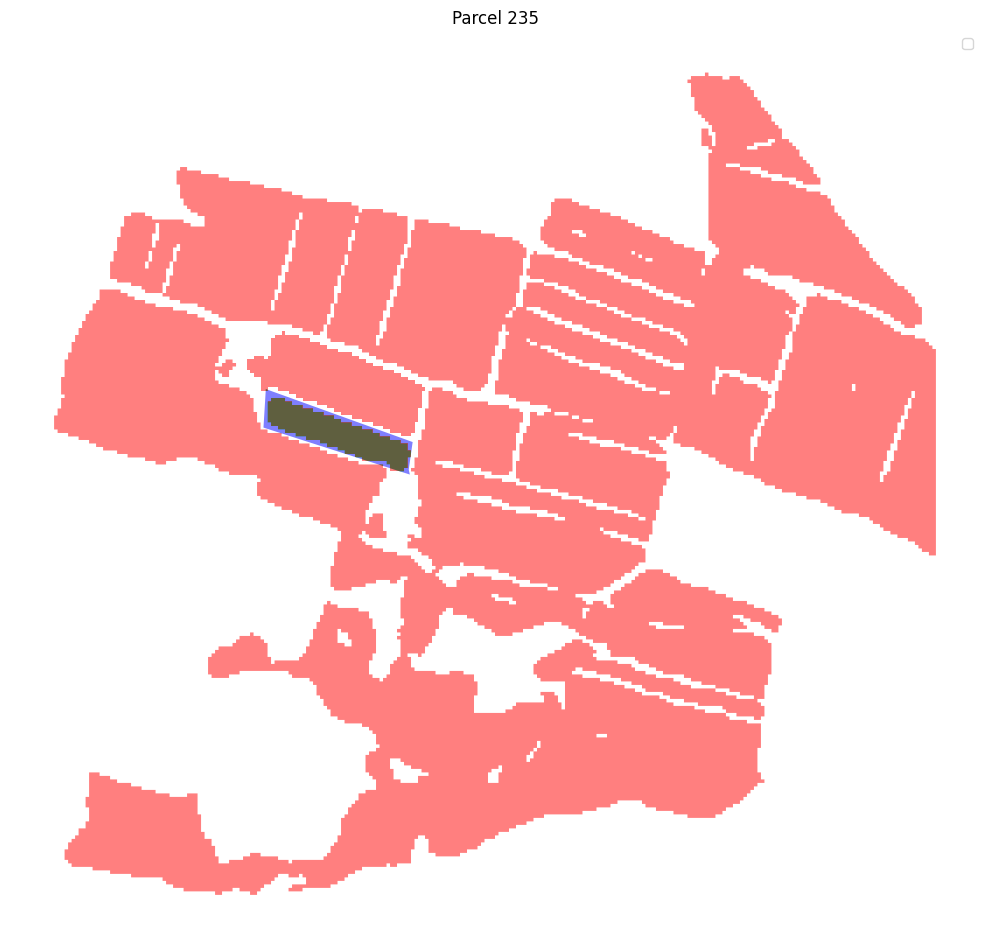

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 235:
True Positive (Correctly predicted): 8440.51 m²
False Negative (Missed): 2397.21 m²
Adjusted IoU: 0.78




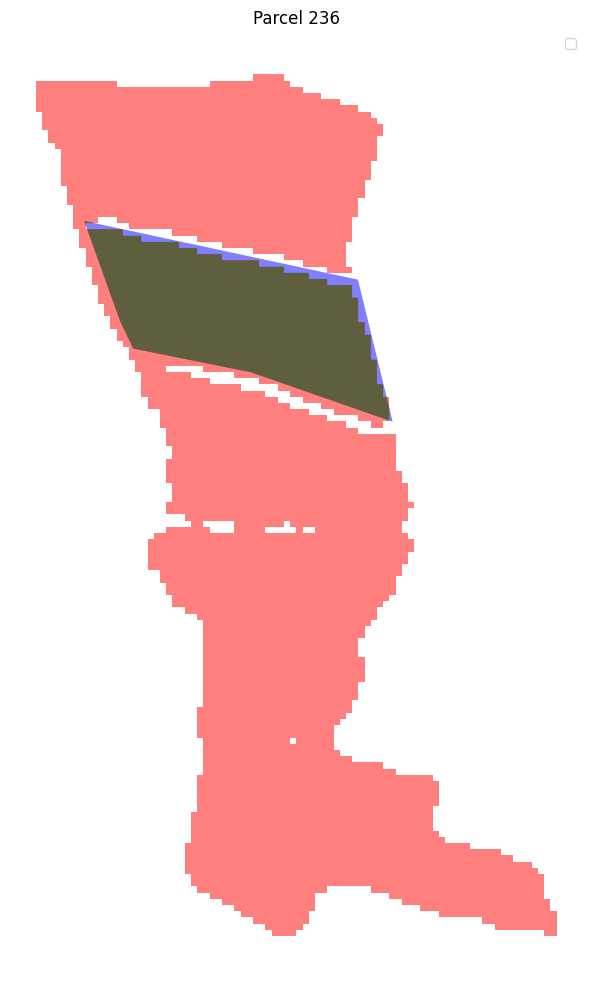

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 236:
True Positive (Correctly predicted): 19515.69 m²
False Negative (Missed): 1393.22 m²
Adjusted IoU: 0.93




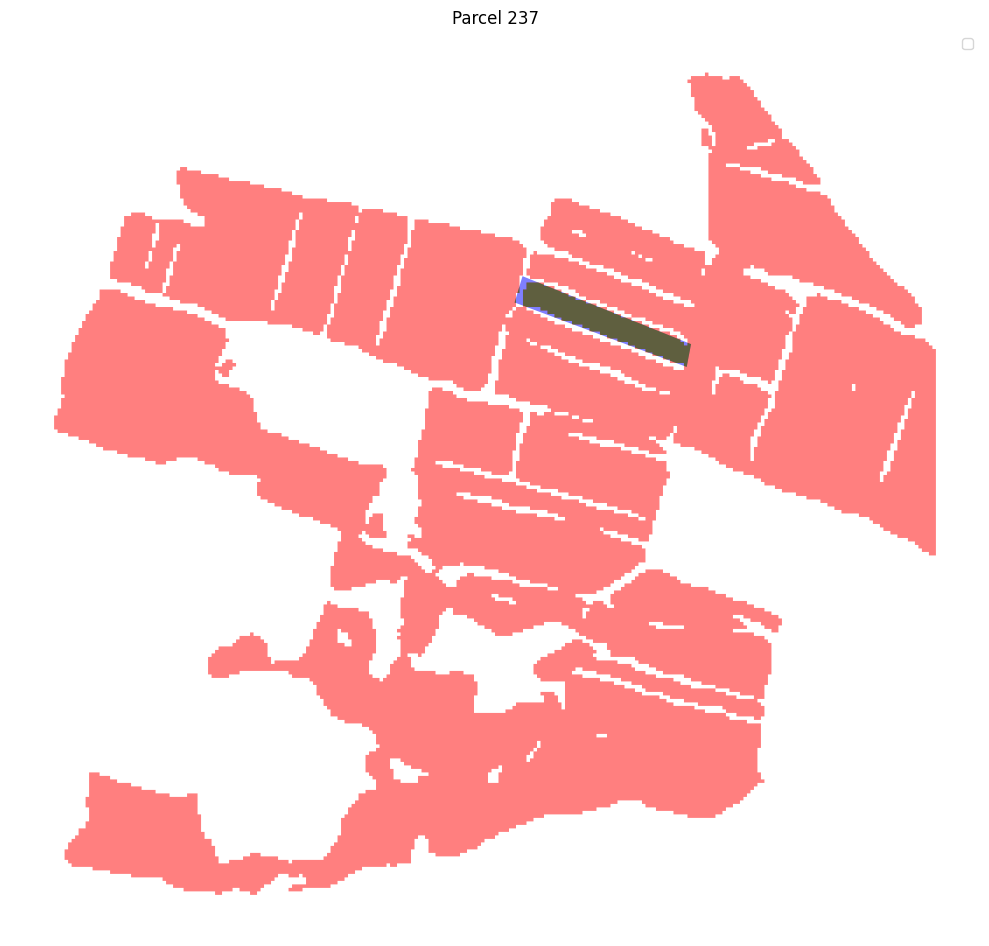

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 237:
True Positive (Correctly predicted): 8500.80 m²
False Negative (Missed): 866.13 m²
Adjusted IoU: 0.91




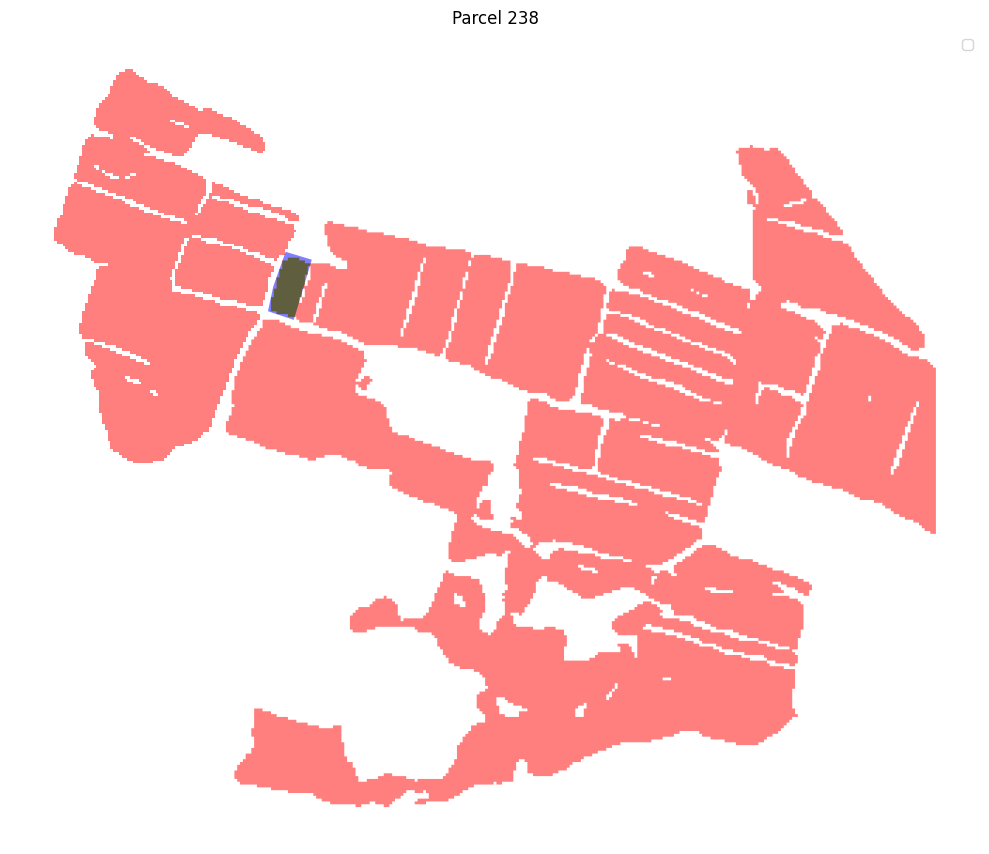

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 238:
True Positive (Correctly predicted): 4660.01 m²
False Negative (Missed): 882.66 m²
Adjusted IoU: 0.84




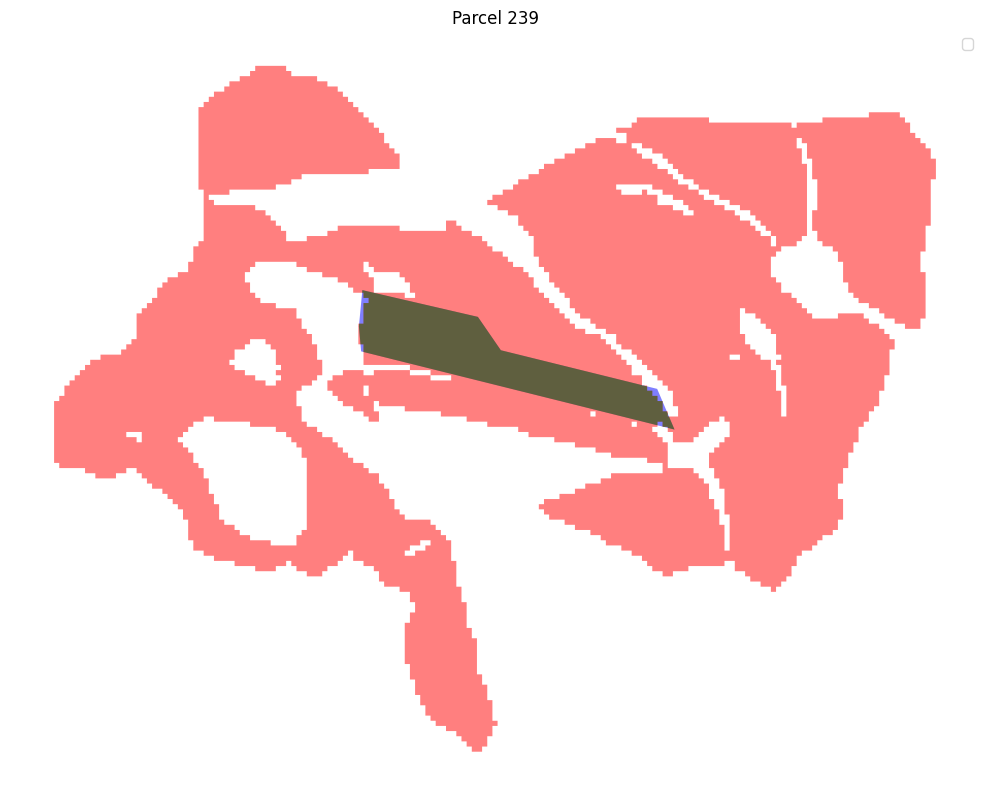

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 239:
True Positive (Correctly predicted): 13344.93 m²
False Negative (Missed): 251.59 m²
Adjusted IoU: 0.98




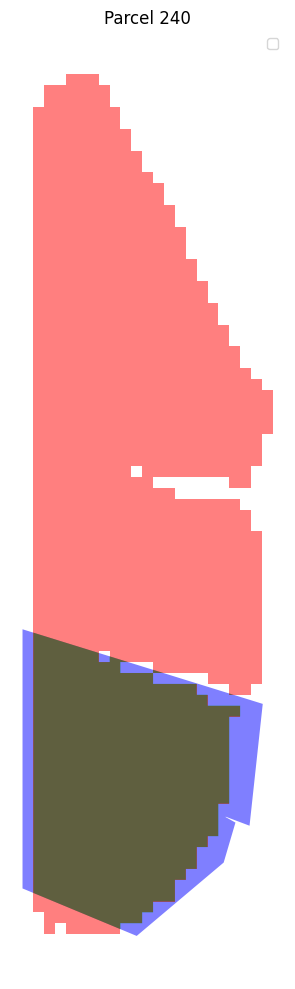

Parcel 240:
True Positive (Correctly predicted): 9331.55 m²
False Negative (Missed): 2032.47 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

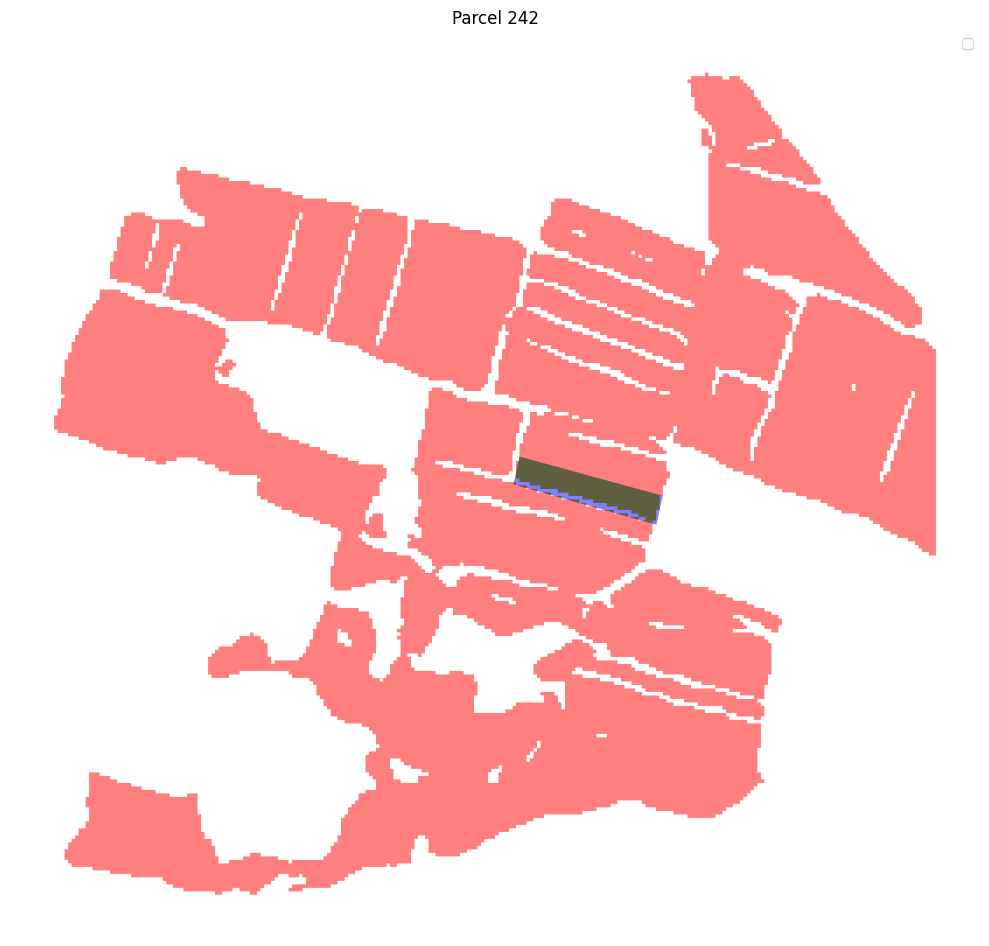

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 242:
True Positive (Correctly predicted): 7358.37 m²
False Negative (Missed): 1403.79 m²
Adjusted IoU: 0.84




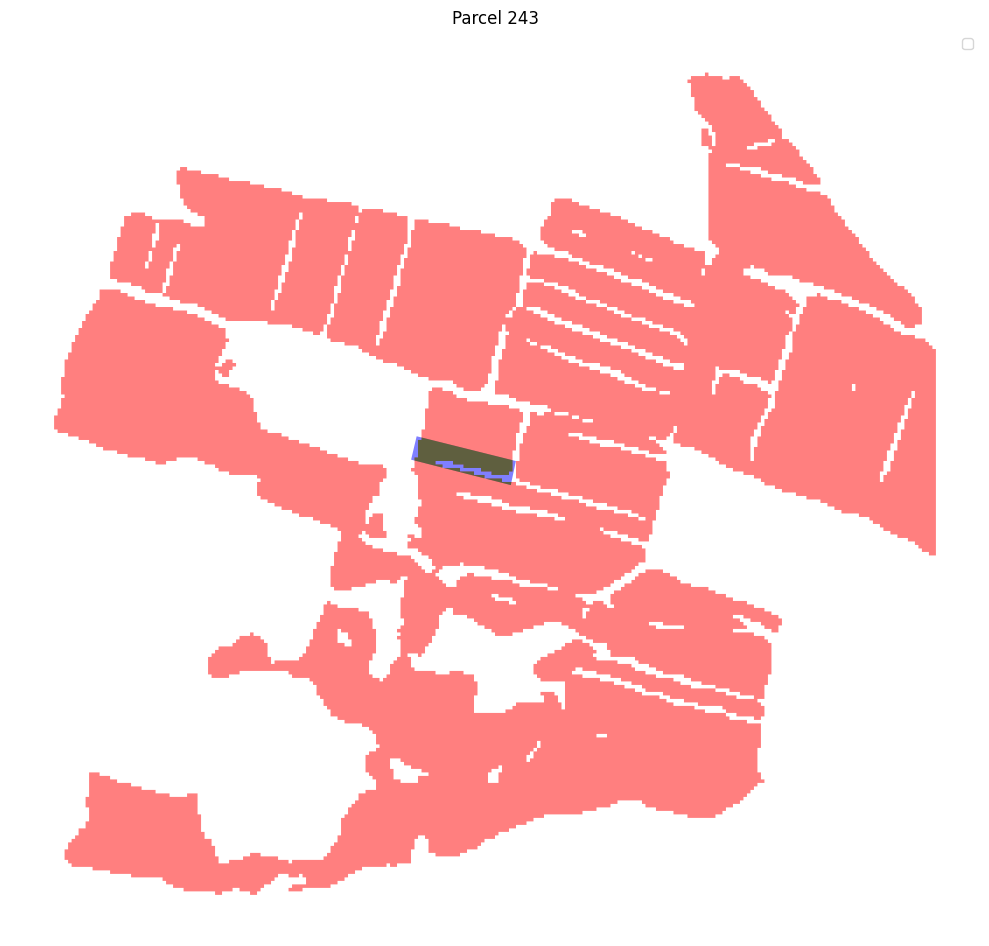

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 243:
True Positive (Correctly predicted): 3977.86 m²
False Negative (Missed): 1107.58 m²
Adjusted IoU: 0.78




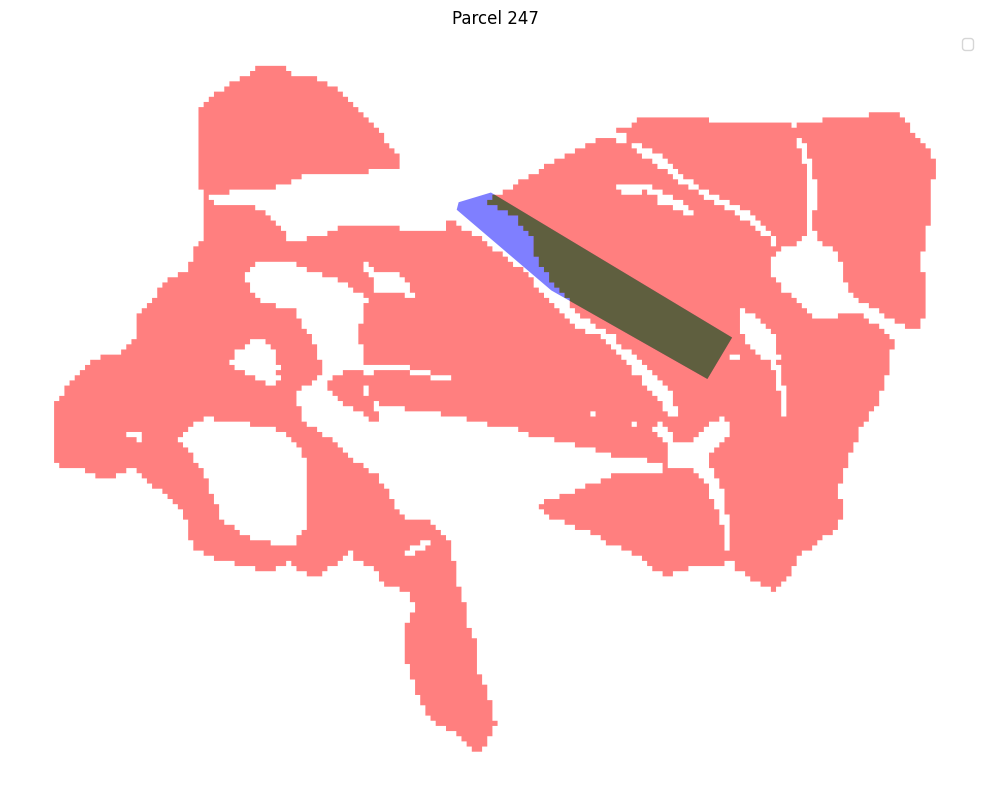

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 247:
True Positive (Correctly predicted): 10469.20 m²
False Negative (Missed): 2749.53 m²
Adjusted IoU: 0.79




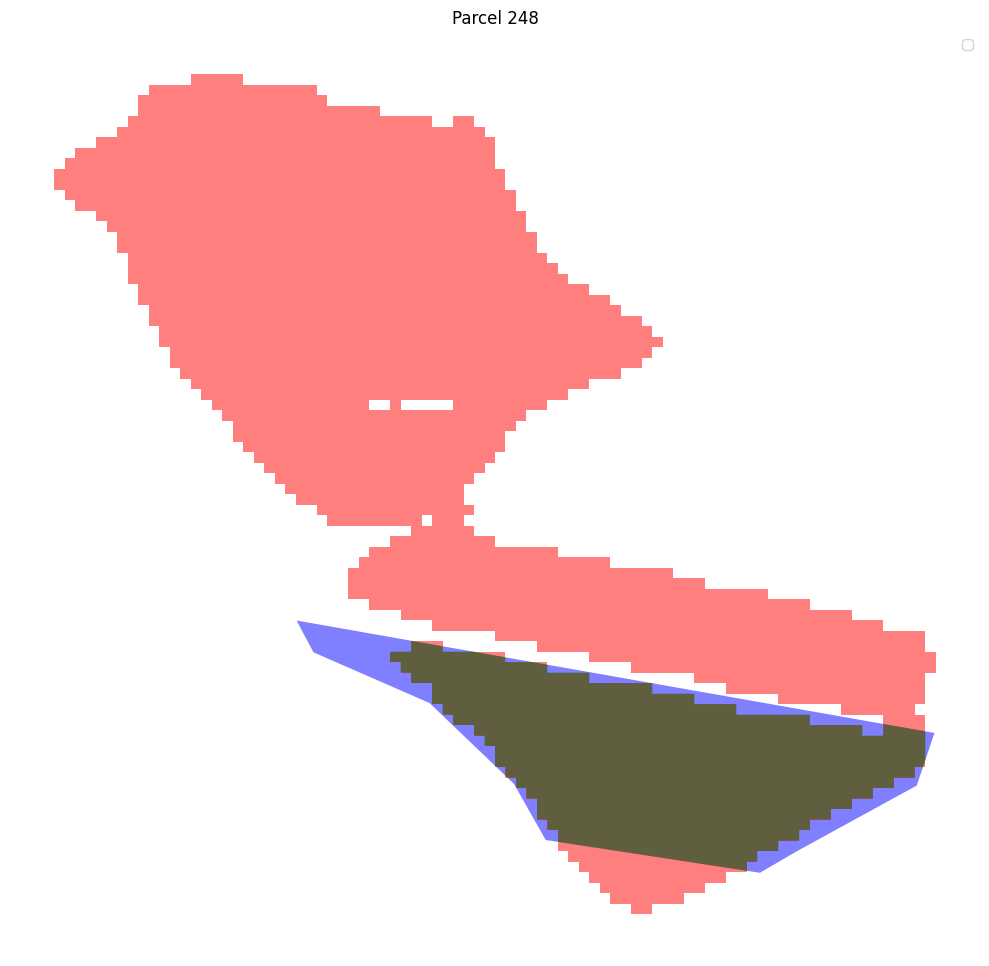

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 248:
True Positive (Correctly predicted): 14006.68 m²
False Negative (Missed): 2581.71 m²
Adjusted IoU: 0.84




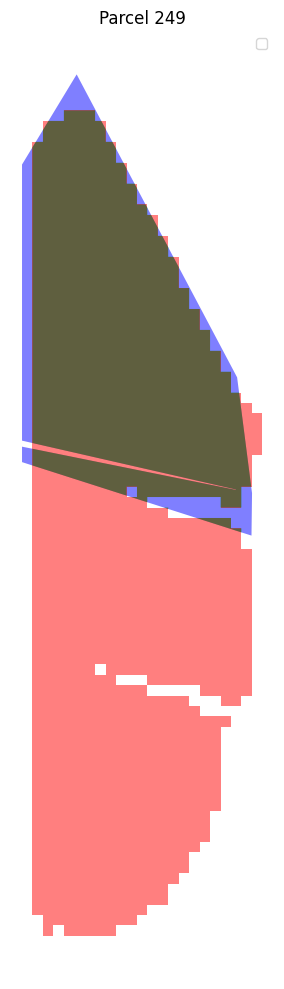

Parcel 249:
True Positive (Correctly predicted): 13170.48 m²
False Negative (Missed): 1665.66 m²
Adjusted IoU: 0.89




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

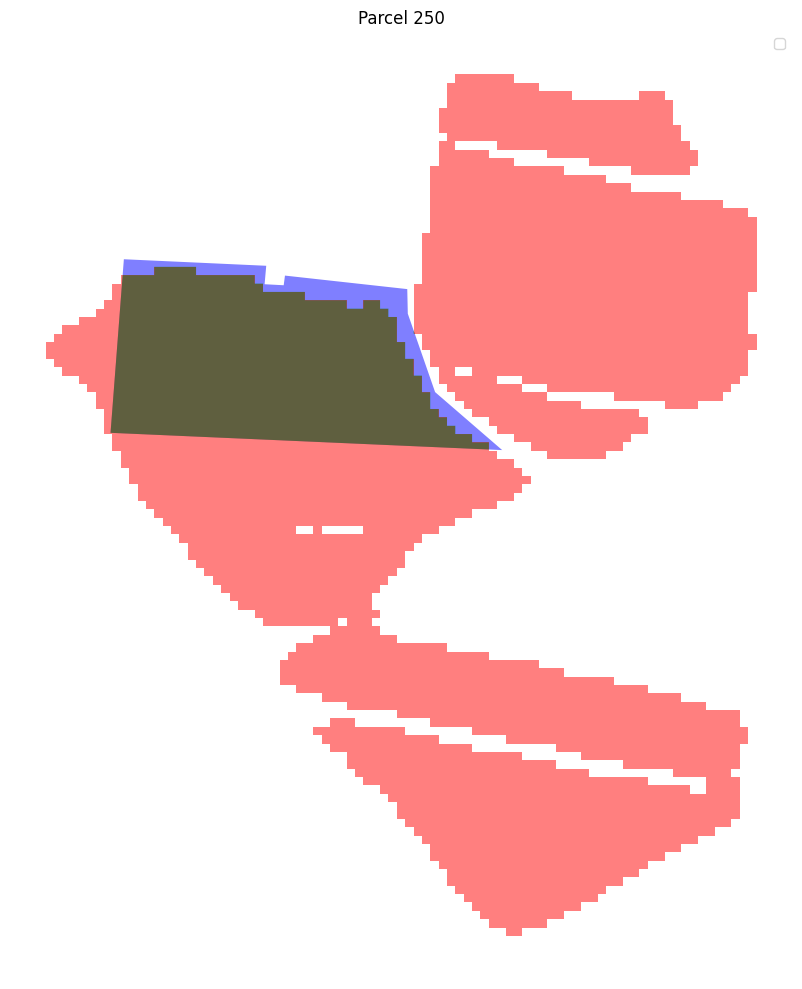

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 250:
True Positive (Correctly predicted): 16676.52 m²
False Negative (Missed): 2258.07 m²
Adjusted IoU: 0.88




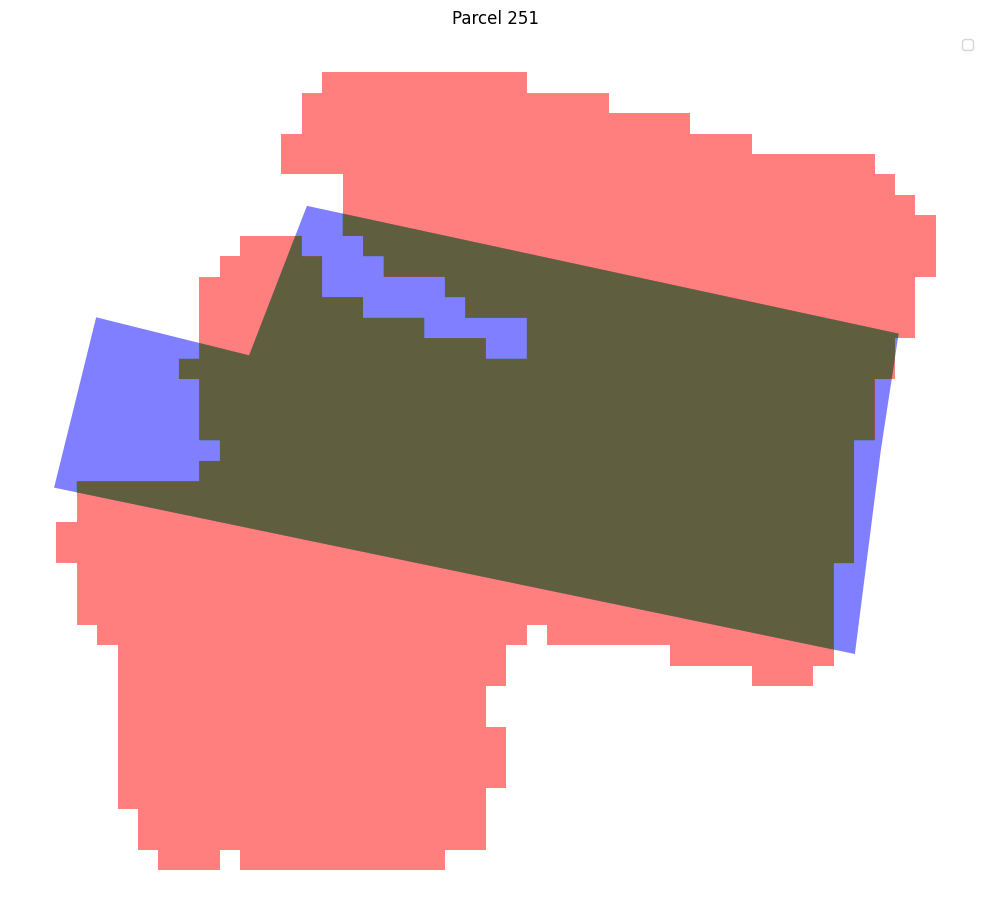

Parcel 251:
True Positive (Correctly predicted): 11839.90 m²
False Negative (Missed): 2147.37 m²
Adjusted IoU: 0.85




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

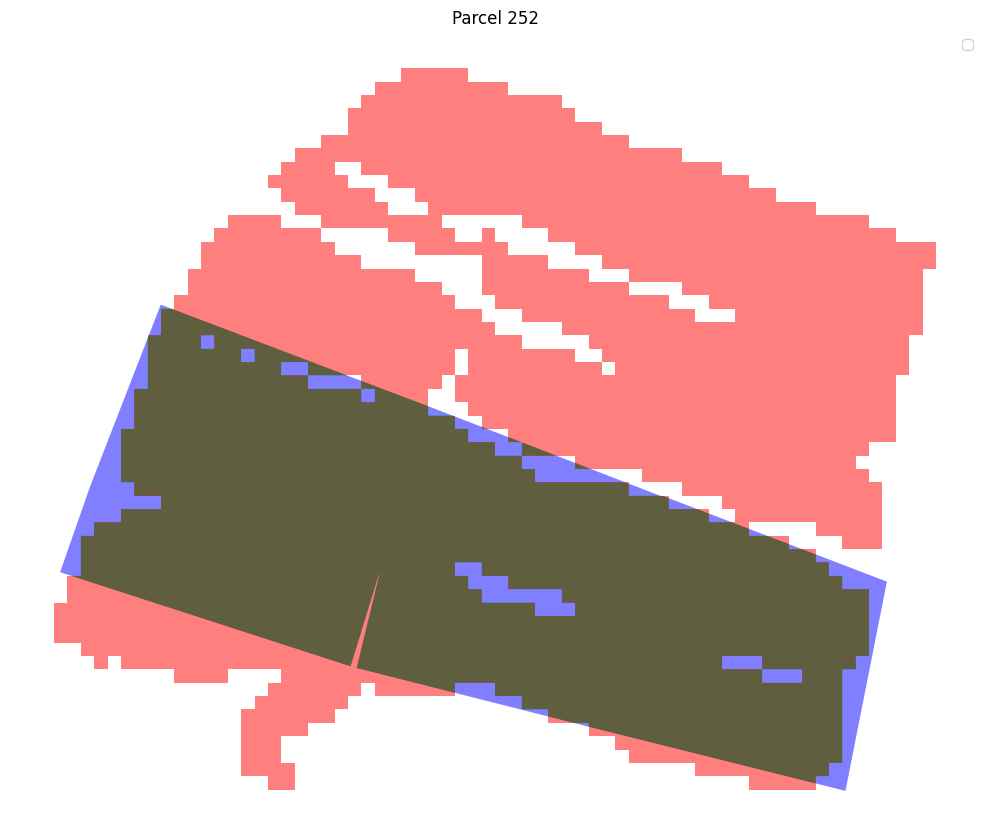

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 252:
True Positive (Correctly predicted): 25813.21 m²
False Negative (Missed): 2633.20 m²
Adjusted IoU: 0.91




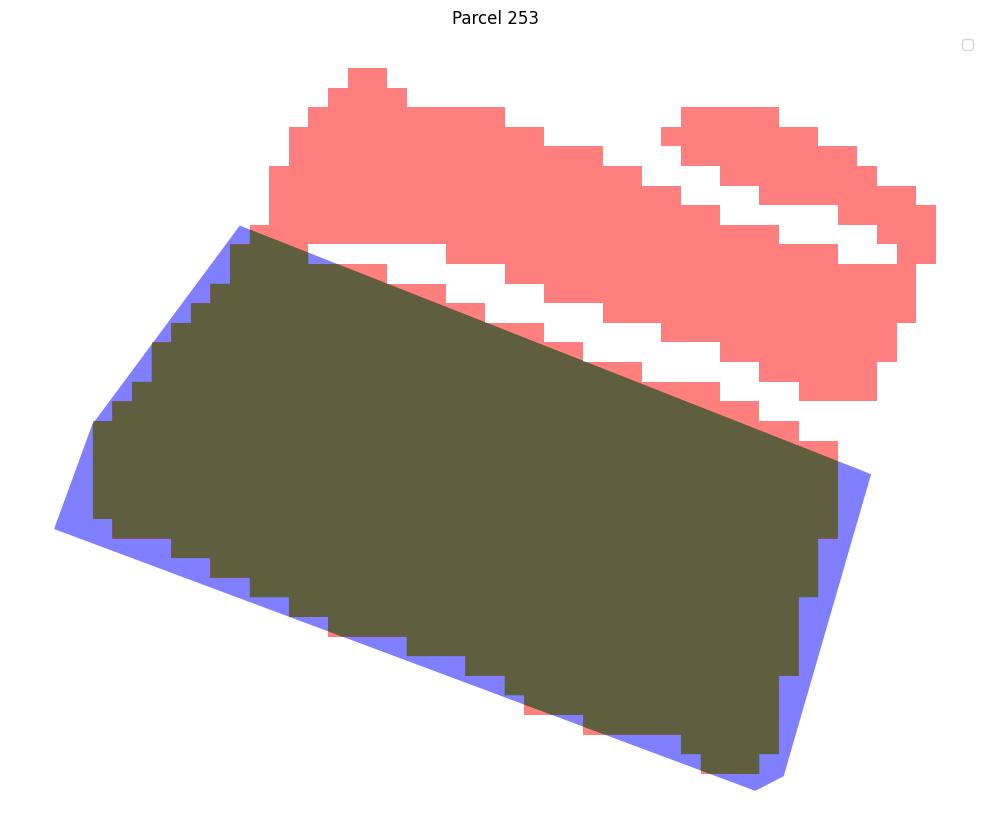

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 253:
True Positive (Correctly predicted): 15012.44 m²
False Negative (Missed): 1413.17 m²
Adjusted IoU: 0.91




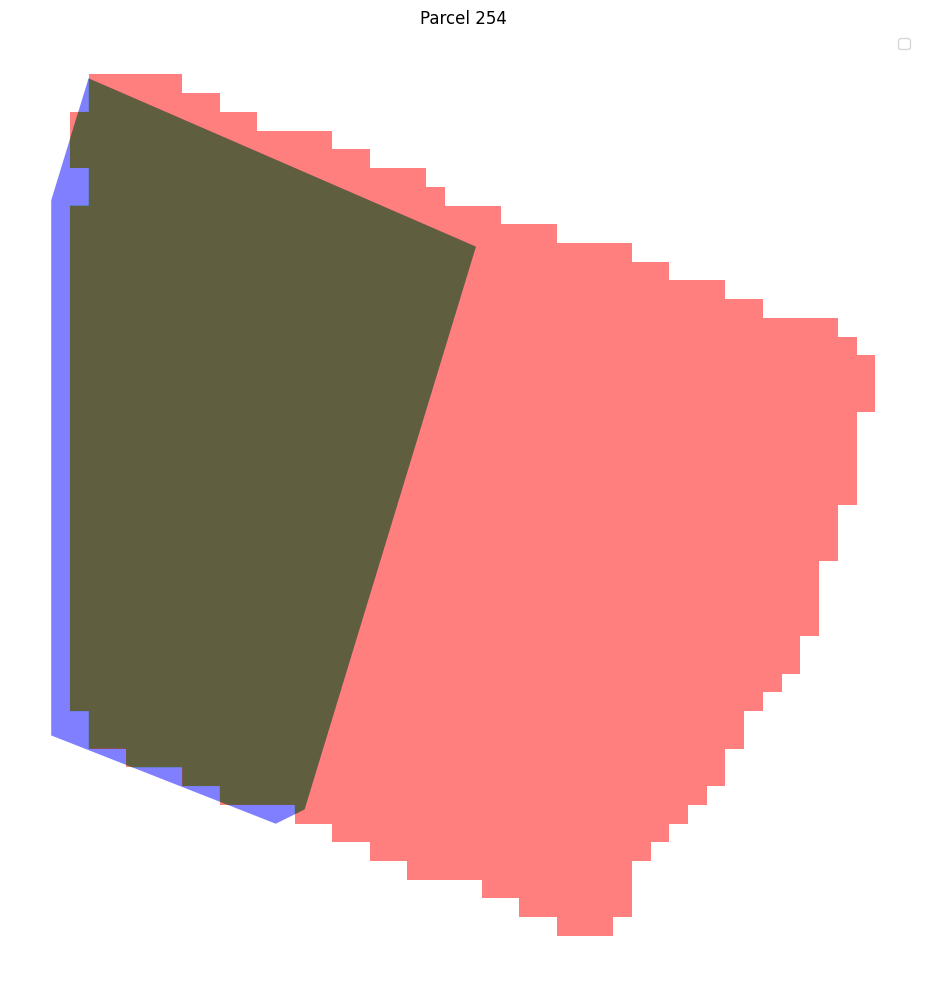

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 254:
True Positive (Correctly predicted): 14743.31 m²
False Negative (Missed): 1001.88 m²
Adjusted IoU: 0.94




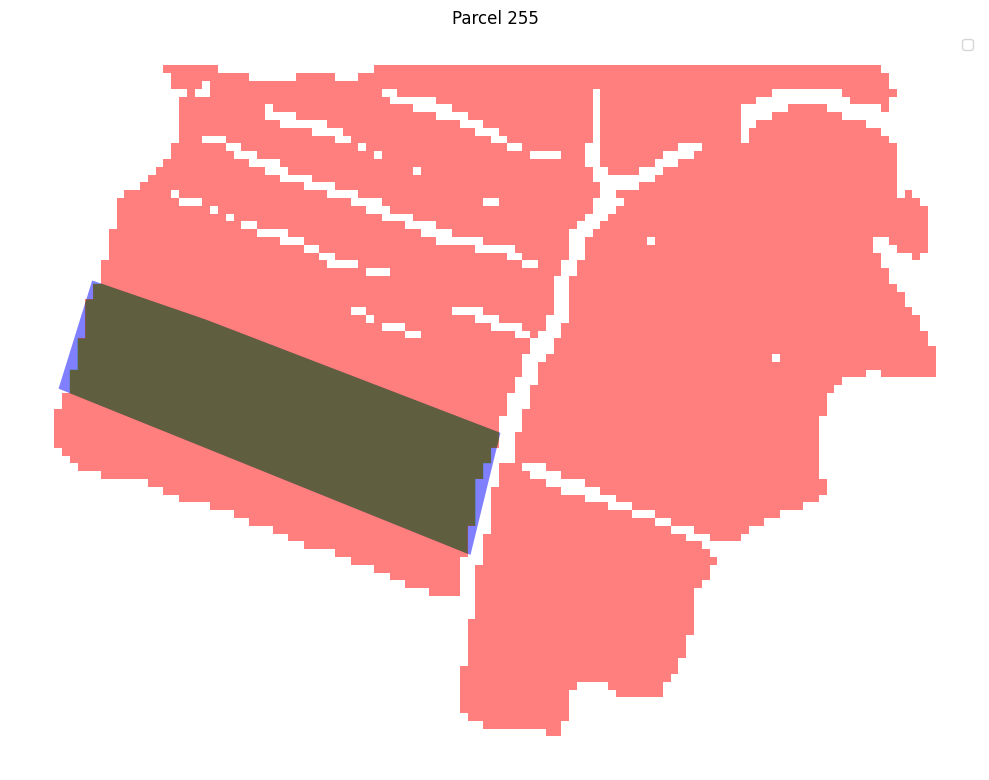

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 255:
True Positive (Correctly predicted): 21132.01 m²
False Negative (Missed): 599.11 m²
Adjusted IoU: 0.97




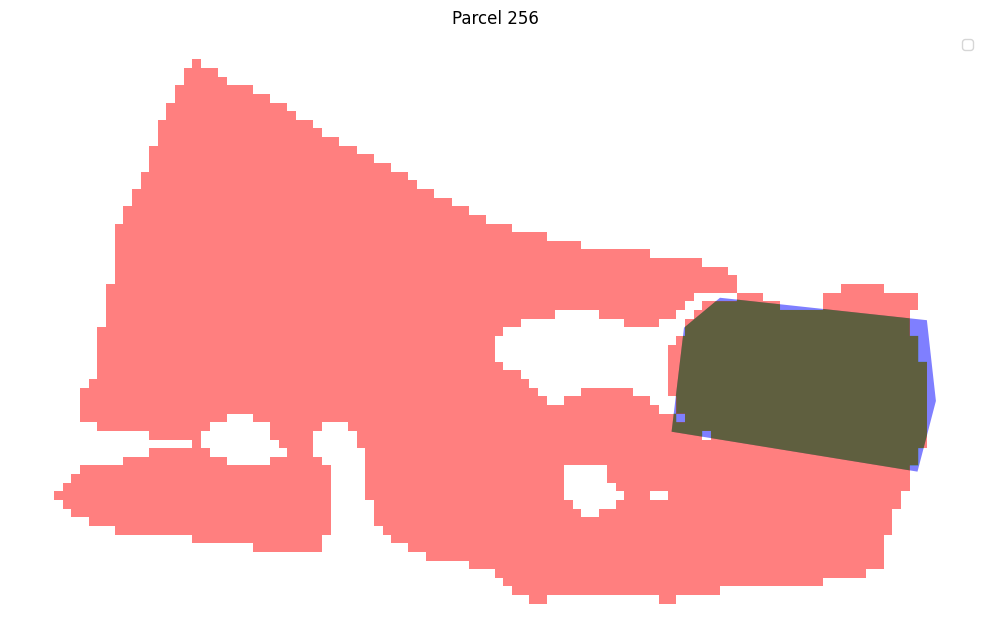

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 256:
True Positive (Correctly predicted): 11537.42 m²
False Negative (Missed): 497.38 m²
Adjusted IoU: 0.96




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


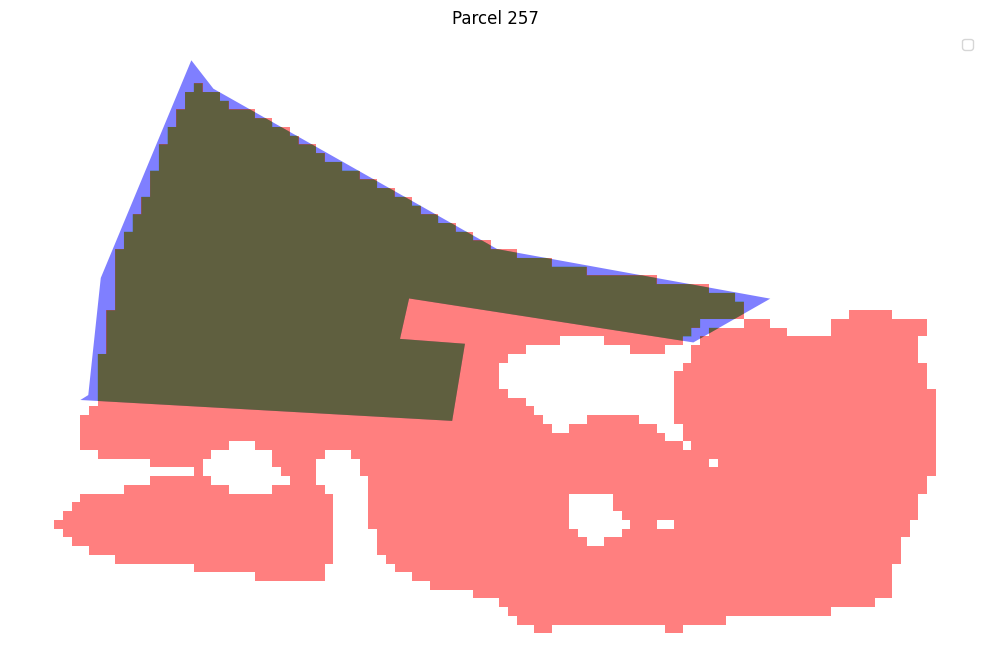

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 257:
True Positive (Correctly predicted): 33135.64 m²
False Negative (Missed): 1936.59 m²
Adjusted IoU: 0.94




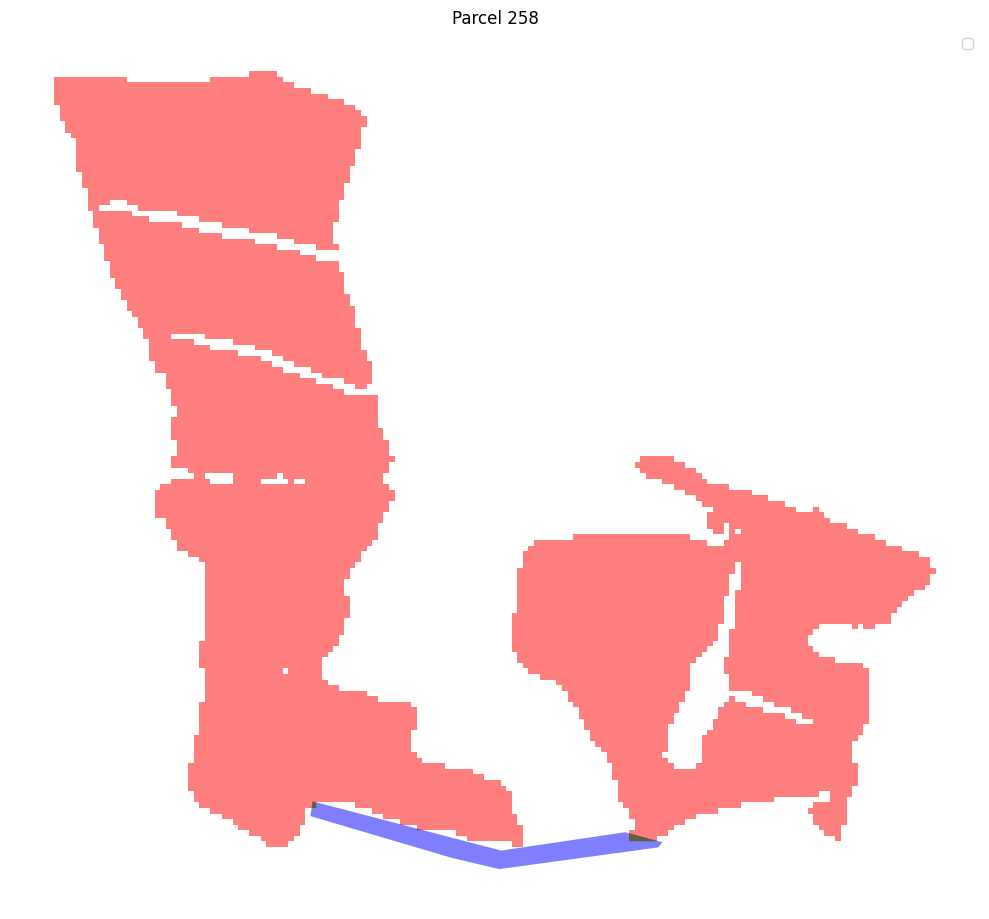

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 258:
True Positive (Correctly predicted): 125.75 m²
False Negative (Missed): 4893.46 m²
Adjusted IoU: 0.03




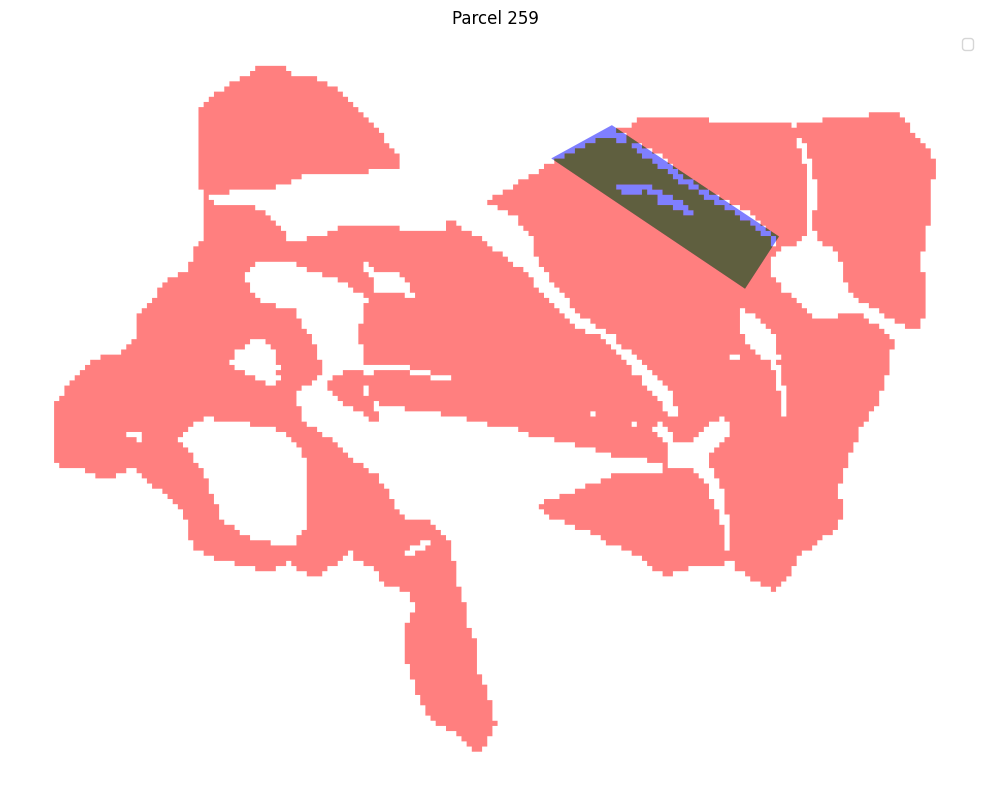

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 259:
True Positive (Correctly predicted): 10381.47 m²
False Negative (Missed): 2240.57 m²
Adjusted IoU: 0.82




/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


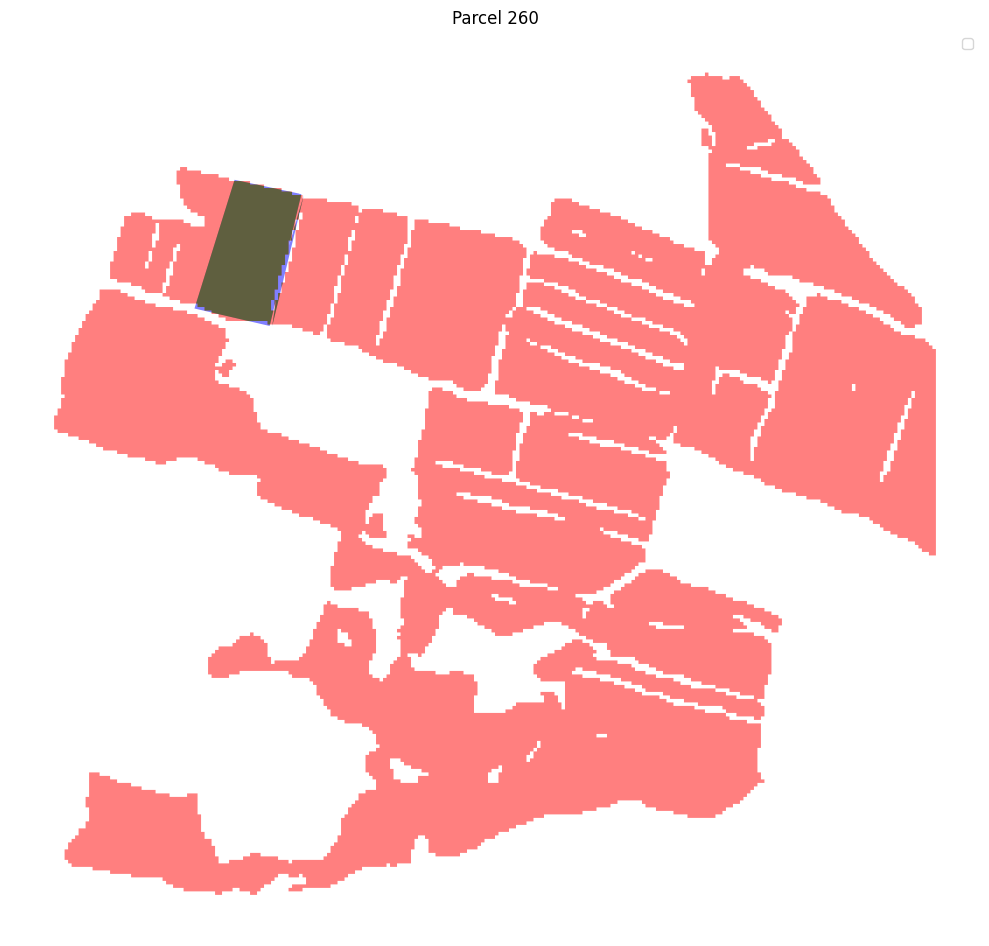

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 260:
True Positive (Correctly predicted): 19694.78 m²
False Negative (Missed): 847.37 m²
Adjusted IoU: 0.96




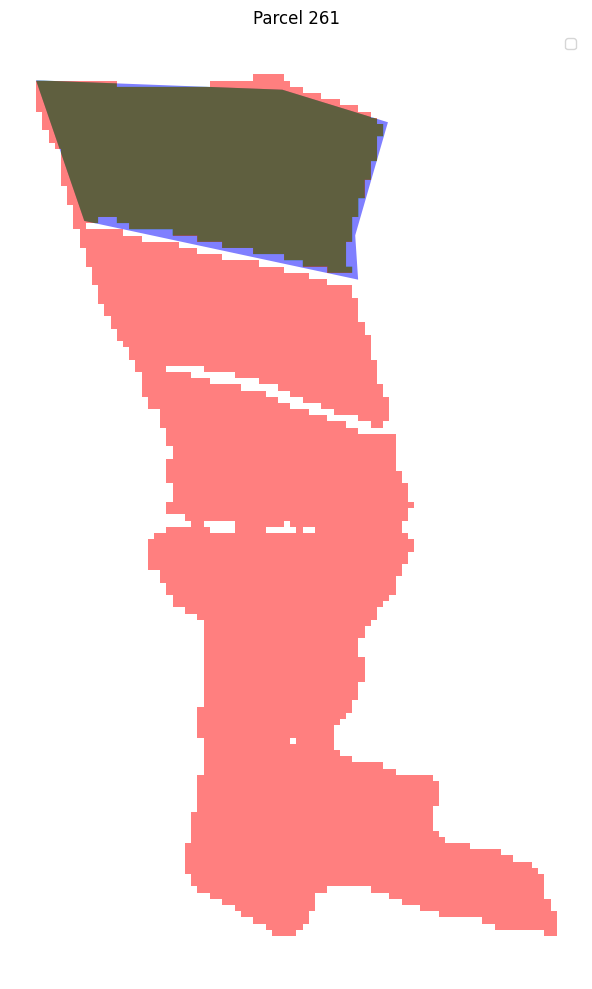

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 261:
True Positive (Correctly predicted): 30156.48 m²
False Negative (Missed): 1583.93 m²
Adjusted IoU: 0.95




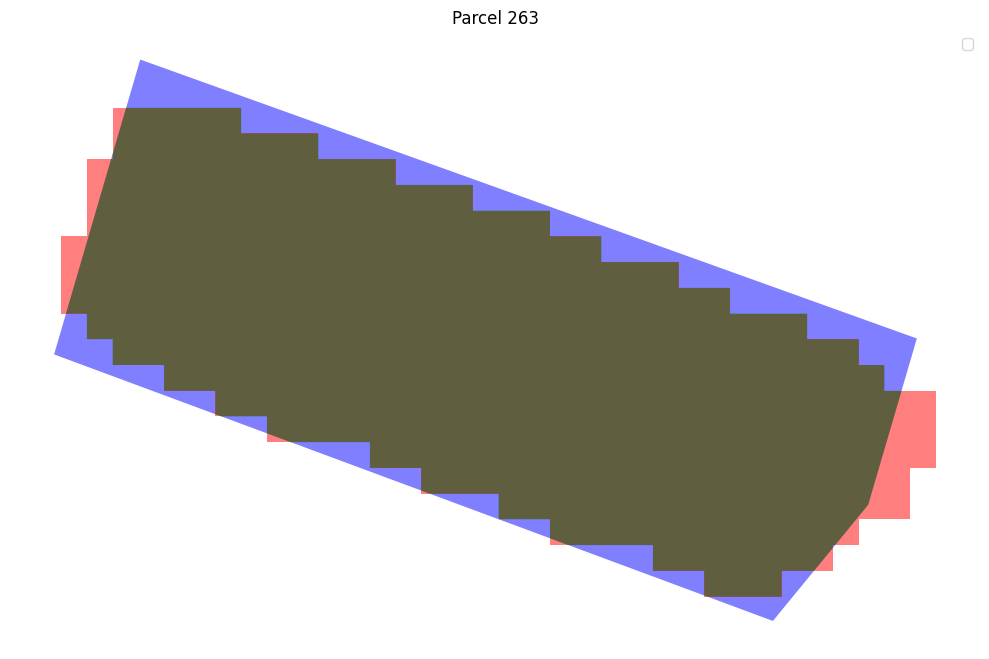

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 263:
True Positive (Correctly predicted): 8339.05 m²
False Negative (Missed): 1188.85 m²
Adjusted IoU: 0.88




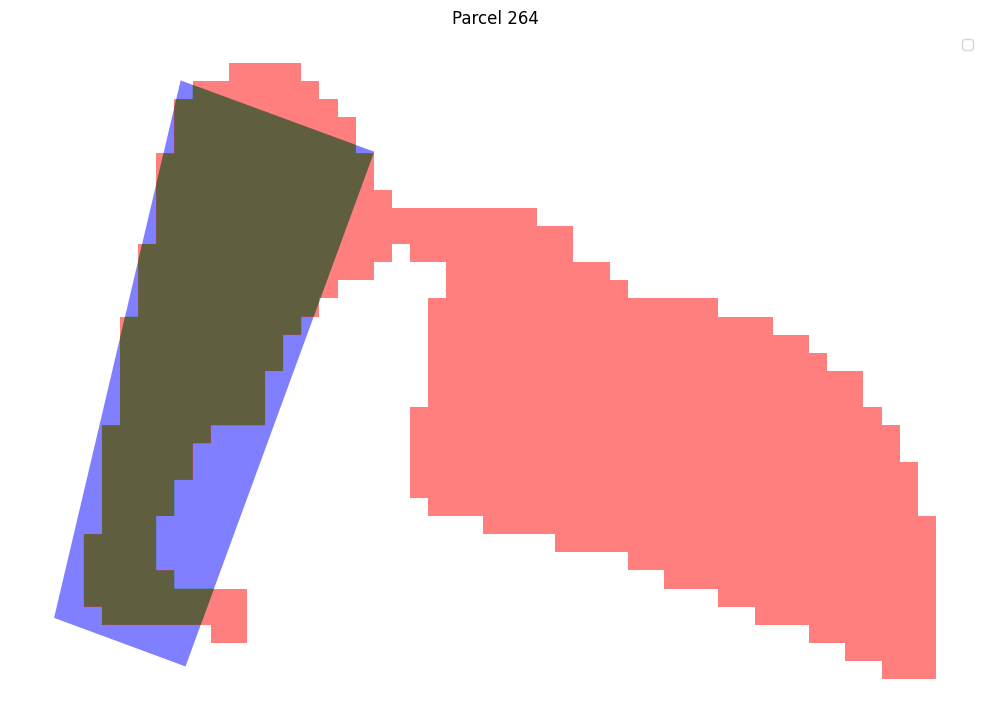

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 264:
True Positive (Correctly predicted): 5578.75 m²
False Negative (Missed): 1639.98 m²
Adjusted IoU: 0.77




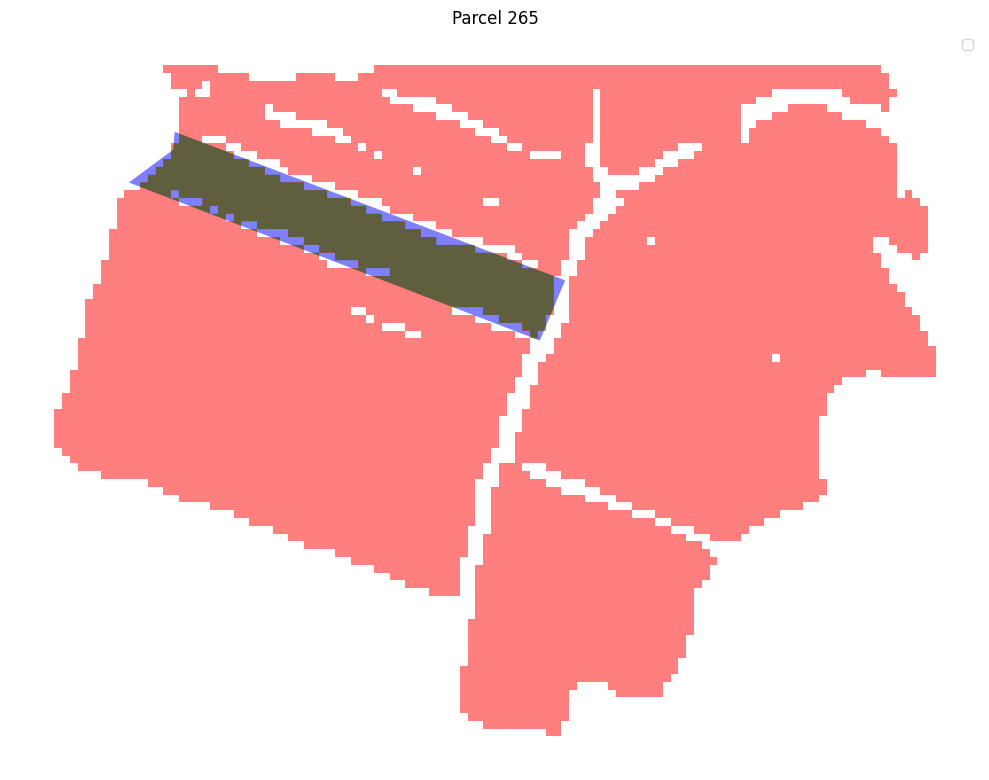

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 265:
True Positive (Correctly predicted): 9647.58 m²
False Negative (Missed): 1552.86 m²
Adjusted IoU: 0.86




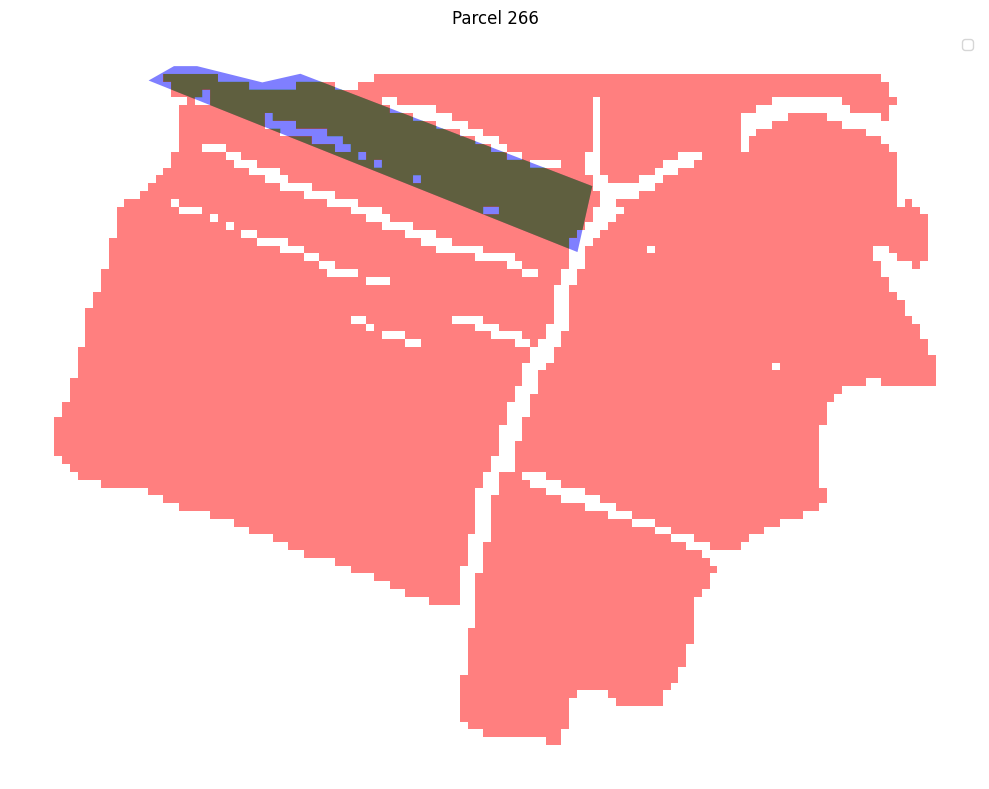

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 266:
True Positive (Correctly predicted): 9156.79 m²
False Negative (Missed): 1279.82 m²
Adjusted IoU: 0.88




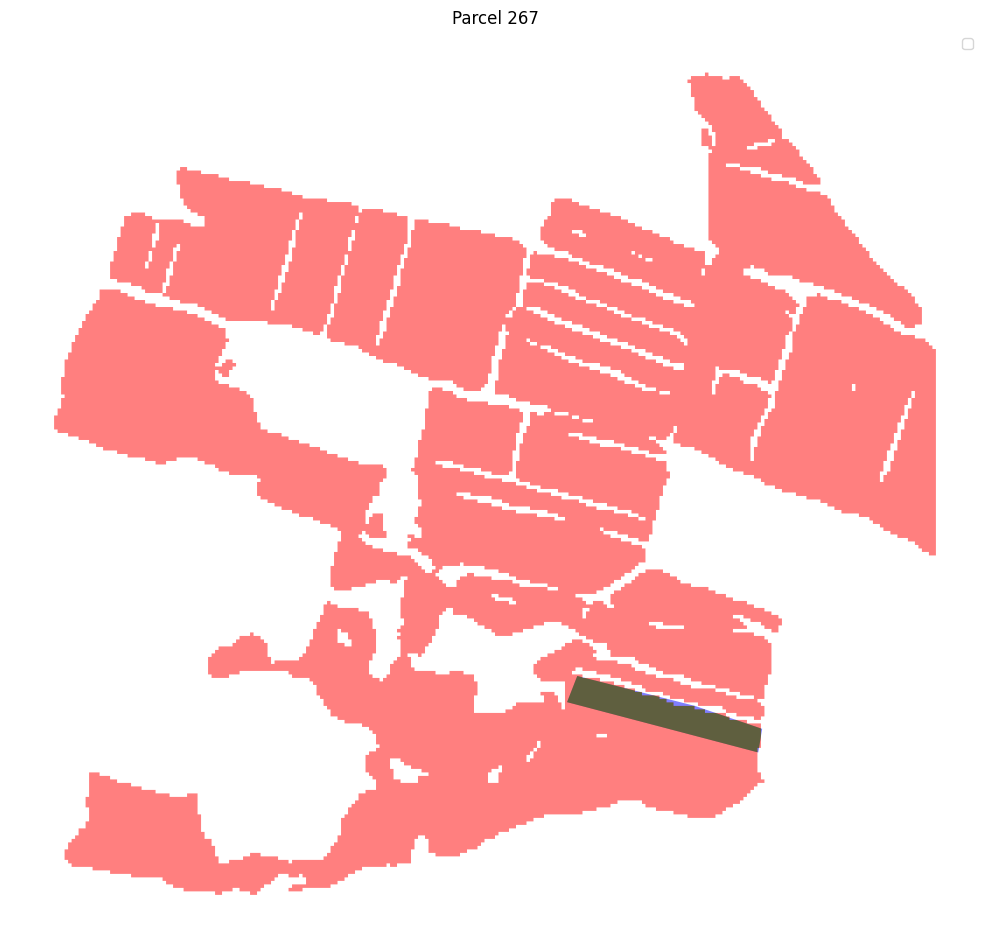

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 267:
True Positive (Correctly predicted): 10660.56 m²
False Negative (Missed): 334.96 m²
Adjusted IoU: 0.97




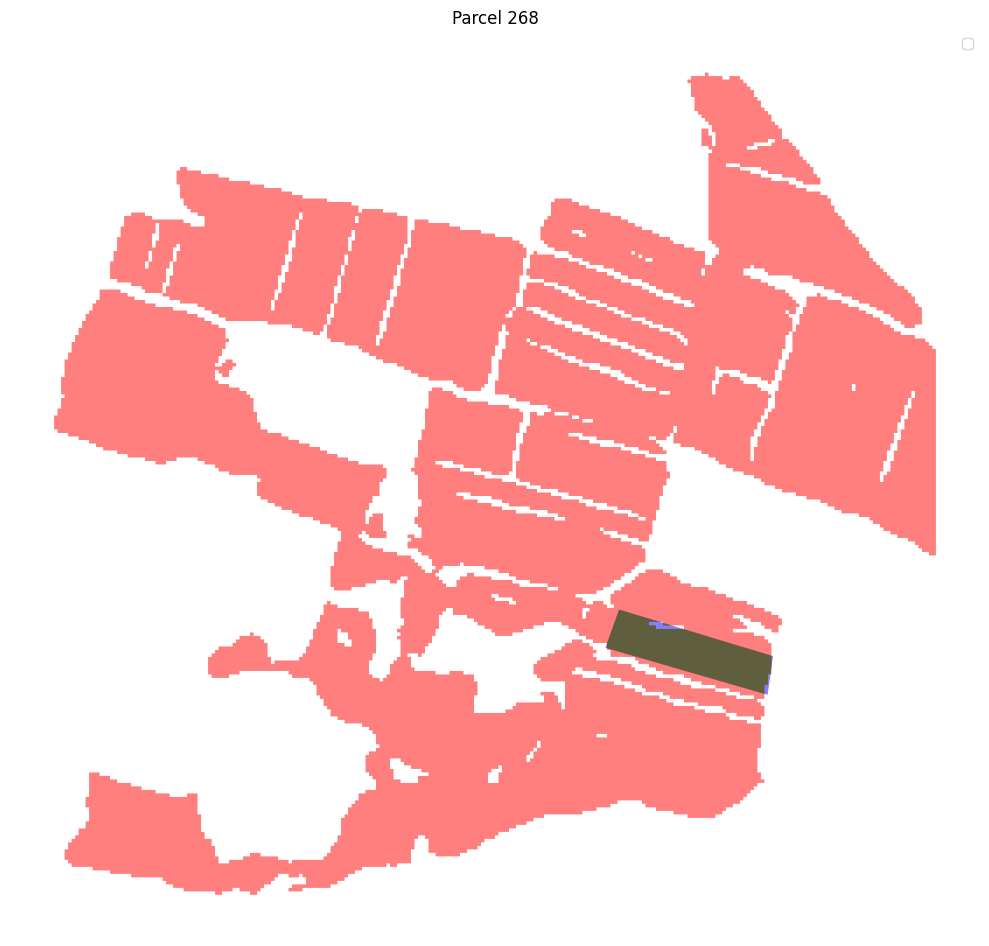

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 268:
True Positive (Correctly predicted): 12916.73 m²
False Negative (Missed): 387.56 m²
Adjusted IoU: 0.97




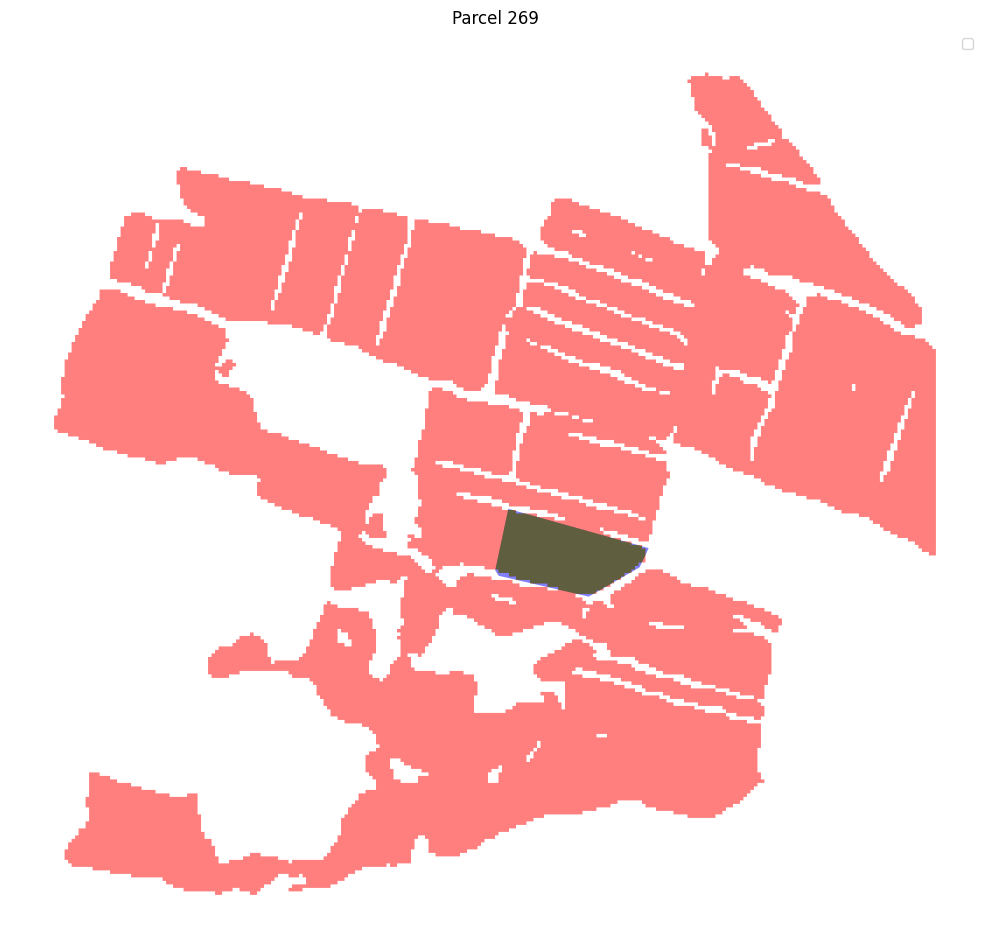

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 269:
True Positive (Correctly predicted): 16237.87 m²
False Negative (Missed): 492.25 m²
Adjusted IoU: 0.97




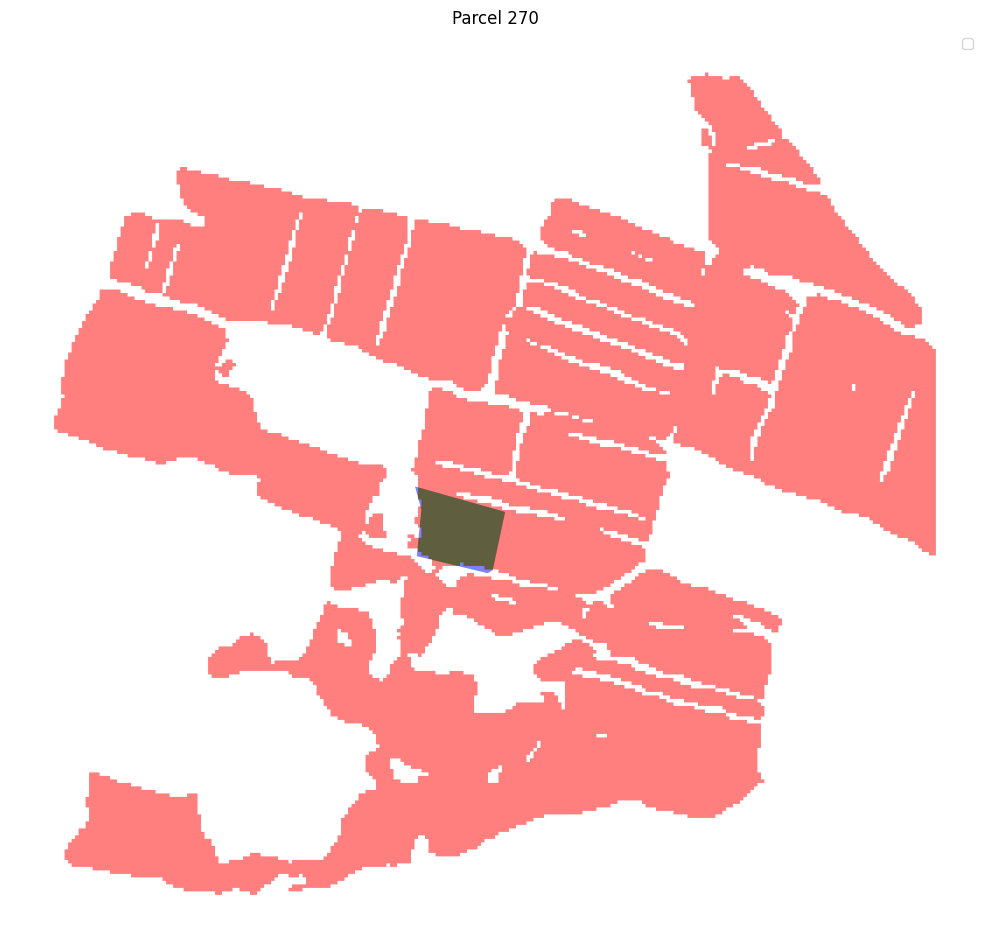

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 270:
True Positive (Correctly predicted): 10492.49 m²
False Negative (Missed): 446.58 m²
Adjusted IoU: 0.96




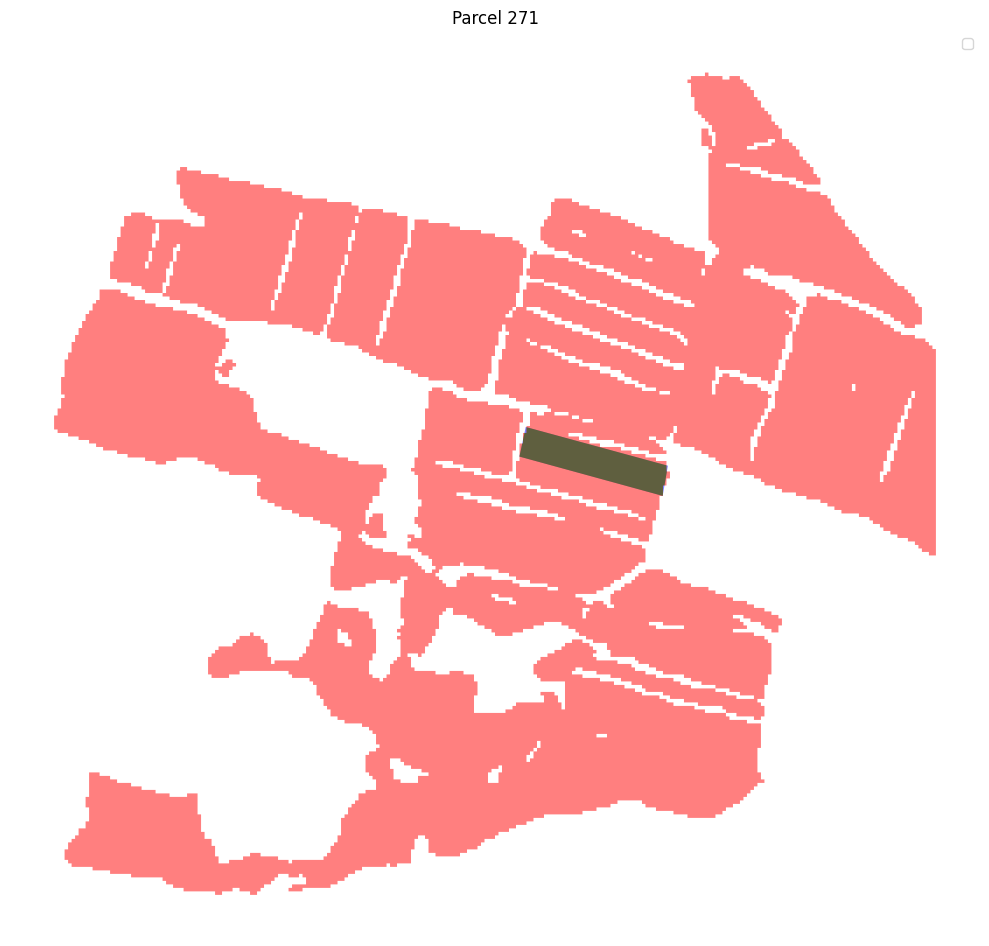

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 271:
True Positive (Correctly predicted): 9115.19 m²
False Negative (Missed): 44.41 m²
Adjusted IoU: 1.00




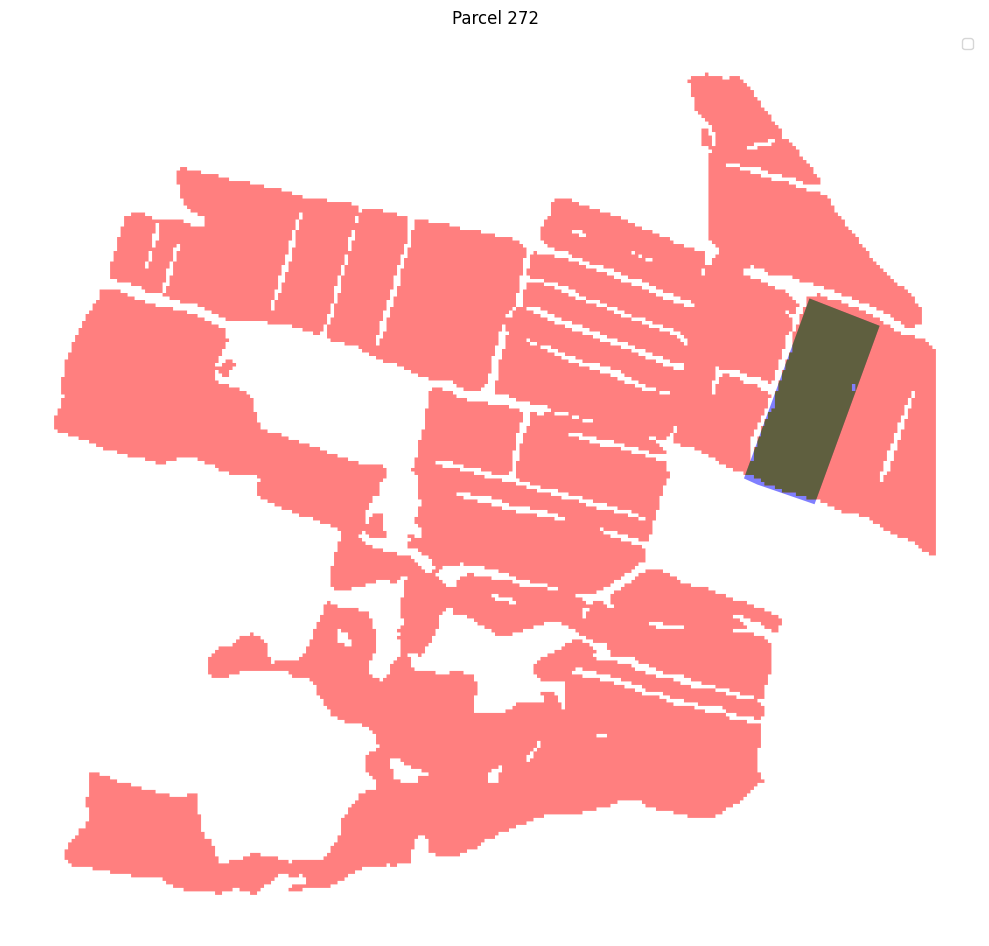

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 272:
True Positive (Correctly predicted): 28491.95 m²
False Negative (Missed): 871.27 m²
Adjusted IoU: 0.97




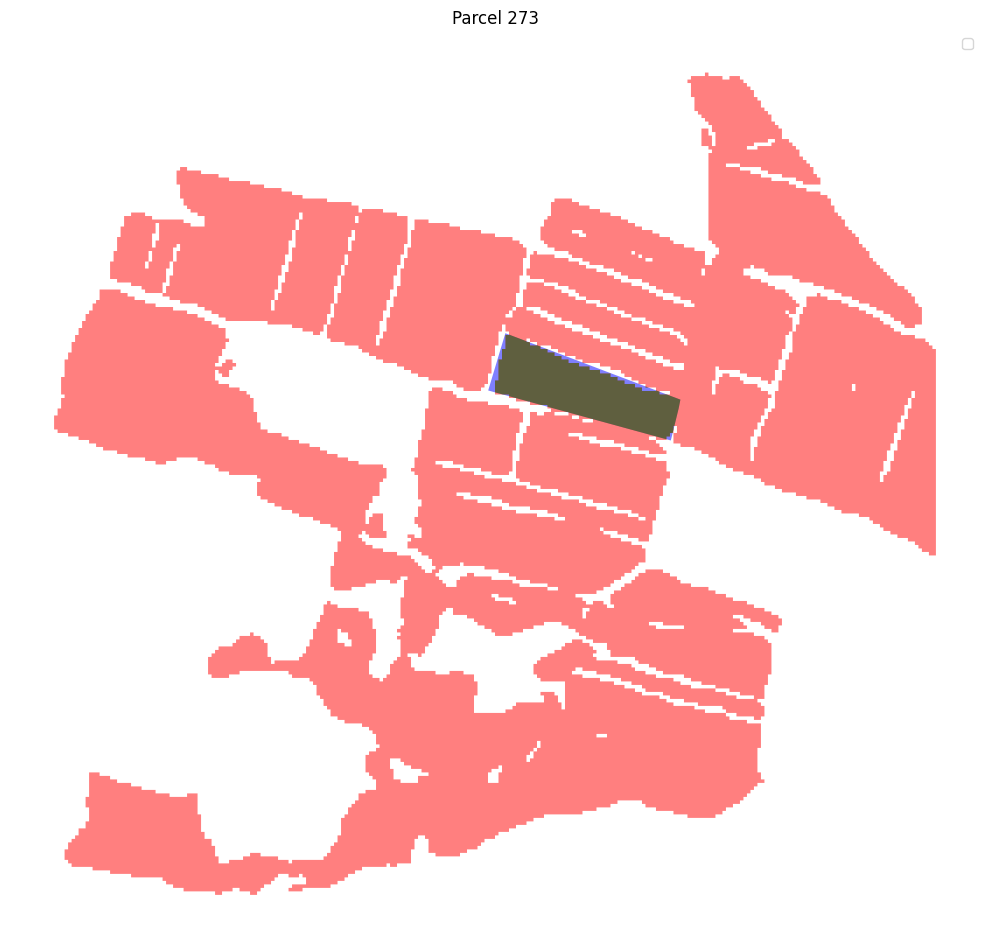

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 273:
True Positive (Correctly predicted): 18226.29 m²
False Negative (Missed): 1277.26 m²
Adjusted IoU: 0.93




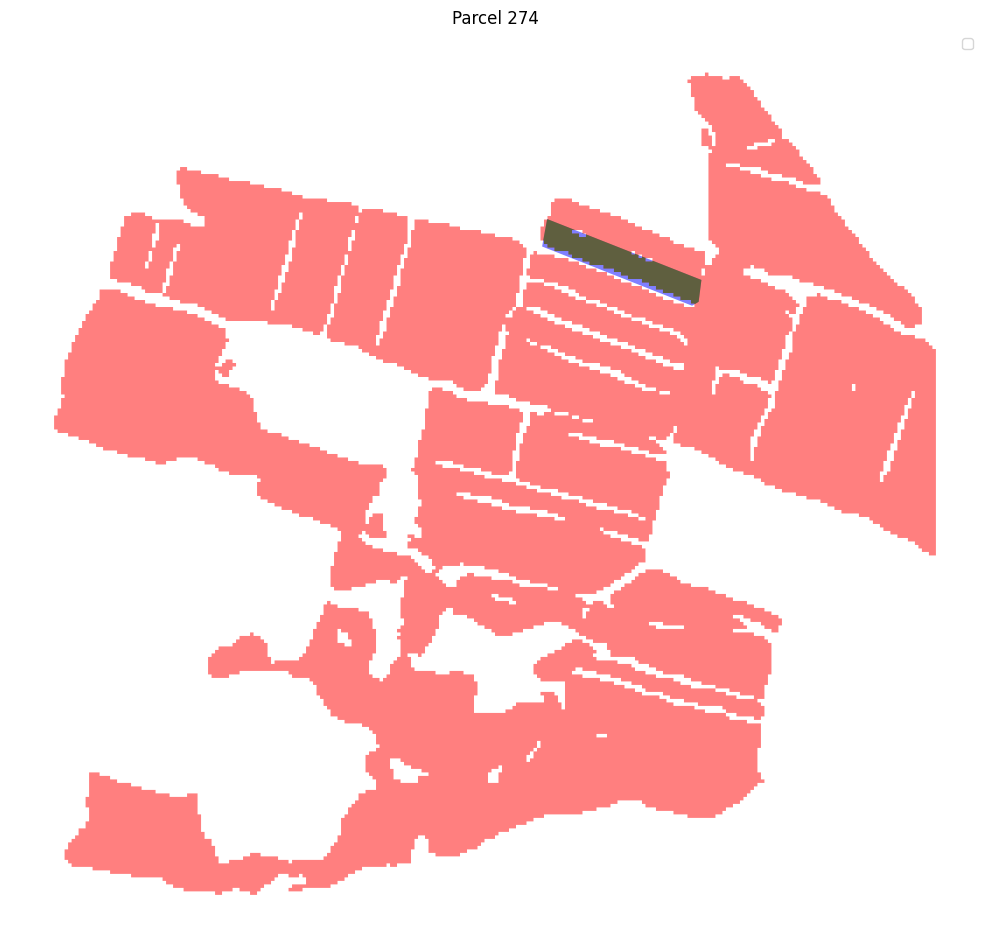

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 274:
True Positive (Correctly predicted): 8072.39 m²
False Negative (Missed): 1214.07 m²
Adjusted IoU: 0.87




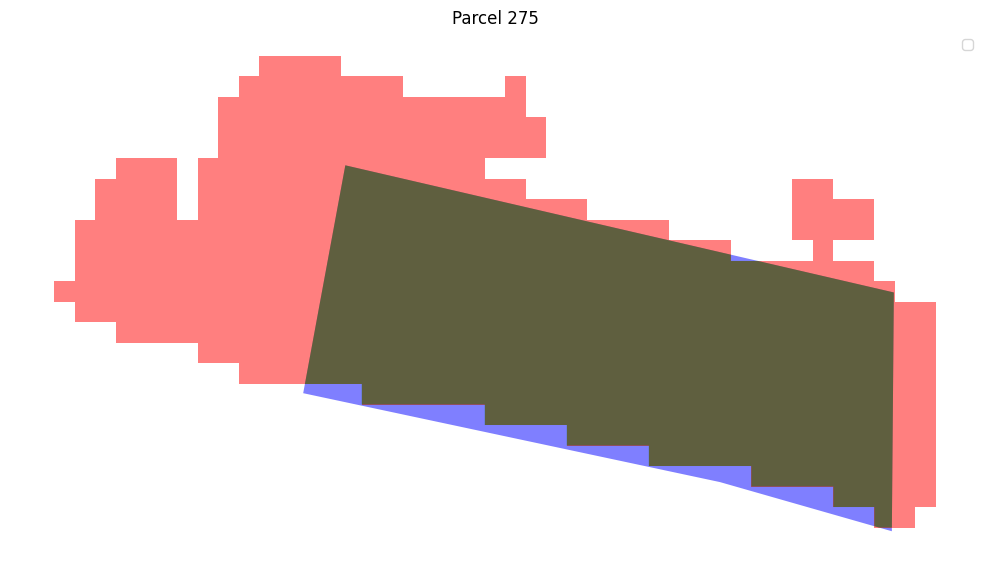

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 275:
True Positive (Correctly predicted): 7417.49 m²
False Negative (Missed): 488.18 m²
Adjusted IoU: 0.94




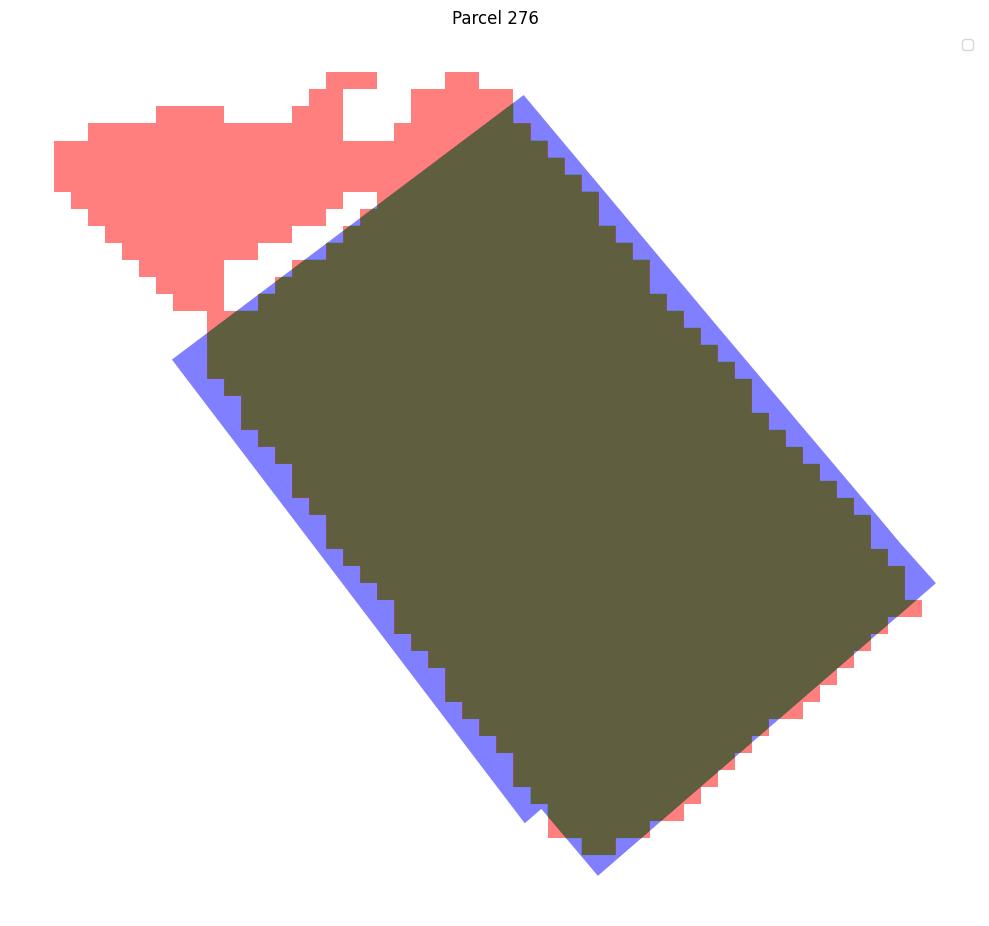

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 276:
True Positive (Correctly predicted): 23327.27 m²
False Negative (Missed): 2240.09 m²
Adjusted IoU: 0.91




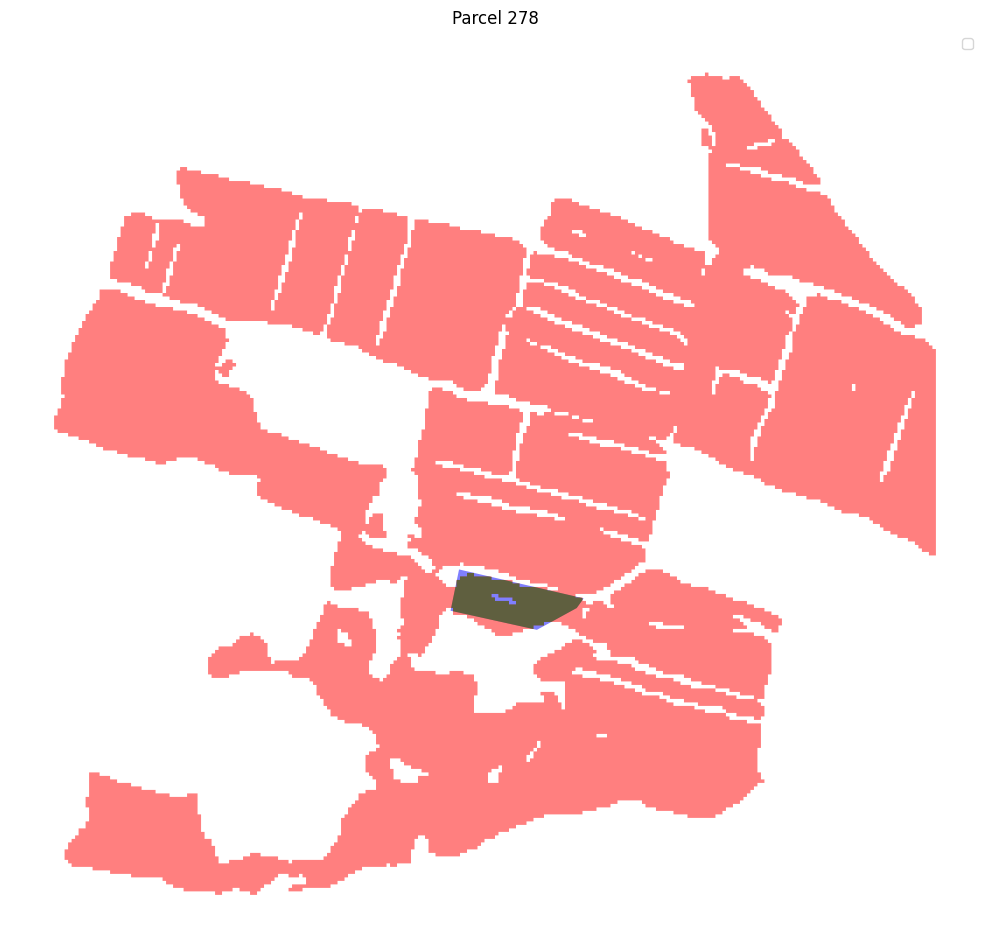

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 278:
True Positive (Correctly predicted): 8778.63 m²
False Negative (Missed): 643.46 m²
Adjusted IoU: 0.93




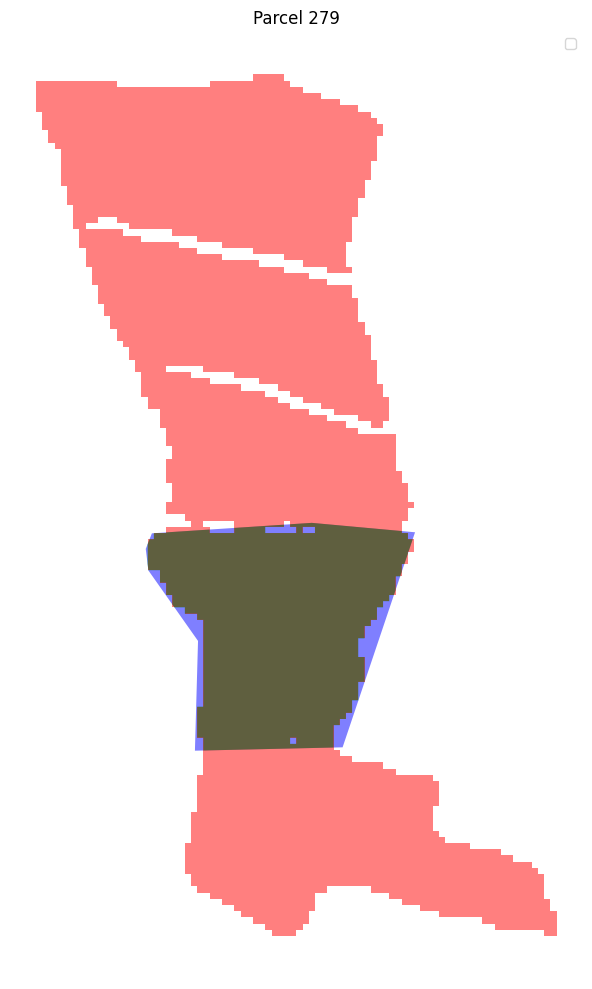

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 279:
True Positive (Correctly predicted): 26632.21 m²
False Negative (Missed): 2069.22 m²
Adjusted IoU: 0.93




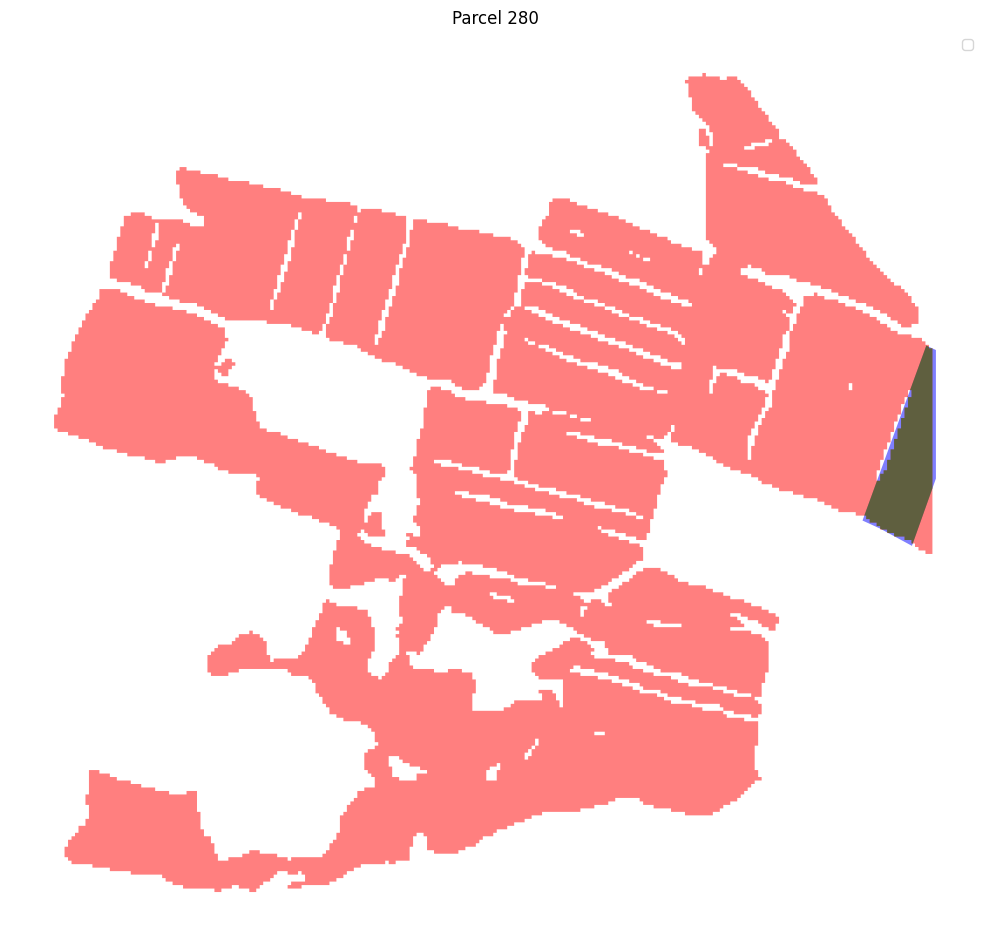

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 280:
True Positive (Correctly predicted): 13895.50 m²
False Negative (Missed): 1829.36 m²
Adjusted IoU: 0.88




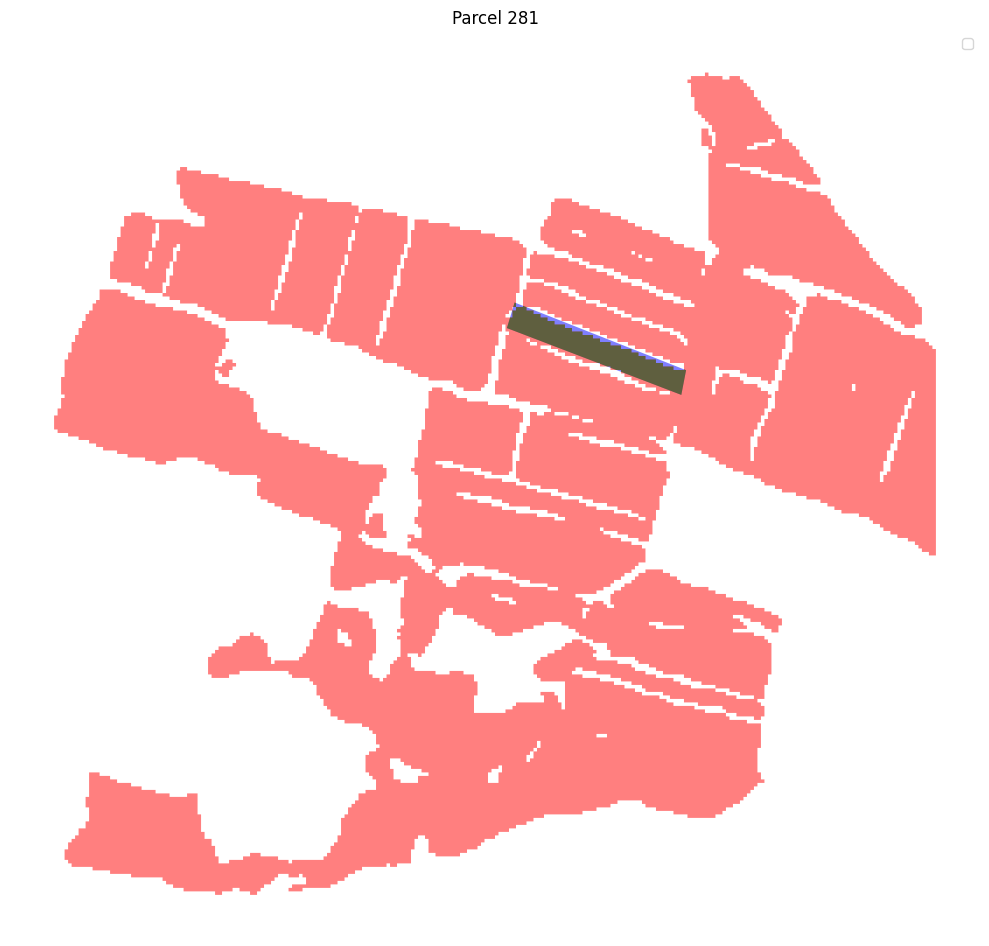

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 281:
True Positive (Correctly predicted): 8563.08 m²
False Negative (Missed): 1166.61 m²
Adjusted IoU: 0.88




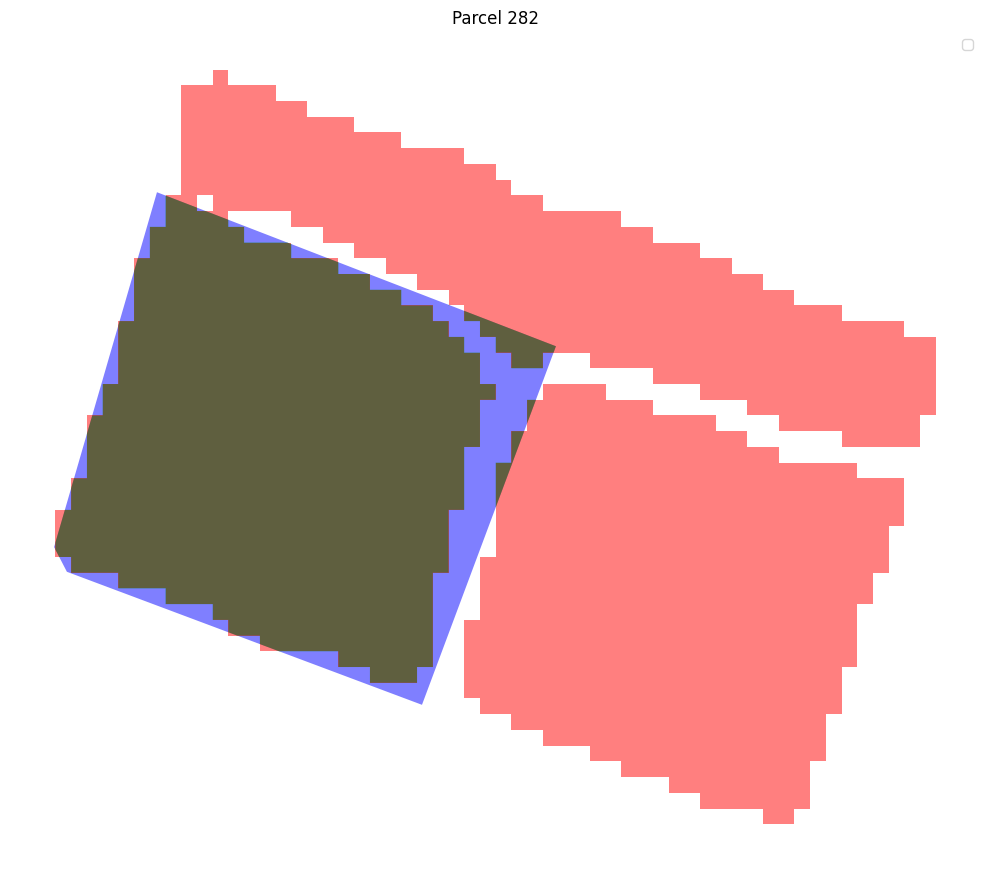

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 282:
True Positive (Correctly predicted): 14050.87 m²
False Negative (Missed): 2005.62 m²
Adjusted IoU: 0.88




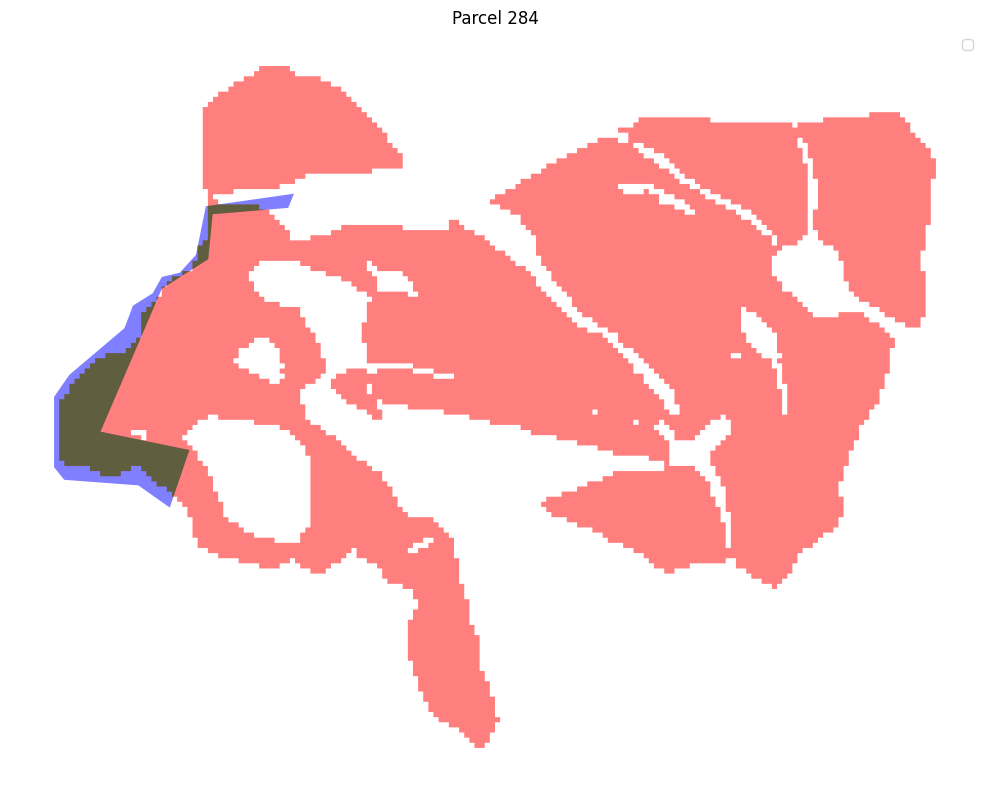

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 284:
True Positive (Correctly predicted): 8774.67 m²
False Negative (Missed): 4294.24 m²
Adjusted IoU: 0.67




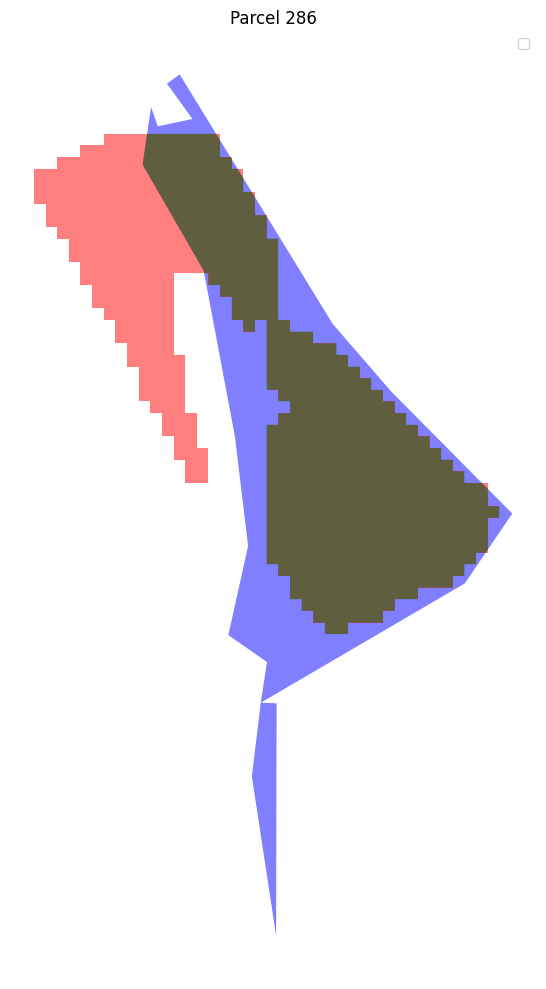

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 286:
True Positive (Correctly predicted): 10941.64 m²
False Negative (Missed): 5647.34 m²
Adjusted IoU: 0.66




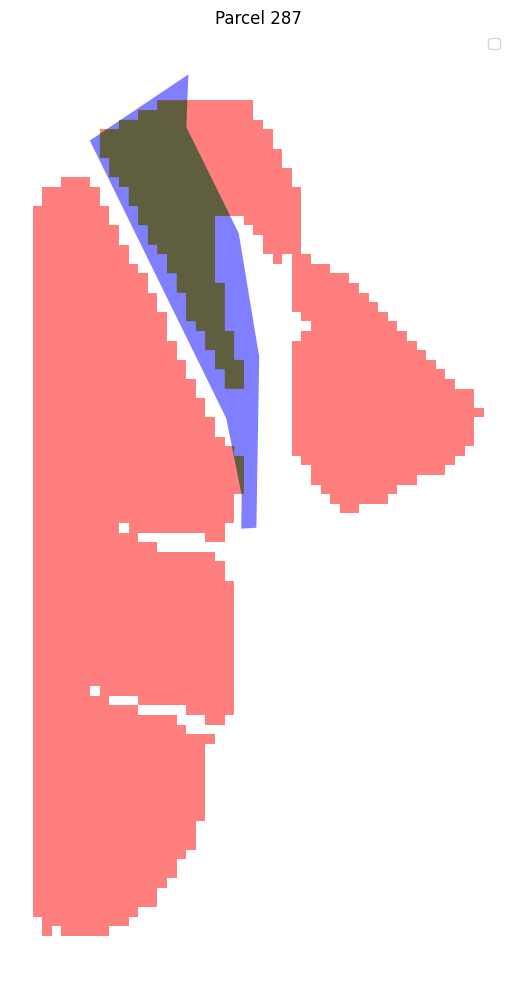

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 287:
True Positive (Correctly predicted): 4569.65 m²
False Negative (Missed): 3107.43 m²
Adjusted IoU: 0.60




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


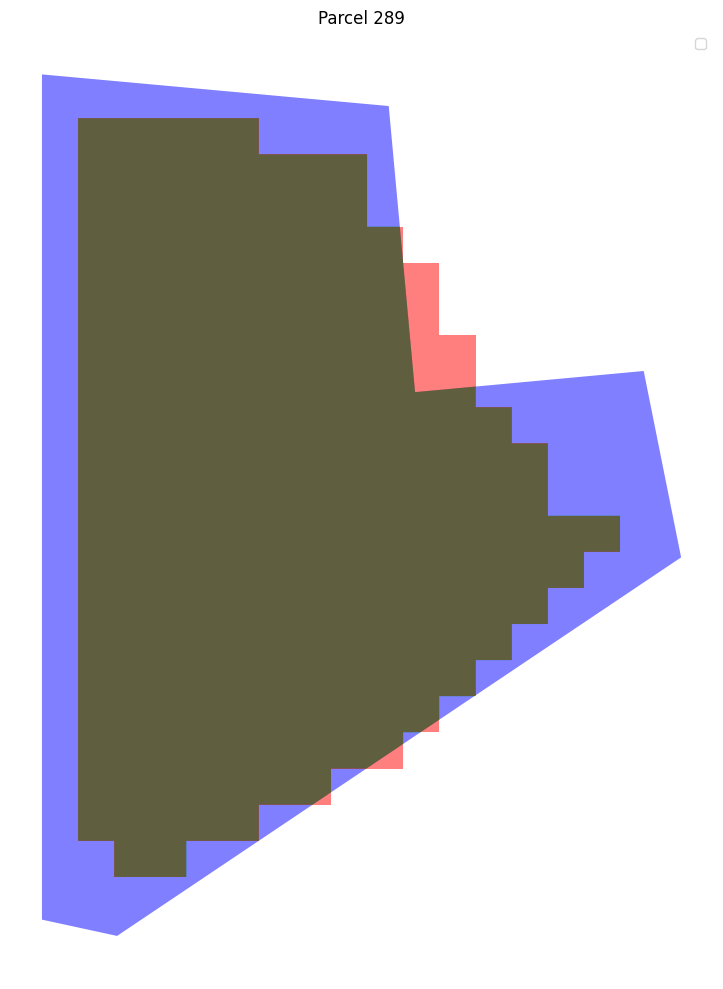

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 289:
True Positive (Correctly predicted): 5074.09 m²
False Negative (Missed): 1597.33 m²
Adjusted IoU: 0.76




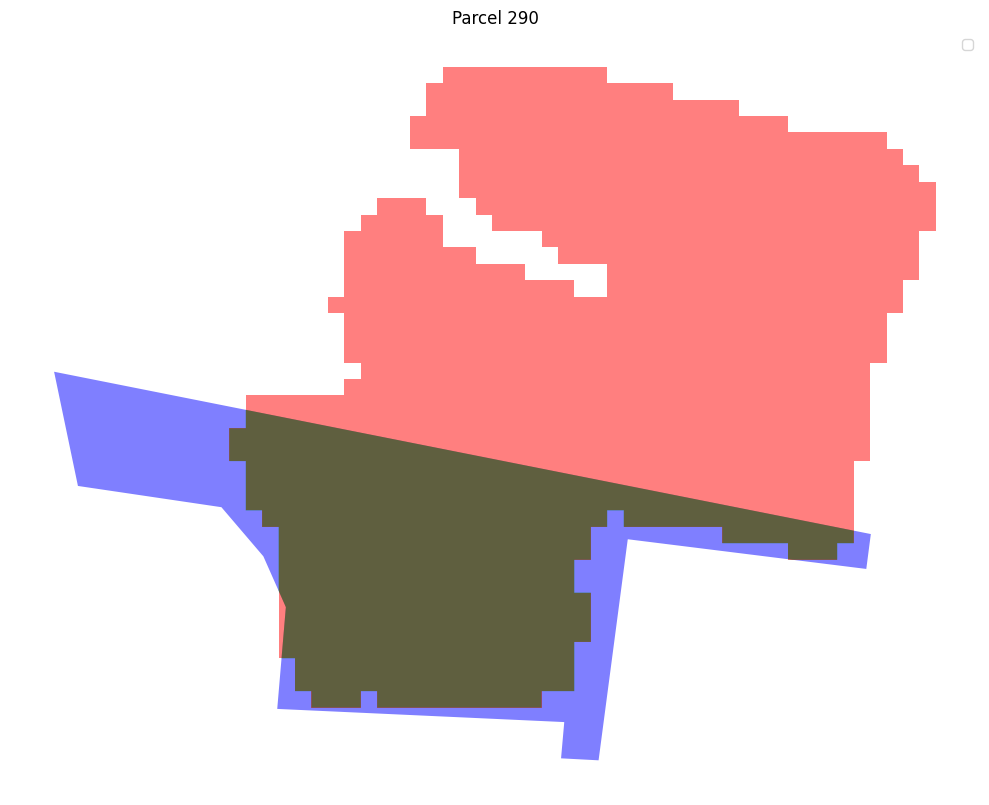

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 290:
True Positive (Correctly predicted): 8332.03 m²
False Negative (Missed): 3370.69 m²
Adjusted IoU: 0.71




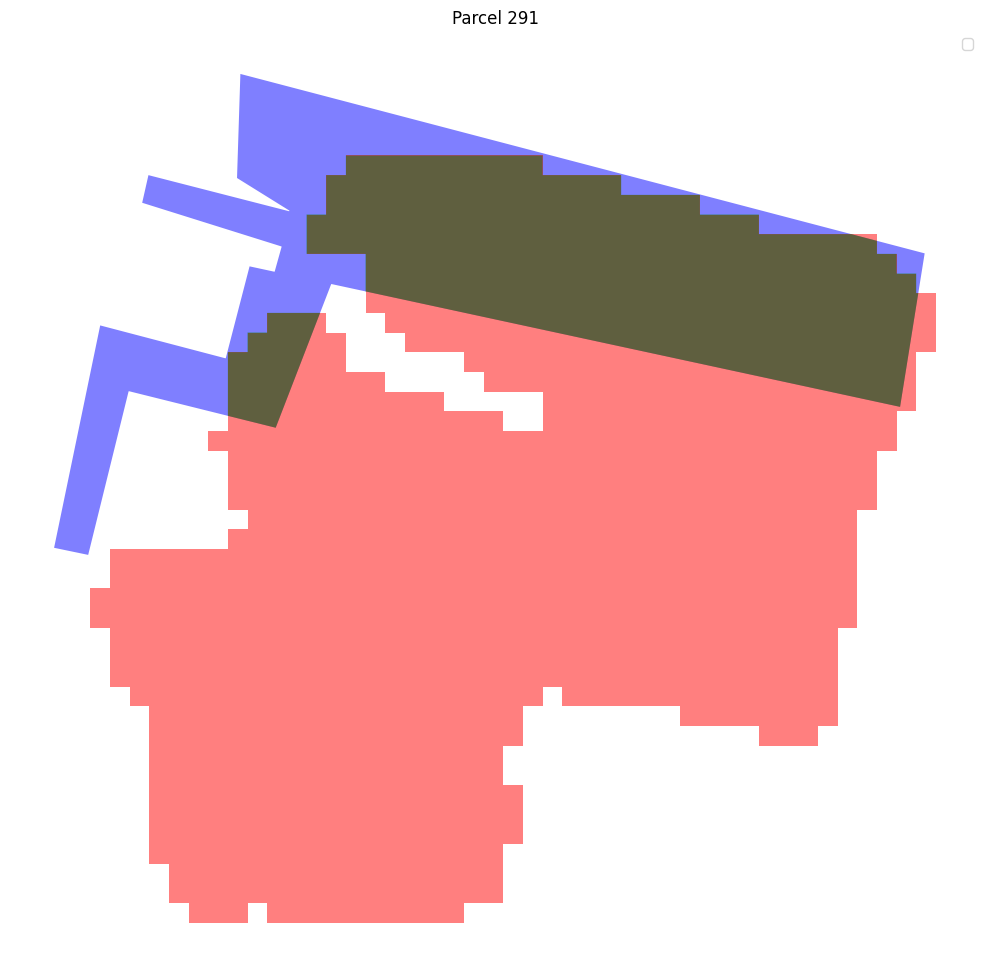

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 291:
True Positive (Correctly predicted): 6195.75 m²
False Negative (Missed): 3118.78 m²
Adjusted IoU: 0.67




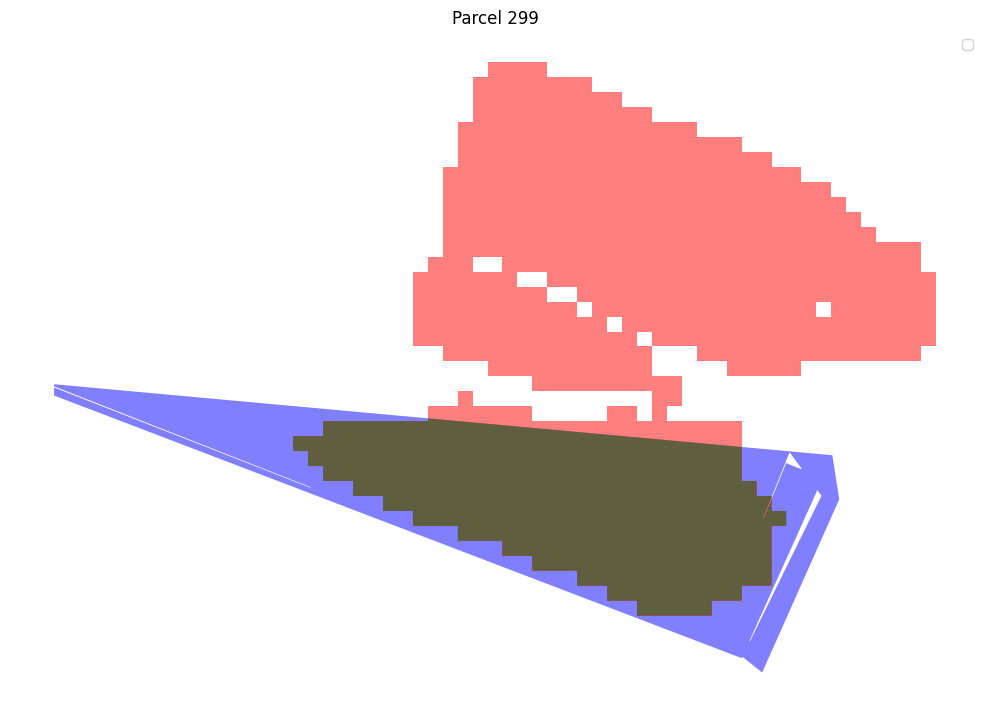

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 299:
True Positive (Correctly predicted): 6471.81 m²
False Negative (Missed): 3617.54 m²
Adjusted IoU: 0.64




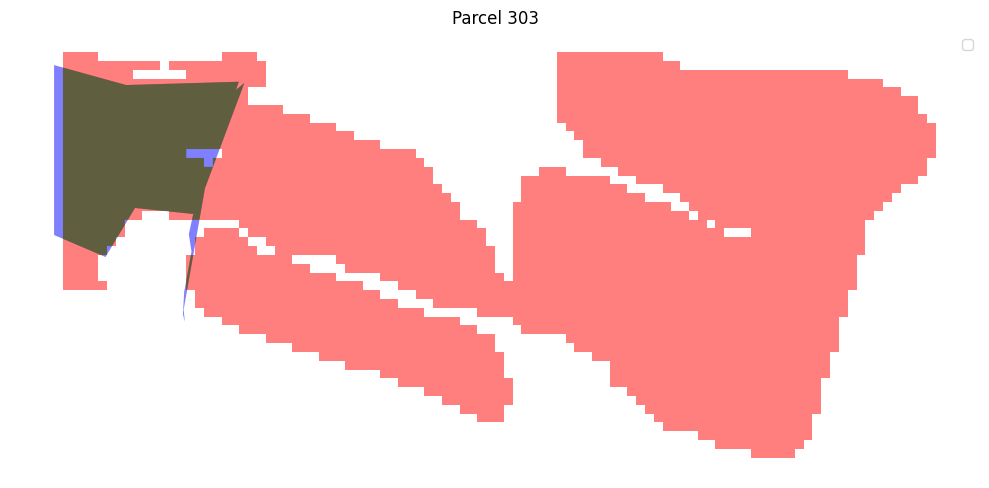

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 303:
True Positive (Correctly predicted): 7240.36 m²
False Negative (Missed): 693.86 m²
Adjusted IoU: 0.91




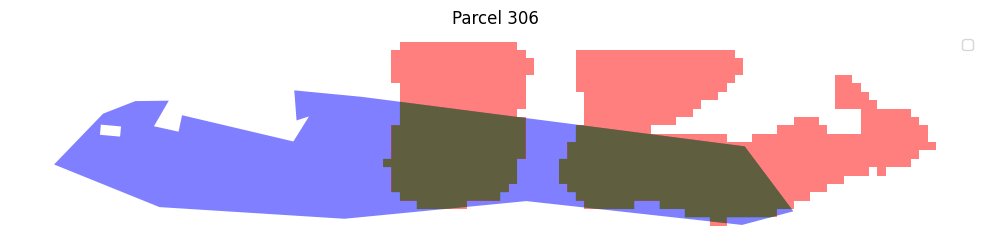

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 306:
True Positive (Correctly predicted): 9610.65 m²
False Negative (Missed): 12606.67 m²
Adjusted IoU: 0.43




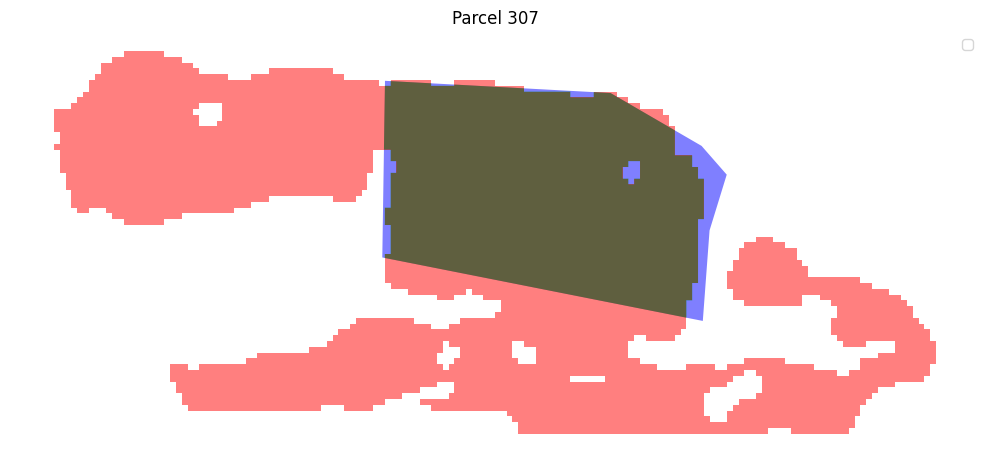

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 307:
True Positive (Correctly predicted): 43688.80 m²
False Negative (Missed): 3151.51 m²
Adjusted IoU: 0.93




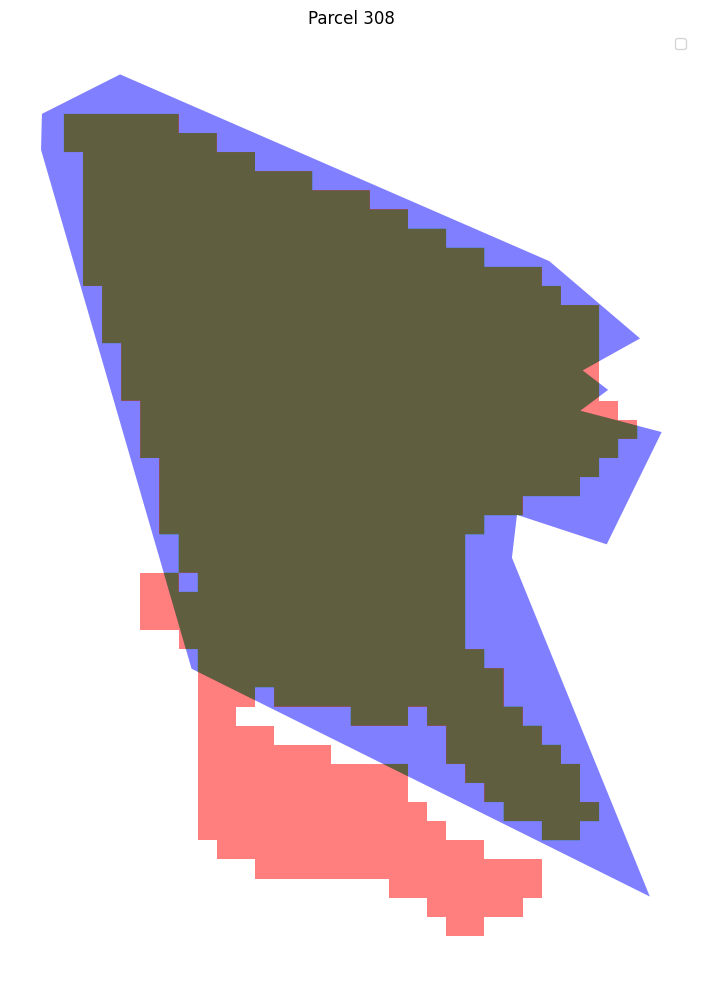

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 308:
True Positive (Correctly predicted): 15172.55 m²
False Negative (Missed): 3833.21 m²
Adjusted IoU: 0.80




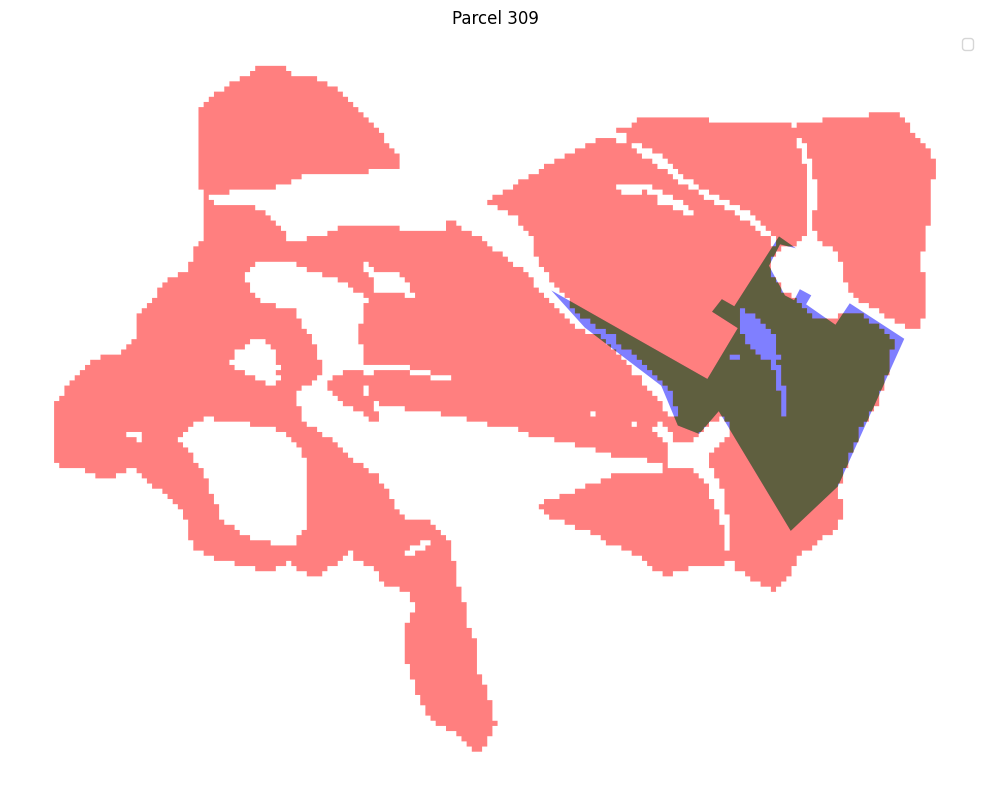

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 309:
True Positive (Correctly predicted): 28668.78 m²
False Negative (Missed): 3406.98 m²
Adjusted IoU: 0.89




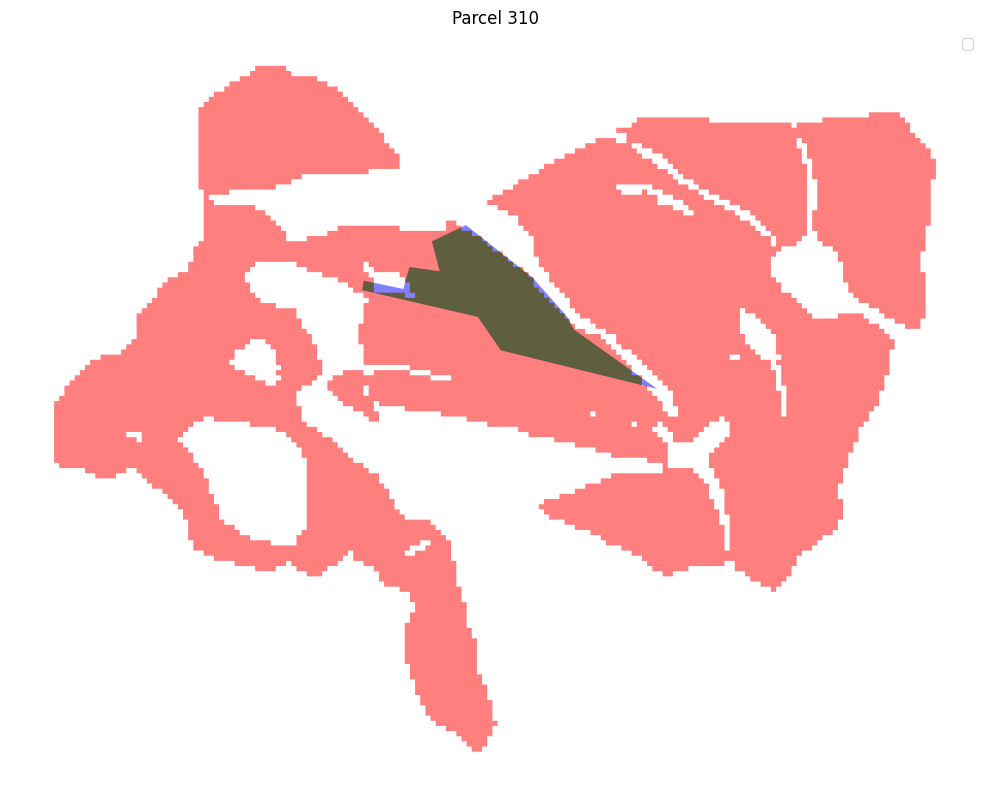

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 310:
True Positive (Correctly predicted): 12456.35 m²
False Negative (Missed): 618.55 m²
Adjusted IoU: 0.95




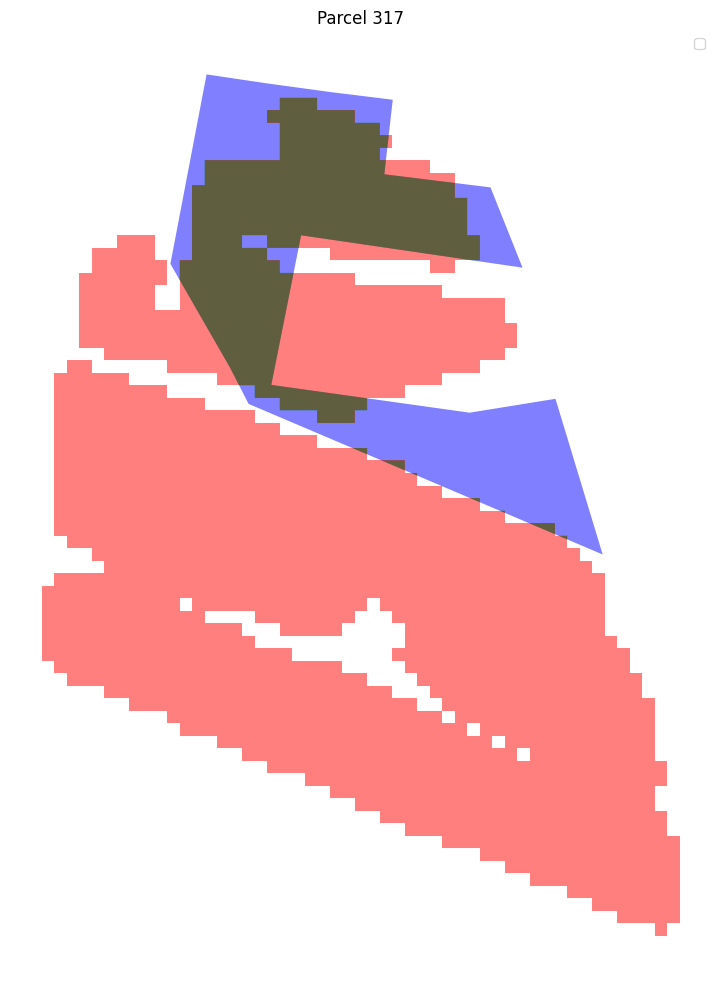

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 317:
True Positive (Correctly predicted): 6500.52 m²
False Negative (Missed): 5700.86 m²
Adjusted IoU: 0.53




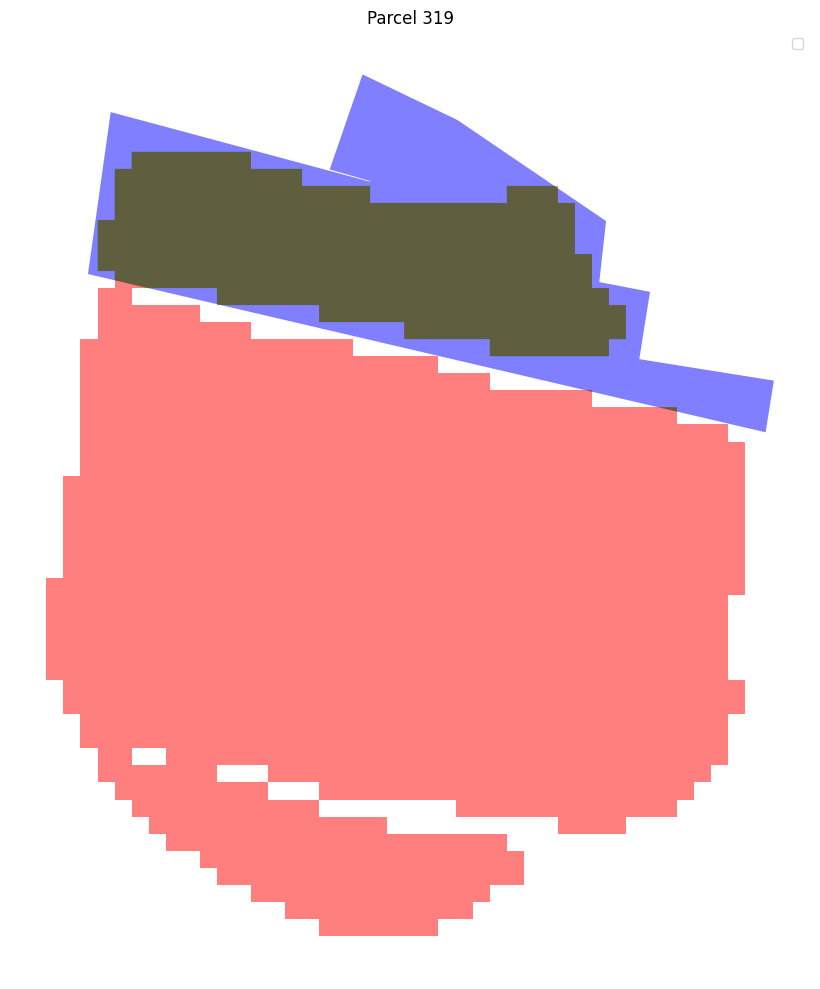

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 319:
True Positive (Correctly predicted): 5916.57 m²
False Negative (Missed): 3506.31 m²
Adjusted IoU: 0.63




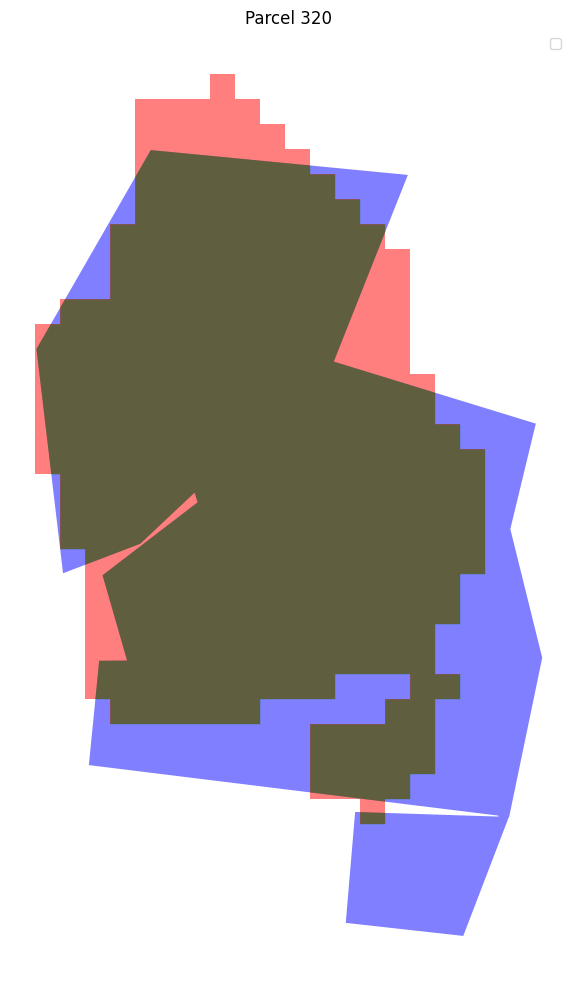

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 320:
True Positive (Correctly predicted): 7659.01 m²
False Negative (Missed): 2717.76 m²
Adjusted IoU: 0.74




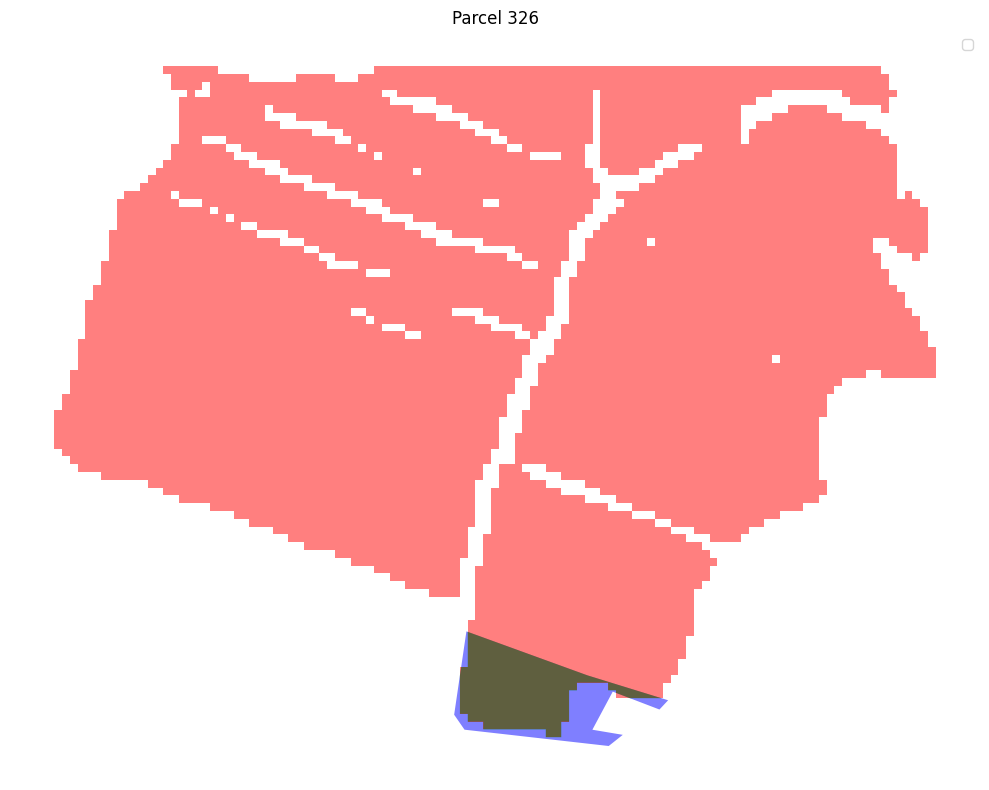

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 326:
True Positive (Correctly predicted): 3700.07 m²
False Negative (Missed): 1438.63 m²
Adjusted IoU: 0.72




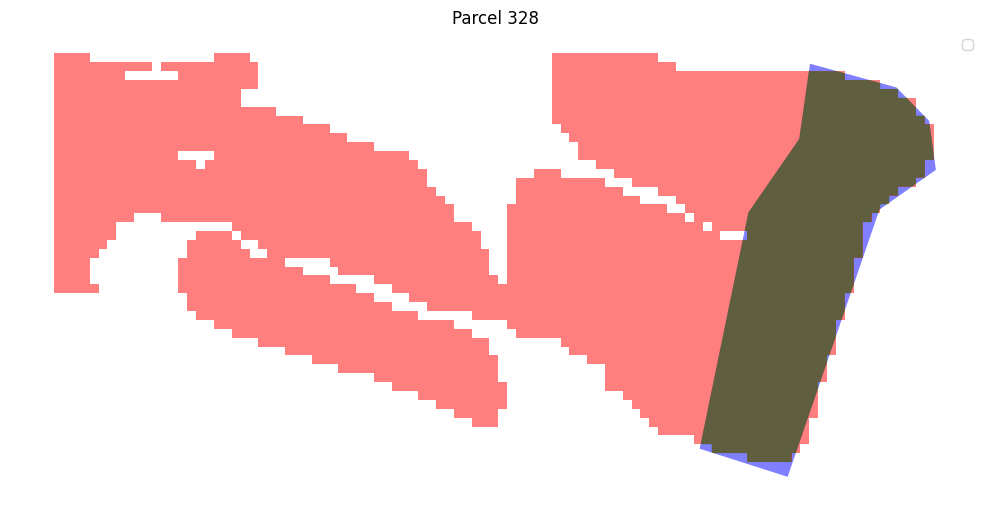

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 328:
True Positive (Correctly predicted): 13952.45 m²
False Negative (Missed): 577.19 m²
Adjusted IoU: 0.96




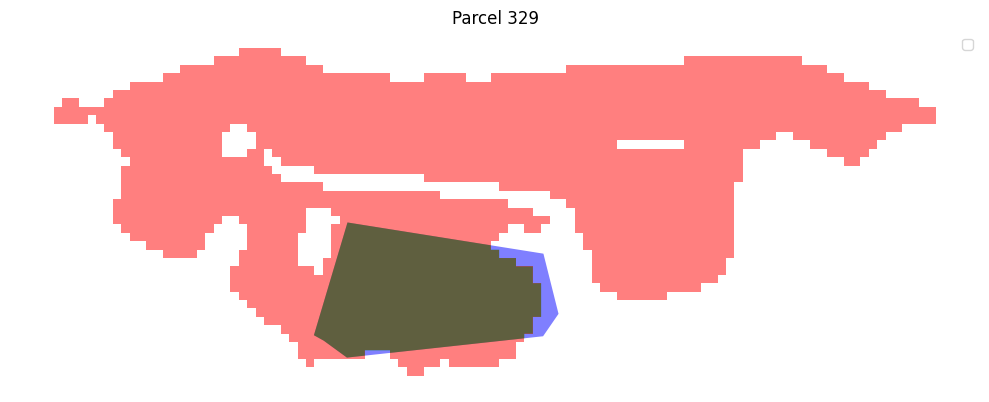

Parcel 329:
True Positive (Correctly predicted): 7927.02 m²
False Negative (Missed): 648.13 m²
Adjusted IoU: 0.92




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

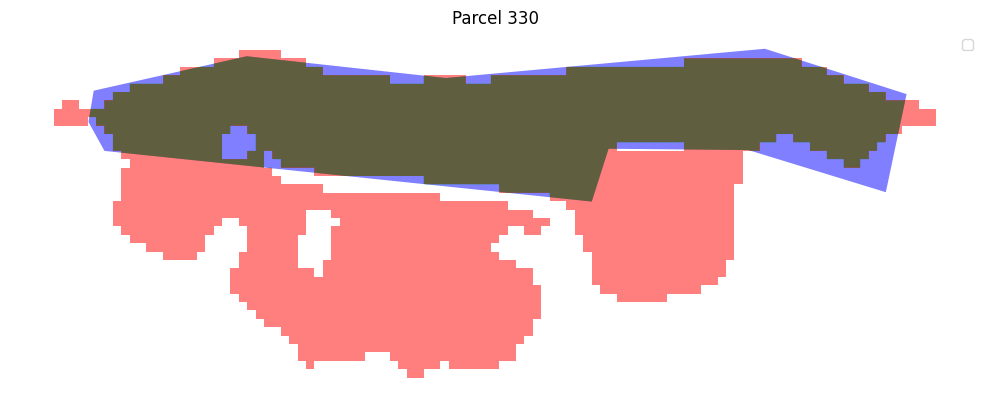

Parcel 330:
True Positive (Correctly predicted): 25815.80 m²
False Negative (Missed): 3559.26 m²
Adjusted IoU: 0.88




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

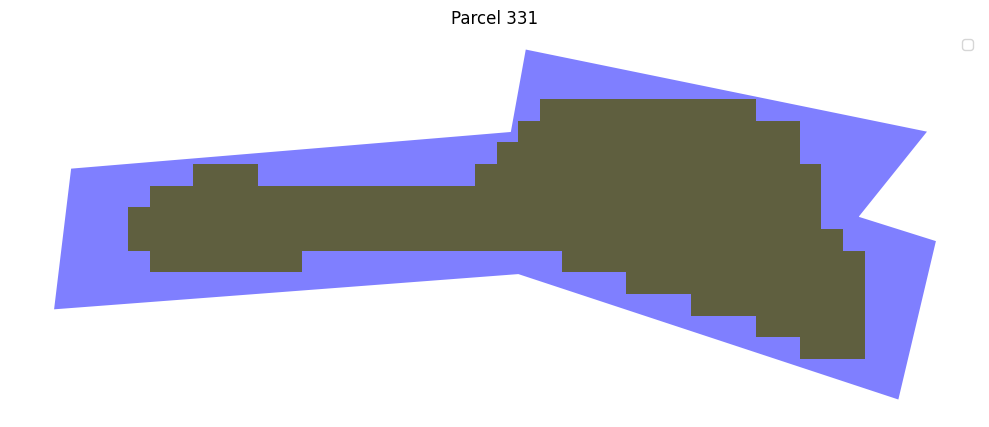

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 331:
True Positive (Correctly predicted): 5000.00 m²
False Negative (Missed): 3622.94 m²
Adjusted IoU: 0.58




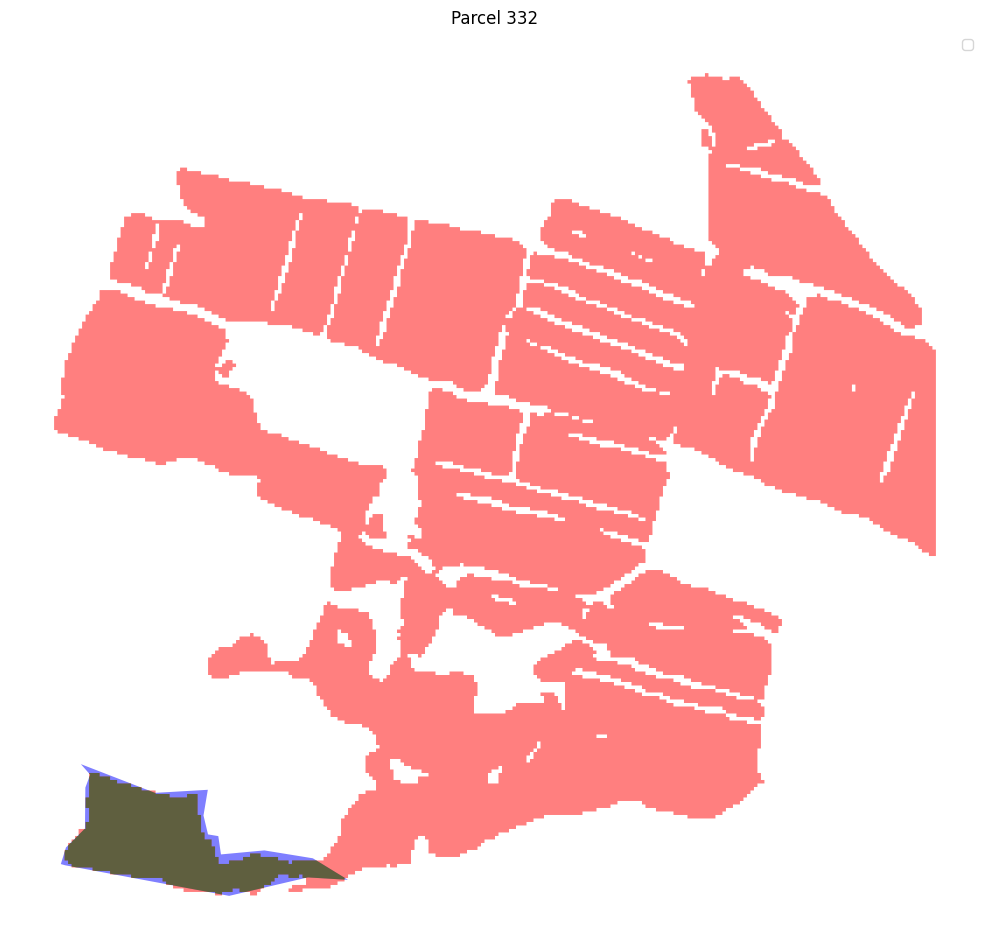

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 332:
True Positive (Correctly predicted): 29462.06 m²
False Negative (Missed): 3999.79 m²
Adjusted IoU: 0.88




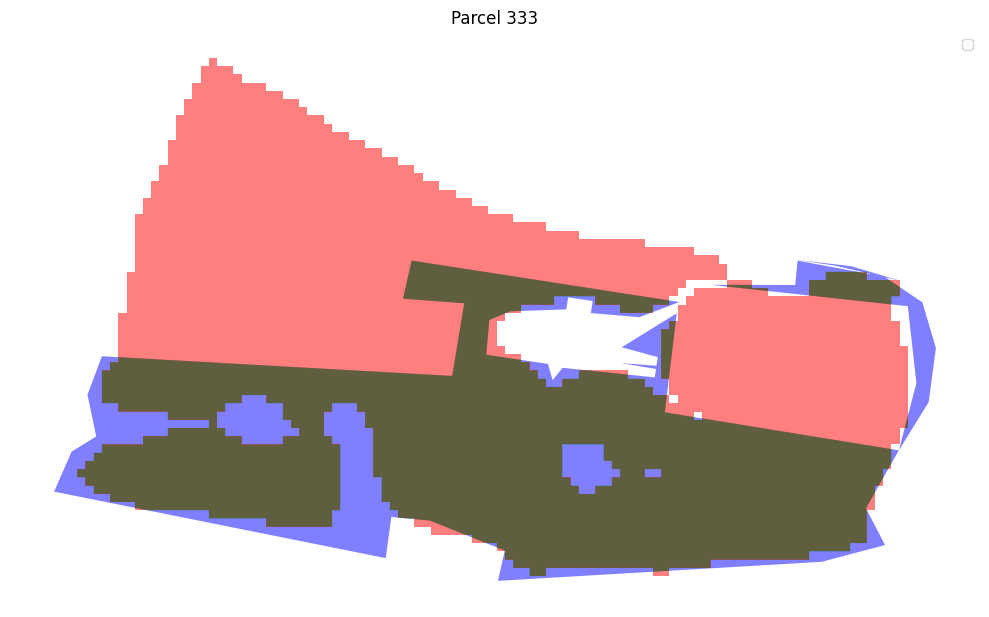

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 333:
True Positive (Correctly predicted): 44171.89 m²
False Negative (Missed): 10304.97 m²
Adjusted IoU: 0.81




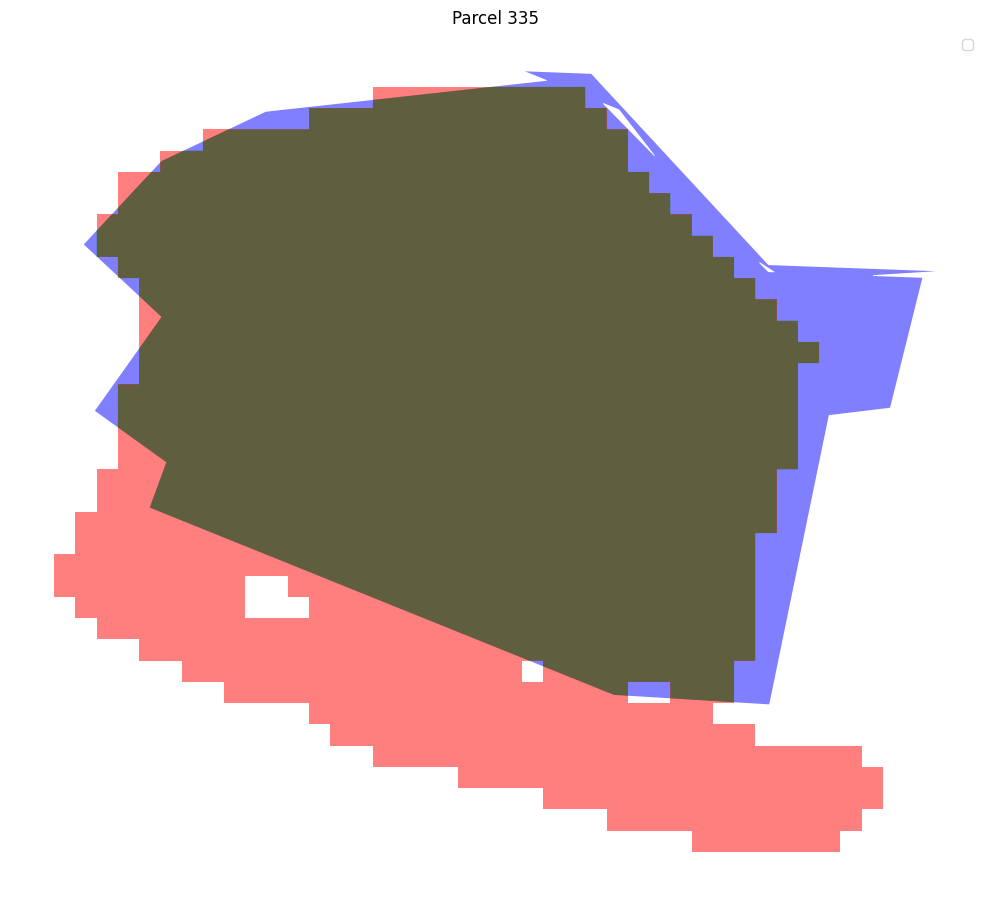

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 335:
True Positive (Correctly predicted): 17060.88 m²
False Negative (Missed): 2096.12 m²
Adjusted IoU: 0.89




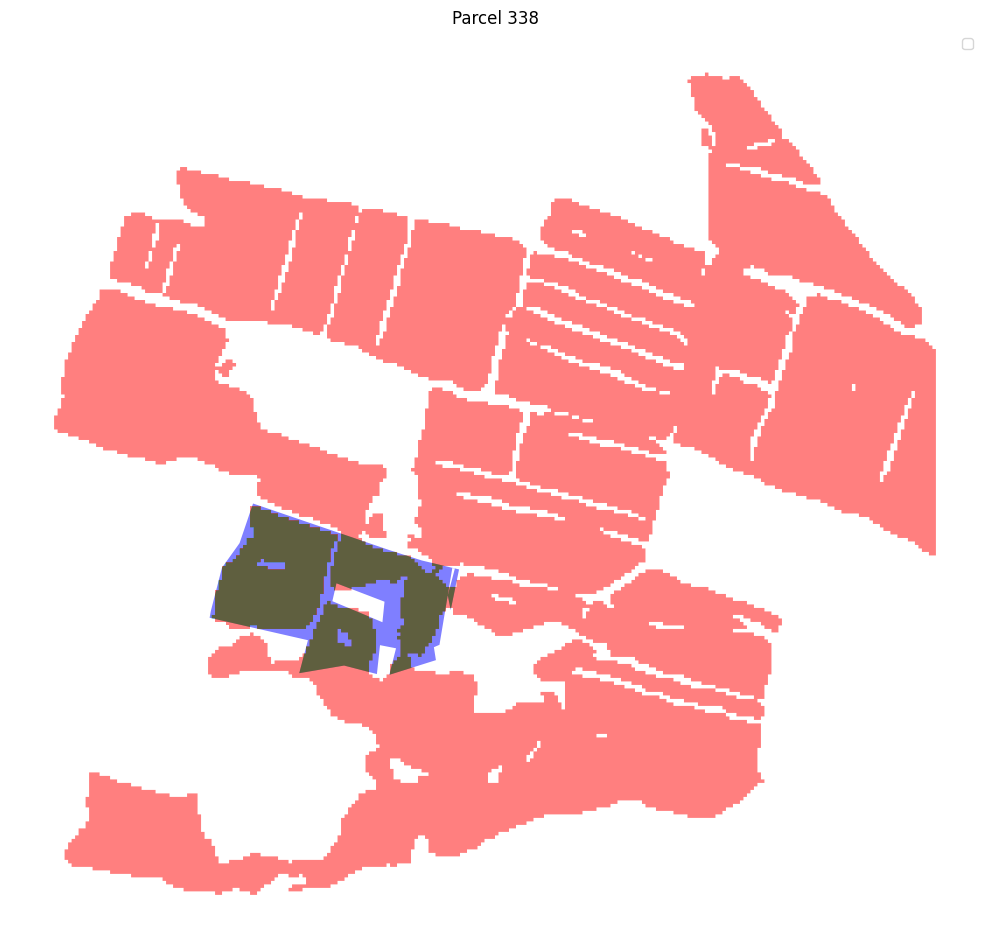

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 338:
True Positive (Correctly predicted): 41241.09 m²
False Negative (Missed): 10347.40 m²
Adjusted IoU: 0.80




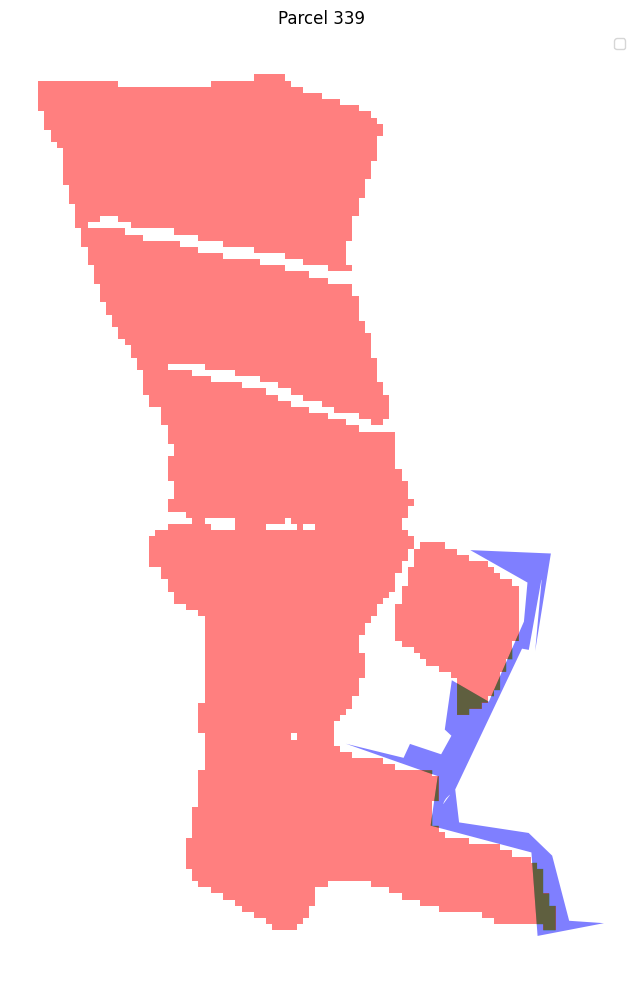

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 339:
True Positive (Correctly predicted): 1092.51 m²
False Negative (Missed): 6630.83 m²
Adjusted IoU: 0.14




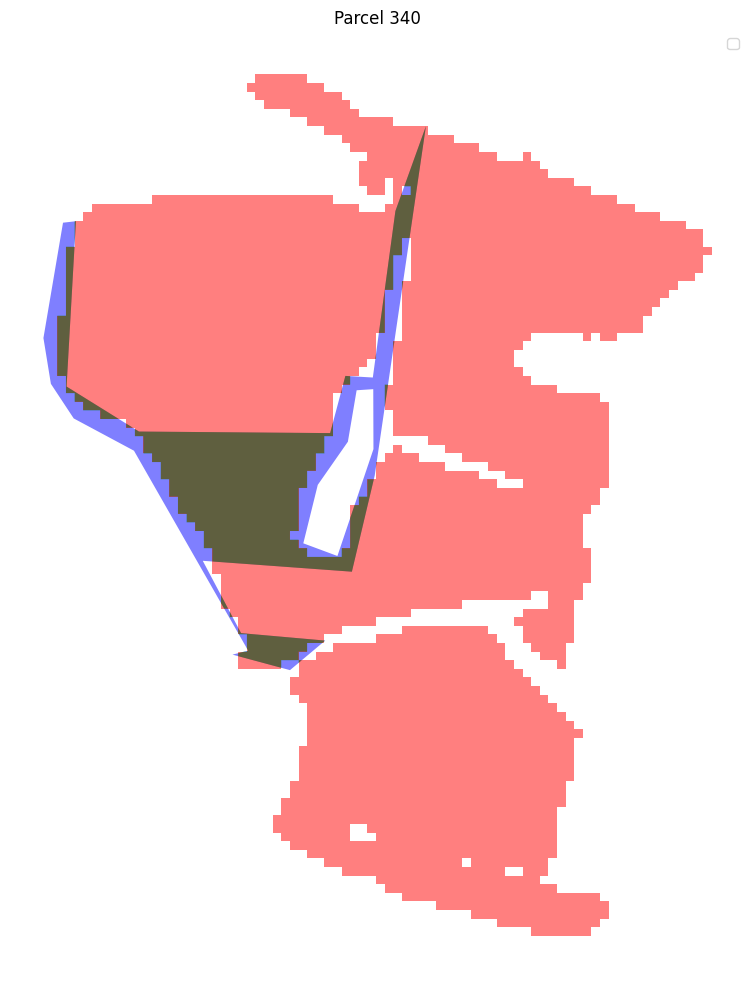

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),


Parcel 340:
True Positive (Correctly predicted): 7982.15 m²
False Negative (Missed): 4092.25 m²
Adjusted IoU: 0.66




/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


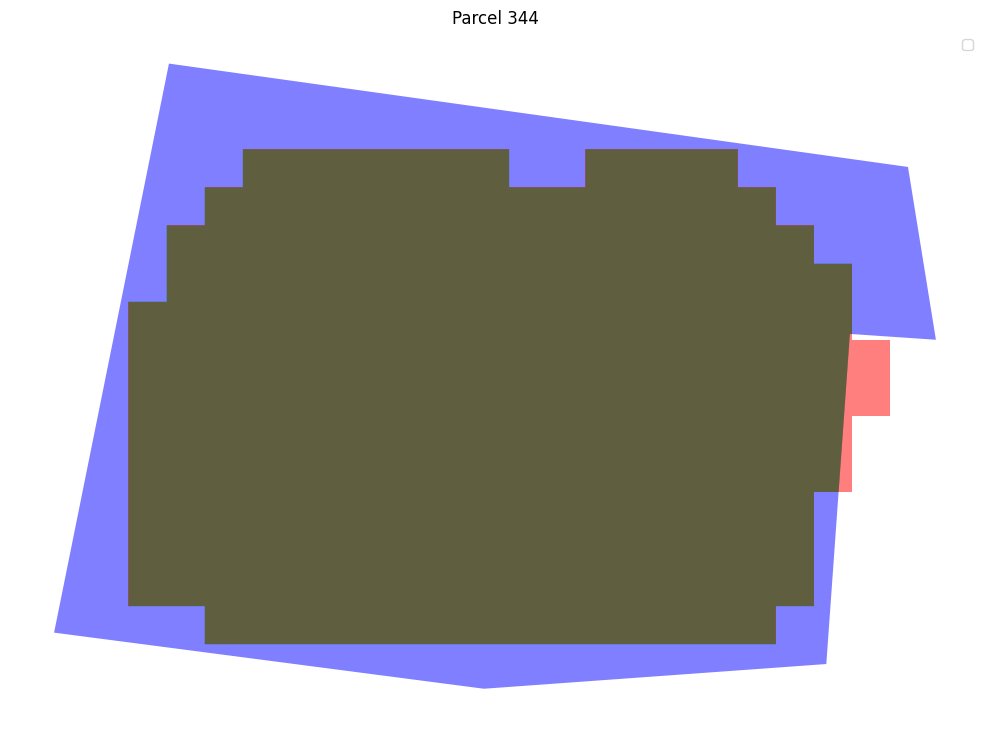

/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Parcel 344:
True Positive (Correctly predicted): 5603.80 m²
False Negative (Missed): 1706.17 m²
Adjusted IoU: 0.77




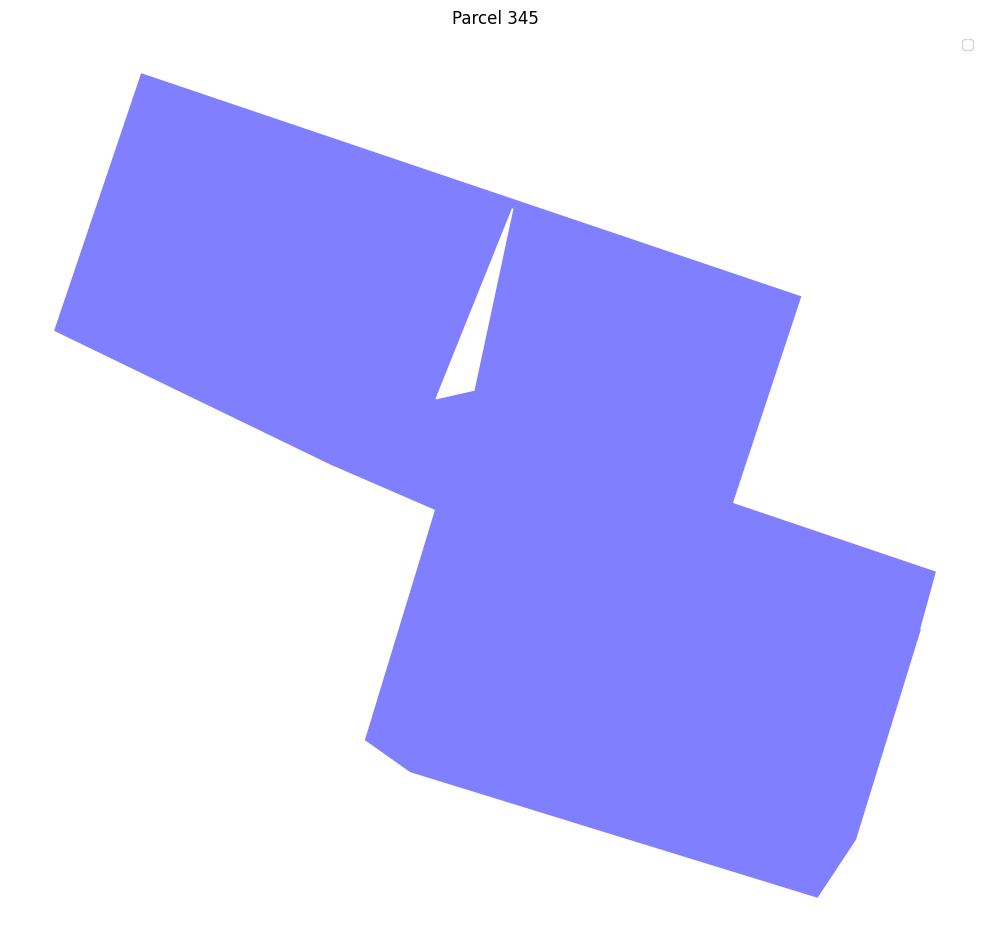

Parcel 345:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 5087.76 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

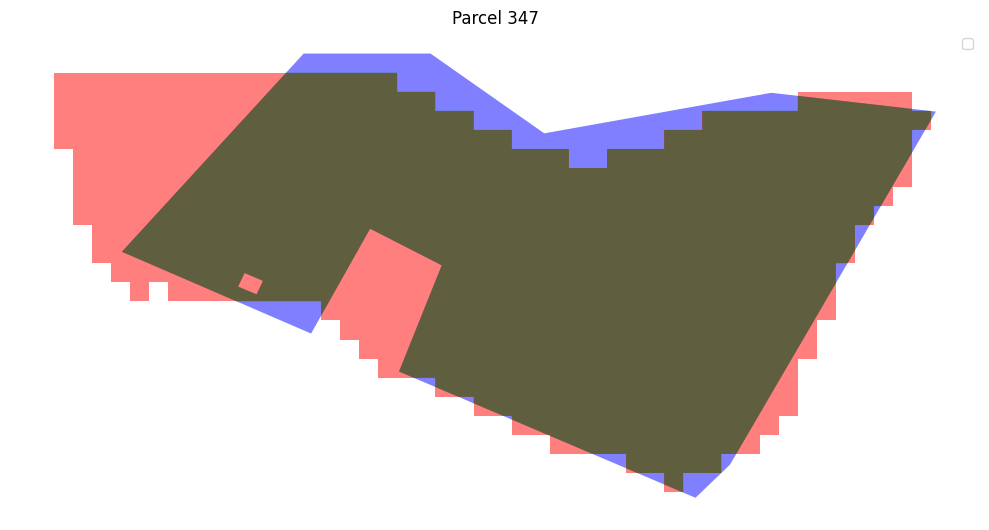

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 347:
True Positive (Correctly predicted): 12145.84 m²
False Negative (Missed): 1118.74 m²
Adjusted IoU: 0.92




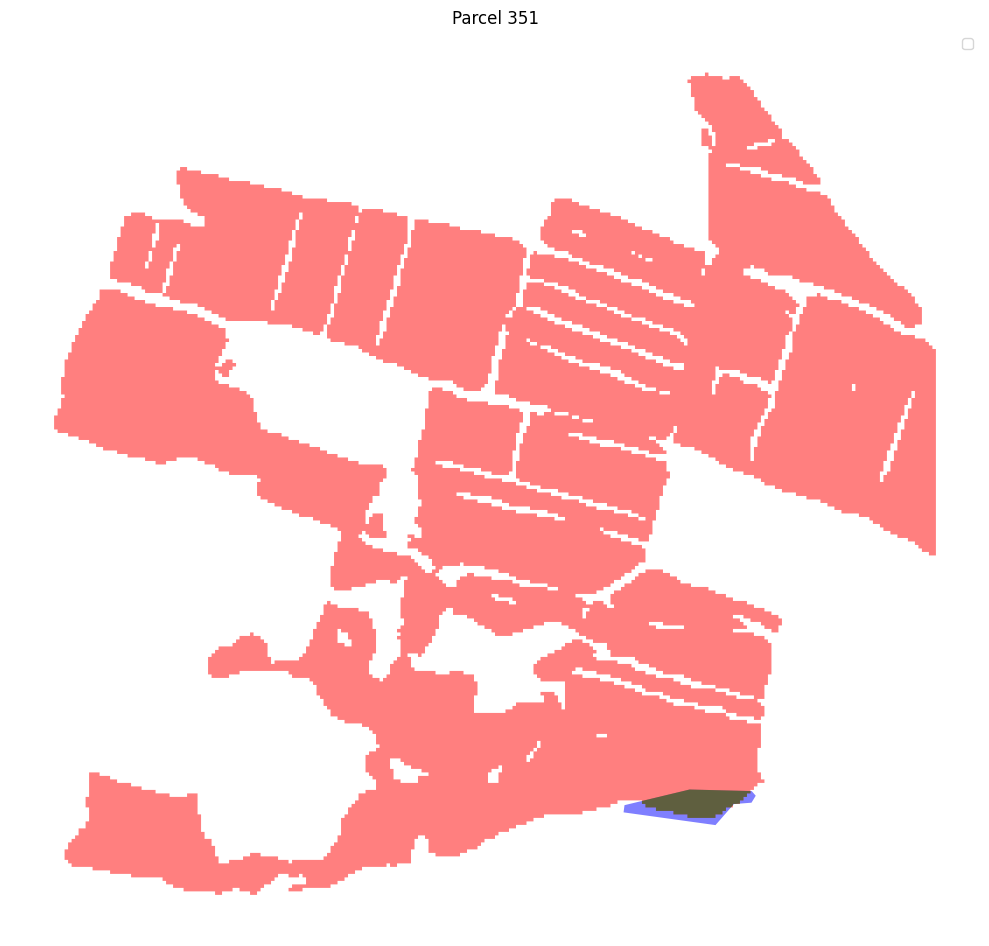

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 351:
True Positive (Correctly predicted): 4053.92 m²
False Negative (Missed): 1744.99 m²
Adjusted IoU: 0.70




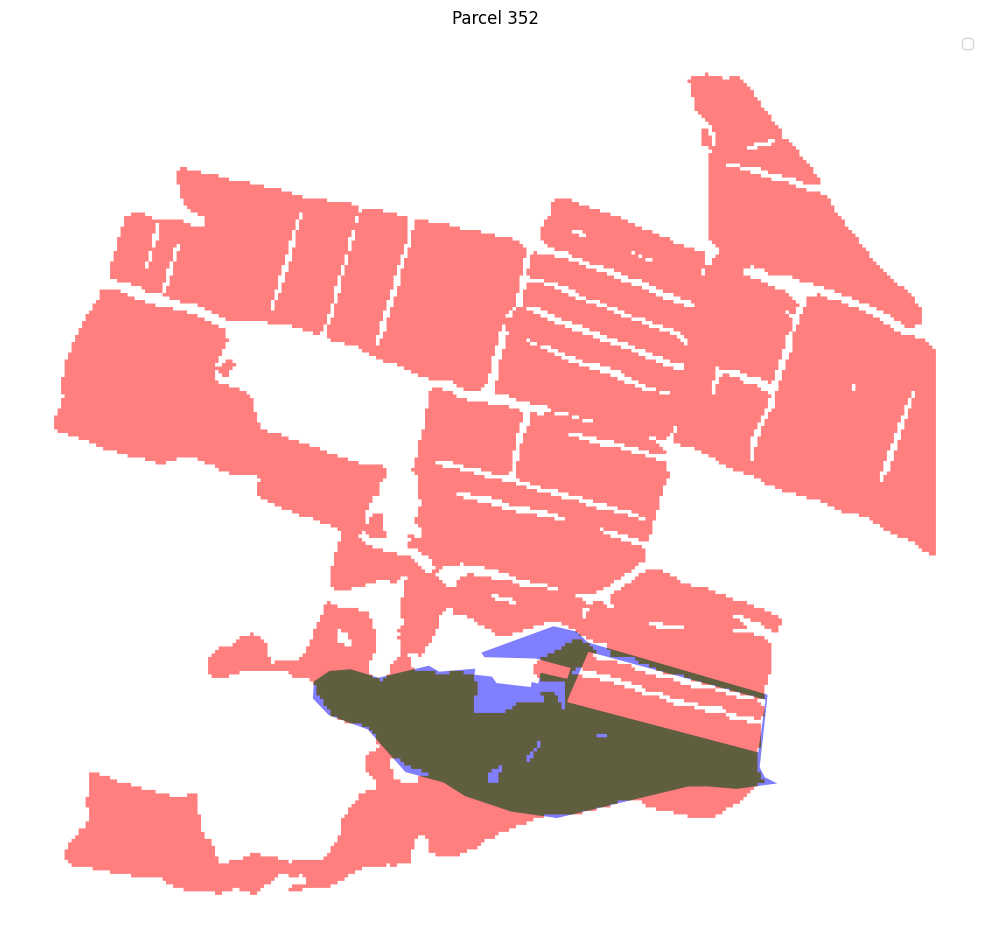

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 352:
True Positive (Correctly predicted): 76339.97 m²
False Negative (Missed): 11171.68 m²
Adjusted IoU: 0.87




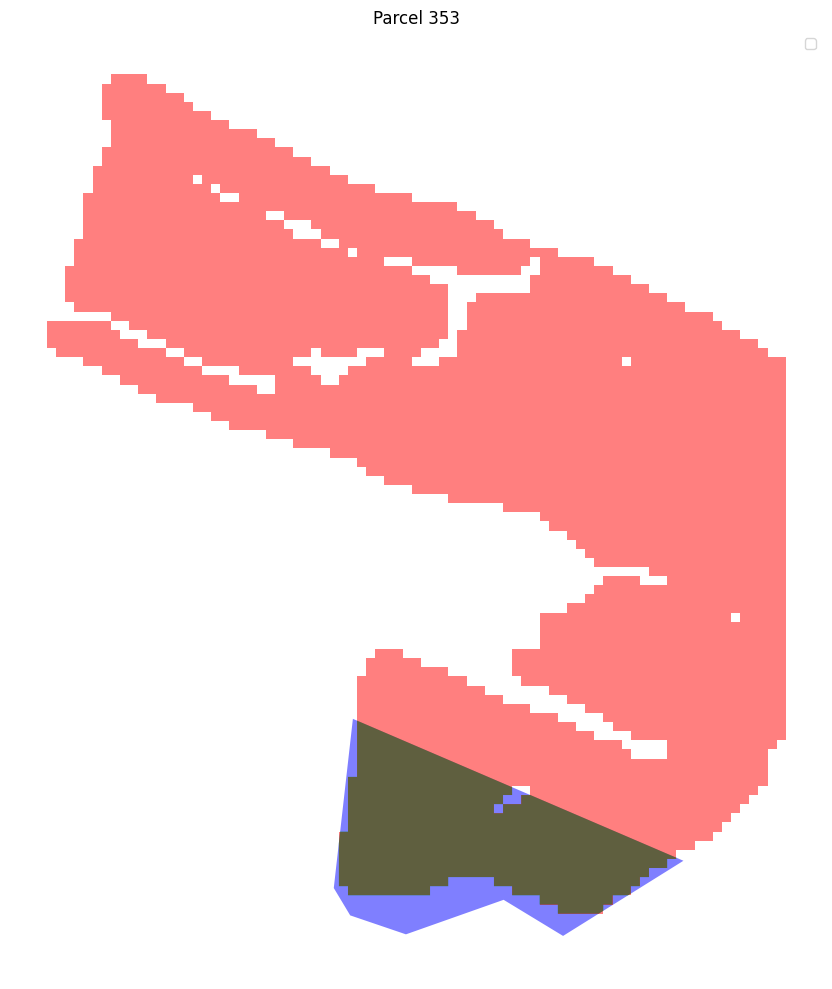

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 353:
True Positive (Correctly predicted): 10210.43 m²
False Negative (Missed): 2471.91 m²
Adjusted IoU: 0.81




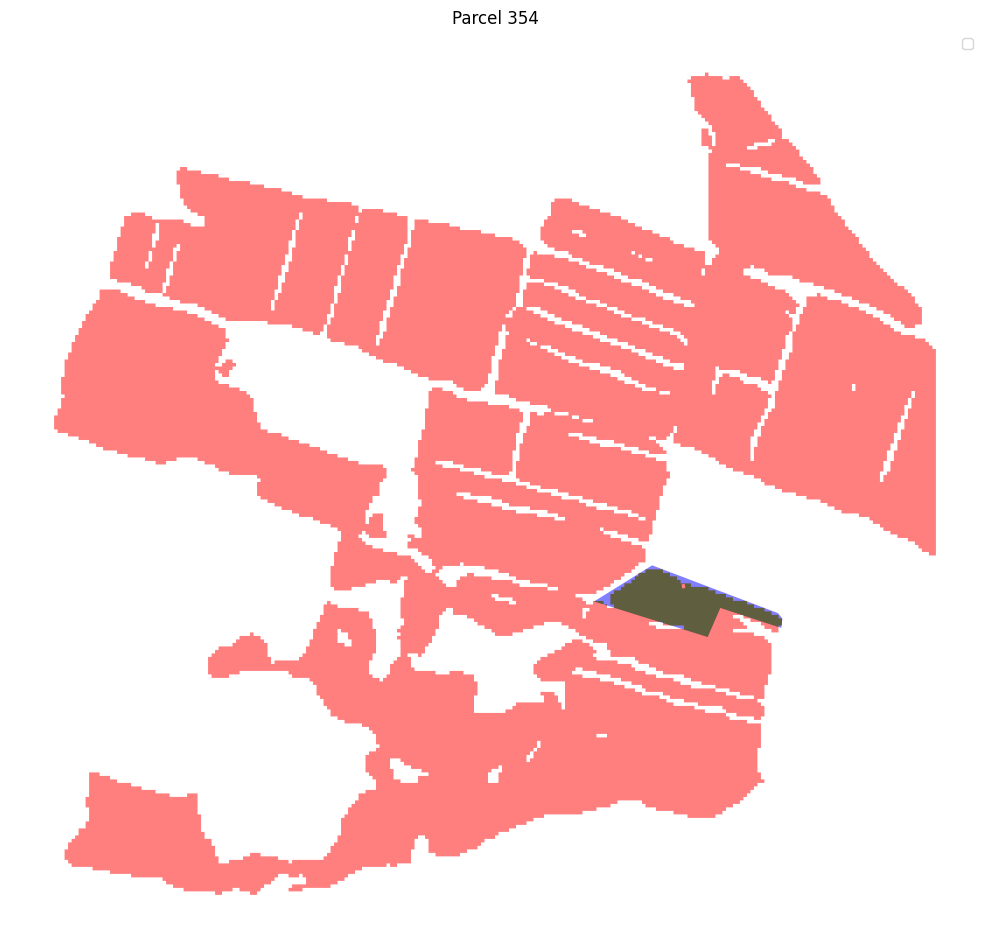

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 354:
True Positive (Correctly predicted): 10598.92 m²
False Negative (Missed): 1273.96 m²
Adjusted IoU: 0.89




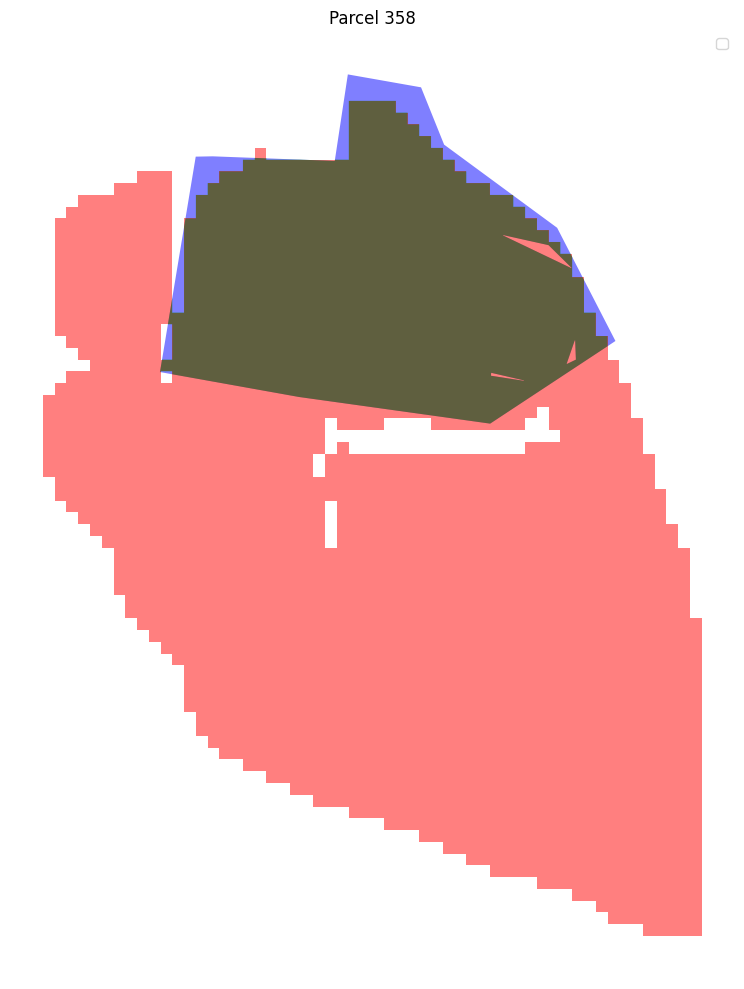

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 358:
True Positive (Correctly predicted): 16686.85 m²
False Negative (Missed): 1378.34 m²
Adjusted IoU: 0.92




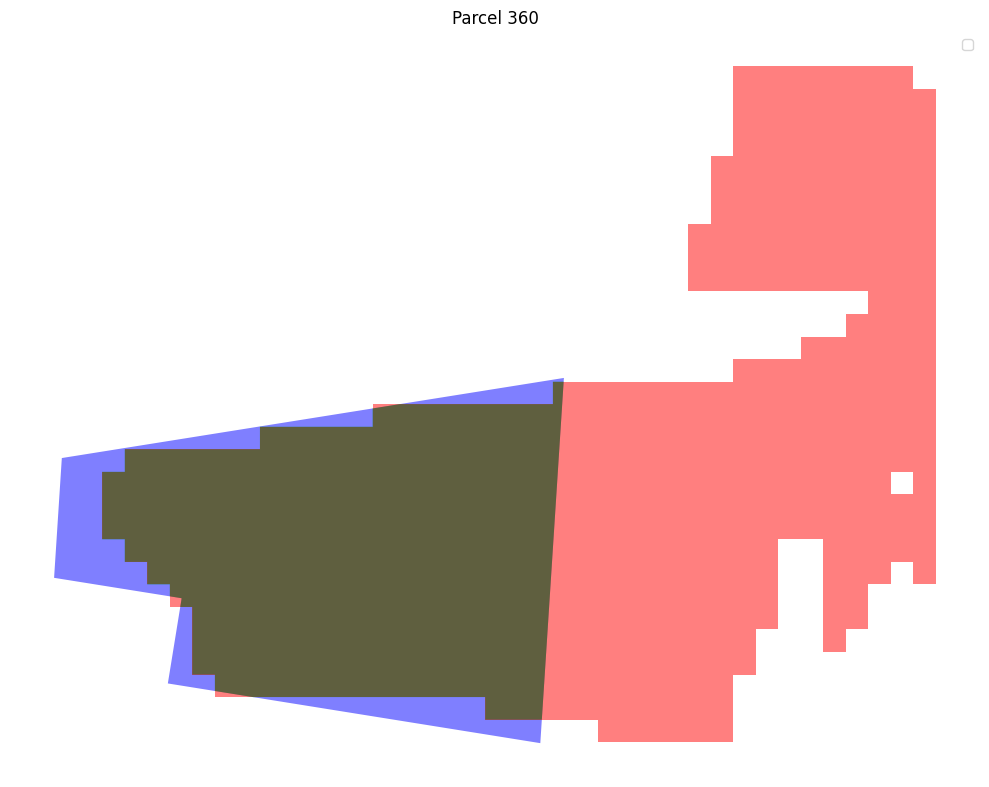

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 360:
True Positive (Correctly predicted): 5484.31 m²
False Negative (Missed): 975.06 m²
Adjusted IoU: 0.85




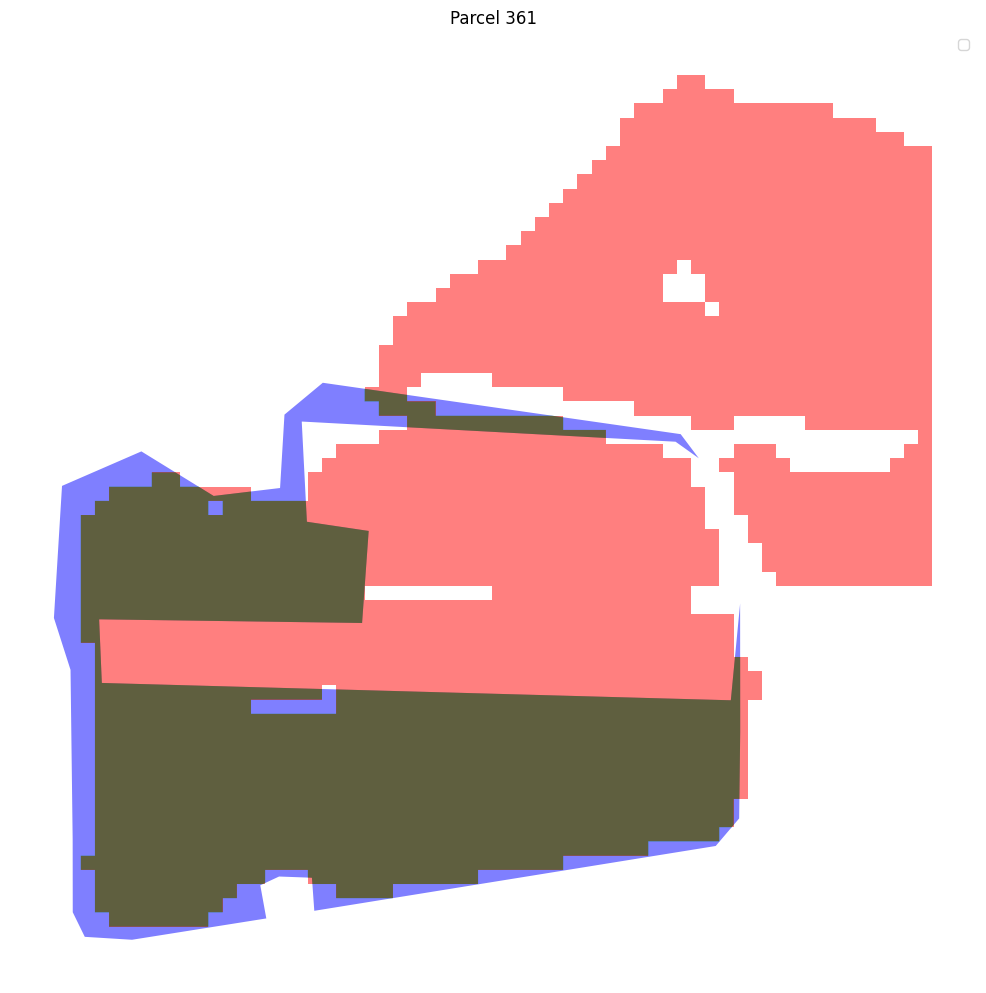

/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

Parcel 361:
True Positive (Correctly predicted): 19824.71 m²
False Negative (Missed): 3578.71 m²
Adjusted IoU: 0.85




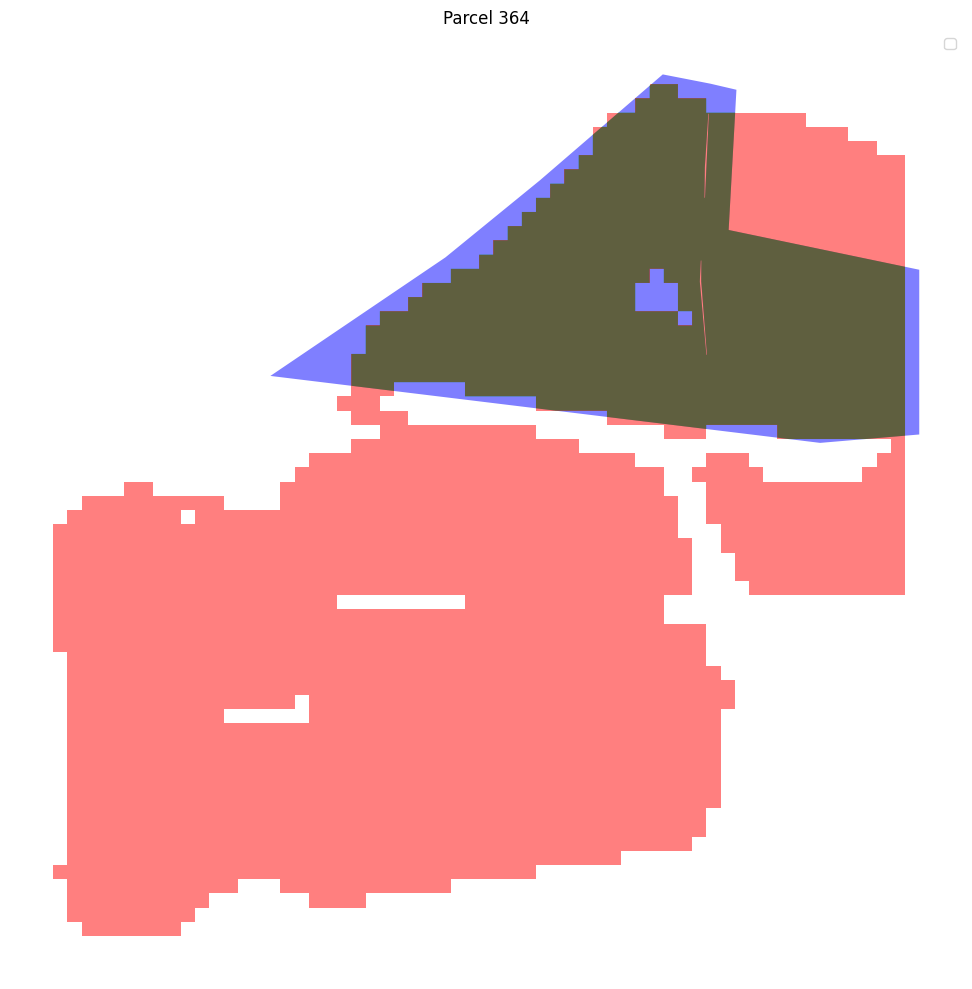

/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Parcel 364:
True Positive (Correctly predicted): 13411.81 m²
False Negative (Missed): 1996.83 m²
Adjusted IoU: 0.87




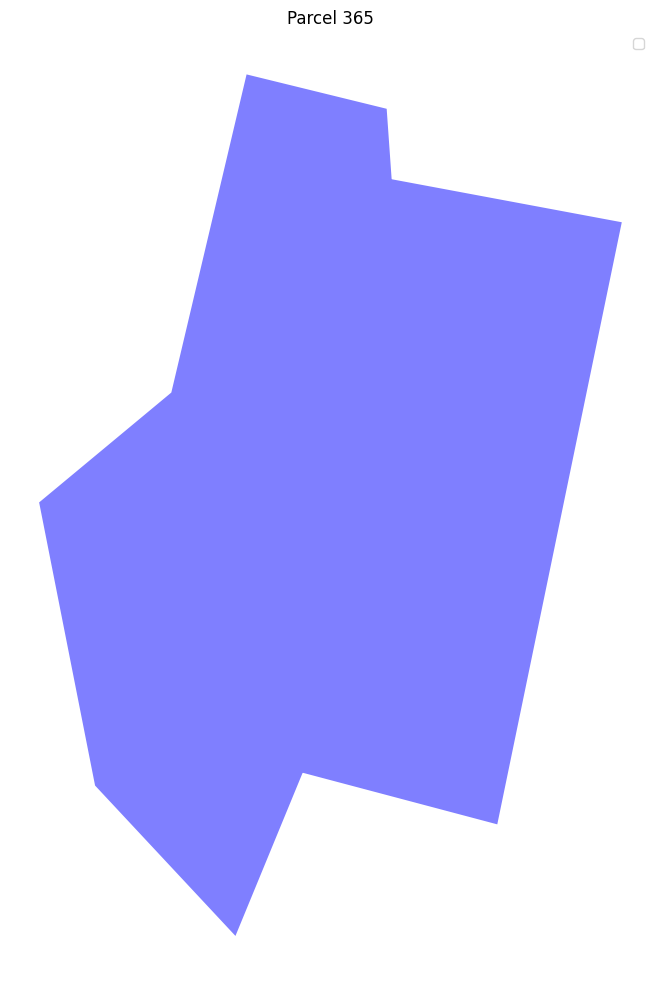

Parcel 365:
True Positive (Correctly predicted): 0.00 m²
False Negative (Missed): 5874.27 m²
Adjusted IoU: 0.00




/tmp/ipykernel_29810/456807990.py:21: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:38: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:32632

  intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]),
/tmp/ipykernel_29810/456807990.py:44: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an

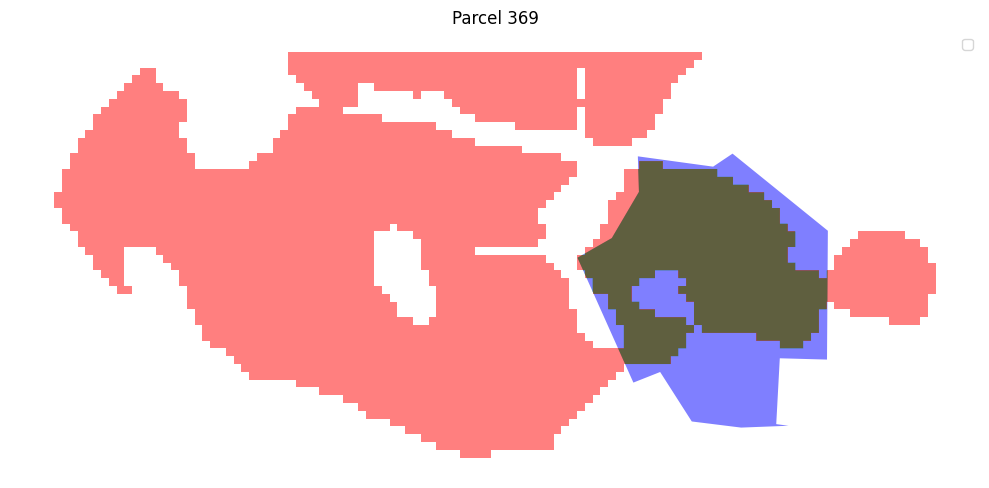

Parcel 369:
True Positive (Correctly predicted): 12237.89 m²
False Negative (Missed): 7198.74 m²
Adjusted IoU: 0.63


Overall Metrics:
Average Adjusted IoU: 0.81
Results saved to parcel_evaluation_results.csv


In [6]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

class ParcelEvaluator:
    def __init__(self, original_gdf_path, predicted_gdf_path):
        self.original_gdf = self.load_gdf(original_gdf_path)
        self.original_gdf = self.original_gdf[self.original_gdf.area > 5000]
        self.predicted_gdf = self.load_gdf(predicted_gdf_path)
        
        if self.original_gdf.crs != self.predicted_gdf.crs:
            self.predicted_gdf = self.predicted_gdf.to_crs(self.original_gdf.crs)

    def load_gdf(self, path):
        return gpd.read_file(path)

    def calculate_overlap(self, original_polygon, predicted_polygons):
        if predicted_polygons.empty:
            return 0, original_polygon.area
        
        intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]), 
                                   predicted_polygons, how='intersection')
        true_positive = intersection.area.sum()
        false_negative = original_polygon.area - true_positive
        return true_positive, false_negative

    def visualize_overlap(self, original_polygon, predicted_polygons, title):
        fig, ax = plt.subplots(figsize=(10, 10))
        
        # Plot original polygon
        gpd.GeoSeries([original_polygon]).plot(ax=ax, color='blue', alpha=0.5, label='Original')
        
        # Plot predicted polygons
        if not predicted_polygons.empty:
            predicted_polygons.plot(ax=ax, color='red', alpha=0.5, label='Predicted')
        
        # Plot intersection
        intersection = gpd.overlay(gpd.GeoDataFrame(geometry=[original_polygon]), 
                                   predicted_polygons, how='intersection')
        if not intersection.empty:
            intersection.plot(ax=ax, color='green', alpha=0.5, label='Overlap')
        
        ax.set_title(title)
        ax.legend()
        plt.axis('off')
        plt.tight_layout()
        plt.show()

    def evaluate_parcels(self):
        results = []

        for idx, original_row in self.original_gdf.iterrows():
            original_polygon = original_row.geometry
            
            # Find intersecting predictions
            intersecting_predictions = self.predicted_gdf[self.predicted_gdf.intersects(original_polygon)]
            
            true_positive, false_negative = self.calculate_overlap(original_polygon, intersecting_predictions)
            
            self.visualize_overlap(original_polygon, intersecting_predictions, f"Parcel {idx}")
            
            adjusted_iou = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0
            
            results.append({
                'Parcel ID': idx,
                'True Positive': true_positive,
                'False Negative': false_negative,
                'Adjusted IoU': adjusted_iou
            })
            
            print(f"Parcel {idx}:")
            print(f"True Positive (Correctly predicted): {true_positive:.2f} m²")
            print(f"False Negative (Missed): {false_negative:.2f} m²")
            print(f"Adjusted IoU: {adjusted_iou:.2f}")
            print("\n")

        results_df = pd.DataFrame(results)
        
        print("Overall Metrics:")
        print(f"Average Adjusted IoU: {results_df['Adjusted IoU'].mean():.2f}")
        
        results_df.to_csv("parcel_evaluation_results.csv", index=False)
        print("Results saved to parcel_evaluation_results.csv")

        return results_df

# Usage
evaluator = ParcelEvaluator("/workspaces/Satelite/data/parcels/ZH_ZH_parcel_2.gpkg",
                            "/workspaces/Satelite/data/experiment/predictions/ZH_ZH_parcel_2.gpkg")
results = evaluator.evaluate_parcels()

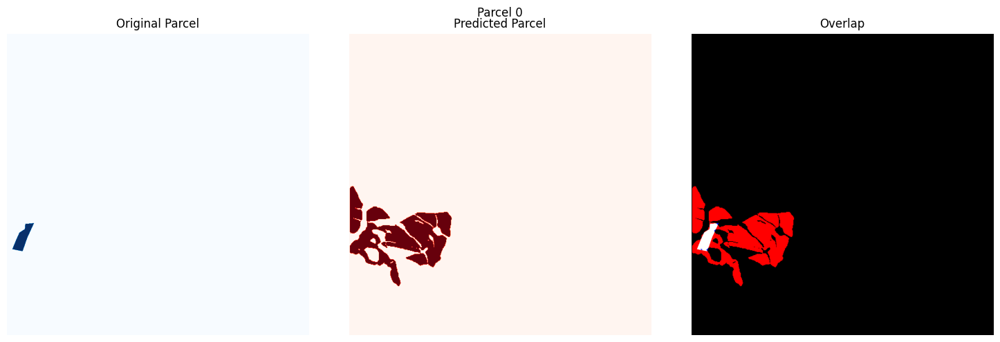

Parcel 0:
True Positive (Correctly predicted): 2767 pixels
False Negative (Missed): 81 pixels
False Positive (Overpredicted): 39505 pixels
Accuracy: 0.07
Precision: 0.07
Recall: 0.97
F1 Score: 0.12




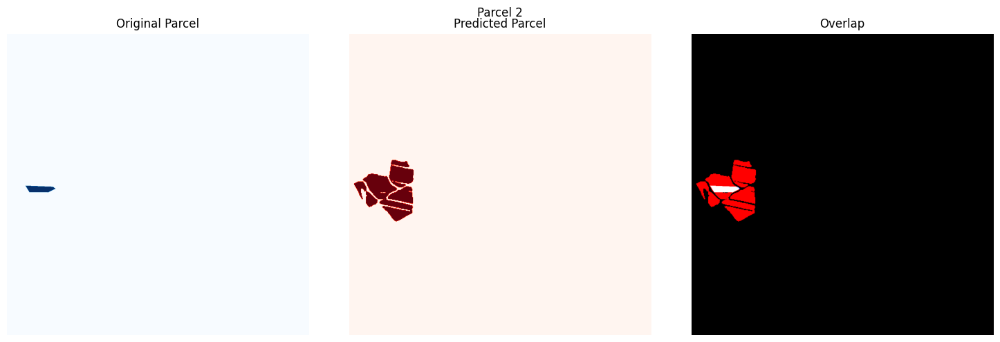

Parcel 2:
True Positive (Correctly predicted): 1679 pixels
False Negative (Missed): 14 pixels
False Positive (Overpredicted): 19113 pixels
Accuracy: 0.08
Precision: 0.08
Recall: 0.99
F1 Score: 0.15




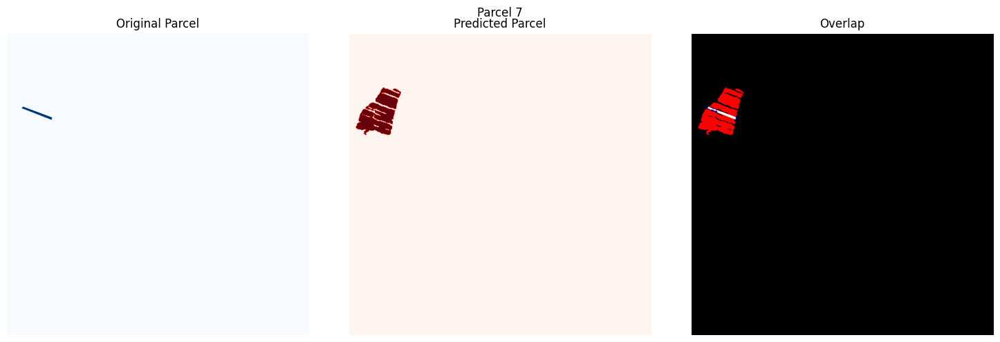

Parcel 7:
True Positive (Correctly predicted): 643 pixels
False Negative (Missed): 141 pixels
False Positive (Overpredicted): 11736 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.82
F1 Score: 0.10




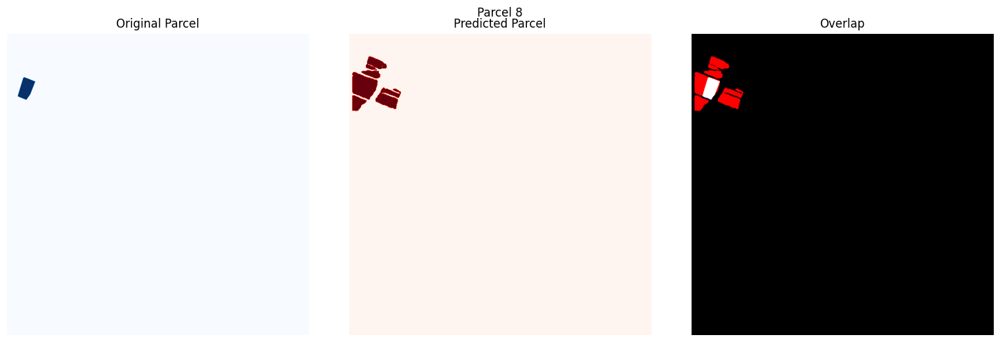

Parcel 8:
True Positive (Correctly predicted): 2571 pixels
False Negative (Missed): 25 pixels
False Positive (Overpredicted): 11036 pixels
Accuracy: 0.19
Precision: 0.19
Recall: 0.99
F1 Score: 0.32




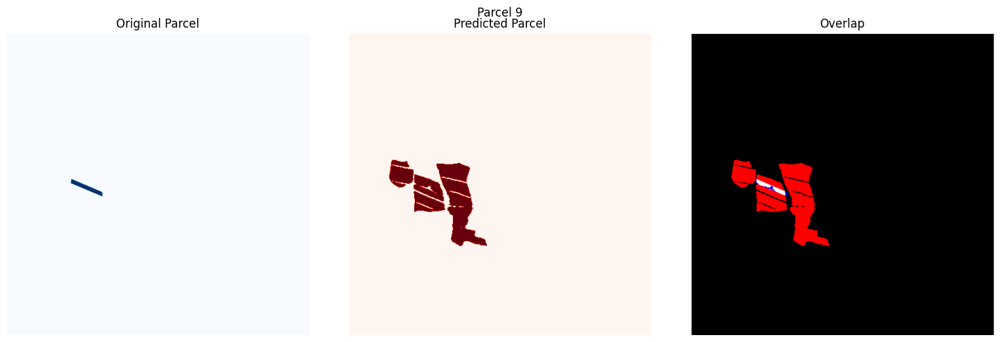

Parcel 9:
True Positive (Correctly predicted): 1179 pixels
False Negative (Missed): 355 pixels
False Positive (Overpredicted): 33350 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.77
F1 Score: 0.07




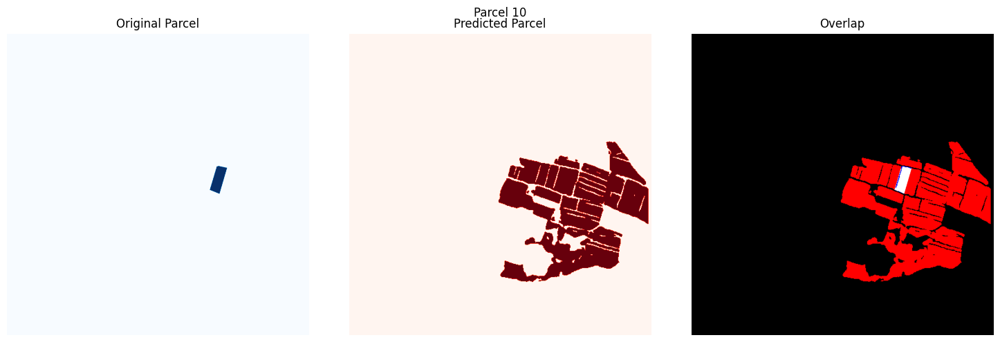

Parcel 10:
True Positive (Correctly predicted): 2672 pixels
False Negative (Missed): 310 pixels
False Positive (Overpredicted): 107862 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.90
F1 Score: 0.05




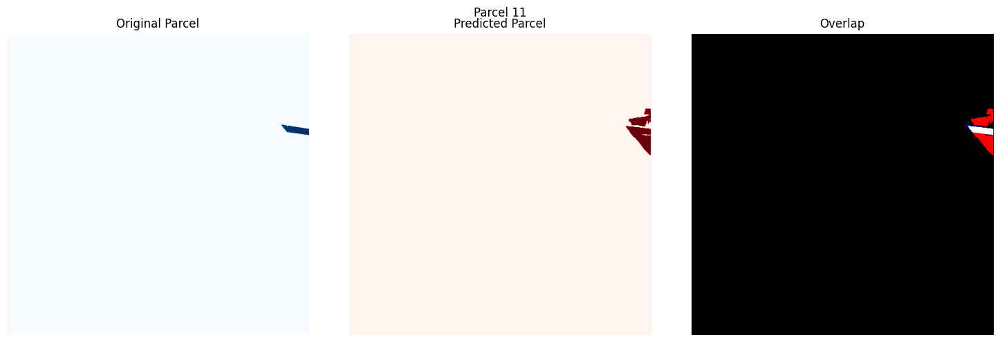

Parcel 11:
True Positive (Correctly predicted): 1539 pixels
False Negative (Missed): 265 pixels
False Positive (Overpredicted): 4564 pixels
Accuracy: 0.24
Precision: 0.25
Recall: 0.85
F1 Score: 0.39




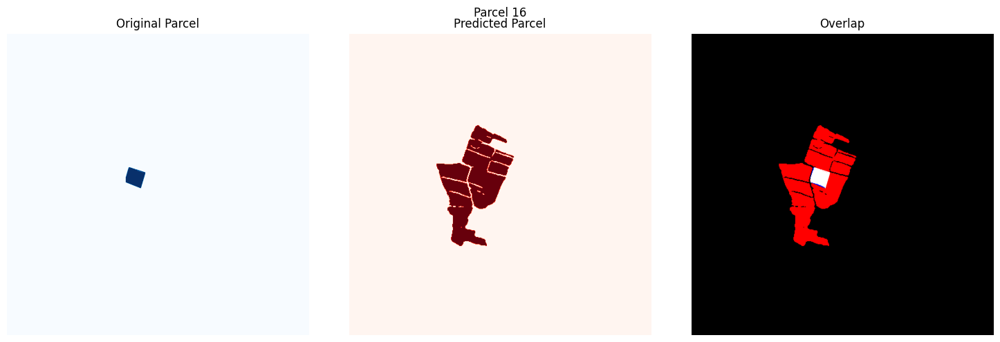

Parcel 16:
True Positive (Correctly predicted): 2891 pixels
False Negative (Missed): 192 pixels
False Positive (Overpredicted): 42952 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.94
F1 Score: 0.12




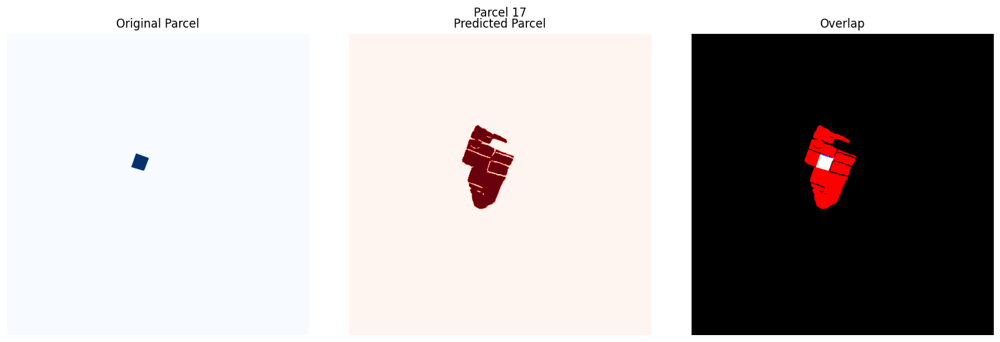

Parcel 17:
True Positive (Correctly predicted): 1991 pixels
False Negative (Missed): 123 pixels
False Positive (Overpredicted): 23869 pixels
Accuracy: 0.08
Precision: 0.08
Recall: 0.94
F1 Score: 0.14




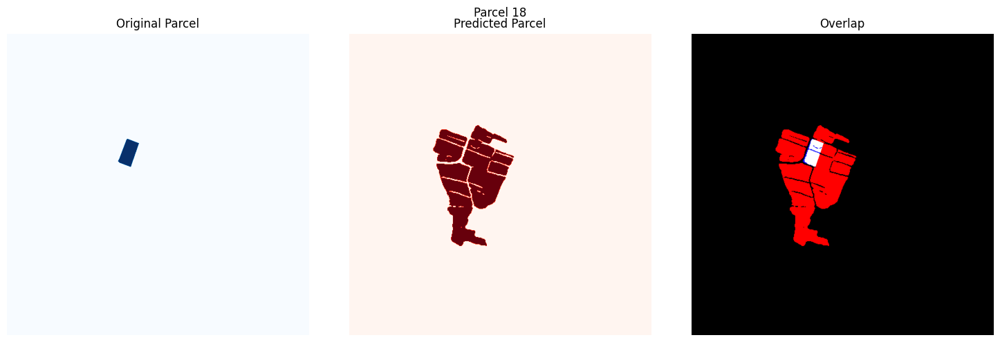

Parcel 18:
True Positive (Correctly predicted): 3237 pixels
False Negative (Missed): 463 pixels
False Positive (Overpredicted): 50765 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.87
F1 Score: 0.11




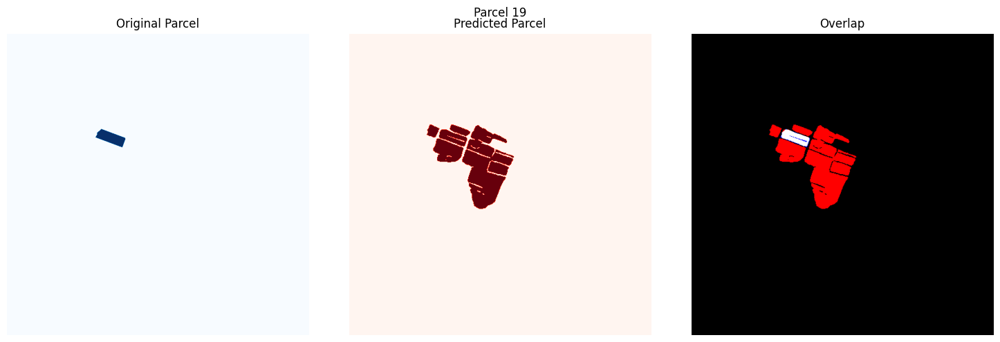

Parcel 19:
True Positive (Correctly predicted): 2727 pixels
False Negative (Missed): 329 pixels
False Positive (Overpredicted): 33820 pixels
Accuracy: 0.07
Precision: 0.07
Recall: 0.89
F1 Score: 0.14




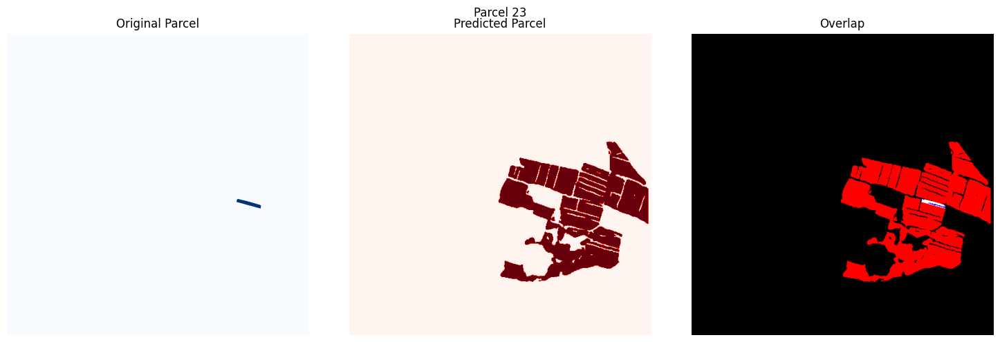

Parcel 23:
True Positive (Correctly predicted): 735 pixels
False Negative (Missed): 215 pixels
False Positive (Overpredicted): 104768 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.77
F1 Score: 0.01




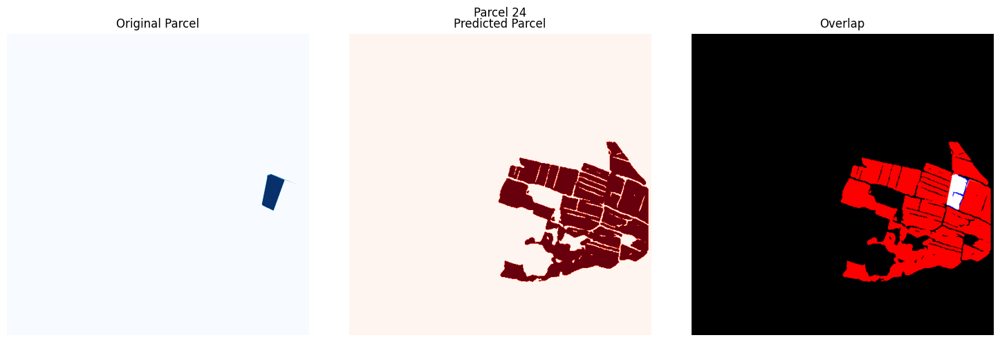

Parcel 24:
True Positive (Correctly predicted): 4871 pixels
False Negative (Missed): 634 pixels
False Positive (Overpredicted): 114403 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.88
F1 Score: 0.08




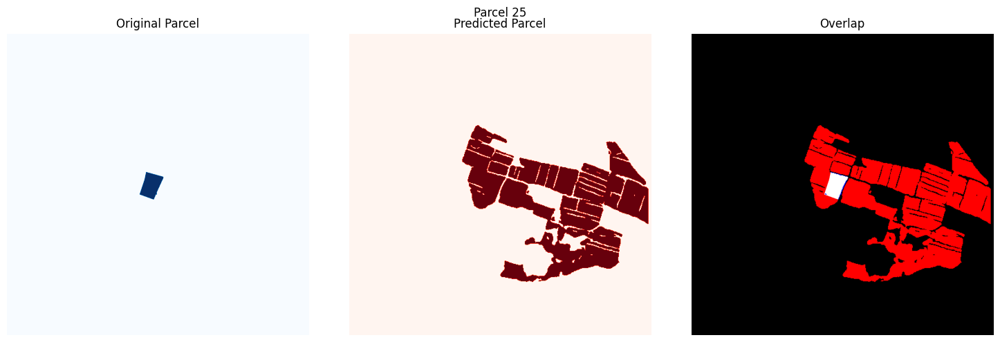

Parcel 25:
True Positive (Correctly predicted): 4091 pixels
False Negative (Missed): 260 pixels
False Positive (Overpredicted): 127272 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.94
F1 Score: 0.06




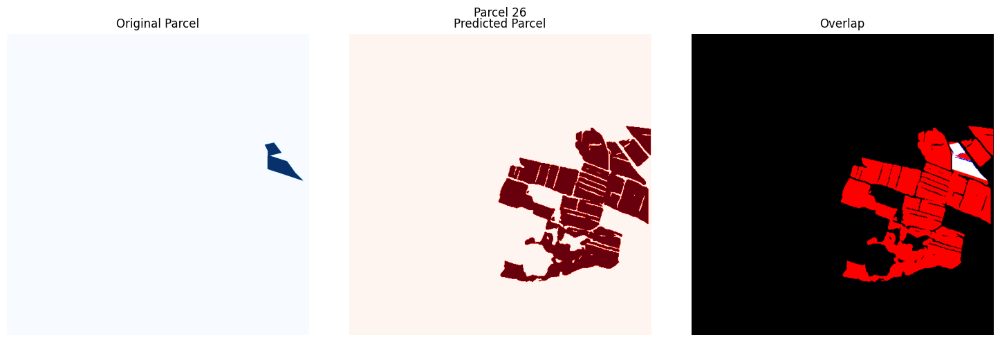

Parcel 26:
True Positive (Correctly predicted): 5299 pixels
False Negative (Missed): 423 pixels
False Positive (Overpredicted): 118629 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.93
F1 Score: 0.08




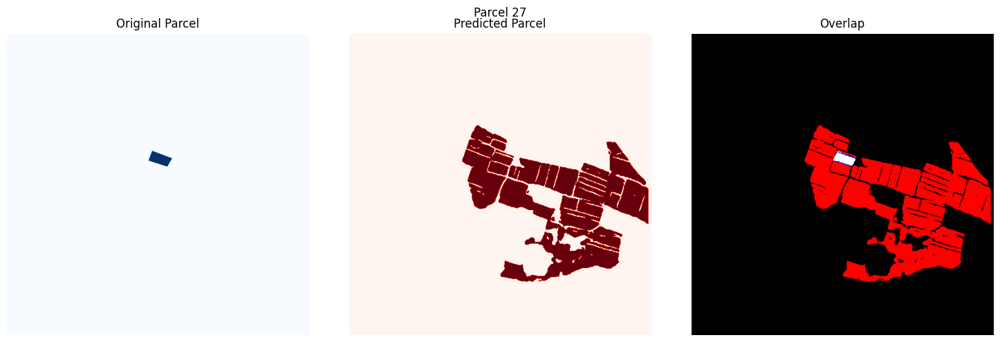

Parcel 27:
True Positive (Correctly predicted): 1840 pixels
False Negative (Missed): 421 pixels
False Positive (Overpredicted): 130677 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.81
F1 Score: 0.03




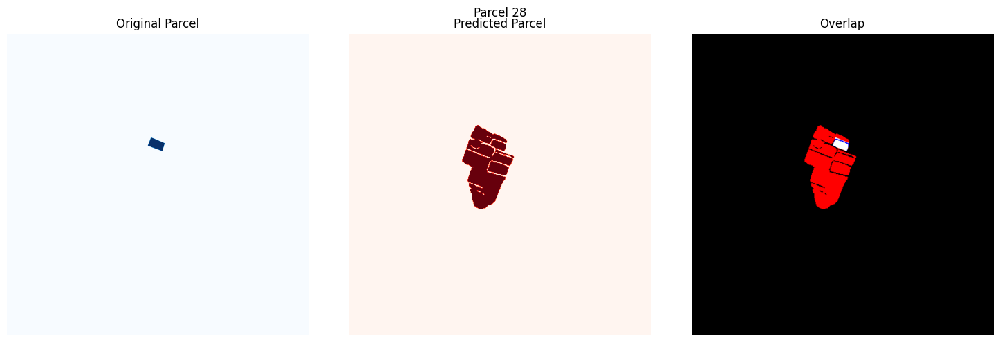

Parcel 28:
True Positive (Correctly predicted): 1218 pixels
False Negative (Missed): 235 pixels
False Positive (Overpredicted): 25796 pixels
Accuracy: 0.04
Precision: 0.05
Recall: 0.84
F1 Score: 0.09




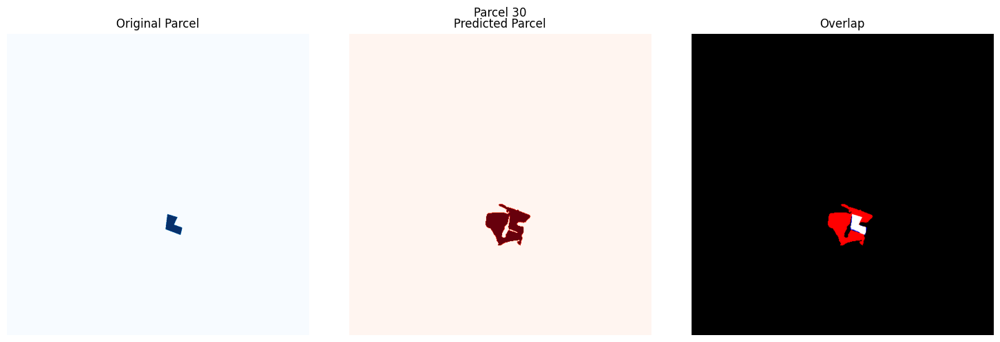

Parcel 30:
True Positive (Correctly predicted): 1982 pixels
False Negative (Missed): 192 pixels
False Positive (Overpredicted): 9044 pixels
Accuracy: 0.18
Precision: 0.18
Recall: 0.91
F1 Score: 0.30




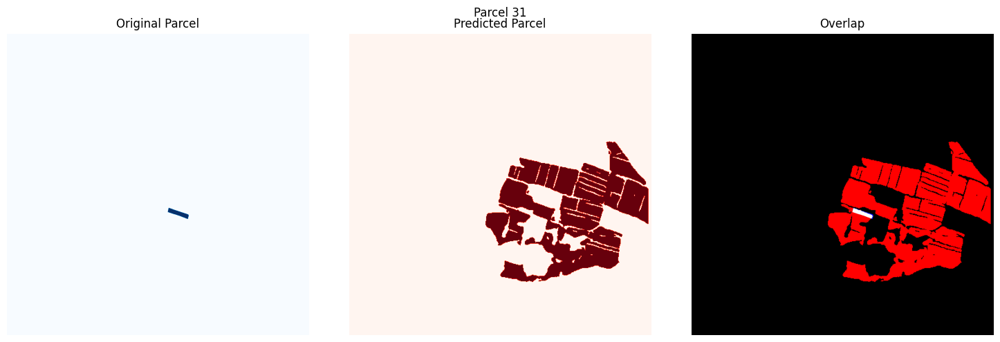

Parcel 31:
True Positive (Correctly predicted): 875 pixels
False Negative (Missed): 138 pixels
False Positive (Overpredicted): 115654 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.86
F1 Score: 0.01




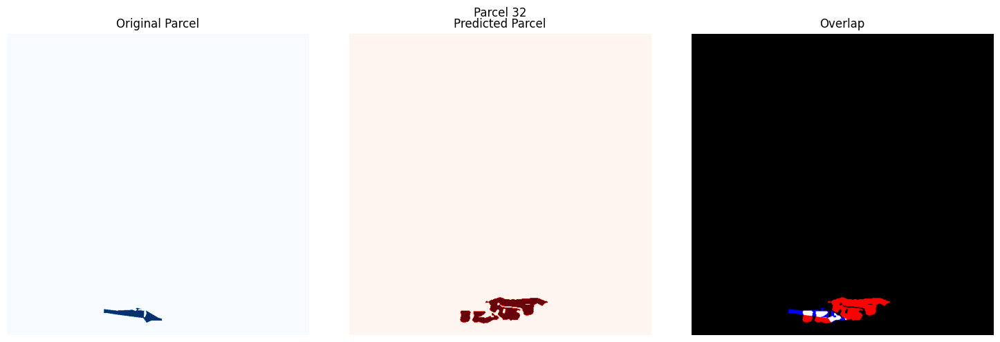

Parcel 32:
True Positive (Correctly predicted): 1742 pixels
False Negative (Missed): 1810 pixels
False Positive (Overpredicted): 9875 pixels
Accuracy: 0.13
Precision: 0.15
Recall: 0.49
F1 Score: 0.23




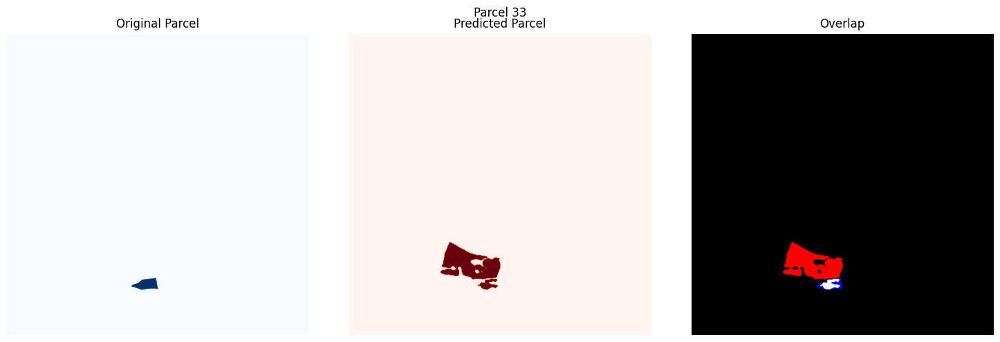

Parcel 33:
True Positive (Correctly predicted): 1308 pixels
False Negative (Missed): 949 pixels
False Positive (Overpredicted): 13925 pixels
Accuracy: 0.08
Precision: 0.09
Recall: 0.58
F1 Score: 0.15




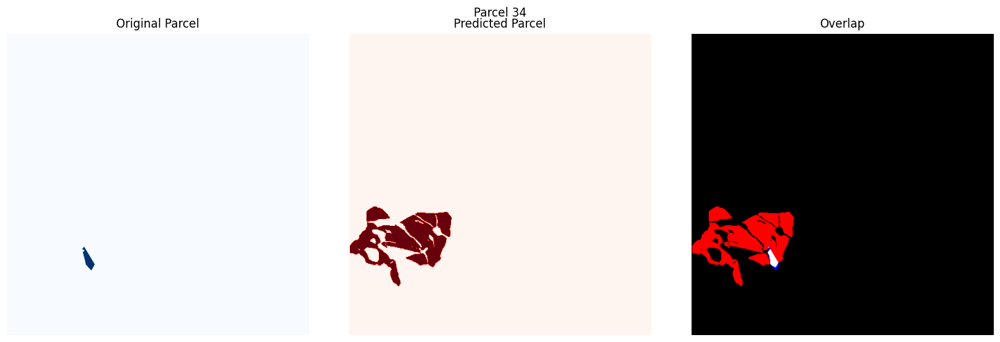

Parcel 34:
True Positive (Correctly predicted): 1041 pixels
False Negative (Missed): 339 pixels
False Positive (Overpredicted): 36271 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.75
F1 Score: 0.05




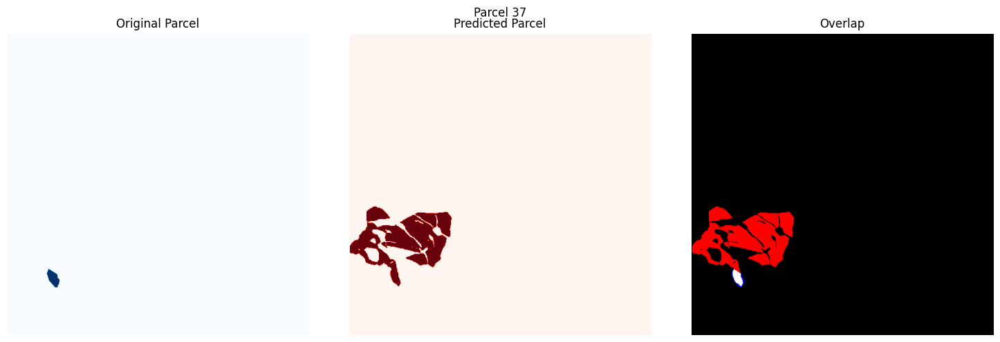

Parcel 37:
True Positive (Correctly predicted): 1132 pixels
False Negative (Missed): 387 pixels
False Positive (Overpredicted): 36180 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.75
F1 Score: 0.06




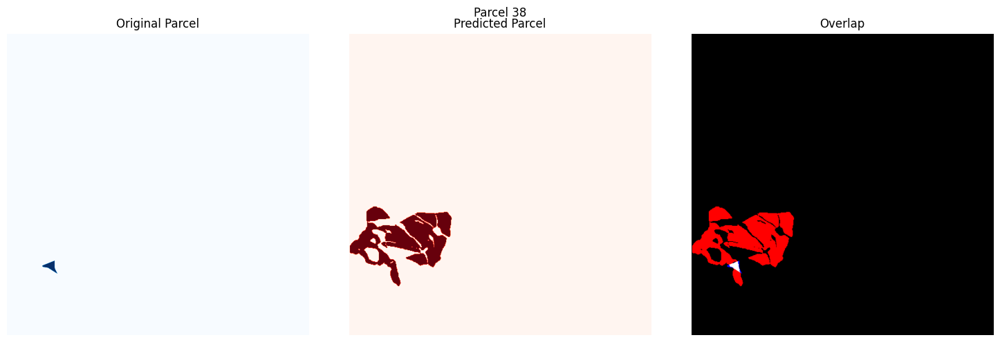

Parcel 38:
True Positive (Correctly predicted): 625 pixels
False Negative (Missed): 200 pixels
False Positive (Overpredicted): 36687 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.76
F1 Score: 0.03




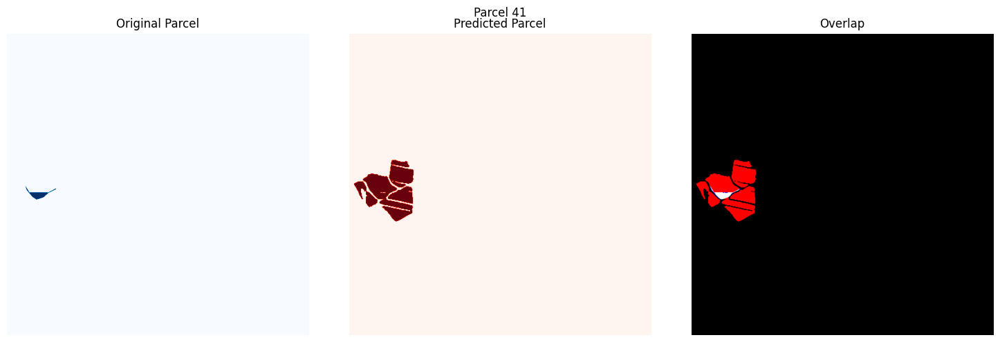

Parcel 41:
True Positive (Correctly predicted): 981 pixels
False Negative (Missed): 143 pixels
False Positive (Overpredicted): 19811 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.87
F1 Score: 0.09




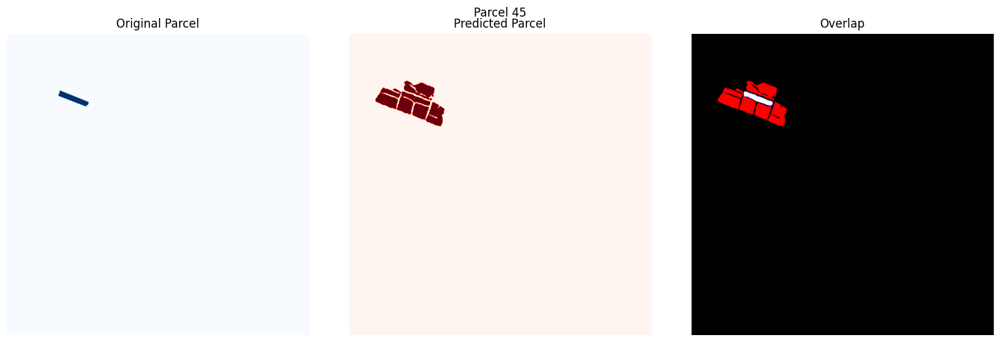

Parcel 45:
True Positive (Correctly predicted): 1584 pixels
False Negative (Missed): 252 pixels
False Positive (Overpredicted): 14366 pixels
Accuracy: 0.10
Precision: 0.10
Recall: 0.86
F1 Score: 0.18




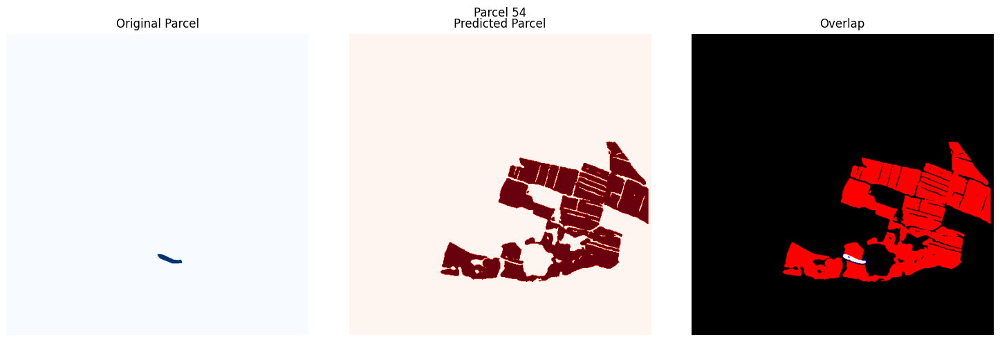

Parcel 54:
True Positive (Correctly predicted): 919 pixels
False Negative (Missed): 198 pixels
False Positive (Overpredicted): 122116 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.82
F1 Score: 0.01




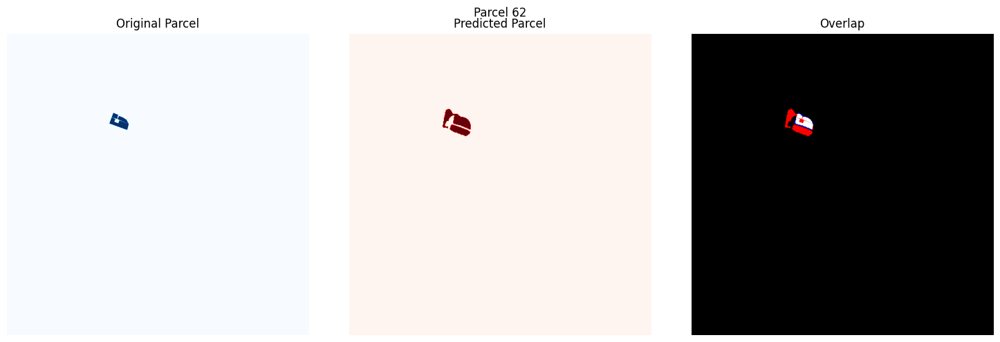

Parcel 62:
True Positive (Correctly predicted): 1525 pixels
False Negative (Missed): 307 pixels
False Positive (Overpredicted): 2685 pixels
Accuracy: 0.34
Precision: 0.36
Recall: 0.83
F1 Score: 0.50




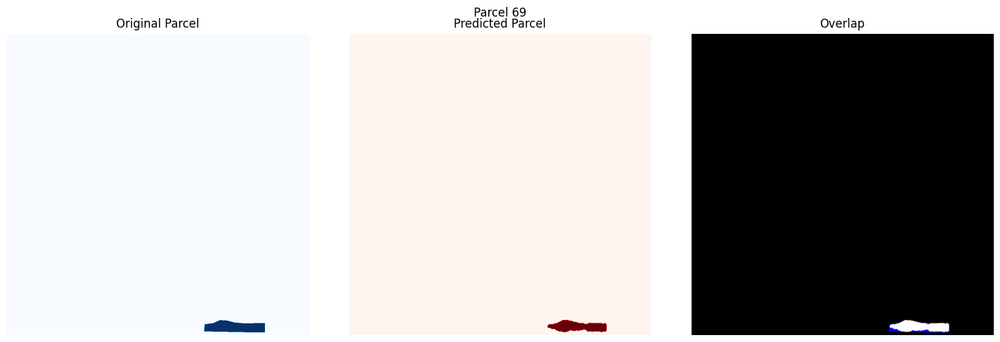

Parcel 69:
True Positive (Correctly predicted): 5263 pixels
False Negative (Missed): 1083 pixels
False Positive (Overpredicted): 75 pixels
Accuracy: 0.82
Precision: 0.99
Recall: 0.83
F1 Score: 0.90




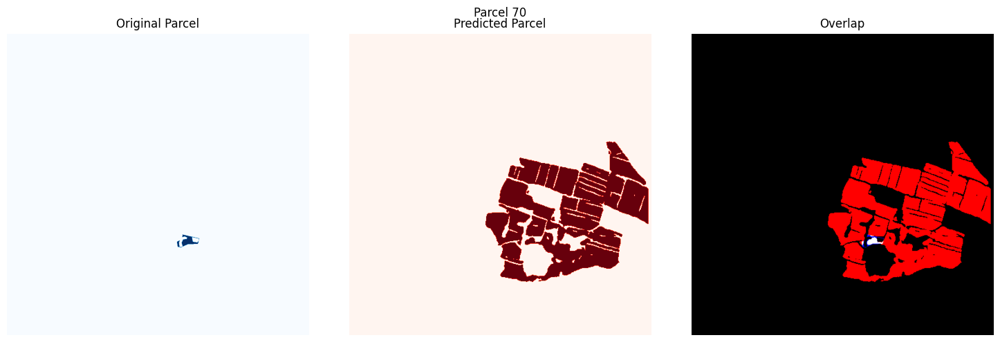

Parcel 70:
True Positive (Correctly predicted): 791 pixels
False Negative (Missed): 430 pixels
False Positive (Overpredicted): 122622 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.65
F1 Score: 0.01




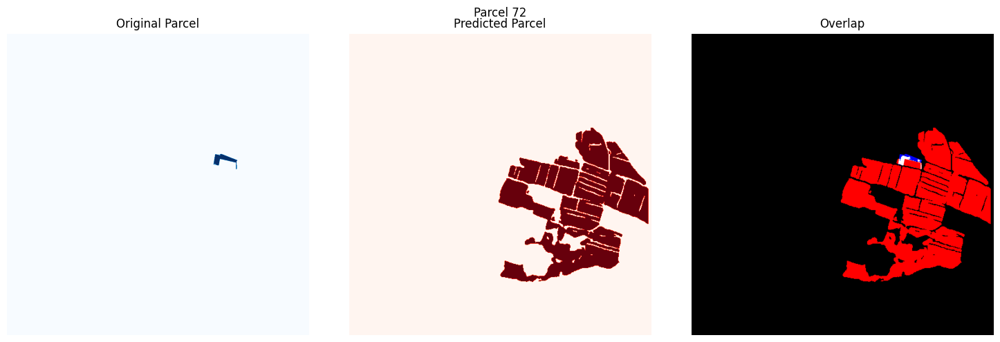

Parcel 72:
True Positive (Correctly predicted): 748 pixels
False Negative (Missed): 699 pixels
False Positive (Overpredicted): 116907 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.52
F1 Score: 0.01




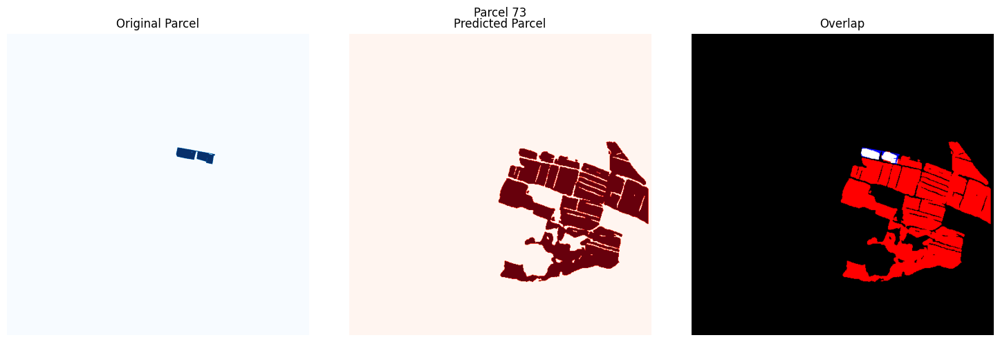

Parcel 73:
True Positive (Correctly predicted): 2801 pixels
False Negative (Missed): 827 pixels
False Positive (Overpredicted): 107652 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.77
F1 Score: 0.05




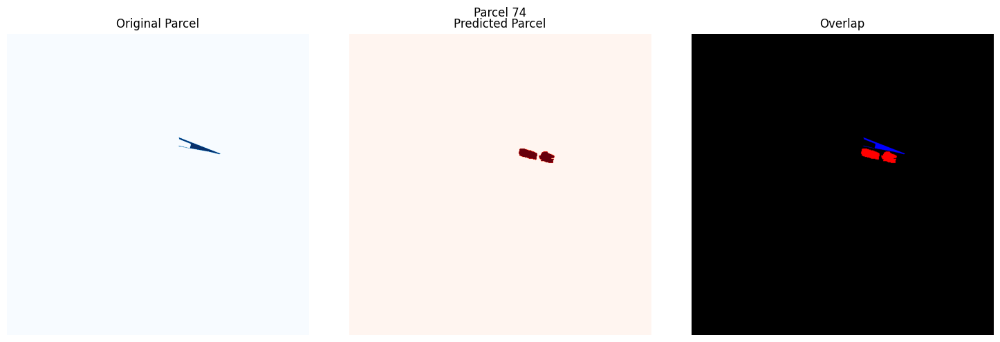

Parcel 74:
True Positive (Correctly predicted): 0 pixels
False Negative (Missed): 1408 pixels
False Positive (Overpredicted): 2896 pixels
Accuracy: 0.00
Precision: 0.00
Recall: 0.00
F1 Score: 0.00




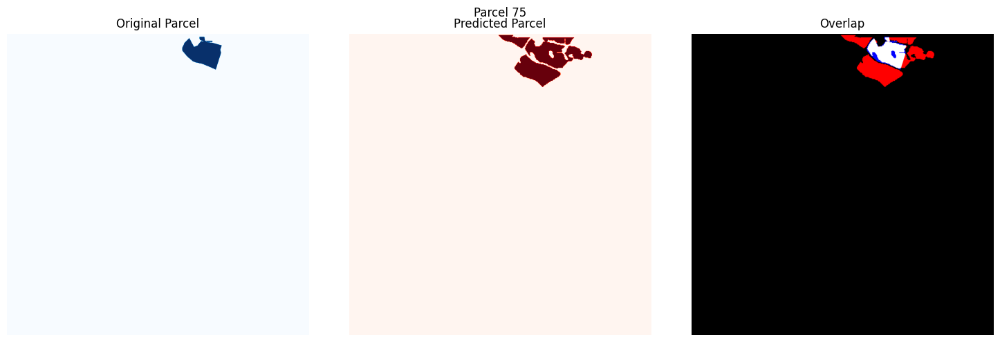

Parcel 75:
True Positive (Correctly predicted): 7116 pixels
False Negative (Missed): 1408 pixels
False Positive (Overpredicted): 14693 pixels
Accuracy: 0.31
Precision: 0.33
Recall: 0.83
F1 Score: 0.47




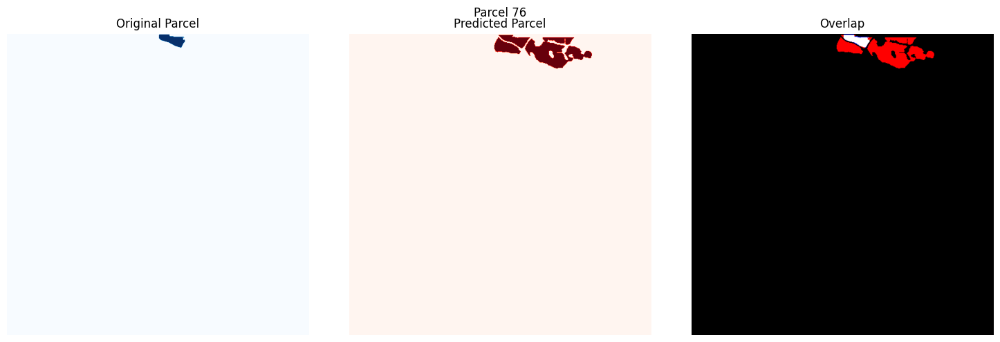

Parcel 76:
True Positive (Correctly predicted): 1965 pixels
False Negative (Missed): 224 pixels
False Positive (Overpredicted): 14572 pixels
Accuracy: 0.12
Precision: 0.12
Recall: 0.90
F1 Score: 0.21




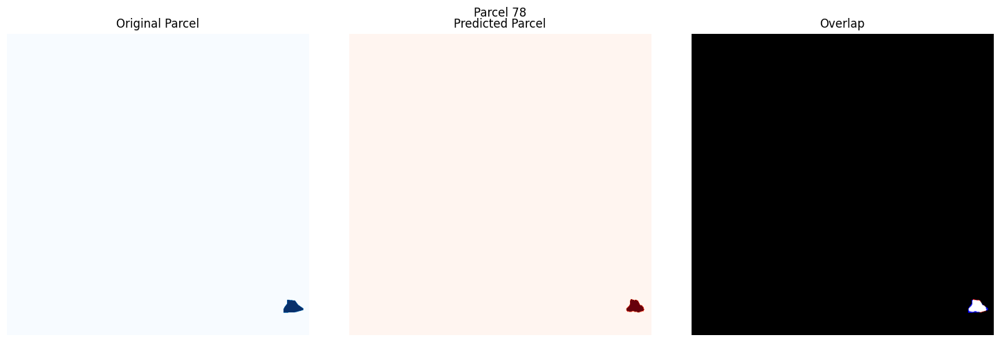

Parcel 78:
True Positive (Correctly predicted): 1615 pixels
False Negative (Missed): 297 pixels
False Positive (Overpredicted): 67 pixels
Accuracy: 0.82
Precision: 0.96
Recall: 0.84
F1 Score: 0.90




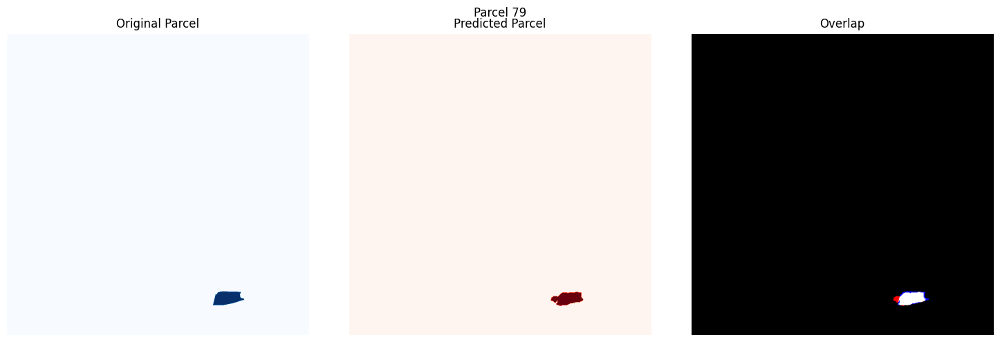

Parcel 79:
True Positive (Correctly predicted): 2956 pixels
False Negative (Missed): 573 pixels
False Positive (Overpredicted): 342 pixels
Accuracy: 0.76
Precision: 0.90
Recall: 0.84
F1 Score: 0.87




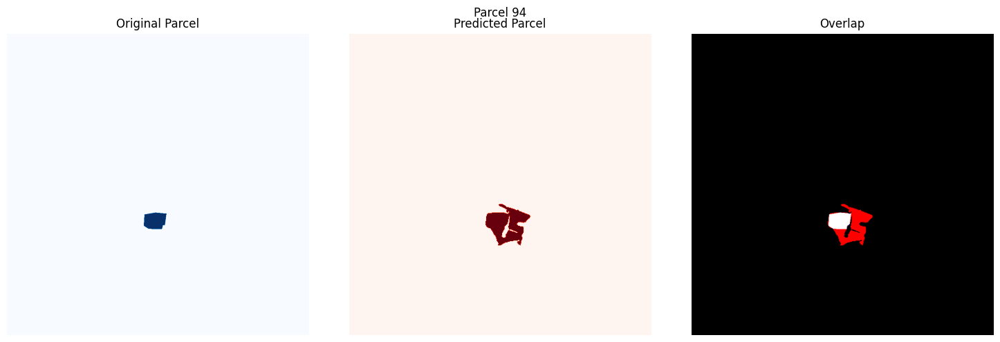

Parcel 94:
True Positive (Correctly predicted): 3507 pixels
False Negative (Missed): 19 pixels
False Positive (Overpredicted): 7519 pixels
Accuracy: 0.32
Precision: 0.32
Recall: 0.99
F1 Score: 0.48




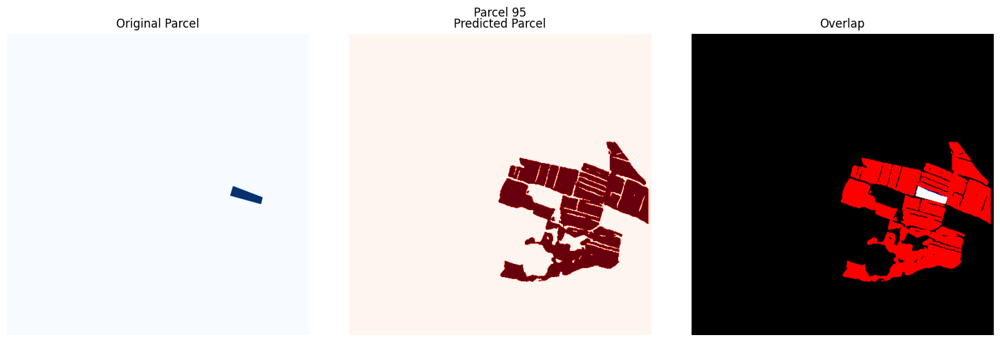

Parcel 95:
True Positive (Correctly predicted): 2829 pixels
False Negative (Missed): 211 pixels
False Positive (Overpredicted): 102674 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.93
F1 Score: 0.05




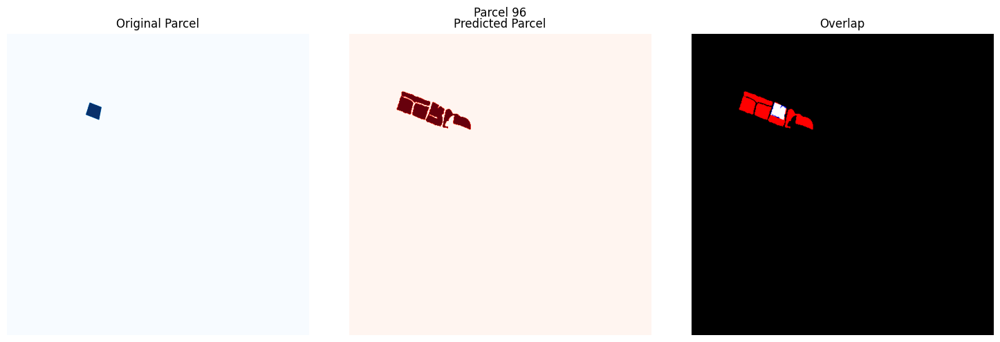

Parcel 96:
True Positive (Correctly predicted): 1750 pixels
False Negative (Missed): 191 pixels
False Positive (Overpredicted): 10000 pixels
Accuracy: 0.15
Precision: 0.15
Recall: 0.90
F1 Score: 0.26




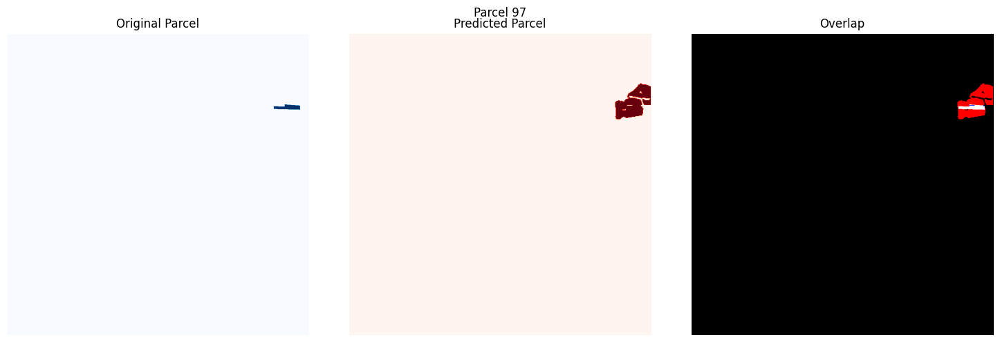

Parcel 97:
True Positive (Correctly predicted): 1043 pixels
False Negative (Missed): 50 pixels
False Positive (Overpredicted): 7179 pixels
Accuracy: 0.13
Precision: 0.13
Recall: 0.95
F1 Score: 0.22




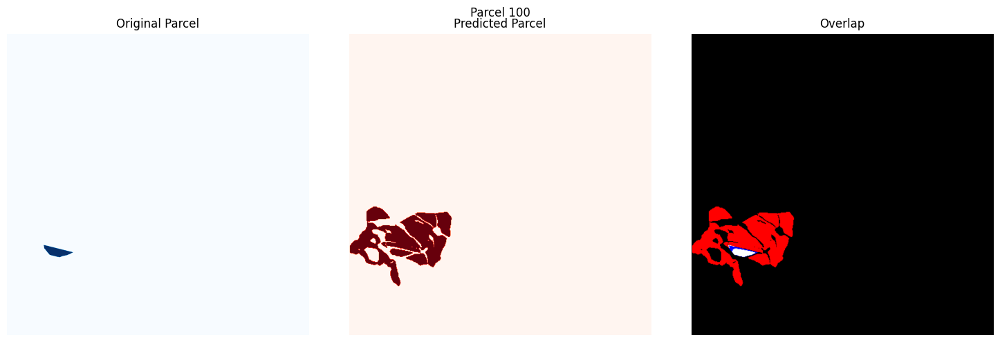

Parcel 100:
True Positive (Correctly predicted): 1383 pixels
False Negative (Missed): 572 pixels
False Positive (Overpredicted): 37265 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.71
F1 Score: 0.07




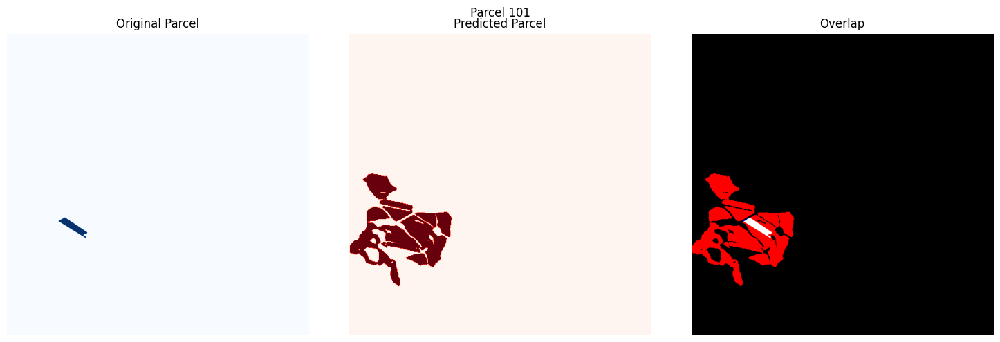

Parcel 101:
True Positive (Correctly predicted): 1919 pixels
False Negative (Missed): 47 pixels
False Positive (Overpredicted): 45435 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.98
F1 Score: 0.08




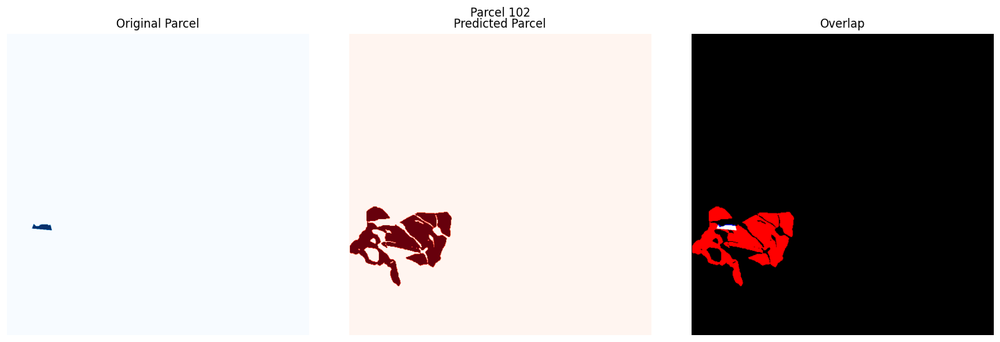

Parcel 102:
True Positive (Correctly predicted): 767 pixels
False Negative (Missed): 169 pixels
False Positive (Overpredicted): 36545 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.82
F1 Score: 0.04




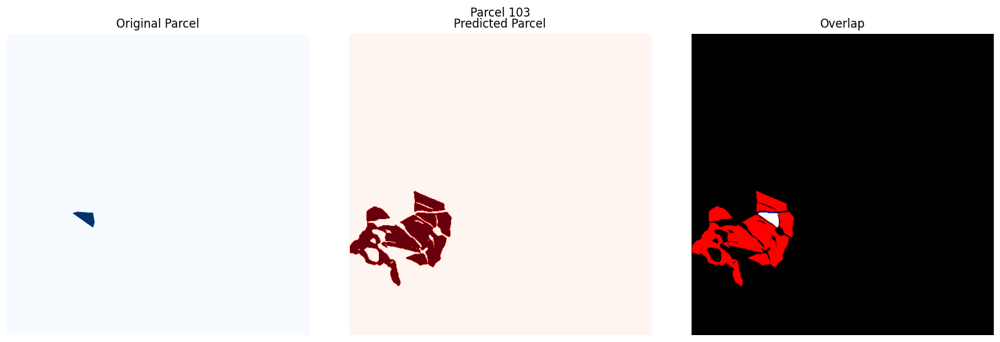

Parcel 103:
True Positive (Correctly predicted): 1807 pixels
False Negative (Missed): 179 pixels
False Positive (Overpredicted): 39886 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.91
F1 Score: 0.08




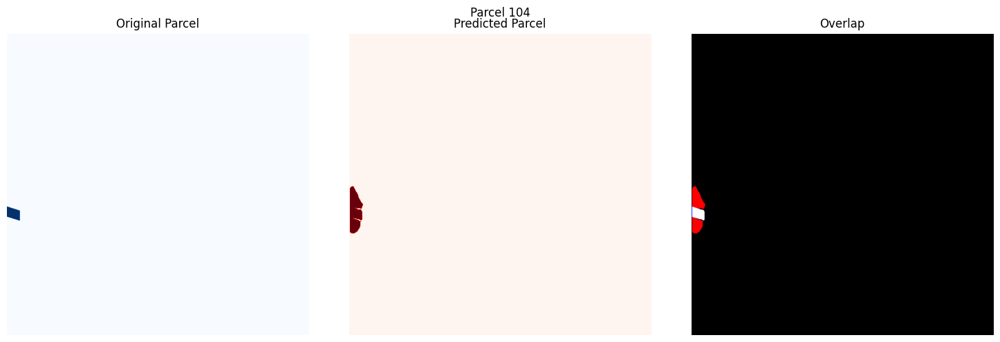

Parcel 104:
True Positive (Correctly predicted): 1367 pixels
False Negative (Missed): 99 pixels
False Positive (Overpredicted): 3593 pixels
Accuracy: 0.27
Precision: 0.28
Recall: 0.93
F1 Score: 0.43




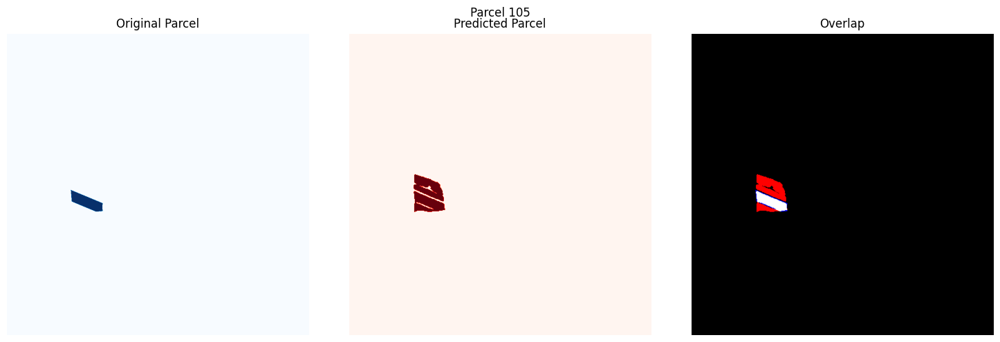

Parcel 105:
True Positive (Correctly predicted): 3208 pixels
False Negative (Missed): 540 pixels
False Positive (Overpredicted): 6035 pixels
Accuracy: 0.33
Precision: 0.35
Recall: 0.86
F1 Score: 0.49




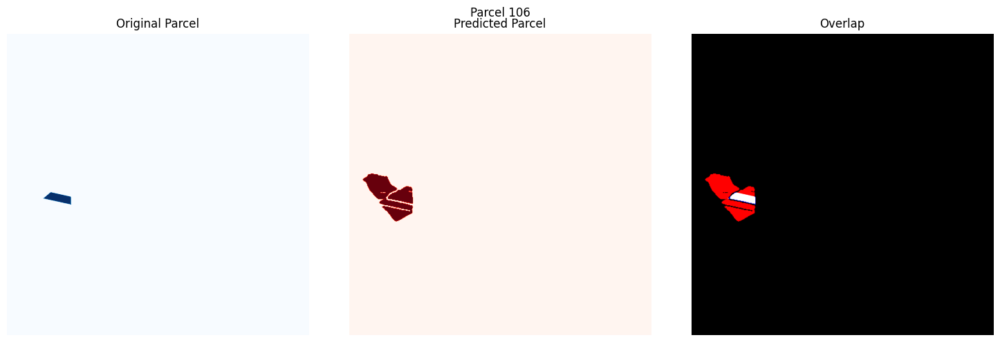

Parcel 106:
True Positive (Correctly predicted): 1871 pixels
False Negative (Missed): 193 pixels
False Positive (Overpredicted): 11186 pixels
Accuracy: 0.14
Precision: 0.14
Recall: 0.91
F1 Score: 0.25




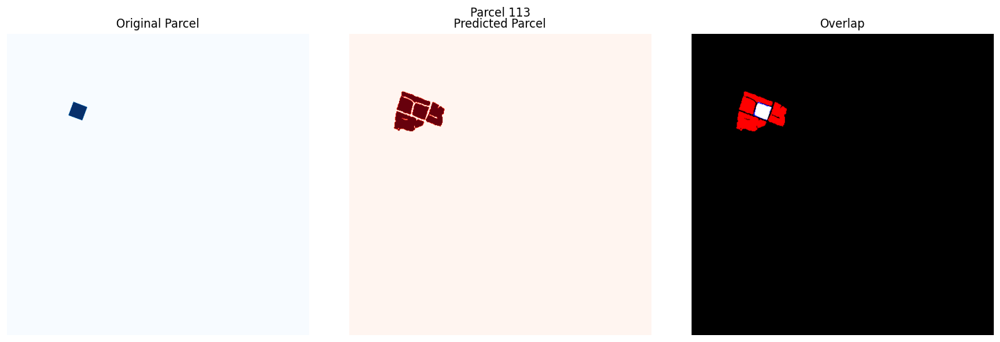

Parcel 113:
True Positive (Correctly predicted): 2047 pixels
False Negative (Missed): 296 pixels
False Positive (Overpredicted): 10891 pixels
Accuracy: 0.15
Precision: 0.16
Recall: 0.87
F1 Score: 0.27




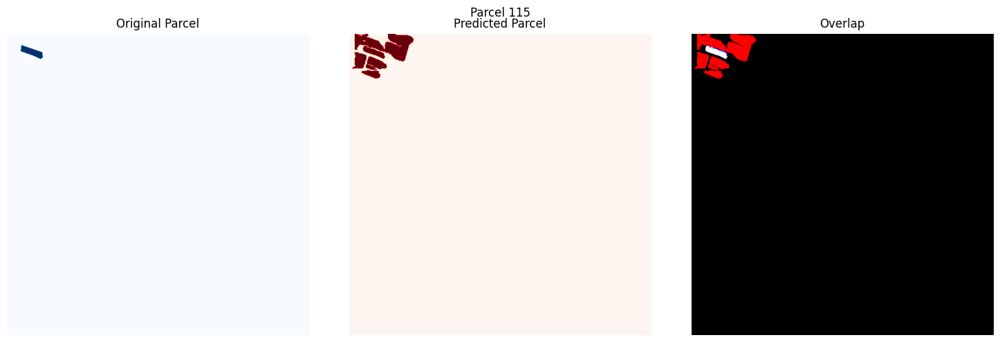

Parcel 115:
True Positive (Correctly predicted): 1334 pixels
False Negative (Missed): 247 pixels
False Positive (Overpredicted): 13889 pixels
Accuracy: 0.09
Precision: 0.09
Recall: 0.84
F1 Score: 0.16




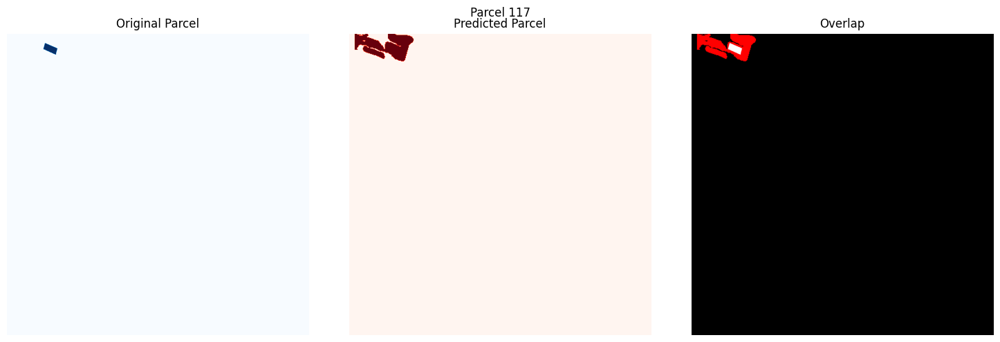

Parcel 117:
True Positive (Correctly predicted): 954 pixels
False Negative (Missed): 0 pixels
False Positive (Overpredicted): 9362 pixels
Accuracy: 0.09
Precision: 0.09
Recall: 1.00
F1 Score: 0.17




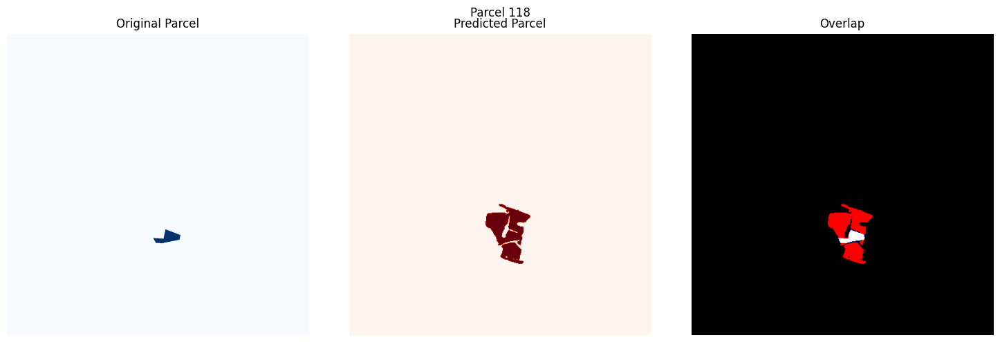

Parcel 118:
True Positive (Correctly predicted): 1959 pixels
False Negative (Missed): 149 pixels
False Positive (Overpredicted): 12680 pixels
Accuracy: 0.13
Precision: 0.13
Recall: 0.93
F1 Score: 0.23




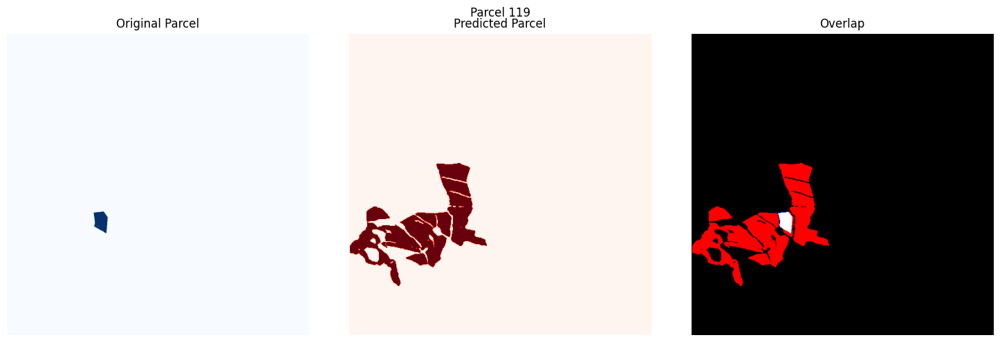

Parcel 119:
True Positive (Correctly predicted): 2345 pixels
False Negative (Missed): 125 pixels
False Positive (Overpredicted): 54950 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.95
F1 Score: 0.08




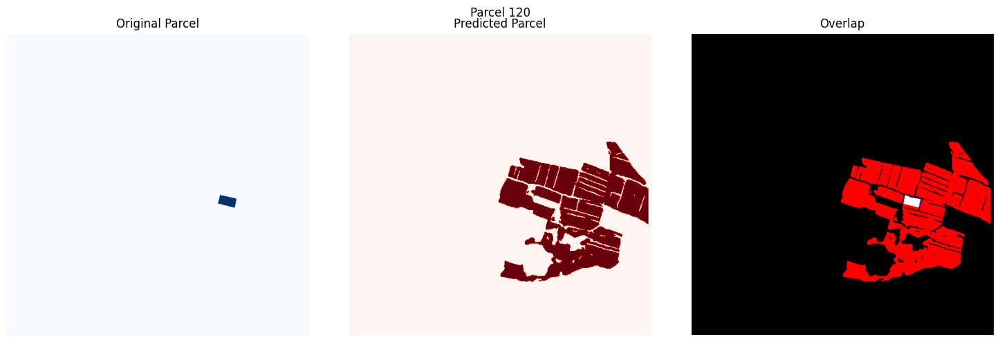

Parcel 120:
True Positive (Correctly predicted): 1471 pixels
False Negative (Missed): 243 pixels
False Positive (Overpredicted): 107009 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.86
F1 Score: 0.03




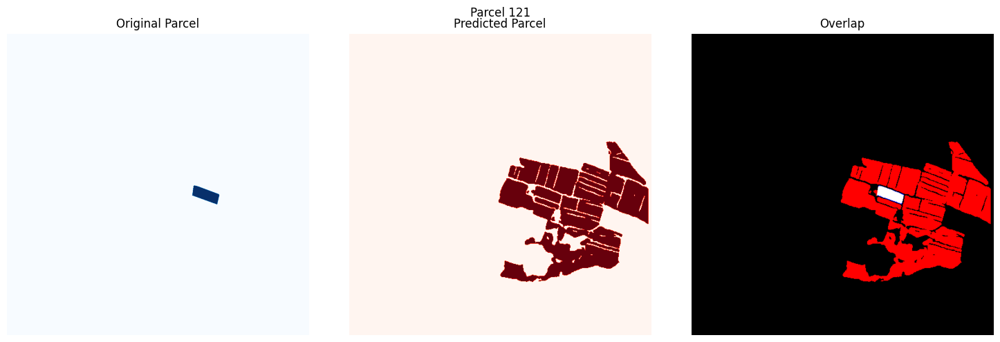

Parcel 121:
True Positive (Correctly predicted): 2811 pixels
False Negative (Missed): 288 pixels
False Positive (Overpredicted): 106983 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.91
F1 Score: 0.05




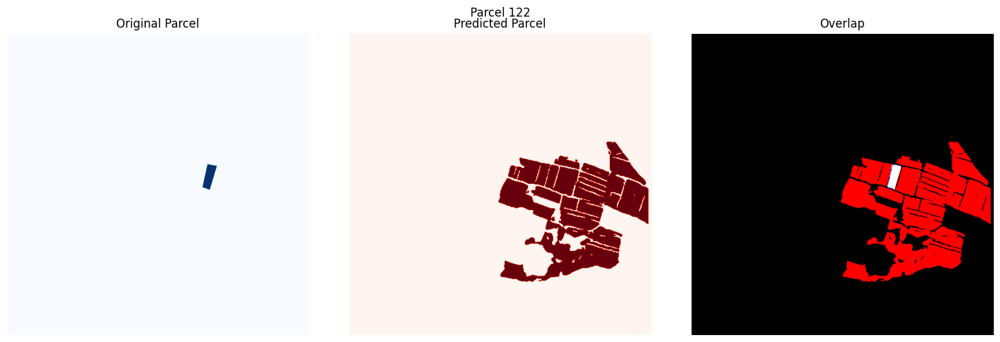

Parcel 122:
True Positive (Correctly predicted): 2140 pixels
False Negative (Missed): 171 pixels
False Positive (Overpredicted): 108394 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.93
F1 Score: 0.04




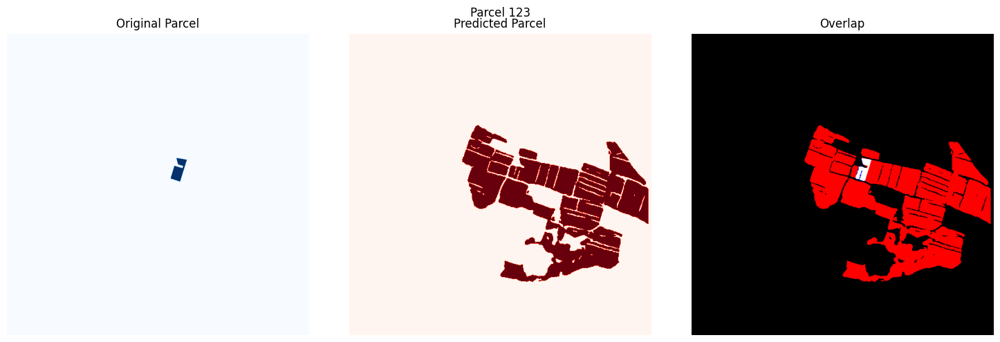

Parcel 123:
True Positive (Correctly predicted): 1972 pixels
False Negative (Missed): 210 pixels
False Positive (Overpredicted): 130925 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.90
F1 Score: 0.03




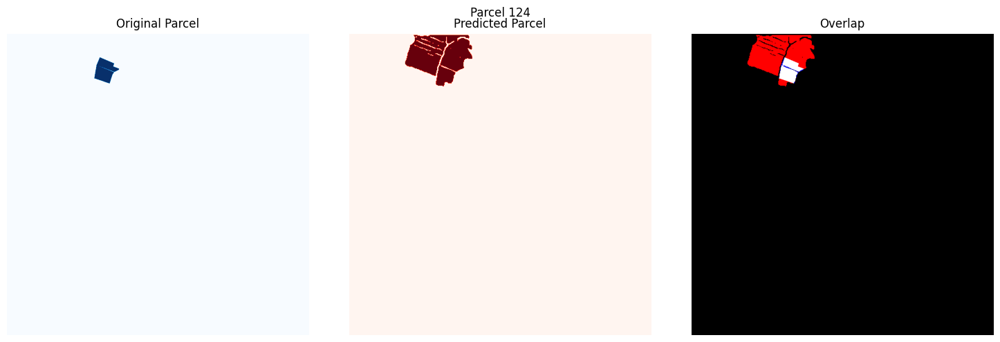

Parcel 124:
True Positive (Correctly predicted): 3825 pixels
False Negative (Missed): 286 pixels
False Positive (Overpredicted): 19955 pixels
Accuracy: 0.16
Precision: 0.16
Recall: 0.93
F1 Score: 0.27




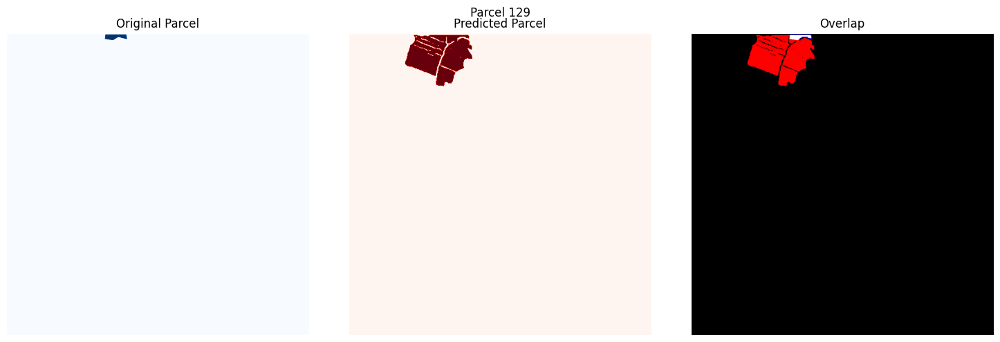

Parcel 129:
True Positive (Correctly predicted): 809 pixels
False Negative (Missed): 233 pixels
False Positive (Overpredicted): 22971 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.78
F1 Score: 0.07




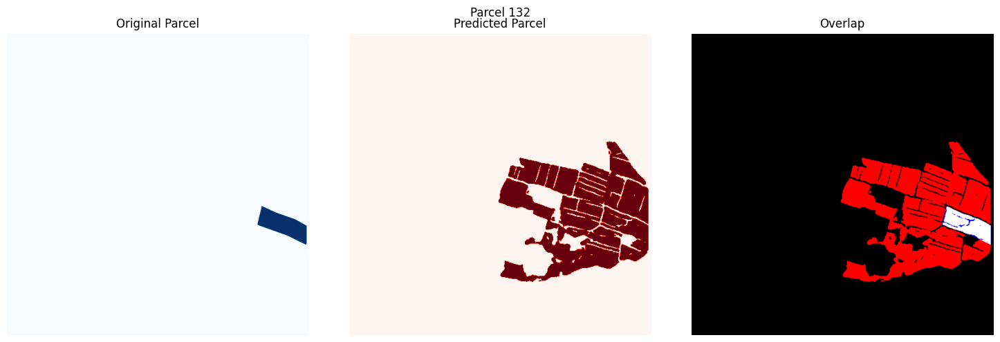

Parcel 132:
True Positive (Correctly predicted): 9139 pixels
False Negative (Missed): 1011 pixels
False Positive (Overpredicted): 110135 pixels
Accuracy: 0.08
Precision: 0.08
Recall: 0.90
F1 Score: 0.14




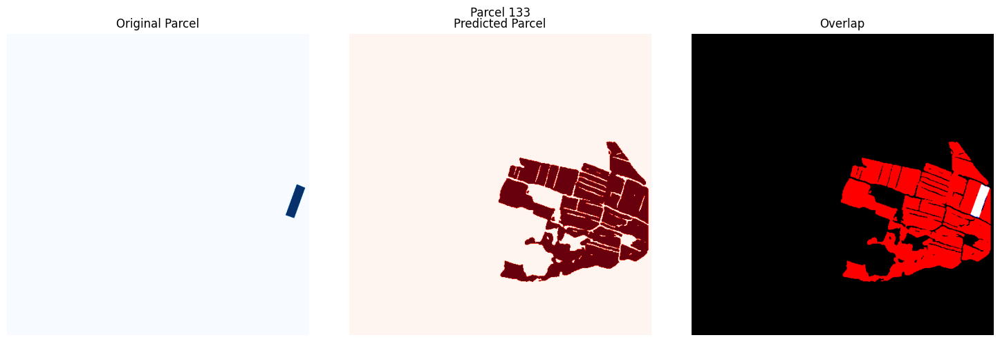

Parcel 133:
True Positive (Correctly predicted): 3168 pixels
False Negative (Missed): 129 pixels
False Positive (Overpredicted): 116106 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.96
F1 Score: 0.05




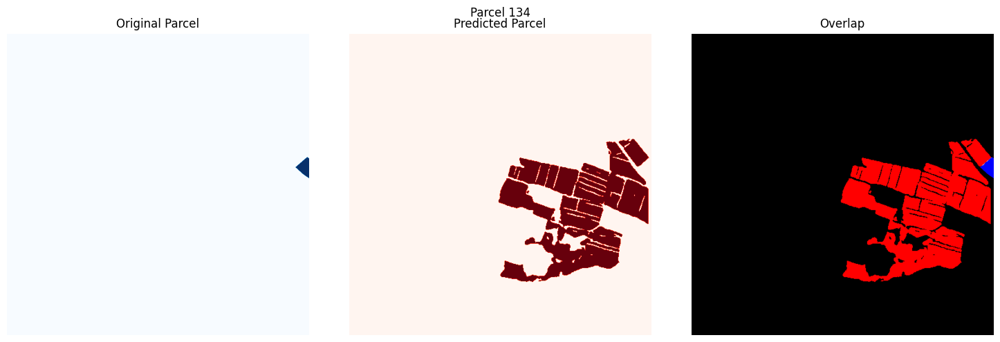

Parcel 134:
True Positive (Correctly predicted): 29 pixels
False Negative (Missed): 1723 pixels
False Positive (Overpredicted): 109858 pixels
Accuracy: 0.00
Precision: 0.00
Recall: 0.02
F1 Score: 0.00




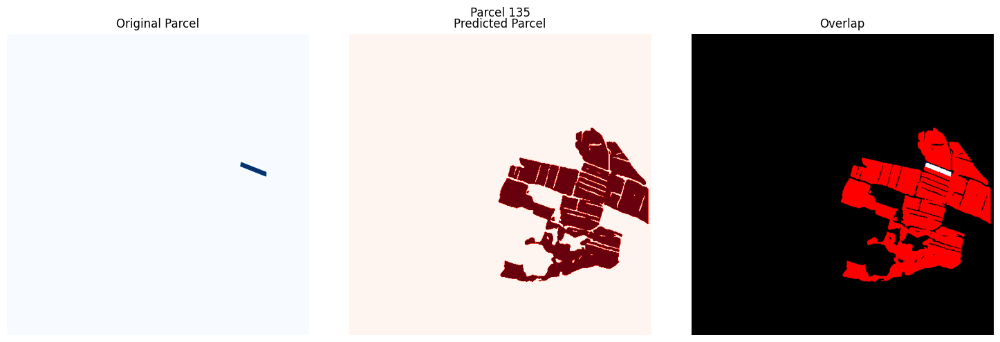

Parcel 135:
True Positive (Correctly predicted): 1316 pixels
False Negative (Missed): 81 pixels
False Positive (Overpredicted): 114285 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.94
F1 Score: 0.02




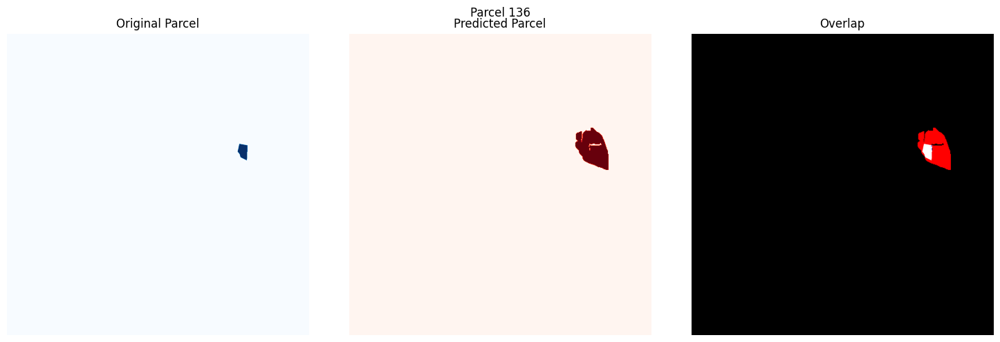

Parcel 136:
True Positive (Correctly predicted): 1284 pixels
False Negative (Missed): 17 pixels
False Positive (Overpredicted): 8814 pixels
Accuracy: 0.13
Precision: 0.13
Recall: 0.99
F1 Score: 0.23




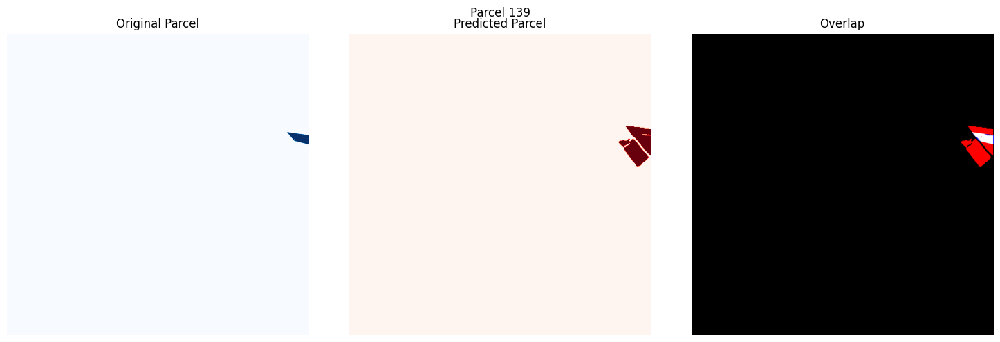

Parcel 139:
True Positive (Correctly predicted): 1519 pixels
False Negative (Missed): 183 pixels
False Positive (Overpredicted): 6808 pixels
Accuracy: 0.18
Precision: 0.18
Recall: 0.89
F1 Score: 0.30




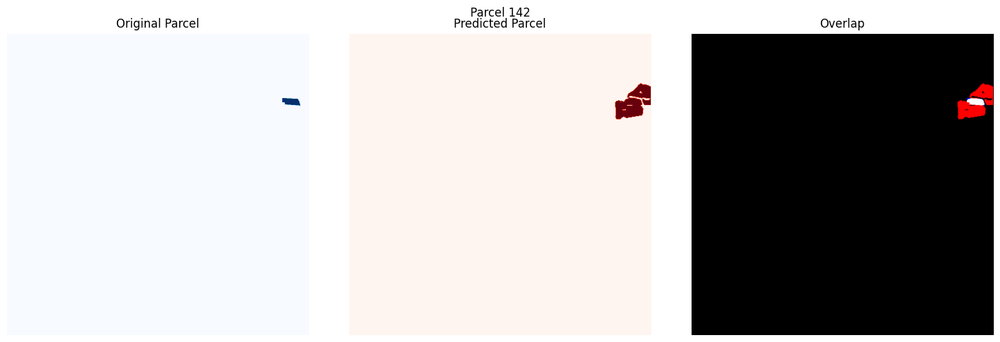

Parcel 142:
True Positive (Correctly predicted): 1067 pixels
False Negative (Missed): 82 pixels
False Positive (Overpredicted): 7155 pixels
Accuracy: 0.13
Precision: 0.13
Recall: 0.93
F1 Score: 0.23




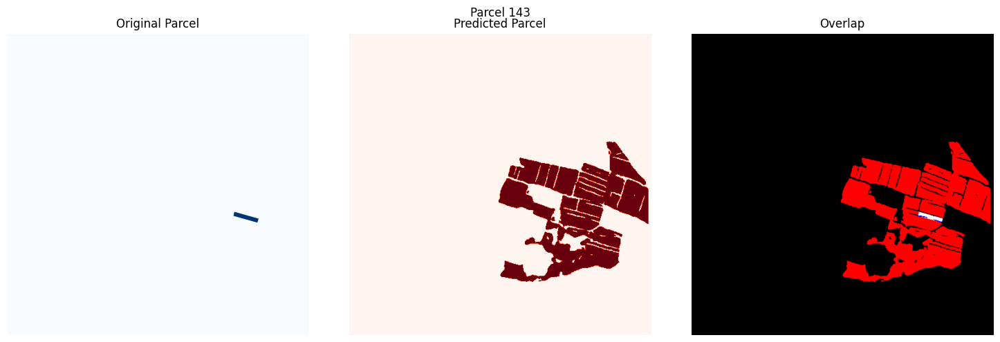

Parcel 143:
True Positive (Correctly predicted): 969 pixels
False Negative (Missed): 194 pixels
False Positive (Overpredicted): 104534 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.83
F1 Score: 0.02




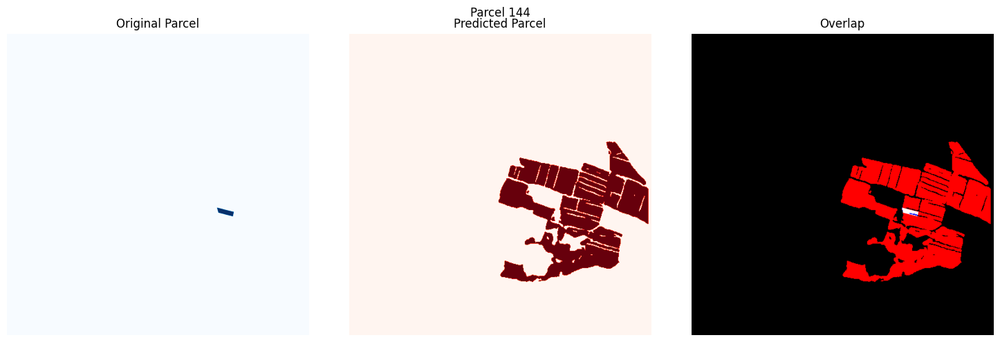

Parcel 144:
True Positive (Correctly predicted): 724 pixels
False Negative (Missed): 109 pixels
False Positive (Overpredicted): 104779 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.87
F1 Score: 0.01




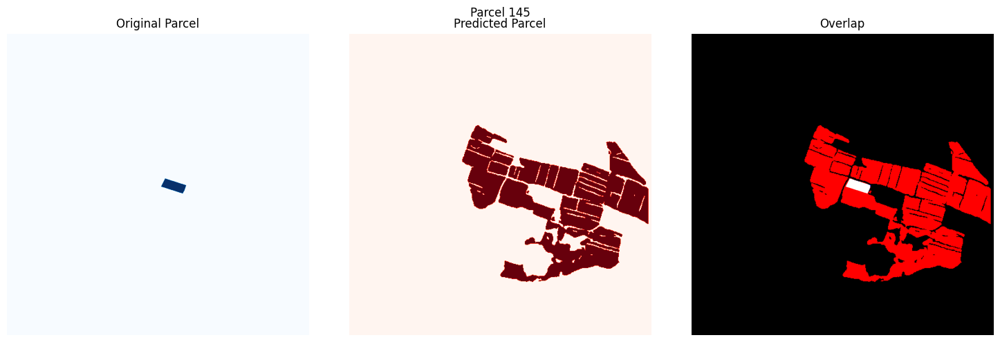

Parcel 145:
True Positive (Correctly predicted): 2219 pixels
False Negative (Missed): 20 pixels
False Positive (Overpredicted): 129144 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.99
F1 Score: 0.03




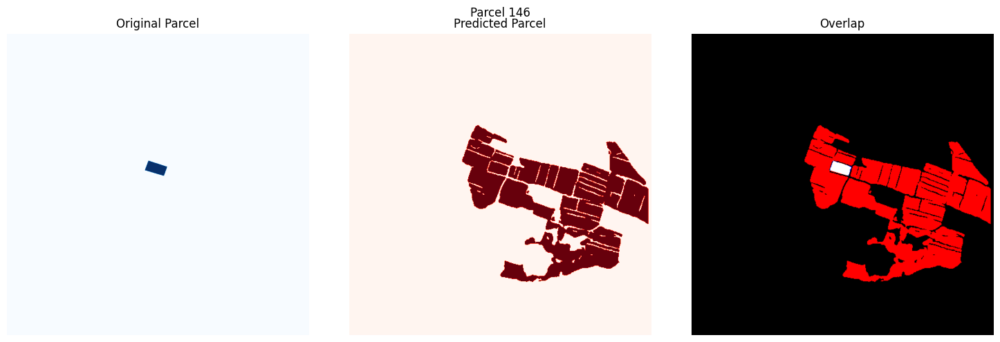

Parcel 146:
True Positive (Correctly predicted): 2072 pixels
False Negative (Missed): 116 pixels
False Positive (Overpredicted): 129291 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.95
F1 Score: 0.03




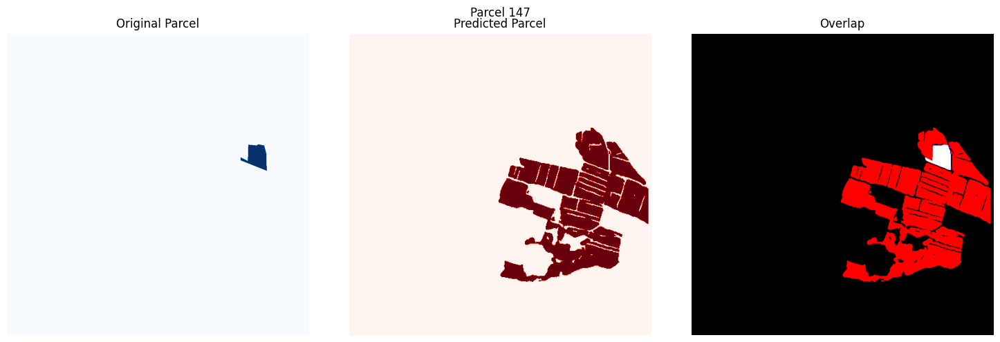

Parcel 147:
True Positive (Correctly predicted): 4404 pixels
False Negative (Missed): 190 pixels
False Positive (Overpredicted): 111197 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.96
F1 Score: 0.07




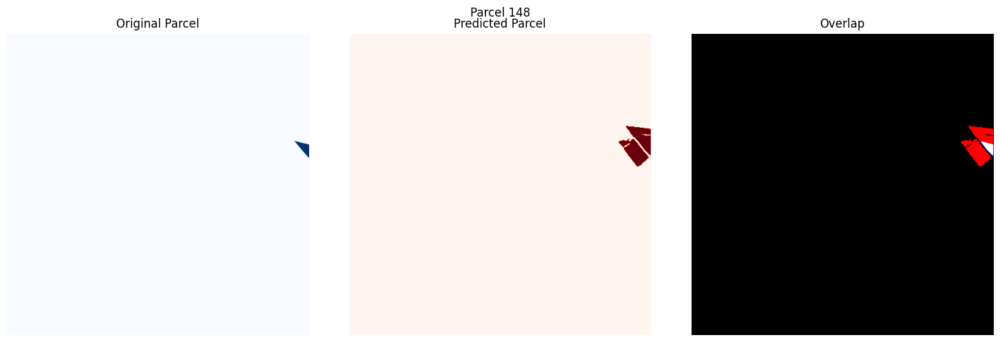

Parcel 148:
True Positive (Correctly predicted): 880 pixels
False Negative (Missed): 253 pixels
False Positive (Overpredicted): 7447 pixels
Accuracy: 0.10
Precision: 0.11
Recall: 0.78
F1 Score: 0.19




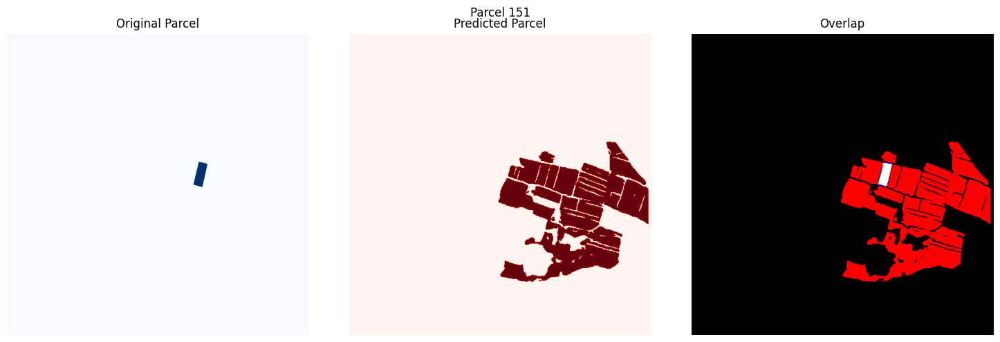

Parcel 151:
True Positive (Correctly predicted): 2164 pixels
False Negative (Missed): 232 pixels
False Positive (Overpredicted): 107678 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.90
F1 Score: 0.04




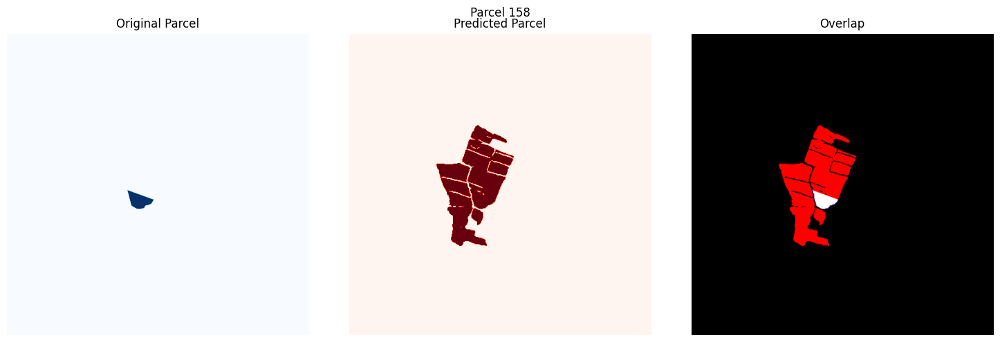

Parcel 158:
True Positive (Correctly predicted): 2826 pixels
False Negative (Missed): 131 pixels
False Positive (Overpredicted): 44465 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.96
F1 Score: 0.11




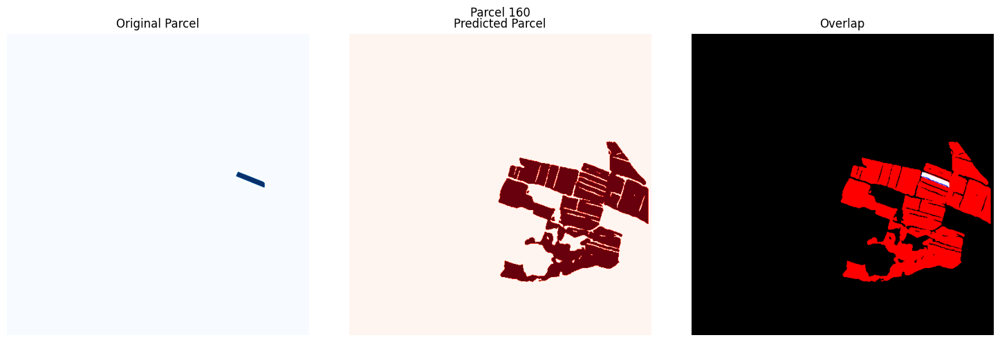

Parcel 160:
True Positive (Correctly predicted): 1422 pixels
False Negative (Missed): 244 pixels
False Positive (Overpredicted): 104081 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.85
F1 Score: 0.03




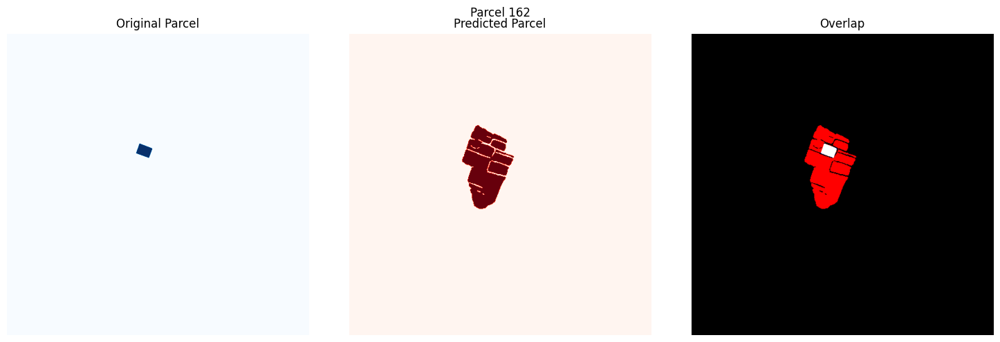

Parcel 162:
True Positive (Correctly predicted): 1551 pixels
False Negative (Missed): 31 pixels
False Positive (Overpredicted): 25463 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.98
F1 Score: 0.11




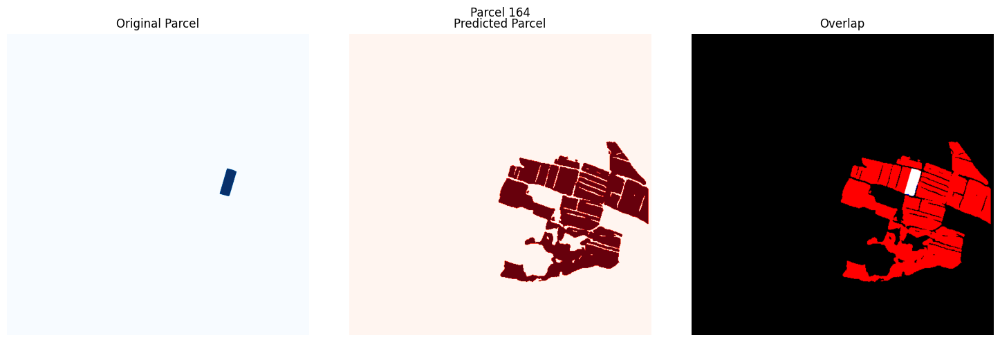

Parcel 164:
True Positive (Correctly predicted): 2886 pixels
False Negative (Missed): 78 pixels
False Positive (Overpredicted): 104671 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.97
F1 Score: 0.05




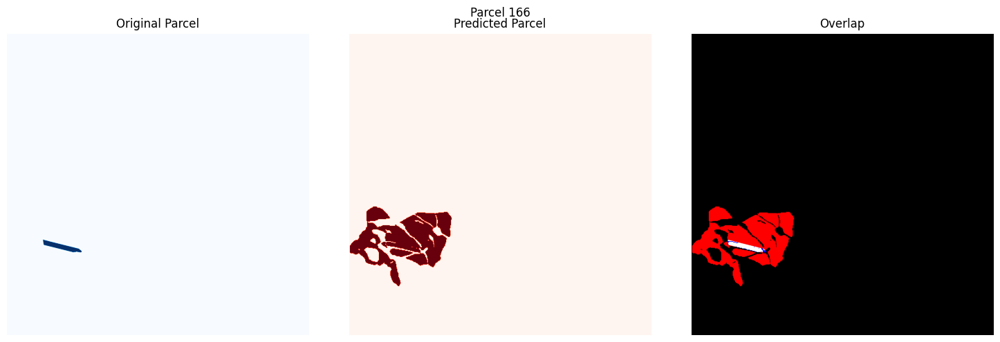

Parcel 166:
True Positive (Correctly predicted): 1711 pixels
False Negative (Missed): 248 pixels
False Positive (Overpredicted): 36937 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.87
F1 Score: 0.08




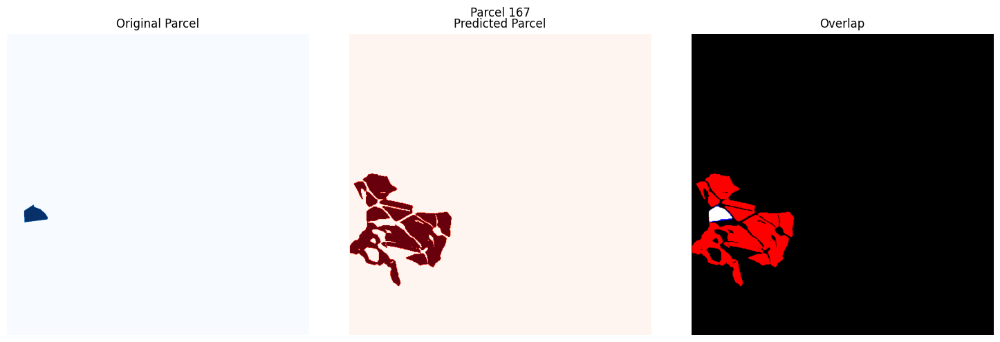

Parcel 167:
True Positive (Correctly predicted): 2630 pixels
False Negative (Missed): 364 pixels
False Positive (Overpredicted): 47156 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.88
F1 Score: 0.10




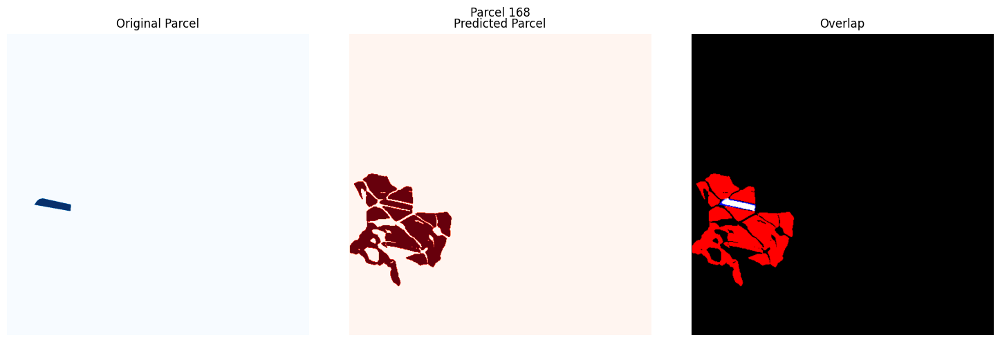

Parcel 168:
True Positive (Correctly predicted): 2015 pixels
False Negative (Missed): 733 pixels
False Positive (Overpredicted): 50786 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.73
F1 Score: 0.07




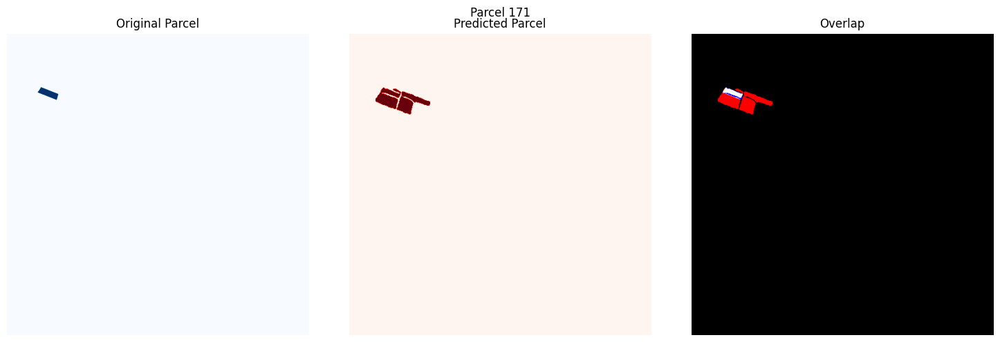

Parcel 171:
True Positive (Correctly predicted): 1005 pixels
False Negative (Missed): 323 pixels
False Positive (Overpredicted): 6349 pixels
Accuracy: 0.13
Precision: 0.14
Recall: 0.76
F1 Score: 0.23




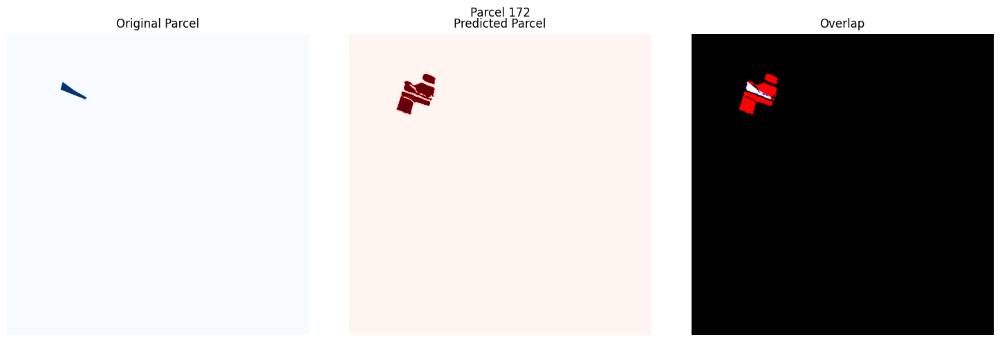

Parcel 172:
True Positive (Correctly predicted): 1200 pixels
False Negative (Missed): 217 pixels
False Positive (Overpredicted): 7061 pixels
Accuracy: 0.14
Precision: 0.15
Recall: 0.85
F1 Score: 0.25




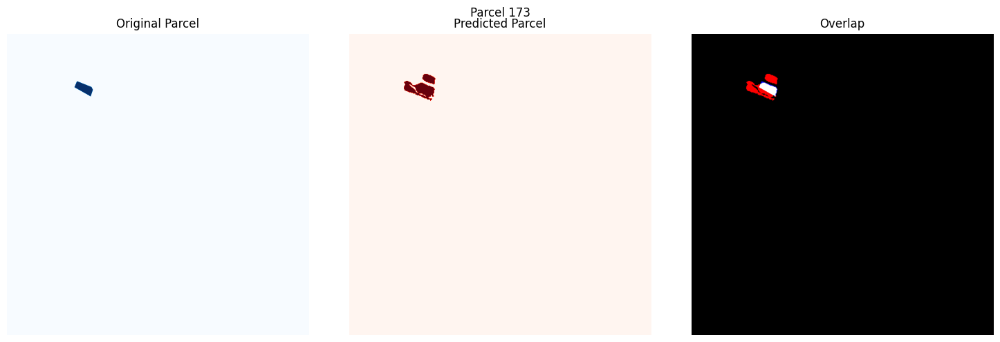

Parcel 173:
True Positive (Correctly predicted): 1386 pixels
False Negative (Missed): 175 pixels
False Positive (Overpredicted): 3079 pixels
Accuracy: 0.30
Precision: 0.31
Recall: 0.89
F1 Score: 0.46




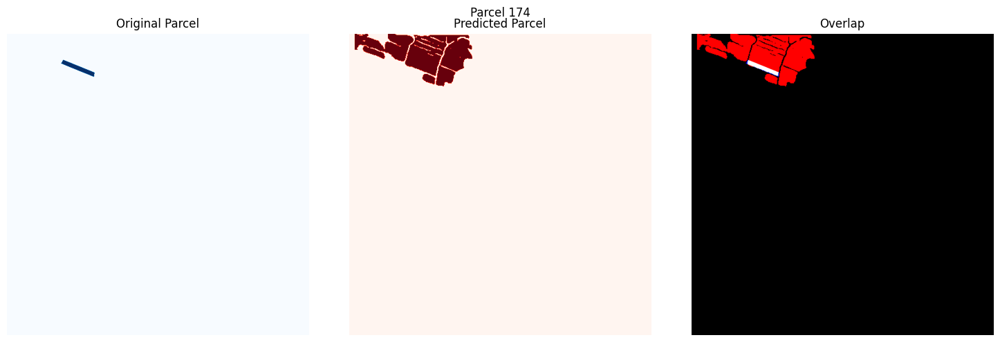

Parcel 174:
True Positive (Correctly predicted): 1473 pixels
False Negative (Missed): 170 pixels
False Positive (Overpredicted): 33602 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.90
F1 Score: 0.08




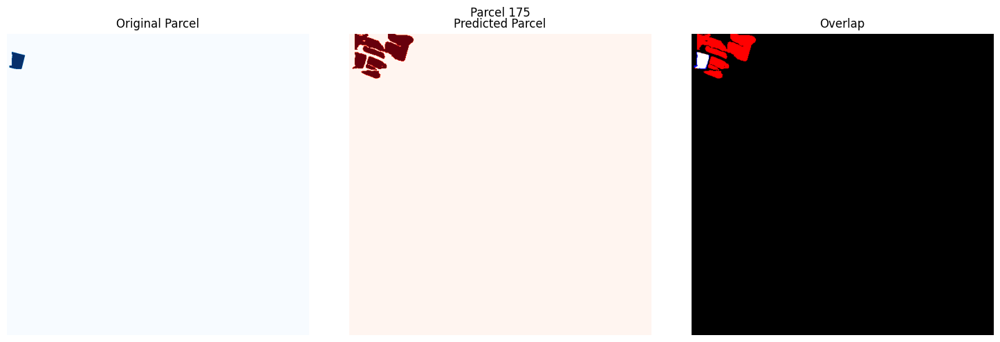

Parcel 175:
True Positive (Correctly predicted): 1751 pixels
False Negative (Missed): 302 pixels
False Positive (Overpredicted): 13472 pixels
Accuracy: 0.11
Precision: 0.12
Recall: 0.85
F1 Score: 0.20




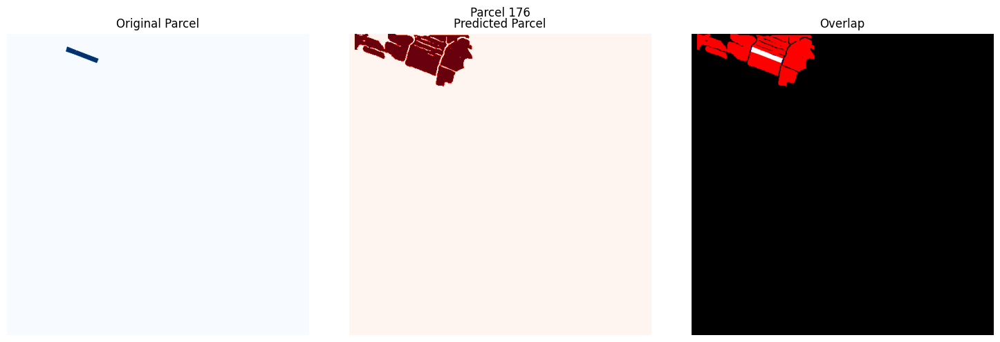

Parcel 176:
True Positive (Correctly predicted): 1687 pixels
False Negative (Missed): 68 pixels
False Positive (Overpredicted): 32409 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.96
F1 Score: 0.09




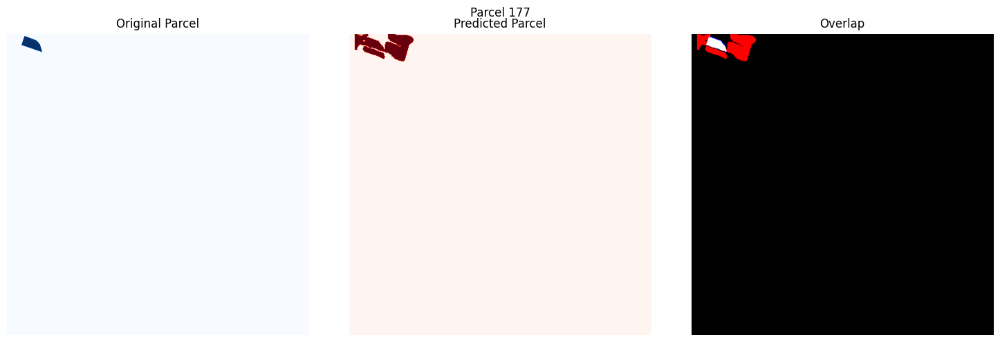

Parcel 177:
True Positive (Correctly predicted): 1713 pixels
False Negative (Missed): 188 pixels
False Positive (Overpredicted): 8603 pixels
Accuracy: 0.16
Precision: 0.17
Recall: 0.90
F1 Score: 0.28




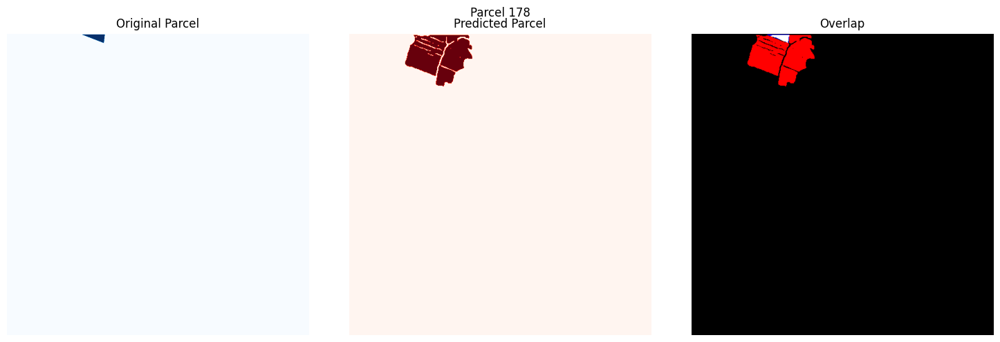

Parcel 178:
True Positive (Correctly predicted): 862 pixels
False Negative (Missed): 258 pixels
False Positive (Overpredicted): 22918 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.77
F1 Score: 0.07




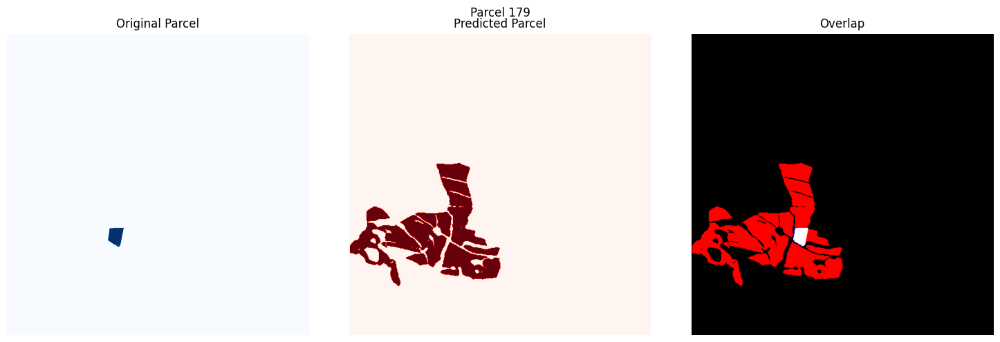

Parcel 179:
True Positive (Correctly predicted): 2223 pixels
False Negative (Missed): 176 pixels
False Positive (Overpredicted): 71335 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.93
F1 Score: 0.06




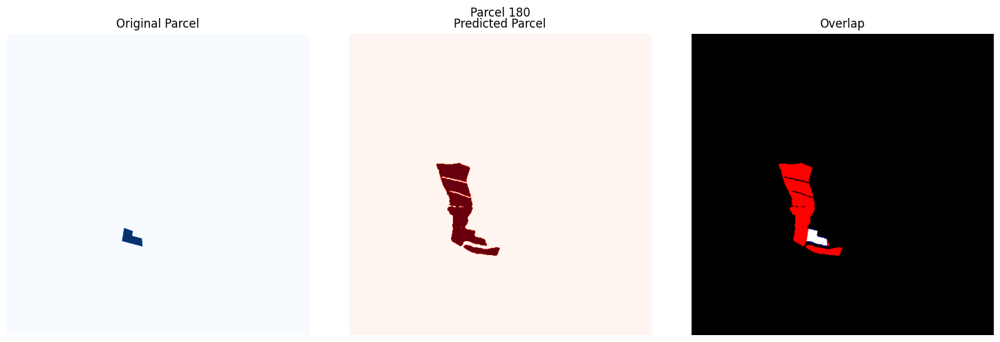

Parcel 180:
True Positive (Correctly predicted): 2064 pixels
False Negative (Missed): 196 pixels
False Positive (Overpredicted): 20263 pixels
Accuracy: 0.09
Precision: 0.09
Recall: 0.91
F1 Score: 0.17




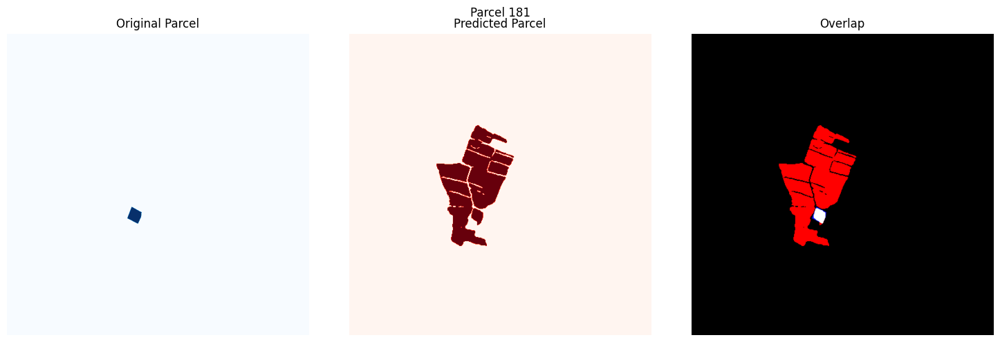

Parcel 181:
True Positive (Correctly predicted): 1380 pixels
False Negative (Missed): 234 pixels
False Positive (Overpredicted): 45911 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.86
F1 Score: 0.06




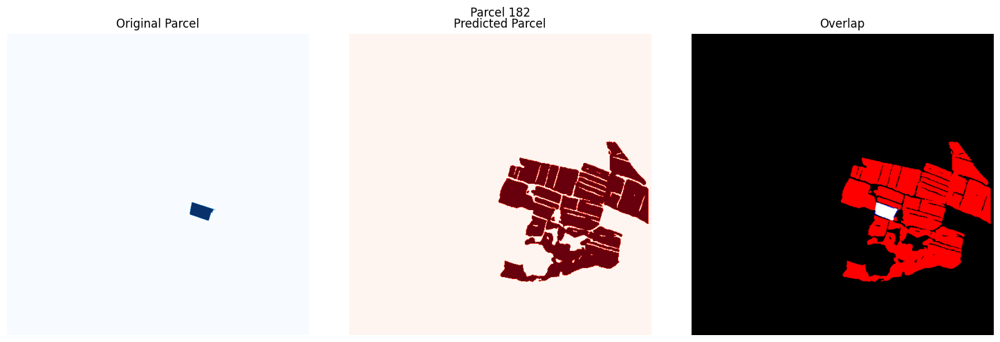

Parcel 182:
True Positive (Correctly predicted): 2672 pixels
False Negative (Missed): 271 pixels
False Positive (Overpredicted): 110393 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.91
F1 Score: 0.05




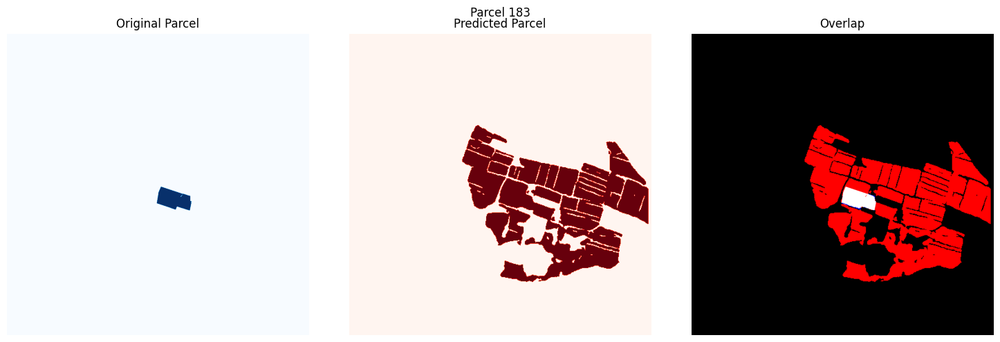

Parcel 183:
True Positive (Correctly predicted): 5630 pixels
False Negative (Missed): 221 pixels
False Positive (Overpredicted): 139736 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.96
F1 Score: 0.07




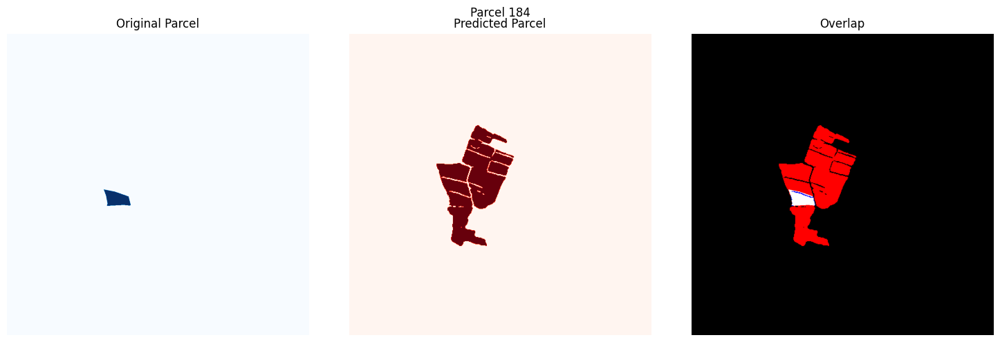

Parcel 184:
True Positive (Correctly predicted): 2926 pixels
False Negative (Missed): 307 pixels
False Positive (Overpredicted): 42917 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.91
F1 Score: 0.12




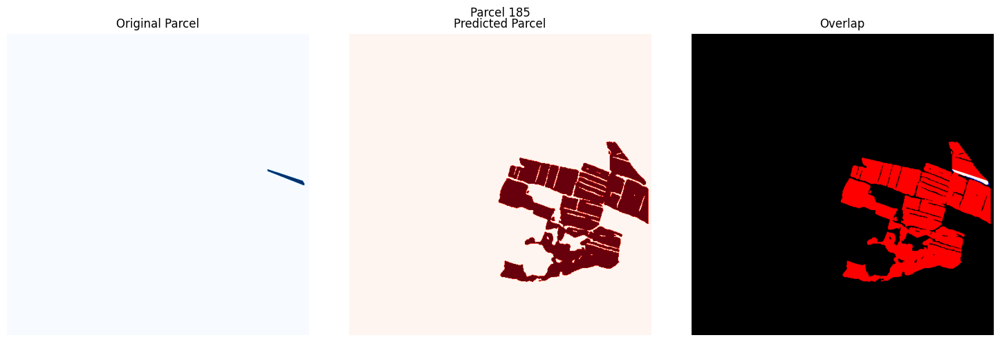

Parcel 185:
True Positive (Correctly predicted): 1102 pixels
False Negative (Missed): 178 pixels
False Positive (Overpredicted): 104401 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.86
F1 Score: 0.02




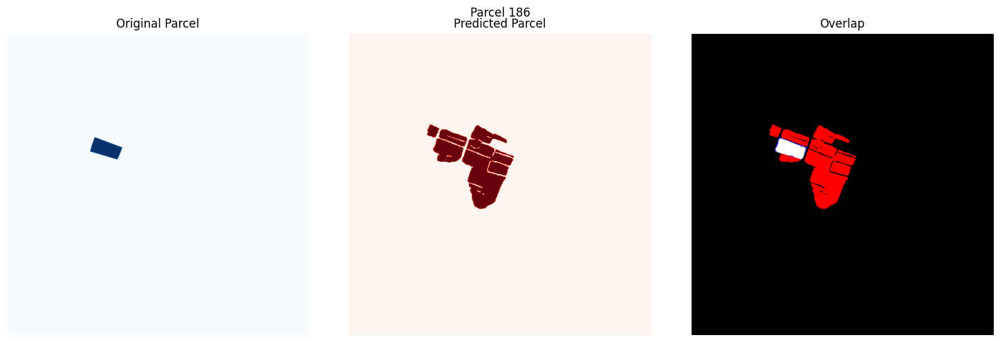

Parcel 186:
True Positive (Correctly predicted): 4106 pixels
False Negative (Missed): 401 pixels
False Positive (Overpredicted): 31075 pixels
Accuracy: 0.12
Precision: 0.12
Recall: 0.91
F1 Score: 0.21




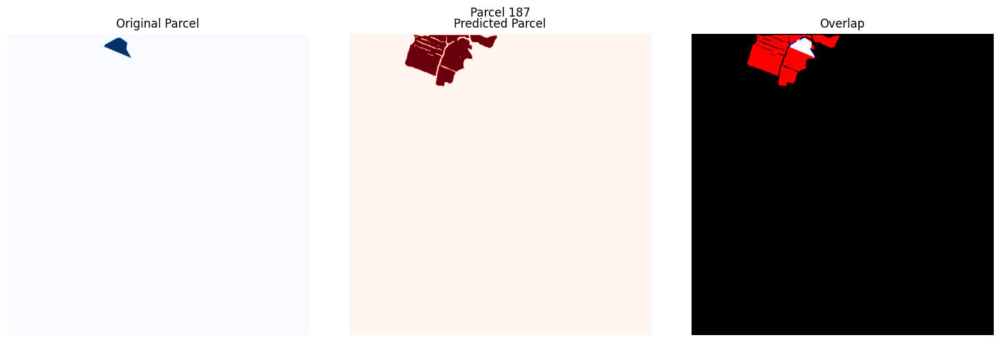

Parcel 187:
True Positive (Correctly predicted): 2612 pixels
False Negative (Missed): 227 pixels
False Positive (Overpredicted): 23530 pixels
Accuracy: 0.10
Precision: 0.10
Recall: 0.92
F1 Score: 0.18




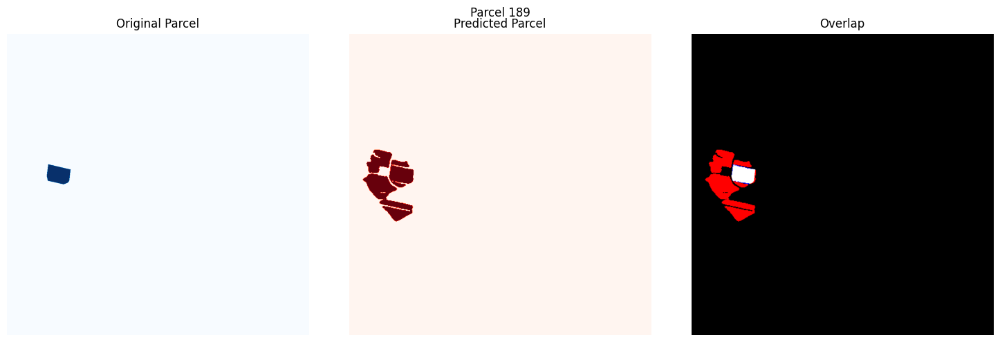

Parcel 189:
True Positive (Correctly predicted): 3688 pixels
False Negative (Missed): 259 pixels
False Positive (Overpredicted): 15820 pixels
Accuracy: 0.19
Precision: 0.19
Recall: 0.93
F1 Score: 0.31




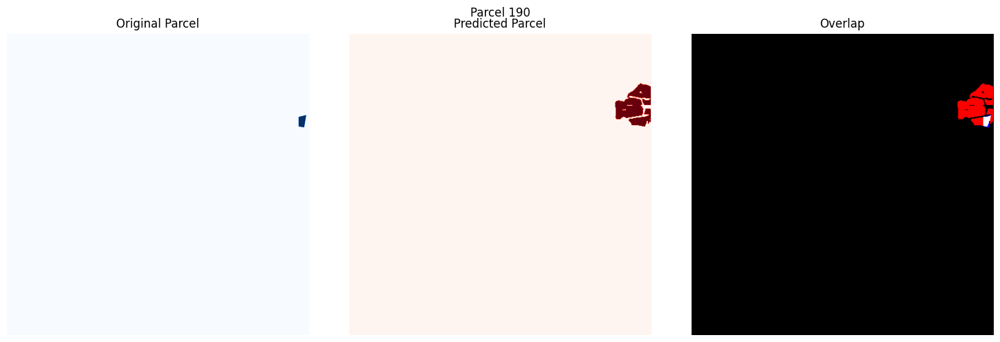

Parcel 190:
True Positive (Correctly predicted): 659 pixels
False Negative (Missed): 151 pixels
False Positive (Overpredicted): 9723 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.81
F1 Score: 0.12




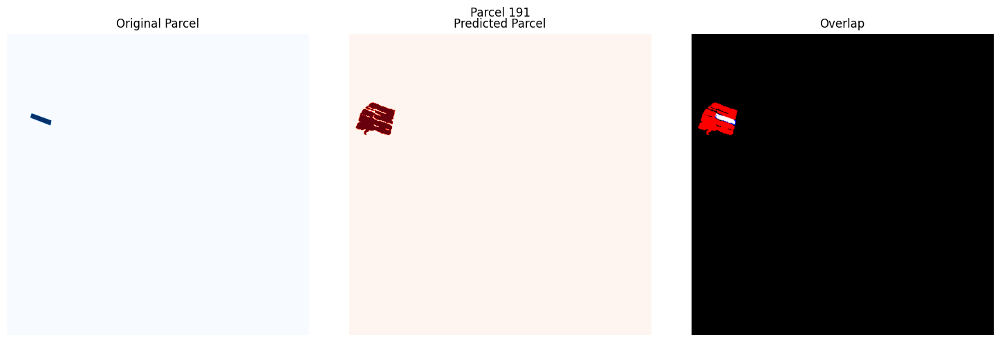

Parcel 191:
True Positive (Correctly predicted): 935 pixels
False Negative (Missed): 206 pixels
False Positive (Overpredicted): 7886 pixels
Accuracy: 0.10
Precision: 0.11
Recall: 0.82
F1 Score: 0.19




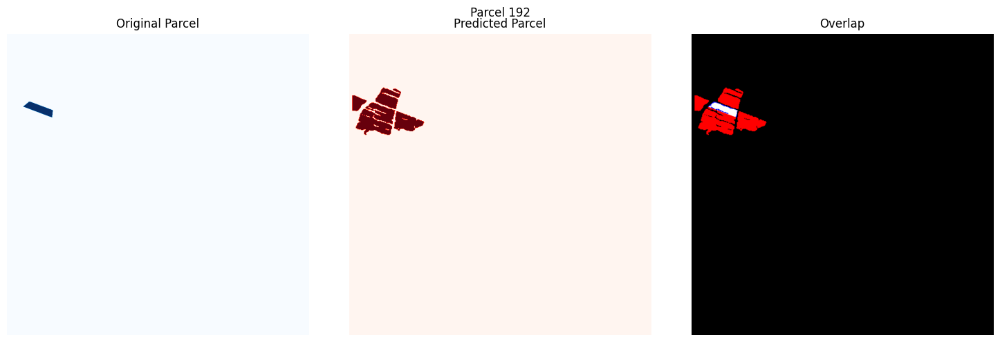

Parcel 192:
True Positive (Correctly predicted): 1762 pixels
False Negative (Missed): 443 pixels
False Positive (Overpredicted): 16236 pixels
Accuracy: 0.10
Precision: 0.10
Recall: 0.80
F1 Score: 0.17




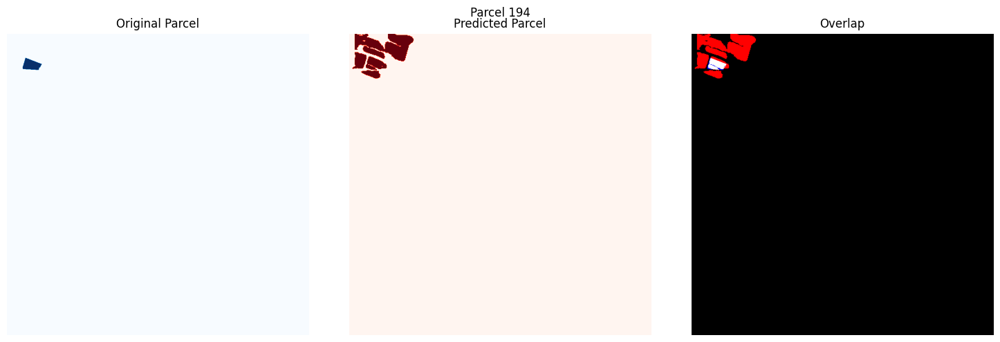

Parcel 194:
True Positive (Correctly predicted): 1457 pixels
False Negative (Missed): 226 pixels
False Positive (Overpredicted): 13766 pixels
Accuracy: 0.09
Precision: 0.10
Recall: 0.87
F1 Score: 0.17




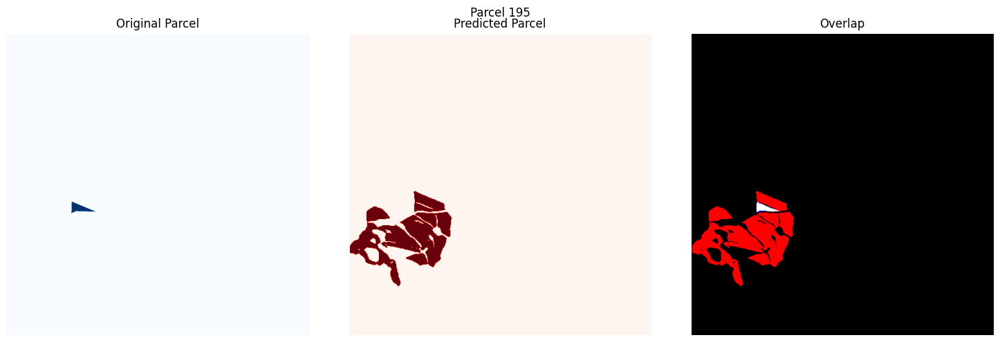

Parcel 195:
True Positive (Correctly predicted): 1144 pixels
False Negative (Missed): 188 pixels
False Positive (Overpredicted): 40549 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.86
F1 Score: 0.05




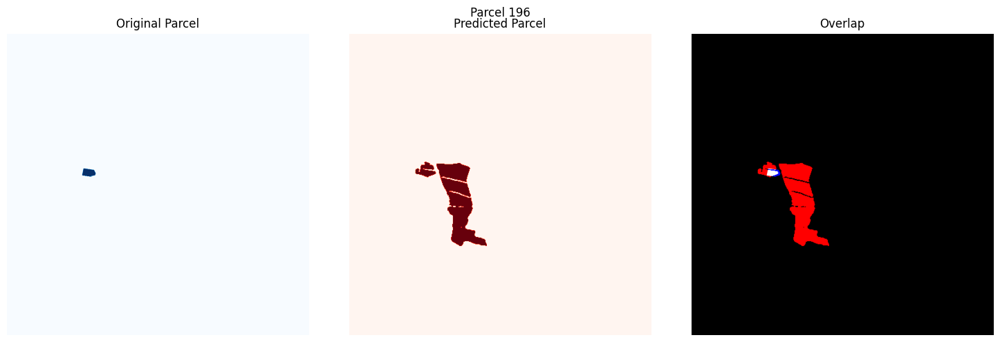

Parcel 196:
True Positive (Correctly predicted): 615 pixels
False Negative (Missed): 322 pixels
False Positive (Overpredicted): 21311 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.66
F1 Score: 0.05




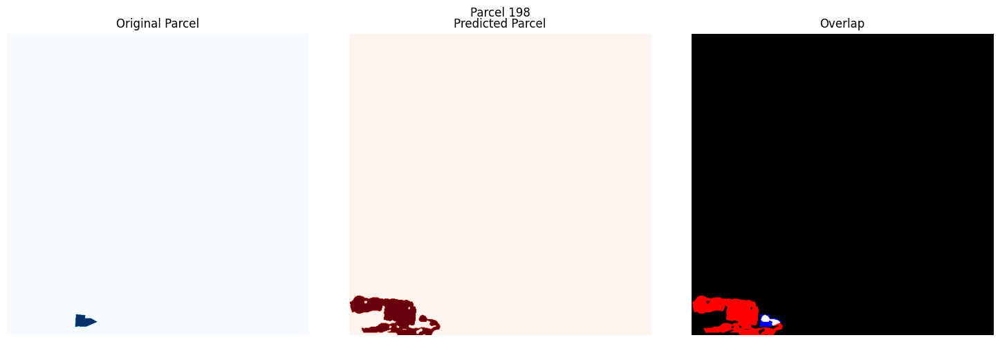

Parcel 198:
True Positive (Correctly predicted): 934 pixels
False Negative (Missed): 1047 pixels
False Positive (Overpredicted): 19025 pixels
Accuracy: 0.04
Precision: 0.05
Recall: 0.47
F1 Score: 0.09




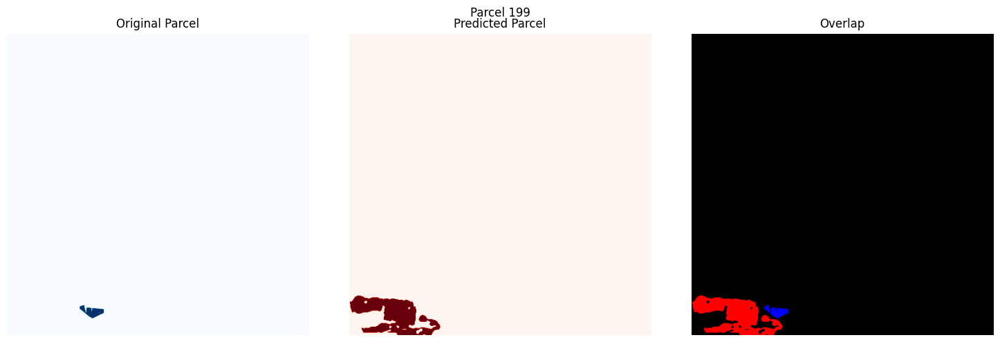

Parcel 199:
True Positive (Correctly predicted): 0 pixels
False Negative (Missed): 1776 pixels
False Positive (Overpredicted): 19959 pixels
Accuracy: 0.00
Precision: 0.00
Recall: 0.00
F1 Score: 0.00




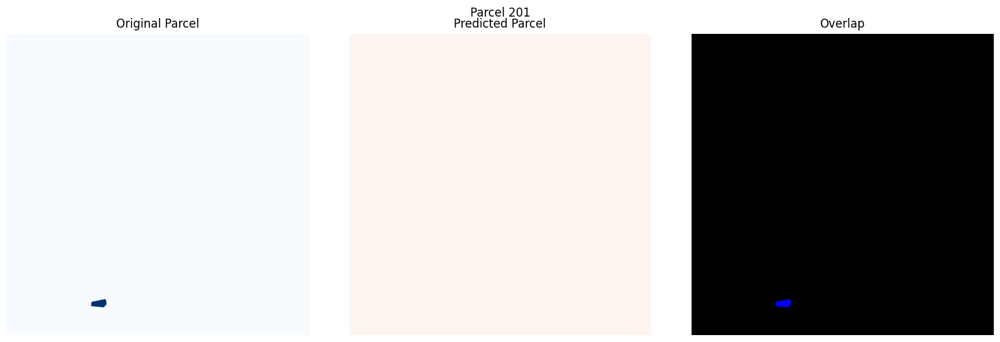

Parcel 201:
True Positive (Correctly predicted): 0 pixels
False Negative (Missed): 1039 pixels
False Positive (Overpredicted): 0 pixels
Accuracy: 0.00
Precision: 0.00
Recall: 0.00
F1 Score: 0.00




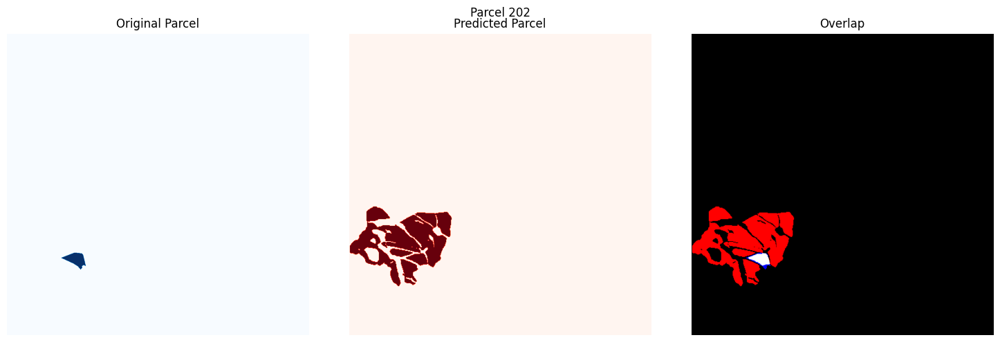

Parcel 202:
True Positive (Correctly predicted): 1773 pixels
False Negative (Missed): 528 pixels
False Positive (Overpredicted): 39715 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.77
F1 Score: 0.08




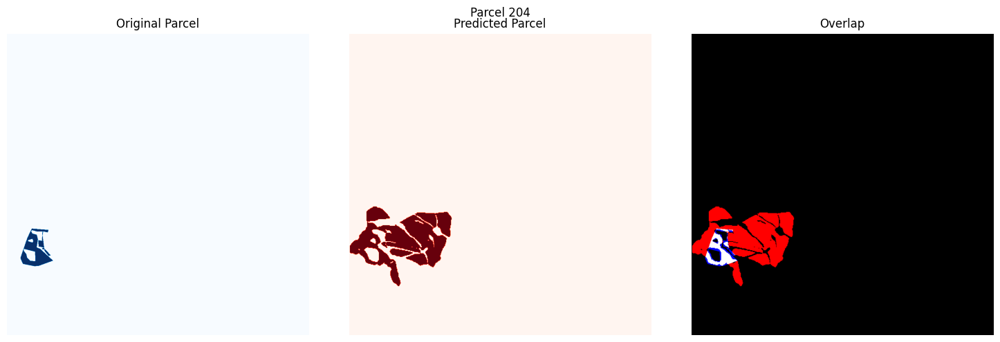

Parcel 204:
True Positive (Correctly predicted): 4232 pixels
False Negative (Missed): 2099 pixels
False Positive (Overpredicted): 34416 pixels
Accuracy: 0.10
Precision: 0.11
Recall: 0.67
F1 Score: 0.19




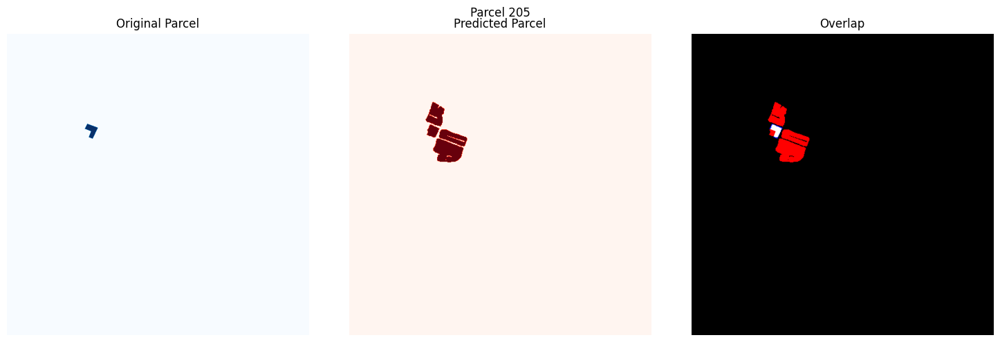

Parcel 205:
True Positive (Correctly predicted): 835 pixels
False Negative (Missed): 201 pixels
False Positive (Overpredicted): 11547 pixels
Accuracy: 0.07
Precision: 0.07
Recall: 0.81
F1 Score: 0.12




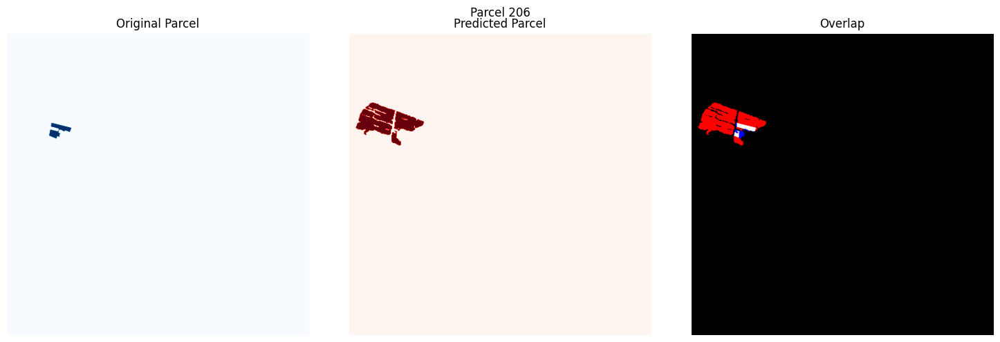

Parcel 206:
True Positive (Correctly predicted): 1083 pixels
False Negative (Missed): 595 pixels
False Positive (Overpredicted): 12609 pixels
Accuracy: 0.08
Precision: 0.08
Recall: 0.65
F1 Score: 0.14




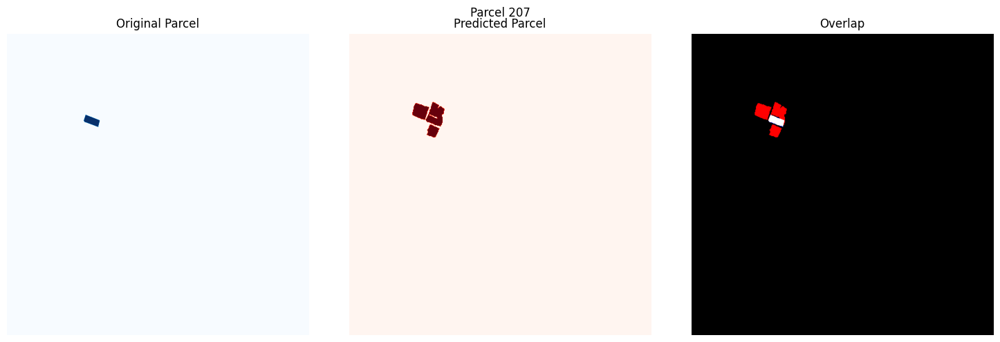

Parcel 207:
True Positive (Correctly predicted): 1132 pixels
False Negative (Missed): 56 pixels
False Positive (Overpredicted): 5140 pixels
Accuracy: 0.18
Precision: 0.18
Recall: 0.95
F1 Score: 0.30




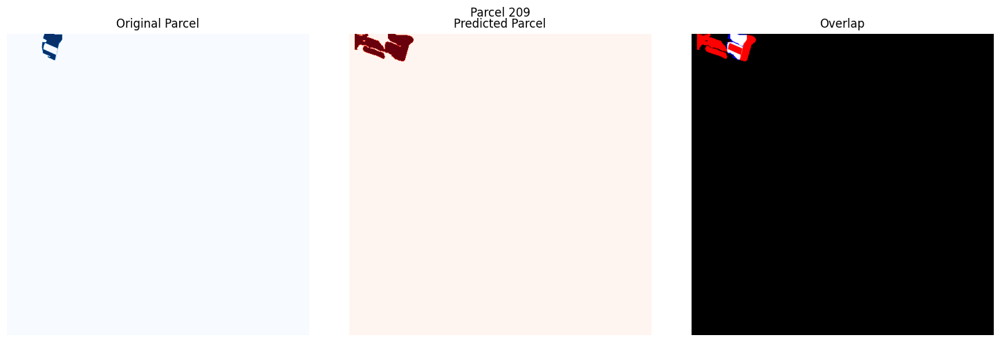

Parcel 209:
True Positive (Correctly predicted): 2503 pixels
False Negative (Missed): 585 pixels
False Positive (Overpredicted): 7813 pixels
Accuracy: 0.23
Precision: 0.24
Recall: 0.81
F1 Score: 0.37




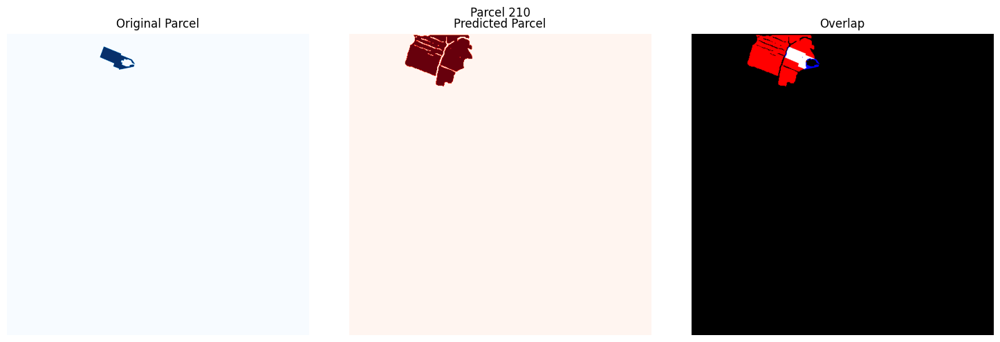

Parcel 210:
True Positive (Correctly predicted): 3053 pixels
False Negative (Missed): 666 pixels
False Positive (Overpredicted): 20727 pixels
Accuracy: 0.12
Precision: 0.13
Recall: 0.82
F1 Score: 0.22




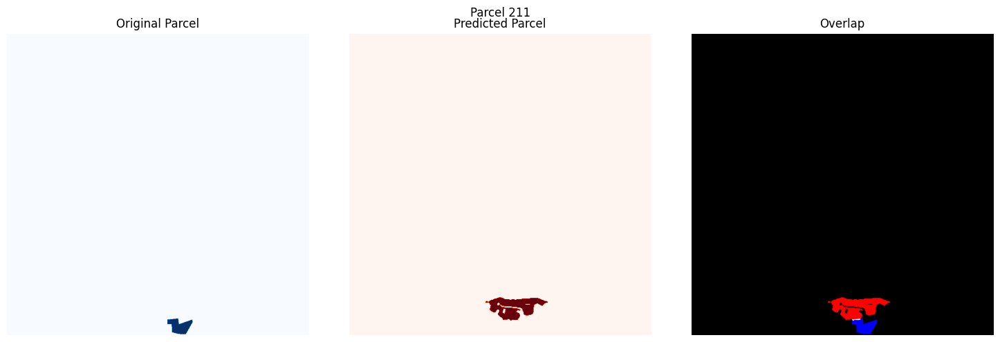

Parcel 211:
True Positive (Correctly predicted): 85 pixels
False Negative (Missed): 2665 pixels
False Positive (Overpredicted): 8325 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.03
F1 Score: 0.02




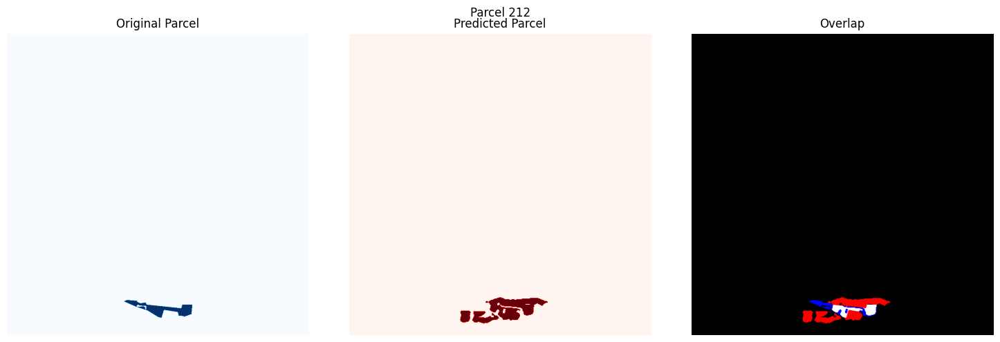

Parcel 212:
True Positive (Correctly predicted): 2785 pixels
False Negative (Missed): 2017 pixels
False Positive (Overpredicted): 8832 pixels
Accuracy: 0.20
Precision: 0.24
Recall: 0.58
F1 Score: 0.34




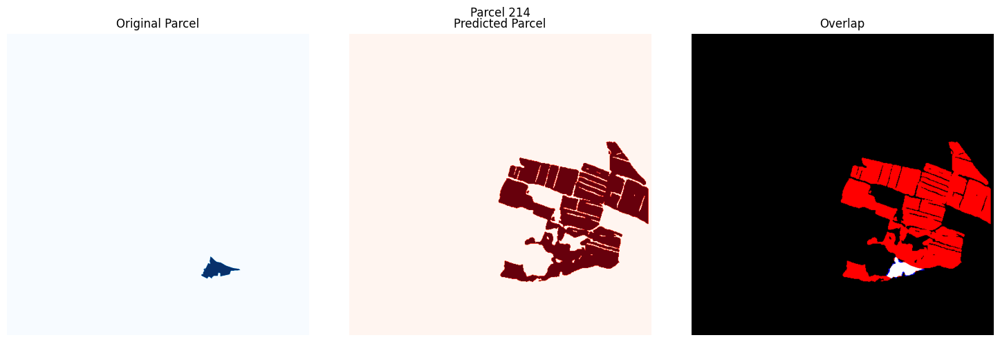

Parcel 214:
True Positive (Correctly predicted): 3571 pixels
False Negative (Missed): 454 pixels
False Positive (Overpredicted): 101932 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.89
F1 Score: 0.07




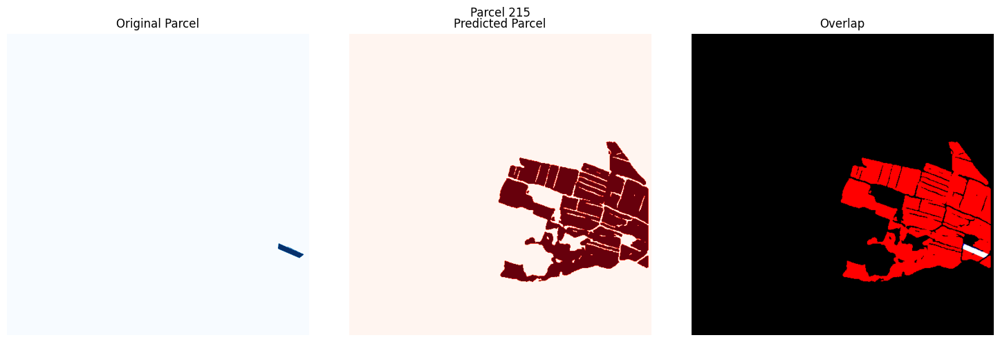

Parcel 215:
True Positive (Correctly predicted): 1407 pixels
False Negative (Missed): 114 pixels
False Positive (Overpredicted): 118764 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.93
F1 Score: 0.02




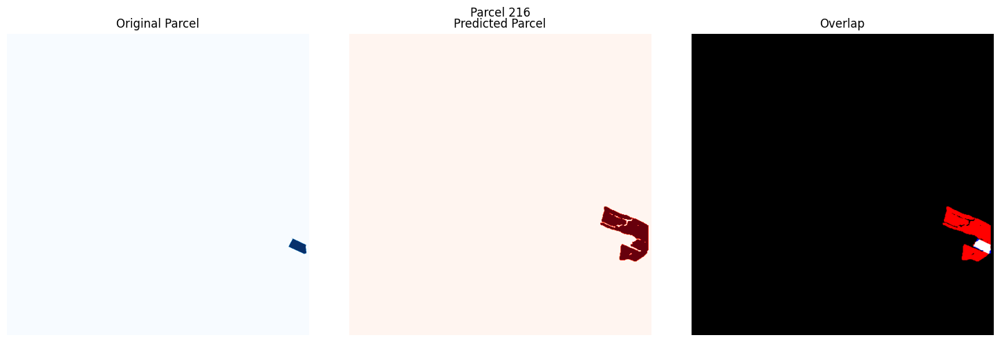

Parcel 216:
True Positive (Correctly predicted): 1525 pixels
False Negative (Missed): 166 pixels
False Positive (Overpredicted): 12246 pixels
Accuracy: 0.11
Precision: 0.11
Recall: 0.90
F1 Score: 0.20




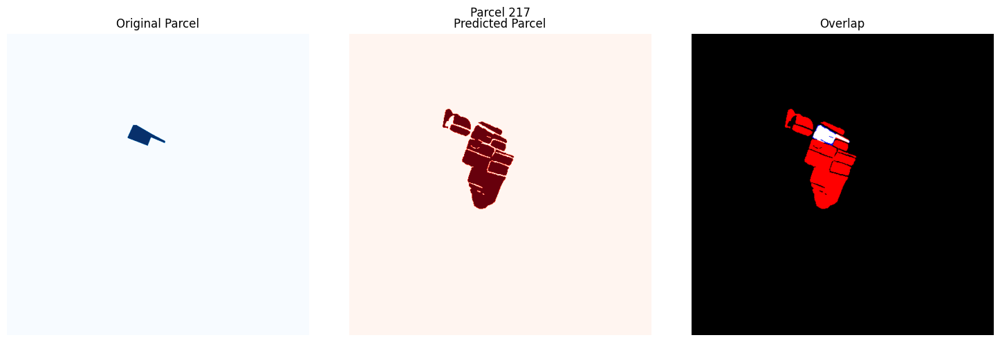

Parcel 217:
True Positive (Correctly predicted): 3264 pixels
False Negative (Missed): 493 pixels
False Positive (Overpredicted): 29062 pixels
Accuracy: 0.10
Precision: 0.10
Recall: 0.87
F1 Score: 0.18




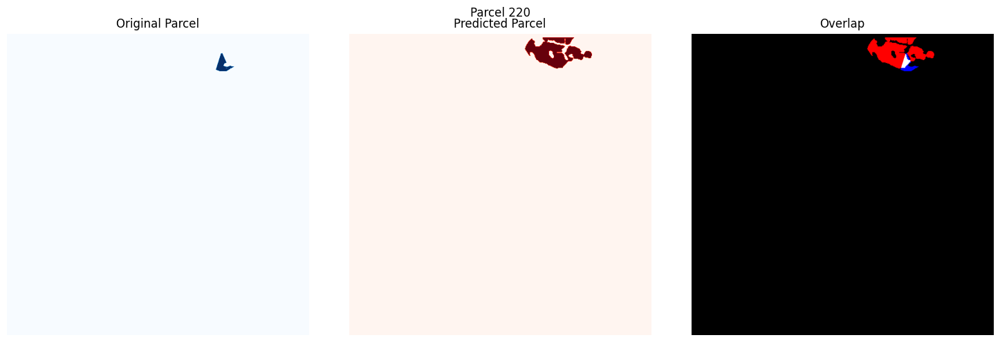

Parcel 220:
True Positive (Correctly predicted): 655 pixels
False Negative (Missed): 854 pixels
False Positive (Overpredicted): 11021 pixels
Accuracy: 0.05
Precision: 0.06
Recall: 0.43
F1 Score: 0.10




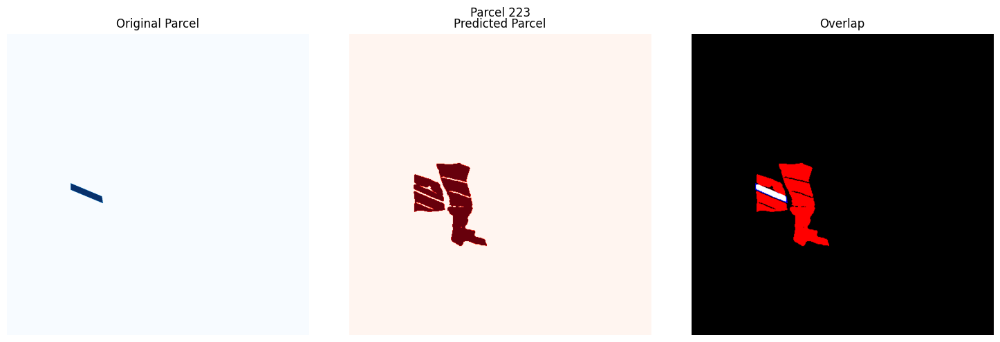

Parcel 223:
True Positive (Correctly predicted): 1892 pixels
False Negative (Missed): 420 pixels
False Positive (Overpredicted): 27334 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.82
F1 Score: 0.12




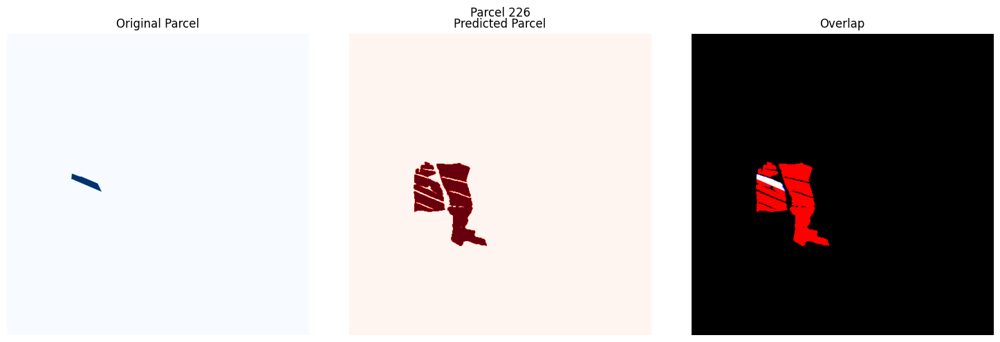

Parcel 226:
True Positive (Correctly predicted): 1781 pixels
False Negative (Missed): 177 pixels
False Positive (Overpredicted): 29388 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.91
F1 Score: 0.11




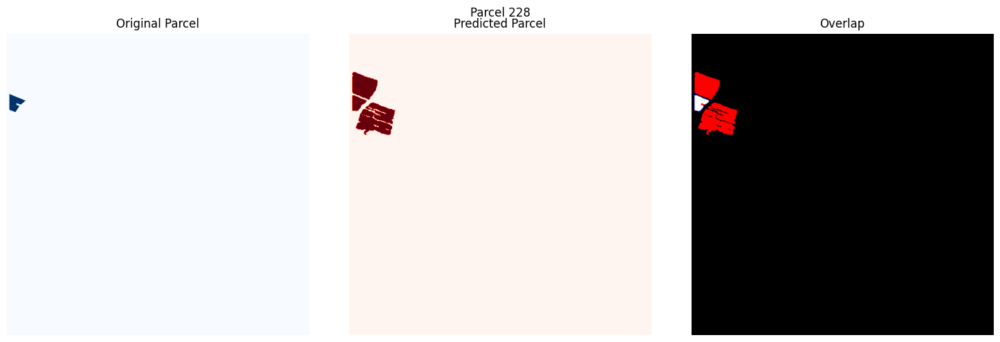

Parcel 228:
True Positive (Correctly predicted): 1519 pixels
False Negative (Missed): 253 pixels
False Positive (Overpredicted): 14228 pixels
Accuracy: 0.09
Precision: 0.10
Recall: 0.86
F1 Score: 0.17




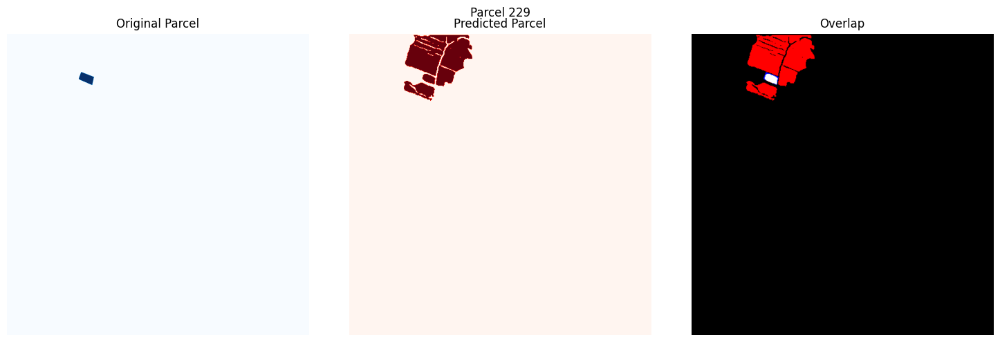

Parcel 229:
True Positive (Correctly predicted): 967 pixels
False Negative (Missed): 289 pixels
False Positive (Overpredicted): 27278 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.77
F1 Score: 0.07




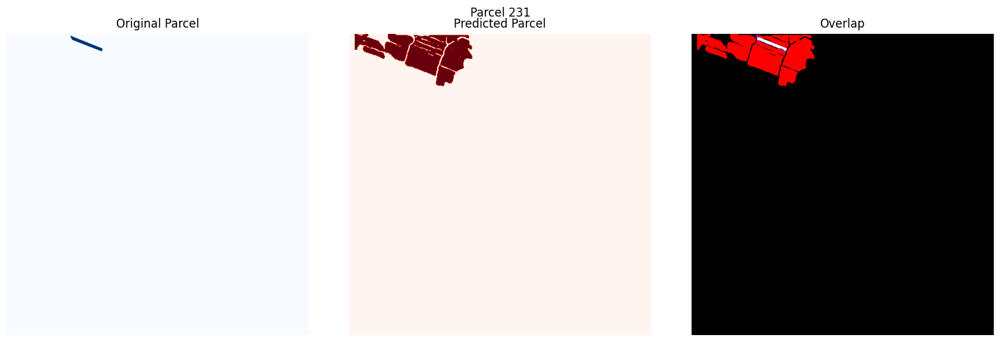

Parcel 231:
True Positive (Correctly predicted): 977 pixels
False Negative (Missed): 182 pixels
False Positive (Overpredicted): 33119 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.84
F1 Score: 0.06




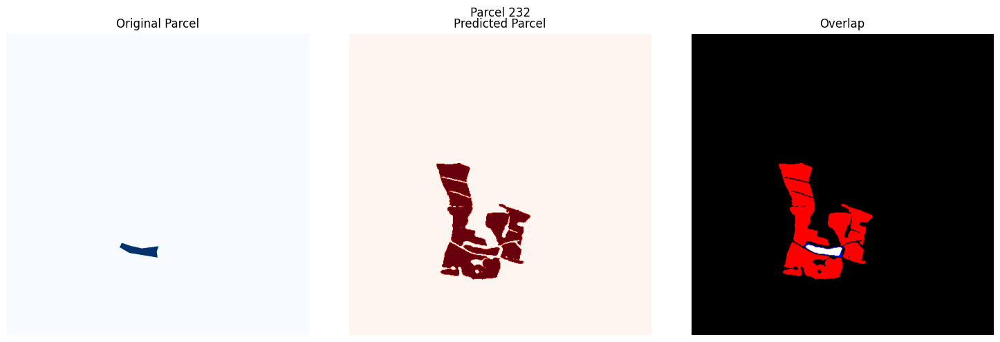

Parcel 232:
True Positive (Correctly predicted): 2342 pixels
False Negative (Missed): 770 pixels
False Positive (Overpredicted): 48543 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.75
F1 Score: 0.09




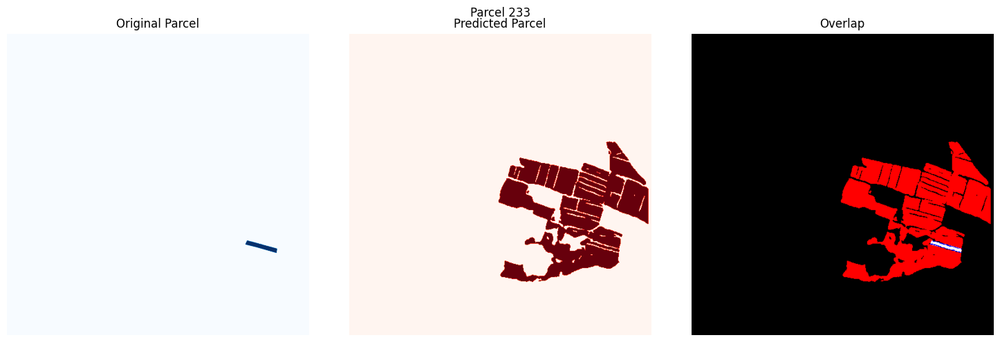

Parcel 233:
True Positive (Correctly predicted): 1012 pixels
False Negative (Missed): 523 pixels
False Positive (Overpredicted): 104491 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.66
F1 Score: 0.02




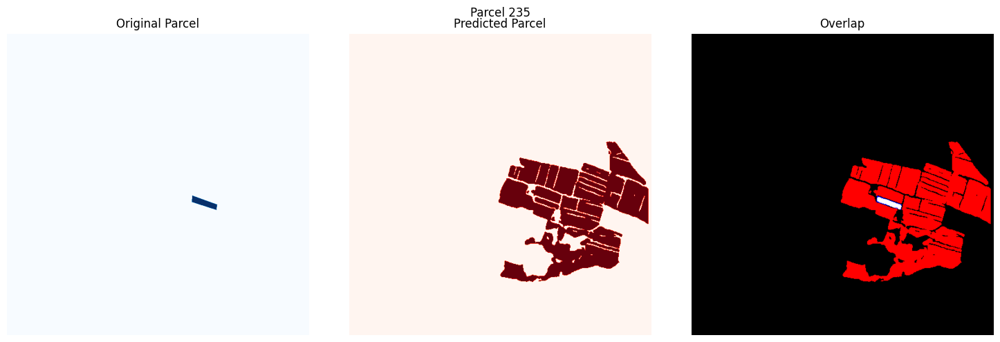

Parcel 235:
True Positive (Correctly predicted): 1311 pixels
False Negative (Missed): 379 pixels
False Positive (Overpredicted): 108483 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.78
F1 Score: 0.02




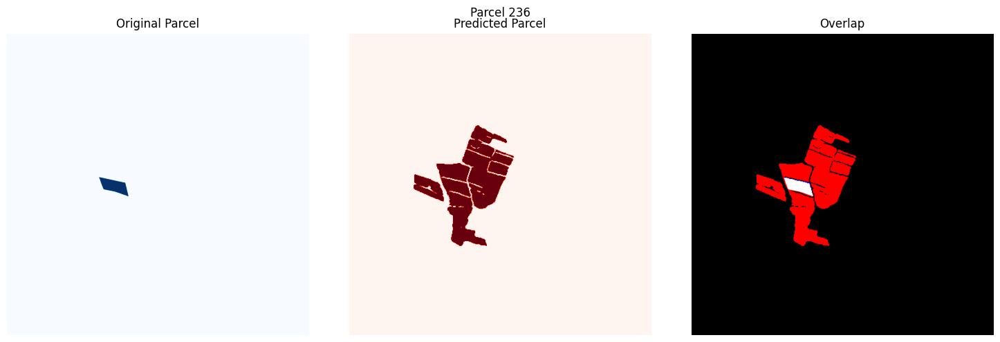

Parcel 236:
True Positive (Correctly predicted): 3065 pixels
False Negative (Missed): 196 pixels
False Positive (Overpredicted): 47640 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.94
F1 Score: 0.11




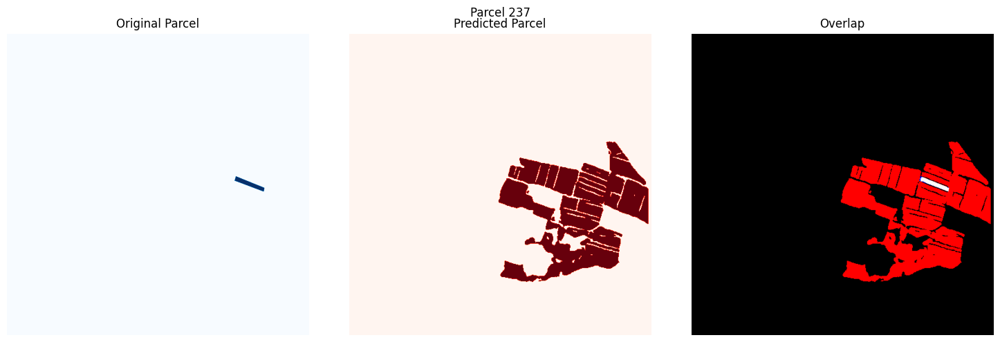

Parcel 237:
True Positive (Correctly predicted): 1333 pixels
False Negative (Missed): 128 pixels
False Positive (Overpredicted): 104170 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.91
F1 Score: 0.02




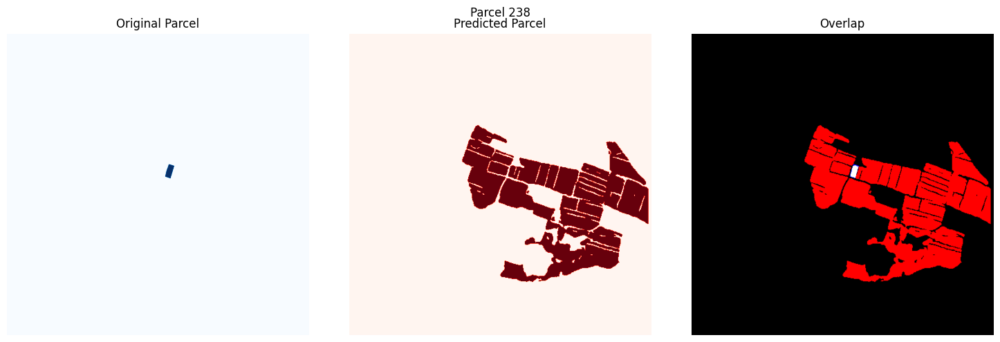

Parcel 238:
True Positive (Correctly predicted): 708 pixels
False Negative (Missed): 157 pixels
False Positive (Overpredicted): 130655 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.82
F1 Score: 0.01




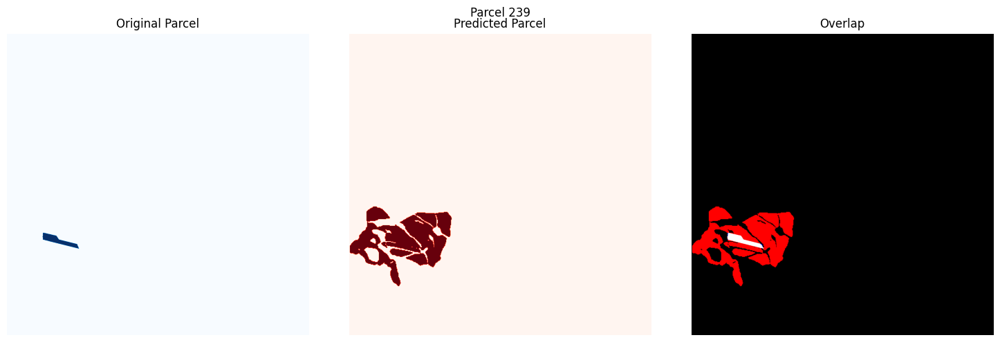

Parcel 239:
True Positive (Correctly predicted): 2085 pixels
False Negative (Missed): 42 pixels
False Positive (Overpredicted): 36563 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.98
F1 Score: 0.10




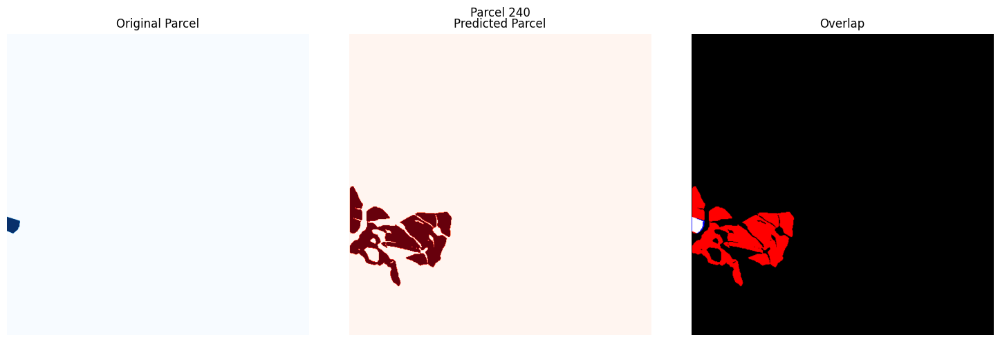

Parcel 240:
True Positive (Correctly predicted): 1438 pixels
False Negative (Missed): 334 pixels
False Positive (Overpredicted): 40834 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.81
F1 Score: 0.07




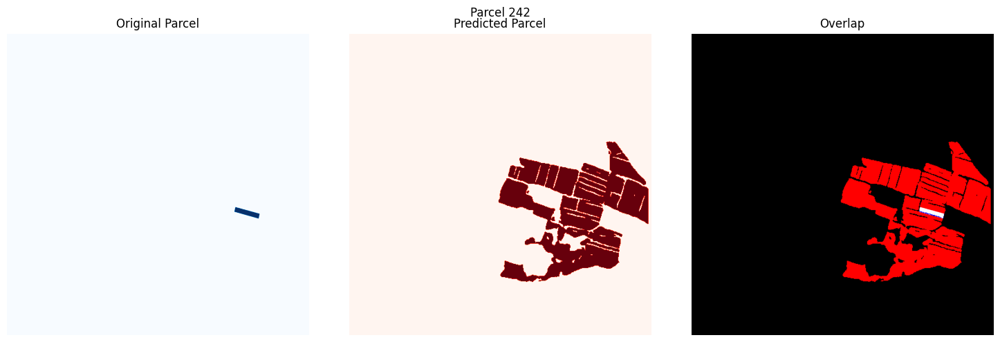

Parcel 242:
True Positive (Correctly predicted): 1151 pixels
False Negative (Missed): 215 pixels
False Positive (Overpredicted): 104352 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.84
F1 Score: 0.02




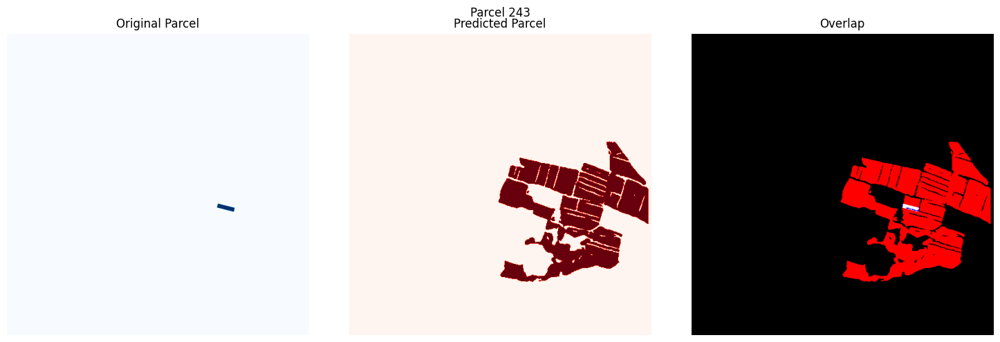

Parcel 243:
True Positive (Correctly predicted): 617 pixels
False Negative (Missed): 176 pixels
False Positive (Overpredicted): 104886 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.78
F1 Score: 0.01




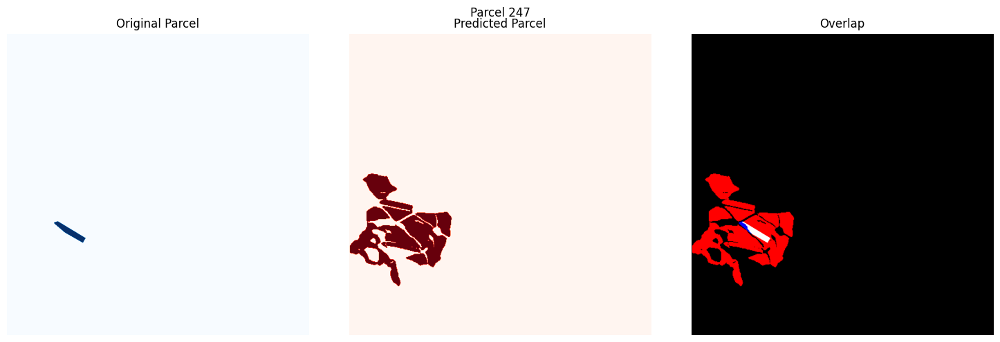

Parcel 247:
True Positive (Correctly predicted): 1633 pixels
False Negative (Missed): 427 pixels
False Positive (Overpredicted): 45721 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.79
F1 Score: 0.07




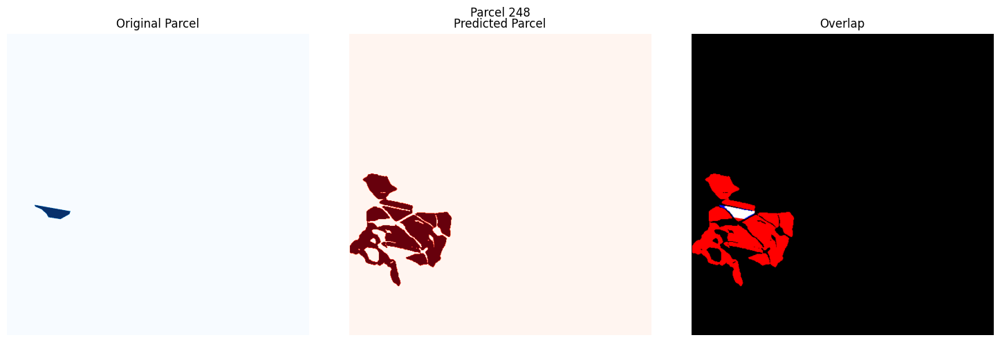

Parcel 248:
True Positive (Correctly predicted): 2198 pixels
False Negative (Missed): 390 pixels
False Positive (Overpredicted): 45156 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.85
F1 Score: 0.09




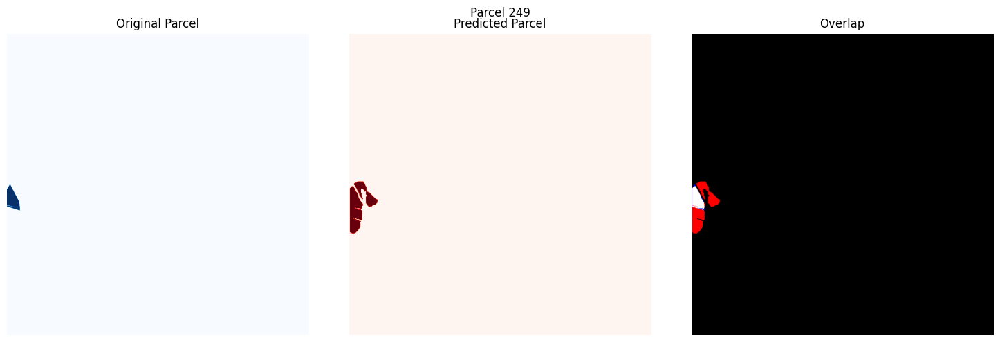

Parcel 249:
True Positive (Correctly predicted): 2046 pixels
False Negative (Missed): 270 pixels
False Positive (Overpredicted): 5346 pixels
Accuracy: 0.27
Precision: 0.28
Recall: 0.88
F1 Score: 0.42




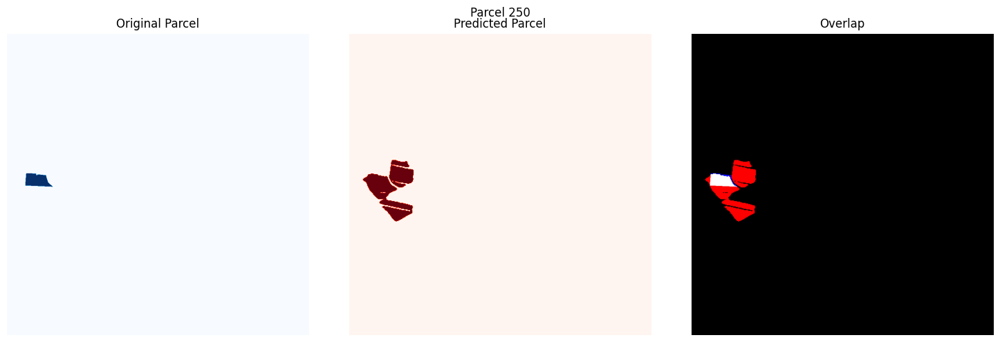

Parcel 250:
True Positive (Correctly predicted): 2623 pixels
False Negative (Missed): 325 pixels
False Positive (Overpredicted): 12722 pixels
Accuracy: 0.17
Precision: 0.17
Recall: 0.89
F1 Score: 0.29




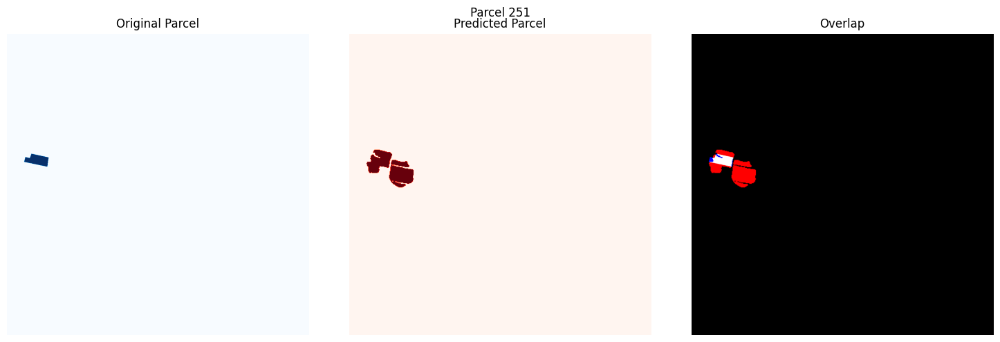

Parcel 251:
True Positive (Correctly predicted): 1850 pixels
False Negative (Missed): 328 pixels
False Positive (Overpredicted): 7616 pixels
Accuracy: 0.19
Precision: 0.20
Recall: 0.85
F1 Score: 0.32




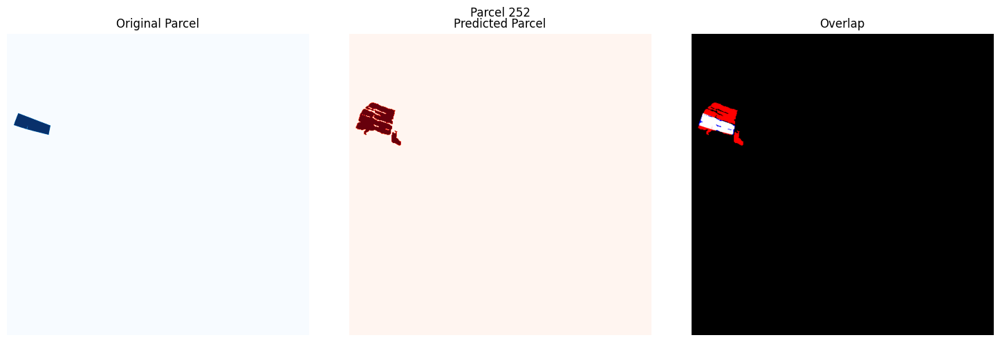

Parcel 252:
True Positive (Correctly predicted): 4057 pixels
False Negative (Missed): 378 pixels
False Positive (Overpredicted): 5603 pixels
Accuracy: 0.40
Precision: 0.42
Recall: 0.91
F1 Score: 0.58




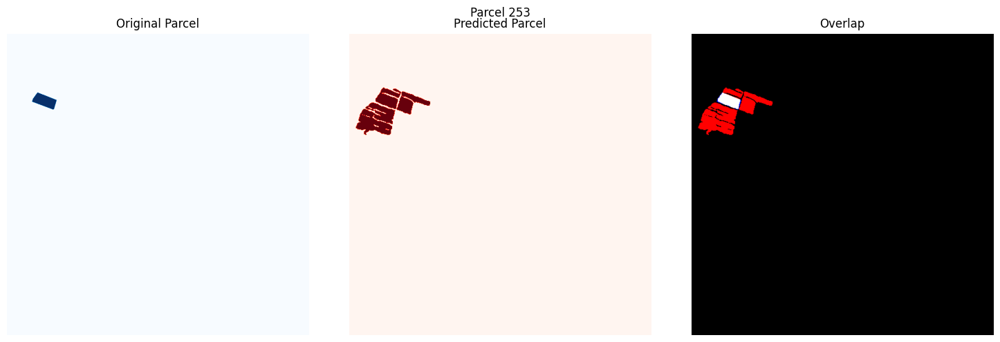

Parcel 253:
True Positive (Correctly predicted): 2352 pixels
False Negative (Missed): 207 pixels
False Positive (Overpredicted): 13823 pixels
Accuracy: 0.14
Precision: 0.15
Recall: 0.92
F1 Score: 0.25




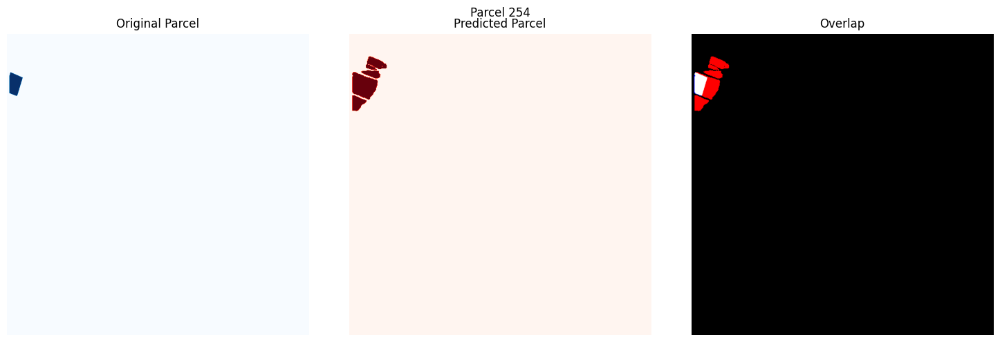

Parcel 254:
True Positive (Correctly predicted): 2288 pixels
False Negative (Missed): 161 pixels
False Positive (Overpredicted): 7761 pixels
Accuracy: 0.22
Precision: 0.23
Recall: 0.93
F1 Score: 0.37




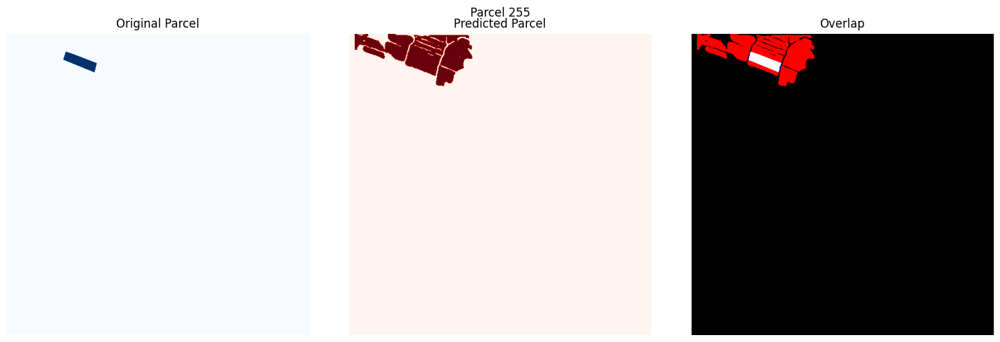

Parcel 255:
True Positive (Correctly predicted): 3288 pixels
False Negative (Missed): 102 pixels
False Positive (Overpredicted): 30808 pixels
Accuracy: 0.10
Precision: 0.10
Recall: 0.97
F1 Score: 0.18




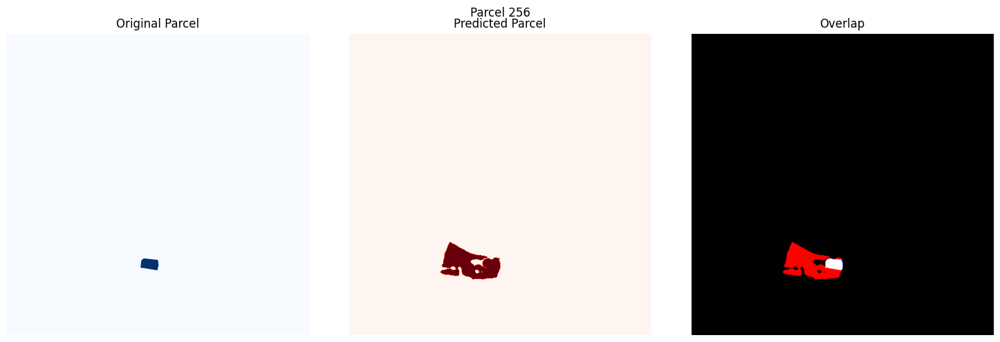

Parcel 256:
True Positive (Correctly predicted): 1794 pixels
False Negative (Missed): 81 pixels
False Positive (Overpredicted): 12125 pixels
Accuracy: 0.13
Precision: 0.13
Recall: 0.96
F1 Score: 0.23




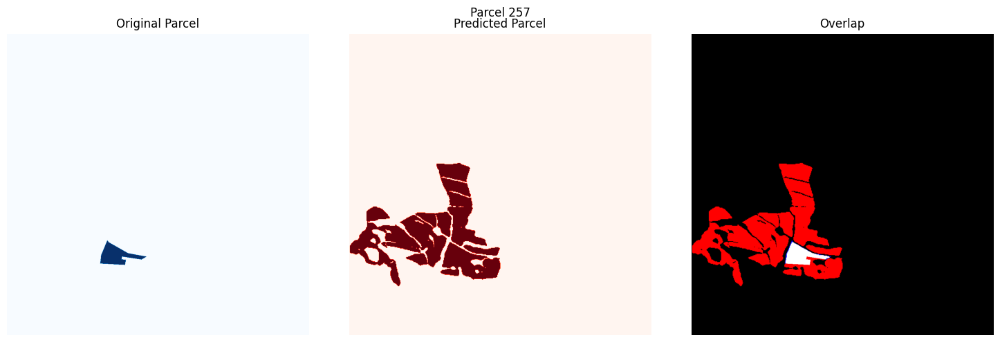

Parcel 257:
True Positive (Correctly predicted): 5143 pixels
False Negative (Missed): 323 pixels
False Positive (Overpredicted): 68415 pixels
Accuracy: 0.07
Precision: 0.07
Recall: 0.94
F1 Score: 0.13




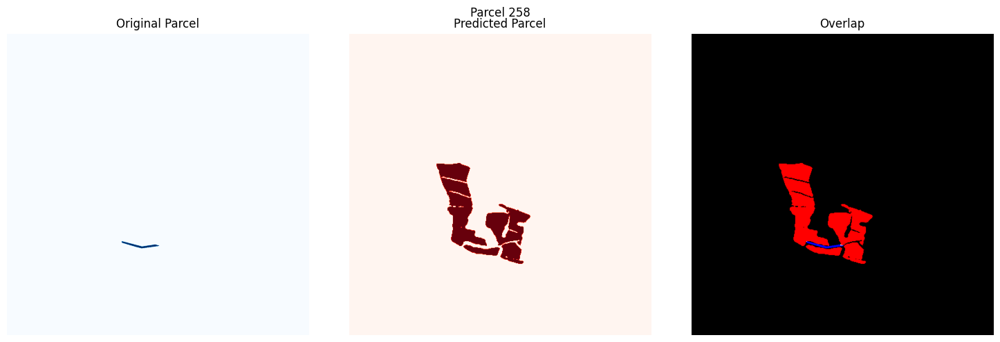

Parcel 258:
True Positive (Correctly predicted): 21 pixels
False Negative (Missed): 759 pixels
False Positive (Overpredicted): 36945 pixels
Accuracy: 0.00
Precision: 0.00
Recall: 0.03
F1 Score: 0.00




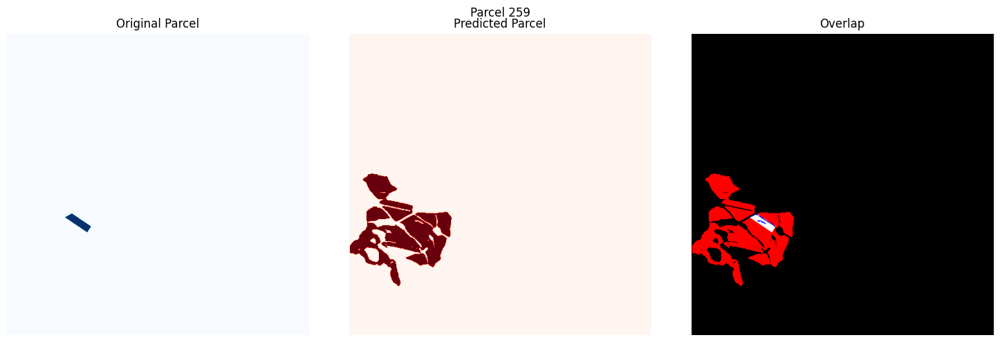

Parcel 259:
True Positive (Correctly predicted): 1609 pixels
False Negative (Missed): 359 pixels
False Positive (Overpredicted): 45745 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.82
F1 Score: 0.07




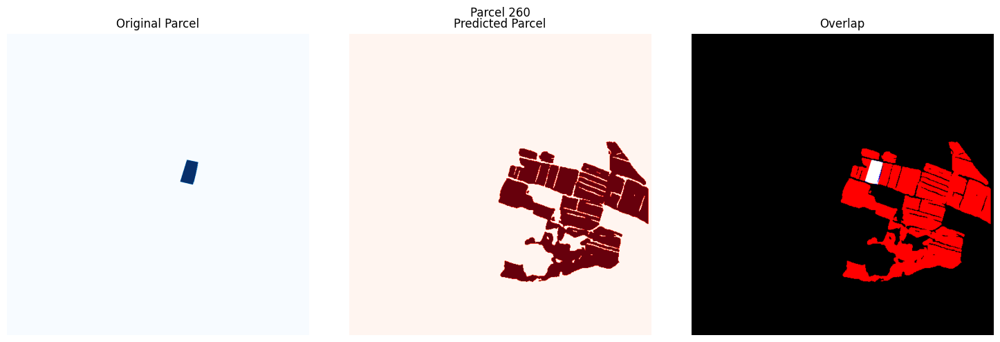

Parcel 260:
True Positive (Correctly predicted): 3063 pixels
False Negative (Missed): 140 pixels
False Positive (Overpredicted): 105336 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.96
F1 Score: 0.05




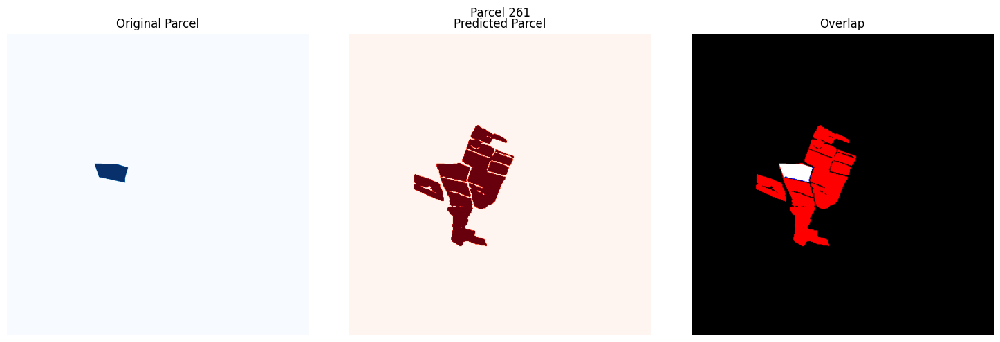

Parcel 261:
True Positive (Correctly predicted): 4691 pixels
False Negative (Missed): 257 pixels
False Positive (Overpredicted): 46014 pixels
Accuracy: 0.09
Precision: 0.09
Recall: 0.95
F1 Score: 0.17




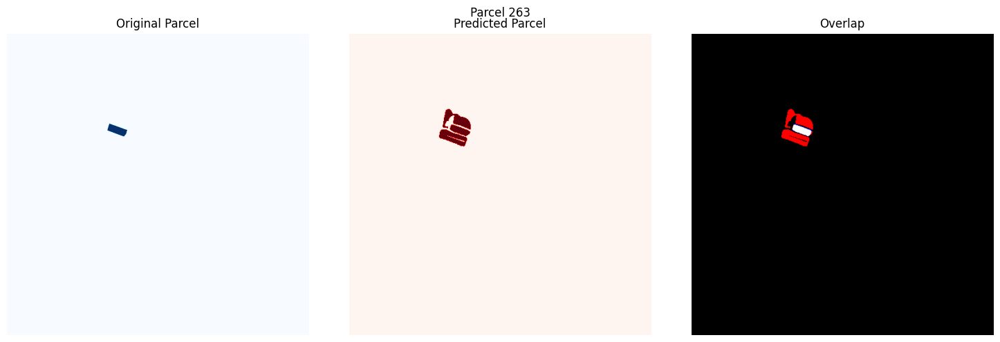

Parcel 263:
True Positive (Correctly predicted): 1310 pixels
False Negative (Missed): 176 pixels
False Positive (Overpredicted): 5683 pixels
Accuracy: 0.18
Precision: 0.19
Recall: 0.88
F1 Score: 0.31




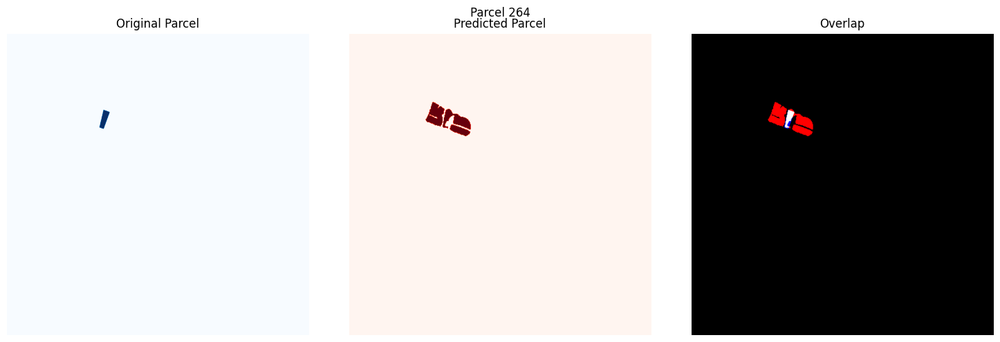

Parcel 264:
True Positive (Correctly predicted): 878 pixels
False Negative (Missed): 246 pixels
False Positive (Overpredicted): 6393 pixels
Accuracy: 0.12
Precision: 0.12
Recall: 0.78
F1 Score: 0.21




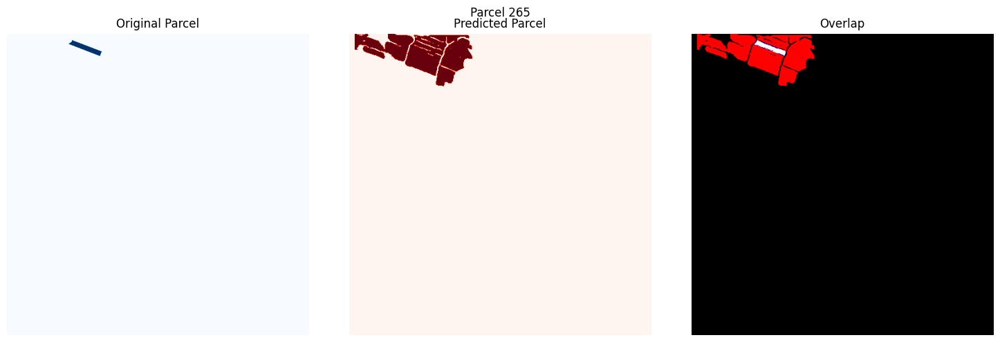

Parcel 265:
True Positive (Correctly predicted): 1484 pixels
False Negative (Missed): 264 pixels
False Positive (Overpredicted): 32612 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.85
F1 Score: 0.08




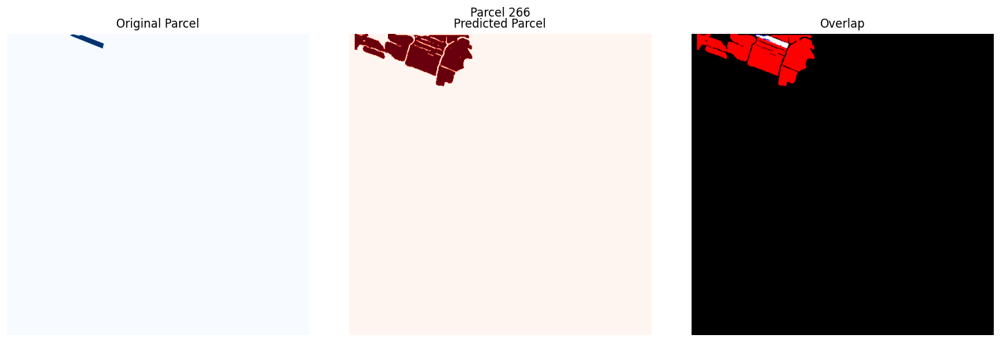

Parcel 266:
True Positive (Correctly predicted): 1417 pixels
False Negative (Missed): 208 pixels
False Positive (Overpredicted): 32679 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.87
F1 Score: 0.08




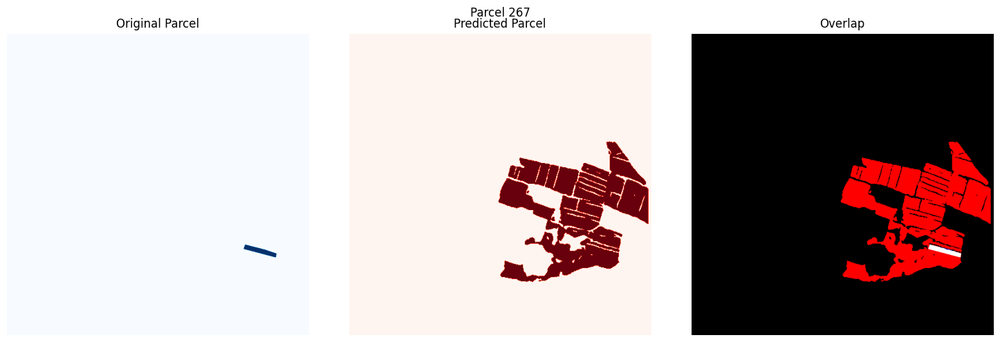

Parcel 267:
True Positive (Correctly predicted): 1662 pixels
False Negative (Missed): 53 pixels
False Positive (Overpredicted): 103841 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.97
F1 Score: 0.03




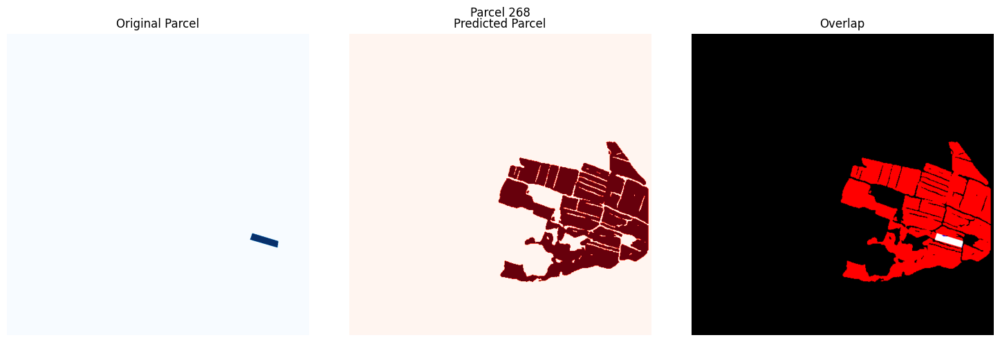

Parcel 268:
True Positive (Correctly predicted): 2023 pixels
False Negative (Missed): 51 pixels
False Positive (Overpredicted): 117251 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.98
F1 Score: 0.03




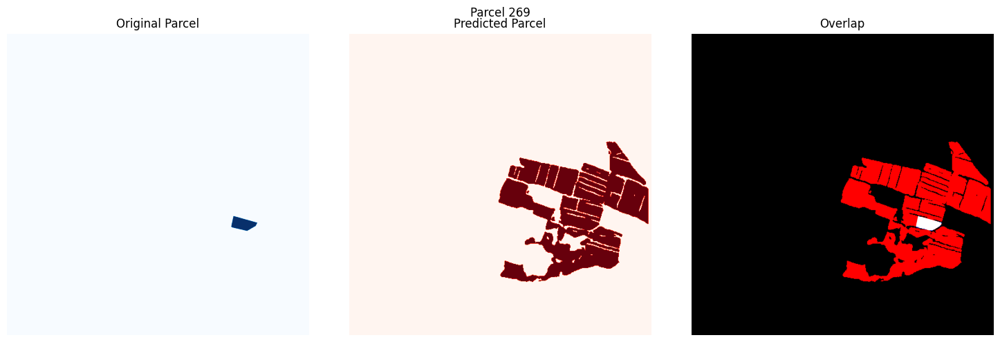

Parcel 269:
True Positive (Correctly predicted): 2548 pixels
False Negative (Missed): 61 pixels
False Positive (Overpredicted): 102955 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.98
F1 Score: 0.05




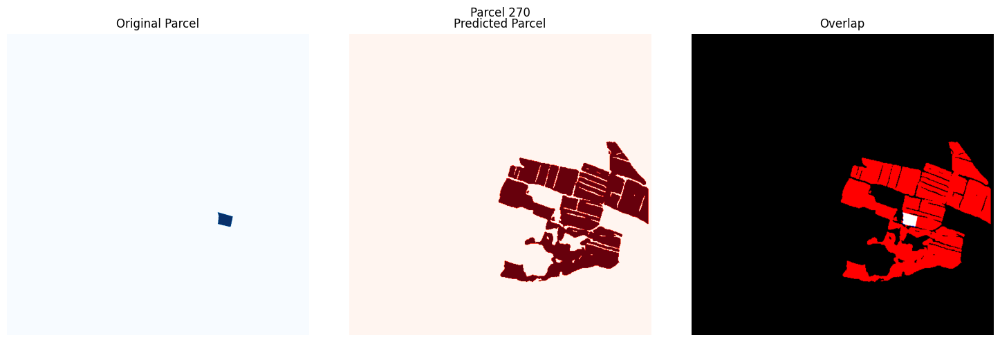

Parcel 270:
True Positive (Correctly predicted): 1641 pixels
False Negative (Missed): 65 pixels
False Positive (Overpredicted): 103862 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.96
F1 Score: 0.03




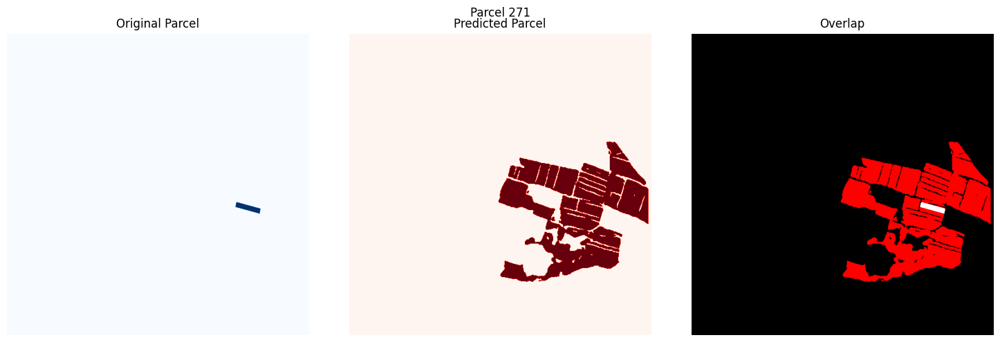

Parcel 271:
True Positive (Correctly predicted): 1426 pixels
False Negative (Missed): 3 pixels
False Positive (Overpredicted): 104077 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 1.00
F1 Score: 0.03




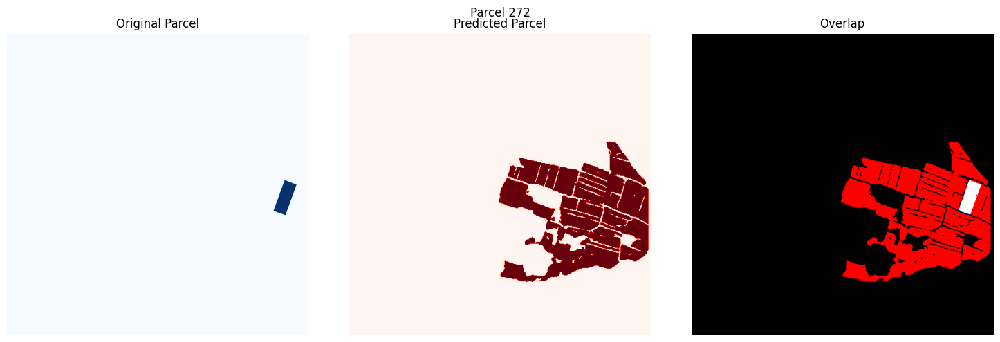

Parcel 272:
True Positive (Correctly predicted): 4424 pixels
False Negative (Missed): 153 pixels
False Positive (Overpredicted): 114850 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.97
F1 Score: 0.07




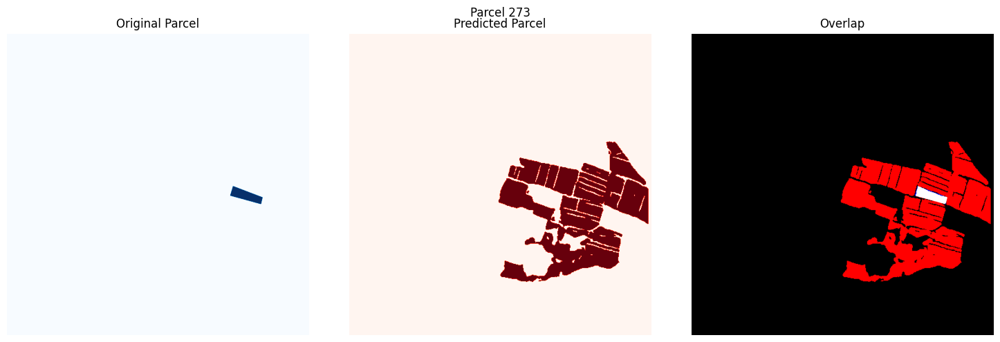

Parcel 273:
True Positive (Correctly predicted): 2829 pixels
False Negative (Missed): 211 pixels
False Positive (Overpredicted): 102674 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.93
F1 Score: 0.05




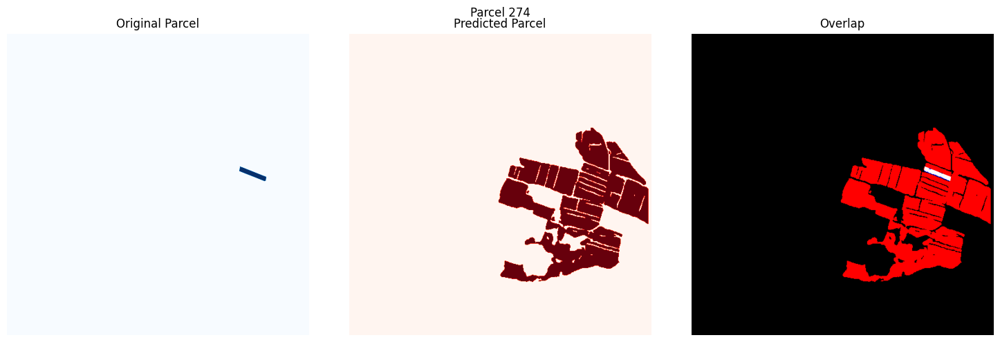

Parcel 274:
True Positive (Correctly predicted): 1238 pixels
False Negative (Missed): 210 pixels
False Positive (Overpredicted): 114363 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.85
F1 Score: 0.02




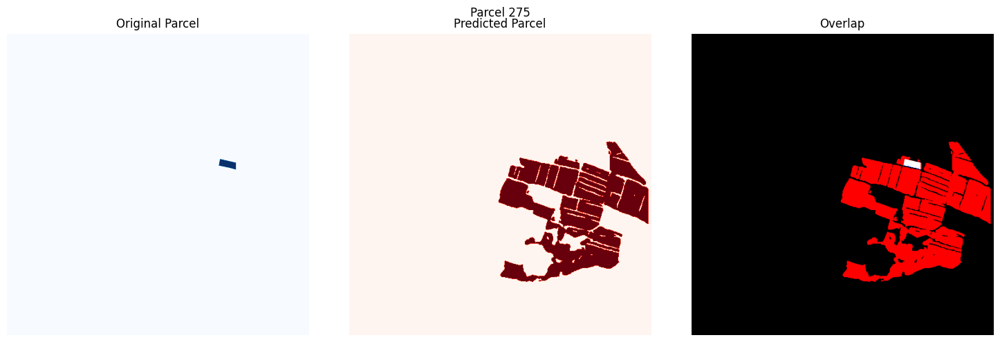

Parcel 275:
True Positive (Correctly predicted): 1185 pixels
False Negative (Missed): 57 pixels
False Positive (Overpredicted): 106372 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.95
F1 Score: 0.02




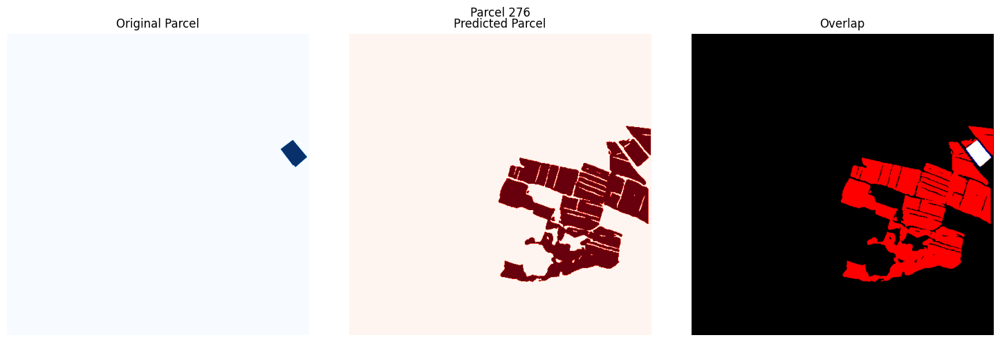

Parcel 276:
True Positive (Correctly predicted): 3669 pixels
False Negative (Missed): 319 pixels
False Positive (Overpredicted): 110161 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.92
F1 Score: 0.06




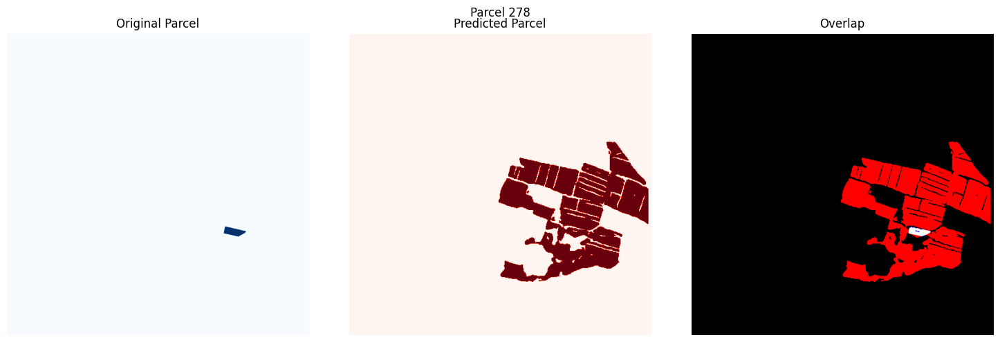

Parcel 278:
True Positive (Correctly predicted): 1348 pixels
False Negative (Missed): 121 pixels
False Positive (Overpredicted): 104155 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.92
F1 Score: 0.03




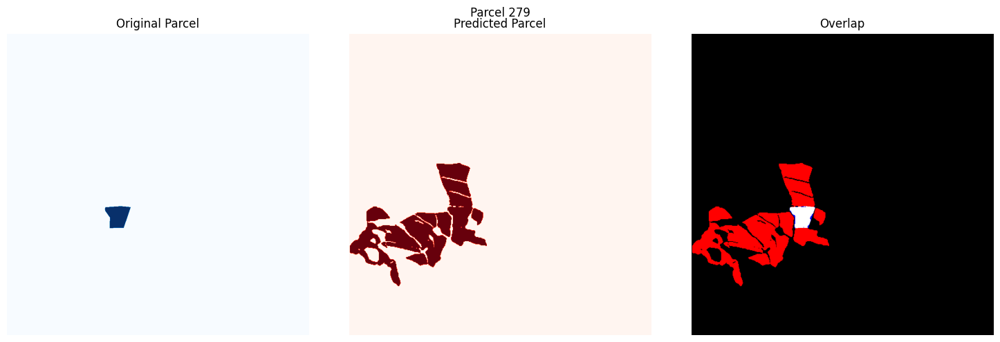

Parcel 279:
True Positive (Correctly predicted): 4150 pixels
False Negative (Missed): 331 pixels
False Positive (Overpredicted): 54593 pixels
Accuracy: 0.07
Precision: 0.07
Recall: 0.93
F1 Score: 0.13




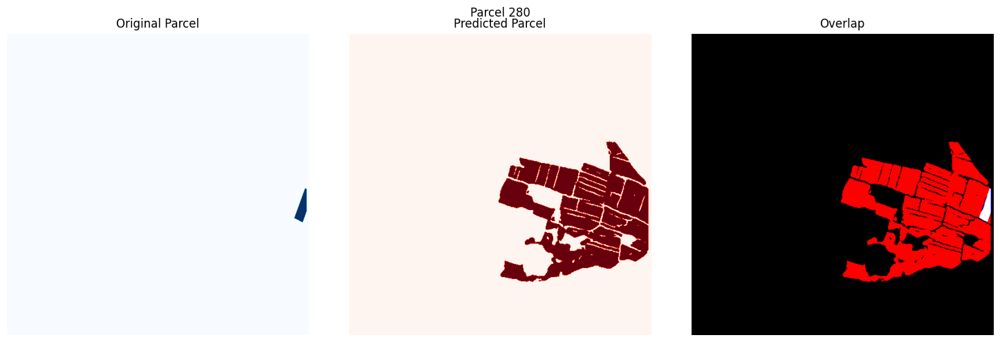

Parcel 280:
True Positive (Correctly predicted): 2158 pixels
False Negative (Missed): 282 pixels
False Positive (Overpredicted): 117116 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.88
F1 Score: 0.04




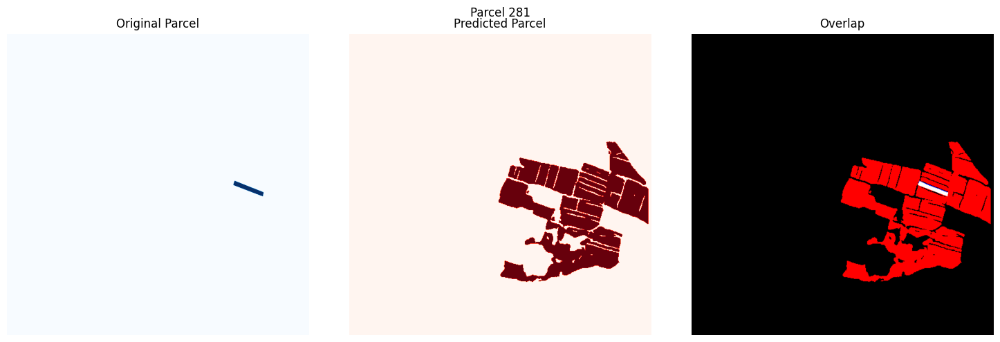

Parcel 281:
True Positive (Correctly predicted): 1329 pixels
False Negative (Missed): 188 pixels
False Positive (Overpredicted): 104174 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.88
F1 Score: 0.02




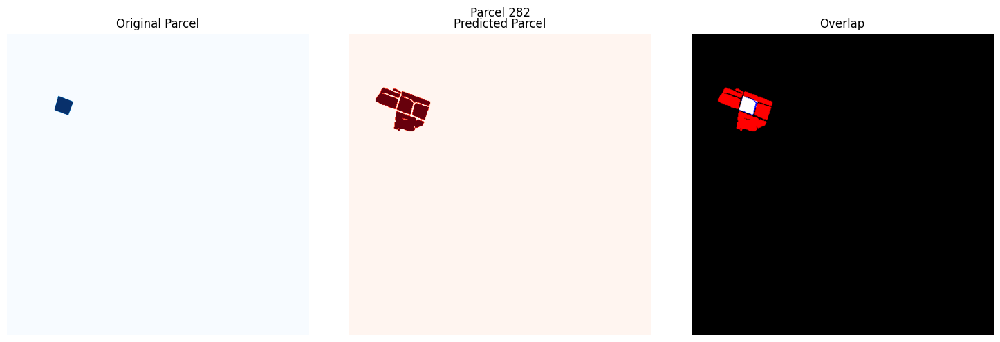

Parcel 282:
True Positive (Correctly predicted): 2190 pixels
False Negative (Missed): 312 pixels
False Positive (Overpredicted): 11245 pixels
Accuracy: 0.16
Precision: 0.16
Recall: 0.88
F1 Score: 0.27




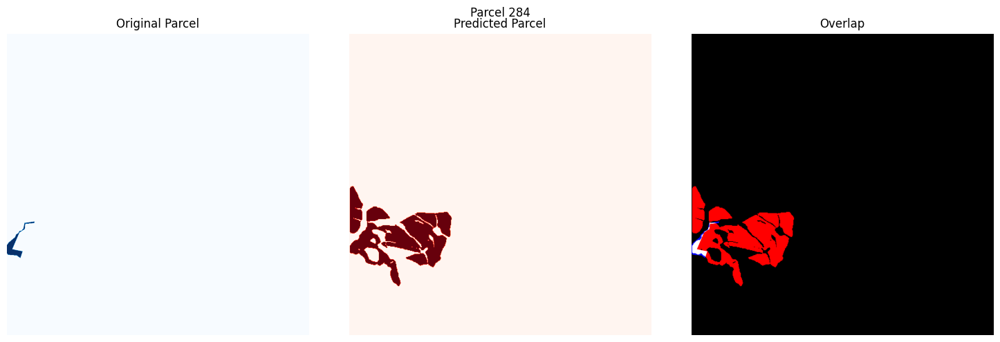

Parcel 284:
True Positive (Correctly predicted): 1397 pixels
False Negative (Missed): 641 pixels
False Positive (Overpredicted): 40875 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.69
F1 Score: 0.06




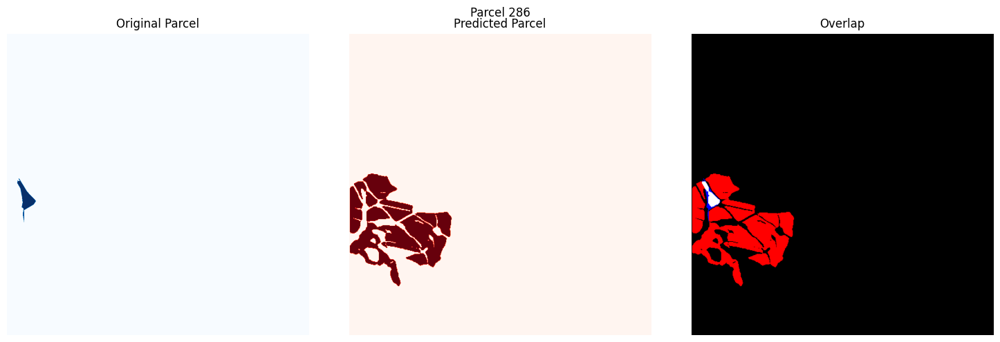

Parcel 286:
True Positive (Correctly predicted): 1705 pixels
False Negative (Missed): 894 pixels
False Positive (Overpredicted): 53041 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.66
F1 Score: 0.06




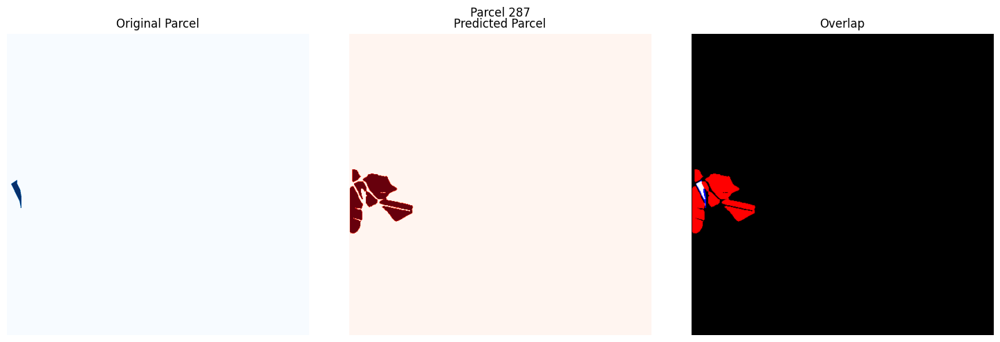

Parcel 287:
True Positive (Correctly predicted): 700 pixels
False Negative (Missed): 492 pixels
False Positive (Overpredicted): 17546 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.59
F1 Score: 0.07




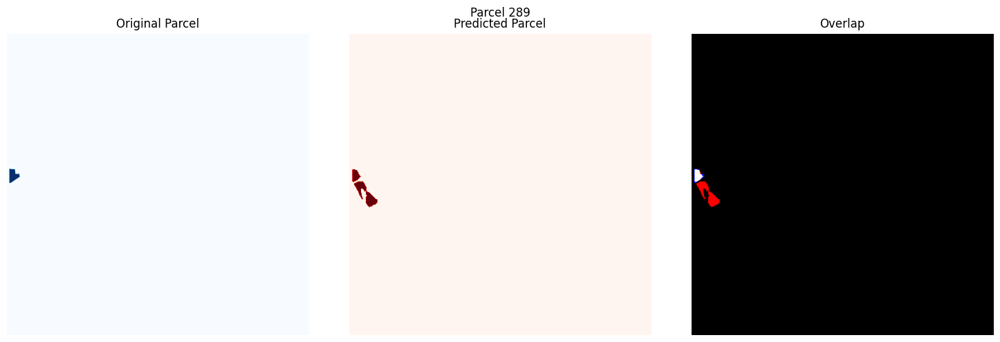

Parcel 289:
True Positive (Correctly predicted): 790 pixels
False Negative (Missed): 244 pixels
False Positive (Overpredicted): 2454 pixels
Accuracy: 0.23
Precision: 0.24
Recall: 0.76
F1 Score: 0.37




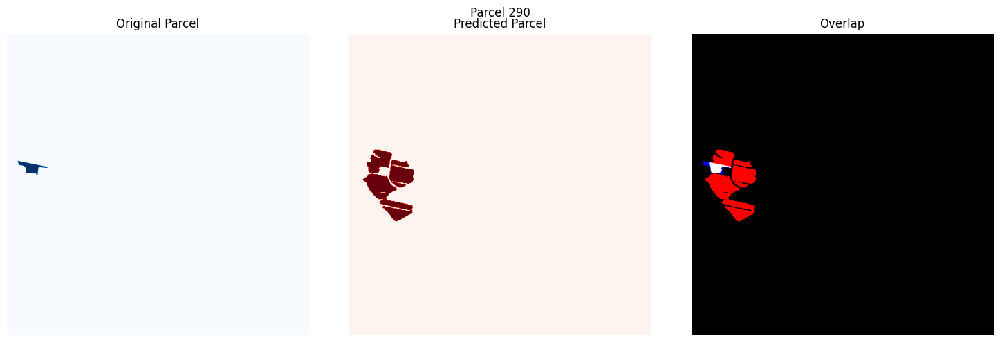

Parcel 290:
True Positive (Correctly predicted): 1288 pixels
False Negative (Missed): 539 pixels
False Positive (Overpredicted): 18220 pixels
Accuracy: 0.06
Precision: 0.07
Recall: 0.70
F1 Score: 0.12




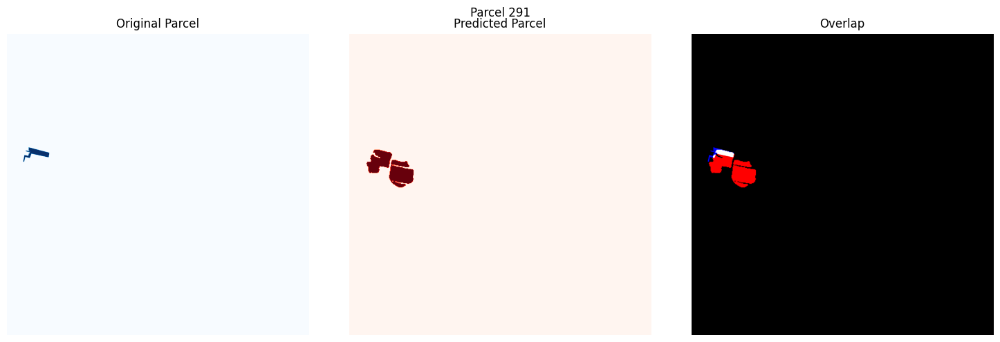

Parcel 291:
True Positive (Correctly predicted): 966 pixels
False Negative (Missed): 485 pixels
False Positive (Overpredicted): 8500 pixels
Accuracy: 0.10
Precision: 0.10
Recall: 0.67
F1 Score: 0.18




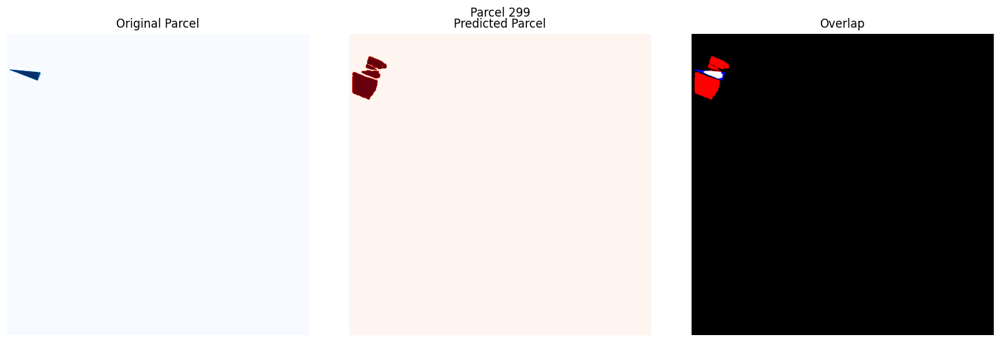

Parcel 299:
True Positive (Correctly predicted): 1012 pixels
False Negative (Missed): 558 pixels
False Positive (Overpredicted): 7450 pixels
Accuracy: 0.11
Precision: 0.12
Recall: 0.64
F1 Score: 0.20




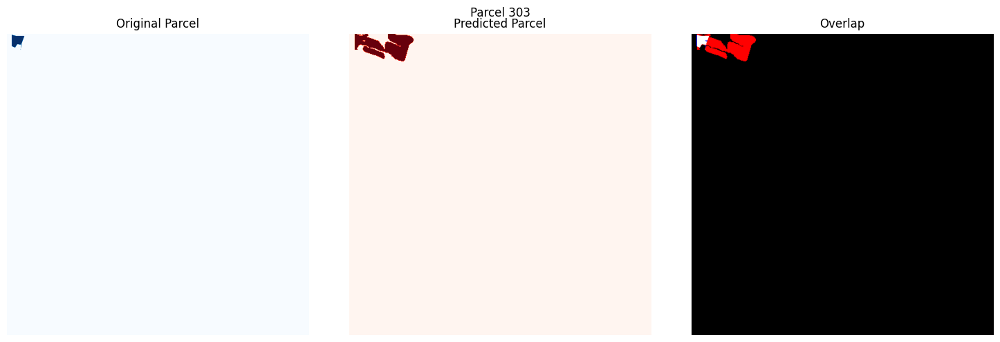

Parcel 303:
True Positive (Correctly predicted): 1120 pixels
False Negative (Missed): 108 pixels
False Positive (Overpredicted): 9196 pixels
Accuracy: 0.11
Precision: 0.11
Recall: 0.91
F1 Score: 0.19




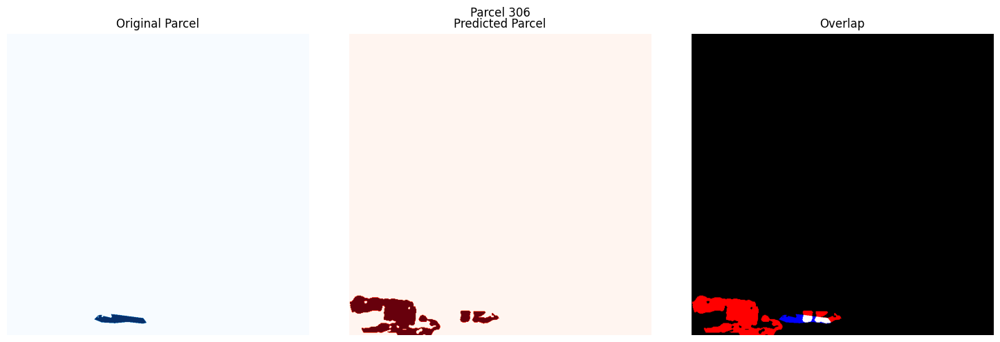

Parcel 306:
True Positive (Correctly predicted): 1486 pixels
False Negative (Missed): 1985 pixels
False Positive (Overpredicted): 21680 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.43
F1 Score: 0.11




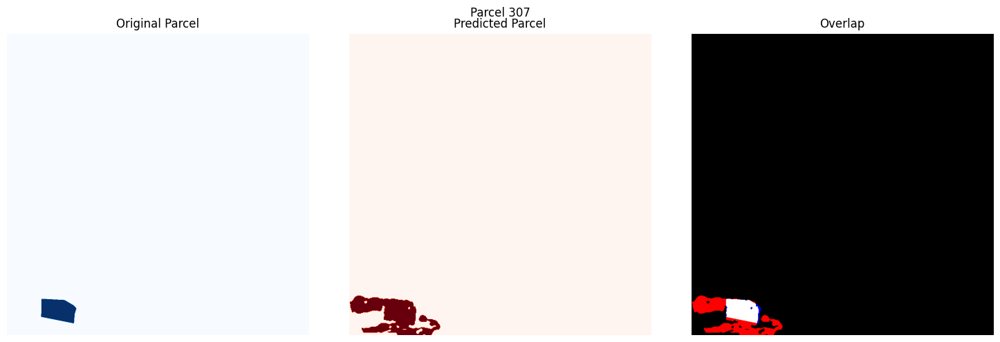

Parcel 307:
True Positive (Correctly predicted): 6815 pixels
False Negative (Missed): 485 pixels
False Positive (Overpredicted): 13144 pixels
Accuracy: 0.33
Precision: 0.34
Recall: 0.93
F1 Score: 0.50




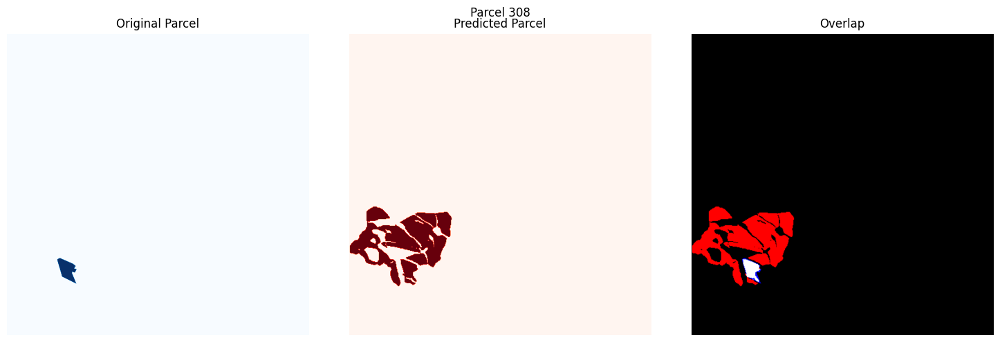

Parcel 308:
True Positive (Correctly predicted): 2384 pixels
False Negative (Missed): 592 pixels
False Positive (Overpredicted): 37768 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.80
F1 Score: 0.11




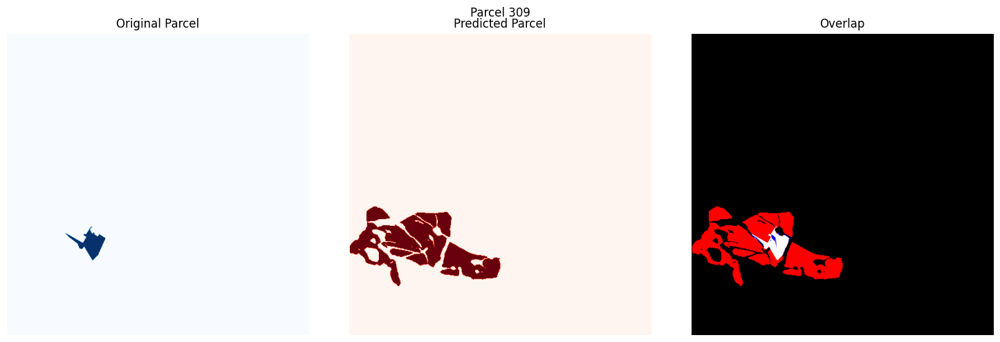

Parcel 309:
True Positive (Correctly predicted): 4491 pixels
False Negative (Missed): 516 pixels
False Positive (Overpredicted): 48076 pixels
Accuracy: 0.08
Precision: 0.09
Recall: 0.90
F1 Score: 0.16




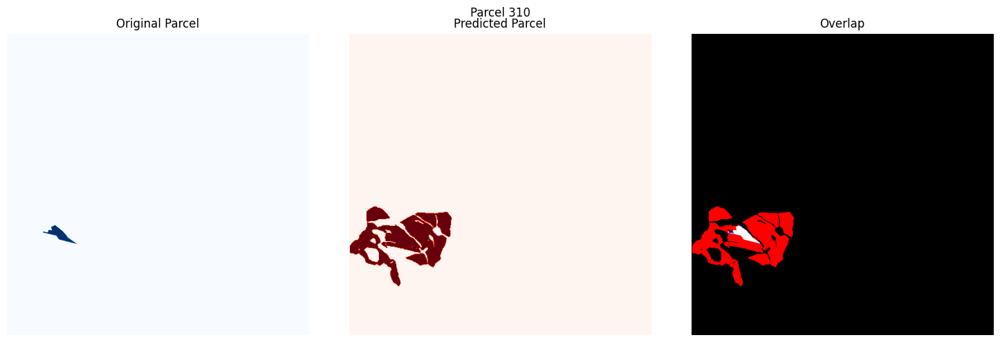

Parcel 310:
True Positive (Correctly predicted): 1936 pixels
False Negative (Missed): 98 pixels
False Positive (Overpredicted): 35376 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.95
F1 Score: 0.10




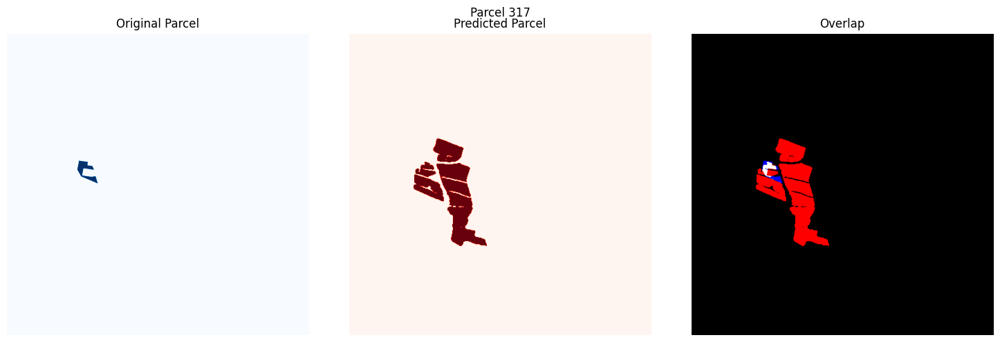

Parcel 317:
True Positive (Correctly predicted): 1011 pixels
False Negative (Missed): 891 pixels
False Positive (Overpredicted): 31153 pixels
Accuracy: 0.03
Precision: 0.03
Recall: 0.53
F1 Score: 0.06




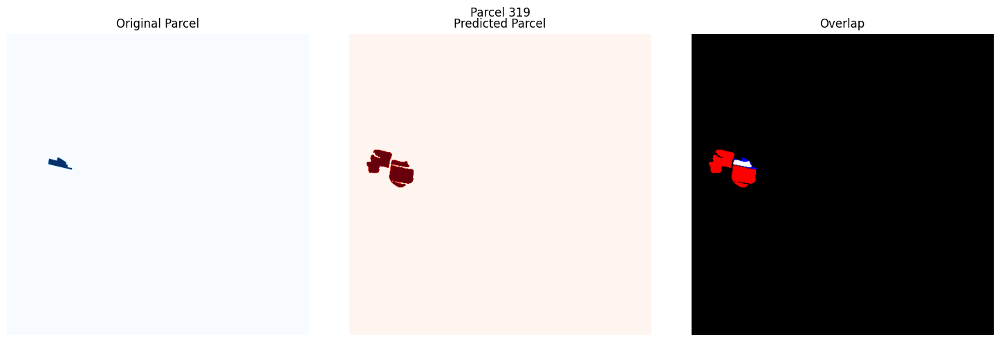

Parcel 319:
True Positive (Correctly predicted): 929 pixels
False Negative (Missed): 541 pixels
False Positive (Overpredicted): 8537 pixels
Accuracy: 0.09
Precision: 0.10
Recall: 0.63
F1 Score: 0.17




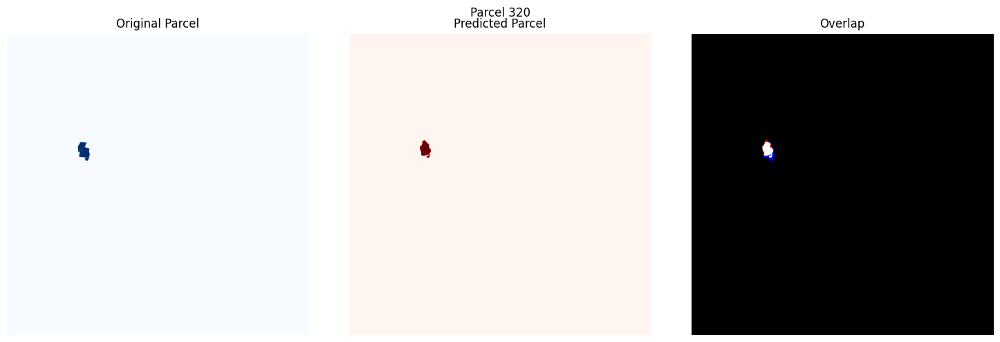

Parcel 320:
True Positive (Correctly predicted): 1214 pixels
False Negative (Missed): 407 pixels
False Positive (Overpredicted): 154 pixels
Accuracy: 0.68
Precision: 0.89
Recall: 0.75
F1 Score: 0.81




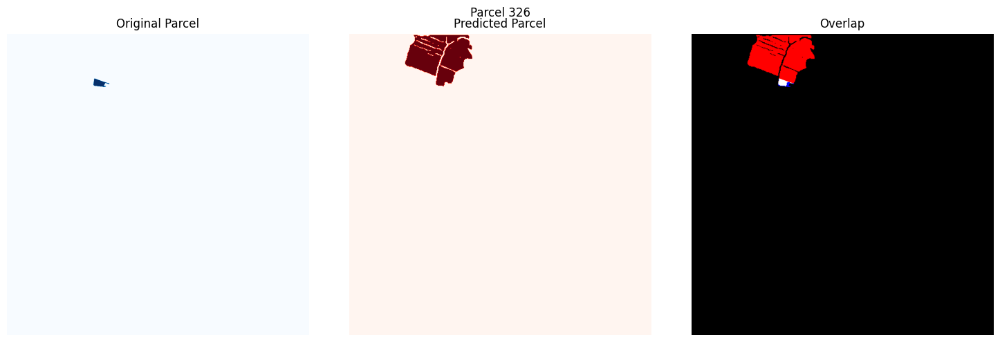

Parcel 326:
True Positive (Correctly predicted): 571 pixels
False Negative (Missed): 228 pixels
False Positive (Overpredicted): 23209 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.71
F1 Score: 0.05




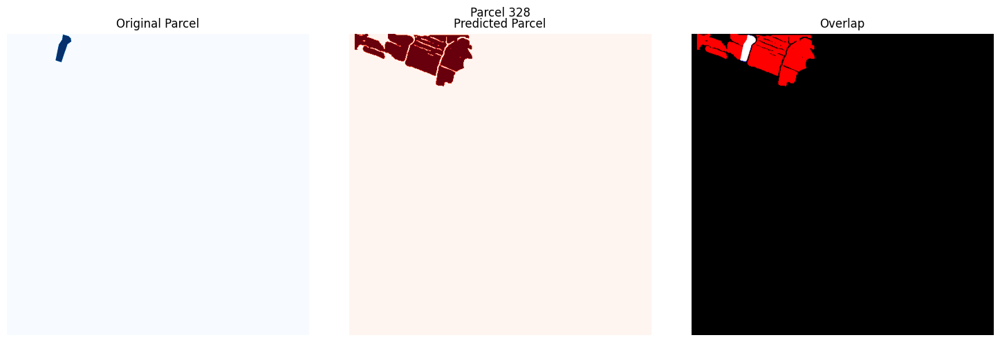

Parcel 328:
True Positive (Correctly predicted): 2186 pixels
False Negative (Missed): 80 pixels
False Positive (Overpredicted): 31910 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.96
F1 Score: 0.12




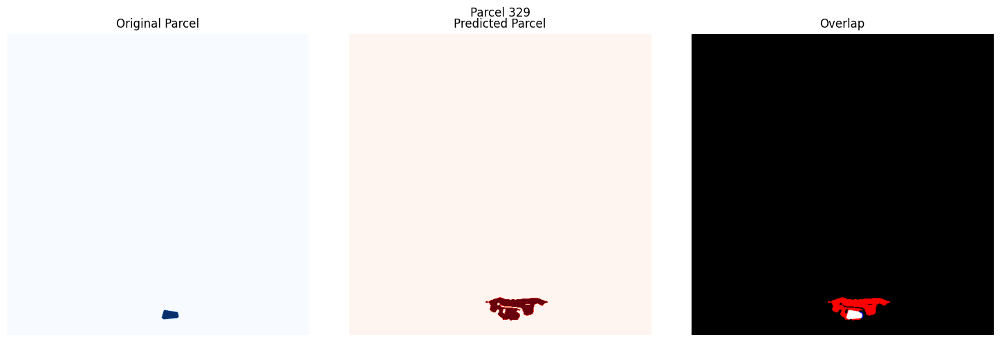

Parcel 329:
True Positive (Correctly predicted): 1237 pixels
False Negative (Missed): 100 pixels
False Positive (Overpredicted): 7173 pixels
Accuracy: 0.15
Precision: 0.15
Recall: 0.93
F1 Score: 0.25




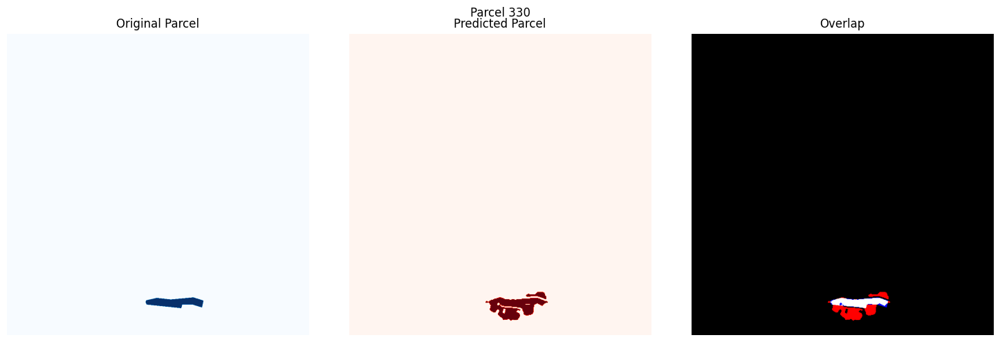

Parcel 330:
True Positive (Correctly predicted): 4063 pixels
False Negative (Missed): 525 pixels
False Positive (Overpredicted): 5137 pixels
Accuracy: 0.42
Precision: 0.44
Recall: 0.89
F1 Score: 0.59




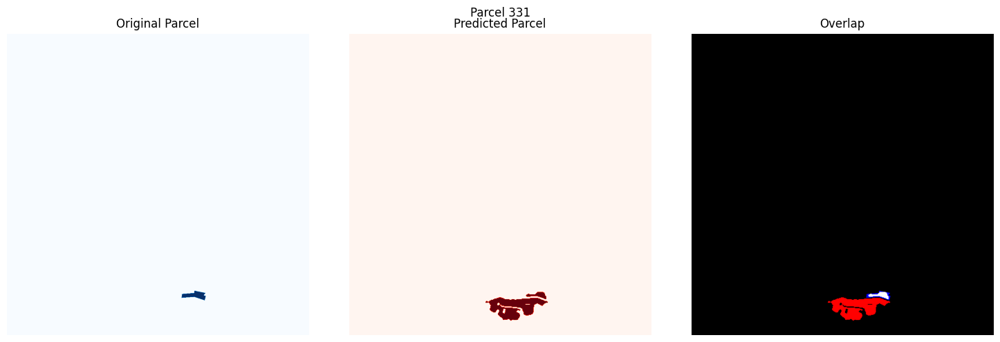

Parcel 331:
True Positive (Correctly predicted): 790 pixels
False Negative (Missed): 558 pixels
False Positive (Overpredicted): 8410 pixels
Accuracy: 0.08
Precision: 0.09
Recall: 0.59
F1 Score: 0.15




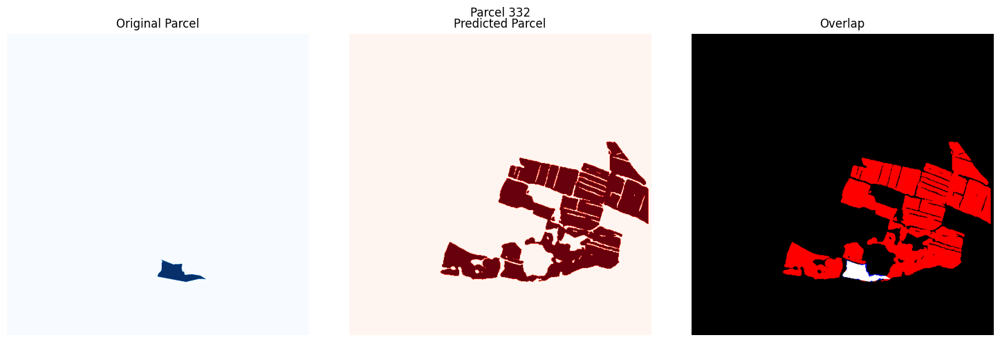

Parcel 332:
True Positive (Correctly predicted): 4634 pixels
False Negative (Missed): 577 pixels
False Positive (Overpredicted): 118401 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.89
F1 Score: 0.07




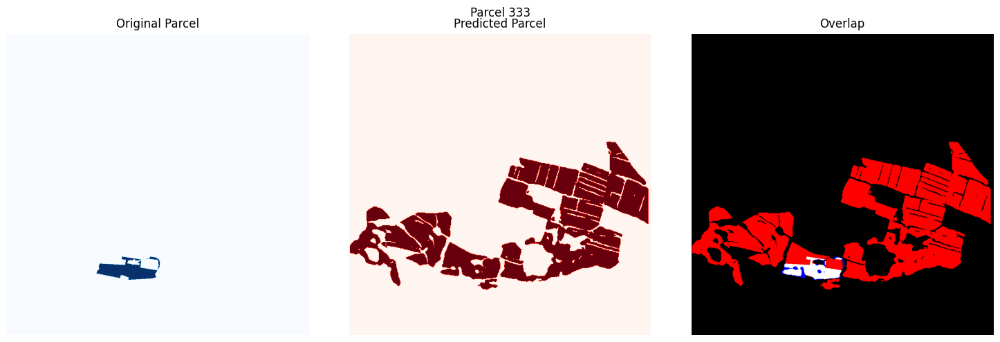

Parcel 333:
True Positive (Correctly predicted): 6882 pixels
False Negative (Missed): 1609 pixels
False Positive (Overpredicted): 154779 pixels
Accuracy: 0.04
Precision: 0.04
Recall: 0.81
F1 Score: 0.08




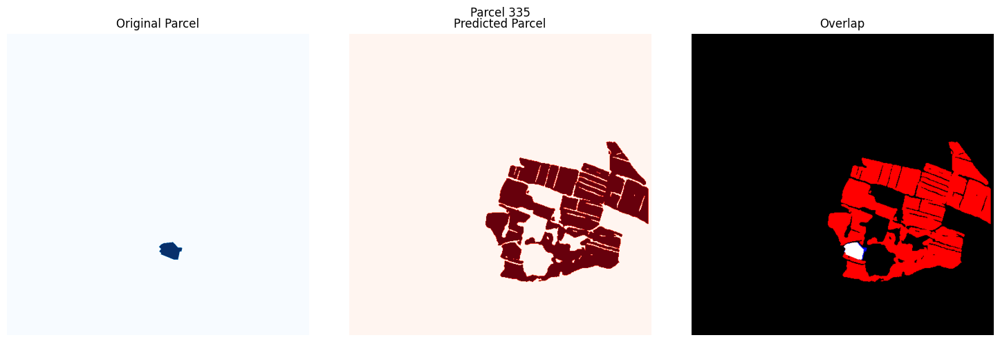

Parcel 335:
True Positive (Correctly predicted): 2660 pixels
False Negative (Missed): 320 pixels
False Positive (Overpredicted): 117482 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.89
F1 Score: 0.04




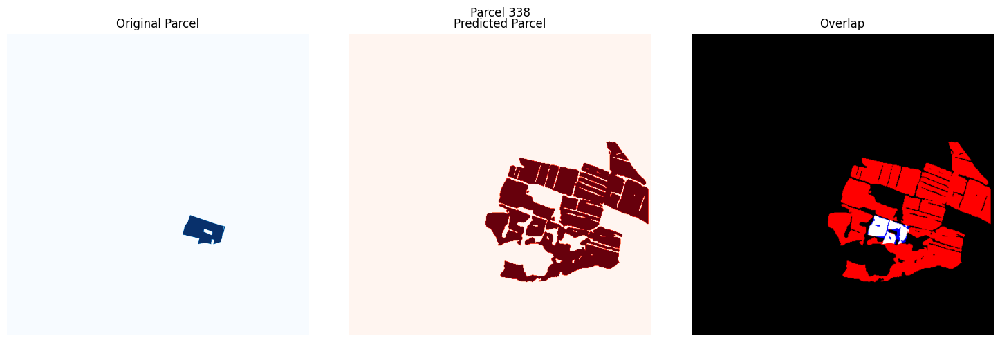

Parcel 338:
True Positive (Correctly predicted): 6417 pixels
False Negative (Missed): 1624 pixels
False Positive (Overpredicted): 113383 pixels
Accuracy: 0.05
Precision: 0.05
Recall: 0.80
F1 Score: 0.10




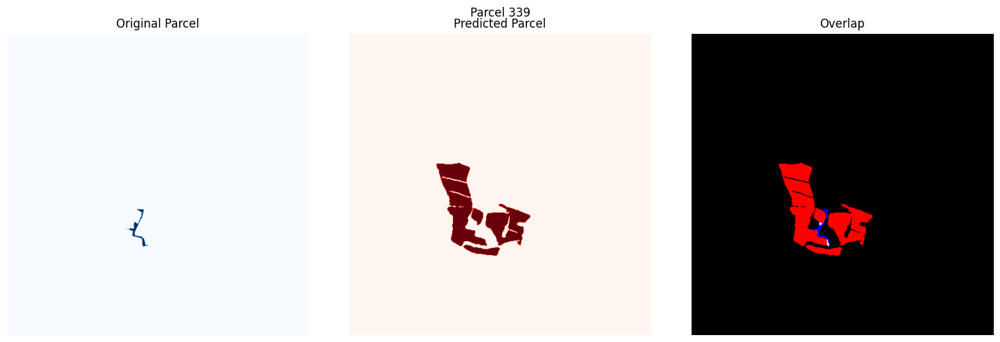

Parcel 339:
True Positive (Correctly predicted): 180 pixels
False Negative (Missed): 1025 pixels
False Positive (Overpredicted): 34621 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.15
F1 Score: 0.01




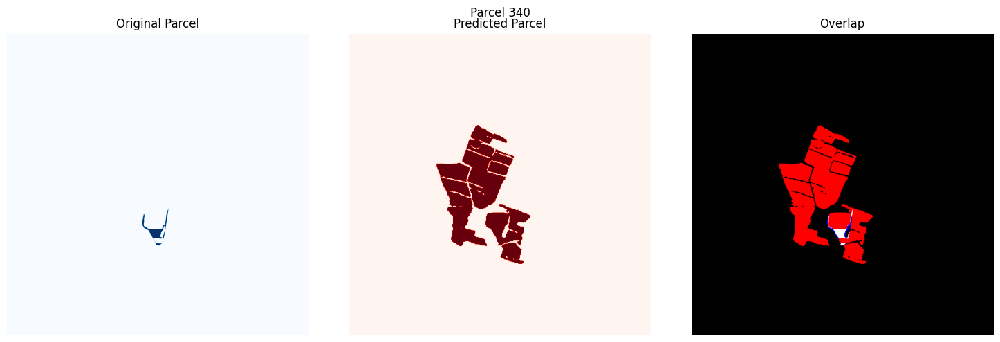

Parcel 340:
True Positive (Correctly predicted): 1251 pixels
False Negative (Missed): 622 pixels
False Positive (Overpredicted): 59231 pixels
Accuracy: 0.02
Precision: 0.02
Recall: 0.67
F1 Score: 0.04




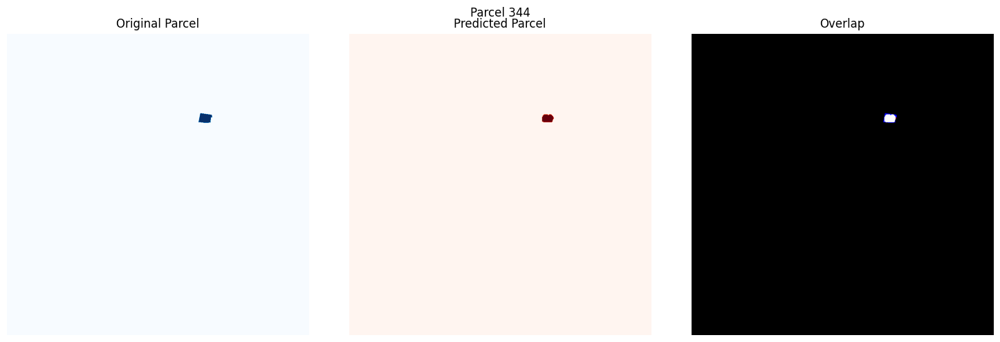

Parcel 344:
True Positive (Correctly predicted): 874 pixels
False Negative (Missed): 264 pixels
False Positive (Overpredicted): 8 pixels
Accuracy: 0.76
Precision: 0.99
Recall: 0.77
F1 Score: 0.87




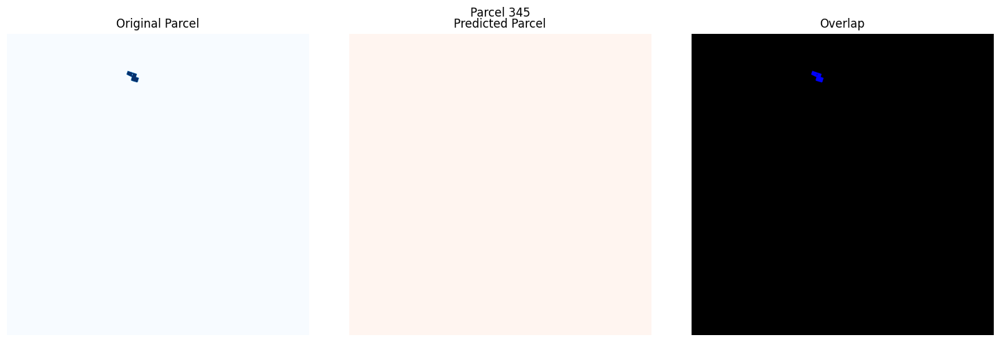

Parcel 345:
True Positive (Correctly predicted): 0 pixels
False Negative (Missed): 791 pixels
False Positive (Overpredicted): 0 pixels
Accuracy: 0.00
Precision: 0.00
Recall: 0.00
F1 Score: 0.00




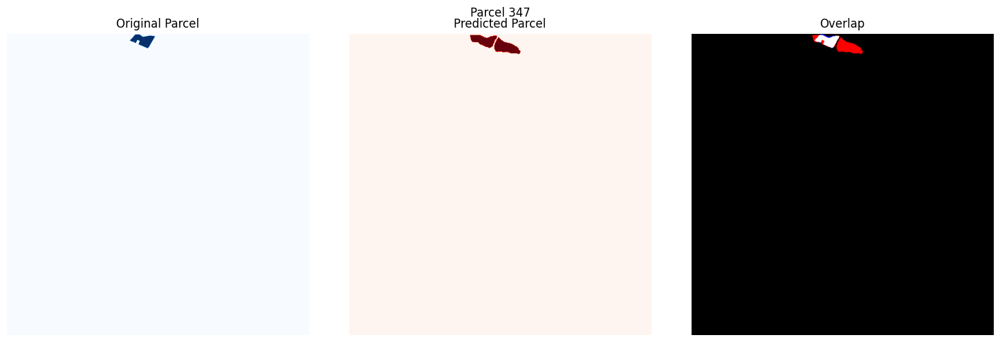

Parcel 347:
True Positive (Correctly predicted): 1898 pixels
False Negative (Missed): 170 pixels
False Positive (Overpredicted): 3149 pixels
Accuracy: 0.36
Precision: 0.38
Recall: 0.92
F1 Score: 0.53




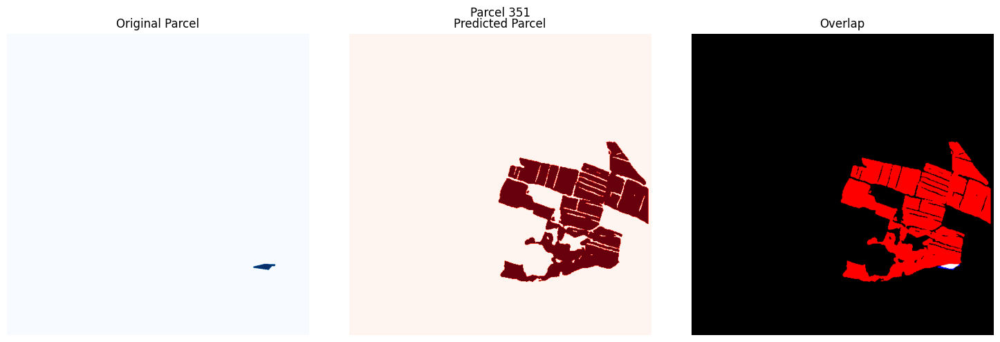

Parcel 351:
True Positive (Correctly predicted): 617 pixels
False Negative (Missed): 286 pixels
False Positive (Overpredicted): 104886 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.68
F1 Score: 0.01




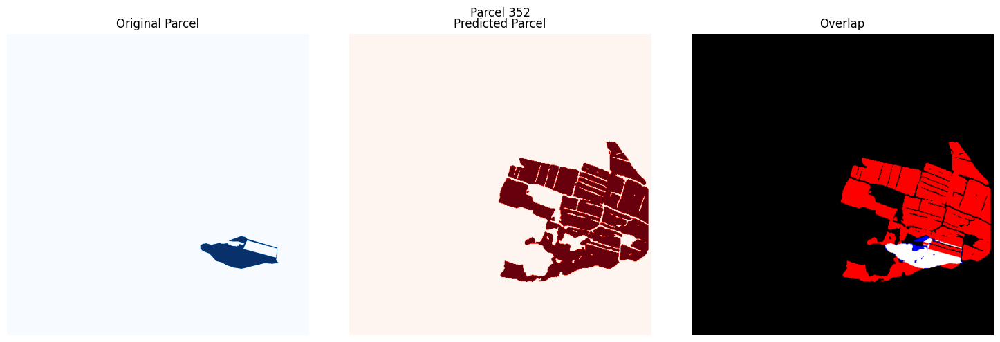

Parcel 352:
True Positive (Correctly predicted): 11895 pixels
False Negative (Missed): 1754 pixels
False Positive (Overpredicted): 107379 pixels
Accuracy: 0.10
Precision: 0.10
Recall: 0.87
F1 Score: 0.18




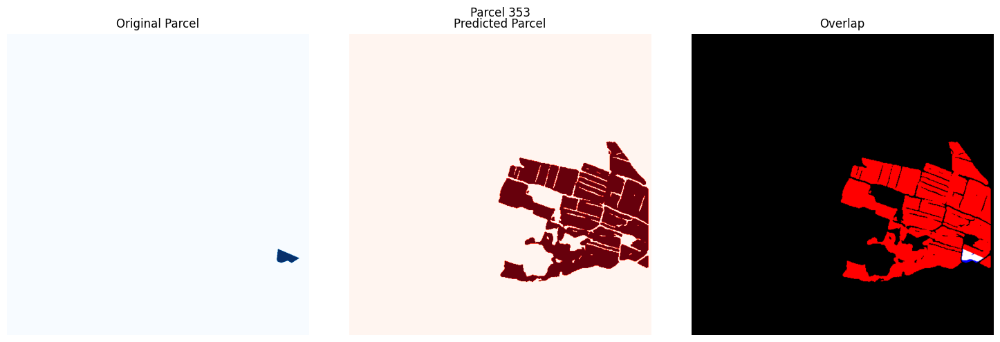

Parcel 353:
True Positive (Correctly predicted): 1562 pixels
False Negative (Missed): 414 pixels
False Positive (Overpredicted): 118609 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.79
F1 Score: 0.03




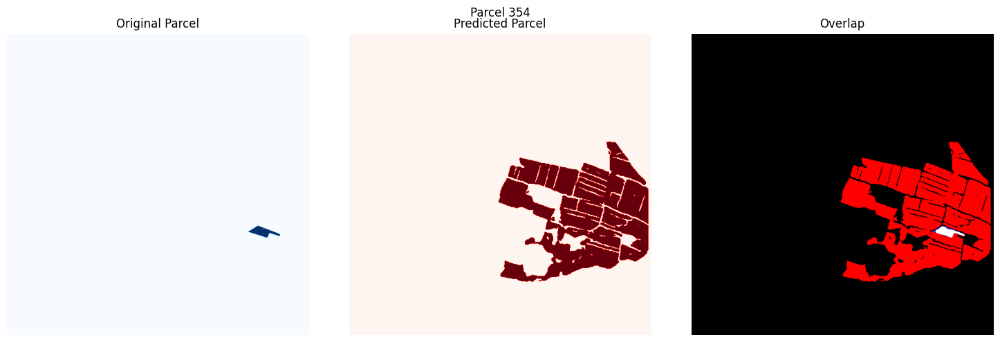

Parcel 354:
True Positive (Correctly predicted): 1652 pixels
False Negative (Missed): 200 pixels
False Positive (Overpredicted): 117622 pixels
Accuracy: 0.01
Precision: 0.01
Recall: 0.89
F1 Score: 0.03




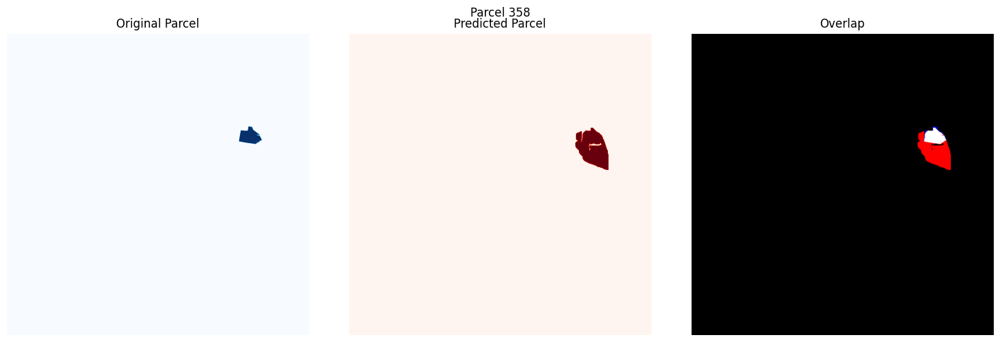

Parcel 358:
True Positive (Correctly predicted): 2587 pixels
False Negative (Missed): 228 pixels
False Positive (Overpredicted): 7511 pixels
Accuracy: 0.25
Precision: 0.26
Recall: 0.92
F1 Score: 0.40




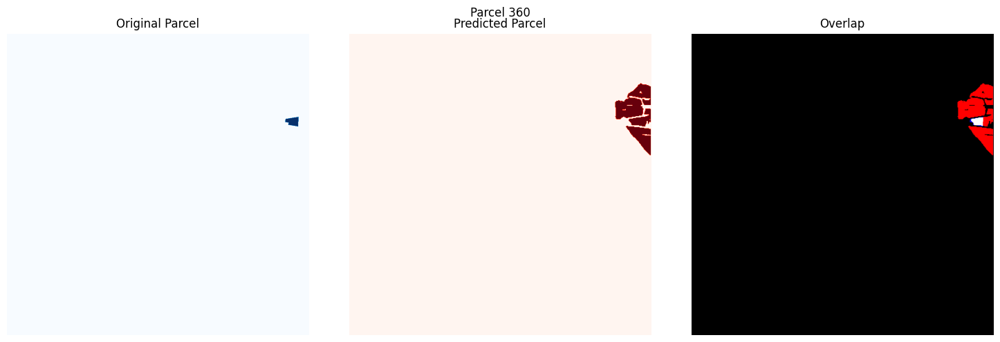

Parcel 360:
True Positive (Correctly predicted): 864 pixels
False Negative (Missed): 145 pixels
False Positive (Overpredicted): 13461 pixels
Accuracy: 0.06
Precision: 0.06
Recall: 0.86
F1 Score: 0.11




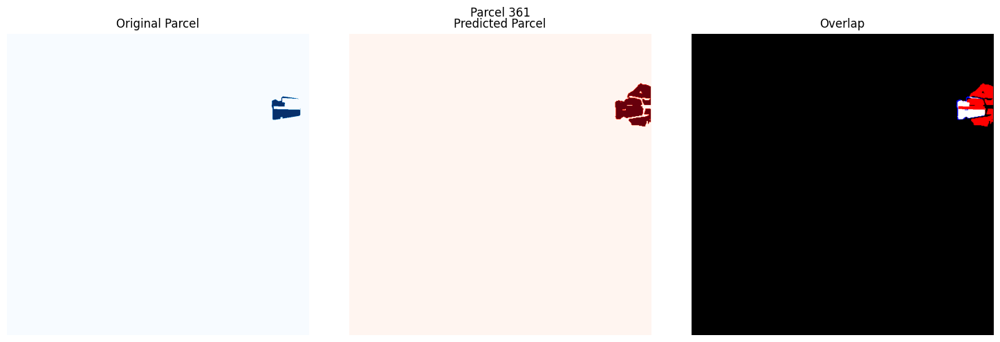

Parcel 361:
True Positive (Correctly predicted): 3066 pixels
False Negative (Missed): 570 pixels
False Positive (Overpredicted): 7316 pixels
Accuracy: 0.28
Precision: 0.30
Recall: 0.84
F1 Score: 0.44




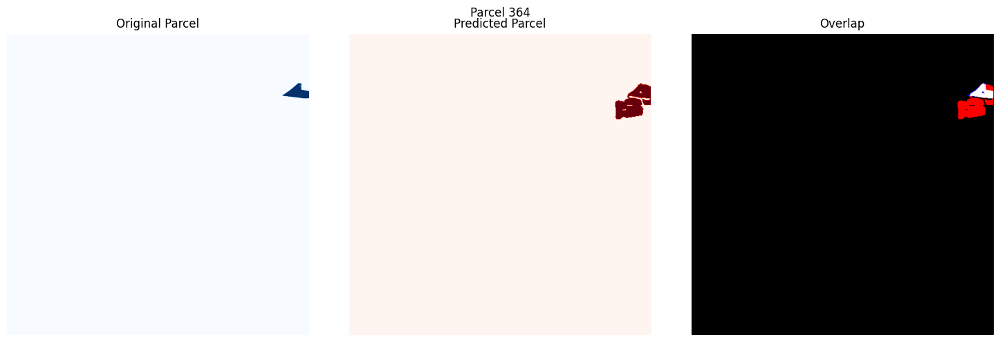

Parcel 364:
True Positive (Correctly predicted): 2102 pixels
False Negative (Missed): 299 pixels
False Positive (Overpredicted): 6120 pixels
Accuracy: 0.25
Precision: 0.26
Recall: 0.88
F1 Score: 0.40




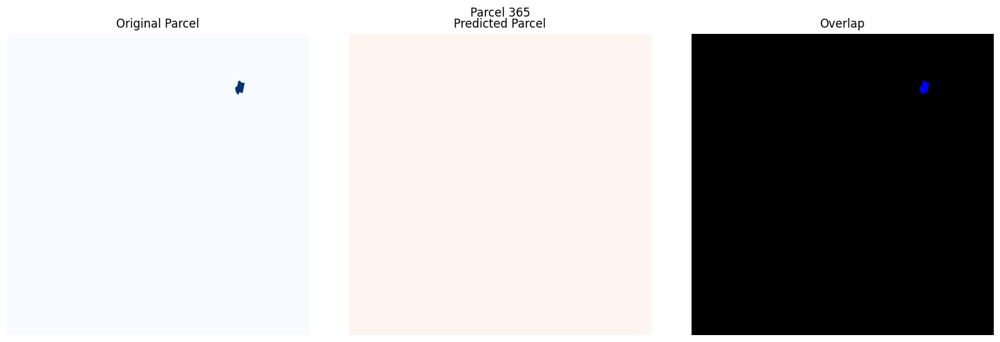

Parcel 365:
True Positive (Correctly predicted): 0 pixels
False Negative (Missed): 916 pixels
False Positive (Overpredicted): 0 pixels
Accuracy: 0.00
Precision: 0.00
Recall: 0.00
F1 Score: 0.00




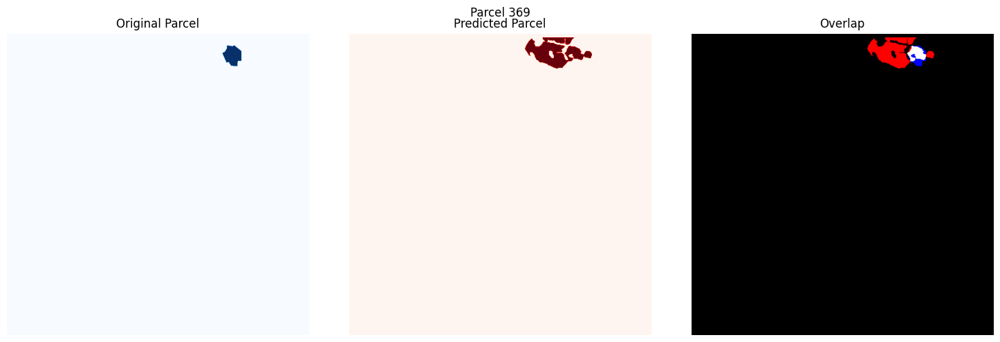

Parcel 369:
True Positive (Correctly predicted): 1902 pixels
False Negative (Missed): 1142 pixels
False Positive (Overpredicted): 9774 pixels
Accuracy: 0.15
Precision: 0.16
Recall: 0.62
F1 Score: 0.26


Overall Metrics:
Average Accuracy: 0.10
Average Precision: 0.10
Average Recall: 0.81
Average F1 Score: 0.16
Results saved to parcel_evaluation_results.csv


In [5]:
# Notebook: Field Parcel Segmentation Evaluation

import geopandas as gpd
import rasterio
from rasterio import features
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import box
import pandas as pd
import warnings

# Suppress specific warnings
warnings.filterwarnings("ignore", category=rasterio.errors.ShapeSkipWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

# 1. Load the original geodataframe
def load_original_gdf(path):
    return gpd.read_file(path)

# 2. Load the predicted geodataframe
def load_predicted_gdf(path):
    return gpd.read_file(path)

# 3. Function to rasterize a polygon
def rasterize_polygon(polygon, transform, shape):
    if polygon is None or polygon.is_empty:
        return np.zeros(shape, dtype=np.uint8)
    mask = features.rasterize([polygon], out_shape=shape, transform=transform, fill=0, default_value=1, dtype=np.uint8)
    return mask

# 4. Function to calculate overlap
def calculate_overlap(original_mask, predicted_mask):
    true_positive = np.sum((original_mask == 1) & (predicted_mask == 1))
    false_negative = np.sum((original_mask == 1) & (predicted_mask == 0))
    false_positive = np.sum((original_mask == 0) & (predicted_mask == 1))
    return true_positive, false_negative, false_positive

# 5. Function to visualize overlap
def visualize_overlap(original_mask, predicted_mask, title):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
    
    ax1.imshow(original_mask, cmap='Blues')
    ax1.set_title('Original Parcel')
    ax1.axis('off')
    
    ax2.imshow(predicted_mask, cmap='Reds')
    ax2.set_title('Predicted Parcel')
    ax2.axis('off')
    
    overlap = np.zeros((original_mask.shape[0], original_mask.shape[1], 3), dtype=np.uint8)
    overlap[..., 0] = predicted_mask * 255  # Red channel for predicted
    overlap[..., 2] = original_mask * 255   # Blue channel for original
    overlap[..., 1] = ((original_mask == 1) & (predicted_mask == 1)) * 255  # Green channel for overlap
    
    ax3.imshow(overlap)
    ax3.set_title('Overlap')
    ax3.axis('off')
    
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

# Main execution
original_gdf_path = "/workspaces/Satelite/data/parcels/ZH_ZH_parcel_2.gpkg"
predicted_gdf_path = "/workspaces/Satelite/data/experiment/predictions/ZH_ZH_parcel_2.gpkg"

original_gdf = load_original_gdf(original_gdf_path)
# Drop the geometries, which are smaller than 5000:
original_gdf = original_gdf[original_gdf.area > 5000]
predicted_gdf = load_predicted_gdf(predicted_gdf_path)

# Ensure both GeoDataFrames have the same CRS
if original_gdf.crs != predicted_gdf.crs:
    predicted_gdf = predicted_gdf.to_crs(original_gdf.crs)

# Get the total bounds of both datasets
total_bounds = gpd.GeoDataFrame(pd.concat([original_gdf, predicted_gdf])).total_bounds

# Create a raster that covers the total extent
width = height = 1000  # Adjust as needed
transform = rasterio.transform.from_bounds(*total_bounds, width, height)

# Prepare a list to store results for all parcels
results = []

for idx, original_polygon in original_gdf.iterrows():
    # Rasterize original polygon
    original_mask = rasterize_polygon(original_polygon.geometry, transform, (height, width))
    
    # Rasterize predicted polygons within the bounds of the original polygon
    bounds = original_polygon.geometry.bounds
    intersecting_predictions = predicted_gdf[predicted_gdf.intersects(box(*bounds))]
    
    if intersecting_predictions.empty:
        predicted_mask = np.zeros((height, width), dtype=np.uint8)
    else:
        predicted_mask = rasterize_polygon(
            intersecting_predictions.unary_union,
            transform,
            (height, width)
        )
    
    # Calculate overlap
    true_positive, false_negative, false_positive = calculate_overlap(original_mask, predicted_mask)
    
    # Visualize overlap
    visualize_overlap(original_mask, predicted_mask, f"Parcel {idx}")
    
    # Calculate metrics
    total_pixels = true_positive + false_negative + false_positive
    accuracy = true_positive / total_pixels if total_pixels > 0 else 0
    precision = true_positive / (true_positive + false_positive) if (true_positive + false_positive) > 0 else 0
    recall = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    
    # Store results
    results.append({
        'Parcel ID': idx,
        'True Positive': true_positive,
        'False Negative': false_negative,
        'False Positive': false_positive,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1_score
    })
    
    # Print statistics
    print(f"Parcel {idx}:")
    print(f"True Positive (Correctly predicted): {true_positive} pixels")
    print(f"False Negative (Missed): {false_negative} pixels")
    print(f"False Positive (Overpredicted): {false_positive} pixels")
    print(f"Accuracy: {accuracy:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1 Score: {f1_score:.2f}")
    print("\n")

# Create a DataFrame with all results
results_df = pd.DataFrame(results)

# Calculate and print overall metrics
print("Overall Metrics:")
print(f"Average Accuracy: {results_df['Accuracy'].mean():.2f}")
print(f"Average Precision: {results_df['Precision'].mean():.2f}")
print(f"Average Recall: {results_df['Recall'].mean():.2f}")
print(f"Average F1 Score: {results_df['F1 Score'].mean():.2f}")

# Save results to CSV
results_df.to_csv("parcel_evaluation_results.csv", index=False)
print("Results saved to parcel_evaluation_results.csv")